In [2]:
import torch
from d2l import torch as d2l

In [2]:
def show_heatmaps(matrices, xlabel, ylabel, titles=None, figsize=(2.5, 2.5),
                  cmap='Reds'):
    '''显示注意力矩阵热图'''
    d2l.use_svg_display()
    # matrices: (要显示的行数，要显示的列数，查询的数目，键的数目)
    num_rows, num_cols = matrices.shape[0], matrices.shape[1]
    fig, axes = d2l.plt.subplots(num_rows, num_cols, figsize=figsize,
                                 sharex=True, sharey=True, squeeze=False)
    for i, (row_axes, row_matrices) in enumerate(zip(axes, matrices)):
        # 取出每行的元素，行号 i，这一行的 subplot(row_axes) 句柄
        # 以及这一行的矩阵 row_matrices
        for j, (ax, matrix) in enumerate(zip(row_axes, row_matrices)):
            # 取出第 i 行中每列的元素
            # 列号 j，位置为 (i, j) 的 subplot(ax)
            # 以及位置为 (i, j) 的矩阵 matrix
            pcm = ax.imshow(matrix.detach().numpy(), cmap=cmap)
            if i == num_rows - 1: # 最后一行写 x 轴标题
                ax.set_xlabel(xlabel)
            if j == 0: # 第一列写 y 轴标题
                ax.set_ylabel(ylabel)
            if titles: # 每列的标题
                ax.set_title(titles[j])
    fig.colorbar(pcm, ax=axes, shrink=0.6)

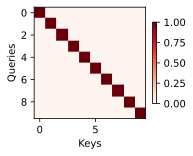

In [3]:
# attention_weights = torch.eye(20).reshape((2, 2, 10, 10))
# show_heatmaps(attention_weights, xlabel='Keys', ylabel='Queries',
              # titles=['A', 'B'])
attention_weights = torch.eye(10).reshape((1, 1, 10, 10))
show_heatmaps(attention_weights, xlabel='Keys', ylabel='Queries')

In [3]:
from torch import nn

n_train = 500
x_train, _ = torch.sort(torch.rand(n_train) * 5) # 排序后的训练样本

def f(x):
    return 2 * torch.sin(x) + x ** 0.8

y_train = f(x_train) + torch.normal(0.0, 0.5, (n_train, )) # 加入噪声得到输出
x_test = torch.arange(0, 5, 0.01)
y_truth = f(x_test)
n_test = len(x_test)
n_test

500

In [5]:
def plot_kernel_reg(y_hat):
    d2l.plot(x_test, [y_truth, y_hat], 'x', 'y', legend=['Truth', 'Pred'],
             xlim=[0, 5], ylim=[-1, 5])
    d2l.plt.plot(x_train, y_train, 'o', alpha=0.5)

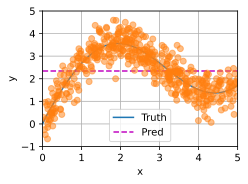

In [6]:
y_hat = torch.repeat_interleave(y_train.mean(), n_test)
# .repeat_interleave(): 传入的数据为 tensor repeats: 复制的份数 dim: 要复制的维度
plot_kernel_reg(y_hat)

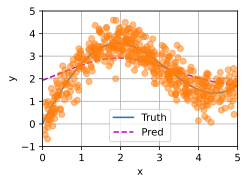

In [7]:
# X_repeat 的形状：(n_test, n_train)
# 每一行都包含着相同的测试输入（例如，同样的查询 [0, 0, ..., 0]）
X_repeat = x_test.repeat_interleave(n_train).reshape((-1, n_train))
# x_train 包含着键 attention_weights 的形状：(n_test, n_train)
# 每一行都包含着要在给定的每个查询的值（y_train）之间分配的注意力权重 dim=1 按行计算
# X_repeat 就是输入的 x，x_train 就是 xi
attention_weights = nn.functional.softmax(-(X_repeat - x_train) ** 2 / 2, dim=1)
# y_hat 的每个元素都是值的加权平均值，其中的权重是注意力权重
# (n_test, n_train) x (n_train) = (n_test)
y_hat = torch.matmul(attention_weights, y_train)
plot_kernel_reg(y_hat)

In [8]:
x_test.repeat_interleave(n_train).reshape((-1, n_train))

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0100, 0.0100, 0.0100,  ..., 0.0100, 0.0100, 0.0100],
        [0.0200, 0.0200, 0.0200,  ..., 0.0200, 0.0200, 0.0200],
        ...,
        [4.9700, 4.9700, 4.9700,  ..., 4.9700, 4.9700, 4.9700],
        [4.9800, 4.9800, 4.9800,  ..., 4.9800, 4.9800, 4.9800],
        [4.9900, 4.9900, 4.9900,  ..., 4.9900, 4.9900, 4.9900]])

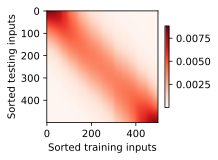

In [9]:
show_heatmaps(attention_weights.unsqueeze(0).unsqueeze(0),
              xlabel='Sorted training inputs',
              ylabel='Sorted testing inputs')

In [10]:
X = torch.ones((2, 1, 4))
Y = torch.ones((2, 4, 6))
torch.bmm(X, Y).shape

torch.Size([2, 1, 6])

In [11]:
weights = torch.ones((2, 10)) * 0.1
values = torch.arange(20.0).reshape(2, 10)
# (2, 1, 10) x (2, 10, 1) => (2, 1, 1)
torch.bmm(weights.unsqueeze(1), values.unsqueeze(-1))

tensor([[[ 4.5000]],

        [[14.5000]]])

In [12]:
class NWKernelRegression(nn.Module):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.w = nn.Parameter(torch.rand((1, ), requires_grad=True))
        
    def forward(self, queries, keys, values):
        # queries 和 attention_weights 的形状为（查询个数，键值对个数）
        # 在下面的示例中即 (n_train, n_train - 1)
        # queries 一行中的所有值都相同，代表 x
        # keys 代表 xi
        queries = queries.repeat_interleave(keys.shape[1]) \
                         .reshape((-1, keys.shape[1]))
        self.attention_weights = nn.functional.softmax(
            -((queries - keys) * self.w) ** 2 / 2, dim=1)
        # values 的形状为（查询个数，键值对个数），代表 yi
        # (n_train, 1, n_train - 1) x (n_train, n_train - 1, 1)
        # => (n_train)
        return torch.bmm(self.attention_weights.unsqueeze(1),
                         values.unsqueeze(-1)).reshape(-1)

In [13]:
# X_title 的形状：(n_train, n_train) 每一行都包含着相同的训练输入
X_tile = x_train.repeat((n_train, 1))
# Y_title 的形状：(n_train, n_train) 每一行都包含着相同的训练输出
Y_tile = y_train.repeat((n_train, 1))

# 下面把每一行中，把 x_train 对应的那个元素抹去
# 因为用的是 x_train 来训练，而 keys values 都是用 x_train 来构造的
# 也就是说 key 每一行都有一个值 key[row, i] == x_train[i]（对角线上的元素）
# 任何一个训练样本的输入都会和 [除自己以外] 的所有训练样本的“键－值”对进行计算， 
# 从而得到其对应的预测输出，我觉得目的应该是为了防止过拟合？
# 因为加上自己的话，x-xi = 0，softmax 后导致学习到的权重太大？

# keys 的形状：(n_train, n_train - 1)
keys = X_tile[(1 - torch.eye(n_train)).type(torch.bool)].reshape((n_train, -1))
# values 的形状：(n_train, n_train - 1)
values = Y_tile[(1 - torch.eye(n_train)).type(torch.bool)].reshape((n_train, -1))

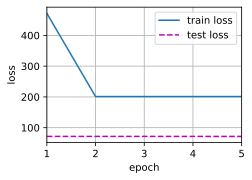

In [14]:
net = NWKernelRegression()
loss = nn.MSELoss(reduction='none')
trainer = torch.optim.SGD(net.parameters(), lr=0.5)
animator = d2l.Animator(xlabel='epoch', ylabel='loss', xlim=[1, 5],
                        legend=['train loss', 'test loss'])

# epoch 太大也会过拟合，因为有噪声存在，很容易过拟合
for epoch in range(5):
    trainer.zero_grad()
    l = loss(net(x_train, keys, values), y_train)
    l.sum().backward()
    trainer.step()
    print(f'epoch {epoch + 1}, loss {float(l.sum()):.6f}')
    with torch.no_grad(): # 看一下测试集的情况
        l2 = loss(net(x_test, x_train.repeat((n_test, 1)), 
                      y_train.repeat((n_test, 1))), y_truth)
    animator.add(epoch + 1, (float(l.sum()), float(l2.sum())))

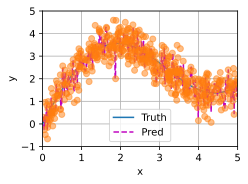

In [15]:
keys = x_train.repeat((n_test, 1))
values = y_train.repeat((n_test, 1))
y_hat = net(x_test, keys, values).unsqueeze(1).detach() # 不需要 .unsqueeze(1) ?
plot_kernel_reg(y_hat)

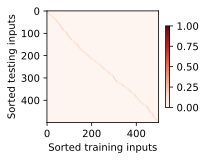

In [16]:
show_heatmaps(net.attention_weights.unsqueeze(0).unsqueeze(0),
              xlabel='Sorted training inputs',
              ylabel='Sorted testing inputs')

In [17]:
net.w

Parameter containing:
tensor([196.5805], requires_grad=True)

In [18]:
def masked_softmax(X, valid_lens):
    '''通过在最后一个轴上掩蔽元素来执行 softmax 操作'''
    # X: 3D 张量，valid_lens: 1D 或 2D 张量
    # X: (batch_size, n, m), valid_lens: (batch_size) 或 (batch_size, n)
    if valid_lens is None:
        return nn.functional.softmax(X, dim=-1)
    else:
        shape = X.shape
        if valid_lens.dim() == 1:
            # valid_lens 是 1D，则每个元素是每个 batch 的长度
            # 需要在每个 batch 中复制 n 份(shape[1])
            # 这个 n 指的是 batch 中的查询个数（步数）
            valid_lens = torch.repeat_interleave(valid_lens, shape[1])
        else:
            # valids_len 是 2D，则其中包含了对每个 batch 的每个查询的长度限制
            # 所以直接铺平即可
            valid_lens = valid_lens.reshape(-1)
        # 最后一轴上被掩蔽的元素使用一个非常大的负值替换，从而使其 softmax 输出为 0
        # sequence_mask 函数要求 X: 2D, valid_lens: 1D 或 2D
        # 因此 X 前两维需要铺平
        X = d2l.sequence_mask(X.reshape(-1, shape[-1]), valid_lens,
                              value=-1e6)
        return nn.functional.softmax(X.reshape(shape), dim=-1)

In [19]:
masked_softmax(torch.rand(2, 2, 4), torch.tensor([2, 3]))

tensor([[[0.3814, 0.6186, 0.0000, 0.0000],
         [0.5362, 0.4638, 0.0000, 0.0000]],

        [[0.3897, 0.2678, 0.3425, 0.0000],
         [0.3132, 0.3633, 0.3235, 0.0000]]])

In [20]:
masked_softmax(torch.rand(2, 2, 4), torch.tensor([[1, 3], [2, 4]]))

tensor([[[1.0000, 0.0000, 0.0000, 0.0000],
         [0.3532, 0.3916, 0.2551, 0.0000]],

        [[0.6551, 0.3449, 0.0000, 0.0000],
         [0.2352, 0.1683, 0.2290, 0.3675]]])

In [21]:
class AdditiveAttention(nn.Module):
    '''加性注意力'''
    def __init__(self, key_size, query_size, num_hiddens, dropout, **kwargs):
        super(AdditiveAttention, self).__init__(**kwargs)
        self.W_k = nn.Linear(key_size, num_hiddens, bias=False)
        self.W_q = nn.Linear(query_size, num_hiddens, bias=False)
        self.w_v = nn.Linear(num_hiddens, 1, bias=False)
        self.dropout = nn.Dropout(dropout)
    
    # queries: (batch_size, 查询的个数 n, q)
    # keys: (batch_size, 键值对的个数 m, k)
    # values: (batch_size, m, v)
    def forward(self, queries, keys, values, valid_lens):
        queries, keys = self.W_q(queries), self.W_k(keys)
        # queries: (batch_size, n, 1, num_hiddens)
        # key: (batch_size, 1, m, num_hiddens)
        # 使用广播的方式进行求和 features: (batch_size, n, m, num_hiddens)
        features = queries.unsqueeze(2) + keys.unsqueeze(1)
        features = torch.tanh(features)
        # self.w_v 仅有一个输出，因此从形状中移除最后那个维度
        # scores: (batch_size, n, m)
        scores = self.w_v(features).squeeze(-1)
        self.attention_weights = masked_softmax(scores, valid_lens)
        # values: (batch_size, m, v)
        # output: (batch_size, n, v)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [22]:
queries, keys = torch.normal(0, 1, (2, 1, 20)), torch.ones((2, 10, 2))
# values 的小批量，两个值矩阵是相同的
values = torch.arange(40, dtype=torch.float32).reshape(1, 10, 4).repeat(
    2, 1, 1)
valid_lens = torch.tensor([2, 6])
attention = AdditiveAttention(key_size=2, query_size=20, num_hiddens=8,
                              dropout=0.1)
attention.eval()
attention(queries, keys, values, valid_lens)

tensor([[[ 2.0000,  3.0000,  4.0000,  5.0000]],

        [[10.0000, 11.0000, 12.0000, 13.0000]]], grad_fn=<BmmBackward0>)

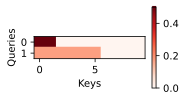

In [23]:
show_heatmaps(attention.attention_weights.reshape((1, 1, 2, 10)), 
              xlabel='Keys', ylabel='Queries')

In [24]:
attention.attention_weights.shape

torch.Size([2, 1, 10])

In [25]:
import math

class DotProductAttention(nn.Module):
    '''缩放点积注意力'''
    def __init__(self, dropout, **kwargs):
        super(DotProductAttention, self).__init__(**kwargs)
        self.dropout = nn.Dropout(dropout)
    
    # queries: (batch_size, 查询的个数 n, d)
    # keys: (batch_size, 键值对的个数 m, d)
    # values: (batch_size, m, v)
    # valid_lens: (batch_size, ) 或者 (batch_size, n)
    def forward(self, queries, keys, values, valid_lens=None):
        d = queries.shape[-1]
        # 设置 transpose_b = True 为了交换 keys 的最后两个维度
        scores = torch.bmm(queries, keys.transpose(1, 2)) / math.sqrt(d)
        # attention_weights: (batch_size, n, m)
        self.attention_weights = masked_softmax(scores, valid_lens)
        # output: (batch_size, n, v)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [26]:
queries = torch.normal(0, 1, (2, 1, 2))
attention = DotProductAttention(dropout=0.5)
attention.eval()
attention(queries, keys, values, valid_lens)

tensor([[[ 2.0000,  3.0000,  4.0000,  5.0000]],

        [[10.0000, 11.0000, 12.0000, 13.0000]]])

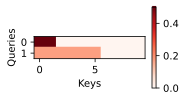

In [27]:
show_heatmaps(attention.attention_weights.reshape((1, 1, 2, 10)),
              xlabel='Keys', ylabel='Queries')

In [28]:
class AttentionDecoder(d2l.Decoder):
    '''带有注意力机制解码器的基本接口'''
    def __init__(self, **kwargs):
        super(AttentionDecoder, self).__init__(**kwargs)
        
    @property
    def attention_weights(self):
        raise NotImplementedError

In [29]:
# 关键就是在于将 Attention 的输出作为新的 c
class Seq2SeqAttentionDecoder(AttentionDecoder):
    def __init__(self, vocab_size, embed_size, num_hiddens, num_layers,
                 dropout=0, **kwargs):
        super(Seq2SeqAttentionDecoder, self).__init__(**kwargs)
        # key, value 都是 encoder 最后一层隐状态:
        # (batch_size, num_steps, num_hiddens)
        # query 是上一时间步最后一层 decoder 的隐状态: 
        # (batch_size, 1, num_hiddens)
        self.attention = DotProductAttention(dropout)
        # self.attention = AdditiveAttention(
            # num_hiddens, num_hiddens, num_hiddens, dropout)
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.rnn = nn.GRU(
            embed_size + num_hiddens, num_hiddens, num_layers, 
            dropout=dropout)
        self.dense = nn.Linear(num_hiddens, vocab_size)
        
    def init_state(self, enc_outputs, enc_valid_lens, *args):
        # outputs: (batch_size, num_steps, num_hiddens) 
        # 最后一层所有时间步的隐状态
        # hidden_state: (num_layers, batch_size, num_hiddens) 
        # 最后一个时间步每一层的隐状态
        outputs, hidden_state = enc_outputs
        return (outputs.permute(1, 0, 2), hidden_state, enc_valid_lens)
    
    def forward(self, X, state):
        # enc_outputs: (batch_size, num_steps, num_hiddens)
        # hidden_state: (num_layers, batch_size, num_hiddens)
        enc_outputs, hidden_state, enc_valid_lens = state
        # X: (num_steps, batch_size, embed_size)
        X = self.embedding(X).permute(1, 0, 2)
        outputs, self._attention_weights = [], []
        for x in X:
            # query: (batch_size, 1, num_hiddens)
            query = torch.unsqueeze(hidden_state[-1], dim=1)
            # context: (batch_size, 1, num_hiddens)
            context = self.attention(
                query, enc_outputs, enc_outputs, enc_valid_lens)
            # cat: x and context 在特征维度上连结
            # x: (batch_size, embed_size)
            # .unsqueeze => (batch_size, 1, embed_size)
            # .cat => (batch_size, 1, num_hiddens + embed_size)
            x = torch.cat((context, torch.unsqueeze(x, dim=1)), dim=-1)
            # 将 x 变形为: (1, batch_size, embed_size + num_hiddens)
            out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
            outputs.append(out)
            self._attention_weights.append(self.attention.attention_weights)
        # outputs: (num_steps, batch_size, vocab_size)
        outputs = self.dense(torch.cat(outputs, dim=0))
        return outputs.permute(1, 0, 2), [enc_outputs, hidden_state,
                                          enc_valid_lens]
    
    @property
    def attention_weights(self):
        return self._attention_weights

In [30]:
import test_function as my

encoder = d2l.Seq2SeqEncoder(vocab_size=10, embed_size=8, num_hiddens=16,
                             num_layers=2)
encoder.eval()
decoder = Seq2SeqAttentionDecoder(vocab_size=10, embed_size=8,
                                  num_hiddens=16, num_layers=2)
decoder.eval()
X = torch.zeros((4, 7), dtype=torch.long) # (batch_size, num_steps)
state = decoder.init_state(encoder(X), None)
output, state = decoder(X, state)

output.shape, len(state), state[0].shape, len(state[1]), state[1][0].shape

(torch.Size([4, 7, 10]), 3, torch.Size([4, 7, 16]), 2, torch.Size([4, 16]))

loss 0.020, 5055.2 tokens/sec on cuda:0


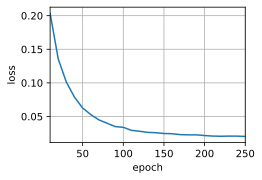

In [31]:
embed_size, num_hiddens, num_layers, dropout = 32, 32, 2, 0.1
batch_size, num_steps = 64, 10
lr, num_epochs, device = 0.005, 250, d2l.try_gpu()

train_iter, src_vocab, tgt_vocab = my.load_data_nmt(batch_size, num_steps)
encoder = d2l.Seq2SeqEncoder(
    len(src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqAttentionDecoder(
    len(tgt_vocab), embed_size, num_hiddens, num_layers, dropout)
net = d2l.EncoderDecoder(encoder, decoder)
d2l.train_seq2seq(net, train_iter, lr, num_epochs, tgt_vocab, device)

In [32]:
engs = ['go .', "i lost .", 'he\'s calm .', 'i\'m home .']
fras = ['va !', 'j\'ai perdu .', 'il est calme .', 'je suis chez moi .']
for eng, fra in zip(engs, fras):
    translation, dec_attention_weight_seq = d2l.predict_seq2seq(
        net, eng, src_vocab, tgt_vocab, num_steps, device, True)
    print(f'{eng} => {translation}, ',
          f'bleu {my.bleu(translation, fra, k=2):.3f}')

go . => va !,  bleu 1.000
i lost . => j'ai perdu .,  bleu 1.000
he's calm . => je suis en retard .,  bleu 0.000
i'm home . => je suis chez moi .,  bleu 1.000


In [33]:
raw_text = my.read_data_nmt()
text = my.preprocess_nmt(raw_text)
i = 0
for line in text.split('\n'):
    idx = line.find('\t')
    eng, fra = line[: idx], line[idx + 1: ]
    translation, attention_weight_seq = d2l.predict_seq2seq(
        net, eng, src_vocab, tgt_vocab, num_steps, device)
    print(f'({eng}) => ({translation}), bleu {my.bleu(translation, fra, k=2):.3f},', 
          f' correct ({fra})')
    i += 1
    if i == 100:
        break

(go .) => (va !), bleu 1.000,  correct (va !)
(hi .) => (salut !), bleu 1.000,  correct (salut !)
(run !) => (courez !), bleu 0.000,  correct (cours !)
(run !) => (courez !), bleu 1.000,  correct (courez !)
(who ?) => (qui ?), bleu 1.000,  correct (qui ?)
(wow !) => (fantastique !), bleu 0.000,  correct (ça alors !)
(fire !) => (au feu !), bleu 1.000,  correct (au feu !)
(help !) => (à <unk> !), bleu 0.000,  correct (à l'aide !)
(jump .) => (<unk> !), bleu 0.000,  correct (saute .)
(stop !) => (<unk> !), bleu 0.000,  correct (ça suffit !)
(stop !) => (<unk> !), bleu 0.000,  correct (stop !)
(stop !) => (<unk> !), bleu 0.000,  correct (arrête-toi !)
(wait !) => (attends !), bleu 1.000,  correct (attends !)
(wait !) => (attends !), bleu 0.000,  correct (attendez !)
(go on .) => (continuez .), bleu 0.000,  correct (poursuis .)
(go on .) => (continuez .), bleu 1.000,  correct (continuez .)
(go on .) => (continuez .), bleu 0.000,  correct (poursuivez .)
(hello !) => (<unk> !), bleu 0.000,  

In [34]:
# dec_attention_weight_seq: (6, 1, 1, 1, 10) => attention_weights: (1, 1, 6, 10)
# 6 是预测时的 time_steps，说明到第 6 个时间步就预测 <eos> 了（不然就是 10）
# 1 是因为在预测时 decoder 中每次只输入一个时间步，导致 decoder._attention_weights 长度为 1
# 剩下的 1, 1, 10 是因为在 AdditiveAttention 计算中，输出的 weights 形状是 (batch_size, n, m)，而 batch_size = 1, n = 1(时间步), m = 10(编码器的 time_steps，即键值对个数)
attention_weights = torch.cat([step[0][0][0] for step in dec_attention_weight_seq], 0).reshape((
    1, 1, -1, num_steps))

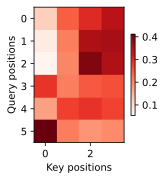

In [35]:
# 加上一个包含序列结束的词元
d2l.show_heatmaps(
    attention_weights[:, :, :, :len(engs[-1].split()) + 1].cpu(), # 因为用的是最后一个测试用例的 weights
    xlabel='Key positions', ylabel='Query positions')

In [36]:
class MultiHeadAttention(nn.Module):
    '''多头注意力'''
    def __init__(self, query_size, key_size, value_size, num_hiddens,
                 num_heads, dropout, bias=False, **kwargs):
        super(MultiHeadAttention, self).__init__(**kwargs)
        # p_o = num_hiddens
        self.num_heads = num_heads
        self.attention = DotProductAttention(dropout)
        self.W_q = nn.Linear(query_size, num_hiddens, bias=bias)
        self.W_k = nn.Linear(key_size, num_hiddens, bias=bias)
        self.W_v = nn.Linear(value_size, num_hiddens, bias=bias)
        # h 个头，其实每个头的维度应该是 num_hiddens / num_heads
        # 这里直接用 num_hiddens(p_q * h = p_k * h = p_v * h)，
        # 实际上就是 h 个头一起计算了
        # 相当于将 h 个注意力汇聚连结成 1 个大的注意力汇聚
        # 其中这里 W_q, W_k 的输出维度不是一定要设置成 num_hiddens
        # 设置成其他也不会影响结果，在这里是将 p_q, p_k 设置为 p_o / h 了
        self.W_o = nn.Linear(num_hiddens, num_hiddens, bias=bias)
        
    def forward(self, queries, keys, values, valid_lens):
        # queries, keys, values: (batch_size, n or m, num_hiddens)
        # valid_lens: (batch_size, ) or (batch_size, n)
        # => queries, keys, values: 
        # (batch_size * num_heads, n or m, num_hiddens / num_heads)
        queries = transpose_qkv(self.W_q(queries), self.num_heads)
        keys = transpose_qkv(self.W_k(keys), self.num_heads)
        values = transpose_qkv(self.W_v(values), self.num_heads)
        
        if valid_lens is not None:
            # 在轴 0，将第一项（标量或者矢量）复制 num_heads 次
            # 然后如此复制第二项，然后诸如此类
            # (batch_size, ) => (batch_size * num_heads, )
            # (batch_size, n) => (batch_size * num_heads, n)
            valid_lens = torch.repeat_interleave(
                valid_lens, repeats=self.num_heads, dim=0)
            
        # output: (batch_size * num_heads, n, num_hiddens / num_heads)
        # 这里 h 个头同时计算注意力汇聚
        output = self.attention(queries, keys, values, valid_lens)
        
        # output_concat: (batch_size, n, num_hiddens)
        # 再把 h 个头连结到一起，最后进行线性变换
        output_concat = transpose_output(output, self.num_heads)
        return self.W_o(output_concat)

In [37]:
def transpose_qkv(X, num_heads):
    '''为了多注意力头的并行计算而变换形状'''
    # X: (batch_size, n or m, num_hiddens)
    # => (batch_size, n or m, num_heads, num_hiddens / num_heads)
    X = X.reshape(X.shape[0], X.shape[1], num_heads, -1)
    
    # X: (batch_size, num_heads, n or m, num_hiddens / num_heads)
    X = X.permute(0, 2, 1, 3)
    
    # X: (batch_size * num_heads, n or m, num_hiddens / num_heads)
    return X.reshape(-1, X.shape[2], X.shape[3])

def transpose_output(X, num_heads):
    '''transpose_qkv 函数的逆操作'''
    X = X.reshape(-1, num_heads, X.shape[1], X.shape[2])
    X = X.permute(0, 2, 1, 3)
    return X.reshape(X.shape[0], X.shape[1], -1)

In [38]:
num_hiddens, num_heads = 100, 5
attention = MultiHeadAttention(num_hiddens, num_hiddens, num_hiddens,
                               num_hiddens, num_heads, 0.5)
attention.eval()

MultiHeadAttention(
  (attention): DotProductAttention(
    (dropout): Dropout(p=0.5, inplace=False)
  )
  (W_q): Linear(in_features=100, out_features=100, bias=False)
  (W_k): Linear(in_features=100, out_features=100, bias=False)
  (W_v): Linear(in_features=100, out_features=100, bias=False)
  (W_o): Linear(in_features=100, out_features=100, bias=False)
)

In [39]:
batch_size, num_queries = 2, 4
num_kvpairs, valid_lens = 6, torch.tensor([3, 2])
X = torch.ones((batch_size, num_queries, num_hiddens))
Y = torch.ones((batch_size, num_kvpairs, num_hiddens))
Z = torch.ones((batch_size, num_kvpairs, num_hiddens))
attention(X, Y, Z, valid_lens).shape

torch.Size([2, 4, 100])

In [40]:
num_hiddens, num_heads = 100, 5
attention = MultiHeadAttention(num_hiddens, num_hiddens, num_hiddens,
                               num_hiddens, num_heads, 0.5)
attention.eval()

MultiHeadAttention(
  (attention): DotProductAttention(
    (dropout): Dropout(p=0.5, inplace=False)
  )
  (W_q): Linear(in_features=100, out_features=100, bias=False)
  (W_k): Linear(in_features=100, out_features=100, bias=False)
  (W_v): Linear(in_features=100, out_features=100, bias=False)
  (W_o): Linear(in_features=100, out_features=100, bias=False)
)

In [41]:
batch_size, num_queries, valid_lens = 2, 4, torch.tensor([3, 2])
X = torch.ones((batch_size, num_queries, num_hiddens))
attention(X, X, X, valid_lens).shape

torch.Size([2, 4, 100])

In [4]:
class PositionalEncoding(nn.Module):
    '''位置编码'''
    def __init__(self, num_hiddens, dropout, max_len=1000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(dropout)
        # 创建一个足够长的 P，最外层维度是 batch_size
        self.P = torch.zeros((1, max_len, num_hiddens))
        # 通过广播对 i = 0 ~ max_len 进行计算 2j
        X = torch.arange(max_len, dtype=torch.float32).reshape(
            -1, 1) / torch.pow(10000, torch.arange(
            0, num_hiddens, 2, dtype=torch.float32) / num_hiddens)
        self.P[:, :, 0::2] = torch.sin(X)
        self.P[:, :, 1::2] = torch.cos(X)
        
    def forward(self, X):
        X = X + self.P[:, :X.shape[1], :].to(X.device)
        return self.dropout(X)

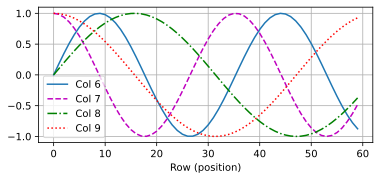

In [5]:
encoding_dim, num_steps = 32, 60
pos_encoding = PositionalEncoding(encoding_dim, 0)
pos_encoding.eval()
X = pos_encoding(torch.zeros((1, num_steps, encoding_dim)))
P = pos_encoding.P[:, :X.shape[1], :]
d2l.plot(torch.arange(num_steps), P[0, :, 6:10].T, xlabel='Row (position)',
         figsize=(6, 2.5), legend=["Col %d" % d for d in torch.arange(6, 10)])

In [44]:
for i in range(8):
    print(f'{i} 的二进制是: {i:>03b}')

0 的二进制是: 000
1 的二进制是: 001
2 的二进制是: 010
3 的二进制是: 011
4 的二进制是: 100
5 的二进制是: 101
6 的二进制是: 110
7 的二进制是: 111


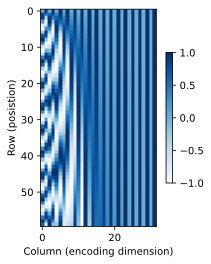

In [45]:
P = P[0, :, :].unsqueeze(0).unsqueeze(0)
show_heatmaps(P, xlabel='Column (encoding dimension)',
              ylabel='Row (posistion)', figsize=(3.5, 4), cmap='Blues')

In [46]:
class PositionWiseFFN(nn.Module):
    '''基于位置的前馈网络'''
    def __init__(self, ffn_num_input, ffn_num_hiddens, ffn_num_outputs,
                 **kwargs):
        super(PositionWiseFFN, self).__init__(**kwargs)
        self.dense1 = nn.Linear(ffn_num_input, ffn_num_hiddens)
        self.relu = nn.ReLU()
        self.dense2 = nn.Linear(ffn_num_hiddens, ffn_num_outputs)
        
    def forward(self, X):
        return self.dense2(self.relu(self.dense1(X)))

In [47]:
ffn = PositionWiseFFN(4, 4, 8)
ffn.eval()
ffn(torch.ones((2, 3, 4))).shape

torch.Size([2, 3, 8])

In [48]:
class AddNorm(nn.Module):
    '''残差连接后进行层规范化'''
    def __init__(self, normalized_shape, dropout, **kwargs):
        super(AddNorm, self).__init__(**kwargs)
        self.dropout = nn.Dropout(dropout)
        self.ln = nn.LayerNorm(normalized_shape)
    
    def forward(self, X, Y):
        return self.ln(self.dropout(Y) + X)

In [49]:
add_norm = AddNorm([3, 4], 0.5)
add_norm.eval()
add_norm(torch.ones((2, 3, 4)), torch.ones((2, 3, 4))).shape

torch.Size([2, 3, 4])

In [50]:
class EncoderBlock(nn.Module):
    '''transformer 编码器块'''
    def __init__(self, query_size, key_size, value_size, num_hiddens,
                 norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
                 dropout, use_bias=False, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)
        self.attention = MultiHeadAttention(
            query_size, key_size, value_size, num_hiddens, num_heads, 
            dropout, use_bias)
        self.addnorm1 = AddNorm(norm_shape, dropout)
        # 对于序列中任何位置的任何输入 $\mathbf x \in \mathbb R^d$，
        # 都要求满足 $\mathrm{sublayer}(\mathbf x)\in \mathbb R^d$，
        # 以便残差连接满足 
        # $\mathbf x+\mathrm{sublayer}(\mathbf x)\in \mathbb R^d$。
        self.ffn = PositionWiseFFN(
            ffn_num_input, ffn_num_hiddens, num_hiddens)
        self.addnorm2 = AddNorm(norm_shape, dropout)
        
    def forward(self, X, valid_lens):
        Y = self.addnorm1(X, self.attention(X, X, X, valid_lens))
        return self.addnorm2(Y, self.ffn(Y))

In [51]:
X = torch.ones((2, 100, 24))
valid_lens = torch.tensor([3, 2])
encoder_blk = EncoderBlock(24, 24, 24, 24, [100, 24], 24, 48, 8, 0.5)
encoder_blk.eval()
encoder_blk(X, valid_lens).shape

torch.Size([2, 100, 24])

In [52]:
class TransformerEncoder(d2l.Encoder):
    '''transformer 编码器'''
    def __init__(self, vocab_size, query_size, key_size, value_size,
                 num_hiddens, norm_shape, ffn_num_input, ffn_num_hiddens,
                 num_heads, num_layers, dropout, use_bias=False, **kwargs):
        super(TransformerEncoder, self).__init__(**kwargs)
        self.num_hiddens = num_hiddens
        self.embedding = nn.Embedding(vocab_size, num_hiddens)
        self.pos_encoding = PositionalEncoding(num_hiddens, dropout)
        self.blks = nn.Sequential()
        for i in range(num_layers):
            self.blks.add_module("block" + str(i),
                EncoderBlock(query_size, key_size, value_size, num_hiddens, 
                             norm_shape, ffn_num_input, ffn_num_hiddens,
                             num_heads, dropout, use_bias))
            
    def forward(self, X, valid_lens, *args):
        # 位置编码值在 -1 ~ 1 之间
        # 需要将 Embedding 值乘以嵌入维度的平方根进行缩放
        # 然后再与位置编码相加
        X = self.pos_encoding(self.embedding(X) * math.sqrt(self.num_hiddens))
        self.attention_weights = [None] * len(self.blks)
        for i, blk in enumerate(self.blks):
            X = blk(X, valid_lens)
            self.attention_weights[i] = blk.attention.attention. \
                                            attention_weights
        return X

In [53]:
encoder = TransformerEncoder(200, 24, 24, 24, 24, [100, 24], 24, 48, 8,
                             2, 0.5)
encoder.eval()
encoder(torch.ones((2, 100), dtype=torch.long), valid_lens).shape

torch.Size([2, 100, 24])

In [54]:
class DecoderBlock(nn.Module):
    '''transformer 解码器块'''
    def __init__(self, query_size, key_size, value_size, num_hiddens,
                 norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
                 dropout, i, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)
        self.i = i # i 是深度方向上的层数（块数），表明目前是第 i 层（块）
        self.attention1 = MultiHeadAttention(
            query_size, key_size, value_size, num_hiddens, num_heads, dropout)
        self.addnorm1 = AddNorm(norm_shape, dropout)
        self.attention2 = MultiHeadAttention(
            query_size, key_size, value_size, num_hiddens, num_heads, dropout)
        self.addnorm2 = AddNorm(norm_shape, dropout)
        self.ffn = PositionWiseFFN(ffn_num_input, ffn_num_hiddens, 
                                   num_hiddens)
        self.addnorm3 = AddNorm(norm_shape, dropout)
        
    def forward(self, X, state):
        enc_outputs, enc_valid_lens = state[0], state[1]
        # 训练阶段，输出序列的所有词元都在同一时间并行处理
        # 因此 state[2][self.i] 初始化为 None
        # 预测阶段，输出序列是通过词元一个接着一个解码的
        # 因此 state[2][self.i] 包含着直到当前时间步第 i 个块解码的输出表示
        if state[2][self.i] is None:
            key_values = X
        else:
            # 在时间步维度拼接前 i-1 个输出和第 i 个输出（X）
            key_values = torch.cat((state[2][self.i], X), axis=1)
        state[2][self.i] = key_values
        if self.training:
            batch_size, num_steps, _ = X.shape
            # dec_valid_lens: (batch_size, num_steps)
            # 其中每一行是 [1, 2, ..., num_steps]
            # 即对第 i 个时间步，训练时只考虑前 i 个词元（键值对）的信息
            dec_valid_lens = torch.arange(
                1, num_steps + 1, device=X.device).repeat(batch_size, 1)
        else:
            # 预测时，key_values 只包含前 i 个（拼接得到），不会有未来的信息
            # 所以不需要设置有效长度
            dec_valid_lens = None
        
        # 自注意力
        X2 = self.attention1(X, key_values, key_values, dec_valid_lens)
        Y = self.addnorm1(X, X2)
        # 编码器-解码器注意力：query 是前一层的输出
        # key 和 value 是 encoder 的输出
        # enc_outputs: (batch_size, num_steps, num_hiddens)
        Y2 = self.attention2(Y, enc_outputs, enc_outputs, enc_valid_lens)
        Z = self.addnorm2(Y, Y2)
        return self.addnorm3(Z, self.ffn(Z)), state

In [55]:
decoder_blk = DecoderBlock(24, 24, 24, 24, [100, 24], 24, 48, 8, 0.5, 0)
decoder_blk.eval()
X = torch.ones((2, 100, 24))
state = [encoder_blk(X, valid_lens), valid_lens, [None]]
decoder_blk(X, state)[0].shape

torch.Size([2, 100, 24])

In [56]:
class TransformerDecoder(AttentionDecoder):
    def __init__(self, vocab_size, query_size, key_size, value_size,
                 num_hiddens, norm_shape, ffn_num_input, ffn_num_hiddens,
                 num_heads, num_layers, dropout, **kwargs):
        super(TransformerDecoder, self).__init__(**kwargs)
        self.num_hiddens = num_hiddens
        self.num_layers = num_layers
        self.embedding = nn.Embedding(vocab_size, num_hiddens)
        self.pos_encoding = PositionalEncoding(num_hiddens, dropout)
        self.blks = nn.Sequential()
        for i in range(num_layers):
            self.blks.add_module("block" + str(i),
                DecoderBlock(query_size, key_size, value_size, num_hiddens,
                             norm_shape, ffn_num_input, ffn_num_hiddens,
                             num_heads, dropout, i))
        self.dense = nn.Linear(num_hiddens, vocab_size)
        
    def init_state(self, enc_outputs, enc_valid_lens, *args):
        return [enc_outputs, enc_valid_lens, [None] * self.num_layers]
    
    def forward(self, X, state):
        X = self.pos_encoding(self.embedding(X) * math.sqrt(self.num_hiddens))
        # self._attention_weights: (2, len(self.blks))
        self._attention_weights = [[None] * len(self.blks) for _ in range(2)]
        for i, blk in enumerate(self.blks):
            X, state = blk(X, state)
            # 解码器自注意力权重
            self._attention_weights[0][i] = \
                blk.attention1.attention.attention_weights
            # 编码器-解码器自注意力权重
            self._attention_weights[1][i] = \
                blk.attention2.attention.attention_weights
        return self.dense(X), state
    
    @property
    def attention_weights(self):
        return self._attention_weights

loss 0.031, 4899.3 tokens/sec on cuda:0


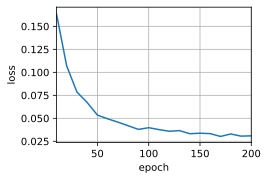

In [81]:
num_hiddens, num_layers, dropout, batch_size, num_steps = 32, 2, 0.1, 64, 10
lr, num_epochs, device = 0.005, 200, d2l.try_gpu()
ffn_num_inputs, ffn_num_hiddens, num_heads = 32, 128, 4
query_size, key_size, value_size = 32, 32, 32
norm_shape = [32]

train_iter, src_vocab, tgt_vocab = d2l.load_data_nmt(batch_size, num_steps)

encoder = TransformerEncoder(
    len(src_vocab), query_size, key_size, value_size, num_hiddens,
    norm_shape, ffn_num_inputs, ffn_num_hiddens, num_heads,
    num_layers, dropout)
decoder = TransformerDecoder(
    len(tgt_vocab), query_size, key_size, value_size, num_hiddens,
    norm_shape, ffn_num_inputs, ffn_num_hiddens, num_heads,
    num_layers, dropout)
net = d2l.EncoderDecoder(encoder, decoder)
d2l.train_seq2seq(net, train_iter, lr, num_epochs, tgt_vocab, device)

In [82]:
engs = ['go .', "i lost .", 'he\'s calm .', 'i\'m home .']
fras = ['va !', 'j\'ai perdu .', 'il est calme .', 'je suis chez moi .']
for eng, fra in zip(engs, fras):
    translation, dec_attention_weight_seq = d2l.predict_seq2seq(
        net, eng, src_vocab, tgt_vocab, num_steps, device, True)
    print(f'{eng} => {translation}, ',
          f'bleu {d2l.bleu(translation, fra, k=2):.3f}')

go . => va !,  bleu 1.000
i lost . => j'ai perdu .,  bleu 1.000
he's calm . => il est calme .,  bleu 1.000
i'm home . => je suis chez moi .,  bleu 1.000


In [59]:
for line in text.split('\n'):
    idx = line.find('\t')
    eng, fra = line[: idx], line[idx + 1: ]
    translation, attention_weight_seq = d2l.predict_seq2seq(
        net, eng, src_vocab, tgt_vocab, num_steps, device)
    print(f'({eng}) => ({translation}), bleu {my.bleu(translation, fra, k=2):.3f},', 
          f' correct ({fra})')

(go .) => (va !), bleu 1.000,  correct (va !)
(hi .) => (salut !), bleu 1.000,  correct (salut !)
(run !) => (cours !), bleu 1.000,  correct (cours !)
(run !) => (cours !), bleu 0.000,  correct (courez !)
(who ?) => (qui ?), bleu 1.000,  correct (qui ?)
(wow !) => (fantastique !), bleu 0.000,  correct (ça alors !)
(fire !) => (au feu !), bleu 1.000,  correct (au feu !)
(help !) => (à <unk> !), bleu 0.000,  correct (à l'aide !)
(jump .) => (<unk> !), bleu 0.000,  correct (saute .)
(stop !) => (<unk> !), bleu 0.000,  correct (ça suffit !)
(stop !) => (<unk> !), bleu 0.000,  correct (stop !)
(stop !) => (<unk> !), bleu 0.000,  correct (arrête-toi !)
(wait !) => (attends !), bleu 1.000,  correct (attends !)
(wait !) => (attends !), bleu 0.000,  correct (attendez !)
(go on .) => (poursuis .), bleu 1.000,  correct (poursuis .)
(go on .) => (poursuis .), bleu 0.000,  correct (continuez .)
(go on .) => (poursuis .), bleu 0.000,  correct (poursuivez .)
(hello !) => (salut !), bleu 0.000,  corre

(hang on !) => (attendez un peu !), bleu 1.000,  correct (attendez un peu !)
(hang on .) => (tiens bon !), bleu 1.000,  correct (tiens bon !)
(hang on .) => (tiens bon !), bleu 0.687,  correct (tenez bon !)
(he quit .) => (il a <unk> tomber .), bleu 0.548,  correct (il laissa tomber .)
(he quit .) => (il a <unk> tomber .), bleu 0.752,  correct (il a laissé tomber .)
(he runs .) => (il court .), bleu 1.000,  correct (il court .)
(help me !) => (aide-moi !), bleu 1.000,  correct (aide-moi !)
(help me .) => (aide-moi .), bleu 1.000,  correct (aide-moi .)
(help me .) => (aide-moi .), bleu 0.000,  correct (aidez-moi .)
(help us .) => (<unk> !), bleu 0.000,  correct (aidez-nous !)
(help us .) => (<unk> !), bleu 0.000,  correct (aide-nous !)
(hold it !) => (ne <unk> plus !), bleu 0.658,  correct (ne bouge plus !)
(hold on .) => (ne <unk> pas .), bleu 0.658,  correct (ne quittez pas .)
(hug tom .) => (fais un <unk> à tom .), bleu 0.803,  correct (fais un câlin à tom .)
(i agree .) => (je suis 

(fix this .) => (<unk> ça .), bleu 0.000,  correct (réparez ceci .)
(fix this .) => (<unk> ça .), bleu 0.687,  correct (répare ça .)
(get down !) => (lâche-toi !), bleu 1.000,  correct (lâche-toi !)
(get down .) => (<unk> !), bleu 0.000,  correct (descends !)
(get down .) => (<unk> !), bleu 0.000,  correct (descendez !)
(get down .) => (<unk> !), bleu 0.000,  correct (lâche-toi !)
(get down .) => (<unk> !), bleu 0.000,  correct (lâchez-vous !)
(get lost !) => (va au <unk> !), bleu 0.000,  correct (va voir ailleurs si j'y suis !)
(get lost !) => (va au <unk> !), bleu 0.000,  correct (dégage !)
(get lost !) => (va au <unk> !), bleu 0.658,  correct (va au diable !)
(get real !) => (sois <unk> !), bleu 0.000,  correct (sois réaliste !)
(go ahead .) => (vas-y !), bleu 0.000,  correct (vas-y .)
(go ahead .) => (vas-y !), bleu 0.000,  correct (poursuis !)
(go ahead .) => (vas-y !), bleu 0.000,  correct (passe devant !)
(go ahead .) => (vas-y !), bleu 1.000,  correct (vas-y !)
(good job !) => 

(i'm thin .) => (je suis <unk> .), bleu 0.658,  correct (je suis mince .)
(i'm tidy .) => (je suis <unk> .), bleu 0.658,  correct (je suis ordonné .)
(i'm tidy .) => (je suis <unk> .), bleu 0.658,  correct (je suis ordonnée .)
(i'm ugly .) => (je suis <unk> .), bleu 0.658,  correct (je suis laid .)
(i'm ugly .) => (je suis <unk> .), bleu 0.658,  correct (je suis laide .)
(i'm weak .) => (je suis faible .), bleu 1.000,  correct (je suis faible .)
(i'm well .) => (je vais bien .), bleu 1.000,  correct (je vais bien .)
(i'm well .) => (je vais bien .), bleu 0.512,  correct (je me porte bien .)
(i've won .) => (je l'ai emporté .), bleu 0.000,  correct (j'ai gagné .)
(i've won .) => (je l'ai emporté .), bleu 1.000,  correct (je l'ai emporté .)
(it helps .) => (dégage !), bleu 0.000,  correct (ça aide .)
(it hurts .) => (dégage !), bleu 0.000,  correct (ça fait mal .)
(it works .) => (elle <unk> .), bleu 0.000,  correct (elle marche .)
(it works .) => (elle <unk> .), bleu 0.000,  correct (ça

(be seated .) => (assieds-toi !), bleu 0.000,  correct (asseyez-vous !)
(birds fly .) => (<unk> <unk> !), bleu 0.000,  correct (les oiseaux volent .)
(bless you .) => (à tes <unk> !), bleu 0.658,  correct (à tes souhaits !)
(call home !) => (appelle à la maison !), bleu 1.000,  correct (appelle à la maison !)
(calm down !) => (calmez-vous !), bleu 1.000,  correct (calmez-vous !)
(calm down .) => (<unk> .), bleu 0.000,  correct (calme-toi .)
(can we go ?) => (pouvons-nous partir ?), bleu 1.000,  correct (pouvons-nous partir ?)
(can we go ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous nous en aller ?)
(can we go ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous y aller ?)
(catch tom .) => (attrape tom .), bleu 1.000,  correct (attrape tom .)
(catch tom .) => (attrape tom .), bleu 0.687,  correct (attrapez tom .)
(catch him .) => (<unk> .), bleu 0.000,  correct (rattrape-le .)
(come back .) => (<unk> !), bleu 0.000,  correct (reviens !)
(come back .) => 

(i cringed .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je suis rentré en moi-même .)
(i exhaled .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai expiré .)
(i gave up .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai abandonné .)
(i give in .) => (j’ai <unk> .), bleu 0.000,  correct (je donne ma langue au chat .)
(i give up .) => (j'ai <unk> .), bleu 0.000,  correct (j'abandonne .)
(i got hot .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis mis à avoir chaud .)
(i got hot .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis mise à avoir chaud .)
(i had fun .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis amusé .)
(i had fun .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis amusée .)
(i had fun .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis marré .)
(i had fun .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis marrée .)
(i hate it .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste ça .)
(i have it .) => (j'ai pigé !), bleu 0.000,  c

(i'm first .) => (je suis <unk> .), bleu 0.512,  correct (je suis en premier .)
(i'm fussy .) => (je suis <unk> .), bleu 0.658,  correct (je suis difficile .)
(i'm fussy .) => (je suis <unk> .), bleu 0.658,  correct (je suis tatillon .)
(i'm fussy .) => (je suis <unk> .), bleu 0.658,  correct (je suis tatillonne .)
(i'm going .) => (je suis <unk> .), bleu 0.000,  correct (je pars maintenant .)
(i'm going .) => (je suis <unk> .), bleu 0.000,  correct (je me tire .)
(i'm going .) => (je suis <unk> .), bleu 0.000,  correct (j’y vais .)
(i'm going .) => (je suis <unk> .), bleu 0.000,  correct (je pars .)
(i'm loyal .) => (je suis <unk> .), bleu 0.658,  correct (je suis loyal .)
(i'm loyal .) => (je suis <unk> .), bleu 0.658,  correct (je suis loyale .)
(i'm lucky .) => (je suis <unk> .), bleu 0.658,  correct (je suis veinard .)
(i'm lucky .) => (je suis <unk> .), bleu 0.658,  correct (je suis veinarde .)
(i'm lucky .) => (je suis <unk> .), bleu 0.000,  correct (j'ai du pot .)
(i'm lucky .)

(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (reste allongé , immobile !)
(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (reste allongée , immobile !)
(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (restez allongé , immobile !)
(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (restez allongée , immobile !)
(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (restez allongés , immobiles !)
(lie still .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (restez allongées , immobiles !)
(look back !) => (<unk> !), bleu 0.000,  correct (regarde derrière toi !)
(look back !) => (<unk> !), bleu 0.000,  correct (regarde derrière !)
(look here .) => (<unk> !), bleu 0.000,  correct (regarde ici .)
(look here .) => (<unk> !), bleu 0.000,  correct (regardez ici .)
(loosen up .) => (<unk> .), bleu 0.000,  correct (échauffe-toi !)
(loosen up .) => (<unk> .), bleu 0.000,  correct (échauffez-vous !)
(loosen up .) => (<unk> .), bleu 0.000, 

(try again .) => (fais un <unk> .), bleu 0.000,  correct (essaie encore .)
(try again .) => (fais un <unk> .), bleu 0.000,  correct (essayez de nouveau .)
(try again .) => (fais un <unk> .), bleu 0.000,  correct (essaie de nouveau .)
(try it on .) => (<unk> !), bleu 0.000,  correct (essaie-le  !)
(turn left .) => (les tard .), bleu 0.000,  correct (tourne à gauche .)
(wait here .) => (bonne chance .), bleu 0.000,  correct (attends ici .)
(wait here .) => (bonne chance .), bleu 0.000,  correct (attends là .)
(wait here .) => (bonne chance .), bleu 0.000,  correct (attendez ici .)
(wait here .) => (bonne chance .), bleu 0.000,  correct (attendez là .)
(watch out !) => (<unk> !), bleu 0.000,  correct (attention !)
(watch out !) => (<unk> !), bleu 0.000,  correct (faites attention !)
(watch out !) => (<unk> !), bleu 0.000,  correct (fais attention !)
(we agreed .) => (nous <unk> .), bleu 0.000,  correct (nous sommes tombés d'accord .)
(we did it !) => (nous avons gagné !), bleu 0.658,  cor

(be careful .) => (sois gentil .), bleu 0.000,  correct (sois prudent !)
(be careful .) => (sois gentil .), bleu 0.000,  correct (sois prudente !)
(be careful .) => (sois gentil .), bleu 0.000,  correct (soyez prudent !)
(be careful .) => (sois gentil .), bleu 0.000,  correct (soyez prudente !)
(be careful .) => (sois gentil .), bleu 0.000,  correct (soyez prudents !)
(be careful .) => (sois gentil .), bleu 0.000,  correct (soyez prudentes !)
(be content .) => (sois gentil .), bleu 0.000,  correct (sois satisfait !)
(be content .) => (sois gentil .), bleu 0.000,  correct (sois satisfaite !)
(be content .) => (sois gentil .), bleu 0.000,  correct (soyez satisfait !)
(be content .) => (sois gentil .), bleu 0.000,  correct (soyez satisfaite !)
(be content .) => (sois gentil .), bleu 0.000,  correct (soyez satisfaits !)
(be content .) => (sois gentil .), bleu 0.000,  correct (soyez satisfaites !)
(be on time .) => (sois gentil .), bleu 0.000,  correct (soyez à l'heure .)
(be on time .) => 

(he made it .) => (il essaye .), bleu 0.000,  correct (il a réussi .)
(he's swiss .) => (il est <unk> .), bleu 0.658,  correct (il est suisse .)
(he's swiss .) => (il est <unk> .), bleu 0.658,  correct (il est helvète .)
(he's broke .) => (il est <unk> .), bleu 0.658,  correct (il est ruiné .)
(he's broke .) => (il est <unk> .), bleu 0.658,  correct (il est fauché .)
(he's drunk .) => (il est <unk> .), bleu 0.658,  correct (il est ivre .)
(he's drunk .) => (il est <unk> .), bleu 0.658,  correct (il est soûl .)
(he's smart .) => (il est <unk> .), bleu 0.658,  correct (il est intelligent .)
(head north .) => (<unk> <unk> !), bleu 0.000,  correct (vers le nord .)
(here he is !) => (réveille-toi !), bleu 0.000,  correct (il est ici !)
(here it is .) => (venez <unk> .), bleu 0.000,  correct (le voilà .)
(here it is .) => (venez <unk> .), bleu 0.000,  correct (tenez .)
(here it is .) => (venez <unk> .), bleu 0.000,  correct (le voici .)
(here we go .) => (pouvons-nous <unk> .), bleu 0.000,  

(i liked it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai aimé ça .)
(i liked it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai apprécié .)
(i listened .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai écouté .)
(i love tom .) => (j’ai payé .), bleu 0.000,  correct (j'aime tom .)
(i love rice) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le riz .)
(i love tea .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore le thé .)
(i love you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'aime !)
(i love you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'adore .)
(i love you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'aime .)
(i loved it .) => (j'ai <unk> .), bleu 0.000,  correct (j'adorais ça .)
(i made tea .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai préparé du thé .)
(i made two .) => (j’ai <unk> .), bleu 0.000,  correct (j'en ai fait deux .)
(i made two .) => (j’ai <unk> .), bleu 0.000,  correct (j'en ai confectionné deux .)
(i met them .) => (je <unk> .), bleu 0.000,  

(i'm in bed .) => (je vais bien .), bleu 0.000,  correct (je suis alité .)
(i'm in bed .) => (je vais bien .), bleu 0.000,  correct (je suis alitée .)
(i'm inside .) => (je suis <unk> .), bleu 0.000,  correct (je me trouve à l'intérieur .)
(i'm inside .) => (je suis <unk> .), bleu 0.512,  correct (je suis à l'intérieur .)
(i'm joking .) => (je suis <unk> .), bleu 0.000,  correct (je rigole !)
(i'm loaded .) => (je suis <unk> .), bleu 0.658,  correct (je suis saoul .)
(i'm lonely .) => (je suis <unk> .), bleu 0.000,  correct (je me sens seul .)
(i'm lonely .) => (je suis <unk> .), bleu 0.000,  correct (je me sens seule .)
(i'm losing .) => (je suis <unk> .), bleu 0.311,  correct (je suis en train de perdre .)
(i'm moving .) => (je suis <unk> .), bleu 0.311,  correct (je suis en train de déménager .)
(i'm normal .) => (je suis <unk> .), bleu 0.658,  correct (je suis normal .)
(i'm normal .) => (je suis <unk> .), bleu 0.658,  correct (je suis normale .)
(i'm paying .) => (je suis <unk> .)

(just relax .) => (<unk> <unk> !), bleu 0.000,  correct (détendez-vous .)
(just relax .) => (<unk> <unk> !), bleu 0.000,  correct (détends-toi .)
(keep quiet !) => (<unk> <unk> !), bleu 0.000,  correct (reste tranquille !)
(keep quiet !) => (<unk> <unk> !), bleu 0.000,  correct (restez tranquille !)
(keep quiet .) => (<unk> <unk> .), bleu 0.000,  correct (reste tranquille .)
(keep quiet .) => (<unk> <unk> .), bleu 0.000,  correct (restez tranquille .)
(keep quiet .) => (<unk> <unk> .), bleu 0.000,  correct (restez tranquilles .)
(keep still .) => (<unk> !), bleu 0.000,  correct (reste tranquille !)
(keep still .) => (<unk> !), bleu 0.000,  correct (restez tranquille !)
(let him go !) => (dégage !), bleu 0.000,  correct (laisse-le partir !)
(let him go !) => (dégage !), bleu 0.000,  correct (laissez-le partir !)
(let him go !) => (dégage !), bleu 0.000,  correct (laisse-le s'en aller !)
(let him go !) => (dégage !), bleu 0.000,  correct (laissez-le s'en aller !)
(let him go .) => (<unk>

(taste this .) => (<unk> ça !), bleu 0.000,  correct (essayez ceci !)
(taste this .) => (<unk> ça !), bleu 0.000,  correct (goûte ça .)
(taste this .) => (<unk> ça !), bleu 0.000,  correct (goûtez ceci .)
(that a boy !) => (fantastique !), bleu 0.000,  correct (c'est bien !)
(that a boy !) => (fantastique !), bleu 0.000,  correct (t'es un bon garçon !)
(that hurts .) => (<unk> de ça !), bleu 0.000,  correct (ça fait mal .)
(that works .) => (<unk> ça !), bleu 0.000,  correct (ça fonctionne .)
(that's all .) => (<unk> <unk> !), bleu 0.000,  correct (c'est tout .)
(that's fun .) => (elle est <unk> .), bleu 0.000,  correct (c'est amusant .)
(that's fun .) => (elle est <unk> .), bleu 0.000,  correct (c'est marrant .)
(that's her .) => (<unk> <unk> !), bleu 0.000,  correct (c'est elle .)
(that's his .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ce sont les siens .)
(that's his .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 

(we want it .) => (nous <unk> .), bleu 0.000,  correct (nous le voulons .)
(we'll cook .) => (<unk> <unk> !), bleu 0.000,  correct (nous ferons la cuisine .)
(we'll fail .) => (<unk> <unk> !), bleu 0.000,  correct (nous échouerons .)
(we'll help .) => (<unk> !), bleu 0.000,  correct (nous apporterons de l'aide .)
(we'll obey .) => (<unk> <unk> !), bleu 0.000,  correct (nous obéirons .)
(we'll pass .) => (<unk> <unk> !), bleu 0.000,  correct (nous réussirons .)
(we'll swim .) => (<unk> <unk> !), bleu 0.000,  correct (nous nagerons .)
(we'll wait .) => (trouve un emploi !), bleu 0.000,  correct (nous attendrons .)
(we'll walk .) => (<unk> <unk> !), bleu 0.000,  correct (nous marcherons .)
(we'll work .) => (<unk> <unk> !), bleu 0.000,  correct (nous travaillerons .)
(we're back .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes de retour .)
(we're busy .) => (<unk> !), bleu 0.000,  correct (nous sommes occupés .)
(we're busy .) => (<unk> !), bleu 0.000,  correct (nous sommes occupé

(ask anybody .) => (pas touche !), bleu 0.000,  correct (demande à n'importe qui !)
(ask anybody .) => (pas touche !), bleu 0.000,  correct (demandez à n'importe qui !)
(ask anybody .) => (pas touche !), bleu 0.000,  correct (demande à qui que ce soit !)
(ask anybody .) => (pas touche !), bleu 0.000,  correct (demandez à qui que ce soit !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (soyez créatives !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (soyez créatifs !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (soyez créative !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (soyez créatif !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (sois créative !)
(be creative .) => (sois gentil .), bleu 0.000,  correct (sois créatif !)
(be discreet .) => (sois gentil .), bleu 0.000,  correct (sois discret !)
(be discreet .) => (sois gentil .), bleu 0.000,  correct (sois discrète !)
(be discreet .) => (sois gentil .), bleu 0.000,  correct

(do your job .) => (trouve un emploi !), bleu 0.000,  correct (fais ton boulot .)
(don't cheat .) => (ne <unk> pas !), bleu 0.000,  correct (ne triche pas .)
(don't cheat .) => (ne <unk> pas !), bleu 0.000,  correct (ne trichez pas .)
(don't do it !) => (ne <unk> pas !), bleu 0.512,  correct (ne le fais pas !)
(don't do it !) => (ne <unk> pas !), bleu 0.512,  correct (ne le faites pas !)
(don't do it .) => (ne <unk> pas !), bleu 0.512,  correct (ne le fais pas !)
(don't do it .) => (ne <unk> pas !), bleu 0.512,  correct (ne le faites pas !)
(don't fight .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous battez pas .)
(don't gloat .) => (ne <unk> pas !), bleu 0.658,  correct (ne jubilez pas !)
(don't gloat .) => (ne <unk> pas !), bleu 0.658,  correct (ne jubile pas !)
(don't laugh .) => (ne <unk> pas !), bleu 0.000,  correct (ne ris pas .)
(don't laugh .) => (ne <unk> pas !), bleu 0.000,  correct (ne riez pas .)
(don't leave !) => (ne <unk> pas !), bleu 0.512,  correct (ne t'en va pa

(he's not in .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas à l'intérieur .)
(he's not in .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas là .)
(help me out .) => (<unk> .), bleu 0.000,  correct (aide-moi à sortir .)
(help me out .) => (<unk> .), bleu 0.000,  correct (aidez-moi à sortir .)
(here i come .) => (je suis <unk> .), bleu 0.000,  correct (j'arrive .)
(here i come .) => (je suis <unk> .), bleu 0.000,  correct (me voici .)
(here she is !) => (ne <unk> pas !), bleu 0.000,  correct (la voilà !)
(here we are !) => (entrez !), bleu 0.000,  correct (nous voilà !)
(here we are !) => (entrez !), bleu 0.000,  correct (nous voici !)
(here we are !) => (entrez !), bleu 0.000,  correct (nous y voilà !)
(here we are .) => (nous <unk> .), bleu 0.000,  correct (on y est .)
(here we are .) => (nous <unk> .), bleu 0.000,  correct (nous y voici .)
(here we are .) => (nous <unk> .), bleu 0.000,  correct (nous y voilà !)
(here , catch !) => (réveille-toi !), bleu 0.000,  co

(i got upset .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été contrariée .)
(i got upset .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fâchée .)
(i got upset .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fâché .)
(i got upset .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été contrarié .)
(i guess not .) => (j’ai <unk> .), bleu 0.000,  correct (j'imagine que non .)
(i guess not .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que non .)
(i had to go .) => (j'ai <unk> .), bleu 0.000,  correct (je devais y aller .)
(i hate dogs .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste les chiens .)
(i hate dogs .) => (j’ai <unk> .), bleu 0.000,  correct (je hais les chiens .)
(i hate fish .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste le poisson .)
(i hate golf .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste le golf .)
(i hate milk .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste le lait .)
(i hate sand .) => (j’ai <unk> .), bleu 0.000,  co

(i sell cars .) => (j’ai <unk> .), bleu 0.000,  correct (je vends des voitures .)
(i should go .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais partir .)
(i should go .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais y aller .)
(i smell gas .) => (j’ai <unk> .), bleu 0.000,  correct (je sens le gaz .)
(i struggled .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai lutté .)
(i succeeded .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai réussi .)
(i surrender .) => (j’ai <unk> .), bleu 0.000,  correct (je me rends .)
(i thank you .) => (j’ai <unk> .), bleu 0.000,  correct (je te remercie .)
(i trust her .) => (je sais <unk> .), bleu 0.000,  correct (je lui fais confiance .)
(i trust him .) => (je sais .), bleu 0.000,  correct (j'ai confiance en lui .)
(i trust him .) => (je sais .), bleu 0.000,  correct (je lui fais confiance .)
(i trust you .) => (je vous en <unk> .), bleu 0.000,  correct (je me fie à toi .)
(i trust you .) => (je vous en <unk> .), bleu 0.000,  correct (j'ai con

(i'm blessed .) => (je suis <unk> .), bleu 0.658,  correct (je suis bénie .)
(i'm careful .) => (je suis <unk> .), bleu 0.658,  correct (je suis prudent .)
(i'm careful .) => (je suis <unk> .), bleu 0.658,  correct (je suis prudente .)
(i'm certain .) => (je suis <unk> .), bleu 0.658,  correct (je suis sûr .)
(i'm certain .) => (je suis <unk> .), bleu 0.658,  correct (je suis certain .)
(i'm chicken .) => (je suis <unk> .), bleu 0.000,  correct (j'ai les foies .)
(i'm chicken .) => (je suis <unk> .), bleu 0.000,  correct (j'ai les chocottes .)
(i'm cooking .) => (je suis <unk> .), bleu 0.000,  correct (je cuisine .)
(i'm correct .) => (je suis <unk> .), bleu 0.000,  correct (j'ai raison .)
(i'm curious .) => (je suis <unk> .), bleu 0.658,  correct (je suis curieux .)
(i'm curious .) => (je suis <unk> .), bleu 0.658,  correct (je suis curieuse .)
(i'm dancing .) => (je suis <unk> .), bleu 0.311,  correct (je suis en train de danser .)
(i'm dieting .) => (je suis <unk> .), bleu 0.512,  c

(i'm wealthy .) => (je suis <unk> .), bleu 0.658,  correct (je suis riche .)
(i'm wealthy .) => (je suis <unk> .), bleu 0.658,  correct (je suis fortuné .)
(i'm wealthy .) => (je suis <unk> .), bleu 0.658,  correct (je suis fortunée .)
(i'm winning .) => (je suis <unk> .), bleu 0.000,  correct (je gagne .)
(i'm winning .) => (je suis <unk> .), bleu 0.000,  correct (je l'emporte .)
(i'm working .) => (je suis <unk> .), bleu 0.311,  correct (je suis en train de travailler .)
(i'm worried .) => (je suis <unk> .), bleu 0.000,  correct (je me fais du souci .)
(i've failed .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai échoué .)
(ignore them .) => (je <unk> .), bleu 0.000,  correct (ignore-les .)
(ignore them .) => (je <unk> .), bleu 0.000,  correct (ignorez-les .)
(is tom here ?) => (viens ici ?), bleu 0.253,  correct (est-ce que tom est ici ?)
(is tom hurt ?) => (qui est tombé ?), bleu 0.000,  correct (tom est-il blessé ?)
(is tom lazy ?) => (qui est paresseux ?), bleu 0.475,  correct (e

(let's split .) => (elle est <unk> .), bleu 0.000,  correct (divisons-nous !)
(let's split .) => (elle est <unk> .), bleu 0.000,  correct (séparons-nous !)
(let's start !) => (ça <unk> !), bleu 0.000,  correct (commençons !)
(let's start .) => (elle est <unk> .), bleu 0.000,  correct (commençons .)
(life is fun .) => (il est <unk> .), bleu 0.000,  correct (la vie est amusante .)
(look around .) => (<unk> !), bleu 0.000,  correct (regarde autour de toi .)
(look around .) => (<unk> !), bleu 0.000,  correct (regardez autour de vous .)
(lunch is on .) => (entre .), bleu 0.000,  correct (le déjeuner est prêt .)
(make a list .) => (à la <unk> .), bleu 0.000,  correct (fais une liste !)
(make a list .) => (à la <unk> .), bleu 0.000,  correct (faites une liste !)
(make a wish .) => (à la <unk> .), bleu 0.000,  correct (fais un souhait !)
(make a wish .) => (à la <unk> .), bleu 0.000,  correct (faites un souhait !)
(many thanks .) => (<unk> <unk> !), bleu 0.000,  correct (merci beaucoup !)
(man

(stay inside .) => (<unk> <unk> !), bleu 0.000,  correct (reste à l'intérieur !)
(step inside .) => (<unk> <unk> !), bleu 0.000,  correct (avance à l'intérieur .)
(step inside .) => (<unk> <unk> !), bleu 0.000,  correct (avancez à l'intérieur .)
(stop crying .) => (<unk> !), bleu 0.000,  correct (arrête de pleurer !)
(stop crying .) => (<unk> !), bleu 0.000,  correct (arrêtez de pleurer !)
(stop trying .) => (<unk> !), bleu 0.000,  correct (arrête d'essayer .)
(take a bath .) => (<unk> un <unk> !), bleu 0.000,  correct (prends un bain !)
(take a bite .) => (<unk> un <unk> !), bleu 0.000,  correct (croque !)
(take a bite .) => (<unk> un <unk> !), bleu 0.000,  correct (prends une bouchée !)
(take a bite .) => (<unk> un <unk> !), bleu 0.000,  correct (prenez une bouchée !)
(take a bite .) => (<unk> un <unk> !), bleu 0.000,  correct (croquez !)
(take a card .) => (<unk> un <unk> !), bleu 0.000,  correct (prends une carte .)
(take a card .) => (<unk> un <unk> !), bleu 0.000,  correct (prene

(tom's alive .) => (<unk> <unk> !), bleu 0.000,  correct (tom est en vie .)
(tom's alone .) => (<unk> <unk> !), bleu 0.000,  correct (tom est tout seul .)
(tom's alone .) => (<unk> <unk> !), bleu 0.000,  correct (tom est seul .)
(tom's angry .) => (<unk> <unk> !), bleu 0.000,  correct (tom est en colère .)
(tom's awake .) => (<unk> <unk> !), bleu 0.000,  correct (tom est réveillé .)
(tom's bored .) => (<unk> <unk> !), bleu 0.000,  correct (tom s'ennuie .)
(tom's crazy .) => (<unk> <unk> !), bleu 0.000,  correct (tom est dérangé .)
(tom's drunk .) => (<unk> <unk> !), bleu 0.000,  correct (tom est saoul .)
(tom's drunk .) => (<unk> <unk> !), bleu 0.000,  correct (tom est ivre .)
(tom's dying .) => (<unk> <unk> !), bleu 0.000,  correct (thomas est mourant .)
(tom's funny .) => (<unk> <unk> !), bleu 0.000,  correct (tom est drôle .)
(tom's funny .) => (<unk> <unk> !), bleu 0.000,  correct (tom est rigolo .)
(tom's funny .) => (<unk> <unk> !), bleu 0.000,  correct (tom est marrant .)
(tom's

(we're armed .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes armés .)
(we're armed .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes armées .)
(we're bored .) => (<unk> <unk> !), bleu 0.000,  correct (nous nous ennuyons .)
(we're bored .) => (<unk> <unk> !), bleu 0.000,  correct (on s'emmerde .)
(we're broke .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes fauchés .)
(we're broke .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes fauchées .)
(we're broke .) => (<unk> <unk> !), bleu 0.000,  correct (on est fauchés .)
(we're dying .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes en train de mourir .)
(we're early .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes en avance .)
(we're going .) => (<unk> <unk> !), bleu 0.000,  correct (nous y allons .)
(we're happy .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes heureux .)
(we're ready .) => (<unk> .), bleu 0.000,  correct (nous sommes prêtes .)
(we're saved .) => (<unk> <unk> !), bleu 0.

(you're free .) => (ça fait <unk> .), bleu 0.000,  correct (vous êtes libres .)
(you're free .) => (ça fait <unk> .), bleu 0.000,  correct (vous êtes libre .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (vous êtes bon .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (vous êtes bonne .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (vous êtes bons .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (vous êtes bonnes .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (tu es bon .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (tu es bonne .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (t'es bon .)
(you're good .) => (fais un <unk> .), bleu 0.000,  correct (t'es bonne .)
(you're kind .) => (<unk> <unk> !), bleu 0.000,  correct (tu es gentil .)
(you're kind .) => (<unk> <unk> !), bleu 0.000,  correct (tu es gentille .)
(you're late .) => (<unk> en !), bleu 0.000,  correct (tu es en retard .)
(you're l

(are you hurt ?) => (à plus ?), bleu 0.000,  correct (t'es-tu blessé ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (es-tu blessé ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (êtes-vous blessé ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (êtes-vous blessés ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (êtes-vous blessées ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (êtes-vous blessée ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (vous êtes-vous blessé ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (vous êtes-vous blessée ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (vous êtes-vous blessés ?)
(are you hurt ?) => (à plus ?), bleu 0.000,  correct (vous êtes-vous blessées ?)
(are you lost ?) => (à plus ?), bleu 0.000,  correct (êtes-vous perdu ?)
(are you lost ?) => (à plus ?), bleu 0.000,  correct (êtes-vous perdus ?)
(are you lost ?) => (à plus ?), bleu 0.000,  correct (êtes-vous perdues ?)
(are you lost ?)

(do you drink ?) => (à plus ?), bleu 0.000,  correct (buvez-vous ?)
(do you drink ?) => (à plus ?), bleu 0.000,  correct (bois-tu ?)
(do you smoke ?) => (à plus ?), bleu 0.000,  correct (fumez-vous ?)
(do you smoke ?) => (à plus ?), bleu 0.000,  correct (fumes-tu ?)
(do you smoke ?) => (à plus ?), bleu 0.000,  correct (tu fumes ?)
(do you smoke ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu fumes ?)
(do you smoke ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous fumez ?)
(do you teach ?) => (à plus ?), bleu 0.000,  correct (es-tu enseignante ?)
(do your best !) => (fantastique !), bleu 0.000,  correct (fais de ton mieux !)
(do your best .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites de votre mieux .)
(do your best .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites au mieux .)
(do your duty .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites votre devoir .)
(does it hurt ?) => (à <unk> ?), bleu 0.000,  correct (cela fait-il mal ?)
(does it hurt ?) =>

(he let me go .) => (va , maintenant .), bleu 0.000,  correct (il m'a laissé partir .)
(he let me go .) => (va , maintenant .), bleu 0.000,  correct (il m'a laissée partir .)
(he let me go .) => (va , maintenant .), bleu 0.000,  correct (il me laissa partir .)
(he let me go .) => (va , maintenant .), bleu 0.000,  correct (il me laissa m'en aller .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous laissa partir .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous laissa nous en aller .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous a laissés nous en aller .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous a laissées nous en aller .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous a laissées partir .)
(he let us go .) => (va au <unk> !), bleu 0.000,  correct (il nous a laissés partir .)
(he likes tea .) => (il essaye .), bleu 0.000,  correct (il aime le thé .)
(he lost face .) => (il essaye .), 

(i didn't win .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas emporté .)
(i don't bite .) => (je <unk> vu .), bleu 0.000,  correct (je ne mords pas .)
(i don't care .) => (je <unk> vu .), bleu 0.000,  correct (ça m'est égal .)
(i don't care .) => (je <unk> vu .), bleu 0.000,  correct (je m'en fous .)
(i don't date .) => (je <unk> vu .), bleu 0.000,  correct (je ne sors pas avec des filles .)
(i don't date .) => (je <unk> vu .), bleu 0.000,  correct (je ne sors pas avec des garçons .)
(i don't date .) => (je <unk> vu .), bleu 0.000,  correct (je ne sors pas avec une fille .)
(i don't date .) => (je <unk> vu .), bleu 0.000,  correct (je ne sors pas avec un garçon .)
(i don't date .) => (je <unk> vu .), bleu 0.000,  correct (je ne courtise pas .)
(i don't know .) => (je me suis <unk> debout .), bleu 0.000,  correct (je l'ignore .)
(i don't mind .) => (je <unk> vu .), bleu 0.000,  correct (ça m'est égal .)
(i don't mind .) => (je <unk> vu .), bleu 0.000,  correct (cela m'est égal 

(i just moved .) => (j’ai <unk> .), bleu 0.000,  correct (je viens juste de déménager .)
(i just moved .) => (j’ai <unk> .), bleu 0.000,  correct (je viens juste de bouger .)
(i just moved .) => (j’ai <unk> .), bleu 0.000,  correct (je viens d'être muté .)
(i keep a dog .) => (je <unk> .), bleu 0.000,  correct (j'élève un chien .)
(i kissed tom .) => (j’ai payé .), bleu 0.000,  correct (j'ai embrassé tom .)
(i know a way .) => (je sais <unk> .), bleu 0.000,  correct (je connais un moyen .)
(i like china .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime la chine .)
(i like r & b .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le r&b .)
(i like bread .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le pain .)
(i like chess .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie les échecs .)
(i like fruit .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les fruits .)
(i like girls .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les filles .)
(i like honey .) => (j’ai <unk> .), 

(i was beaten .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été frappé .)
(i was beaten .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été frappée .)
(i was burned .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été brûlé .)
(i was burned .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été brûlée .)
(i was canned .) => (j’ai <unk> .), bleu 0.000,  correct (on m'a saqué .)
(i was framed .) => (j’ai <unk> .), bleu 0.000,  correct (on m'a tendu un piège .)
(i was lonely .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais esseulé .)
(i was lonely .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais esseulée .)
(i was shaken .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été remué .)
(i was shaken .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été remuée .)
(i was shaken .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été secoué .)
(i was shaken .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été secouée .)
(i was sleepy .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais envie 

(i'm cultured .) => (je suis <unk> .), bleu 0.658,  correct (je suis cultivé .)
(i'm cultured .) => (je suis <unk> .), bleu 0.658,  correct (je suis cultivée .)
(i'm divorced .) => (je suis <unk> .), bleu 0.658,  correct (je suis divorcé .)
(i'm divorced .) => (je suis <unk> .), bleu 0.658,  correct (je suis divorcée .)
(i'm drowning .) => (je suis <unk> .), bleu 0.242,  correct (je suis en train de me noyer .)
(i'm eighteen .) => (je suis <unk> .), bleu 0.000,  correct (j'ai dix-huit ans .)
(i'm faithful .) => (je suis <unk> .), bleu 0.658,  correct (je suis fidèle .)
(i'm famished .) => (je suis <unk> .), bleu 0.537,  correct (je suis affamé !)
(i'm fearless .) => (je suis <unk> .), bleu 0.658,  correct (je suis intrépide .)
(i'm fighting .) => (je suis <unk> .), bleu 0.000,  correct (je me bats .)
(i'm finished .) => (je suis <unk> .), bleu 0.000,  correct (j'ai terminé .)
(i'm finished .) => (je suis <unk> .), bleu 0.000,  correct (j'en ai terminé .)
(i'm free now .) => (je suis <u

(i'm stubborn .) => (je suis <unk> .), bleu 0.658,  correct (je suis têtu .)
(i'm stubborn .) => (je suis <unk> .), bleu 0.658,  correct (je suis têtue .)
(i'm stubborn .) => (je suis <unk> .), bleu 0.658,  correct (je suis obstiné .)
(i'm stubborn .) => (je suis <unk> .), bleu 0.658,  correct (je suis obstinée .)
(i'm the best .) => (je suis <unk> .), bleu 0.512,  correct (je suis le meilleur .)
(i'm the best .) => (je suis <unk> .), bleu 0.512,  correct (je suis la meilleure .)
(i'm the boss .) => (je suis <unk> .), bleu 0.000,  correct (c'est moi le patron .)
(i'm the boss .) => (je suis <unk> .), bleu 0.000,  correct (c'est moi la patronne .)
(i'm the boss .) => (je suis <unk> .), bleu 0.512,  correct (je suis le patron .)
(i'm the boss .) => (je suis <unk> .), bleu 0.512,  correct (je suis la patronne .)
(i'm thinking .) => (je suis <unk> .), bleu 0.000,  correct (je réfléchis .)
(i'm thorough .) => (je suis <unk> .), bleu 0.658,  correct (je suis minutieux .)
(i'm thorough .) => 

(it was white .) => (dégage !), bleu 0.000,  correct (c'était blanc .)
(it wasn't me .) => (<unk> .), bleu 0.000,  correct (ce n'était pas moi .)
(it will burn .) => (dégage !), bleu 0.000,  correct (ça va brûler .)
(it will heal .) => (dégage !), bleu 0.000,  correct (cela guérira .)
(it'll be hot .) => (sois gentil .), bleu 0.000,  correct (il va faire chaud .)
(it'll happen .) => (<unk> <unk> !), bleu 0.000,  correct (ça arrivera .)
(it'll happen .) => (<unk> <unk> !), bleu 0.000,  correct (ça surviendra .)
(it'll happen .) => (<unk> <unk> !), bleu 0.000,  correct (ça aura lieu .)
(it's a curse .) => (il est <unk> .), bleu 0.000,  correct (c'est une malédiction .)
(it's a fruit .) => (il est <unk> .), bleu 0.000,  correct (il s'agit d'un fruit .)
(it's a plant .) => (il est <unk> .), bleu 0.000,  correct (il s'agit d'une plante .)
(it's a rumor .) => (il est <unk> .), bleu 0.000,  correct (il s'agit d'une rumeur .)
(it's a rumor .) => (il est <unk> .), bleu 0.000,  correct (c'est un

(look at this .) => (<unk> plus tard !), bleu 0.000,  correct (regarde ça !)
(look at this .) => (<unk> plus tard !), bleu 0.000,  correct (regardez ça !)
(look closely .) => (<unk> !), bleu 0.000,  correct (regarde attentivement .)
(make a guess .) => (à la <unk> .), bleu 0.000,  correct (devine !)
(make a guess .) => (à la <unk> .), bleu 0.000,  correct (hasarde une hypothèse !)
(mary is cute .) => (il est <unk> .), bleu 0.000,  correct (marie est mignonne .)
(may i cut in ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous interrompre ?)
(may i try it ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que je peux l'essayer ?)
(meat , please .) => (moi <unk> .), bleu 0.000,  correct (de la viande , s'il vous plaît .)
(men are pigs .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les hommes sont des cochons .)
(men are pigs .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les hommes sont des égoïstes .)
(must i go on ?) => 

(stop reading .) => (<unk> !), bleu 0.000,  correct (arrête de lire .)
(stop smoking .) => (<unk> !), bleu 0.000,  correct (arrête de fumer .)
(stop staring .) => (<unk> !), bleu 0.000,  correct (arrête de me fixer !)
(stop staring .) => (<unk> !), bleu 0.000,  correct (arrêtez de me fixer !)
(stop talking .) => (<unk> !), bleu 0.000,  correct (arrête de parler .)
(stop the car .) => (<unk> !), bleu 0.000,  correct (arrête la voiture !)
(stop the car .) => (<unk> !), bleu 0.000,  correct (arrêtez la voiture !)
(stop whining .) => (<unk> !), bleu 0.000,  correct (arrête de râler .)
(stop whining .) => (<unk> !), bleu 0.000,  correct (arrête de geindre .)
(stop yelling !) => (<unk> !), bleu 0.000,  correct (arrête de hurler !)
(stop yelling !) => (<unk> !), bleu 0.000,  correct (arrêtez de hurler !)
(stop yelling !) => (<unk> !), bleu 0.000,  correct (cesse de hurler !)
(stop yelling !) => (<unk> !), bleu 0.000,  correct (cessez de hurler !)
(stop yelling .) => (<unk> !), bleu 0.000,  co

(they're rich .) => (il est <unk> .), bleu 0.000,  correct (ils sont riches .)
(they're rich .) => (il est <unk> .), bleu 0.000,  correct (elles sont riches .)
(they're safe .) => (<unk> <unk> !), bleu 0.000,  correct (ils vont bien .)
(they're safe .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont en sécurité .)
(they're safe .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont en sécurité .)
(they're weak .) => (ne <unk> pas !), bleu 0.000,  correct (ils sont faibles .)
(they're weak .) => (ne <unk> pas !), bleu 0.000,  correct (elles sont faibles .)
(things break .) => (<unk> <unk> !), bleu 0.000,  correct (les choses se cassent .)
(this is cool .) => (<unk> ceci !), bleu 0.000,  correct (c'est cool .)
(this is cool .) => (<unk> ceci !), bleu 0.000,  correct (c'est sympa .)
(this is easy .) => (sois gentil .), bleu 0.000,  correct (c'est simple .)
(this is fine .) => (soyez <unk> !), bleu 0.000,  correct (c'est parfait .)
(this is food .) => (sois gentil .), bleu 0.000,  corr

(we felt good .) => (pouvons-nous y aller .), bleu 0.000,  correct (nous nous sommes sentis bien .)
(we get on ok .) => (allez vais chercher !), bleu 0.000,  correct (nous nous entendons bien .)
(we get on ok .) => (allez vais chercher !), bleu 0.000,  correct (on s'entend bien .)
(we got lucky .) => (nous en <unk> .), bleu 0.000,  correct (nous avons eu de la chance .)
(we got lucky .) => (nous en <unk> .), bleu 0.000,  correct (on a eu de la chance .)
(we got ready .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes apprêtés .)
(we got ready .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes apprêtées .)
(we have hope .) => (<unk> essaye .), bleu 0.000,  correct (nous avons de l'espoir .)
(we have room .) => (<unk> essaye .), bleu 0.000,  correct (nous avons de la place .)
(we have room .) => (<unk> essaye .), bleu 0.000,  correct (nous avons de l'espace .)
(we have wine .) => (<unk> essaye .), bleu 0.000,  correct (nous avons du vin .)
(we knew that .) => (il est 

(what is this ?) => (qui est venu ?), bleu 0.000,  correct (qu'est ceci ?)
(what's wrong ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce qui ne va pas ?)
(where is tom ?) => (qui est tombé ?), bleu 0.000,  correct (où est tom ?)
(who are they ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui sont-ils ?)
(who are they ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui sont-elles ?)
(who broke it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a cassé ?)
(who built it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a construit ?)
(who built it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a bâti ?)
(who built it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a construite ?)
(who built it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a bâtie ?)
(who did this ?) => (qui est venu ?), bleu 0.000,  correct (qui a fait ça ?)
(who has come ?) => (qui <unk> ?), bleu 0.000,  correct (qui est venu ?)
(who is there ?) => (qui est tombé ?), bleu 0.658,  correct (qui est là ?)

(you're early .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes en avance .)
(you're fired .) => (<unk> <unk> !), bleu 0.000,  correct (tu es viré .)
(you're fired .) => (<unk> <unk> !), bleu 0.000,  correct (tu es licencié .)
(you're first .) => (<unk> <unk> !), bleu 0.000,  correct (tu es en premier .)
(you're first .) => (<unk> <unk> !), bleu 0.000,  correct (tu passes en premier .)
(you're first .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes en premier .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (t'es marrante .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (t'es marrant .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes marrants .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes marrantes .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes marrant .)
(you're funny .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes marrante .)
(you're fussy .) => (<unk> <unk> !), bleu 0.000,

(are you happy ?) => (à plus ?), bleu 0.000,  correct (es-tu content ?)
(are you happy ?) => (à plus ?), bleu 0.000,  correct (êtes-vous content ?)
(are you happy ?) => (à plus ?), bleu 0.000,  correct (es-tu contente ?)
(are you happy ?) => (à plus ?), bleu 0.000,  correct (êtes-vous contente ?)
(are you happy ?) => (à plus ?), bleu 0.000,  correct (êtes-vous contentes ?)
(are you happy ?) => (à plus ?), bleu 0.000,  correct (êtes-vous heureuses ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (es-tu prêt ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêt ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (es-tu prête ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêts ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêt ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prête ?)
(are you ready ?) => (à plus ?), bleu 0.000,  correct (prêts ?)
(are you ready ?) => (à plus ?), bleu 0.000,  cor

(do i look fat ?) => (puis-je <unk> <unk> <unk> ?), bleu 0.000,  correct (ai-je l'air gros ?)
(do i look old ?) => (puis-je <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (ai-je l'air vieux ?)
(do i look old ?) => (puis-je <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (ai-je l'air vieille ?)
(do cats dream ?) => (qui <unk> ?), bleu 0.000,  correct (les chats rêvent-ils ?)
(do fish sleep ?) => (qui <unk> ?), bleu 0.000,  correct (les poissons dorment-ils ?)
(do it at once .) => (dégage !), bleu 0.000,  correct (fais-le immédiatement !)
(do it at once .) => (dégage !), bleu 0.000,  correct (faites-le immédiatement .)
(do it quickly .) => (dégage !), bleu 0.000,  correct (fais-le vite !)
(do it quickly .) => (dégage !), bleu 0.000,  correct (faites-le vite !)
(do me a favor .) => (fais-moi <unk> .), bleu 0.000,  correct (fais-moi une faveur .)
(do what i say .) => (j’ai <unk> .), bleu 0.000,  correct (fais ce que je dis .)
(do what i say .) => (j’ai <unk> .), bleu 0.000, 

(give it to me .) => (allez le refuse .), bleu 0.000,  correct (donnez-le-moi .)
(give it to me .) => (allez le refuse .), bleu 0.000,  correct (donne-le-moi .)
(give it to me .) => (allez le refuse .), bleu 0.000,  correct (donne-la-moi .)
(give it to me .) => (allez le refuse .), bleu 0.000,  correct (donnez-la-moi .)
(give me a few .) => (fais-moi <unk> .), bleu 0.000,  correct (donne-m'en quelques-uns .)
(give me a hug .) => (fais un <unk> !), bleu 0.000,  correct (serre-moi dans tes bras !)
(give me a hug .) => (fais un <unk> !), bleu 0.000,  correct (serrez-moi dans vos bras !)
(give me a sec .) => (fais-moi <unk> .), bleu 0.000,  correct (donne-moi une seconde .)
(give me a sec .) => (fais-moi <unk> .), bleu 0.000,  correct (donnez-moi une seconde .)
(god bless you !) => (à plus !), bleu 0.000,  correct (que dieu te bénisse !)
(god bless you !) => (à plus !), bleu 0.000,  correct (dieu vous bénisse !)
(god bless you !) => (à plus !), bleu 0.000,  correct (dieu te bénisse !)
(god

(he was stoned .) => (il essaye .), bleu 0.000,  correct (il a été lapidé .)
(he went blind .) => (il essaye .), bleu 0.000,  correct (il est devenu aveugle .)
(he's a grouch .) => (il est <unk> .), bleu 0.000,  correct (c'est un rouspéteur .)
(he's a jesuit .) => (il est <unk> .), bleu 0.658,  correct (il est jésuite .)
(he's a senior .) => (il est <unk> .), bleu 0.000,  correct (c'est un aîné .)
(he's a senior .) => (il est <unk> .), bleu 0.000,  correct (c'est un ancien .)
(he's a senior .) => (il est <unk> .), bleu 0.000,  correct (c'est un retraité .)
(he's a tycoon .) => (il est <unk> .), bleu 0.000,  correct (c'est un magnat .)
(he's addicted .) => (il est <unk> .), bleu 0.658,  correct (il est accro .)
(he's addicted .) => (il est <unk> .), bleu 0.000,  correct (il a une assuétude .)
(he's addicted .) => (il est <unk> .), bleu 0.658,  correct (il est drogué .)
(he's adorable .) => (il est <unk> .), bleu 0.658,  correct (il est adorable .)
(he's after me .) => (il est <unk> .), 

(i belong here .) => (je <unk> .), bleu 0.000,  correct (c'est ici qu'est ma place .)
(i borrowed it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai emprunté .)
(i borrowed it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai empruntée .)
(i bribed them .) => (je <unk> .), bleu 0.000,  correct (je les ai soudoyés .)
(i bribed them .) => (je <unk> .), bleu 0.000,  correct (je les ai soudoyées .)
(i burned them .) => (je <unk> .), bleu 0.000,  correct (je les ai brûlés .)
(i burned them .) => (je <unk> .), bleu 0.000,  correct (je les ai brûlées .)
(i called home .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai appelé chez moi .)
(i called home .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai appelé la maison .)
(i called them .) => (je <unk> .), bleu 0.000,  correct (je les ai appelés .)
(i called them .) => (je <unk> .), bleu 0.000,  correct (je les ai appelées .)
(i can buy one .) => (je sais <unk> .), bleu 0.000,  correct (je peux en acheter un .)
(i can buy one .) => (je sais 

(i fell for it .) => (je l'ai vu .), bleu 0.000,  correct (je me suis fait avoir .)
(i fell for it .) => (je l'ai vu .), bleu 0.000,  correct (je me suis fait prendre .)
(i felt guilty .) => (j’ai <unk> .), bleu 0.000,  correct (je me sentis coupable .)
(i felt guilty .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis sentie coupable .)
(i felt guilty .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis senti coupable .)
(i felt lonely .) => (j’ai <unk> .), bleu 0.000,  correct (je me sentais seul .)
(i felt reborn .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis senti renaître .)
(i felt reborn .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis sentie renaître .)
(i felt scared .) => (j’ai <unk> .), bleu 0.000,  correct (je me sentis apeuré .)
(i felt scared .) => (j’ai <unk> .), bleu 0.000,  correct (je me sentis apeurée .)
(i felt scared .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis sentis apeuré .)
(i felt scared .) => (j’ai <unk> .), bleu 0.000,  correct (

(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissés partir .)
(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissées partir .)
(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissés s'en aller .)
(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissées s'en aller .)
(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissés y aller .)
(i let them go .) => (je <unk> .), bleu 0.000,  correct (je les ai laissées y aller .)
(i like french .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le français .)
(i like camels .) => (j’ai <unk> .), bleu 0.000,  correct (j’aime les chameaux .)
(i like cities .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les villes .)
(i like clocks .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les montres .)
(i like garlic .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime l'ail .)
(i like grapes .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le raisin .)

(i never worry .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me fais jamais de souci .)
(i ought to go .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut y aller .)
(i ought to go .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut partir .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (je te dépasse .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (je vous dépasse .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (je passe avant toi .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (je passe avant vous .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai la préséance sur toi .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai la préséance sur vous .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai la priorité sur toi .)
(i outrank you .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai la priorité sur vous .)
(i owe you one .) => (j’ai <unk> .), bleu 0.000,  correct (je t'en dois une .)

(i was excited .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais excitée .)
(i was furious .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais furieux .)
(i was invited .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été invité .)
(i was invited .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été invitée .)
(i was kidding .) => (j’ai <unk> .), bleu 0.000,  correct (je blaguais .)
(i was patient .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais patient .)
(i was pleased .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été content .)
(i was pleased .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été contente .)
(i was relaxed .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais détendu .)
(i was relaxed .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais détendue .)
(i was singing .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en train de chanter .)
(i was stunned .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais scié .)
(i was stunned .) => (j’ai <unk> .), bleu 0.000,  corr

(i'm all yours .) => (je suis <unk> .), bleu 0.399,  correct (je suis tout à toi .)
(i'm all yours .) => (je suis <unk> .), bleu 0.399,  correct (je suis tout à vous .)
(i'm all yours .) => (je suis <unk> .), bleu 0.399,  correct (je suis toute à toi .)
(i'm all yours .) => (je suis <unk> .), bleu 0.399,  correct (je suis toute à vous .)
(i'm ambitious .) => (je suis <unk> .), bleu 0.658,  correct (je suis ambitieuse .)
(i'm ambitious .) => (je suis <unk> .), bleu 0.658,  correct (je suis ambitieux .)
(i'm an artist .) => (je suis <unk> .), bleu 0.512,  correct (je suis un artiste .)
(i'm an artist .) => (je suis <unk> .), bleu 0.512,  correct (je suis une artiste .)
(i'm an orphan .) => (je suis <unk> .), bleu 0.658,  correct (je suis orphelin .)
(i'm attentive .) => (je suis <unk> .), bleu 0.658,  correct (je suis attentive .)
(i'm attentive .) => (je suis <unk> .), bleu 0.658,  correct (je suis attentif .)
(i'm available .) => (je suis <unk> .), bleu 0.658,  correct (je suis disponi

(i'm not ready .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas prêt .)
(i'm not ready .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas prête .)
(i'm not short .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas petite .)
(i'm not tired .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas fatigué .)
(i'm not tired .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas fatiguée .)
(i'm not weird .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas bizarre .)
(i'm not young .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas jeune .)
(i'm observant .) => (je suis <unk> .), bleu 0.658,  correct (je suis observateur .)
(i'm observant .) => (je suis <unk> .), bleu 0.658,  correct (je suis observatrice .)
(i'm observant .) => (je suis <unk> .), bleu 0.658,  correct (je suis respectueux .)
(i'm observant .) => (je suis <unk> .), bleu 0.658,  correct (je suis respectueuse .)
(i'm on a diet .) => (je vais bien .), bleu 0.000

(it has a flaw .) => (dégage !), bleu 0.000,  correct (ça présente un défaut .)
(it has a flaw .) => (dégage !), bleu 0.000,  correct (ça comporte un défaut .)
(it has a leak .) => (dégage !), bleu 0.000,  correct (il fuit .)
(it has a leak .) => (dégage !), bleu 0.000,  correct (elle fuit .)
(it has a leak .) => (dégage !), bleu 0.000,  correct (il a une fuite .)
(it has a leak .) => (dégage !), bleu 0.000,  correct (elle a une fuite .)
(it hurts here .) => (ça <unk> .), bleu 0.000,  correct (j'ai mal ici .)
(it hurts here .) => (ça <unk> .), bleu 0.000,  correct (ça fait mal ici .)
(it is a curse .) => (il est <unk> .), bleu 0.000,  correct (c'est une malédiction .)
(it is no joke .) => (<unk> !), bleu 0.000,  correct (ce n'est pas une blague .)
(it is snowing .) => (entre de ça !), bleu 0.000,  correct (il neige .)
(it is the law .) => (entre de ça !), bleu 0.000,  correct (c'est la loi .)
(it is too hot .) => (entre de ça !), bleu 0.000,  correct (il fait trop chaud .)
(it looks fi

(it's the best .) => (il est <unk> .), bleu 0.000,  correct (c'est le meilleur .)
(it's the best .) => (il est <unk> .), bleu 0.000,  correct (c'est la meilleure .)
(it's the cops !) => (il est <unk> .), bleu 0.000,  correct (ce sont les flics !)
(it's too cold .) => (j'ai est mouillé .), bleu 0.000,  correct (il fait trop froid .)
(it's too dark .) => (il est <unk> .), bleu 0.000,  correct (il fait trop sombre .)
(it's too easy .) => (il est <unk> .), bleu 0.000,  correct (c'est trop facile .)
(it's too hard .) => (il est <unk> .), bleu 0.000,  correct (c'est trop difficile .)
(it's too late .) => (c'est <unk> .), bleu 0.000,  correct (il est trop tard .)
(it's too late .) => (c'est <unk> .), bleu 0.000,  correct (c'est trop tard .)
(it's too loud .) => (il est <unk> .), bleu 0.000,  correct (c'est trop fort .)
(it's too thin .) => (il est <unk> .), bleu 0.000,  correct (c'est trop fin .)
(it's too thin .) => (il est <unk> .), bleu 0.000,  correct (c'est trop ténu .)
(it's unlikely .)

(never give up .) => (<unk> .), bleu 0.000,  correct (n'abandonne jamais .)
(no one saw me .) => (<unk> !), bleu 0.000,  correct (personne ne me vit .)
(no one saw us .) => (<unk> !), bleu 0.000,  correct (personne ne nous a vus .)
(no one saw us .) => (<unk> !), bleu 0.000,  correct (personne ne nous a vues .)
(no one's here .) => (<unk> .), bleu 0.000,  correct (personne n'est ici .)
(no one's home .) => (<unk> un emploi !), bleu 0.000,  correct (personne n'est chez lui .)
(no one's home .) => (<unk> un emploi !), bleu 0.000,  correct (personne n'est à la maison .)
(no , he didn't .) => (il essaye .), bleu 0.000,  correct (non , il ne l'a pas fait .)
(no , you can't .) => (<unk> vous .), bleu 0.000,  correct (non , tu ne peux pas .)
(no , you can't .) => (<unk> vous .), bleu 0.000,  correct (non , vous ne pouvez pas .)
(nobody got up .) => (j'ai <unk> .), bleu 0.000,  correct (personne ne s'est levé .)
(nobody saw me .) => (<unk> .), bleu 0.000,  correct (personne ne me vit .)
(nobod

(she's my type .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est mon genre .)
(should i come ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (devrais-je venir ?)
(should i wait ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (devrais-je attendre ?)
(show it to me .) => (<unk> !), bleu 0.000,  correct (montrez-le-moi .)
(show it to me .) => (<unk> !), bleu 0.000,  correct (montrez-la-moi .)
(show it to us .) => (<unk> !), bleu 0.000,  correct (montre-le-nous !)
(show yourself .) => (<unk> !), bleu 0.000,  correct (montre-toi !)
(show yourself .) => (<unk> !), bleu 0.000,  correct (montrez-vous !)
(shut the door .) => (<unk> !), bleu 0.000,  correct (fermez la porte .)
(shut the door .) => (<unk> !), bleu 0.000,  correct (ferme la porte .)
(shut the door .) => (<unk> !), bleu 0.000,  correct (ferme la porte !)
(shut the door .) => (<unk> !), bleu 0.000,  correct (fermez la porte !)
(sit beside me .) => (assieds-toi <

(that's my car .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est ma bagnole .)
(that's my cat .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon chat .)
(that's my cat .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est ma chatte .)
(that's my cat .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il s'agit de mon chat .)
(that's my dog .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon chien .)
(that's no fun .) => (<unk> bien !), bleu 0.000,  correct (c'est pas marrant .)
(that's normal .) => (<unk> <unk> !), bleu 0.000,  correct (c'est normal .)
(that's pretty .) => (<unk> <unk> !), bleu 0.000,  correct (c'est joli .)
(that's simple .) => (<unk> <unk> !), bleu 0.000,  correct (c'est simple .)
(that's so rad .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est tellement dément !)
(that's so sad .) => (tom a <unk> .), bleu 0.000,  correct (c'est si triste .)
(that's stupid .) => (<unk> <unk> !), bleu 0.000,  correct (c'est bête .)
(that's stupid .) 

(this is funny .) => (sois gentil .), bleu 0.000,  correct (c'est drôle .)
(this is great .) => (sois gentil .), bleu 0.000,  correct (c'est super .)
(this is legal .) => (sois gentil .), bleu 0.000,  correct (c'est légal .)
(this is my cd .) => (il est <unk> .), bleu 0.000,  correct (c'est mon cd .)
(this is silly .) => (sois gentil .), bleu 0.000,  correct (c'est idiot !)
(this is sweet .) => (sois gentil .), bleu 0.687,  correct (c'est gentil .)
(this is sweet .) => (sois gentil .), bleu 0.000,  correct (c'est sucré .)
(this is weird .) => (sois gentil .), bleu 0.000,  correct (c'est bizarre .)
(this is wrong .) => (sois gentil .), bleu 0.000,  correct (c'est faux .)
(this is wrong .) => (sois gentil .), bleu 0.000,  correct (c'est mal .)
(this is wrong .) => (sois gentil .), bleu 0.000,  correct (c'est incorrect .)
(this is yours .) => (sois gentil .), bleu 0.000,  correct (c'est le tien .)
(this is yours .) => (sois gentil .), bleu 0.000,  correct (c'est le vôtre .)
(this is yours

(tom's arrived .) => (<unk> <unk> !), bleu 0.000,  correct (tom est arrivé .)
(tom's cooking .) => (<unk> <unk> !), bleu 0.000,  correct (tom cuisine .)
(tom's excited .) => (<unk> <unk> !), bleu 0.000,  correct (tom est excité .)
(tom's healthy .) => (<unk> <unk> !), bleu 0.000,  correct (tom est en bonne santé .)
(tom's helping .) => (<unk> <unk> !), bleu 0.000,  correct (tom aide .)
(tom's married .) => (<unk> <unk> !), bleu 0.000,  correct (tom est marié .)
(tom's packing .) => (<unk> <unk> !), bleu 0.000,  correct (tom fait ses bagages .)
(tom's packing .) => (<unk> <unk> !), bleu 0.000,  correct (tom fait ses valises .)
(tom's unarmed .) => (<unk> <unk> !), bleu 0.000,  correct (tom n’est pas armé .)
(tom's violent .) => (<unk> <unk> !), bleu 0.000,  correct (tom est violent .)
(tom's working .) => (<unk> <unk> !), bleu 0.000,  correct (tom est en train de travailler .)
(tom's wounded .) => (<unk> <unk> !), bleu 0.000,  correct (tom est blessé .)
(try this cake .) => (fais un <un

(we took a cab .) => (nous <unk> .), bleu 0.000,  correct (nous avons pris un taxi .)
(we understand .) => (nous <unk> .), bleu 0.000,  correct (nous comprenons .)
(we want candy .) => (nous <unk> .), bleu 0.000,  correct (nous voulons des bonbons .)
(we want peace .) => (nous <unk> .), bleu 0.000,  correct (nous voulons la paix .)
(we want to go .) => (va au lit !), bleu 0.000,  correct (nous voulons nous en aller .)
(we want to go .) => (va au lit !), bleu 0.000,  correct (nous voulons y aller .)
(we wanted you .) => (nous <unk> .), bleu 0.000,  correct (nous te voulions .)
(we wanted you .) => (nous <unk> .), bleu 0.000,  correct (nous vous voulions .)
(we were alone .) => (nous <unk> .), bleu 0.000,  correct (nous étions seuls .)
(we were alone .) => (nous <unk> .), bleu 0.000,  correct (nous étions seules .)
(we were bored .) => (nous <unk> .), bleu 0.000,  correct (nous nous ennuyions .)
(we were close .) => (nous <unk> .), bleu 0.000,  correct (nous étions proches .)
(we were lu

(we're winners .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes des gagneurs .)
(we're winning .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes en train de gagner .)
(we're working .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes en train de travailler .)
(we're worried .) => (<unk> <unk> !), bleu 0.000,  correct (nous nous faisons du souci .)
(we've arrived .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes arrivés .)
(we've no time .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous n'avons pas le temps .)
(we've refused .) => (<unk> <unk> !), bleu 0.000,  correct (nous avons refusé .)
(we've seen it .) => (dégage !), bleu 0.000,  correct (nous l'avons vu .)
(were you busy ?) => (à plus ?), bleu 0.000,  correct (étais-tu occupée ?)
(were you busy ?) => (à plus ?), bleu 0.000,  correct (étais-tu occupé ?)
(were you busy ?) => (à plus ?), bleu 0.000,  correct (étiez-vous occupés ?)
(were you busy ?) => (à plus ?), bleu 0.000,  correct (étiez-vous occup

(you look sick .) => (<unk> quoi faire .), bleu 0.000,  correct (tu as l'air malade .)
(you look sick .) => (<unk> quoi faire .), bleu 0.000,  correct (vous avez l'air malade .)
(you must come .) => (entrez !), bleu 0.000,  correct (tu dois venir .)
(you must come .) => (entrez !), bleu 0.000,  correct (vous devez venir .)
(you must rest .) => (à tes <unk> !), bleu 0.000,  correct (il faut que tu te reposes .)
(you must stay .) => (à tes <unk> !), bleu 0.000,  correct (tu dois rester .)
(you must stay .) => (à tes <unk> !), bleu 0.000,  correct (vous devez rester .)
(you need this .) => (<unk> ça !), bleu 0.000,  correct (tu as besoin de ça .)
(you needed me .) => (fais-moi <unk> .), bleu 0.000,  correct (tu avais besoin de moi .)
(you needed me .) => (fais-moi <unk> .), bleu 0.000,  correct (vous aviez besoin de moi .)
(you seem busy .) => (<unk> vous .), bleu 0.000,  correct (vous semblez occupé .)
(you seem busy .) => (<unk> vous .), bleu 0.000,  correct (vous semblez occupée .)
(yo

(you're sleepy .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes endormis .)
(you're sleepy .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes endormie .)
(you're sleepy .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes endormies .)
(you're sneaky .) => (<unk> <unk> !), bleu 0.000,  correct (tu es sournois .)
(you're sneaky .) => (<unk> <unk> !), bleu 0.000,  correct (tu es sournoise .)
(you're sneaky .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes sournois .)
(you're sneaky .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes sournoise .)
(you're sneaky .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes sournoises .)
(you're stupid .) => (<unk> <unk> !), bleu 0.000,  correct (tu es idiote .)
(you're unfair .) => (<unk> <unk> !), bleu 0.000,  correct (tu es injuste .)
(you've failed .) => (<unk> <unk> !), bleu 0.000,  correct (tu as échoué .)
(you've failed .) => (<unk> <unk> !), bleu 0.000,  correct (vous avez échoué .)
(a beer , please .) => (salut , les <u

(can i see this ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je voir ça ?)
(can i see this ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je voir ceci ?)
(can i see , too ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je également voir ?)
(can i sit down ?) => (puis-je <unk> ?), bleu 0.000,  correct (puis-je m'asseoir ?)
(can i sit here ?) => (suis-je <unk> ?), bleu 0.000,  correct (puis-je m'asseoir ici ?)
(can i touch it ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je y toucher ?)
(can i touch it ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je le toucher ?)
(can i touch it ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je la toucher ?)
(can i touch it ?) => (puis-je partir ?), bleu 0.000,  correct (est-ce que j'ai le droit d'y toucher ?)
(can tom see us ?) => (<unk> ?), bleu 0.000,  correct (est-ce que tom peut nous voir ?)
(can we come in ?) => (pouvons-nous y aller ?), bleu 0.000,  correct (pouvons-nous entrer ?)
(can you cancel ?) => (à qu

(do it this way .) => (il est <unk> .), bleu 0.000,  correct (faites-le ainsi .)
(do it tomorrow .) => (dégage !), bleu 0.000,  correct (fais-le demain !)
(do it tomorrow .) => (dégage !), bleu 0.000,  correct (faites-le demain !)
(do it yourself .) => (dégage !), bleu 0.000,  correct (faites-le vous-même .)
(do not do that .) => (<unk> de ça !), bleu 0.000,  correct (ne fais pas cela .)
(do not do that .) => (<unk> de ça !), bleu 0.000,  correct (ne faites pas ça .)
(do tigers purr ?) => (qui <unk> ?), bleu 0.000,  correct (les tigres ronronnent-ils ?)
(do we know you ?) => (nous <unk> emporté ?), bleu 0.000,  correct (vous connaissons-nous ?)
(do you deny it ?) => (à plus ?), bleu 0.000,  correct (le nies-tu ?)
(do you hate me ?) => (à plus ?), bleu 0.000,  correct (tu me détestes ?)
(do you hear me ?) => (à plus ?), bleu 0.000,  correct (tu m'entends ?)
(do you hear me ?) => (à plus ?), bleu 0.000,  correct (m'entendez-vous ?)
(do you know me ?) => (à plus ?), bleu 0.000,  correct (

(don't stop him .) => (ne <unk> pas .), bleu 0.658,  correct (ne l'arrêtez pas .)
(don't tease me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me taquine pas !)
(don't tease me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me taquinez pas !)
(don't tempt me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me tente pas !)
(don't tempt me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me tentez pas !)
(don't touch it .) => (ne <unk> pas !), bleu 0.000,  correct (ne touche pas à ça .)
(don't touch it .) => (ne <unk> pas !), bleu 0.000,  correct (n'y touche pas .)
(don't touch me !) => (ne <unk> pas !), bleu 0.512,  correct (ne me touche pas !)
(don't touch me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me touche pas !)
(don't touch me .) => (ne <unk> pas !), bleu 0.512,  correct (ne me touchez pas !)
(don't you care ?) => (à plus ?), bleu 0.000,  correct (n'en as-tu rien à faire ?)
(don't you care ?) => (à plus ?), bleu 0.000,  correct (n'en avez-vous rien à faire ?)
(drink 

(happy birthday !) => (fantastique !), bleu 0.000,  correct (bon anniversaire !)
(happy holidays .) => (<unk> <unk> !), bleu 0.000,  correct (bonnes vacances !)
(have you eaten ?) => (<unk> quoi faire ?), bleu 0.000,  correct (tu as mangé ?)
(have you eaten ?) => (<unk> quoi faire ?), bleu 0.000,  correct (avez-vous mangé ?)
(have you slept ?) => (<unk> quoi faire ?), bleu 0.000,  correct (as-tu dormi ?)
(have you slept ?) => (<unk> quoi faire ?), bleu 0.000,  correct (avez-vous dormi ?)
(he almost died .) => (il est <unk> .), bleu 0.000,  correct (il a failli mourir .)
(he also saw it .) => (il est <unk> tomber .), bleu 0.000,  correct (il l’a aussi vu .)
(he asked me to .) => (il est <unk> .), bleu 0.000,  correct (il me l'a demandé .)
(he became rich .) => (il est <unk> .), bleu 0.512,  correct (il est devenu riche .)
(he bit his lip .) => (il essaye .), bleu 0.000,  correct (il se mordit la lèvre .)
(he bit his lip .) => (il essaye .), bleu 0.000,  correct (il s'est mordu la lèvre 

(he wants to go .) => (va au lit !), bleu 0.000,  correct (il veut partir .)
(he wants to go .) => (va au lit !), bleu 0.000,  correct (il veut y aller .)
(he wants to go .) => (va au lit !), bleu 0.000,  correct (il veut s'en aller .)
(he was english .) => (il essaye .), bleu 0.000,  correct (il était anglais .)
(he was in pain .) => (il essaye .), bleu 0.000,  correct (il souffrait .)
(he was invited .) => (il essaye .), bleu 0.000,  correct (il était invité .)
(he was invited .) => (il essaye .), bleu 0.000,  correct (il fut invité .)
(he was invited .) => (il essaye .), bleu 0.000,  correct (il a été invité .)
(he was panting .) => (il essaye .), bleu 0.000,  correct (il tirait la langue .)
(he was panting .) => (il essaye .), bleu 0.000,  correct (il haletait .)
(he was patient .) => (il essaye .), bleu 0.000,  correct (il était patient .)
(he was perfect .) => (il essaye .), bleu 0.000,  correct (il fut parfait .)
(he was perfect .) => (il essaye .), bleu 0.000,  correct (il a ét

(i am an artist .) => (je suis <unk> .), bleu 0.512,  correct (je suis un artiste .)
(i am an artist .) => (je suis <unk> .), bleu 0.512,  correct (je suis une artiste .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis épuisée .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis épuisé .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis vanné .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis vannée .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis fourbu .)
(i am exhausted .) => (je suis <unk> .), bleu 0.658,  correct (je suis crevé .)
(i am in london .) => (je suis <unk> .), bleu 0.512,  correct (je suis à londres .)
(i am in a spot .) => (je suis <unk> .), bleu 0.399,  correct (je suis dans le pétrin .)
(i am in a spot .) => (je suis <unk> .), bleu 0.399,  correct (je suis dans un endroit .)
(i am not happy .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas con

(i enjoy movies .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie le cinéma .)
(i fed the pigs .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai nourri les cochons .)
(i feel ashamed .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens honteux .)
(i feel ashamed .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens honteuse .)
(i feel blessed .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens bénit .)
(i feel blessed .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens bénite .)
(i feel for you .) => (je vous en <unk> .), bleu 0.000,  correct (je compatis avec toi .)
(i feel honored .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens honoré .)
(i feel honored .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens honorée .)
(i feel nothing .) => (j'ai <unk> .), bleu 0.000,  correct (je ne sens rien .)
(i feel so cold .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai tellement froid .)
(i feel strange .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens bizarre .)
(i fe

(i hated school .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai détesté l'école .)
(i have a dream .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai un rêve .)
(i have a horse .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je dispose d'un cheval .)
(i have a ranch .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai un ranch .)
(i have a table .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai une table .)
(i have a truck .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je dispose d'une camionnette .)
(i have amnesia .) => (<unk> .), bleu 0.000,  correct (je souffre d'amnésie .)
(i have an idea .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une idée .)
(i have hiccups .) => (<unk> .), bleu 0.000,  correct (j'ai le hoquet .)
(i have no clue .) => (j'ai <unk> .), bleu 0.000,  correct (je n'en ai pas la moindre idée .)
(i have no clue .) => (j'ai <unk> .), bleu 0.000,  correct (je n'en ai auc

(i lost my keys .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai perdu mes clés .)
(i lost the bet .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai perdu le pari .)
(i lost the bet .) => (j’ai <unk> .), bleu 0.000,  correct (je perdis le pari .)
(i love animals .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore les animaux .)
(i love bananas .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore les bananes .)
(i love cookies .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore les biscuits .)
(i love cooking .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore cuisiner .)
(i love flowers .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore les fleurs .)
(i love it here .) => (je <unk> .), bleu 0.000,  correct (j'adore ici .)
(i love lasagna .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore les lasagnes .)
(i love my home .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore mon foyer .)
(i love my home .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore mon chez-moi .)
(i love my kids .) =

(i remember you .) => (j’ai <unk> .), bleu 0.000,  correct (je me souviens de toi .)
(i remember you .) => (j’ai <unk> .), bleu 0.000,  correct (je me souviens de vous .)
(i said get out .) => (je <unk> .), bleu 0.000,  correct (je t'ai dit de sortir .)
(i said get out .) => (je <unk> .), bleu 0.000,  correct (je vous ai dit de sortir .)
(i said not now .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dit : pas maintenant .)
(i said nothing .) => (j’ai <unk> .), bleu 0.000,  correct (je ne dis rien .)
(i said nothing .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien dit .)
(i said shut up !) => (j'ai <unk> !), bleu 0.000,  correct (j'ai dit de la fermer !)
(i saw her home .) => (je <unk> .), bleu 0.000,  correct (je l'ai vue chez elle .)
(i saw her home .) => (je <unk> .), bleu 0.000,  correct (je l'ai vue chez nous .)
(i saw her home .) => (je <unk> .), bleu 0.000,  correct (je l'ai vue à la maison .)
(i saw her home .) => (je <unk> .), bleu 0.000,  correct (je l'ai vue à son d

(i was studying .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en train d'étudier .)
(i was thinking .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en train de réfléchir .)
(i was too fast .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été trop rapide .)
(i was unharmed .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais indemne .)
(i was upstairs .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en haut .)
(i was upstairs .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais là-haut .)
(i was watching .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en train de regarder .)
(i wasn't drunk .) => (j’ai <unk> .), bleu 0.000,  correct (je n'étais pas saoul .)
(i wasn't drunk .) => (j’ai <unk> .), bleu 0.000,  correct (je n’étais pas saoul .)
(i wasn't hired .) => (j’ai <unk> .), bleu 0.000,  correct (on ne m'a pas recruté .)
(i wasn't hired .) => (j’ai <unk> .), bleu 0.000,  correct (on ne m'a pas embauché .)
(i wasn't hired .) => (j’ai <unk> .), bleu 0.000,  correct (on ne

(i'm astonished .) => (je suis <unk> .), bleu 0.658,  correct (je suis stupéfait .)
(i'm astonished .) => (je suis <unk> .), bleu 0.658,  correct (je suis stupéfaite .)
(i'm behind him .) => (je suis <unk> .), bleu 0.512,  correct (je suis derrière lui .)
(i'm being used .) => (je suis <unk> .), bleu 0.000,  correct (on m'utilise .)
(i'm contagious .) => (je suis <unk> .), bleu 0.658,  correct (je suis contagieux .)
(i'm contagious .) => (je suis <unk> .), bleu 0.658,  correct (je suis contagieuse .)
(i'm dead tired .) => (je suis <unk> .), bleu 0.399,  correct (je suis mort de fatigue .)
(i'm dehydrated .) => (je suis <unk> .), bleu 0.658,  correct (je suis déshydraté .)
(i'm dehydrated .) => (je suis <unk> .), bleu 0.658,  correct (je suis déshydratée .)
(i'm dependable .) => (je suis <unk> .), bleu 0.658,  correct (je suis fiable .)
(i'm dependable .) => (je suis <unk> .), bleu 0.000,  correct (on peut compter sur moi .)
(i'm devastated .) => (je suis <unk> .), bleu 0.658,  correct 

(i'm sick of it .) => (je suis malade .), bleu 0.000,  correct (j'en ai ras-le-bol .)
(i'm sick of it .) => (je suis malade .), bleu 0.783,  correct (j'en suis malade .)
(i'm so thirsty .) => (je suis <unk> .), bleu 0.000,  correct (j'ai tellement soif .)
(i'm so unlucky !) => (je suis <unk> !), bleu 0.000,  correct (quelle poisse j'ai !)
(i'm speechless .) => (je suis <unk> .), bleu 0.000,  correct (je ne trouve pas les mots .)
(i'm speechless .) => (je suis <unk> .), bleu 0.418,  correct (je suis sans voix !)
(i'm still busy .) => (je suis calme .), bleu 0.512,  correct (je suis toujours occupé .)
(i'm still busy .) => (je suis calme .), bleu 0.512,  correct (je suis encore occupée .)
(i'm still here .) => (je suis <unk> .), bleu 0.512,  correct (je suis encore ici .)
(i'm stuck here .) => (je suis <unk> .), bleu 0.512,  correct (je suis coincé ici .)
(i'm stuck here .) => (je suis <unk> .), bleu 0.512,  correct (je suis coincée ici .)
(i'm successful .) => (je suis <unk> .), bleu 0.

(is that so bad ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce tellement mal ?)
(is that unfair ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce injuste ?)
(is this a date ?) => (<unk> un emploi ?), bleu 0.000,  correct (s'agit-il d'un rendez-vous ?)
(is this a date ?) => (<unk> un emploi ?), bleu 0.000,  correct (s'agit-il d'une avance ?)
(is this a joke ?) => (<unk> un emploi ?), bleu 0.000,  correct (s'agit-il d'une plaisanterie ?)
(is this a joke ?) => (<unk> un emploi ?), bleu 0.000,  correct (s'agit-il d'une blague ?)
(is this a wine ?) => (<unk> un emploi ?), bleu 0.000,  correct (est-ce un vin ?)
(is this enough ?) => (<unk> le <unk> plus ?), bleu 0.000,  correct (est-ce assez ?)
(is this normal ?) => (<unk> le <unk> plus ?), bleu 0.000,  correct (est-ce normal ?)
(isn't it black ?) => (à <unk> ?), bleu 0.000,  correct (n'est-ce pas noir ?)
(isn't it scary ?) => (à <unk> ?), bleu

(it's redundant .) => (il est <unk> .), bleu 0.000,  correct (c'est superflu .)
(it's redundant .) => (il est <unk> .), bleu 0.000,  correct (c'est devenu inutile .)
(it's redundant .) => (il est <unk> .), bleu 0.000,  correct (c'est redondant .)
(it's revolting .) => (il est <unk> .), bleu 0.000,  correct (c'est immonde .)
(it's safe here .) => (c'est <unk> .), bleu 0.000,  correct (c'est sans danger , ici .)
(it's safe here .) => (c'est <unk> .), bleu 0.000,  correct (on est en sécurité , ici .)
(it's so pretty .) => (il est <unk> .), bleu 0.000,  correct (c'est si joli .)
(it's the truth .) => (il est <unk> .), bleu 0.000,  correct (c'est la vérité .)
(it's this book .) => (il est <unk> .), bleu 0.000,  correct (c'est ce livre .)
(it's too early .) => (il est <unk> .), bleu 0.512,  correct (il est trop tôt .)
(it's too large .) => (il est <unk> .), bleu 0.000,  correct (c'est trop grand .)
(it's too quiet .) => (il est <unk> .), bleu 0.000,  correct (c'est trop calme .)
(it's too ri

(listen closely .) => (<unk> <unk> !), bleu 0.000,  correct (écoute attentivement .)
(listen to this !) => (sois gentil !), bleu 0.000,  correct (écoute ça !)
(listen to this !) => (sois gentil !), bleu 0.000,  correct (écoutez ça !)
(live and learn .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vis et apprends .)
(lock the doors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (verrouille les portes !)
(lock the doors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (verrouillez les portes !)
(lock your door .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (verrouille ta porte !)
(lock your door .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (verrouillez votre porte !)
(look after tom .) => (appelle à tom .), bleu 0.418,  correct (prenez soin de tom .)
(look after tom .) => (appelle à tom .), bleu 0.418,  correct (prends soin de tom .)
(look at my arm .) => (<unk> !), bleu 0.000,  correct (regarde mon bras .)
(look at my arm .) => (<unk> !), bleu 0.000,  correct (regardez mo

(prepare to die .) => (sois gentil !), bleu 0.000,  correct (préparez-vous à mourir !)
(prices went up .) => (<unk> .), bleu 0.000,  correct (les prix ont augmenté .)
(prices went up .) => (<unk> .), bleu 0.000,  correct (les prix montèrent .)
(prove it to me .) => (allez le refuse .), bleu 0.000,  correct (prouve-le-moi  !)
(pull over here .) => (je <unk> .), bleu 0.000,  correct (arrête ici !)
(pull over here .) => (je <unk> .), bleu 0.000,  correct (arrêtez ici !)
(pull over here .) => (je <unk> .), bleu 0.000,  correct (arrête-toi ici !)
(pull over here .) => (je <unk> .), bleu 0.000,  correct (arrêtez-vous ici !)
(put on the hat .) => (à plus .), bleu 0.000,  correct (mets le chapeau .)
(put on the hat .) => (à plus .), bleu 0.000,  correct (mettez le chapeau .)
(read this book .) => (<unk> ça !), bleu 0.000,  correct (lis ce livre .)
(read your book .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (lis ton livre !)
(relax a moment .) => (à la <unk> .), bleu 0.000,  correct (déte

(she's too loud .) => (<unk> tard !), bleu 0.000,  correct (elle est trop bruyante .)
(she's too loud .) => (<unk> tard !), bleu 0.000,  correct (elle parle trop fort .)
(should i close ?) => (puis-je partir ?), bleu 0.000,  correct (devrais-je fermer ?)
(should i leave ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (devrais-je partir ?)
(should i reply ?) => (puis-je partir ?), bleu 0.000,  correct (devrais-je répondre ?)
(should i start ?) => (puis-je partir ?), bleu 0.000,  correct (devrais-je commencer ?)
(should we wait ?) => (qui est tombé ?), bleu 0.000,  correct (devrions-nous attendre ?)
(show it to her .) => (ça fait <unk> !), bleu 0.000,  correct (montre-la-lui  !)
(show it to her .) => (ça fait <unk> !), bleu 0.000,  correct (montre-le-lui  !)
(show it to him .) => (<unk> !), bleu 0.000,  correct (montre-le-lui  !)
(show us around .) => (<unk> !), bleu 0.000,  correct (fais-nous faire le tour .)
(show us around .) => (<unk> !), b

(the baby cried .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le bébé pleura .)
(the baby cried .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le bébé a pleuré .)
(the birds sang .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les oiseaux chantaient .)
(the cat is wet .) => (il est <unk> .), bleu 0.000,  correct (le chat est mouillé .)
(the dog barked .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le chien aboyait .)
(the dog barked .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le chien aboya .)
(the flag is up .) => (<unk> le <unk> !), bleu 0.000,  correct (le drapeau est hissé .)
(the ice melted .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la glace a fondu .)
(the price rose .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le prix a augmenté .)
(the roof leaks .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le toit fuit .)
(the tea is hot .) => (il est <unk> .), bleu 0.000,  correct (le thé est brûlant .)
(their eyes met .) => (<unk> <unk> <unk> !), bl

(they're strong .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont fortes .)
(think about it .) => (dégage !), bleu 0.000,  correct (penses-y .)
(think about it .) => (dégage !), bleu 0.000,  correct (pensez-y .)
(think positive .) => (<unk> <unk> !), bleu 0.000,  correct (pense positivement .)
(think positive .) => (<unk> <unk> !), bleu 0.000,  correct (pensez positivement .)
(this annoys me .) => (<unk> ça !), bleu 0.000,  correct (ça me gave .)
(this annoys me .) => (<unk> ça !), bleu 0.000,  correct (ça m'agace .)
(this dog bites .) => (<unk> ça !), bleu 0.000,  correct (ce chien mord .)
(this dog bites .) => (<unk> ça !), bleu 0.000,  correct (cette chienne mord .)
(this is a book .) => (il est <unk> .), bleu 0.000,  correct (c'est un livre .)
(this is a book .) => (il est <unk> .), bleu 0.000,  correct (ceci est un livre .)
(this is a desk .) => (il est <unk> .), bleu 0.000,  correct (c'est un bureau .)
(this is a fact .) => (il est <unk> .), bleu 0.000,  correct (c'est un f

(tom liked that .) => (tom a <unk> .), bleu 0.512,  correct (tom a aimé ça .)
(tom likes rock .) => (tom <unk> .), bleu 0.000,  correct (tom aime le rock .)
(tom likes snow .) => (tom <unk> .), bleu 0.000,  correct (tom aime la neige .)
(tom likes them .) => (tom <unk> .), bleu 0.000,  correct (tom les aime .)
(tom likes them .) => (tom <unk> .), bleu 0.000,  correct (tom les apprécie .)
(tom likes tofu .) => (tom <unk> .), bleu 0.000,  correct (tom aime le tofu .)
(tom looks sick .) => (tom a <unk> .), bleu 0.399,  correct (tom a l'air plutôt malade .)
(tom loves mary .) => (tom <unk> .), bleu 0.000,  correct (tom adore mary .)
(tom loves mary .) => (tom <unk> .), bleu 0.000,  correct (tom adore marie .)
(tom loves dogs .) => (tom <unk> .), bleu 0.000,  correct (tom aime les chiens .)
(tom loves maps .) => (tom <unk> .), bleu 0.000,  correct (tom aime les cartes routières .)
(tom made plans .) => (tom <unk> .), bleu 0.000,  correct (tom a fait des plans .)
(tom may change .) => (tom a

(we had to stop .) => (il est <unk> .), bleu 0.000,  correct (il nous fallut cesser .)
(we had to stop .) => (il est <unk> .), bleu 0.000,  correct (il nous fallut arrêter .)
(we have a deal .) => (il essaye .), bleu 0.000,  correct (nous avons un accord .)
(we have a deal .) => (il essaye .), bleu 0.000,  correct (nous avons conclu un accord .)
(we have a deal .) => (il essaye .), bleu 0.000,  correct (nous avons établi un accord .)
(we have a plan .) => (il essaye .), bleu 0.000,  correct (nous avons un plan .)
(we have a pool .) => (il essaye .), bleu 0.000,  correct (nous avons une piscine .)
(we have enough .) => (<unk> essaye .), bleu 0.000,  correct (nous en avons assez .)
(we have guests .) => (<unk> essaye .), bleu 0.000,  correct (nous avons des invités .)
(we have it all .) => (<unk> essaye .), bleu 0.000,  correct (nous avons de tout .)
(we just landed .) => (nous <unk> .), bleu 0.000,  correct (nous venons d'atterrir .)
(we knew enough .) => (nous <unk> .), bleu 0.000,  co

(we're not home .) => (à la <unk> .), bleu 0.000,  correct (nous ne sommes pas chez nous .)
(we're not late .) => (<unk> <unk> le <unk> .), bleu 0.000,  correct (nous ne sommes pas en retard .)
(we're not lost .) => (à plus tard !), bleu 0.000,  correct (nous ne sommes pas perdus .)
(we're not lost .) => (à plus tard !), bleu 0.000,  correct (nous ne sommes pas perdues .)
(we're not open .) => (<unk> !), bleu 0.000,  correct (nous ne sommes pas ouverts .)
(we're not open .) => (<unk> !), bleu 0.000,  correct (nous ne sommes pas ouvertes .)
(we're not rich .) => (il est <unk> .), bleu 0.000,  correct (nous ne sommes pas riches .)
(we're not safe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas en sécurité .)
(we're not sure .) => (j'ai <unk> .), bleu 0.000,  correct (nous ne sommes pas sûrs .)
(we're not sure .) => (j'ai <unk> .), bleu 0.000,  correct (nous ne sommes pas sûres .)
(we're not sure .) => (j'ai <unk> .), bleu 0.000,  correct (nous n'en sommes pas sûrs .

(who called you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a appelé ?)
(who cleaned it ?) => (qui <unk> ?), bleu 0.000,  correct (qui l'a nettoyée ?)
(who did he see ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui a-t-il vu ?)
(who goes there ?) => (qui <unk> ?), bleu 0.000,  correct (qui va là ?)
(who is on duty ?) => (qui est pas ?), bleu 0.512,  correct (qui est de service ?)
(who killed tom ?) => (qui <unk> ?), bleu 0.000,  correct (qui a tué tom ?)
(who knows that ?) => (qui <unk> ?), bleu 0.000,  correct (qui sait cela ?)
(who needs that ?) => (qui <unk> ?), bleu 0.000,  correct (qui a besoin de ça ?)
(who plays golf ?) => (qui <unk> ?), bleu 0.000,  correct (qui joue au golf ?)
(who wants that ?) => (qui <unk> ?), bleu 0.000,  correct (qui veut ça ?)
(who wants this ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui veut ça ?)
(who wants this ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui veut ceci ?)
(who was killed ?) => (qui <unk> ?), bleu 

(you seem upset .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles contrariée .)
(you should eat .) => (à tes <unk> !), bleu 0.000,  correct (tu devrais manger .)
(you should eat .) => (à tes <unk> !), bleu 0.000,  correct (vous devriez manger .)
(you smashed it .) => (dégage !), bleu 0.000,  correct (tu l'as écrasé .)
(you smashed it .) => (dégage !), bleu 0.000,  correct (tu l'as détruit .)
(you smell good .) => (fais un <unk> .), bleu 0.000,  correct (tu sens bon .)
(you stay there .) => (à tes <unk> !), bleu 0.000,  correct (vous restez là .)
(you were great .) => (à tes <unk> !), bleu 0.000,  correct (vous avez été super .)
(you were great .) => (à tes <unk> !), bleu 0.000,  correct (tu as été super .)
(you were happy .) => (à tes <unk> !), bleu 0.000,  correct (tu étais heureux .)
(you were happy .) => (à tes <unk> !), bleu 0.000,  correct (tu étais heureuse .)
(you were happy .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez heureux .)
(you were happy .) => (à tes <un

(you're not fat .) => (à plus tard !), bleu 0.000,  correct (tu n'es pas grosse .)
(you're not fit .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu ne conviens pas .)
(you're not fit .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous ne convenez pas .)
(you're not fit .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es pas en forme .)
(you're not fit .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas en forme .)
(you're precise .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes précis .)
(you're precise .) => (<unk> <unk> !), bleu 0.000,  correct (tu es précis .)
(you're precise .) => (<unk> <unk> !), bleu 0.000,  correct (tu es précise .)
(you're psyched .) => (<unk> <unk> !), bleu 0.000,  correct (t'es remonté .)
(you're psyched .) => (<unk> <unk> !), bleu 0.000,  correct (t'es remontée .)
(you're psychic .) => (<unk> <unk> !), bleu 0.000,  correct (tu es voyante .)
(you're psychic .) => (<unk> <unk> !), bleu 0.000,  correct (tu es voyant .)
(you'

(are you envious ?) => (à plus ?), bleu 0.000,  correct (es-tu jaloux ?)
(are you envious ?) => (à plus ?), bleu 0.000,  correct (es-tu jalouse ?)
(are you envious ?) => (à plus ?), bleu 0.000,  correct (êtes-vous jaloux ?)
(are you envious ?) => (à plus ?), bleu 0.000,  correct (êtes-vous jalouses ?)
(are you envious ?) => (à plus ?), bleu 0.000,  correct (êtes-vous jalouse ?)
(are you excited ?) => (à plus ?), bleu 0.000,  correct (es-tu énervé ?)
(are you excited ?) => (à plus ?), bleu 0.000,  correct (êtes-vous énervé ?)
(are you excited ?) => (à plus ?), bleu 0.000,  correct (êtes-vous énervés ?)
(are you excited ?) => (à plus ?), bleu 0.000,  correct (êtes-vous énervées ?)
(are you guys ok ?) => (à plus ?), bleu 0.000,  correct (ça va , tout le monde ?)
(are you healthy ?) => (à plus ?), bleu 0.000,  correct (êtes-vous en bonne santé ?)
(are you injured ?) => (à plus ?), bleu 0.000,  correct (êtes-vous blessés ?)
(are you injured ?) => (à plus ?), bleu 0.000,  correct (êtes-vous 

(bring him to me .) => (<unk> !), bleu 0.000,  correct (amène-le-moi !)
(bring me my hat .) => (<unk> .), bleu 0.000,  correct (apporte-moi mon chapeau .)
(bring that here .) => (<unk> de ça !), bleu 0.000,  correct (apporte ça ici .)
(bring that here .) => (<unk> de ça !), bleu 0.000,  correct (apportez ça ici .)
(call me anytime .) => (<unk> !), bleu 0.000,  correct (appelle-moi quand tu veux .)
(call the police !) => (appelle à la <unk> !), bleu 0.000,  correct (appelez la police !)
(call the police !) => (appelle à la <unk> !), bleu 0.000,  correct (appelle la police !)
(can i afford it ?) => (puis-je partir ?), bleu 0.000,  correct (en ai-je les moyens ?)
(can i afford it ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je me le payer ?)
(can i be honest ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je être honnête ?)
(can i come over ?) => (puis-je y aller ?), bleu 0.000,  correct (puis-je venir chez vous ?)
(can i come over ?) => (puis-je y aller ?), bleu 0.000,  correct (

(did i miss much ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je beaucoup manqué ?)
(did i miss much ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je beaucoup loupé ?)
(did tom find it ?) => (à tom ?), bleu 0.000,  correct (tom l'a-t-il trouvé ?)
(did tom find it ?) => (à tom ?), bleu 0.000,  correct (tom l'a-t-il trouvée ?)
(did anyone care ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quiconque s'en est-il soucié ?)
(did he go there ?) => (qui <unk> emporté ?), bleu 0.000,  correct (est-il allé là-bas ?)
(did he go there ?) => (qui <unk> emporté ?), bleu 0.000,  correct (est-il allé là ?)
(did he go there ?) => (qui <unk> emporté ?), bleu 0.000,  correct (s'y est-il rendu ?)
(did he go there ?) => (qui <unk> emporté ?), bleu 0.000,  correct (y est-il allé ?)
(did he say that ?) => (qui <unk> emporté ?), bleu 0.000,  correct (est-ce qu'il a dit ça ?)
(did she like it ?) => (dégage ?), bleu 0.000,  correct (est-ce qu'elle a aimé ?)
(did she like it ?) => (dégage ?

(don't be so shy .) => (sois gentil .), bleu 0.000,  correct (ne sois pas si timide !)
(don't be so shy .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si timide !)
(don't be so shy .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si timides !)
(don't be stupid .) => (sois gentil .), bleu 0.000,  correct (ne sois pas stupide .)
(don't cheat him .) => (ne <unk> pas .), bleu 0.512,  correct (ne le trompe pas .)
(don't come here .) => (ne <unk> pas .), bleu 0.000,  correct (ne viens pas ici !)
(don't come here .) => (ne <unk> pas .), bleu 0.000,  correct (ne venez pas ici !)
(don't die on me .) => (ne <unk> pas !), bleu 0.000,  correct (ne me claque pas dans les pattes !)
(don't follow me .) => (ne <unk> pas .), bleu 0.000,  correct (ne me suis pas !)
(don't follow me .) => (ne <unk> pas .), bleu 0.000,  correct (ne me suivez pas !)
(don't forget us .) => (ne <unk> pas !), bleu 0.000,  correct (ne nous oublie pas .)
(don't forget us .) => (ne <unk> pas !), bleu 0.000,  

(give her a doll .) => (à la <unk> .), bleu 0.000,  correct (donnez-lui une poupée !)
(give it to them .) => (il est <unk> .), bleu 0.000,  correct (donne-le-leur .)
(give it to them .) => (il est <unk> .), bleu 0.000,  correct (donne-la-leur .)
(give me a break .) => (fais-moi <unk> .), bleu 0.000,  correct (lâche-moi !)
(give me a break .) => (fais-moi <unk> .), bleu 0.000,  correct (fous-moi la paix .)
(give me a break .) => (fais-moi <unk> .), bleu 0.000,  correct (fichez-moi la paix .)
(give me a break .) => (fais-moi <unk> .), bleu 0.000,  correct (lâche-moi !)
(give me a break .) => (fais-moi <unk> .), bleu 0.000,  correct (lâchez-moi !)
(give me a drink .) => (fais-moi <unk> .), bleu 0.000,  correct (donnez-moi quelque chose à boire !)
(give me a drink .) => (fais-moi <unk> .), bleu 0.000,  correct (donne-moi quelque chose à boire !)
(give me a towel .) => (fais-moi <unk> .), bleu 0.000,  correct (donne-moi une serviette .)
(give me a towel .) => (fais-moi <unk> .), bleu 0.000,

(he has two cars .) => (il essaye .), bleu 0.000,  correct (il détient deux voitures .)
(he has two cats .) => (il essaye .), bleu 0.000,  correct (il a deux chats .)
(he has two dogs .) => (il essaye .), bleu 0.000,  correct (il a deux chiens .)
(he hit me twice .) => (il essaye .), bleu 0.000,  correct (il m'a frappée par deux fois .)
(he intrigues me .) => (il essaye .), bleu 0.000,  correct (il m'intrigue .)
(he is a bad boy .) => (il est <unk> .), bleu 0.000,  correct (c'est un mauvais garçon .)
(he is a dreamer .) => (il est <unk> .), bleu 0.658,  correct (il est rêveur .)
(he is a painter .) => (il est <unk> .), bleu 0.658,  correct (il est peintre .)
(he is a painter .) => (il est <unk> .), bleu 0.000,  correct (c'est un peintre .)
(he is a psychic .) => (il est <unk> .), bleu 0.658,  correct (il est médium .)
(he is a psychic .) => (il est <unk> .), bleu 0.000,  correct (c'est un voyant .)
(he is a student .) => (il est <unk> .), bleu 0.000,  correct (c'est un étudiant .)
(he 

(he's not stupid .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas idiot .)
(he's on his way .) => (il est <unk> .), bleu 0.512,  correct (il est en route .)
(he's on his way .) => (il est <unk> .), bleu 0.512,  correct (il est en chemin .)
(he's photogenic .) => (il est <unk> .), bleu 0.658,  correct (il est photogénique .)
(he's right here .) => (il est <unk> .), bleu 0.512,  correct (il est juste là .)
(he's wide awake .) => (il est <unk> .), bleu 0.311,  correct (il est tout à fait éveillé .)
(help me , please .) => (aide-moi .), bleu 0.000,  correct (aide-moi , s'il te plait .)
(help me , please .) => (aide-moi .), bleu 0.000,  correct (aidez-moi , je vous en supplie .)
(help us , please .) => (<unk> !), bleu 0.000,  correct (aidez-nous , je vous prie !)
(help us , please .) => (<unk> !), bleu 0.000,  correct (aide-nous , je te prie !)
(help us , please .) => (<unk> !), bleu 0.000,  correct (aide-nous , je t'en prie !)
(help us , please .) => (<unk> !), bleu 0.000,  corre

(i ache all over .) => (j’ai <unk> .), bleu 0.000,  correct (mon corps me fait mal .)
(i ache all over .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mal partout .)
(i admit nothing .) => (j’ai <unk> .), bleu 0.000,  correct (je n'admets rien .)
(i almost did it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai presque fait .)
(i almost forgot .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai presque oublié .)
(i am a japanese .) => (je suis <unk> .), bleu 0.658,  correct (je suis japonais .)
(i am a bachelor .) => (je suis <unk> .), bleu 0.658,  correct (je suis célibataire .)
(i am a good boy .) => (je suis en <unk> .), bleu 0.448,  correct (je suis un bon garçon .)
(i am busy today .) => (je suis <unk> .), bleu 0.512,  correct (je suis occupé aujourd’hui .)
(i am busy today .) => (je suis <unk> .), bleu 0.512,  correct (je suis occupée aujourd’hui .)
(i am from egypt .) => (je suis <unk> .), bleu 0.000,  correct (je viens d'égypte .)
(i am from spain .) => (je suis <unk> .), bleu

(i did it myself .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai fait moi-même .)
(i did it myself .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai fait par moi-même .)
(i did that once .) => (je <unk> .), bleu 0.000,  correct (je l'ai fait une fois .)
(i didn't forget .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas oublié .)
(i didn't listen .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas écouté .)
(i didn't notice .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas remarqué .)
(i didn't say it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne l'ai pas dit .)
(i didn't scream .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas hurlé .)
(i didn't see it .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas vu .)
(i didn't shower .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris de douche .)
(i disobeyed you .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai désobéi .)
(i disobeyed you .) => (j’ai <unk> .), bleu 0.000,  c

(i hate shopping .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste faire des courses .)
(i hate studying .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste étudier .)
(i hate that guy .) => (je <unk> .), bleu 0.000,  correct (je déteste ce type .)
(i hate that guy .) => (je <unk> .), bleu 0.000,  correct (je déteste ce mec .)
(i hate them all .) => (je <unk> .), bleu 0.000,  correct (je les déteste tous .)
(i hate them all .) => (je <unk> .), bleu 0.000,  correct (je les déteste toutes .)
(i hate this car .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste cette voiture .)
(i hate this car .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste cette bagnole .)
(i hate this job .) => (je <unk> .), bleu 0.000,  correct (je déteste ce boulot .)
(i hate this job .) => (je <unk> .), bleu 0.000,  correct (moi je déteste ce boulot .)
(i hate this rug .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste ce tapis .)
(i hate violence .) => (j’ai <unk> .), bleu 0.000,  correct (je d

(i left the room .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai quitté la pièce .)
(i lent him a cd .) => (je <unk> .), bleu 0.000,  correct (je lui ai prêté un cd .)
(i lied about it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai menti à ce sujet .)
(i like baseball .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le baseball .)
(i like cartoons .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les dessins animés .)
(i like children .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie les enfants .)
(i like football .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le football .)
(i like it a lot .) => (j’ai <unk> .), bleu 0.000,  correct (ça me plaît beaucoup .)
(i like old cars .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les vieilles voitures .)
(i like sleeping .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime dormir .)
(i like swimming .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime nager .)
(i like teaching .) => (j’ai <unk> .), bleu 0.000,  

(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (je dois y aller seul .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (je dois y aller seule .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (je dois m'y rendre seul .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (je dois m'y rendre seule .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il me faut y aller seul .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il me faut y aller seule .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il faut que j'y aille seul .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il faut que j'y aille seule .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il faut que je m'y rende seul .)
(i must go alone .) => (nous <unk> .), bleu 0.000,  correct (il faut que je m'y rende seule .)
(i must help you .) => (j'ai <unk> .), bleu 0.000,  correct (je dois vous aider .)
(i must help you .) 

(i saw tom naked .) => (je <unk> à tom .), bleu 0.000,  correct (j'ai vu tom nu .)
(i saw her again .) => (je <unk> vu .), bleu 0.000,  correct (je l'ai revue .)
(i saw her again .) => (je <unk> vu .), bleu 0.000,  correct (je la vis de nouveau .)
(i saw him do it .) => (je <unk> vu .), bleu 0.000,  correct (je l'ai vu le faire .)
(i saw him naked .) => (je <unk> .), bleu 0.000,  correct (je le vis nu .)
(i saw him naked .) => (je <unk> .), bleu 0.000,  correct (je l'ai vu nu .)
(i saw him there .) => (je <unk> .), bleu 0.000,  correct (je l'y ai vu .)
(i saw it coming .) => (je <unk> vu .), bleu 0.000,  correct (je l'ai pressenti .)
(i saw something .) => (je <unk> vu .), bleu 0.000,  correct (je vis quelque chose .)
(i saw something .) => (je <unk> vu .), bleu 0.000,  correct (j'ai vu quelque chose .)
(i saw the fight .) => (je <unk> vu .), bleu 0.000,  correct (j'ai vu la bagarre .)
(i saw the movie .) => (je <unk> vu .), bleu 0.000,  correct (je vis le film .)
(i saw the movie .) =

(i was disgusted .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais dégoûtée .)
(i was disgusted .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été dégoûté .)
(i was disgusted .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été dégoûtée .)
(i was dismissed .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été licencié .)
(i was dismissed .) => (j’ai <unk> .), bleu 0.000,  correct (on m'a licencié .)
(i was exhausted .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais épuisé .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été horrifié .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été horrifiée .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais horrifié .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais horrifiée .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (je fus horrifié .)
(i was horrified .) => (j’ai <unk> .), bleu 0.000,  correct (je fus horrifiée .)
(i was impressed .) => (j’

(i'll never stop .) => (<unk> .), bleu 0.000,  correct (je ne cesserai jamais .)
(i'll never tell .) => (<unk> .), bleu 0.000,  correct (je ne le dirai jamais .)
(i'll order food .) => (je <unk> .), bleu 0.000,  correct (je commanderai à manger .)
(i'll pay double .) => (je <unk> .), bleu 0.000,  correct (je paierai le double .)
(i'll pay for it .) => (<unk> !), bleu 0.000,  correct (je le paierai .)
(i'll play along .) => (je <unk> .), bleu 0.000,  correct (je coopérerai .)
(i'll play along .) => (je <unk> .), bleu 0.000,  correct (je ferai mine de coopérer .)
(i'll play along .) => (je <unk> .), bleu 0.000,  correct (je ferai semblant de coopérer .)
(i'll rent a car .) => (je <unk> .), bleu 0.000,  correct (je louerai une voiture .)
(i'll sing today .) => (je <unk> .), bleu 0.000,  correct (je vais chanter aujourd'hui .)
(i'll sleep here .) => (je <unk> .), bleu 0.000,  correct (je dormirai ici .)
(i'll stay close .) => (je <unk> .), bleu 0.000,  correct (je resterai à proximité .)
(

(i'm not a robot .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un robot .)
(i'm not a saint .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un saint .)
(i'm not a saint .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas une sainte .)
(i'm not a thief .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un voleur .)
(i'm not a thief .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas une voleuse .)
(i'm not alarmed .) => (je suis <unk> .), bleu 0.000,  correct (je ne m'alarme pas .)
(i'm not arguing .) => (je suis <unk> .), bleu 0.000,  correct (je ne me dispute pas .)
(i'm not ashamed .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas honte .)
(i'm not certain .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas certain .)
(i'm not certain .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas certaine .)
(i'm not chicken .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas les foies .)
(i'm n

(i've got a plan .) => (j'ai gagné .), bleu 0.000,  correct (je dispose d'un plan .)
(i've got a plan .) => (j'ai gagné .), bleu 0.000,  correct (j'ai un plan .)
(i've got it all .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai tout pigé .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai ras le bol .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (ça suffit .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai assez entendu .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai assez vu .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai assez avalé .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai assez gobé .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai assez supporté .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai par-dessus la tête .)
(i've had enough .) => (j'ai <unk> .), bleu 0.000,  correct (je suis gavé .)
(is tom a mem

(it looked funny .) => (dégage !), bleu 0.000,  correct (ça avait l'air drôle .)
(it may seem odd .) => (ça fait <unk> .), bleu 0.000,  correct (cela peut sembler bizarre .)
(it seems likely .) => (dégage !), bleu 0.000,  correct (ça semble probable .)
(it smells burnt .) => (dégage !), bleu 0.000,  correct (ça sent le brûlé .)
(it sounded easy .) => (dégage !), bleu 0.000,  correct (ça semblait facile .)
(it sounded easy .) => (dégage !), bleu 0.000,  correct (ça semblait aisé .)
(it sounds crazy .) => (dégage !), bleu 0.000,  correct (ça semble dingue .)
(it sounds great !) => (ça aide !), bleu 0.000,  correct (ça a l'air super !)
(it tasted sweet .) => (dégage !), bleu 0.000,  correct (ça avait un goût sucré .)
(it tasted sweet .) => (dégage !), bleu 0.000,  correct (ça goûtait sucré .)
(it took all day .) => (dégage !), bleu 0.000,  correct (ça a pris toute la journée .)
(it took all day .) => (dégage !), bleu 0.000,  correct (cela prit toute la journée .)
(it was a gamble .) => (d

(it's just blood .) => (il est <unk> .), bleu 0.000,  correct (ce n'est que du sang .)
(it's just money .) => (il est <unk> .), bleu 0.000,  correct (ce n'est que de l'argent .)
(it's just money .) => (il est <unk> .), bleu 0.000,  correct (il ne s'agit que d'argent .)
(it's just wrong .) => (il est <unk> .), bleu 0.000,  correct (c'est juste faux .)
(it's lunch time .) => (il est <unk> .), bleu 0.000,  correct (c'est l'heure de déjeuner .)
(it's misleading .) => (il est <unk> .), bleu 0.000,  correct (c'est trompeur .)
(it's misleading .) => (il est <unk> .), bleu 0.000,  correct (c'est spécieux .)
(it's my day off .) => (il est <unk> .), bleu 0.000,  correct (c'est mon jour de congé .)
(it's my problem .) => (il est <unk> .), bleu 0.000,  correct (c'est mon problème .)
(it's news to me .) => (c'est bizarre !), bleu 0.000,  correct (je n'étais pas au courant .)
(it's no problem .) => (c'est bizarre !), bleu 0.000,  correct (sans problème !)
(it's no problem .) => (c'est bizarre !), bl

(lemons are sour .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le citron est acide .)
(let me check it .) => (<unk> .), bleu 0.000,  correct (laisse-moi voir ça .)
(let me find out .) => (<unk> .), bleu 0.000,  correct (laisse-moi trouver !)
(let me find out .) => (<unk> .), bleu 0.000,  correct (laissez-moi trouver !)
(let me go alone .) => (entrez !), bleu 0.000,  correct (laisse-moi tranquille .)
(let me go alone .) => (entrez !), bleu 0.000,  correct (laissez-moi tranquille .)
(let me help you .) => (<unk> vous .), bleu 0.000,  correct (laissez-moi vous aider .)
(let me help you .) => (<unk> vous .), bleu 0.000,  correct (laisse-moi t'aider .)
(let me help you .) => (<unk> vous .), bleu 0.000,  correct (laisse-moi t'aider !)
(let me help you .) => (<unk> vous .), bleu 0.000,  correct (laissez-moi vous aider !)
(let me see that .) => (<unk> de la <unk> .), bleu 0.000,  correct (fais-moi voir ça .)
(let me see that .) => (<unk> de la <unk> .), bleu 0.000,  correct (montrez-moi ç

(merry christmas !) => (fantastique !), bleu 0.000,  correct (joyeux noël !)
(merry christmas !) => (fantastique !), bleu 0.000,  correct (joyeux noël !)
(might i come in ?) => (<unk> ?), bleu 0.000,  correct (puis-je entrer ?)
(mom has a fever .) => (à la <unk> .), bleu 0.000,  correct (maman a de la fièvre .)
(mom , i'm hungry .) => (je suis <unk> .), bleu 0.000,  correct (maman , j'ai faim .)
(my tv is broken .) => (il est <unk> .), bleu 0.000,  correct (ma télé est cassée .)
(my tv is broken .) => (il est <unk> .), bleu 0.000,  correct (mon téléviseur est cassé .)
(my answer is no .) => (c'est bizarre !), bleu 0.000,  correct (ma réponse est non .)
(my bag is empty .) => (il est <unk> .), bleu 0.000,  correct (mon sac est vide .)
(my book is here .) => (sois gentil .), bleu 0.000,  correct (mon livre est ici .)
(my bottle broke .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ma bouteille s'est cassée .)
(my cat is happy .) => (il est <unk> .), bleu 0.000,  correct (mon chat est 

(please sit here .) => (assieds-toi <unk> .), bleu 0.000,  correct (assieds-toi ici , je te prie .)
(please take one .) => (<unk> !), bleu 0.000,  correct (prends-en un , je te prie .)
(please take one .) => (<unk> !), bleu 0.000,  correct (prenez-en un , je vous prie .)
(please trust me .) => (fais-moi <unk> .), bleu 0.000,  correct (crois-moi , s'il te plaît .)
(please trust me .) => (fais-moi <unk> .), bleu 0.000,  correct (croyez-moi , s'il vous plaît .)
(pour me a drink .) => (fais-moi <unk> .), bleu 0.000,  correct (verse-moi un verre !)
(pour me a drink .) => (fais-moi <unk> .), bleu 0.000,  correct (versez-moi un verre !)
(prices are high .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les prix sont élevés .)
(put a lid on it !) => (dégage !), bleu 0.000,  correct (ferme-la !)
(put on your hat .) => (à plus .), bleu 0.000,  correct (mettez votre chapeau !)
(put on your hat .) => (à plus .), bleu 0.000,  correct (mets ton chapeau !)
(put your hat on .) => (à plus .), bleu 0.0

(she worked hard .) => (<unk> ça !), bleu 0.000,  correct (elle travaillait dur .)
(she's assertive .) => (<unk> <unk> !), bleu 0.000,  correct (elle a de l'assurance .)
(she's depressed .) => (<unk> <unk> !), bleu 0.000,  correct (elle est déprimée .)
(she's in danger .) => (<unk> <unk> !), bleu 0.000,  correct (elle est en danger .)
(she's my friend .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon amie .)
(she's my friend .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est mon amie .)
(she's my sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est ma sœur .)
(she's no singer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle n'est pas chanteuse .)
(she's on a roll .) => (pas touche !), bleu 0.000,  correct (elle est dans une bonne passe .)
(she's on a roll .) => (pas touche !), bleu 0.000,  correct (elle a la baraka .)
(she's very tall .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est très grande .)
(sheep eat grass .) => (<unk> <unk> <unk

(that's my money .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon argent .)
(that's nonsense .) => (<unk> <unk> !), bleu 0.000,  correct (c'est absurde .)
(that's not cool .) => (<unk> !), bleu 0.000,  correct (ce n'est pas sympa .)
(that's not fair .) => (<unk> plus tard !), bleu 0.000,  correct (c'est injuste .)
(that's not good .) => (fais un <unk> .), bleu 0.000,  correct (ce n'est pas bon .)
(that's not love .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas ça , l'amour .)
(that's not love .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas de l'amour .)
(that's not mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas à moi .)
(that's not nice .) => (comme c'est bizarre !), bleu 0.000,  correct (ce n'est pas sympa .)
(that's not true .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas vrai .)
(that's not true .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est pas vrai .)
(that's old news .) => (<unk> <unk> <un

(they all did it .) => (elles ont gagné .), bleu 0.000,  correct (elles le firent toutes .)
(they all hugged .) => (elles ont <unk> .), bleu 0.000,  correct (tous se prirent dans les bras les uns des autres .)
(they all hugged .) => (elles ont <unk> .), bleu 0.000,  correct (toutes se prirent dans les bras les uns des autres .)
(they all talked .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont tous parlé .)
(they are actors .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont acteurs .)
(they are melons .) => (elles ont <unk> .), bleu 0.000,  correct (ce sont des melons .)
(they are pilots .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont pilotes .)
(they are pilots .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont pilotes .)
(they blocked it .) => (elles ont fait .), bleu 0.000,  correct (ils l'ont bloquée .)
(they can manage .) => (elles ont gagné .), bleu 0.000,  correct (ils peuvent gérer .)
(they can manage .) => (elles ont gagné .), bleu 0.000,  corr

(they're smiling .) => (<unk> <unk> !), bleu 0.000,  correct (ils sourient .)
(they're special .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont spéciaux .)
(they're special .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont spéciales .)
(they're staying .) => (<unk> <unk> !), bleu 0.000,  correct (ils restent .)
(they're staying .) => (<unk> <unk> !), bleu 0.000,  correct (elles restent .)
(they're talking .) => (<unk> <unk> !), bleu 0.000,  correct (ils parlent .)
(they're talking .) => (<unk> <unk> !), bleu 0.000,  correct (elles parlent .)
(they're too fat .) => (<unk> chiens aboient .), bleu 0.000,  correct (ils sont trop gros .)
(they're too fat .) => (<unk> chiens aboient .), bleu 0.000,  correct (ils sont trop gras .)
(they're too fat .) => (<unk> chiens aboient .), bleu 0.000,  correct (elles sont trop grosses .)
(they're too fat .) => (<unk> chiens aboient .), bleu 0.000,  correct (elles sont trop grasses .)
(they're useless .) => (<unk> <unk> !), bleu 0.000,  correc

(tom didn't call .) => (appelle tom .), bleu 0.000,  correct (tom n'a pas appelé .)
(tom disappeared .) => (tom a <unk> .), bleu 0.658,  correct (tom a disparu .)
(tom drinks wine .) => (tom <unk> .), bleu 0.000,  correct (tom boit du vin .)
(tom dumped mary .) => (tom <unk> .), bleu 0.000,  correct (tom a largué marie .)
(tom exaggerates .) => (tom a <unk> .), bleu 0.000,  correct (tom exagère .)
(tom fired first .) => (tom <unk> .), bleu 0.000,  correct (tom a tiré en premier .)
(tom found a pen .) => (tom a <unk> .), bleu 0.399,  correct (tom a trouvé un stylo .)
(tom had a knife .) => (tom a <unk> .), bleu 0.000,  correct (tom avait un couteau .)
(tom had no sons .) => (en <unk> .), bleu 0.000,  correct (tom n'avait pas de fils .)
(tom has a beard .) => (tom a <unk> .), bleu 0.512,  correct (tom a une barbe .)
(tom has a horse .) => (tom a <unk> .), bleu 0.512,  correct (tom a un cheval .)
(tom has a ranch .) => (tom a <unk> .), bleu 0.512,  correct (tom a un ranch .)
(tom has my b

(tom was on time .) => (<unk> tom .), bleu 0.000,  correct (tom était à l'heure .)
(tom was popular .) => (tom <unk> .), bleu 0.000,  correct (tom était populaire .)
(tom was sobbing .) => (tom <unk> .), bleu 0.000,  correct (tom sanglotait .)
(tom wasn't sure .) => (<unk> tom .), bleu 0.000,  correct (tom n'était pas sûr .)
(tom wears a wig .) => (tom a <unk> .), bleu 0.000,  correct (tom porte une perruque .)
(tom went inside .) => (tom <unk> .), bleu 0.000,  correct (tom est entré .)
(tom went inside .) => (tom <unk> .), bleu 0.000,  correct (tom est allé à l'intérieur .)
(tom will fix it .) => (<unk> tom .), bleu 0.000,  correct (tom le corrigera .)
(tom will fix it .) => (<unk> tom .), bleu 0.000,  correct (tom le réparera .)
(tom will go far .) => (entrez !), bleu 0.000,  correct (tom ira loin .)
(tom will say no .) => (en <unk> .), bleu 0.000,  correct (tom dira non .)
(tom works a lot .) => (tom a <unk> .), bleu 0.000,  correct (tom travaille beaucoup .)
(tom works there .) => 

(we like to talk .) => (il est <unk> .), bleu 0.000,  correct (nous apprécions de converser .)
(we love our dog .) => (nous <unk> .), bleu 0.000,  correct (nous adorons notre chien .)
(we love our dog .) => (nous <unk> .), bleu 0.000,  correct (nous adorons notre chienne .)
(we love picnics .) => (nous <unk> .), bleu 0.000,  correct (nous adorons les pique-niques .)
(we made him cry .) => (nous <unk> .), bleu 0.000,  correct (nous l'avons fait pleurer .)
(we made waffles .) => (nous <unk> .), bleu 0.000,  correct (nous avons confectionné des gaufres .)
(we must retreat .) => (nous <unk> .), bleu 0.000,  correct (il nous faut battre en retraite .)
(we must succeed .) => (nous <unk> .), bleu 0.000,  correct (il nous faut réussir .)
(we need a medic .) => (nous <unk> .), bleu 0.000,  correct (il nous faut un médecin .)
(we need a medic .) => (nous <unk> .), bleu 0.000,  correct (on a besoin d'un médecin .)
(we need a medic .) => (nous <unk> .), bleu 0.000,  correct (nous avons besoin d'un

(we're different .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes différents .)
(we're different .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes différentes .)
(we're done here .) => (<unk> .), bleu 0.000,  correct (nous en avons fini , ici .)
(we're expecting .) => (<unk> <unk> !), bleu 0.000,  correct (nous attendons .)
(we're fixing it .) => (dégage !), bleu 0.000,  correct (nous sommes en train de le réparer .)
(we're flattered .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes flattés .)
(we're from here .) => (<unk> .), bleu 0.000,  correct (nous sommes d'ici .)
(we're gardeners .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes jardiniers .)
(we're gentlemen .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes des gentilshommes .)
(we're giving up .) => (<unk> .), bleu 0.000,  correct (nous abandonnons .)
(we're going now .) => (<unk> maintenant .), bleu 0.353,  correct (nous y allons maintenant .)
(we're going out .) => (nous <unk> .), bleu 0.00

(what do you say ?) => (à plus ?), bleu 0.000,  correct (que dites-vous ?)
(what do you see ?) => (à plus ?), bleu 0.000,  correct (que vois-tu ?)
(what do you see ?) => (à plus ?), bleu 0.000,  correct (que voyez-vous ?)
(what drives you ?) => (à quoi bon ?), bleu 0.000,  correct (qu'est-ce qui te mène ?)
(what drives you ?) => (à quoi bon ?), bleu 0.000,  correct (qu'est-ce qui vous mène ?)
(what fell on me ?) => (qui est venu ?), bleu 0.000,  correct (qu'est-ce qui m'est tombé dessus ?)
(what is he like ?) => (qui est tombé ?), bleu 0.000,  correct (comment est-il ?)
(what is he like ?) => (qui est tombé ?), bleu 0.000,  correct (de quoi a-t-il l'air ?)
(what is his age ?) => (qui est venu ?), bleu 0.000,  correct (quel âge a-t-il ?)
(what is missing ?) => (<unk> ?), bleu 0.000,  correct (qu'est-ce qui manque ?)
(what is missing ?) => (<unk> ?), bleu 0.000,  correct (que manque-t-il ?)
(what scared you ?) => (à quoi bon ?), bleu 0.000,  correct (qu'est-ce qui t'a effrayé ?)
(what sc

(why are we poor ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi sommes-nous pauvres ?)
(why are you sad ?) => (à rouler !), bleu 0.000,  correct (pourquoi es-tu triste ?)
(why did tom lie ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi tom a-t'il menti ?)
(why did you lie ?) => (à quoi bon ?), bleu 0.000,  correct (pourquoi as-tu menti ?)
(why did you lie ?) => (à quoi bon ?), bleu 0.000,  correct (pourquoi as-tu menti ?)
(why do that now ?) => (<unk> maintenant .), bleu 0.000,  correct (pourquoi faire cela maintenant ?)
(why do we dream ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi rêvons-nous ?)
(why is tom here ?) => (qui est tombé ?), bleu 0.000,  correct (pourquoi tom est-il ici ?)
(why is she here ?) => (assieds-toi ici ?), bleu 0.000,  correct (pourquoi est-elle là ?)
(why is she here ?) => (assieds-toi ici ?), bleu 0.492,  correct (pourquoi est-elle ici ?)
(why not ask tom ?) => (<unk> à tom <unk> ?), bleu 0.367,  correct (pourquoi ne pas demander à tom ?

(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (tu parais fatigué .)
(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (tu parais fatiguée .)
(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (vous paraissez fatigué .)
(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (vous paraissez fatiguée .)
(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (vous paraissez fatigués .)
(you sound tired .) => (à tes <unk> !), bleu 0.000,  correct (vous paraissez fatiguées .)
(you startled me !) => (fais-moi <unk> <unk> !), bleu 0.000,  correct (tu m'as abasourdi !)
(you will listen .) => (à tes <unk> !), bleu 0.000,  correct (tu vas écouter .)
(you'd better go .) => (entrez !), bleu 0.000,  correct (il vaut mieux que vous y alliez .)
(you'd better go .) => (entrez !), bleu 0.000,  correct (il vaut mieux que tu y ailles .)
(you're a menace .) => (à la <unk> .), bleu 0.000,  correct (tu es une menace .)
(you're a menace .) => (à la <unk> .), ble

(you're powerful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes puissant .)
(you're powerful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes puissants .)
(you're powerful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes puissante .)
(you're powerful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes puissantes .)
(you're punctual .) => (<unk> <unk> !), bleu 0.000,  correct (tu es ponctuel .)
(you're punctual .) => (<unk> <unk> !), bleu 0.000,  correct (tu es ponctuelle .)
(you're reliable .) => (<unk> <unk> !), bleu 0.000,  correct (tu es fiable .)
(you're reliable .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes fiable .)
(you're reliable .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes fiables .)
(you're restless .) => (<unk> <unk> !), bleu 0.000,  correct (tu es agité .)
(you're restless .) => (<unk> <unk> !), bleu 0.000,  correct (tu es agitée .)
(you're ruthless .) => (<unk> <unk> !), bleu 0.000,  correct (tu es sans pitié .)
(you're ruthless .

(a girl phoned me .) => (fais-moi gagné .), bleu 0.000,  correct (une fille m'a téléphoné .)
(accidents happen .) => (<unk> <unk> !), bleu 0.000,  correct (les accidents surviennent .)
(accidents happen .) => (<unk> <unk> !), bleu 0.000,  correct (des accidents surviennent .)
(air is invisible .) => (il est <unk> .), bleu 0.000,  correct (l'air est invisible .)
(all are welcomed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous sont bienvenus .)
(all are welcomed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toutes sont bienvenues .)
(all hope is gone .) => (il est <unk> .), bleu 0.000,  correct (tout espoir a disparu .)
(all men must die .) => (<unk> !), bleu 0.000,  correct (tous les hommes doivent mourir .)
(all of them died .) => (je <unk> .), bleu 0.000,  correct (tous moururent .)
(all of them died .) => (je <unk> .), bleu 0.000,  correct (toutes moururent .)
(all of them died .) => (je <unk> .), bleu 0.000,  correct (tous sont morts .)
(all of them died .) => (je <unk

(aren't you happy ?) => (à plus ?), bleu 0.000,  correct (n'êtes-vous pas heureux ?)
(aren't you tired ?) => (à plus ?), bleu 0.000,  correct (n'es-tu pas fatigué ?)
(ask her her name .) => (pas touche !), bleu 0.000,  correct (demande-lui son nom .)
(ask her her name .) => (pas touche !), bleu 0.000,  correct (demandez-lui son nom .)
(ask him his name .) => (<unk> .), bleu 0.000,  correct (demande-lui son nom .)
(ask him his name .) => (<unk> .), bleu 0.000,  correct (demandez-lui son nom .)
(ask them to help .) => (allez le refuse !), bleu 0.000,  correct (demande-leur de l'aide .)
(at last , he came .) => (il est <unk> .), bleu 0.512,  correct (il est enfin venu .)
(attention please !) => (fantastique !), bleu 0.000,  correct (attention , s'il vous plaît !)
(be more flexible .) => (sois gentil .), bleu 0.000,  correct (sois plus flexible .)
(be more flexible .) => (sois gentil .), bleu 0.000,  correct (sois davantage flexible .)
(be more flexible .) => (sois gentil .), bleu 0.000,  

(come with me now .) => (allez , maintenant .), bleu 0.418,  correct (viens avec moi maintenant .)
(concentrate , tom .) => (tom a <unk> .), bleu 0.000,  correct (concentre-toi , tom .)
(concentrate , tom .) => (tom a <unk> .), bleu 0.000,  correct (concentrez-vous , tom .)
(consult a doctor .) => (à la <unk> .), bleu 0.000,  correct (consulte un médecin !)
(continue digging .) => (<unk> <unk> !), bleu 0.000,  correct (continue de creuser .)
(continue working .) => (<unk> <unk> !), bleu 0.000,  correct (continue à travailler !)
(control yourself !) => (fantastique !), bleu 0.000,  correct (maîtrise-toi !)
(control yourself !) => (fantastique !), bleu 0.000,  correct (maîtrisez-vous !)
(control yourself .) => (<unk> <unk> !), bleu 0.000,  correct (maîtrisez-vous .)
(control yourself .) => (<unk> <unk> !), bleu 0.000,  correct (contrôle-toi .)
(cookie is my dog .) => (il est <unk> .), bleu 0.000,  correct (biscuit est mon chien .)
(could i help you ?) => (à plus ?), bleu 0.000,  correct 

(do you live here ?) => (à plus ?), bleu 0.000,  correct (résides-tu ici ?)
(do you live here ?) => (à plus ?), bleu 0.000,  correct (tu vis ici ?)
(do you mind much ?) => (à plus ?), bleu 0.000,  correct (t'en soucies-tu beaucoup ?)
(do you mind much ?) => (à plus ?), bleu 0.000,  correct (vous en souciez-vous beaucoup ?)
(do you need help ?) => (à plus ?), bleu 0.000,  correct (as-tu besoin d'aide ?)
(do you own a gun ?) => (à plus ?), bleu 0.000,  correct (possèdes-tu une arme à feu ?)
(do you own a gun ?) => (à plus ?), bleu 0.000,  correct (possédez-vous une arme à feu ?)
(do you play golf ?) => (à plus ?), bleu 0.000,  correct (joues-tu au golf ?)
(do you play golf ?) => (à plus ?), bleu 0.000,  correct (jouez-vous au golf ?)
(do you trust her ?) => (à plus ?), bleu 0.000,  correct (lui faites-vous confiance ?)
(do you trust her ?) => (à plus ?), bleu 0.000,  correct (lui fais-tu confiance ?)
(do you want kids ?) => (à plus ?), bleu 0.000,  correct (veux-tu des enfants ?)
(do you

(everybody jumped .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde sauta .)
(everybody saw it .) => (ne <unk> pas !), bleu 0.000,  correct (tout le monde l'a vu .)
(everybody saw it .) => (ne <unk> pas !), bleu 0.000,  correct (tout le monde le vit .)
(everybody's dead .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est mort .)
(everybody's dead .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde a cané .)
(everybody's dead .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde a crevé .)
(everybody's here .) => (<unk> .), bleu 0.000,  correct (tout le monde est là .)
(everybody's home .) => (à la <unk> .), bleu 0.000,  correct (tout le monde est chez lui .)
(everybody's safe .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est en sécurité .)
(everyone changes .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde change .)
(everyone cheered .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde a applaudi .)
(everyone cheered .) => (<u

(grow up a little .) => (<unk> <unk> un <unk> .), bleu 0.000,  correct (grandis un peu .)
(grow up a little .) => (<unk> <unk> un <unk> .), bleu 0.000,  correct (grandissez un peu .)
(hand me a tissue .) => (fais-moi <unk> .), bleu 0.000,  correct (passe-moi un mouchoir .)
(hand me a tissue .) => (fais-moi <unk> .), bleu 0.000,  correct (donnez-moi un mouchoir .)
(hang on a minute .) => (tiens bon !), bleu 0.000,  correct (attends une minute .)
(hang on a second .) => (tiens bon !), bleu 0.000,  correct (patientez une seconde .)
(have a croissant .) => (pas touche !), bleu 0.000,  correct (prends un croissant !)
(have a croissant .) => (pas touche !), bleu 0.000,  correct (prenez un croissant !)
(have a good time .) => (<unk> un boulot !), bleu 0.000,  correct (amuse-toi bien !)
(have a good time .) => (<unk> un boulot !), bleu 0.000,  correct (passe un bon séjour .)
(have a good time .) => (<unk> un boulot !), bleu 0.000,  correct (amusez-vous bien !)
(have a good time .) => (<unk> un

(he heard a shout .) => (il a <unk> tomber .), bleu 0.000,  correct (il entendit un cri .)
(he is a kind boy .) => (il est <unk> .), bleu 0.000,  correct (c'est un gentil garçon .)
(he is an acrobat .) => (il est <unk> .), bleu 0.658,  correct (il est acrobate .)
(he is dead drunk .) => (il est <unk> .), bleu 0.512,  correct (il est ivre mort .)
(he is distracted .) => (il est <unk> .), bleu 0.399,  correct (il est dans la lune .)
(he is doing well .) => (il est <unk> .), bleu 0.000,  correct (il va bien .)
(he is her friend .) => (il est <unk> .), bleu 0.512,  correct (il est son ami .)
(he is in pajamas .) => (il est <unk> .), bleu 0.512,  correct (il est en pyjama .)
(he is in trouble .) => (il est <unk> .), bleu 0.000,  correct (il a des soucis .)
(he is in trouble .) => (il est <unk> .), bleu 0.000,  correct (il a des problèmes .)
(he is in trouble .) => (il est <unk> .), bleu 0.000,  correct (il a des ennuis .)
(he is just a kid .) => (il est <unk> .), bleu 0.000,  correct (ce n'

(he was deaf , too .) => (il est <unk> .), bleu 0.000,  correct (il était aussi sourd .)
(he was impressed .) => (il essaye .), bleu 0.000,  correct (il fut impressionné .)
(he was impressed .) => (il essaye .), bleu 0.000,  correct (il a été impressionné .)
(he was in france .) => (il essaye .), bleu 0.000,  correct (il était en france .)
(he was intrigued .) => (il essaye .), bleu 0.000,  correct (il fut intrigué .)
(he was intrigued .) => (il essaye .), bleu 0.000,  correct (il a été intrigué .)
(he was tenacious .) => (il essaye .), bleu 0.000,  correct (il était tenace .)
(he was very poor .) => (il essaye .), bleu 0.000,  correct (il était très pauvre .)
(he was very poor .) => (il essaye .), bleu 0.000,  correct (il était fort pauvre .)
(he wears glasses .) => (il essaye .), bleu 0.000,  correct (il porte des lunettes .)
(he wears pajamas .) => (il essaye .), bleu 0.000,  correct (il porte un pyjama .)
(he went far away .) => (il essaye .), bleu 0.000,  correct (il est parti trè

(hey , where's tom ?) => (qui <unk> ?), bleu 0.000,  correct (hé , où est tom ?)
(hi ! i'm new here .) => (je suis <unk> !), bleu 0.242,  correct (salut ! je suis nouveau , ici .)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attends un peu !)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attendez un peu !)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attends voir !)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attendez voir !)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attends une minute !)
(hold on a minute .) => (ne <unk> pas .), bleu 0.000,  correct (attendez une minute !)
(horses eat grass .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les chevaux mangent de l'herbe .)
(how about a beer ?) => (<unk> un <unk> ?), bleu 0.000,  correct (que dis-tu d'une chope ?)
(how are the kids ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment se portent le

(i am a professor .) => (je suis <unk> .), bleu 0.658,  correct (je suis professeur .)
(i am a volunteer .) => (je suis <unk> .), bleu 0.658,  correct (je suis volontaire .)
(i am an american .) => (je suis <unk> .), bleu 0.658,  correct (je suis américain .)
(i am an american .) => (je suis <unk> .), bleu 0.658,  correct (je suis américaine .)
(i am cooking now .) => (je suis <unk> .), bleu 0.000,  correct (je cuisine en ce moment .)
(i am dumbfounded .) => (je suis <unk> .), bleu 0.658,  correct (je suis sidéré .)
(i am from brazil .) => (je suis <unk> .), bleu 0.000,  correct (je viens du brésil .)
(i am from france .) => (je suis <unk> .), bleu 0.000,  correct (je viens de france .)
(i am from russia .) => (je suis <unk> .), bleu 0.000,  correct (je viens de russie .)
(i am frying fish .) => (je suis <unk> .), bleu 0.000,  correct (je fais frire du poisson .)
(i am not a witch .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas une sorcière .)
(i am not kidding .) => (je 

(i could kiss you .) => (je <unk> .), bleu 0.000,  correct (je pouvais vous embrasser .)
(i could see that .) => (je <unk> .), bleu 0.000,  correct (je m'en suis aperçu .)
(i could see that .) => (je <unk> .), bleu 0.000,  correct (je m'en suis aperçue .)
(i could've cried .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais pu pleurer .)
(i couldn't sleep .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pouvais dormir .)
(i couldn't speak .) => (je <unk> .), bleu 0.000,  correct (je ne pouvais pas parler .)
(i couldn't speak .) => (je <unk> .), bleu 0.000,  correct (je ne pourrais pas parler .)
(i couldn't stand .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pourrais pas tenir .)
(i couldn't stand .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arriverais pas à tenir .)
(i deserve better .) => (j’ai <unk> .), bleu 0.000,  correct (je mérite mieux .)
(i did everything .) => (j'ai gagné .), bleu 0.000,  correct (j'ai tout fait .)
(i did it already .) => (j'ai <unk> .), bleu 0.000, 

(i feel protected .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens protégé .)
(i feel protected .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens protégée .)
(i feel refreshed .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens revigoré .)
(i feel safe here .) => (je <unk> .), bleu 0.000,  correct (je me sens en sécurité , ici .)
(i feel safe here .) => (je <unk> .), bleu 0.000,  correct (je me sens ici en sécurité .)
(i feel so lonely .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens si seul .)
(i feel so lonely .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens si seule .)
(i feel so pretty .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens tellement jolie !)
(i feel so stupid .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens si stupide .)
(i feel very cold .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai très froid .)
(i feel very good .) => (j’ai <unk> .), bleu 0.000,  correct (je vais très bien .)
(i feel very sick .) => (j'ai <unk> <unk> <unk> <unk

(i have a red car .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une voiture rouge .)
(i have a request .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai une requête .)
(i have a website .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai un site web .)
(i have allergies .) => (<unk> .), bleu 0.000,  correct (je suis sujet à des allergies .)
(i have allergies .) => (<unk> .), bleu 0.000,  correct (je suis sujette à des allergies .)
(i have asked him .) => (<unk> .), bleu 0.000,  correct (je lui ai demandé .)
(i have been busy .) => (<unk> .), bleu 0.000,  correct (j'ai été occupé .)
(i have few books .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai peu de livres .)
(i have forgotten .) => (<unk> .), bleu 0.000,  correct (j'ai oublié .)
(i have hay fever .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai le rhume des foins .)
(i have heartburn .) => (<unk> .), bleu 0.000,  correct (j'ai des brûlures d'estomac .)
(i have insurance .) => (<unk> .), 

(i like this song .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime cette chanson .)
(i like to travel .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime voyager .)
(i like traveling .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime voyager .)
(i like what i do .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie ce que je fais .)
(i like your city .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime ta ville .)
(i like your hair .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime tes cheveux .)
(i like your hair .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime vos cheveux .)
(i like your legs .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime vos jambes .)
(i like your legs .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime tes jambes .)
(i liked it a lot .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai beaucoup aimé .)
(i liked it a lot .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai beaucoup aimée .)
(i lit the candle .) => (j’ai <unk> .), bleu 0.000,  correct (j'allumai l

(i nearly starved .) => (j’ai <unk> .), bleu 0.000,  correct (je suis presque mort de faim .)
(i nearly starved .) => (j’ai <unk> .), bleu 0.000,  correct (je mourus presque de faim .)
(i need a kleenex .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut un kleenex .)
(i need a kleenex .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un kleenex .)
(i need a haircut .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de me faire couper les cheveux .)
(i need a holiday .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut des vacances .)
(i need a miracle .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut un miracle .)
(i need a new one .) => (j’ai <unk> .), bleu 0.000,  correct (il m'en faut un nouveau .)
(i need a new one .) => (j’ai <unk> .), bleu 0.000,  correct (il m'en faut une nouvelle .)
(i need a partner .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un partenaire .)
(i need a partner .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une p

(i sat at the bar .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis assise au bar .)
(i sat beside her .) => (j’ai <unk> .), bleu 0.000,  correct (je m'assis à côté d'elle .)
(i saw tom's face .) => (je <unk> vu .), bleu 0.000,  correct (j'aperçus le visage de tom .)
(i saw everything .) => (je <unk> vu .), bleu 0.537,  correct (j'ai tout vu .)
(i saw him go out .) => (<unk> .), bleu 0.000,  correct (je l'ai vu sortir .)
(i see your house .) => (je <unk> .), bleu 0.000,  correct (je vois votre maison .)
(i see your house .) => (je <unk> .), bleu 0.000,  correct (je vois ta maison .)
(i see your point .) => (je <unk> .), bleu 0.000,  correct (je vois ce que tu veux dire .)
(i see your point .) => (je <unk> .), bleu 0.000,  correct (je vois ce que vous voulez dire .)
(i seldom do that .) => (je <unk> .), bleu 0.000,  correct (je fais rarement cela .)
(i seldom see him .) => (je <unk> .), bleu 0.000,  correct (je le vois rarement .)
(i sell computers .) => (j’ai <unk> .), bleu 0.000,

(i was humiliated .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été humilié .)
(i was humiliated .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été humiliée .)
(i was in all day .) => (j’ai <unk> .), bleu 0.000,  correct (je suis resté à l'intérieur toute la journée .)
(i was in all day .) => (j’ai <unk> .), bleu 0.000,  correct (je suis restée à l'intérieur toute la journée .)
(i was in all day .) => (j’ai <unk> .), bleu 0.000,  correct (je suis resté cloîtré toute la journée .)
(i was in all day .) => (j’ai <unk> .), bleu 0.000,  correct (je suis restée cloîtrée toute la journée .)
(i was just angry .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais juste en colère .)
(i was on the bus .) => (je <unk> .), bleu 0.000,  correct (j'étais dans le bus .)
(i was overweight .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais en surpoids .)
(i was quite calm .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais plutôt calme .)
(i was so unhappy .) => (j’ai <unk> .), bleu 0.000,  correct 

(i'll handle this .) => (je <unk> .), bleu 0.000,  correct (je m'en débrouillerai .)
(i'll handle this .) => (je <unk> .), bleu 0.000,  correct (je m'en occuperai .)
(i'll have dinner .) => (<unk> .), bleu 0.000,  correct (je déjeunerai .)
(i'll ignore that .) => (je <unk> .), bleu 0.000,  correct (je vais ignorer ça .)
(i'll never learn .) => (je <unk> .), bleu 0.000,  correct (je n'apprendrai jamais .)
(i'll never leave .) => (je <unk> .), bleu 0.000,  correct (je ne partirai jamais .)
(i'll pack my bag .) => (je <unk> .), bleu 0.000,  correct (je ferai mon sac .)
(i'll pay for you .) => (je <unk> .), bleu 0.000,  correct (je vais payer pour toi .)
(i'll protect tom .) => (je <unk> .), bleu 0.000,  correct (je vais protéger tom .)
(i'll protect you .) => (je <unk> .), bleu 0.000,  correct (je vous protègerai .)
(i'll protect you .) => (je <unk> .), bleu 0.000,  correct (je te protègerai .)
(i'll say no more .) => (<unk> .), bleu 0.000,  correct (je n'en dirai pas plus .)
(i'll shut u

(i'm homeschooled .) => (je suis <unk> .), bleu 0.311,  correct (je suis scolarisée à la maison .)
(i'm housesitting .) => (je suis <unk> .), bleu 0.000,  correct (je garde la maison .)
(i'm hungry again .) => (je suis <unk> .), bleu 0.000,  correct (j'ai à nouveau faim .)
(i'm ignoring you .) => (je suis <unk> .), bleu 0.000,  correct (je t'ignore .)
(i'm ignoring you .) => (je suis <unk> .), bleu 0.000,  correct (je vous ignore .)
(i'm in the attic .) => (je suis <unk> .), bleu 0.512,  correct (je suis au grenier .)
(i'm in the house .) => (je suis <unk> .), bleu 0.399,  correct (je suis dans la maison .)
(i'm inviting you .) => (je suis <unk> .), bleu 0.000,  correct (je vous invite .)
(i'm just a child .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis qu'un enfant .)
(i'm just curious .) => (je suis <unk> .), bleu 0.512,  correct (je suis juste curieux .)
(i'm just curious .) => (je suis <unk> .), bleu 0.512,  correct (je suis juste curieuse .)
(i'm just kidding .) => (je s

(i'm super hungry .) => (je suis <unk> .), bleu 0.000,  correct (j'ai super faim .)
(i'm very serious .) => (je suis <unk> .), bleu 0.512,  correct (je suis très sérieux .)
(i'm very serious .) => (je suis <unk> .), bleu 0.512,  correct (je suis très sérieuse .)
(i'm very thirsty .) => (je suis <unk> .), bleu 0.000,  correct (j'ai très soif .)
(i'm very thirsty .) => (je suis <unk> .), bleu 0.000,  correct (je meurs de soif .)
(i'm volunteering .) => (je suis <unk> .), bleu 0.000,  correct (je me porte volontaire .)
(i'm volunteering .) => (je suis <unk> .), bleu 0.000,  correct (je fais du bénévolat .)
(i'm watching you .) => (je suis <unk> .), bleu 0.000,  correct (je t'observe .)
(i'm working here .) => (je suis <unk> .), bleu 0.000,  correct (je travaille ici .)
(i'm your brother .) => (je suis <unk> .), bleu 0.512,  correct (je suis ton frère .)
(i'm your partner .) => (je suis <unk> .), bleu 0.512,  correct (je suis ton partenaire .)
(i'm your partner .) => (je suis <unk> .), ble

(it almost worked .) => (dégage !), bleu 0.000,  correct (ça a presque marché .)
(it began to snow .) => (dégage !), bleu 0.000,  correct (il se mit à neiger .)
(it began to snow .) => (dégage !), bleu 0.000,  correct (il commença à neiger .)
(it belongs to me .) => (allez le refuse .), bleu 0.000,  correct (ça m'appartient .)
(it can't be done .) => (sois gentil .), bleu 0.000,  correct (on ne peut pas le faire .)
(it can't be done .) => (sois gentil .), bleu 0.000,  correct (ça ne peut pas être fait .)
(it can't be true .) => (sois gentil .), bleu 0.000,  correct (cela ne peut être vrai .)
(it costs 2 euros .) => (dégage !), bleu 0.000,  correct (ça coûte 2 euros .)
(it couldn't hurt .) => (dégage !), bleu 0.000,  correct (ça ne pourrait pas faire de mal .)
(it did the trick .) => (dégage !), bleu 0.000,  correct (ça a fait l'affaire .)
(it did the trick .) => (dégage !), bleu 0.000,  correct (ça l'a fait .)
(it doesn't count .) => (dégage !), bleu 0.000,  correct (ça ne compte pas .

(it's a good rule .) => (il est <unk> .), bleu 0.000,  correct (c'est une bonne règle .)
(it's a good sign .) => (il est <unk> .), bleu 0.000,  correct (c'est bon signe .)
(it's a good sign .) => (il est <unk> .), bleu 0.000,  correct (c'est un bon signe .)
(it's a great day .) => (il est <unk> .), bleu 0.000,  correct (c'est un grand jour .)
(it's a large one .) => (il est <unk> .), bleu 0.000,  correct (c'en est un gros .)
(it's a large one .) => (il est <unk> .), bleu 0.000,  correct (c'en est une grosse .)
(it's a nice town .) => (il est <unk> .), bleu 0.000,  correct (c'est une ville sympa .)
(it's a nice town .) => (il est <unk> .), bleu 0.000,  correct (c'est une ville agréable .)
(it's a rainy day .) => (il est <unk> .), bleu 0.000,  correct (c'est jour pluvieux .)
(it's a snowstorm .) => (il est <unk> .), bleu 0.000,  correct (c'est une tempête de neige .)
(it's a sunflower .) => (il est <unk> .), bleu 0.000,  correct (c'est un tournesol .)
(it's a sunny day .) => (il est <unk

(just follow them .) => (<unk> .), bleu 0.000,  correct (suivez-les juste !)
(just get to work .) => (sois gentil .), bleu 0.000,  correct (mets-toi simplement au travail !)
(just get to work .) => (sois gentil .), bleu 0.000,  correct (mettez-vous simplement au travail !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continuez !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continue !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continuons !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continue à avancer !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continuons à avancer !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continuez à avancer !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (contentez-vous de continuer à avancer !)
(just keep moving .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (contente-toi de continuer

(lower your voice .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (baisse la voix .)
(lower your voice .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (baissez la voix .)
(mail this letter .) => (<unk> ça !), bleu 0.000,  correct (poste cette lettre .)
(mail this letter .) => (<unk> ça !), bleu 0.000,  correct (postez cette lettre .)
(make way , please .) => (il est <unk> .), bleu 0.000,  correct (faites place , s'il vous plaît .)
(make your choice .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (fais ton choix .)
(make your choice .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites votre choix .)
(mars is a planet .) => (il est <unk> .), bleu 0.000,  correct (mars est une planète .)
(mary is charming .) => (il est <unk> .), bleu 0.000,  correct (marie est charmante .)
(mary is my niece .) => (il est <unk> .), bleu 0.000,  correct (mary est ma nièce .)
(mary is pregnant .) => (il est <unk> .), bleu 0.000,  correct (mary est enceinte .)
(mary slapped tom .) => (tom <unk> .),

(no one will know .) => (<unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne le saura .)
(no one will talk .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne veut parler .)
(no one will talk .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde se refuse à parler .)
(no one will talk .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne parlera .)
(no one's looking .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne regarde .)
(no one's perfect .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nul n'est parfait .)
(no one's talking .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne parle .)
(no one's working .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne travaille .)
(no pain , no gain !) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on n'a rien sans peine .)
(no pain , no gain !) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on n'a rien sans effort .)
(no pain , no gain 

(quit hassling me .) => (<unk> .), bleu 0.000,  correct (arrêtez de m'embêter !)
(rabbits can swim .) => (<unk> .), bleu 0.000,  correct (les lapins savent nager .)
(raise your hands .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (lève les mains !)
(raise your hands .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (levez les mains !)
(read the article .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (lis l'article .)
(read the article .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (lisez l'article .)
(red wine , please .) => (moi <unk> .), bleu 0.000,  correct (du vin rouge , s'il vous plait .)
(red wine , please .) => (moi <unk> .), bleu 0.000,  correct (du vin rouge , je vous prie .)
(red wine , please .) => (moi <unk> .), bleu 0.000,  correct (du vin rouge , s'il te plait .)
(respect yourself .) => (<unk> <unk> !), bleu 0.000,  correct (respecte-toi .)
(respect yourself .) => (<unk> <unk> !), bleu 0.000,  correct (respectez-vous .)
(rome is in italy .) => (il est <unk> .), b

(she talked a lot .) => (elle <unk> .), bleu 0.000,  correct (elle a beaucoup parlé .)
(she took my hand .) => (<unk> ça !), bleu 0.000,  correct (elle m'a pris par la main .)
(she took my hand .) => (<unk> ça !), bleu 0.000,  correct (elle me prit la main .)
(she was homesick .) => (<unk> ça !), bleu 0.000,  correct (elle avait le mal du pays .)
(she was in agony .) => (<unk> ça !), bleu 0.000,  correct (elle était à l'agonie .)
(she was promoted .) => (<unk> ça !), bleu 0.000,  correct (elle fut promue .)
(she was swimming .) => (<unk> ça !), bleu 0.000,  correct (elle était en train de nager .)
(she wore glasses .) => (<unk> ça !), bleu 0.000,  correct (elle a porté des lunettes .)
(she wore glasses .) => (<unk> ça !), bleu 0.000,  correct (elle portait des lunettes .)
(she worships him .) => (<unk> pas .), bleu 0.000,  correct (elle l'adore .)
(she worships him .) => (<unk> pas .), bleu 0.000,  correct (elle le vénère .)
(she's a bad liar .) => (à la <unk> .), bleu 0.000,  correct 

(that didn't work .) => (<unk> de ça !), bleu 0.000,  correct (ça n'a pas marché .)
(that didn't work .) => (<unk> de ça !), bleu 0.000,  correct (ça n'a pas fonctionné .)
(that explains it .) => (ça fait <unk> .), bleu 0.000,  correct (ça l'explique .)
(that helps a bit .) => (<unk> un <unk> !), bleu 0.000,  correct (ça aide un peu .)
(that helps a lot .) => (<unk> un <unk> !), bleu 0.000,  correct (cela aide beaucoup .)
(that is a pencil .) => (il est <unk> .), bleu 0.000,  correct (c'est un crayon .)
(that is not true .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas vrai .)
(that isn't a cat .) => (<unk> un <unk> !), bleu 0.000,  correct (ce n'est pas un chat .)
(that made me cry .) => (<unk> de ça !), bleu 0.000,  correct (ça m'a fait pleurer .)
(that made me mad .) => (<unk> de ça !), bleu 0.000,  correct (ça m'a rendu dingue .)
(that made me mad .) => (<unk> de ça !), bleu 0.000,  correct (ça m'a rendu fou .)
(that makes sense .) => (<unk> de ça !), bleu 0.000,  correct

(the tv is broken .) => (il est <unk> .), bleu 0.000,  correct (la télé est cassée .)
(the answer is no .) => (c'est bizarre !), bleu 0.000,  correct (la réponse est : non .)
(the answer is no .) => (c'est bizarre !), bleu 0.000,  correct (la réponse est non .)
(the answer's yes .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la réponse est : oui .)
(the answer's yes .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la réponse est « oui » .)
(the apple is red .) => (il est <unk> .), bleu 0.000,  correct (la pomme est rouge .)
(the bill , please .) => (moi <unk> .), bleu 0.000,  correct (l'addition s'il vous plaît .)
(the bill , please .) => (moi <unk> .), bleu 0.000,  correct (l'addition , s'il vous plait .)
(the bill , please .) => (moi <unk> .), bleu 0.000,  correct (la note , s'il vous plait .)
(the bill , please .) => (moi <unk> .), bleu 0.000,  correct (j'aimerais la note , je vous prie .)
(the bill , please .) => (moi <unk> .), bleu 0.000,  correct (l'addition , s'il vous pla

(they all cheered .) => (elles ont <unk> .), bleu 0.000,  correct (ils acclamèrent tous .)
(they all cheered .) => (elles ont <unk> .), bleu 0.000,  correct (elles acclamèrent toutes .)
(they all drowned .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont tous noyés .)
(they all drowned .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont toutes noyées .)
(they all entered .) => (elles ont <unk> .), bleu 0.000,  correct (ils entrèrent tous .)
(they all entered .) => (elles ont <unk> .), bleu 0.000,  correct (elles entrèrent toutes .)
(they all entered .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont tous entrés .)
(they all entered .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont toutes entrées .)
(they all scoffed .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont tous raillé .)
(they all scoffed .) => (elles ont <unk> .), bleu 0.512,  correct (elles ont toutes raillé .)
(they all stopped .) => (elles ont <unk> .), bleu 0.000,  correct (ils

(they're all mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce sont toutes les miennes .)
(they're all nuts .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils sont tous dingues .)
(they're all nuts .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles sont toutes dingues .)
(they're all safe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils sont tous en sécurité .)
(they're all safe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles sont toutes en sécurité .)
(they're brothers .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont frères .)
(they're fighting .) => (<unk> <unk> !), bleu 0.000,  correct (ils se battent .)
(they're not dead .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne sont pas morts .)
(they're not dead .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles ne sont pas mortes .)
(they're not evil .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne sont pas mauvais .)
(they're not evil .) => (<unk> <unk> <unk> !), bleu 0.000, 

(this makes sense .) => (<unk> ça !), bleu 0.000,  correct (ça se tient .)
(this one is ours .) => (il est <unk> .), bleu 0.000,  correct (celle-ci est la nôtre .)
(this one is ours .) => (il est <unk> .), bleu 0.000,  correct (celui-ci est le nôtre .)
(this one's on me .) => (<unk> pas .), bleu 0.000,  correct (celui-ci est pour moi .)
(this one's on me .) => (<unk> pas .), bleu 0.000,  correct (celle-ci est pour moi .)
(this seems risky .) => (<unk> ça !), bleu 0.000,  correct (ça a l'air risqué .)
(this seems risky .) => (<unk> ça !), bleu 0.000,  correct (cela semble être risqué .)
(this smells good .) => (fais un <unk> .), bleu 0.000,  correct (ça sent bon .)
(this tastes good .) => (fais un <unk> .), bleu 0.000,  correct (ça a bon goût .)
(this was my idea .) => (<unk> ça !), bleu 0.000,  correct (c'était mon idée .)
(those are my cds .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce sont mes cds .)
(today is tuesday .) => (il est <unk> .), bleu 0.000,  correct (aujourd'hui ,

(tom isn't sneaky .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas sournois .)
(tom isn't strong .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas fort .)
(tom isn't stupid .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas stupide .)
(tom kept digging .) => (tom <unk> .), bleu 0.000,  correct (tom continua de creuser .)
(tom kept reading .) => (tom <unk> .), bleu 0.000,  correct (tom continua de lire .)
(tom kept singing .) => (tom <unk> .), bleu 0.000,  correct (tom continua de chanter .)
(tom kept singing .) => (tom <unk> .), bleu 0.000,  correct (tom a continué de chanter .)
(tom killed a man .) => (tom a <unk> .), bleu 0.399,  correct (tom a tué un homme .)
(tom killed a man .) => (tom a <unk> .), bleu 0.000,  correct (tom tua un homme .)
(tom likes cheese .) => (tom <unk> .), bleu 0.000,  correct (tom aime le fromage .)
(tom likes hockey .) => (tom <unk> .), bleu 0.000,  correct (tom aime le hockey .)
(tom likes ponies .) => (tom <unk> .), bleu 0.000,  correc

(try this instead .) => (fais un <unk> .), bleu 0.000,  correct (essayez plutôt ceci .)
(try to calm down .) => (<unk> !), bleu 0.000,  correct (essaie de te calmer !)
(try to calm down .) => (<unk> !), bleu 0.000,  correct (essayez de vous calmer !)
(try to go slower .) => (va au lit !), bleu 0.000,  correct (essaie d'aller plus lentement .)
(try to go slower .) => (va au lit !), bleu 0.000,  correct (essayez d'aller plus lentement .)
(try to look busy .) => (<unk> !), bleu 0.000,  correct (essaie d'avoir l'air occupé .)
(turn right there .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tournez là-devant à droite .)
(turn right there .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tournez-là à droite .)
(turn to the left .) => (il est <unk> .), bleu 0.000,  correct (tourne à gauche .)
(turn to the left .) => (il est <unk> .), bleu 0.000,  correct (tournez à gauche .)
(wait ! i'm coming !) => (je suis <unk> !), bleu 0.000,  correct (attends ! j'arrive !)
(walk ahead of me .) => (<

(we heard screams .) => (nous <unk> .), bleu 0.000,  correct (nous avons entendu des cris .)
(we just did that .) => (il essaye .), bleu 0.000,  correct (nous venons de faire cela .)
(we just got here .) => (nous <unk> .), bleu 0.000,  correct (nous venons d'arriver ici .)
(we just got here .) => (nous <unk> .), bleu 0.000,  correct (nous venons d'arriver .)
(we kept in touch .) => (nous <unk> .), bleu 0.000,  correct (nous sommes restés en contact .)
(we kept in touch .) => (nous <unk> .), bleu 0.000,  correct (nous sommes restées en contact .)
(we kept our word .) => (nous <unk> .), bleu 0.000,  correct (nous tînmes parole .)
(we kept our word .) => (nous <unk> .), bleu 0.000,  correct (nous avons tenu parole .)
(we know all this .) => (nous <unk> .), bleu 0.000,  correct (nous savons tout cela .)
(we know all this .) => (nous <unk> .), bleu 0.000,  correct (on sait tout ça .)
(we know it works .) => (nous <unk> .), bleu 0.000,  correct (nous savons que cela fonctionne .)
(we know it

(we're all single .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes toutes célibataires .)
(we're all unique .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes tous uniques .)
(we're alone here .) => (<unk> .), bleu 0.000,  correct (nous sommes seuls ici .)
(we're alone here .) => (<unk> .), bleu 0.000,  correct (nous sommes seules ici .)
(we're astonished .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes stupéfaits .)
(we're back early .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes de retour tôt .)
(we're being used .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on nous exploite .)
(we're both right .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons tous deux raison .)
(we're both right .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons toutes deux raison .)
(we're both wrong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons tous deux tort .)
(we're both wrong .) => (<unk> <unk> <unk> !), bleu 0.000,

(what a cute baby !) => (dégage !), bleu 0.000,  correct (quel mignon bébé !)
(what a cute girl !) => (dégage !), bleu 0.000,  correct (quelle jolie fille !)
(what a funny man !) => (dégage !), bleu 0.000,  correct (quel homme curieux !)
(what a funny man !) => (dégage !), bleu 0.000,  correct (quel homme bizarre !)
(what a funny man !) => (dégage !), bleu 0.000,  correct (quel homme amusant !)
(what a good shot !) => (fais un <unk> !), bleu 0.000,  correct (quel bon tireur !)
(what a heavy bag !) => (dégage !), bleu 0.000,  correct (que ce sac est lourd !)
(what a hypocrite !) => (dégage !), bleu 0.000,  correct (quelle hypocrite !)
(what a hypocrite !) => (dégage !), bleu 0.000,  correct (quel hypocrite !)
(what a nice bike !) => (il est <unk> .), bleu 0.000,  correct (quel beau vélo !)
(what a nightmare !) => (dégage !), bleu 0.000,  correct (quelle horreur !)
(what a smart guy !) => (dégage !), bleu 0.000,  correct (quel type intelligent !)
(what can be done ?) => (<unk> bon ?), bl

(what woke you up ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'est-ce qui vous a réveillés ?)
(what woke you up ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'est-ce qui vous a réveillées ?)
(what woke you up ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'est-ce qui vous a réveillée  ?)
(what's for lunch ?) => (à quoi bon ?), bleu 0.000,  correct (qu'y a-t-il pour déjeuner ?)
(what's happening ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce qui se passe ?)
(what's he hiding ?) => (qui <unk> ?), bleu 0.000,  correct (que cache-t-il ?)
(what's he hiding ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce qu'il cache ?)
(what's it called ?) => (à <unk> ?), bleu 0.000,  correct (comment cela se nomme-t-il ?)
(what's she doing ?) => (à plus ?), bleu 0.000,  correct (que fait-elle ?)
(what's that bird ?) => (à plus ?), bleu 0.000,  correct (quel est cet oiseau ?)
(what's the catch ?) => (qui <unk> ?), bleu 0.000,  correct (c'est quoi le truc ?)
(what's the catch ?) 

(who do you trust ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui croyez-vous ?)
(who do you trust ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui crois-tu ?)
(who else is here ?) => (qui est tombé ?), bleu 0.000,  correct (qui d'autre est ici ?)
(who is that lady ?) => (qui est <unk> ?), bleu 0.512,  correct (qui est cette femme ?)
(who is this girl ?) => (qui est venu ?), bleu 0.399,  correct (qui est cette fille  ?)
(who is this lady ?) => (qui est venu ?), bleu 0.512,  correct (qui est cette femme ?)
(who notified you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a informé ?)
(who notified you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui t'as informé ?)
(who ordered that ?) => (qui <unk> ?), bleu 0.000,  correct (qui a commandé ça ?)
(who ordered that ?) => (qui <unk> ?), bleu 0.000,  correct (qui a ordonné cela ?)
(who painted that ?) => (qui <unk> ?), bleu 0.000,  correct (qui a peint cela ?)
(who painted this ?) => (qui <unk> emporté ?), ble

(you better hurry .) => (<unk> !), bleu 0.000,  correct (vous feriez mieux de vous dépêcher !)
(you better hurry .) => (<unk> !), bleu 0.000,  correct (tu ferais mieux de te magner !)
(you blew it , tom .) => (tom a <unk> .), bleu 0.000,  correct (tu as foiré , tom .)
(you came at five .) => (elle est <unk> .), bleu 0.000,  correct (tu es venu à 5 heures .)
(you came in late .) => (<unk> tomber .), bleu 0.000,  correct (vous êtes arrivé en retard .)
(you can all help .) => (à plus tard .), bleu 0.000,  correct (vous pouvez tous aider .)
(you can all help .) => (à plus tard .), bleu 0.000,  correct (vous pouvez toutes aider .)
(you can go there .) => (<unk> vous .), bleu 0.000,  correct (tu peux y aller .)
(you can go there .) => (<unk> vous .), bleu 0.000,  correct (vous pouvez y aller .)
(you can go there .) => (<unk> vous .), bleu 0.000,  correct (vous pouvez vous y rendre .)
(you can go there .) => (<unk> vous .), bleu 0.000,  correct (tu peux t'y rendre .)
(you can go there .) => (

(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (tu peux y aller .)
(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (vous pouvez y aller .)
(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (vous avez la permission d'y aller .)
(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (tu as la permission d'y aller .)
(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (tu as la permission de t'y rendre .)
(you may go there .) => (rentre à plus tard !), bleu 0.000,  correct (vous avez la permission de vous y rendre .)
(you may meet him .) => (<unk> vous .), bleu 0.000,  correct (tu peux le rencontrer .)
(you may meet him .) => (<unk> vous .), bleu 0.000,  correct (tu as l'autorisation de le rencontrer .)
(you may quote me .) => (<unk> vous .), bleu 0.000,  correct (vous pouvez me citer .)
(you missed a lot .) => (à tes <unk> !), bleu 0.000,  correct (tu as sacrement manqué .)
(you missed a lot .) =

(you're ambitious .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes ambitieux .)
(you're ambitious .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes ambitieuses .)
(you're ambitious .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes ambitieuse .)
(you're an artist .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes un artiste .)
(you're an artist .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es un artiste .)
(you're an artist .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es une artiste .)
(you're an artist .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes une artiste .)
(you're assertive .) => (<unk> <unk> !), bleu 0.000,  correct (tu te fais comprendre .)
(you're assertive .) => (<unk> <unk> !), bleu 0.000,  correct (tu sais te faire comprendre .)
(you're assertive .) => (<unk> <unk> !), bleu 0.000,  correct (vous savez vous faire comprendre .)
(you're beautiful .) => (<unk> <unk> !), bleu 0.000,  correct (tu es beau .)
(you're beautif

(you're so pretty .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es tellement mignonne .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (tu es bavard .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (tu es bavarde .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes bavard .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes bavarde .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes bavards .)
(you're talkative .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes bavardes .)
(you're too naive .) => (<unk> tard !), bleu 0.000,  correct (tu es trop naïve .)
(you're too tense .) => (<unk> tard !), bleu 0.000,  correct (tu es trop tendu .)
(you're too tense .) => (<unk> tard !), bleu 0.000,  correct (tu es trop tendue .)
(you're too tense .) => (<unk> tard !), bleu 0.000,  correct (vous êtes trop tendu .)
(you're too tense .) => (<unk> tard !), bleu 0.000,  correct (vous êtes tro

(you're very wise .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort avisés .)
(you're very wise .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort avisées .)
(you're wonderful .) => (<unk> <unk> !), bleu 0.000,  correct (tu es merveilleux .)
(you're wonderful .) => (<unk> <unk> !), bleu 0.000,  correct (tu es merveilleuse .)
(you're wonderful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes merveilleux .)
(you're wonderful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes merveilleuse .)
(you're wonderful .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes merveilleuses .)
(your car is fast .) => (il est <unk> .), bleu 0.000,  correct (ta voiture est rapide .)
(your car is fast .) => (il est <unk> .), bleu 0.000,  correct (votre voiture est rapide .)
(your dog is here .) => (sois gentil .), bleu 0.000,  correct (ton chien est là .)
(your face is red .) => (il est <unk> .), bleu 0.000,  correct (ton visage est rouge .)
(your face is red .) =>

(are you ready now ?) => (<unk> maintenant .), bleu 0.000,  correct (êtes-vous prêtes maintenant ?)
(are you religious ?) => (à plus ?), bleu 0.000,  correct (as-tu de la religion ?)
(are you religious ?) => (à plus ?), bleu 0.000,  correct (avez-vous de la religion ?)
(are you saying no ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (dites-vous non ?)
(are you saying no ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (dis-tu non ?)
(are you surprised ?) => (à plus ?), bleu 0.000,  correct (êtes-vous surpris ?)
(are you surprised ?) => (à plus ?), bleu 0.000,  correct (êtes-vous surprise ?)
(are you surprised ?) => (à plus ?), bleu 0.000,  correct (êtes-vous surprises ?)
(are you surprised ?) => (à plus ?), bleu 0.000,  correct (es-tu surpris ?)
(are you surprised ?) => (à plus ?), bleu 0.000,  correct (es-tu surprise ?)
(are you the mayor ?) => (à plus ?), bleu 0.000,  correct (êtes-vous le maire ?)
(are you the mayor ?) => (à plus ?), bleu 0.000,  correct (es-tu le mai

(can you read that ?) => (à plus ?), bleu 0.000,  correct (arrivez-vous à lire ça ?)
(can you read that ?) => (à plus ?), bleu 0.000,  correct (parviens-tu à lire ça ?)
(can you read that ?) => (à plus ?), bleu 0.000,  correct (parvenez-vous à lire ça ?)
(can you read that ?) => (à plus ?), bleu 0.000,  correct (sais-tu lire ça ?)
(can you read that ?) => (à plus ?), bleu 0.000,  correct (savez-vous lire ça ?)
(can't you help us ?) => (à plus ?), bleu 0.000,  correct (ne peux-tu nous aider ?)
(can't you help us ?) => (à plus ?), bleu 0.000,  correct (ne peux-tu pas nous aider ?)
(can't you help us ?) => (à plus ?), bleu 0.000,  correct (ne pouvez-vous nous aider ?)
(can't you help us ?) => (à plus ?), bleu 0.000,  correct (ne pouvez-vous pas nous aider ?)
(carry this for me .) => (<unk> ça !), bleu 0.000,  correct (porte ça pour moi .)
(carry this for me .) => (<unk> ça !), bleu 0.000,  correct (portez ceci pour moi .)
(champagne , please .) => (moi <unk> .), bleu 0.000,  correct (cham

(do as you're told .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites comme on vous dit .)
(do it by yourself .) => (dégage !), bleu 0.000,  correct (fais-le toi-même !)
(do they like wine ?) => (puis-je partir ?), bleu 0.000,  correct (est-ce qu'ils aiment le vin ?)
(do they like wine ?) => (puis-je partir ?), bleu 0.000,  correct (aiment-ils le vin ?)
(do we have a deal ?) => (<unk> gagné ?), bleu 0.000,  correct (sommes-nous parvenus à un accord ?)
(do you drink beer ?) => (à plus ?), bleu 0.000,  correct (buvez-vous de la bière ?)
(do you drink beer ?) => (à plus ?), bleu 0.000,  correct (bois-tu de la bière ?)
(do you drink wine ?) => (à plus ?), bleu 0.000,  correct (vous buvez du vin ?)
(do you drink wine ?) => (à plus ?), bleu 0.000,  correct (buvez-vous du vin ?)
(do you drink wine ?) => (à plus ?), bleu 0.000,  correct (bois-tu du vin ?)
(do you drink wine ?) => (à plus ?), bleu 0.000,  correct (tu bois du vin ?)
(do you ever sleep ?) => (à plus ?), bleu 0.000,  correc

(don't answer that .) => (ne <unk> pas !), bleu 0.000,  correct (ne répondez pas à cela .)
(don't be so angry .) => (sois gentil .), bleu 0.000,  correct (ne te mets pas en colère .)
(don't be so silly .) => (sois gentil .), bleu 0.000,  correct (ne sois pas aussi bête .)
(don't be so silly .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas aussi bête .)
(don't count on it .) => (ne <unk> pas !), bleu 0.000,  correct (ne compte pas dessus .)
(don't count on it .) => (ne <unk> pas !), bleu 0.000,  correct (ne comptez pas dessus .)
(don't deceive him .) => (ne <unk> pas .), bleu 0.512,  correct (ne le trompe pas .)
(don't do it again .) => (ne <unk> pas !), bleu 0.512,  correct (ne le refaites pas !)
(don't do it again .) => (ne <unk> pas !), bleu 0.512,  correct (ne le refais pas !)
(don't do that now .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne fais pas ça maintenant .)
(don't do that now .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne faites pas cela maintena

(everyone survived .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde a survécu .)
(everyone was hurt .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde a été blessé .)
(everyone was hurt .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde fut blessé .)
(everyone's asleep .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde dort .)
(everyone's asleep .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est endormi .)
(everyone's eating .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est en train de manger .)
(everything is bad .) => (il est <unk> .), bleu 0.000,  correct (tout est mauvais .)
(everything is new .) => (il est <unk> .), bleu 0.000,  correct (tout est nouveau .)
(everything is new .) => (il est <unk> .), bleu 0.000,  correct (tout est neuf .)
(everything is set .) => (il est <unk> .), bleu 0.000,  correct (tout est prêt .)
(everything is set .) => (il est <unk> .), bleu 0.000,  correct (tout est en place .)
(everyth

(he became furious .) => (il essaye .), bleu 0.000,  correct (il est devenu furieux .)
(he began to sweat .) => (il est <unk> .), bleu 0.000,  correct (il s'est mis à transpirer .)
(he began to sweat .) => (il est <unk> .), bleu 0.000,  correct (il se mit à transpirer .)
(he blackmailed me .) => (il essaye .), bleu 0.000,  correct (il m'a fait chanter .)
(he blocked my way .) => (il est <unk> .), bleu 0.000,  correct (il m'a barré le chemin .)
(he broke his word .) => (il essaye .), bleu 0.000,  correct (il n'a pas tenu sa parole .)
(he broke his word .) => (il essaye .), bleu 0.000,  correct (il a rompu sa parole .)
(he broke my heart .) => (il essaye .), bleu 0.000,  correct (il m'a brisé le cœur .)
(he called my name .) => (il essaye .), bleu 0.000,  correct (il appela mon nom .)
(he came back soon .) => (il est venu !), bleu 0.326,  correct (il est revenu peu après .)
(he came in person .) => (il est <unk> .), bleu 0.399,  correct (il est venu en personne .)
(he came to see me .) =

(he is a physicist .) => (il est <unk> .), bleu 0.658,  correct (il est physicien .)
(he is a quiet man .) => (il est <unk> .), bleu 0.000,  correct (c'est un homme taiseux .)
(he is a scientist .) => (il est <unk> .), bleu 0.000,  correct (c'est un scientifique .)
(he is a scientist .) => (il est <unk> .), bleu 0.658,  correct (il est scientifique .)
(he is about forty .) => (il est <unk> .), bleu 0.000,  correct (il doit avoir la quarantaine .)
(he is an american .) => (il est <unk> .), bleu 0.658,  correct (il est américain .)
(he is an evil man .) => (il est <unk> .), bleu 0.000,  correct (c'est un méchant homme .)
(he is at his desk .) => (il est <unk> .), bleu 0.399,  correct (il est à son bureau .)
(he is beyond help .) => (il est <unk> .), bleu 0.000,  correct (il n'y a rien à en tirer .)
(he is beyond hope .) => (il est <unk> .), bleu 0.000,  correct (c'est un cas sans espoir .)
(he is getting old .) => (il est <unk> .), bleu 0.000,  correct (il se fait vieux .)
(he is in busi

(he speaks russian .) => (il essaye .), bleu 0.000,  correct (il parle le russe .)
(he speaks quickly .) => (il essaye .), bleu 0.000,  correct (il parle vite .)
(he started to cry .) => (il est <unk> .), bleu 0.000,  correct (il s'est mis à pleurer .)
(he started to cry .) => (il est <unk> .), bleu 0.000,  correct (il se mit à pleurer .)
(he stayed up late .) => (<unk> .), bleu 0.000,  correct (il est resté debout tard .)
(he stole my heart .) => (il essaye .), bleu 0.000,  correct (il a dérobé mon cœur .)
(he struck a match .) => (il a <unk> tomber .), bleu 0.000,  correct (il frotta une allumette .)
(he takes vitamins .) => (il essaye .), bleu 0.000,  correct (il prend des vitamines .)
(he talks too fast .) => (il essaye .), bleu 0.000,  correct (il parle trop vite .)
(he teaches arabic .) => (il essaye .), bleu 0.000,  correct (il enseigne l'arabe .)
(he threw the ball .) => (il essaye .), bleu 0.000,  correct (il lança la balle .)
(he told the truth .) => (il essaye .), bleu 0.000

(his eyes are blue .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses yeux sont bleus .)
(his room's a mess .) => (à plus tard !), bleu 0.000,  correct (sa chambre est un bordel .)
(his story is true .) => (il est <unk> .), bleu 0.000,  correct (son histoire est vraie .)
(hold that thought .) => (<unk> plus fort !), bleu 0.000,  correct (garde ça en tête .)
(hold the handrail .) => (tiens <unk> pas !), bleu 0.000,  correct (tenez la rampe .)
(hold the handrail .) => (tiens <unk> pas !), bleu 0.000,  correct (tiens la rampe .)
(honey , i love you .) => (j’ai <unk> .), bleu 0.000,  correct (trésor , je t'aime !)
(how about a drink ?) => (<unk> un <unk> ?), bleu 0.000,  correct (que diriez-vous d'un verre ?)
(how about a drink ?) => (<unk> un <unk> ?), bleu 0.000,  correct (que dirais-tu d'un verre ?)
(how about a smoke ?) => (<unk> un <unk> ?), bleu 0.000,  correct (que dites-vous d'aller en griller une ?)
(how about a snack ?) => (<unk> un <unk>

(how's your father ?) => (qui <unk> ?), bleu 0.000,  correct (comment va ton père ?)
(how's your father ?) => (qui <unk> ?), bleu 0.000,  correct (comment va votre père ?)
(how's your mother ?) => (qui <unk> ?), bleu 0.000,  correct (comment va votre mère ?)
(how's your mother ?) => (qui <unk> ?), bleu 0.000,  correct (comment va ta mère ?)
(how's your mother ?) => (qui <unk> ?), bleu 0.000,  correct (comment va votre mère ?)
(how's your sister ?) => (qui <unk> ?), bleu 0.000,  correct (comment va ta sœur ?)
(i accept the risk .) => (j’ai <unk> .), bleu 0.000,  correct (j'en accepte le risque .)
(i admit i'm wrong .) => (je suis <unk> .), bleu 0.000,  correct (j'admets que j'ai tort .)
(i agreed to do it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai accepté de le faire .)
(i agreed with tom .) => (j’ai fait .), bleu 0.000,  correct (j'étais d'accord avec tom .)
(i agreed with her .) => (j’ai <unk> .), bleu 0.000,  correct (je fus d'accord avec elle .)
(i agreed with her .) => (j’ai 

(i burned the cake .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai brûlé le gâteau .)
(i called a doctor .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai appelé un médecin .)
(i called for help .) => (<unk> un boulot .), bleu 0.000,  correct (j'ai appelé à l'aide .)
(i called security .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai appelé la sécurité .)
(i called the cops .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai appelé les flics .)
(i came from china .) => (j’ai <unk> .), bleu 0.000,  correct (je suis venu de la chine .)
(i came to see tom .) => (je <unk> .), bleu 0.000,  correct (je suis venu voir tom .)
(i came to see tom .) => (je <unk> .), bleu 0.000,  correct (je suis venue voir tom .)
(i came to see you .) => (je <unk> .), bleu 0.000,  correct (je suis venu pour vous voir .)
(i can comfort her .) => (je sais <unk> .), bleu 0.000,  correct (je peux la consoler .)
(i can drive a car .) => (je sais <unk> .), bleu 0.000,  correct (je peux conduire une voiture .)
(i can hand

(i didn't touch it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne l'ai pas touché .)
(i do all the work .) => (j’ai <unk> .), bleu 0.000,  correct (je fais tout le travail .)
(i do not feel sad .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas malheureux .)
(i do not feel sad .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas triste .)
(i don't accept it .) => (je <unk> vu .), bleu 0.000,  correct (je ne l'accepte pas .)
(i don't blame you .) => (je <unk> vu .), bleu 0.000,  correct (je ne te le reproche pas .)
(i don't blame you .) => (je <unk> vu .), bleu 0.000,  correct (je ne vous le reproche pas .)
(i don't deny this .) => (je m'en <unk> .), bleu 0.000,  correct (je ne nie pas ceci .)
(i don't even vote .) => (je <unk> .), bleu 0.000,  correct (je ne vote même pas .)
(i don't feel sick .) => (je m'en suis malade .), bleu 0.367,  correct (je ne me sens pas malade .)
(i don't feel well .) => (je me suis <unk> debout .), bleu 0.000,  correct (je ne

(i got soaking wet .) => (j'ai gagné .), bleu 0.000,  correct (je me suis trempée .)
(i got very sleepy .) => (j'ai <unk> .), bleu 0.000,  correct (je me mis à avoir très sommeil .)
(i guess it's true .) => (c'est bizarre .), bleu 0.000,  correct (je suppose que c'est vrai .)
(i guess that's ok .) => (je <unk> .), bleu 0.000,  correct (je suppose que c'est d'accord .)
(i guess that's ok .) => (je <unk> .), bleu 0.000,  correct (je suppose que ça va .)
(i guess that's ok .) => (je <unk> .), bleu 0.000,  correct (je suppose que ça passe .)
(i had a bad dream .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait un mauvais rêve .)
(i had a breakdown .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais une panne .)
(i had a good idea .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu une bonne idée .)
(i had a nightmare .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait un cauchemar .)
(i had a rough day .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu une journée chahutée .)
(i had 

(i hope to see you .) => (je <unk> .), bleu 0.000,  correct (j'espère vous voir .)
(i hope we survive .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que nous survivrons .)
(i intend to do so .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'intention de le faire .)
(i itch everywhere .) => (j’ai <unk> .), bleu 0.000,  correct (ça me gratte de partout .)
(i joined the army .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rejoint l'armée .)
(i joined the navy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rejoint la marine .)
(i just can't wait .) => (je <unk> .), bleu 0.000,  correct (je suis très impatient .)
(i just can't wait .) => (je <unk> .), bleu 0.000,  correct (je suis très impatiente .)
(i just can't wait .) => (je <unk> .), bleu 0.000,  correct (j'ai vraiment hâte .)
(i just dropped in .) => (j’ai <unk> .), bleu 0.000,  correct (je ne fais que passer .)
(i just feel awful .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens juste affreusement mal .)
(i just gave bl

(i like your shoes .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime vos souliers .)
(i like your shoes .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime tes souliers .)
(i like your shoes .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime vos chaussures .)
(i like your shoes .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime tes chaussures .)
(i like your smile .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime ton sourire .)
(i like your smile .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime votre sourire .)
(i like your style .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime ton style .)
(i like your style .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime votre style .)
(i like your style .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie votre style .)
(i like your style .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie ton style .)
(i liked that book .) => (je <unk> .), bleu 0.000,  correct (j'ai apprécié ce livre .)
(i liked that song .) => (je <unk> .), bleu 0.000

(i need a computer .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut un ordinateur .)
(i need a keyboard .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut un clavier .)
(i need a long nap .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une longue sieste .)
(i need a vacation !) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de vacances !)
(i need more light .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut davantage de lumière .)
(i need more money .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de davantage d'argent .)
(i need more power .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut davantage de pouvoir .)
(i need more power .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut davantage d'électricité .)
(i need more power .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de plus de pouvoir .)
(i need more power .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de plus d'électricité .)
(i need my privacy .) => (j’ai <unk> .)

(i said i liked it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je dis que je l'appréciais .)
(i said i liked it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je dis que je l'aimais .)
(i said i liked it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai dit que je l'appréciais .)
(i said i liked it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai dit que je l'aimais .)
(i said i was busy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai dit que j'étais occupé .)
(i said i was busy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai dit que j'étais occupée .)
(i said it in jest .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai dit pour rire .)
(i said it in jest .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai dit en plaisantant .)
(i sat by his side .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis assis à côté de lui .)
(i sat next to tom .) => (j'ai <unk> .), bleu 0.000,  correct (je m'assis à côté de tom .)
(i sat

(i want my freedom .) => (j’ai <unk> .), bleu 0.000,  correct (je veux ma liberté .)
(i want some paper .) => (j'ai <unk> .), bleu 0.000,  correct (je veux du papier .)
(i want some water .) => (j'ai <unk> .), bleu 0.000,  correct (je veux de l'eau .)
(i want ten plates .) => (j’ai <unk> .), bleu 0.000,  correct (je voudrais dix assiettes .)
(i want them alive .) => (je <unk> .), bleu 0.000,  correct (je les veux vivants .)
(i want them alive .) => (je <unk> .), bleu 0.000,  correct (je les veux vivantes .)
(i want to be safe .) => (je <unk> .), bleu 0.000,  correct (je veux être en sécurité .)
(i want to confess .) => (j'ai <unk> .), bleu 0.000,  correct (je veux me confesser .)
(i want to do this .) => (je <unk> .), bleu 0.000,  correct (je veux faire ça .)
(i want to do this .) => (je <unk> .), bleu 0.000,  correct (je veux faire ceci .)
(i want to do well .) => (je <unk> .), bleu 0.000,  correct (je veux faire bien .)
(i want to see him .) => (je <unk> .), bleu 0.000,  correct (je 

(i will stay there .) => (j’ai <unk> .), bleu 0.000,  correct (j'y séjournerai .)
(i will stay there .) => (j’ai <unk> .), bleu 0.000,  correct (j'y resterai .)
(i wish i was dead .) => (j’ai <unk> .), bleu 0.000,  correct (je voudrais être mort .)
(i woke up at 6:30 .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis réveillé à 6h30 .)
(i woke up at 6:30 .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis réveillée à six heures trente .)
(i won't back down .) => (<unk> !), bleu 0.000,  correct (je ne cèderai pas .)
(i won't back down .) => (<unk> !), bleu 0.000,  correct (je ne reculerai pas .)
(i won't deny that .) => (je <unk> .), bleu 0.000,  correct (je ne le nierai pas .)
(i won't fight you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me battrai pas avec toi .)
(i won't need luck .) => (je <unk> .), bleu 0.000,  correct (je n'aurai pas besoin de chance .)
(i won't negotiate .) => (j’ai <unk> .), bleu 0.000,  correct (je ne négocierai pas .)
(i won't sign this .) => (j'

(i'm always hungry .) => (je suis <unk> .), bleu 0.000,  correct (j'ai toujours faim .)
(i'm as old as you .) => (je suis <unk> .), bleu 0.311,  correct (je suis aussi âgé que toi .)
(i'm as old as you .) => (je suis <unk> .), bleu 0.311,  correct (je suis aussi âgée que toi .)
(i'm as old as you .) => (je suis <unk> .), bleu 0.311,  correct (je suis aussi âgé que vous .)
(i'm as old as you .) => (je suis <unk> .), bleu 0.311,  correct (je suis aussi âgée que vous .)
(i'm at school now .) => (j'ai le <unk> .), bleu 0.000,  correct (je suis actuellement à l'école .)
(i'm at the prison .) => (je suis <unk> .), bleu 0.399,  correct (je suis à la prison .)
(i'm at your mercy .) => (je suis <unk> .), bleu 0.399,  correct (je suis à votre merci .)
(i'm at your mercy .) => (je suis <unk> .), bleu 0.399,  correct (je suis à ta merci .)
(i'm available now .) => (j'ai le <unk> .), bleu 0.000,  correct (je suis disponible maintenant .)
(i'm aware of that .) => (je suis <unk> .), bleu 0.000,  corr

(i'm not miserable .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas malheureuse .)
(i'm not panicking .) => (je suis <unk> .), bleu 0.000,  correct (je ne me panique pas .)
(i'm not panicking .) => (je suis <unk> .), bleu 0.000,  correct (je ne panique pas .)
(i'm not persuaded .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas convaincu .)
(i'm not persuaded .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas persuadé .)
(i'm not persuaded .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas persuadée .)
(i'm not ready yet .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas encore prêt .)
(i'm not ready yet .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas encore prête .)
(i'm not satisfied .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas satisfait .)
(i'm not satisfied .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas satisfaite .)
(i'm not surprised .) => (je suis <unk> .), bleu 0.000,  cor

(is life here hard ?) => (qui est <unk> ?), bleu 0.000,  correct (la vie ici est-elle difficile ?)
(is one of you tom ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom est-il l'un d'entre vous ?)
(is somebody there ?) => (<unk> ?), bleu 0.000,  correct (y a-t-il quelqu'un ?)
(is somebody there ?) => (<unk> ?), bleu 0.000,  correct (quelqu'un est-il là ?)
(is somebody there ?) => (<unk> ?), bleu 0.000,  correct (quelqu'un est-il là ?)
(is sugar a poison ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (le sucre est-il un poison ?)
(is that a problem ?) => (<unk> un homme ?), bleu 0.000,  correct (s'agit-il d'un problème ?)
(is that a problem ?) => (<unk> un homme ?), bleu 0.000,  correct (est-ce un problème ?)
(is that a promise ?) => (<unk> un homme ?), bleu 0.000,  correct (s'agit-il d'une promesse ?)
(is that all clear ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (tout est-il clair ?)
(is that all clear ?) => (<unk> <unk> <unk> 

(it rained all day .) => (dégage !), bleu 0.000,  correct (il plut toute la journée .)
(it rained heavily .) => (dégage !), bleu 0.000,  correct (il a fortement plu .)
(it rained nonstop .) => (dégage !), bleu 0.000,  correct (il plut sans arrêt .)
(it rained nonstop .) => (dégage !), bleu 0.000,  correct (il a plu sans arrêt .)
(it seemed to work .) => (dégage !), bleu 0.000,  correct (ça avait l'air de fonctionner .)
(it seemed to work .) => (dégage !), bleu 0.000,  correct (ça avait l'air de marcher .)
(it sounds healthy .) => (dégage !), bleu 0.000,  correct (à l'entendre , c'est bon pour la santé .)
(it sure scared me .) => (<unk> tomber .), bleu 0.000,  correct (ça m'a fait peur .)
(it was tom's idea .) => (dégage !), bleu 0.000,  correct (c'était l'idée de tom .)
(it was a bad idea .) => (dégage !), bleu 0.000,  correct (ce fut une mauvaise idée .)
(it was a bad idea .) => (dégage !), bleu 0.000,  correct (c'était une mauvaise idée .)
(it was a busy day .) => (ça fait <unk> .), 

(it's finished now .) => (il est <unk> .), bleu 0.000,  correct (c'est désormais terminé .)
(it's five o'clock .) => (il est <unk> .), bleu 0.512,  correct (il est cinq heures .)
(it's five o'clock .) => (il est <unk> .), bleu 0.512,  correct (il est cinq heure .)
(it's getting cold .) => (j'ai <unk> .), bleu 0.000,  correct (ça se rafraîchit .)
(it's getting dark .) => (il est <unk> .), bleu 0.000,  correct (ça s'assombrit .)
(it's getting dark .) => (il est <unk> .), bleu 0.000,  correct (la nuit tombe .)
(it's getting dark .) => (il est <unk> .), bleu 0.000,  correct (le ciel s'obscurcit .)
(it's getting hard .) => (il est <unk> .), bleu 0.000,  correct (cela devient difficile .)
(it's getting late .) => (il est <unk> .), bleu 0.000,  correct (il commence à se faire tard .)
(it's getting late .) => (il est <unk> .), bleu 0.000,  correct (il se fait tard .)
(it's going nicely !) => (il est <unk> .), bleu 0.000,  correct (ça se passe gentiment !)
(it's hard to find .) => (il est <unk>

(let tom stay home .) => (tom a gagné .), bleu 0.000,  correct (laisse tom rester à la maison .)
(let tom stay home .) => (tom a gagné .), bleu 0.000,  correct (laissez tom rester à la maison .)
(let go of my arms .) => (entrez !), bleu 0.000,  correct (lâche-moi les bras !)
(let go of my arms .) => (entrez !), bleu 0.000,  correct (lâchez-moi les bras !)
(let go of my hair .) => (entrez !), bleu 0.000,  correct (lâche-moi les cheveux !)
(let go of my hair .) => (entrez !), bleu 0.000,  correct (lâchez-moi les cheveux !)
(let go of my hand .) => (entrez !), bleu 0.000,  correct (lâche-moi la main !)
(let go of my hand .) => (entrez !), bleu 0.000,  correct (lâchez-moi la main !)
(let me finish , ok ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (laissez-moi terminer ! d'accord ?)
(let me finish , ok ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (laisse-moi terminer ! d'accord ?)
(let me have a try .) => (fais un <unk> .), bleu 0.000,  correct (laisse-moi essayer .)
(le

(may god bless you .) => (les <unk> vous .), bleu 0.000,  correct (que dieu vous bénisse !)
(may i do that now ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je faire cela maintenant ?)
(may i go home now ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je rentrer à la maison maintenant ?)
(may i go with you ?) => (puis-je partir ?), bleu 0.000,  correct (est-ce que je peux vous accompagner ?)
(may i put it here ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je le mettre ici ?)
(may i put it here ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je le mettre là ?)
(may i take a bath ?) => (puis-je <unk> !), bleu 0.000,  correct (puis-je prendre un bain ?)
(may i take a rest ?) => (puis-je <unk> !), bleu 0.000,  correct (puis-je prendre un peu de repos ?)
(may i talk to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que je 

(nobody is perfect .) => (il est <unk> .), bleu 0.000,  correct (nul n'est parfait .)
(nobody knows this .) => (<unk> ça !), bleu 0.000,  correct (personne ne le sait .)
(nobody likes rats .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'aime les rats .)
(nobody likes rats .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'apprécie les rats .)
(nobody volunteers .) => (<unk> <unk> !), bleu 0.000,  correct (personne ne se porte volontaire .)
(nobody was around .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n' y avait personne .)
(none of us saw it .) => (elle <unk> .), bleu 0.000,  correct (aucun de nous ne l'a vu .)
(none of us saw it .) => (elle <unk> .), bleu 0.000,  correct (aucun de nous ne l'a vue .)
(nothing scares me .) => (<unk> .), bleu 0.000,  correct (rien ne me terrifie .)
(nothing was funny .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien n'était drôle .)
(nothing was wrong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien ne clo

(she can handle it .) => (elle est <unk> .), bleu 0.000,  correct (elle peut s'en sortir .)
(she can handle it .) => (elle est <unk> .), bleu 0.000,  correct (elle peut s'en occuper .)
(she can jump high .) => (<unk> chiens aboient .), bleu 0.000,  correct (elle peut sauter haut .)
(she can't do that .) => (<unk> ça !), bleu 0.000,  correct (elle n'arrive pas à faire ça .)
(she can't do that .) => (<unk> ça !), bleu 0.000,  correct (elle n'arrive pas à le faire .)
(she can't do that .) => (<unk> ça !), bleu 0.000,  correct (elle n'y arrive pas .)
(she can't stop me .) => (<unk> ça !), bleu 0.000,  correct (elle ne peut pas m'arrêter .)
(she cooks for him .) => (<unk> pas .), bleu 0.000,  correct (elle cuisine pour lui .)
(she decided to go .) => (va au lit !), bleu 0.000,  correct (elle a décidé d'y aller .)
(she decided to go .) => (va au lit !), bleu 0.000,  correct (elle a décidé de partir .)
(she decided to go .) => (va au lit !), bleu 0.000,  correct (elle s'est décidée à y aller 

(she's a tough one .) => (à la <unk> .), bleu 0.000,  correct (c'est une coriace .)
(she's fashionable .) => (<unk> <unk> !), bleu 0.000,  correct (elle est à la mode .)
(she's got a point .) => (j'ai <unk> .), bleu 0.000,  correct (elle a un argument .)
(she's got a point .) => (j'ai <unk> .), bleu 0.000,  correct (elle n'a pas tort .)
(she's hyperactive .) => (<unk> <unk> !), bleu 0.000,  correct (elle est hyperactive .)
(she's my daughter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est ma fille .)
(she's not a child .) => (à la <unk> .), bleu 0.000,  correct (elle n'est pas une enfant .)
(she's not a child .) => (à la <unk> .), bleu 0.000,  correct (ce n'est pas une enfant .)
(she's not my type .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle n'est pas mon genre .)
(she's open-minded .) => (<unk> <unk> !), bleu 0.000,  correct (elle est ouverte d'esprit .)
(she's open-minded .) => (<unk> <unk> !), bleu 0.000,  correct (elle a l'esprit ouvert .)
(she's rather good .) 

(take one of these .) => (<unk> !), bleu 0.000,  correct (prends l'une de celles-là !)
(take this aspirin .) => (<unk> plus fort !), bleu 0.000,  correct (prenez cette aspirine .)
(tell me the story .) => (<unk> !), bleu 0.000,  correct (raconte-moi l'histoire .)
(tell me the truth .) => (<unk> !), bleu 0.000,  correct (dites-moi la vérité .)
(tell me the truth .) => (<unk> !), bleu 0.000,  correct (dis-moi la vérité .)
(termites eat wood .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les termites mangent du bois .)
(thank you so much .) => (à tes <unk> !), bleu 0.000,  correct (merci bien .)
(thank you so much .) => (à tes <unk> !), bleu 0.000,  correct (mille mercis .)
(thanks for coming .) => (salut !), bleu 0.000,  correct (merci de venir .)
(thanks for coming .) => (salut !), bleu 0.000,  correct (merci d'être venue .)
(thanks for coming .) => (salut !), bleu 0.000,  correct (merci d'être venus .)
(thanks for coming .) => (salut !), bleu 0.000,  correct (merci d'être venues .)

(that's just false .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est juste faux .)
(that's just weird .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est juste bizarre .)
(that's my opinion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon opinion .)
(that's my teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon enseignant .)
(that's news to me .) => (<unk> !), bleu 0.000,  correct (première nouvelle !)
(that's no problem .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas un problème .)
(that's not enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas suffisant .)
(that's not enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas assez .)
(that's not my car .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas ma voiture .)
(that's not my job .) => (trouve un emploi !), bleu 0.000,  correct (ce n'est pas mon boulot .)
(that's only a toy .) => (à la <unk> .), bleu 0.000,  correct (ce n'est qu

(the house is warm .) => (il est <unk> .), bleu 0.000,  correct (il fait bon dans la maison .)
(the idea was good .) => (fais un <unk> .), bleu 0.000,  correct (l'idée était bonne .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (on se moque de vous .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (on se moque de toi .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (on se fout de ta gueule .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (on se fout de votre gueule .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (c'est une blague sur toi .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (c'est une blague sur vous .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (c'est de toi qu'on se moque .)
(the joke's on you .) => (à plus .), bleu 0.000,  correct (c'est de vous qu'on se moque .)
(the knife is dull .) => (il est <unk> .), bleu 0.000,  correct (le couteau est émoussé .)
(the lemon is sour .) => (il est

(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont très gros .)
(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont très grands .)
(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont très grosses .)
(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont très grandes .)
(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont très massives .)
(they are very big .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont très massifs .)
(they are watching .) => (elles ont <unk> .), bleu 0.000,  correct (ils regardent .)
(they aren't alone .) => (elles ont <unk> .), bleu 0.000,  correct (ils ne sont pas seuls .)
(they aren't alone .) => (elles ont <unk> .), bleu 0.000,  correct (elles ne sont pas seules .)
(they arrested her .) => (elles ont <unk> .), bleu 0.000,  correct (ils l'ont arrêtée .)
(they arrested her .) => (elles ont <unk> .), bleu 0.000,  correct (elles l'

(they're not alone .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne sont pas seuls .)
(they're not alone .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles ne sont pas seules .)
(they're not happy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne sont pas satisfaits .)
(they're not happy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles ne sont pas satisfaites .)
(they're now alone .) => (<unk> maintenant .), bleu 0.000,  correct (ils sont maintenant seuls .)
(they're now alone .) => (<unk> maintenant .), bleu 0.000,  correct (elles sont maintenant seules .)
(they're surprised .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont surpris .)
(they're surprised .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont surprises .)
(they're undamaged .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont intacts .)
(they're undamaged .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont intactes .)
(they're very busy .) => (<unk> <unk> !), bleu 0.000,  correct

(this is very easy .) => (il est <unk> .), bleu 0.000,  correct (c'est fort aisé .)
(this is very good .) => (il est <unk> .), bleu 0.000,  correct (c'est très bon .)
(this is very good .) => (il est <unk> .), bleu 0.000,  correct (c'est très bien .)
(this is very good .) => (il est <unk> .), bleu 0.000,  correct (c’est très bon .)
(this is very true .) => (il est <unk> .), bleu 0.000,  correct (c'est vrai de vrai .)
(this is very true .) => (il est <unk> .), bleu 0.000,  correct (c'est très vrai .)
(this is worrisome .) => (sois gentil .), bleu 0.000,  correct (c'est inquiétant .)
(this is your book .) => (il est <unk> .), bleu 0.000,  correct (c'est ton livre .)
(this is your fate .) => (il est <unk> .), bleu 0.000,  correct (c'est ton destin .)
(this is your fate .) => (il est <unk> .), bleu 0.000,  correct (c'est ta destinée .)
(this is your fate .) => (il est <unk> .), bleu 0.000,  correct (c'est ton sort .)
(this is your fate .) => (il est <unk> .), bleu 0.000,  correct (c'est vo

(tom has many toys .) => (tom <unk> .), bleu 0.000,  correct (tom a beaucoup de jouets .)
(tom hasn't called .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas appelé .)
(tom hates to lose .) => (il est <unk> .), bleu 0.000,  correct (tom déteste perdre .)
(tom helped us all .) => (tom <unk> .), bleu 0.000,  correct (tom nous a tous aidés .)
(tom helped us all .) => (tom <unk> .), bleu 0.000,  correct (tom nous a toutes aidées .)
(tom imitated mary .) => (tom <unk> .), bleu 0.000,  correct (tom imita mary .)
(tom imitated mary .) => (tom <unk> .), bleu 0.000,  correct (tom a imité mary .)
(tom is mary's son .) => (il est <unk> .), bleu 0.000,  correct (tom est le fils de mary .)
(tom is a bachelor .) => (il est <unk> .), bleu 0.000,  correct (thomas est célibataire .)
(tom is a good man .) => (trouvez un emploi !), bleu 0.000,  correct (tom est un homme bon .)
(tom is a preacher .) => (il est <unk> .), bleu 0.000,  correct (tom est un donneur de leçons .)
(tom is a pushover .) => (

(tom seems jealous .) => (tom <unk> .), bleu 0.000,  correct (tom paraît jaloux .)
(tom seems jealous .) => (tom <unk> .), bleu 0.000,  correct (tom parait jaloux .)
(tom seems sincere .) => (tom <unk> .), bleu 0.000,  correct (tom paraît sincère .)
(tom seems sincere .) => (tom <unk> .), bleu 0.000,  correct (tom semble sincère .)
(tom seems so nice .) => (tom <unk> .), bleu 0.000,  correct (tom a l'air si sympathique .)
(tom seems so nice .) => (tom <unk> .), bleu 0.000,  correct (tom paraît si sympathique .)
(tom seems so nice .) => (tom <unk> .), bleu 0.000,  correct (tom a l'air si gentil .)
(tom set the table .) => (tom <unk> .), bleu 0.000,  correct (tom a mis la table .)
(tom shook my hand .) => (tom <unk> .), bleu 0.000,  correct (tom m'a serré la main .)
(tom shook my hand .) => (tom <unk> .), bleu 0.000,  correct (tom me serra la main .)
(tom shut his eyes .) => (demande à tom <unk> .), bleu 0.000,  correct (tom ferma les yeux .)
(tom sings off key .) => (trouvez tom .), ble

(we all got scared .) => (nous <unk> .), bleu 0.000,  correct (nous avons toutes été effrayées .)
(we all have flaws .) => (attrape !), bleu 0.000,  correct (nous avons tous des défauts .)
(we all have flaws .) => (attrape !), bleu 0.000,  correct (nous avons toutes des défauts .)
(we all understand .) => (nous <unk> .), bleu 0.000,  correct (nous comprenons tous .)
(we all understand .) => (nous <unk> .), bleu 0.000,  correct (nous comprenons toutes .)
(we are australian .) => (nous <unk> .), bleu 0.000,  correct (nous sommes australiens .)
(we are australian .) => (nous <unk> .), bleu 0.000,  correct (nous sommes australiennes .)
(we are classmates .) => (nous <unk> .), bleu 0.000,  correct (nous sommes camarades de classe .)
(we are not amused .) => (nous <unk> .), bleu 0.000,  correct (ça ne nous fait pas rire .)
(we aren't married .) => (nous <unk> .), bleu 0.000,  correct (nous ne sommes pas mariés .)
(we aren't married .) => (nous <unk> .), bleu 0.000,  correct (nous ne sommes p

(we need your help .) => (entrez !), bleu 0.000,  correct (nous avons besoin de ton aide .)
(we play on sunday .) => (entrez !), bleu 0.000,  correct (nous jouons le dimanche .)
(we ran out of gas .) => (nous <unk> .), bleu 0.000,  correct (nous fûmes à court d'essence .)
(we rarely eat out .) => (nous <unk> .), bleu 0.000,  correct (nous mangeons rarement dehors .)
(we rarely eat out .) => (nous <unk> .), bleu 0.000,  correct (on mange rarement au restaurant .)
(we rented a canoe .) => (nous <unk> .), bleu 0.000,  correct (nous louâmes un canoë .)
(we saw everything .) => (nous <unk> .), bleu 0.000,  correct (nous avons tout vu .)
(we saw them leave .) => (<unk> !), bleu 0.000,  correct (nous les avons vus partir .)
(we saw them leave .) => (<unk> !), bleu 0.000,  correct (nous les avons vues partir .)
(we should ask tom .) => (entrez !), bleu 0.000,  correct (nous devrions demander à tom .)
(we should do this .) => (nous <unk> .), bleu 0.000,  correct (nous devrions faire ceci .)
(we

(we're handling it .) => (dégage !), bleu 0.000,  correct (nous sommes en train de nous en occuper .)
(we're handling it .) => (dégage !), bleu 0.000,  correct (nous sommes en train de nous en charger .)
(we're interfering .) => (<unk> <unk> !), bleu 0.000,  correct (nous dérangeons .)
(we're journalists .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes journalistes .)
(we're just scared .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons juste peur .)
(we're leaving now .) => (<unk> maintenant .), bleu 0.492,  correct (nous partons maintenant .)
(we're like family .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous formons en quelque sorte une famille .)
(we're married now .) => (<unk> maintenant .), bleu 0.000,  correct (nous sommes désormais mariés .)
(we're married now .) => (<unk> maintenant .), bleu 0.000,  correct (nous sommes désormais mariées .)
(we're new in town .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes nouveaux en ville .)
(we're new in t

(were you drinking ?) => (à plus ?), bleu 0.000,  correct (étiez-vous en train de boire ?)
(were you followed ?) => (à plus ?), bleu 0.000,  correct (tu as été suivi ?)
(were you obedient ?) => (à plus ?), bleu 0.000,  correct (as-tu été obéissant ?)
(were you obedient ?) => (à plus ?), bleu 0.000,  correct (as-tu été obéissante ?)
(were you obedient ?) => (à plus ?), bleu 0.000,  correct (avez-vous été obéissante ?)
(what a clever dog !) => (dégage !), bleu 0.000,  correct (que ce chien est malin !)
(what a fool i was !) => (j'ai gagné !), bleu 0.000,  correct (quel idiot j'ai été !)
(what a great idea !) => (dégage !), bleu 0.000,  correct (quelle idée brillante !)
(what a great idea !) => (dégage !), bleu 0.000,  correct (quelle idée splendide !)
(what a great idea !) => (dégage !), bleu 0.000,  correct (quelle excellente idée !)
(what a great view !) => (dégage !), bleu 0.000,  correct (quelle superbe vue !)
(what a lovely day !) => (dégage !), bleu 0.000,  correct (quelle journée 

(when are you busy ?) => (à plus ?), bleu 0.000,  correct (quand es-tu occupé ?)
(when did you come ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (quand êtes-vous venus ?)
(when did you come ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (quand es-tu venu ?)
(when do we arrive ?) => (qui <unk> .), bleu 0.000,  correct (dans combien de temps arrivons-nous ?)
(when do you study ?) => (à plus ?), bleu 0.000,  correct (quand étudiez-vous ?)
(when does he come ?) => (qui <unk> ?), bleu 0.000,  correct (quand vient-il ?)
(when does it open ?) => (qui <unk> ?), bleu 0.000,  correct (quand ouvre-t-il ?)
(when does it open ?) => (qui <unk> ?), bleu 0.000,  correct (quand est-ce que ça ouvre ?)
(when is my flight ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (à quelle heure est mon vol ?)
(when is the party ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (quand la fête a-t-elle lieu ?)
(when was it built ?) => (à <unk> ?), bleu 0.000,  correct (quand cela a été construit ?

(who sent you here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a envoyé ici ?)
(who sent you here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a envoyée ici ?)
(who sent you here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a envoyés ici ?)
(who sent you here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a envoyées ici ?)
(who should i call ?) => (<unk> ?), bleu 0.000,  correct (qui devrais-je appeler ?)
(who wants a drink ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui veut une boisson ?)
(who was that girl ?) => (qui <unk> ?), bleu 0.000,  correct (qui était cette fille ?)
(who went with you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui est allé avec toi ?)
(who went with you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui est allé avec vous ?)
(who would do this ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui ferait ça ?)
(who would do this ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui

(you are a bit fat .) => (à tes <unk> !), bleu 0.000,  correct (tu es un peu gras .)
(you are a student .) => (à tes <unk> !), bleu 0.000,  correct (tu es un étudiant .)
(you are a student .) => (à tes <unk> !), bleu 0.000,  correct (tu es une étudiante .)
(you are a student .) => (à tes <unk> !), bleu 0.000,  correct (vous êtes un étudiant .)
(you are a student .) => (à tes <unk> !), bleu 0.000,  correct (vous êtes une étudiante .)
(you are a teacher .) => (à tes <unk> !), bleu 0.000,  correct (tu es professeur .)
(you are a teacher .) => (à tes <unk> !), bleu 0.000,  correct (tu es enseignant .)
(you are a teacher .) => (à tes <unk> !), bleu 0.000,  correct (tu es enseignante .)
(you are actresses .) => (à tes <unk> !), bleu 0.000,  correct (vous êtes des actrices .)
(you are beautiful .) => (à tes <unk> !), bleu 0.000,  correct (tu es beau .)
(you are beautiful .) => (à tes <unk> !), bleu 0.000,  correct (tu es belle .)
(you are beautiful .) => (à tes <unk> !), bleu 0.000,  correct 

(you had better go .) => (entrez !), bleu 0.000,  correct (vous feriez mieux de partir .)
(you had better go .) => (entrez !), bleu 0.000,  correct (tu ferais mieux d'y aller .)
(you had better go .) => (entrez !), bleu 0.000,  correct (vous feriez mieux d'y aller .)
(you had better go .) => (entrez !), bleu 0.000,  correct (tu ferais mieux de partir .)
(you had me fooled .) => (fais-moi <unk> .), bleu 0.000,  correct (tu m'as eu .)
(you had no choice .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (tu n'avais pas le choix .)
(you had no choice .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (vous n'aviez pas le choix .)
(you have a future .) => (pas touche !), bleu 0.000,  correct (vous avez un avenir .)
(you have a future .) => (pas touche !), bleu 0.000,  correct (tu as un avenir .)
(you have no fever .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (tu n'as pas de fièvre .)


(you saved my life .) => (à plus tard !), bleu 0.000,  correct (tu m'as sauvé la vie .)
(you should go now .) => (<unk> maintenant .), bleu 0.253,  correct (vous devriez y aller maintenant .)
(you should go now .) => (<unk> maintenant .), bleu 0.253,  correct (tu devrais y aller maintenant .)
(you should go now .) => (<unk> maintenant .), bleu 0.253,  correct (vous devriez partir , maintenant .)
(you should go now .) => (<unk> maintenant .), bleu 0.253,  correct (tu devrais partir , maintenant .)
(you should try it .) => (fais un <unk> .), bleu 0.000,  correct (tu devrais essayer .)
(you talk too fast .) => (<unk> plus tard !), bleu 0.000,  correct (tu parles trop vite .)
(you talk too much .) => (<unk> plus tard !), bleu 0.000,  correct (tu parles trop .)
(you talk too much .) => (<unk> plus tard !), bleu 0.000,  correct (vous parlez trop .)
(you two may leave .) => (les <unk> tomber .), bleu 0.000,  correct (vous deux , vous pouvez partir .)
(you understand me .) => (fais-moi <unk> .

(you're just a kid .) => (à la <unk> .), bleu 0.000,  correct (tu n'es qu'un enfant .)
(you're just tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es juste fatigué .)
(you're killing me .) => (<unk> .), bleu 0.000,  correct (tu me tues .)
(you're killing me .) => (<unk> .), bleu 0.000,  correct (vous me tuez .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas normal .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas normale .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas normaux .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas normales .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es pas normal .)
(you're not normal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es pas normale .)
(you're overworked .) => (<unk> <unk> !), bleu 0.000,  correct (tu es surmené .)
(you're overworked .

(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es très brave .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très courageux .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très courageuse .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très courageuses .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort brave .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très brave .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort braves .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très braves .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es fort brave .)
(you're very brave .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es fort courageux .)
(you're very brave .) => (<unk> <unk> <unk> !), ble

(admission was free .) => (ça fait <unk> .), bleu 0.000,  correct (l'entrée était gratuite .)
(all apples are red .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toutes les pommes sont rouges .)
(all my plants died .) => (ça fait <unk> .), bleu 0.000,  correct (toutes mes plantes sont mortes .)
(all of us like her .) => (<unk> !), bleu 0.000,  correct (nous l'aimons tous .)
(all of us stood up .) => (demande !), bleu 0.000,  correct (nous nous sommes tous mis debout .)
(all of us stood up .) => (demande !), bleu 0.000,  correct (nous nous sommes toutes mises debout .)
(am i bothering you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que je te dérange ?)
(am i bothering you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que je vous dérange ?)
(am i seeing things ?) => (suis-je en <unk> ?), bleu 0.000,  correct (ai-je des visions ?)
(answer my question .) => (<unk> <unk> <unk> !), bleu

(are you productive ?) => (à plus ?), bleu 0.000,  correct (es-tu productif ?)
(are you productive ?) => (à plus ?), bleu 0.000,  correct (es-tu productive ?)
(are you productive ?) => (à plus ?), bleu 0.000,  correct (êtes-vous productif ?)
(are you productive ?) => (à plus ?), bleu 0.000,  correct (êtes-vous productifs ?)
(are you productive ?) => (à plus ?), bleu 0.000,  correct (êtes-vous productive ?)
(are you productive ?) => (à plus ?), bleu 0.000,  correct (êtes-vous productives ?)
(are you registered ?) => (à plus ?), bleu 0.000,  correct (êtes-vous inscrit ?)
(are you registered ?) => (à plus ?), bleu 0.000,  correct (êtes-vous inscrite ?)
(are you registered ?) => (à plus ?), bleu 0.000,  correct (es-tu inscrit ?)
(are you registered ?) => (à plus ?), bleu 0.000,  correct (es-tu inscrite ?)
(are you registered ?) => (à plus ?), bleu 0.000,  correct (êtes-vous inscrits ?)
(are you still sick ?) => (à plus ?), bleu 0.000,  correct (es-tu toujours malade ?)
(are you still sick 

(come back tomorrow .) => (<unk> !), bleu 0.000,  correct (reviens demain !)
(come back tomorrow .) => (<unk> !), bleu 0.000,  correct (revenez demain !)
(come into the room .) => (entrez !), bleu 0.000,  correct (entre dans la pièce .)
(come into the room .) => (entrez !), bleu 0.000,  correct (entrez dans la pièce .)
(come near the fire .) => (en <unk> .), bleu 0.000,  correct (approche-toi du feu .)
(come on , try again .) => (allez doucement !), bleu 0.000,  correct (allez , essaie encore .)
(count up to thirty .) => (<unk> !), bleu 0.000,  correct (comptez jusqu'à trente .)
(count up to thirty .) => (<unk> !), bleu 0.000,  correct (compte jusqu'à trente .)
(crime does not pay .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le crime ne paye pas .)
(death is permanent .) => (il est <unk> .), bleu 0.000,  correct (la mort , c'est permanent .)
(did i get it right ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que j'ai bien compris ?)
(did i get it right ?) => (<unk> emporté 

(do you like it all ?) => (à plus ?), bleu 0.000,  correct (apprécies-tu tout ça ?)
(do you like movies ?) => (à plus ?), bleu 0.000,  correct (aimes-tu les films ?)
(do you like my car ?) => (à plus ?), bleu 0.000,  correct (est-ce que ma voiture vous plaît ?)
(do you like robots ?) => (à plus ?), bleu 0.000,  correct (aimes-tu les robots ?)
(do you like robots ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu aimes les robots ?)
(do you like robots ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous aimez les robots ?)
(do you like robots ?) => (à plus ?), bleu 0.000,  correct (aimez-vous les robots ?)
(do you like salmon ?) => (à plus ?), bleu 0.000,  correct (aimes-tu le saumon ?)
(do you like salmon ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu aimes le saumon ?)
(do you like salmon ?) => (à plus ?), bleu 0.000,  correct (aimez-vous le saumon ?)
(do you like salmon ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous aimez le saumon ?)
(do you like school ?) => 

(don't give up hope .) => (ne <unk> pas !), bleu 0.000,  correct (ne perds pas espoir .)
(don't interrupt me .) => (ne <unk> pas !), bleu 0.658,  correct (ne m'interromps pas !)
(don't interrupt me .) => (ne <unk> pas !), bleu 0.658,  correct (ne m'interrompez pas !)
(don't kid yourself .) => (ne <unk> pas !), bleu 0.000,  correct (ne te mens pas à toi-même .)
(don't make a noise .) => (ne <unk> pas .), bleu 0.000,  correct (ne fais pas de bruit .)
(don't make a sound .) => (ne <unk> pas .), bleu 0.000,  correct (ne fais pas un bruit !)
(don't make a sound .) => (ne <unk> pas .), bleu 0.000,  correct (ne faites pas un bruit !)
(don't make me stay .) => (ne <unk> pas !), bleu 0.000,  correct (ne m'oblige pas à rester .)
(don't make me stay .) => (ne <unk> pas !), bleu 0.000,  correct (ne m'obligez pas à rester .)
(don't make trouble .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous attirez pas d'ennuis .)
(don't miss the bus .) => (ne <unk> pas !), bleu 0.000,  correct (ne rate pas 

(everyone should go .) => (entrez !), bleu 0.000,  correct (tout le monde devrait y aller .)
(everyone should go .) => (entrez !), bleu 0.000,  correct (tout le monde devrait partir .)
(everyone was alert .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde était vigilant .)
(everyone was alert .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde a été vigilant .)
(everyone was happy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous étaient heureux .)
(everyone was happy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde était heureux .)
(everyone was tense .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde était tendu .)
(everyone was there .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde était là .)
(everyone's reading .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est en train de lire .)
(everyone's shocked .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est choqué .)
(everything changes

(give me an example .) => (<unk> .), bleu 0.000,  correct (fournissez-moi un exemple .)
(give me half of it .) => (<unk> .), bleu 0.000,  correct (donne-moi la moitié .)
(give me my glasses .) => (<unk> .), bleu 0.000,  correct (donnez-moi mes lunettes .)
(give me one minute .) => (<unk> .), bleu 0.000,  correct (donnez-moi une minute .)
(give me your money !) => (<unk> !), bleu 0.000,  correct (donne-moi ton argent !)
(give me your money !) => (<unk> !), bleu 0.000,  correct (donnez-moi votre argent !)
(give me your money .) => (<unk> .), bleu 0.000,  correct (donne-moi ton argent .)
(give me your phone .) => (<unk> .), bleu 0.000,  correct (donne-moi ton téléphone !)
(give me your phone .) => (<unk> .), bleu 0.000,  correct (donnez-moi votre téléphone !)
(give me your shirt .) => (<unk> .), bleu 0.000,  correct (donne-moi ta chemise !)
(give me your shirt .) => (<unk> .), bleu 0.000,  correct (donnez-moi votre chemise !)
(give me your watch .) => (<unk> !), bleu 0.000,  correct (donn

(he can't keep time .) => (<unk> !), bleu 0.000,  correct (il est incapable de garder le rythme .)
(he can't sing well .) => (sois gentil .), bleu 0.000,  correct (il ne sait pas bien chanter .)
(he can't stay long .) => (il essaye .), bleu 0.000,  correct (il ne peut rester longtemps .)
(he cannot be saved .) => (il est <unk> .), bleu 0.000,  correct (il ne peut être sauvé .)
(he changed his job .) => (il essaye .), bleu 0.000,  correct (il a changé d'emploi .)
(he changed his job .) => (il essaye .), bleu 0.000,  correct (il a changé de boulot .)
(he changed his job .) => (il essaye .), bleu 0.000,  correct (il a changé de poste .)
(he closed the door .) => (il essaye .), bleu 0.000,  correct (il ferma la porte .)
(he cried and cried .) => (il essaye .), bleu 0.000,  correct (il pleura et pleura encore .)
(he cried and cried .) => (il essaye .), bleu 0.000,  correct (il pleura tant et plus .)
(he crushed the box .) => (il essaye .), bleu 0.000,  correct (il écrasa la boîte .)
(he did

(he is very careful .) => (il est <unk> .), bleu 0.512,  correct (il est très soigneux .)
(he is very learned .) => (il est <unk> .), bleu 0.512,  correct (il est très érudit .)
(he is very learned .) => (il est <unk> .), bleu 0.512,  correct (il est fort érudit .)
(he is well off now .) => (sois juste !), bleu 0.000,  correct (il est riche , maintenant .)
(he isn't my cousin .) => (il essaye .), bleu 0.000,  correct (ce n'est pas mon cousin .)
(he kept his hat on .) => (entrez !), bleu 0.000,  correct (il garda son chapeau sur la tête .)
(he kept me waiting .) => (il essaye .), bleu 0.000,  correct (il me fit attendre .)
(he kept me waiting .) => (il essaye .), bleu 0.000,  correct (il m'a fait attendre .)
(he kept on singing .) => (il essaye .), bleu 0.000,  correct (il continua à chanter .)
(he kept quite calm .) => (il essaye .), bleu 0.000,  correct (il est resté tout à fait calme .)
(he kicked the ball .) => (il essaye .), bleu 0.000,  correct (il tapa dans le ballon .)
(he kille

(he wants a new car .) => (il est <unk> .), bleu 0.000,  correct (il veut une nouvelle voiture .)
(he wants the money .) => (il essaye .), bleu 0.000,  correct (il veut l'argent .)
(he wants vengeance .) => (il essaye .), bleu 0.000,  correct (il veut sa vengeance .)
(he was a good king .) => (il a gagné .), bleu 0.000,  correct (il était un bon roi .)
(he was alone there .) => (il essaye .), bleu 0.000,  correct (il était seul là-bas .)
(he was embarrassed .) => (il essaye .), bleu 0.000,  correct (il était embarrassé .)
(he was getting old .) => (il essaye .), bleu 0.000,  correct (il vieillissait .)
(he was heartbroken .) => (il essaye .), bleu 0.000,  correct (il avait le cœur brisé .)
(he was not pleased .) => (il essaye .), bleu 0.000,  correct (il ne fut pas content .)
(he was not pleased .) => (il essaye .), bleu 0.000,  correct (il n'a pas été content .)
(he was unimpressed .) => (il essaye .), bleu 0.000,  correct (il ne fut pas impressionné .)
(he was unimpressed .) => (il e

(here is an example .) => (sois <unk> .), bleu 0.000,  correct (voici un exemple .)
(here is my baggage .) => (sois <unk> .), bleu 0.000,  correct (c'est mon bagage .)
(here is my bicycle .) => (sois <unk> .), bleu 0.000,  correct (mon vélo est ici .)
(here is some water .) => (sois gentil .), bleu 0.000,  correct (voici de l'eau .)
(here's the address .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici l'adresse .)
(here's the address .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (en voici l'adresse .)
(here's your change .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici ton changement !)
(here's your change .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici votre changement !)
(here's your change .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici ta monnaie !)
(here's your change .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici votre monnaie !)
(here , have a drink .) => (<unk> chiens aboient .), bleu 0.000,  correct (voilà , bois un coup !)
(here 

(how does this work ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment ça marche ?)
(how does this work ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment cela fonctionne-t-il ?)
(how foolish of you !) => (comme c'est <unk> !), bleu 0.311,  correct (comme c'est idiot de votre part !)
(how foolish of you !) => (comme c'est <unk> !), bleu 0.311,  correct (comme c'est idiot de ta part !)
(how hungry are you ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (à quel point tu as faim ?)
(how hungry are you ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (à quel point as-tu faim ?)
(how is it possible ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (comment cela se peut-il ?)
(how is the economy ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment se porte l'économie ?)
(how is the weather ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quel temps fait-il ?)
(how is t

(i believe all that .) => (je <unk> .), bleu 0.000,  correct (je crois tout cela .)
(i bet you're right .) => (j’ai <unk> .), bleu 0.000,  correct (je parie que vous avez raison .)
(i bet you're right .) => (j’ai <unk> .), bleu 0.000,  correct (je parie que tu as raison .)
(i bought a new bag .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté un nouveau sac .)
(i bought a new car .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une nouvelle voiture .)
(i bought a red tie .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une cravate rouge .)
(i bought him a tie .) => (je <unk> .), bleu 0.000,  correct (je lui ai acheté une cravate .)
(i broke my glasses .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai cassé mes lunettes .)
(i brought you this .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai apporté ceci .)
(i brought you this .) => (j'ai <unk> .), bleu 0.000,  correct (je t'ai apporté ceci .)
(i burned the paper .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai br

(i didn't like that .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas aimé cela .)
(i didn't notice it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'ai pas remarqué .)
(i didn't notice it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne l'ai pas remarqué .)
(i didn't read that .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas lu cela .)
(i didn't tell them .) => (je <unk> .), bleu 0.000,  correct (je ne leur ai pas dit .)
(i didn't volunteer .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me suis pas porté volontaire .)
(i didn't volunteer .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas fait de bénévolat .)
(i didn't volunteer .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas proposé ma participation .)
(i didn't want that .) => (je <unk> .), bleu 0.000,  correct (je ne voulais pas ça .)
(i do what i'm told .) => (je suis <unk> .), bleu 0.000,  correct (je fais ce qu'on me dit .)
(i don't believe it !) => (je <unk> vu !), bl

(i felt like crying .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais envie de pleurer .)
(i felt responsible .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis senti responsable .)
(i felt responsible .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis sentie responsable .)
(i felt very sleepy .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais très sommeil .)
(i felt very uneasy .) => (j’ai <unk> .), bleu 0.000,  correct (je me sentis fort mal à l'aise .)
(i felt very uneasy .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis senti vraiment mal à l'aise .)
(i follow the rules .) => (j’ai <unk> .), bleu 0.000,  correct (je suis les règles .)
(i forgot my jacket .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié ma veste .)
(i forgot my pencil .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié mon crayon .)
(i forgot my wallet .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié mon porte-monnaie .)
(i forgot something .) => (j’ai <unk> .), bleu 0.000,  correct

(i have to dress up .) => (j'ai <unk> !), bleu 0.000,  correct (je dois me mettre sur mon trente-et-un .)
(i have to dress up .) => (j'ai <unk> !), bleu 0.000,  correct (je dois me saper .)
(i have to dress up .) => (j'ai <unk> !), bleu 0.000,  correct (je dois me faire beau .)
(i have to eat , too .) => (j'ai <unk> .), bleu 0.000,  correct (je dois manger , aussi .)
(i have to exercise .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de m'exercer .)
(i have to find tom .) => (<unk> bon !), bleu 0.000,  correct (je dois trouver tom .)
(i have to know now .) => (j'ai va , maintenant .), bleu 0.447,  correct (je dois savoir maintenant .)
(i have to know why .) => (j'ai <unk> .), bleu 0.000,  correct (je dois savoir pourquoi .)
(i have to meet him .) => (<unk> !), bleu 0.000,  correct (je dois le rencontrer .)
(i have to paint it .) => (j'ai <unk> !), bleu 0.000,  correct (je dois le peindre .)
(i have to paint it .) => (j'ai <unk> !), bleu 0.000,  correct (je dois la peindre .)
(i

(i left the country .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai quitté le pays .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je vous ai laissée m'attraper .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je vous ai laissé m'attraper .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je vous ai laissés m'attraper .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je vous ai laissées m'attraper .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je t'ai laissée m'attraper .)
(i let you catch me .) => (je <unk> .), bleu 0.000,  correct (je t'ai laissé m'attraper .)
(i like irish music .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime la musique irlandaise .)
(i like a challenge .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le défi .)
(i like all of them .) => (je <unk> .), bleu 0.000,  correct (je les aime tous .)
(i like all of them .) => (je <unk> .), bleu 0.000,  correct (je les aime toutes .)
(i lik

(i mean you no harm .) => (j'ai <unk> .), bleu 0.000,  correct (je ne te veux aucun mal .)
(i met an old woman .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré une vieille femme .)
(i met him just now .) => (je sais <unk> .), bleu 0.000,  correct (je viens de le rencontrer .)
(i miss tom's smile .) => (j’ai <unk> .), bleu 0.000,  correct (le sourire de tom me manque .)
(i miss her so much .) => (j’ai <unk> .), bleu 0.000,  correct (elle me manque tellement .)
(i miss you already .) => (j’ai <unk> .), bleu 0.000,  correct (vous me manquez déjà .)
(i miss you already .) => (j’ai <unk> .), bleu 0.000,  correct (tu me manques déjà .)
(i miss you so much .) => (j’ai <unk> .), bleu 0.000,  correct (tu me manques tellement .)
(i missed my flight .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai manqué mon vol .)
(i missed my flight .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai loupé mon vol .)
(i mopped the floor .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lavé par terre .)
(

(i repeated my name .) => (j’ai <unk> .), bleu 0.000,  correct (je répétai mon nom .)
(i repeated my name .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai répété mon nom .)
(i run a tight ship .) => (je me suis <unk> .), bleu 0.000,  correct (je fais tourner une bonne petite affaire .)
(i said he could go .) => (nous <unk> .), bleu 0.000,  correct (j'ai dit qu'il pouvait y aller .)
(i said he could go .) => (nous <unk> .), bleu 0.000,  correct (je dis qu'il pouvait y aller .)
(i said he could go .) => (nous <unk> .), bleu 0.000,  correct (j'ai dit qu'il pouvait partir .)
(i said he could go .) => (nous <unk> .), bleu 0.000,  correct (j'ai dit qu'il pourrait partir .)
(i said he could go .) => (nous <unk> .), bleu 0.000,  correct (je dis qu'il pourrait y aller .)
(i sat on the couch .) => (je <unk> .), bleu 0.000,  correct (je me suis assis sur le canapé .)
(i saved you a seat .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai gardé une place .)
(i saw an explosion .) => (je <unk> vu .

(i used to hate you .) => (j'ai <unk> .), bleu 0.000,  correct (je vous détestais .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (je marchai jusqu'à l'école .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai marché jusqu'à l'école .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (je suis allé à pied à l'école .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (j'allai à pied à l'école .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (je me rendis à pied à l'école .)
(i walked to school .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis rendu à pied à l'école .)
(i want tom to lose .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que tom perde .)
(i want a boyfriend .) => (j’ai <unk> .), bleu 0.000,  correct (je veux un petit ami .)
(i want a boyfriend .) => (j’ai <unk> .), bleu 0.000,  correct (je veux un petit copain .)
(i want a boyfriend .) => (j’ai <unk> .), bleu 0.000,  correct (je veux

(i was on the phone .) => (je <unk> .), bleu 0.000,  correct (je téléphonais .)
(i was only teasing .) => (j’ai <unk> .), bleu 0.000,  correct (je ne faisais que plaisanter .)
(i was paraphrasing .) => (j’ai <unk> .), bleu 0.000,  correct (je paraphrasais .)
(i was raised right .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été bien éduqué .)
(i was raised right .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été bien éduquée .)
(i was really upset .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais vraiment triste .)
(i was scared stiff .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais une peur bleue .)
(i was sound asleep .) => (j’ai <unk> .), bleu 0.000,  correct (je dormais profondément .)
(i was the only man .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais le seul homme .)
(i was very careful .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait très attention .)
(i was very nervous .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais très nerveux .)
(i was very nervous .) 

(i'll stay involved .) => (je <unk> .), bleu 0.000,  correct (je resterai impliqué .)
(i'll stop gambling .) => (<unk> .), bleu 0.000,  correct (j'arrêterai de jouer .)
(i'll take anything .) => (<unk> .), bleu 0.000,  correct (je prendrai n'importe quoi .)
(i'll tell him that .) => (<unk> .), bleu 0.000,  correct (je lui dirai ça .)
(i'll tell him that .) => (<unk> .), bleu 0.000,  correct (je le lui dirai .)
(i'll think it over .) => (ça <unk> .), bleu 0.000,  correct (je vais y réfléchir .)
(i'm tom's neighbor .) => (je suis <unk> .), bleu 0.311,  correct (je suis le voisin de tom .)
(i'm tom's neighbor .) => (je suis <unk> .), bleu 0.311,  correct (je suis la voisine de tom .)
(i'm a fast learner .) => (je suis <unk> .), bleu 0.000,  correct (j'apprends vite .)
(i'm a little child .) => (je suis <unk> .), bleu 0.399,  correct (je suis un petit enfant .)
(i'm a little child .) => (je suis <unk> .), bleu 0.399,  correct (je suis une petite enfant .)
(i'm a little dizzy .) => (je suis

(i'm letting you go .) => (je suis <unk> .), bleu 0.000,  correct (je te laisse partir .)
(i'm letting you go .) => (je suis <unk> .), bleu 0.000,  correct (je vous laisse partir .)
(i'm letting you go .) => (je suis <unk> .), bleu 0.000,  correct (je te libère .)
(i'm letting you go .) => (je suis <unk> .), bleu 0.000,  correct (je vous libère .)
(i'm no one special .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis personne de spécial .)
(i'm no one special .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis personne de particulier .)
(i'm not a criminal .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un criminel .)
(i'm not a criminal .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas une criminelle .)
(i'm not a magician .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas magicien .)
(i'm not busy today .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas occupé aujourd'hui .)
(i'm not dating tom .) => (je suis en <unk> .), b

(i've been laid off .) => (je <unk> .), bleu 0.000,  correct (j'ai été licencié .)
(i've been promoted .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été promu .)
(i've been promoted .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été promue .)
(i've caught a cold .) => (j'ai gagné .), bleu 0.000,  correct (j'ai attrapé un rhume .)
(i've caught a cold .) => (j'ai gagné .), bleu 0.000,  correct (j'ai attrapé froid .)
(i've caught a cold .) => (j'ai gagné .), bleu 0.000,  correct (j'ai contracté un rhume .)
(i've done all that .) => (je <unk> .), bleu 0.000,  correct (j'ai fait tout cela .)
(i've found the key .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trouvé la clé .)
(i've gained weight .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pris du poids .)
(i've got to go now .) => (j'ai pigé !), bleu 0.000,  correct (il faut que j'y aille maintenant .)
(i've got to go now .) => (j'ai pigé !), bleu 0.000,  correct (je dois partir maintenant .)
(i've got two books .) => (j'ai <unk> 

(is there a problem ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (il y a un problème ?)
(is there a problem ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (y a-t-il un problème ?)
(is there any sugar ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il du sucre ?)
(is there hot water ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il de l'eau chaude ?)
(is this tom's bike ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce le vélo de tom ?)
(is this a bad sign ?) => (<unk> un <unk> .), bleu 0.000,  correct (est-ce un mauvais signe ?)
(is this bike yours ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce que c'est ta bicyclette ?)
(is this book yours ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (ce livre est-il à toi ?)
(is this book yours ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce que ce livre est à toi ?)
(is this everything ?) => (<unk> le <unk> plus ?), bleu 0.000,  correct (c'est tout ?)
(is this place safe ?) => (<

(it was good enough .) => (rentre à la <unk> .), bleu 0.000,  correct (c'était assez bon .)
(it was handcrafted .) => (dégage !), bleu 0.000,  correct (c'était confectionné à la main .)
(it was handcrafted .) => (dégage !), bleu 0.000,  correct (c'était fait main .)
(it was interesting .) => (dégage !), bleu 0.000,  correct (c'était intéressant .)
(it was just stupid .) => (dégage !), bleu 0.000,  correct (c'était juste stupide .)
(it was kind of fun .) => (dégage !), bleu 0.000,  correct (c'était en quelque sorte amusant .)
(it was no accident .) => (<unk> !), bleu 0.000,  correct (ce n'était pas un accident .)
(it was only a joke .) => (dégage !), bleu 0.000,  correct (c'était juste une blague .)
(it was pitch-black .) => (dégage !), bleu 0.000,  correct (il faisait noir comme dans un four .)
(it was preventable .) => (dégage !), bleu 0.000,  correct (c'était évitable .)
(it was quite funny .) => (dégage !), bleu 0.000,  correct (c'était assez amusant .)
(it was quite funny .) => (dé

(it's just not fair .) => (il est <unk> .), bleu 0.000,  correct (ce n'est vraiment pas juste .)
(it's just not safe .) => (il est <unk> .), bleu 0.000,  correct (ça n'est simplement pas sécurisé .)
(it's just too soon .) => (c'est bizarre .), bleu 0.000,  correct (c'est juste trop tôt .)
(it's made of brass .) => (il est <unk> .), bleu 0.000,  correct (c'est du laiton .)
(it's merely a joke .) => (il est <unk> .), bleu 0.000,  correct (ce n'est qu'une plaisanterie .)
(it's not a disease .) => (il est <unk> .), bleu 0.000,  correct (il ne s'agit pas d'une maladie .)
(it's not a holiday .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas un jour de congé .)
(it's not a problem .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas un problème .)
(it's not even true .) => (il est <unk> .), bleu 0.000,  correct (ce n'est même pas vrai .)
(it's not his style .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas son style .)
(it's not important .) => (il est <unk> .), bleu 0

(keep off the grass .) => (<unk> .), bleu 0.000,  correct (ne pas marcher dans l'herbe .)
(keep out of my way .) => (<unk> pas .), bleu 0.000,  correct (reste en dehors de mon chemin !)
(keep out of my way .) => (<unk> pas .), bleu 0.000,  correct (restez en dehors de mon chemin !)
(keep the door open .) => (<unk> !), bleu 0.000,  correct (garde la porte ouverte .)
(keep your hands up .) => (<unk> .), bleu 0.000,  correct (garde les mains en l'air !)
(keep your hands up .) => (<unk> .), bleu 0.000,  correct (gardez les mains en l'air !)
(keep your head low .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (garde la tête basse !)
(keep your head low .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (gardez la tête basse !)
(keep your head low .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (faites profil bas !)
(keep your head low .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (fais profil bas !)
(keep your shirt on .) => (<unk> !), bleu 0.000,  correct (garde ta chemise .)
(keep y

(mary is tom's wife .) => (il est <unk> .), bleu 0.000,  correct (marie est la femme de tom .)
(may i have a drink ?) => (je le refuse ?), bleu 0.000,  correct (puis-je avoir un verre ?)
(may i have the key ?) => (<unk> ?), bleu 0.000,  correct (pourrais-je avoir la clé ?)
(may i open the box ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je ouvrir la boîte ?)
(may i pay by check ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je payer par chèque ?)
(may i run with you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (je peux courir avec toi ?)
(may i speak to you ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous parler ?)
(may i watch tv now ?) => (puis-je partir ?), bleu 0.000,  correct (pourrais-je regarder la télévision maintenant ?)
(maybe tom was sick .) => (tom a <unk> .), bleu 0.000,  correct (peut-être que tom était malade .

(no one was at home .) => (<unk> <unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (il n'y avait personne à la maison .)
(no one was injured .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne n'a été blessé .)
(no one was present .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne n'était présent .)
(no one's convinced .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'est convaincu .)
(no one's convinced .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'en est convaincu .)
(no one's listening .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'écoute .)
(no one's safe here .) => (<unk> .), bleu 0.000,  correct (personne n'est ici en sécurité .)
(nobody believes me .) => (<unk> .), bleu 0.000,  correct (personne ne me croit .)
(nobody can beat me .) => (<unk> .), bleu 0.000,  correct (personne ne peut me battre .)
(nobody can help me .) => (<unk> .), bleu 0.000,  correct (personne ne peut m'aider .)
(nobody can stop it .) 

(she ate her dinner .) => (<unk> ça !), bleu 0.000,  correct (elle mangea son souper .)
(she became a nurse .) => (elle <unk> .), bleu 0.000,  correct (elle devint infirmière .)
(she became a woman .) => (elle <unk> .), bleu 0.000,  correct (elle est devenue une femme .)
(she began to sweat .) => (sois gentil .), bleu 0.000,  correct (elle se mit à transpirer .)
(she began to sweat .) => (sois gentil .), bleu 0.000,  correct (elle s'est mise à transpirer .)
(she bought chicken .) => (<unk> ça !), bleu 0.000,  correct (elle a acheté du poulet .)
(she came to my aid .) => (elle est <unk> .), bleu 0.311,  correct (elle est venue à mon secours .)
(she came to see me .) => (allez au lit !), bleu 0.000,  correct (elle est venue me rendre visite .)
(she cannot stop us .) => (attrape ça !), bleu 0.000,  correct (elle ne peut nous arrêter .)
(she could not swim .) => (<unk> ça !), bleu 0.000,  correct (elle ne savait pas nager .)
(she cried bitterly .) => (<unk> ça !), bleu 0.000,  correct (ell

(she sat next to me .) => (tiens ça !), bleu 0.000,  correct (elle s'assit à côté de moi .)
(she seems friendly .) => (<unk> ça !), bleu 0.000,  correct (elle a l'air sympa .)
(she shook her head .) => (<unk> ça !), bleu 0.000,  correct (elle secoua la tête .)
(she shook her head .) => (<unk> ça !), bleu 0.000,  correct (elle a secoué la tête .)
(she smiled happily .) => (<unk> ça !), bleu 0.000,  correct (elle sourit avec bonheur .)
(she so wants to go .) => (dégage !), bleu 0.000,  correct (elle a tellement envie d'y aller .)
(she speaks chinese .) => (<unk> ça !), bleu 0.000,  correct (elle parle chinois .)
(she started crying .) => (<unk> ça !), bleu 0.000,  correct (elle s'est mise à pleurer .)
(she threatened him .) => (<unk> pas .), bleu 0.000,  correct (elle le menaça .)
(she threatened him .) => (<unk> pas .), bleu 0.000,  correct (elle l'a menacé .)
(she wants to dance .) => (sois gentil .), bleu 0.000,  correct (elle a envie de danser .)
(she was a bit late .) => (<unk> un <

(stop me if you can .) => (<unk> vous .), bleu 0.000,  correct (arrêtez-moi si vous le pouvez !)
(stop or i'll shoot .) => (<unk> .), bleu 0.000,  correct (arrêtez ou je tire .)
(stop staring at me .) => (<unk> .), bleu 0.000,  correct (arrête de me dévisager !)
(stop staring at me .) => (<unk> .), bleu 0.000,  correct (arrêtez de me dévisager !)
(stop staring at me .) => (<unk> .), bleu 0.000,  correct (arrête de me fixer des yeux !)
(stop staring at me .) => (<unk> .), bleu 0.000,  correct (arrêtez de me fixer des yeux !)
(stop staring at me .) => (<unk> .), bleu 0.000,  correct (arrête de me fixer .)
(stop where you are .) => (<unk> vous .), bleu 0.000,  correct (arrête-toi où tu es .)
(stop where you are .) => (<unk> vous .), bleu 0.000,  correct (arrêtez-vous où vous êtes .)
(stop yelling at me .) => (<unk> .), bleu 0.000,  correct (arrête de me hurler dessus !)
(stop yelling at me .) => (<unk> .), bleu 0.000,  correct (arrêtez de me hurler dessus !)
(stop . that tickles .) => (<u

(that's tom's house .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est la maison de tom .)
(that's a good idea !) => (fais un <unk> !), bleu 0.000,  correct (c’est une bonne idée !)
(that's a good idea .) => (ils ont gagné .), bleu 0.000,  correct (c'est une bonne idée .)
(that's a good move .) => (ils ont gagné .), bleu 0.000,  correct (c'est un bon coup .)
(that's a man's job .) => (trouvez un boulot !), bleu 0.418,  correct (c'est un boulot d'homme .)
(that's a nice coat .) => (il est <unk> .), bleu 0.000,  correct (c'est un beau manteau .)
(that's all tom did .) => (tom a <unk> .), bleu 0.242,  correct (c'est tout ce que tom a fait .)
(that's all tom did .) => (tom a <unk> .), bleu 0.000,  correct (c'est tout ce que tom fit .)
(that's all for now .) => (<unk> plus fort !), bleu 0.000,  correct (c'est tout pour l'instant .)
(that's all we know .) => (nous <unk> .), bleu 0.000,  correct (c'est tout ce que nous savons .)
(that's all we need .) => (nous <unk> .), bleu 0.000,  cor

(the flame went out .) => (nous <unk> .), bleu 0.000,  correct (la flamme s'éteignit .)
(the floor gave way .) => (il essaye .), bleu 0.000,  correct (le sol céda .)
(the floor is muddy .) => (il est <unk> .), bleu 0.000,  correct (le sol est boueux .)
(the fog has lifted .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le brouillard s'est levé .)
(the fruit went bad .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fruit s'est avarié .)
(the fuse has blown .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fusible a pété .)
(the fuse has blown .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fusible a fondu .)
(the fuse has blown .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fusible a brûlé .)
(the girl is lonely .) => (il est <unk> .), bleu 0.000,  correct (la fille se sent seule .)
(the glass is empty .) => (il est <unk> .), bleu 0.000,  correct (le verre est vide .)
(the house is clean .) => (il est <unk> .), bleu 0.000,  correct (la maison est propre .)
(the 

(there're no lights .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas de lumières .)
(there's a big hole .) => (à la <unk> .), bleu 0.000,  correct (il y a un gros trou .)
(there's a day left .) => (à la <unk> .), bleu 0.000,  correct (il reste un jour .)
(there's a gas leak .) => (à la <unk> .), bleu 0.000,  correct (il y a une fuite de gaz .)
(there's no mistake .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas d'erreur .)
(there's no urgency .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas d'urgence .)
(there's no way out .) => (c'est pas <unk> !), bleu 0.000,  correct (il n'y a pas d'issue .)
(there's no way out .) => (c'est pas <unk> !), bleu 0.000,  correct (il n'y a pas de sortie .)
(these are his pens .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ces stylos sont à lui .)
(these are my books .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mes livres .)
(these are our kids .) => (<unk> 

(they never gave up .) => (<unk> .), bleu 0.000,  correct (ils n'ont jamais abandonné .)
(they never gave up .) => (<unk> .), bleu 0.000,  correct (elles n'ont jamais abandonné .)
(they never gave up .) => (<unk> .), bleu 0.000,  correct (ils n'abandonnèrent jamais .)
(they never gave up .) => (<unk> .), bleu 0.000,  correct (elles n'abandonnèrent jamais .)
(they say he's sick .) => (il est <unk> .), bleu 0.000,  correct (ils disent qu'il est malade .)
(they say he's sick .) => (il est <unk> .), bleu 0.000,  correct (elles disent qu'il est malade .)
(they spoke briefly .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont brièvement entretenus .)
(they spoke briefly .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont brièvement entretenues .)
(they spoke briefly .) => (elles ont <unk> .), bleu 0.000,  correct (ils parlèrent brièvement .)
(they spoke briefly .) => (elles ont <unk> .), bleu 0.000,  correct (elles parlèrent brièvement .)
(they spoke briefly .) => (elles 

(they're not coming .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne viennent pas .)
(they're not coming .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles ne viennent pas .)
(they're not so bad .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils ne sont pas si mauvais .)
(they're not so bad .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles ne sont pas si mauvaises .)
(they're part of us .) => (<unk> !), bleu 0.000,  correct (ils font partie de nous .)
(they're part of us .) => (<unk> !), bleu 0.000,  correct (elles font partie de nous .)
(they're very smart .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils sont très intelligents .)
(they're very smart .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles sont très intelligentes .)
(they've had a talk .) => (à la <unk> .), bleu 0.000,  correct (ils ont eu une discussion .)
(they've had a talk .) => (à la <unk> .), bleu 0.000,  correct (elles ont eu une discussion .)
(they've had enough .) => (<unk> <unk

(this should be fun .) => (soyez un homme !), bleu 0.000,  correct (ça devrait être amusant .)
(this story is true .) => (il est <unk> .), bleu 0.000,  correct (cette histoire est vraie .)
(this was a mistake .) => (<unk> un <unk> tard !), bleu 0.000,  correct (ce fut une erreur .)
(this was a mistake .) => (<unk> un <unk> tard !), bleu 0.000,  correct (ça a été une erreur .)
(this was your idea .) => (<unk> ça !), bleu 0.000,  correct (ce fut ton idée .)
(this was your idea .) => (<unk> ça !), bleu 0.000,  correct (c'était ton idée .)
(this won't be easy .) => (sois gentil .), bleu 0.000,  correct (ce ne sera pas facile .)
(this won't be easy .) => (sois gentil .), bleu 0.000,  correct (ce ne sera pas aisé .)
(this won't be hard .) => (sois gentil .), bleu 0.000,  correct (ce ne sera pas difficile .)
(this won't help us .) => (<unk> ceci !), bleu 0.000,  correct (ça ne nous sera d'aucun secours .)
(those are my books .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces livres sont à

(tom has chosen you .) => (tom a <unk> .), bleu 0.000,  correct (tom t'a choisi .)
(tom has chosen you .) => (tom a <unk> .), bleu 0.000,  correct (tom vous a choisi .)
(tom has gone crazy .) => (tom <unk> .), bleu 0.000,  correct (tom a perdu les pédales .)
(tom has gone crazy .) => (tom <unk> .), bleu 0.000,  correct (tom est devenu fou .)
(tom has green eyes .) => (tom <unk> .), bleu 0.000,  correct (tom a les yeux verts .)
(tom has passed out .) => (nous <unk> .), bleu 0.000,  correct (tom a perdu connaissance .)
(tom has short hair .) => (tom <unk> .), bleu 0.000,  correct (tom a les cheveux courts .)
(tom has short legs .) => (tom <unk> .), bleu 0.000,  correct (tom a de courtes jambes .)
(tom has three cars .) => (tom <unk> .), bleu 0.000,  correct (tom a trois voitures .)
(tom has three cats .) => (tom <unk> .), bleu 0.000,  correct (tom a trois chats .)
(tom has three cows .) => (tom <unk> .), bleu 0.000,  correct (tom a trois vaches .)
(tom has three dogs .) => (tom <unk> .),

(tom looked awesome .) => (tom <unk> .), bleu 0.000,  correct (tom était magnifique .)
(tom looks thrilled .) => (tom <unk> .), bleu 0.000,  correct (tom a l'air ravi .)
(tom loved gambling .) => (tom <unk> .), bleu 0.000,  correct (tom adorait jouer .)
(tom loved his kids .) => (tom <unk> .), bleu 0.000,  correct (tom aimait ses enfants .)
(tom loves children .) => (tom <unk> .), bleu 0.000,  correct (tom adore les enfants .)
(tom loves gambling .) => (tom <unk> .), bleu 0.000,  correct (tom aime jouer .)
(tom loves his work .) => (tom <unk> .), bleu 0.000,  correct (tom aime son travail .)
(tom loves his work .) => (tom <unk> .), bleu 0.000,  correct (tom aime son emploi .)
(tom loves potatoes .) => (tom <unk> .), bleu 0.000,  correct (tom adore les pommes de terre .)
(tom made breakfast .) => (tom <unk> .), bleu 0.000,  correct (tom a préparé le petit-déjeuner .)
(tom might be right .) => (trouve tom .), bleu 0.000,  correct (il se pourrait que tom ait raison .)
(tom missed the bus 

(tom , where are you ?) => (à tom <unk> ?), bleu 0.000,  correct (tom où es-tu ?)
(tomorrow is sunday .) => (il est <unk> .), bleu 0.000,  correct (demain , c'est dimanche .)
(tomorrow is payday .) => (il est <unk> .), bleu 0.000,  correct (demain , c'est jour de paye .)
(tomorrow's no good .) => (<unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (demain ne convient pas .)
(try not to be late .) => (sois un homme !), bleu 0.000,  correct (essaie de ne pas être en retard !)
(try not to be late .) => (sois un homme !), bleu 0.000,  correct (essayez de ne pas être en retard !)
(try to remain calm .) => (fais un <unk> !), bleu 0.000,  correct (essaie de rester calme .)
(try to remain calm .) => (fais un <unk> !), bleu 0.000,  correct (essayez de rester calme .)
(try to remain calm .) => (fais un <unk> !), bleu 0.000,  correct (essayez de rester calmes .)
(tuck your shirt in .) => (<unk> <unk> !), bleu 0.000,  correct (rentre ta chemise dans ton pantalon !)
(tuck your shirt in .) => (<

(we found something .) => (nous <unk> .), bleu 0.000,  correct (on a trouvé quelque chose .)
(we grow wheat here .) => (nous <unk> .), bleu 0.000,  correct (nous faisons pousser du blé ici .)
(we grow wheat here .) => (nous <unk> .), bleu 0.000,  correct (ici , nous cultivons le blé .)
(we had fun with it .) => (nous <unk> .), bleu 0.000,  correct (nous nous en sommes amusés .)
(we had fun with it .) => (nous <unk> .), bleu 0.000,  correct (nous nous en sommes amusées .)
(we had lunch early .) => (nous <unk> .), bleu 0.000,  correct (nous avons déjeuné tôt .)
(we have a contract .) => (il essaye .), bleu 0.000,  correct (nous avons un contrat .)
(we have a deadline .) => (il essaye .), bleu 0.000,  correct (nous avons une date butoir .)
(we have a deadline .) => (il essaye .), bleu 0.000,  correct (nous avons une échéance .)
(we have a prisoner .) => (il essaye .), bleu 0.000,  correct (nous avons un prisonnier .)
(we have a surprise .) => (il essaye .), bleu 0.000,  correct (nous avon

(we won't be judged .) => (sois gentil .), bleu 0.000,  correct (nous ne serons pas jugés .)
(we won't be judged .) => (sois gentil .), bleu 0.000,  correct (nous ne serons pas jugées .)
(we worked together .) => (nous <unk> .), bleu 0.000,  correct (nous travaillions ensemble .)
(we worked together .) => (nous <unk> .), bleu 0.000,  correct (nous avons travaillé ensemble .)
(we'll all be there .) => (sois gentil .), bleu 0.000,  correct (nous serons tous là .)
(we'll all be there .) => (sois gentil .), bleu 0.000,  correct (nous serons toutes là .)
(we'll all be there .) => (sois gentil .), bleu 0.000,  correct (nous y serons tous .)
(we'll all be there .) => (sois gentil .), bleu 0.000,  correct (nous y serons toutes .)
(we'll be just fine .) => (sois gentil .), bleu 0.000,  correct (ça ira bien pour nous .)
(we'll convince tom .) => (tom <unk> .), bleu 0.000,  correct (nous convaincrons tom .)
(we'll decide later .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous en déciderons 

(we're unprejudiced .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes dépourvus de préjugés .)
(we're unprejudiced .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes dépourvues de préjugés .)
(we're very excited .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très excités .)
(we're very excited .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très excitées .)
(we're very serious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très sérieux .)
(we're very serious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très sérieuses .)
(we're volunteering .) => (<unk> <unk> !), bleu 0.000,  correct (nous faisons du bénévolat .)
(we're volunteering .) => (<unk> <unk> !), bleu 0.000,  correct (nous nous portons volontaires .)
(we're your friends .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes tes amis .)
(we're your friends .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes tes amies .)
(we've all go

(what is your offer ?) => (<unk> ?), bleu 0.000,  correct (quelle est votre offre ?)
(what just happened ?) => (qui <unk> ?), bleu 0.000,  correct (que vient-il de se passer ?)
(what just happened ?) => (qui <unk> ?), bleu 0.000,  correct (que vient-il de se produire ?)
(what might that be ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que cela pourrait être ?)
(what might that be ?) => (à plus ?), bleu 0.000,  correct (que cela pourrait-il être ?)
(what month is this ?) => (<unk> un homme ?), bleu 0.000,  correct (quel mois sommes-nous ?)
(what narrow stairs !) => (fantastique !), bleu 0.000,  correct (qu'est-ce qu'ils sont étroits ces escaliers !)
(what narrow stairs !) => (fantastique !), bleu 0.000,  correct (que ces escaliers sont étroits !)
(what part is wrong ?) => (<unk> ?), bleu 0.000,  correct (quelle partie est fausse ?)
(what part is wrong ?) => (<unk> ?), bleu 0.000,  correct (quelle partie est mauvaise ?)
(what should i wear ?) => (puis-je partir ?), bleu 0.000,  corre

(where did you stay ?) => (à quoi bon ?), bleu 0.000,  correct (où as-tu séjourné ?)
(where did you stay ?) => (à quoi bon ?), bleu 0.000,  correct (où avez-vous séjourné ?)
(where do i go then ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où vais-je , alors ?)
(where do they live ?) => (puis-je partir ?), bleu 0.000,  correct (où vivent-ils ?)
(where do they live ?) => (puis-je partir ?), bleu 0.000,  correct (où habitent-ils ?)
(where do they live ?) => (puis-je partir ?), bleu 0.000,  correct (où habitent-elles ?)
(where do they live ?) => (puis-je partir ?), bleu 0.000,  correct (où vivent-elles ?)
(where do we go now ?) => (pouvons-nous partir ?), bleu 0.000,  correct (où allons-nous maintenant ?)
(where do you write ?) => (à plus ?), bleu 0.000,  correct (où écrivez-vous ?)
(where do you write ?) => (à plus ?), bleu 0.000,  correct (où écris-tu ?)
(where does he live ?) => (qui <unk> ?), bleu 0.000,  correct (où vit-il ?)
(where does

(who's your teacher ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ton instituteur ?)
(who's your teacher ?) => (qui <unk> ?), bleu 0.000,  correct (qui est votre professeur ?)
(who's your teacher ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ton institutrice ?)
(whose beer is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est cette bière ?)
(whose bike is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est cette bicyclette ?)
(whose bike is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (c’est à qui , ce vélo ?)
(whose book is that ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (à qui est ce livre ?)
(whose book is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est ce livre ?)
(whose book is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui appartient ce livre ?)
(whose friend is he ?) => (qui <unk> ?), bleu 0.000,  correct (de qui est-il l'ami ?)
(whose ring is that ?) => (<unk> <unk>

(you are very brave .) => (à plus tard !), bleu 0.000,  correct (vous êtes très courageux .)
(you are very brave .) => (à plus tard !), bleu 0.000,  correct (vous êtes très courageuse .)
(you are very brave .) => (à plus tard !), bleu 0.000,  correct (vous êtes très courageuses .)
(you are very smart .) => (à plus tard !), bleu 0.000,  correct (vous êtes très sages .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (tu n'es pas invité .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (tu n'es pas invitée .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (vous n'êtes pas invitée .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (vous n'êtes pas invité .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (vous n'êtes pas invitées .)
(you aren't invited .) => (à tes <unk> !), bleu 0.000,  correct (vous n'êtes pas invités .)
(you aren't looking .) => (à tes <unk> !), bleu 0.000,  correct (tu ne regardes pas .)

(you know i'm wrong .) => (je suis <unk> .), bleu 0.000,  correct (tu sais que j'ai tort .)
(you know how it is .) => (c'est <unk> .), bleu 0.000,  correct (tu sais comment c'est .)
(you know how it is .) => (c'est <unk> .), bleu 0.000,  correct (vous savez comment c'est .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (tu connais l'exercice .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (tu connais le mantra .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (tu connais la rengaine .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (tu connais le refrain .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (vous connaissez le refrain .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (vous connaissez la rengaine .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (vous connaissez le mantra .)
(you know the drill .) => (moi <unk> .), bleu 0.000,  correct (vous connaissez l'exercice .)
(

(you were fantastic .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez fantastiques .)
(you were in a coma .) => (à tes <unk> !), bleu 0.000,  correct (tu étais dans le coma .)
(you were in a coma .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez dans le coma .)
(you were in danger .) => (à plus tard !), bleu 0.000,  correct (tu étais en danger .)
(you were in danger .) => (à plus tard !), bleu 0.000,  correct (vous étiez en danger .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (vous fûtes mon ami .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (vous fûtes mon amie .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (tu fus mon ami .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (tu fus mon amie .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (tu as été mon amie .)
(you were my friend .) => (à plus tard !), bleu 0.000,  correct (tu as été mon ami .)
(you were my friend .) => (à plus t

(you're hurting him .) => (<unk> .), bleu 0.000,  correct (vous lui faites mal .)
(you're hurting him .) => (<unk> .), bleu 0.000,  correct (tu lui fais mal .)
(you're influential .) => (<unk> <unk> !), bleu 0.000,  correct (vous êtes influent .)
(you're lying to me .) => (<unk> !), bleu 0.000,  correct (tu me mens .)
(you're my daughter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes ma fille .)
(you're my daughter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es ma fille .)
(you're my princess .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes ma princesse .)
(you're not a loser .) => (à la <unk> .), bleu 0.000,  correct (tu n'es pas un perdant .)
(you're not a loser .) => (à la <unk> .), bleu 0.000,  correct (tu n'es pas un perdante .)
(you're not a loser .) => (à la <unk> .), bleu 0.000,  correct (vous n'êtes pas un perdant .)
(you're not a loser .) => (à la <unk> .), bleu 0.000,  correct (vous n'êtes pas une perdante .)
(you're not bruised .) => (<un

(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es l'instituteur .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es l'enseignante .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es l'enseignant .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous l'enseignante .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous l'enseignant .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous le professeur .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous la professeur .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous l'instituteur .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est vous l'institutrice .)
(you're the teacher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est toi l'instituteur .)
(you're the teacher .) => (

(you've got to move .) => (compris .), bleu 0.000,  correct (il te faut bouger .)
(you've got to move .) => (compris .), bleu 0.000,  correct (il vous faut vous déplacer .)
(you've got to move .) => (compris .), bleu 0.000,  correct (il te faut te déplacer .)
(you've got to wait .) => (moi qui est <unk> .), bleu 0.000,  correct (il te faut attendre .)
(you've got to wait .) => (moi qui est <unk> .), bleu 0.000,  correct (il vous faut attendre .)
(you've said enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu en as assez dit .)
(you've said enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous en avez assez dit .)
(you've seen enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu en as assez vu .)
(you've seen enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous en avez assez vu .)
(you've worked hard .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu as travaillé dur .)
(you've worked hard .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous av

(are you leaving now ?) => (<unk> gagné ?), bleu 0.000,  correct (pars-tu maintenant ?)
(are you leaving now ?) => (<unk> gagné ?), bleu 0.000,  correct (partez-vous maintenant ?)
(are you lying to me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (es-tu en train de me mentir ?)
(are you lying to me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (êtes-vous en train de me mentir ?)
(are you lying to me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (me mens-tu ?)
(are you lying to me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (me mentez-vous ?)
(are you on facebook ?) => (à plus ?), bleu 0.000,  correct (t'es sur facebook ?)
(are you on facebook ?) => (à plus ?), bleu 0.000,  correct (êtes-vous sur facebook ?)
(are you on the list ?) => (à plus ?), bleu 0.000,  correct (êtes-vous sur la liste ?)
(are you on the list ?) => (à plus ?), bleu 0.000,  correct (es-tu sur la liste ?)
(are you people lost ?) => (à plus ?), bleu 0.000,  correct (êtes-vous perdus ?)
(are you proud of me ?) =>

(can i use this bike ?) => (je sais <unk> .), bleu 0.000,  correct (puis-je utiliser ce vélo ?)
(can he speak french ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sait-il parler le français ?)
(can we believe that ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous y croire ?)
(can we change rooms ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous changer de chambre ?)
(can we do that here ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous faire ça ici ?)
(can we just drop it ?) => (pouvons-nous partir ?), bleu 0.000,  correct (peut-on juste en rester là ?)
(can we just drop it ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous juste en rester là ?)
(can we just go home ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous juste rentrer chez nous ?)
(can we just go home ?) => (pouvons-nous partir ?), bleu 0.000,  correct (pouvons-nous juste rentrer à la maison ?)
(can we recycle this ?) => (pouvons-nous partir 

(did anybody see you ?) => (à plus ?), bleu 0.000,  correct (qui que ce soit t'a-t-il vu ?)
(did anybody see you ?) => (à plus ?), bleu 0.000,  correct (quiconque t'a-t-il vu ?)
(did you ask tom why ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (as-tu demandé pourquoi à tom ?)
(did you ask tom why ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (avez-vous demandé pourquoi à tom ?)
(did you buy flowers ?) => (à quoi bon ?), bleu 0.000,  correct (as-tu acheté des fleurs ?)
(did you buy flowers ?) => (à quoi bon ?), bleu 0.000,  correct (avez-vous acheté des fleurs ?)
(did you do all this ?) => (à plus ?), bleu 0.000,  correct (as-tu fait tout ceci ?)
(did you do all this ?) => (à plus ?), bleu 0.000,  correct (avez-vous fait tout ceci ?)
(did you do all this ?) => (à plus ?), bleu 0.000,  correct (est-ce toi qui as fait tout ça ?)
(did you do all this ?) => (à plus ?), bleu 0.000,  correct (est-ce vous qui avez fait tout ça ?)
(did you get my gift ?) => (à plus ?), bleu 0

(do you like writing ?) => (à plus ?), bleu 0.000,  correct (aimes-tu écrire ?)
(do you mind if i go ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (voyez-vous un inconvénient à ce que je parte ?)
(do you mind if i go ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (voyez-vous un inconvénient à ce que j'y aille ?)
(do you mind if i go ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (vois-tu un inconvénient à ce que j'y aille ?)
(do you mind if i go ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (vois-tu un inconvénient à ce que je parte ?)
(do you need a spoon ?) => (à plus ?), bleu 0.000,  correct (as-tu besoin d'une cuillère ?)
(do you need a spoon ?) => (à plus ?), bleu 0.000,  correct (avez-vous besoin d'une cuillère ?)
(do you need the key ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu as besoin de 

(don't leave me here .) => (ne <unk> pas .), bleu 0.000,  correct (ne me laisse pas là .)
(don't leave me here .) => (ne <unk> pas .), bleu 0.000,  correct (ne me laissez pas là .)
(don't listen to her .) => (ne <unk> pas !), bleu 0.000,  correct (ne l'écoute pas .)
(don't make it worse .) => (ne <unk> pas !), bleu 0.658,  correct (ne l'empire pas !)
(don't make me angry .) => (ne <unk> pas !), bleu 0.000,  correct (ne me fâche pas .)
(don't make me blush .) => (ne <unk> pas !), bleu 0.000,  correct (ne me fais pas rougir .)
(don't make me blush .) => (ne <unk> pas !), bleu 0.000,  correct (ne me faites pas rougir .)
(don't make me do it .) => (ne <unk> pas !), bleu 0.000,  correct (ne m'oblige pas à le faire .)
(don't make me do it .) => (ne <unk> pas !), bleu 0.000,  correct (ne m'obligez pas à le faire .)
(don't make me laugh !) => (ne <unk> pas !), bleu 0.000,  correct (ne me fais pas rire !)
(don't make me laugh !) => (ne <unk> pas !), bleu 0.000,  correct (ne me faites pas rire !

(everyone was killed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde a été tué .)
(everyone was killed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde fut tué .)
(everyone's a winner .) => (à la <unk> .), bleu 0.000,  correct (tout le monde y gagne .)
(everyone's laughing .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde rit .)
(everyone's laughing .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde rigole .)
(everyone's relieved .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est soulagé .)
(everyone's standing .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde est debout .)
(everyone's watching .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde regarde .)
(everyone , follow me .) => (moi <unk> .), bleu 0.000,  correct (suivez-moi , tout le monde .)
(everything is great .) => (il est <unk> .), bleu 0.000,  correct (tout est super .)
(everything is quiet .) => (il est <unk> .), bleu 0.000,  correct (tout est t

(have a nice weekend .) => (<unk> un homme !), bleu 0.000,  correct (bon week-end !)
(have a piece of pie .) => (pas touche !), bleu 0.000,  correct (prenez une part de tarte !)
(have a piece of pie .) => (pas touche !), bleu 0.000,  correct (prends une part de tarte !)
(have a safe journey .) => (pas touche !), bleu 0.000,  correct (fais bon voyage !)
(have a safe journey .) => (pas touche !), bleu 0.000,  correct (faites bon voyage !)
(have they responded ?) => (<unk> emporté ?), bleu 0.000,  correct (ont-ils répondu ?)
(have they responded ?) => (<unk> emporté ?), bleu 0.000,  correct (ont-elles répondu ?)
(have they responded ?) => (<unk> emporté ?), bleu 0.000,  correct (ont-ils réagi ?)
(have they responded ?) => (<unk> emporté ?), bleu 0.000,  correct (ont-elles réagi ?)
(have you got it yet ?) => (<unk> capté ?), bleu 0.000,  correct (tu captes , maintenant ?)
(have you got it yet ?) => (<unk> capté ?), bleu 0.000,  correct (vous captez , maintenant ?)
(have you got it yet ?) =

(he got on the train .) => (j'ai <unk> .), bleu 0.000,  correct (il est monté dans le train .)
(he greeted the lady .) => (il essaye .), bleu 0.000,  correct (il salua la dame .)
(he grows a mustache .) => (il a <unk> tomber .), bleu 0.000,  correct (il se laisse pousser la moustache .)
(he had already gone .) => (il essaye .), bleu 0.000,  correct (il était déjà parti .)
(he had fun with her .) => (il est <unk> .), bleu 0.000,  correct (il s'est amusé avec elle .)
(he had his hair cut .) => (il essaye .), bleu 0.000,  correct (il s'est fait couper les cheveux .)
(he had just arrived .) => (il essaye .), bleu 0.000,  correct (il venait d'arriver .)
(he had just arrived .) => (il essaye .), bleu 0.000,  correct (il était juste arrivé .)
(he had no objection .) => (en <unk> .), bleu 0.000,  correct (il n'eut pas d'objection .)
(he had no objection .) => (en <unk> .), bleu 0.000,  correct (il n'a pas fait d'objection .)
(he had one daughter .) => (il essaye .), bleu 0.000,  correct (il av

(he left immediately .) => (il est parti .), bleu 0.704,  correct (il est immédiatement parti .)
(he left me the keys .) => (il est parti .), bleu 0.000,  correct (il m'a laissé les clés .)
(he left me the keys .) => (il est parti .), bleu 0.000,  correct (il m'a laissé les clefs .)
(he likes adventures .) => (il essaye .), bleu 0.000,  correct (il aime les aventures .)
(he likes air travel .) => (il essaye .), bleu 0.000,  correct (il aime voyager par avion .)
(he lives by begging .) => (il essaye .), bleu 0.000,  correct (il vit de mendicité .)
(he lives by himself .) => (il essaye .), bleu 0.000,  correct (il vit seul .)
(he lives in morocco .) => (il essaye .), bleu 0.000,  correct (il vit au maroc .)
(he lives in morocco .) => (il essaye .), bleu 0.000,  correct (il habite au maroc .)
(he lives in his car .) => (il essaye .), bleu 0.000,  correct (il vit dans son véhicule .)
(he lives in his car .) => (il essaye .), bleu 0.000,  correct (il vit dans sa voiture .)
(he lives off cam

(he wants that a lot .) => (il a <unk> tomber .), bleu 0.000,  correct (il veut beaucoup cela .)
(he wants to kill me .) => (il est <unk> .), bleu 0.000,  correct (il veut me tuer .)
(he was a bookkeeper .) => (il a <unk> tomber .), bleu 0.000,  correct (il était comptable .)
(he was born in ohio .) => (il essaye .), bleu 0.000,  correct (il est né dans l'ohio .)
(he was buried alive .) => (il essaye .), bleu 0.000,  correct (il fut enterré vivant .)
(he was buried alive .) => (il essaye .), bleu 0.000,  correct (il a été enterré vivant .)
(he was disappointed .) => (il essaye .), bleu 0.000,  correct (il était déçu .)
(he was disappointed .) => (il essaye .), bleu 0.000,  correct (il fut déçu .)
(he was leaving then .) => (il essaye .), bleu 0.000,  correct (il était alors en train de partir .)
(he was made captain .) => (il essaye .), bleu 0.000,  correct (il fut fait capitaine .)
(he was the only man .) => (il essaye .), bleu 0.000,  correct (il était le seul homme .)
(he was very e

(his dream came true .) => (elle est <unk> .), bleu 0.000,  correct (son rêve se réalisa .)
(his eyes failed him .) => (<unk> .), bleu 0.000,  correct (ses yeux l'ont trahi .)
(his face brightened .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son visage s'éclaira .)
(his heart is broken .) => (il est <unk> .), bleu 0.000,  correct (il a le cœur brisé .)
(his novel sold well .) => (trouve un emploi !), bleu 0.000,  correct (son roman se vendit bien .)
(his parents hate me .) => (<unk> .), bleu 0.000,  correct (ses parents me détestent .)
(his parents love me .) => (<unk> .), bleu 0.000,  correct (ses parents m'adorent .)
(his shoes are brown .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses chaussures sont marron .)
(his son is a genius .) => (il est <unk> .), bleu 0.000,  correct (son fils est un génie .)
(his sweater is gray .) => (il est <unk> .), bleu 0.000,  correct (son pull est gris .)
(honesty 

(how was your summer ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment s'est passé votre été ?)
(how was your summer ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment s'est déroulé votre été ?)
(how will you manage ?) => (<unk> <unk> <unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (comment vas-tu te débrouiller ?)
(how will you manage ?) => (<unk> <unk> <unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (comment allez-vous vous débrouiller ?)
(how would that help ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment cela pourrait-il aider ?)
(how's that possible ?) => (comment quoi bon ?), bleu 0.000,  correct (comment cela se peut-il ?)
(how's this possible ?) => (comment quoi bon ?), bleu 0.000,  correct (comment est-ce possible ?)
(how's this possible ?) => (comment quoi bon ?), bleu 0.000,  correct (comment cela se peut-il ?)
(hurry up 

(i can peel an apple .) => (je sais <unk> .), bleu 0.000,  correct (je peux éplucher une pomme .)
(i can peel an apple .) => (je sais <unk> .), bleu 0.399,  correct (je sais éplucher une pomme .)
(i can see the light .) => (je sais <unk> .), bleu 0.000,  correct (j'arrive à voir la lumière .)
(i can see the light .) => (je sais <unk> .), bleu 0.000,  correct (je peux voir la lumière .)
(i can see the light .) => (je sais <unk> .), bleu 0.000,  correct (je parviens à voir la lumière .)
(i can smell cookies .) => (je sais <unk> .), bleu 0.000,  correct (je peux sentir des biscuits .)
(i can speak chinese .) => (je sais <unk> .), bleu 0.512,  correct (je sais parler chinois .)
(i can speak chinese .) => (je sais <unk> .), bleu 0.000,  correct (je peux parler chinois .)
(i can speak english .) => (je sais <unk> .), bleu 0.000,  correct (je parle anglais .)
(i can speak english .) => (je sais <unk> .), bleu 0.512,  correct (je sais parler anglais .)
(i can survive alone .) => (je sais <unk>

(i could say nothing .) => (j’ai <unk> .), bleu 0.000,  correct (je pourrais ne rien dire .)
(i could use a drink .) => (je m'en <unk> .), bleu 0.000,  correct (j'aurais bien besoin d'un verre .)
(i could use a drink .) => (je m'en <unk> .), bleu 0.000,  correct (je ne dirais pas non à un verre .)
(i couldn't hear tom .) => (j’ai fait .), bleu 0.000,  correct (je ne pouvais pas entendre tom .)
(i couldn't hear tom .) => (j’ai fait .), bleu 0.000,  correct (je n'arrivais pas à entendre tom .)
(i couldn't hear tom .) => (j’ai fait .), bleu 0.000,  correct (je ne pourrai pas entendre tom .)
(i couldn't help tom .) => (j'ai <unk> .), bleu 0.000,  correct (je ne pouvais pas aider tom .)
(i cried all morning .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pleuré toute la matinée .)
(i cried like a baby .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pleuré comme un bébé .)
(i decided not to go .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai décidé de ne pas y aller .)
(i decorated my room

(i don't mind at all .) => (je <unk> .), bleu 0.000,  correct (je n'en ai cure .)
(i don't need a ride .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas besoin qu'on me conduise .)
(i don't need it now .) => (je le refuse .), bleu 0.000,  correct (je n'en ai pas besoin à l'heure actuelle .)
(i don't really care .) => (je <unk> .), bleu 0.000,  correct (je ne m'en soucie pas vraiment .)
(i don't really care .) => (je <unk> .), bleu 0.000,  correct (je m'en fiche un peu .)
(i don't really know .) => (je me suis <unk> debout .), bleu 0.000,  correct (je ne sais pas trop .)
(i don't really know .) => (je me suis <unk> debout .), bleu 0.000,  correct (je ne sais pas vraiment .)
(i don't remember it .) => (je <unk> vu .), bleu 0.000,  correct (je ne m'en souviens pas .)
(i don't remember it .) => (je <unk> vu .), bleu 0.000,  correct (je ne me le rappelle pas .)
(i don't see why not .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas d'obstacle .)
(i don't sleep a lot .) => (je <unk

(i had some problems .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu des problèmes .)
(i had to do my duty .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû faire mon devoir .)
(i had to do my duty .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû accomplir mon devoir .)
(i had to do my duty .) => (j'ai <unk> .), bleu 0.000,  correct (il m'a fallu faire mon devoir .)
(i had to lie to tom .) => (je <unk> en à tom .), bleu 0.562,  correct (j'ai dû mentir à tom .)
(i had to rent a car .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû louer une voiture .)
(i hate being stupid .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste me conduire comme un idiot .)
(i hate being stupid .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste me conduire comme une idiote .)
(i hate eating alone .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste manger seul .)
(i hate eating alone .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste manger seule .)
(i hate long flights .) => (j’ai <u

(i hope you're happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu es heureuse .)
(i hope you're happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous êtes heureux .)
(i hope you're happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous êtes heureuse .)
(i hope you're happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous êtes heureuses .)
(i hope you're right .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu as raison .)
(i hope you're right .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous avez raison .)
(i hope you're wrong .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu as tort .)
(i hope you're wrong .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous avez tort .)
(i hurt myself today .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis fait mal , aujourd'hui .)
(i intend to do that .) => (je <unk> .), bleu 0.000,  correct (j'ai l'intention de faire cela .)
(i just brewed a pot .) =

(i know you're right .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu as raison .)
(i know you're right .) => (je sais <unk> .), bleu 0.311,  correct (je sais que vous avez raison .)
(i know you're upset .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es fâché .)
(i know you're upset .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es fâchée .)
(i know you're upset .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es contrarié .)
(i know you're upset .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es contrariée .)
(i know your brother .) => (je sais <unk> .), bleu 0.000,  correct (je connais ton frère .)
(i know your brother .) => (je sais <unk> .), bleu 0.000,  correct (je connais votre frère .)
(i know your problem .) => (je sais <unk> .), bleu 0.000,  correct (je connais votre problème .)
(i know your problem .) => (je sais <unk> .), bleu 0.000,  correct (je connais ton problème .)
(i leave that to you .) => (je <unk>

(i need a bigger box .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut une boîte plus grosse .)
(i need a heavy coat .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un manteau épais .)
(i need it yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (j'en ai besoin hier .)
(i need lots of time .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut beaucoup de temps .)
(i need medical help .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de voir quelqu'un dans la salle des urgences .)
(i need more details .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de plus de détails .)
(i need some answers .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut des réponses .)
(i need some hangers .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de quelques cintres .)
(i need the car keys .) => (j’ai <unk> .), bleu 0.000,  correct (il me faut les clés de voiture .)
(i need to repay her .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut la rembourser .)
(i need

(i reviewed the file .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé le fichier en revue .)
(i reviewed the file .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai examiné le fichier .)
(i revised my theory .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai revu ma théorie .)
(i rewrote my report .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai réécrit mon rapport .)
(i risked everything .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai tout risqué .)
(i risked everything .) => (j’ai <unk> .), bleu 0.000,  correct (je risquai tout .)
(i ruined everything .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai tout gâché .)
(i ruined everything .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai tout démoli .)
(i run every morning .) => (je me <unk> .), bleu 0.000,  correct (je cours tous les matins .)
(i said i'd be there .) => (je <unk> .), bleu 0.000,  correct (j'ai dit que je serais là .)
(i said it as a joke .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai dit en manière de plaisanterie

(i told you to leave .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je vous ai demandé de partir .)
(i took care of that .) => (je <unk> .), bleu 0.000,  correct (j'en ai pris soin .)
(i took my shoes off .) => (je <unk> .), bleu 0.000,  correct (je retirai mes chaussures .)
(i took my shoes off .) => (je <unk> .), bleu 0.000,  correct (j'ai retiré mes chaussures .)
(i took the medicine .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pris les médicaments .)
(i took this picture .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pris cette photo .)
(i travel frequently .) => (j’ai <unk> .), bleu 0.000,  correct (je voyage fréquemment .)
(i tried to help her .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé de l'aider .)
(i tried to help her .) => (j'ai <unk> .), bleu 0.000,  correct (j'essayai de l'aider .)
(i tried to help her .) => (j'ai <unk> .), bleu 0.000,  correct (j'essayai de lui être secourable .)
(i tried to help him .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai es

(i was eighteen then .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais alors 18 ans .)
(i was expecting you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'attendais .)
(i was fired in 2013 .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été licencié en 2013 .)
(i was fired in 2013 .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été licenciée en 2013 .)
(i was fired in 2013 .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été renvoyé en 2013 .)
(i was given a medal .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reçu une médaille .)
(i was going to work .) => (j'ai <unk> .), bleu 0.000,  correct (j'allais travailler .)
(i was happy for him .) => (je <unk> .), bleu 0.000,  correct (je fus heureux pour lui .)
(i was happy for him .) => (je <unk> .), bleu 0.000,  correct (j'ai été heureux pour lui .)
(i was happy for him .) => (je <unk> .), bleu 0.000,  correct (j'étais heureux pour lui .)
(i was home-schooled .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai suivi l'école à la maiso

(i'd die without you .) => (à plus tard !), bleu 0.000,  correct (je mourrais , sans vous .)
(i'd die without you .) => (à plus tard !), bleu 0.000,  correct (sans vous , je mourrais .)
(i'd die without you .) => (à plus tard !), bleu 0.000,  correct (sans toi , je mourrais .)
(i'd help if i could .) => (j'ai <unk> .), bleu 0.000,  correct (j'aiderais , si c'était en mon pouvoir .)
(i'd like a city map .) => (à plus tard !), bleu 0.000,  correct (je voudrais un plan de la ville .)
(i'd like a daiquiri .) => (à la <unk> .), bleu 0.000,  correct (j'aimerais un daïquiri .)
(i'd like some shoes .) => (<unk> !), bleu 0.000,  correct (j'aimerais des chaussures .)
(i'd like some water .) => (<unk> !), bleu 0.000,  correct (je voudrais un peu d'eau .)
(i'd like to do more .) => (sois gentil .), bleu 0.000,  correct (je voudrais faire davantage .)
(i'd like to do that .) => (sois gentil .), bleu 0.000,  correct (j'aimerais faire ça .)
(i'd like to go home .) => (rentrez chez vous .), bleu 0.000

(i'm a perfectionist .) => (je suis <unk> .), bleu 0.658,  correct (je suis perfectionniste .)
(i'm a quick learner .) => (je suis <unk> .), bleu 0.000,  correct (j'apprends vite .)
(i'm a social worker .) => (je suis <unk> .), bleu 0.399,  correct (je suis un travailleur social .)
(i'm a social worker .) => (je suis <unk> .), bleu 0.399,  correct (je suis une travailleuse sociale .)
(i'm a sound sleeper .) => (je suis <unk> .), bleu 0.000,  correct (je dors comme une pierre .)
(i'm a stranger here .) => (je suis en retard .), bleu 0.448,  correct (je suis un étranger ici .)
(i'm a stranger here .) => (je suis en retard .), bleu 0.448,  correct (je suis une étrangère ici .)
(i'm about to go out .) => (va au lit !), bleu 0.000,  correct (je vais sortir .)
(i'm absolutely sure !) => (j'en ai <unk> .), bleu 0.000,  correct (j’en suis sûre et certaine !)
(i'm afraid of death .) => (je suis <unk> .), bleu 0.000,  correct (j'ai peur de mourir .)
(i'm afraid of dying .) => (je suis <unk> .), 

(i'm not apologizing .) => (je suis <unk> .), bleu 0.000,  correct (je ne présente pas mes excuses .)
(i'm not at all busy .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas occupé du tout .)
(i'm not at all busy .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas occupée du tout .)
(i'm not blaming you .) => (je suis <unk> .), bleu 0.000,  correct (je ne vous blâme pas .)
(i'm not busy either .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas occupé non plus .)
(i'm not busy either .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas occupée non plus .)
(i'm not comfortable .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas à l'aise .)
(i'm not coming back .) => (je suis <unk> .), bleu 0.000,  correct (je ne reviens pas .)
(i'm not complaining .) => (je suis <unk> .), bleu 0.000,  correct (je ne me plains pas .)
(i'm not disagreeing .) => (je suis <unk> .), bleu 0.000,  correct (je l'accorde .)
(i'm not discouraged .) => (je suis <un

(i'm tired of boston .) => (je suis <unk> .), bleu 0.399,  correct (je suis fatigué de boston .)
(i'm tired of boston .) => (je suis <unk> .), bleu 0.399,  correct (je suis fatiguée de boston .)
(i'm tired of losing .) => (je suis <unk> .), bleu 0.000,  correct (j'en ai marre de perdre .)
(i'm too old for tom .) => (je suis tom .), bleu 0.427,  correct (je suis trop vieille pour tom .)
(i'm too old for tom .) => (je suis tom .), bleu 0.427,  correct (je suis trop âgé pour tom .)
(i'm too old for tom .) => (je suis tom .), bleu 0.427,  correct (je suis trop âgée pour tom .)
(i'm too old for tom .) => (je suis tom .), bleu 0.427,  correct (je suis trop vieux pour tom .)
(i'm too old for you .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop vieux pour vous .)
(i'm too old for you .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop vieux pour toi .)
(i'm too old for you .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop vieille pour vous .)
(i'm too old for you .

(is that good enough ?) => (qui est venu ?), bleu 0.000,  correct (est-ce assez bon ?)
(is that one of ours ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce là l'un d'entre nous ?)
(is that one of ours ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce l'un d'entre nous ?)
(is that our problem ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce notre problème ?)
(is that really true ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (est-ce véridique ?)
(is that significant ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce significatif ?)
(is that so terrible ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce si terrible ?)
(is that the new guy ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  corre

(it smells delicious .) => (dégage !), bleu 0.000,  correct (cela sent délicieusement bon .)
(it snowed all night .) => (dégage !), bleu 0.000,  correct (il a neigé toute la nuit .)
(it snowed yesterday .) => (dégage !), bleu 0.000,  correct (il a neigé , hier .)
(it tastes very good .) => (rentre à la <unk> .), bleu 0.000,  correct (c’est très bon .)
(it tastes very good .) => (rentre à la <unk> .), bleu 0.000,  correct (ça a très bon goût .)
(it took all evening .) => (dégage !), bleu 0.000,  correct (ça a pris toute la soirée .)
(it uses solar power .) => (dégage !), bleu 0.000,  correct (ça utilise l'énergie solaire .)
(it was a busy night .) => (ça fait <unk> .), bleu 0.000,  correct (ce fut une nuit animée .)
(it was a busy night .) => (ça fait <unk> .), bleu 0.000,  correct (ça a été une nuit agitée .)
(it was a close game .) => (je suis en <unk> .), bleu 0.000,  correct (c'était un match serré .)
(it was a compromise .) => (dégage !), bleu 0.000,  correct (il s'agissait d'un co

(it's a slippery one .) => (il est <unk> .), bleu 0.000,  correct (c'en est une scabreuse .)
(it's a world record .) => (il est <unk> .), bleu 0.000,  correct (c'est un record du monde .)
(it's after midnight .) => (il est <unk> .), bleu 0.000,  correct (c'est après minuit)
(it's all a big joke .) => (il est <unk> .), bleu 0.000,  correct (tout ça est une grosse blague .)
(it's all new for me .) => (il est <unk> .), bleu 0.000,  correct (c'est tout nouveau pour moi .)
(it's all or nothing .) => (il est <unk> .), bleu 0.000,  correct (c'est tout ou rien .)
(it's all your fault .) => (il est <unk> .), bleu 0.000,  correct (c'est entièrement de ta faute .)
(it's all your fault .) => (il est <unk> .), bleu 0.000,  correct (c'est entièrement de votre faute .)
(it's already eleven .) => (il est <unk> .), bleu 0.399,  correct (il est déjà onze heures .)
(it's an inside joke .) => (il est <unk> .), bleu 0.000,  correct (c'est une blague d'initiés .)
(it's an inside joke .) => (il est <unk> .),

(just give it a shot .) => (dégage !), bleu 0.000,  correct (tentez votre chance .)
(just leave me alone .) => (<unk> !), bleu 0.000,  correct (fichez-moi simplement la paix !)
(just leave me alone .) => (<unk> !), bleu 0.000,  correct (fiche-moi simplement la paix !)
(just relax a moment .) => (à la <unk> .), bleu 0.000,  correct (détendez-vous juste , un moment .)
(keep going straight .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continuez tout droit !)
(keep going straight .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (continue d'aller tout droit .)
(keep me in the loop .) => (<unk> .), bleu 0.000,  correct (laisse-moi dans la boucle .)
(keep me in the loop .) => (<unk> .), bleu 0.000,  correct (fais-moi circuler l'information .)
(keep me in the loop .) => (<unk> .), bleu 0.000,  correct (garde-moi informé .)
(keep your eyes open .) => (<unk> !), bleu 0.000,  correct (garde les yeux ouverts .)
(keep your gun handy .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (garde ton

(may i be of service ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (puis-je être utile ?)
(may i be of service ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (puis-je me rendre utile ?)
(may i drink alcohol ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je consommer de l'alcool ?)
(may i eat something ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourrais-je manger quelque chose ?)
(may i eat that cake ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je manger ce gâteau ?)
(may i eat this cake ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je manger ce gâteau ?)
(may i have a napkin ?) => (je le refuse ?), bleu 0.000,  correct (puis-je avoir une serviette ?)
(may i interrupt you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous i

(no one ate the cake .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne n'a mangé le gâteau .)
(no one believed him .) => (<unk> <unk> !), bleu 0.000,  correct (personne ne l'a cru .)
(no one believed him .) => (<unk> <unk> !), bleu 0.000,  correct (personne ne le crut .)
(no one believes him .) => (<unk> <unk> !), bleu 0.000,  correct (personne ne le croit .)
(no one came up here .) => (<unk> est <unk> .), bleu 0.000,  correct (personne n'est monté ici .)
(no one can help you .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne peut vous aider .)
(no one can help you .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne peut t'aider .)
(no one could see us .) => (<unk> !), bleu 0.000,  correct (personne ne pourrait nous voir .)
(no one could see us .) => (<unk> !), bleu 0.000,  correct (personne ne pouvait nous voir .)
(no one else laughed .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne d'autre ne rit .)
(no one else laughed .) => (<unk>

(people have choices .) => (pas touche !), bleu 0.000,  correct (les gens ont des choix .)
(people like to talk .) => (sois gentil .), bleu 0.000,  correct (les gens aiment parler .)
(people love freedom .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le peuple aime la liberté .)
(people love freedom .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gens sont épris de liberté .)
(people love to talk .) => (sois gentil .), bleu 0.000,  correct (les gens adorent parler .)
(perhaps i was wrong .) => (j’ai <unk> .), bleu 0.000,  correct (peut-être me suis-je trompé .)
(perhaps tom can win .) => (aucune <unk> .), bleu 0.000,  correct (peut-être que tom peut gagner .)
(perhaps tom can win .) => (aucune <unk> .), bleu 0.000,  correct (peut-être tom peut-il gagner .)
(perhaps that's true .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est peut-être exact .)
(please call me back .) => (<unk> !), bleu 0.000,  correct (rappelle-moi s'il te plaît .)
(please come on time .) => (allez !

(she became a doctor .) => (elle <unk> .), bleu 0.000,  correct (elle est devenue toubib .)
(she became a singer .) => (elle <unk> .), bleu 0.000,  correct (elle est devenue chanteuse .)
(she became pregnant .) => (<unk> ça !), bleu 0.000,  correct (elle est tombée enceinte .)
(she became very ill .) => (elle est <unk> .), bleu 0.399,  correct (elle est tombée gravement malade .)
(she blackmailed him .) => (<unk> pas .), bleu 0.000,  correct (elle le fit chanter .)
(she boards students .) => (<unk> ça !), bleu 0.000,  correct (elle prend des étudiants en pension .)
(she boiled the eggs .) => (<unk> ça !), bleu 0.000,  correct (elle a cuit les œufs .)
(she bowed in thanks .) => (<unk> ça !), bleu 0.000,  correct (elle s'inclina en remerciements .)
(she called for help .) => (<unk> ça !), bleu 0.000,  correct (elle a appelé à l'aide .)
(she called for help .) => (<unk> ça !), bleu 0.000,  correct (elle appela à l'aide .)
(she came out on top .) => (tiens porte bien .), bleu 0.000,  corre

(she rubbed her eyes .) => (<unk> ça !), bleu 0.000,  correct (elle s'est frotté les yeux .)
(she sat next to him .) => (<unk> un homme !), bleu 0.000,  correct (elle s'assit à son côté .)
(she shaved her head .) => (<unk> ça !), bleu 0.000,  correct (elle s'est rasée la tête .)
(she speaks too much .) => (<unk> tard !), bleu 0.000,  correct (elle parle trop .)
(she still buys milk .) => (<unk> ça !), bleu 0.000,  correct (elle achète toujours du lait .)
(she still loved him .) => (<unk> .), bleu 0.000,  correct (elle l'aimait encore .)
(she still loves him .) => (<unk> .), bleu 0.000,  correct (elle l'aime encore .)
(she still loves him .) => (<unk> .), bleu 0.000,  correct (elle l'aime toujours .)
(she stopped talking .) => (<unk> ça !), bleu 0.000,  correct (elle arrêta de parler .)
(she stopped talking .) => (<unk> ça !), bleu 0.000,  correct (elle a arrêté de parler .)
(she studies english .) => (<unk> ça !), bleu 0.000,  correct (elle étudie l'anglais .)
(she teaches english .) =

(stop being so naive .) => (<unk> !), bleu 0.000,  correct (arrêtez d'être si naïf .)
(stop being so naive .) => (<unk> !), bleu 0.000,  correct (arrête d'être si naïve .)
(stop being so naive .) => (<unk> !), bleu 0.000,  correct (arrêtez d'être si naïve .)
(stop being so naive .) => (<unk> !), bleu 0.000,  correct (arrêtez d'être si naïves .)
(stop being so naive .) => (<unk> !), bleu 0.000,  correct (arrêtez d'être si naïfs .)
(stop calling me tom .) => (<unk> tom .), bleu 0.353,  correct (arrête de m'appeler tom .)
(stop calling me tom .) => (<unk> tom .), bleu 0.353,  correct (arrêtez de m'appeler tom .)
(stop fooling around !) => (<unk> !), bleu 0.000,  correct (t’as fini de faire l’idiot !)
(stop fooling around !) => (<unk> !), bleu 0.000,  correct (c’est fini de faire l’idiot !)
(stop talking loudly .) => (<unk> !), bleu 0.000,  correct (arrête de parler fort .)
(stop talking loudly .) => (<unk> !), bleu 0.000,  correct (arrêtez de parler fort .)
(stop , or i'll shoot .) => (je

(that was unexpected .) => (<unk> de ça !), bleu 0.000,  correct (c'était inattendu .)
(that wasn't my idea .) => (<unk> de ça !), bleu 0.000,  correct (ce n'était pas mon idée .)
(that wasn't too bad .) => (<unk> plus fort !), bleu 0.000,  correct (ce n'était pas trop mauvais .)
(that won't help you .) => (à plus tard !), bleu 0.000,  correct (ça ne va pas t'aider .)
(that would be funny .) => (sois gentil .), bleu 0.000,  correct (ça serait drôle .)
(that would be weird .) => (sois gentil .), bleu 0.000,  correct (ce serait bizarre .)
(that would be wrong .) => (sois gentil .), bleu 0.000,  correct (ce serait une erreur .)
(that's tom's sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est la sœur de tom .)
(that's a blue house .) => (à la <unk> .), bleu 0.000,  correct (c'est une maison bleue .)
(that's a crazy idea .) => (à la <unk> .), bleu 0.000,  correct (c'est une idée dingue .)
(that's a good brand .) => (ils ont gagné .), bleu 0.000,  correct (c'est une bonne marque

(that's what i wrote .) => (j’ai <unk> .), bleu 0.000,  correct (c'est ce que j'ai écrit .)
(that's what we need .) => (nous <unk> .), bleu 0.000,  correct (c'est ce dont nous avons besoin .)
(that's what we want .) => (nous <unk> .), bleu 0.000,  correct (c'est ce que nous voulons .)
(that's where i live .) => (j’ai <unk> .), bleu 0.000,  correct (c'est là que je vis .)
(that's where i work .) => (j’ai <unk> .), bleu 0.000,  correct (c'est là que je travaille .)
(that's why i called .) => (j’ai <unk> .), bleu 0.000,  correct (c'est pourquoi j'ai appelé .)
(that's why i called .) => (j’ai <unk> .), bleu 0.000,  correct (c'est pour ça que j'ai appelé .)
(that's why i did it .) => (j'ai <unk> .), bleu 0.000,  correct (c'est pourquoi je l'ai fait .)
(that's why i'm busy .) => (je suis <unk> .), bleu 0.399,  correct (voilà pourquoi je suis occupé .)
(that's why i'm here .) => (je suis <unk> .), bleu 0.242,  correct (c'est pour ça que je suis là .)
(that's why i'm here .) => (je suis <unk> 

(the light faded out .) => (nous <unk> .), bleu 0.000,  correct (la lumière baissa progressivement .)
(the lights went out .) => (nous <unk> .), bleu 0.000,  correct (les lumières se sont éteintes .)
(the lights went out .) => (nous <unk> .), bleu 0.000,  correct (les lumières s'éteignirent .)
(the line is engaged .) => (il est <unk> .), bleu 0.000,  correct (la ligne est occupée .)
(the man is starving .) => (il est <unk> .), bleu 0.000,  correct (l'homme est affamé .)
(the man took my arm .) => (<unk> !), bleu 0.000,  correct (l'homme prit mon bras .)
(the meeting is over .) => (il est <unk> .), bleu 0.000,  correct (la réunion est terminée .)
(the monkey got away .) => (j'ai <unk> .), bleu 0.000,  correct (le singe s'échappa .)
(the moon is shining .) => (il est <unk> .), bleu 0.000,  correct (la lune brille .)
(the mystery deepens .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le mystère s'épaissit .)
(the news leaked out .) => (nous <unk> .), bleu 0.000,  correct (les informat

(they are my friends .) => (elles ont <unk> .), bleu 0.000,  correct (ce sont mes amis .)
(they are my friends .) => (elles ont <unk> .), bleu 0.000,  correct (ce sont mes amies .)
(they are my friends .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont mes amis .)
(they are my friends .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont mes amies .)
(they are my sisters .) => (elles ont <unk> .), bleu 0.000,  correct (ce sont mes sœurs .)
(they are our guests .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont nos invités .)
(they are our guests .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont nos invitées .)
(they believe in god .) => (elles ont <unk> .), bleu 0.000,  correct (ils croient en dieu .)
(they believe in god .) => (elles ont <unk> .), bleu 0.000,  correct (elles croient en dieu .)
(they believe in god .) => (elles ont <unk> .), bleu 0.000,  correct (eux croient en dieu .)
(they both snickered .) => (elles ont <unk> .), bleu 0.000,  correct (t

(they say she's sick .) => (elles ont gagné .), bleu 0.000,  correct (elles disent qu'elle est malade .)
(they seem surprised .) => (elles ont <unk> .), bleu 0.000,  correct (ils semblent surpris .)
(they seem surprised .) => (elles ont <unk> .), bleu 0.000,  correct (elles semblent surprises .)
(they should be fine .) => (sois gentil .), bleu 0.000,  correct (ça devrait aller pour eux .)
(they should be fine .) => (sois gentil .), bleu 0.000,  correct (ils devraient s'en sortir .)
(they stayed friends .) => (elles ont <unk> .), bleu 0.000,  correct (ils restèrent amis .)
(they stayed friends .) => (elles ont <unk> .), bleu 0.000,  correct (ils continuèrent à être amis .)
(they were all there .) => (elles ont <unk> .), bleu 0.000,  correct (ils étaient tous là .)
(they were all there .) => (elles ont <unk> .), bleu 0.000,  correct (elles étaient toutes là .)
(they were different .) => (elles ont <unk> .), bleu 0.000,  correct (ils étaient différents .)
(they were different .) => (elles

(this is just stupid .) => (il est <unk> .), bleu 0.000,  correct (c'est juste stupide .)
(this is kind of fun .) => (il est <unk> .), bleu 0.000,  correct (c'est plutôt amusant .)
(this is kind of fun .) => (il est <unk> .), bleu 0.000,  correct (c'est plutôt marrant .)
(this is my business .) => (il est <unk> .), bleu 0.000,  correct (ce sont mes affaires .)
(this is my city now .) => (<unk> maintenant .), bleu 0.000,  correct (c'est ma ville désormais .)
(this is my computer .) => (il est <unk> .), bleu 0.000,  correct (voici mon ordinateur .)
(this is my daughter .) => (il est <unk> .), bleu 0.000,  correct (c'est ma fille .)
(this is my decision .) => (il est <unk> .), bleu 0.000,  correct (c'est ma décision .)
(this is my father's .) => (il est <unk> .), bleu 0.000,  correct (c’est à mon père .)
(this is my father's .) => (il est <unk> .), bleu 0.000,  correct (ceci appartient à mon père .)
(this is my favorite .) => (il est <unk> .), bleu 0.000,  correct (c'est mon préféré .)
(t

(tom collects comics .) => (tom <unk> .), bleu 0.000,  correct (tom collectionne les comics .)
(tom could stop this .) => (<unk> tom .), bleu 0.000,  correct (tom pourrait arrêter ceci .)
(tom dealt the cards .) => (tom <unk> .), bleu 0.000,  correct (tom a distribué les cartes .)
(tom didn't say that .) => (tom a <unk> .), bleu 0.000,  correct (tom n'a pas dit ça .)
(tom disappointed me .) => (<unk> tom .), bleu 0.000,  correct (tom m'a déçue .)
(tom disappointed me .) => (<unk> tom .), bleu 0.000,  correct (tom m'a déçu .)
(tom doesn't do much .) => (tom <unk> .), bleu 0.000,  correct (tom ne fait pas grand chose .)
(tom doesn't help me .) => (aide-moi .), bleu 0.000,  correct (tom ne m'aide pas .)
(tom doesn't like me .) => (fais-moi <unk> .), bleu 0.000,  correct (tom ne m'aime pas .)
(tom doesn't like us .) => (tom <unk> .), bleu 0.000,  correct (tom ne nous aime pas .)
(tom doesn't love me .) => (fais-moi <unk> .), bleu 0.000,  correct (tom ne m'aime pas .)
(tom doesn't need it .

(tom is proud of you .) => (il est <unk> .), bleu 0.000,  correct (tom est fier de toi .)
(tom is proud of you .) => (il est <unk> .), bleu 0.000,  correct (tom est fier de vous .)
(tom is really weird .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment bizarre .)
(tom is right-handed .) => (il est <unk> .), bleu 0.000,  correct (tom est droitier .)
(tom is slowing down .) => (laisse tomber .), bleu 0.000,  correct (tom va de moins en moins vite .)
(tom is somewhat shy .) => (il est <unk> .), bleu 0.000,  correct (tom est quelque peu timide .)
(tom is still inside .) => (il est <unk> .), bleu 0.000,  correct (tom est toujours à l'intérieur .)
(tom is still inside .) => (il est <unk> .), bleu 0.000,  correct (tom est encore à l'intérieur .)
(tom is the youngest .) => (il est <unk> .), bleu 0.000,  correct (tom est le plus jeune .)
(tom is truly gifted .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment doué .)
(tom is unbelievable .) => (il est <unk> .), bleu 0.000

(tom saw mary crying .) => (demande à tom .), bleu 0.000,  correct (tom a vu marie pleurer .)
(tom sealed the deal .) => (tom <unk> .), bleu 0.000,  correct (tom conclut le marché .)
(tom sealed the room .) => (tom <unk> .), bleu 0.000,  correct (tom ferma la salle .)
(tom seems courteous .) => (tom <unk> .), bleu 0.000,  correct (tom semble courtois .)
(tom seems courteous .) => (tom <unk> .), bleu 0.000,  correct (tom a l'air courtois .)
(tom seems dangerous .) => (tom <unk> .), bleu 0.000,  correct (tom semble dangereux .)
(tom seems dangerous .) => (tom <unk> .), bleu 0.000,  correct (tom a l'air dangereux .)
(tom seems so lonely .) => (tom <unk> .), bleu 0.000,  correct (tom semble si seul .)
(tom sells computers .) => (tom <unk> .), bleu 0.000,  correct (tom vend des ordinateurs .)
(tom should be fired .) => (trouve tom .), bleu 0.000,  correct (tom devrait être licencié .)
(tom sipped some tea .) => (tom <unk> .), bleu 0.000,  correct (tom prit une gorgée de thé .)
(tom sipped s

(turn down the music .) => (<unk> !), bleu 0.000,  correct (baisse la musique !)
(turn down the radio .) => (<unk> !), bleu 0.000,  correct (baisse la radio .)
(turn down the radio .) => (<unk> !), bleu 0.000,  correct (baissez la radio .)
(turn everything off .) => (pas touche !), bleu 0.000,  correct (éteignez tout .)
(turn off the lights .) => (pas touche !), bleu 0.000,  correct (éteins les phares !)
(turn off the lights .) => (pas touche !), bleu 0.000,  correct (éteignez les phares !)
(turn the radio down .) => (<unk> !), bleu 0.000,  correct (baisse la radio .)
(turn your papers in .) => (<unk> <unk> !), bleu 0.000,  correct (remettez-moi vos papiers .)
(turn your papers in .) => (<unk> <unk> !), bleu 0.000,  correct (remettez-nous vos papiers .)
(turn your papers in .) => (<unk> <unk> !), bleu 0.000,  correct (remettez-lui vos papiers .)
(turn your papers in .) => (<unk> <unk> !), bleu 0.000,  correct (remettez-leur vos papiers .)
(two coffees , please .) => (moi <unk> .), bleu

(we don't have to go .) => (allez doucement !), bleu 0.000,  correct (nous ne sommes pas obligés de partir .)
(we drive everywhere .) => (nous <unk> .), bleu 0.000,  correct (nous roulons partout .)
(we got your message .) => (nous <unk> .), bleu 0.000,  correct (nous avons eu votre message .)
(we got your message .) => (nous <unk> .), bleu 0.000,  correct (on a eu ton message .)
(we grew up together .) => (<unk> .), bleu 0.000,  correct (nous avons grandi ensemble .)
(we grew up together .) => (<unk> .), bleu 0.000,  correct (nous grandîmes ensemble .)
(we had a huge fight .) => (nous <unk> .), bleu 0.000,  correct (on a eu une énorme dispute .)
(we had a rough time .) => (nous <unk> .), bleu 0.000,  correct (nous traversâmes une période difficile .)
(we had an oral exam .) => (nous <unk> .), bleu 0.000,  correct (nous avons eu un examen oral .)
(we had an oral exam .) => (nous <unk> .), bleu 0.000,  correct (nous eûmes un examen oral .)
(we had fun with tom .) => (nous <unk> .), bleu

(we wanted to listen .) => (il est <unk> .), bleu 0.000,  correct (nous voulions écouter .)
(we were all shocked .) => (nous <unk> .), bleu 0.000,  correct (nous fûmes tous choqués .)
(we were all shocked .) => (nous <unk> .), bleu 0.000,  correct (nous fûmes toutes choquées .)
(we were all shocked .) => (nous <unk> .), bleu 0.000,  correct (nous avons tous été choqués .)
(we were all shocked .) => (nous <unk> .), bleu 0.000,  correct (nous avons toutes été choquées .)
(we were all worried .) => (nous <unk> .), bleu 0.000,  correct (on était tous inquiets .)
(we were both hungry .) => (nous <unk> .), bleu 0.000,  correct (nous avions tous les deux faim .)
(we were both hungry .) => (nous <unk> .), bleu 0.000,  correct (nous avions tous deux faim .)
(we were eating eggs .) => (nous <unk> .), bleu 0.000,  correct (nous mangions des œufs .)
(we were left behind .) => (nous <unk> .), bleu 0.000,  correct (nous avons été reniés .)
(we were outnumbered .) => (nous <unk> .), bleu 0.000,  corr

(we're tempting fate .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous tentons notre chance .)
(we're tempting fate .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous tentons le diable .)
(we're the champions .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes les champions .)
(we're the good guys .) => (fais un <unk> .), bleu 0.000,  correct (nous sommes les gentils .)
(we're the same size .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons la même taille .)
(we're tired of this .) => (<unk> ça !), bleu 0.000,  correct (on en a marre .)
(we're truly worried .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on est vraiment inquiets .)
(we're trying to win .) => (sois gentil .), bleu 0.000,  correct (nous essayons de gagner .)
(we're very grateful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très reconnaissants .)
(we're very grateful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes très reconnaissantes .)
(we're wasting w

(what have you heard ?) => (<unk> quoi bon ?), bleu 0.000,  correct (qu'as-tu entendu ?)
(what have you heard ?) => (<unk> quoi bon ?), bleu 0.000,  correct (qu'avez-vous entendu ?)
(what is for dessert ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quel est le dessert ?)
(what is for dessert ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'y a-t-il comme dessert ?)
(what is its purpose ?) => (<unk> ?), bleu 0.000,  correct (quel est son but ?)
(what is popular now ?) => (<unk> capté ?), bleu 0.000,  correct (qu'est-ce qui est à la mode , à l'heure actuelle ?)
(what is this called ?) => (<unk> un homme ?), bleu 0.000,  correct (comment nomme-t-on cela ?)
(what is this called ?) => (<unk> un homme ?), bleu 0.000,  correct (comment nomme-t-on ça ?)
(what is this letter ?) => (<unk> un homme ?), bleu 0.000,  correct (qu'est cette lettre ?)
(what is your number ?) => (<unk> ?), bleu 0.000,  correct (quel est ton numéro ?)
(what is your number ?) => (<unk> ?), bleu 0.000,  correct (q

(when did you get up ?) => (<unk> emporté ?), bleu 0.000,  correct (quand est-ce que tu t'es levé ?)
(when does it arrive ?) => (à <unk> ?), bleu 0.000,  correct (quand arrive-t-il ?)
(when is school over ?) => (qui est venu ?), bleu 0.000,  correct (quand l'école se termine-t-elle ?)
(when will it happen ?) => (à <unk> ?), bleu 0.000,  correct (quand est-ce que ça arrivera ?)
(when will we arrive ?) => (qui <unk> .), bleu 0.000,  correct (dans combien de temps arrivons-nous ?)
(when will you leave ?) => (à plus ?), bleu 0.000,  correct (tu pars quand ?)
(when will you leave ?) => (à plus ?), bleu 0.000,  correct (quand pars-tu ?)
(when will you leave ?) => (à plus ?), bleu 0.000,  correct (quand vas-tu partir ?)
(when will you leave ?) => (à plus ?), bleu 0.000,  correct (quand partirez-vous ?)
(when will you start ?) => (à plus ?), bleu 0.000,  correct (quand commenceras-tu ?)
(when will you start ?) => (à plus ?), bleu 0.000,  correct (quand commencerez-vous ?)
(when's tom arriving 

(who did you talk to ?) => (qui <unk> capté ?), bleu 0.000,  correct (à qui parlais-tu ?)
(who did you talk to ?) => (qui <unk> capté ?), bleu 0.000,  correct (à qui as-tu parlé ?)
(who do you work for ?) => (à plus ?), bleu 0.000,  correct (pour qui travailles-tu ?)
(who else helped you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui d'autre vous a aidé ?)
(who else helped you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui d'autre t'a aidé ?)
(who found my wallet ?) => (qui <unk> ?), bleu 0.000,  correct (qui a trouvé mon portefeuille ?)
(who is in the house ?) => (qui est tombé ?), bleu 0.399,  correct (qui est à la maison ?)
(who is in the house ?) => (qui est tombé ?), bleu 0.399,  correct (qui est dans la maison ?)
(who is in this room ?) => (qui est venu ?), bleu 0.399,  correct (qui est dans cette pièce ?)
(who is on the train ?) => (qui <unk> ?), bleu 0.000,  correct (qui se trouve à bord du train ?)
(who is your brother ?) => (qui est <unk> ?), bleu 0.512,  corr

(why can't i see you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi ne puis-je vous voir ?)
(why can't i see you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi est-ce que je ne parviens pas à te voir ?)
(why can't i see you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi est-ce que je ne parviens pas à vous voir ?)
(why can't you do it ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne parvenez-vous pas à le faire ?)
(why can't you do it ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne parviens-tu pas à le faire ?)
(why can't you do it ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne pouvez-vous pas le faire ?)
(why can't you do it ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne peux-tu pas le faire ?)
(why did i trust you ?) => (à plus ?), bleu 0.000,  correct (pourquoi t'ai-je fait confiance ?)
(why did i trust 

(you can't blame him .) => (<unk> <unk> .), bleu 0.000,  correct (tu ne peux pas lui faire de reproche .)
(you can't blame him .) => (<unk> <unk> .), bleu 0.000,  correct (vous ne pouvez pas lui faire de reproche .)
(you can't defeat me .) => (fais-moi <unk> .), bleu 0.000,  correct (tu ne peux pas me battre .)
(you can't defeat me .) => (fais-moi <unk> .), bleu 0.000,  correct (vous ne pouvez me vaincre .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux pas nier cela .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux pas le nier .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (vous ne pouvez pas nier cela .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (vous ne pouvez pas le nier .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux le nier .)
(you can't deny that .) => (<unk> vous .), bleu 0.000,  correct (vous ne pouvez le nier .)
(you can't handle it .) => (dégage 

(you look like a cop .) => (<unk> un boulot !), bleu 0.000,  correct (vous avez l'air d'un flic .)
(you look like a kid .) => (<unk> un boulot !), bleu 0.000,  correct (tu as l'air d'un enfant .)
(you look like a kid .) => (<unk> un boulot !), bleu 0.000,  correct (vous ressemblez à une enfant .)
(you look pale today .) => (<unk> !), bleu 0.000,  correct (tu as l'air pâle aujourd'hui .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (vous avez l'air très fatigué .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (tu as l'air très fatigué .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (vous avez l'air très fatiguée .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (vous avez l'air très fatigués .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (vous avez l'air très fatiguées .)
(you look very tired .) => (<unk> !), bleu 0.000,  correct (tu as l'air très fatiguée .)
(you lost an earring .) => (à tes <unk> !), bleu 0.000,  corr

(you should sit down .) => (assieds-toi <unk> .), bleu 0.000,  correct (tu devrais t'asseoir .)
(you should sit down .) => (assieds-toi <unk> .), bleu 0.000,  correct (vous devriez vous asseoir .)
(you should thank me .) => (fais-moi <unk> .), bleu 0.000,  correct (tu devrais me remercier .)
(you smell wonderful .) => (à tes <unk> !), bleu 0.000,  correct (ton parfum est délicieux .)
(you smell wonderful .) => (à tes <unk> !), bleu 0.000,  correct (tu sens super bon .)
(you sure are pretty .) => (<unk> tomber .), bleu 0.000,  correct (tu es vraiment jolie .)
(you sure are pretty .) => (<unk> tomber .), bleu 0.000,  correct (c'est vrai que tu es mignonne !)
(you taught me a lot .) => (fais-moi <unk> perdu .), bleu 0.000,  correct (tu m'as appris beaucoup .)
(you taught me a lot .) => (fais-moi <unk> perdu .), bleu 0.000,  correct (vous m'avez beaucoup appris .)
(you were right , too .) => (moi <unk> .), bleu 0.000,  correct (tu avais aussi raison .)
(you were right , too .) => (moi <unk

(you're not that old .) => (<unk> de ça !), bleu 0.000,  correct (vous n'êtes pas si vieille .)
(you're not that old .) => (<unk> de ça !), bleu 0.000,  correct (vous n'êtes pas si vieux .)
(you're not that old .) => (<unk> de ça !), bleu 0.000,  correct (vous n'êtes pas si vieilles .)
(you're not too late .) => (<unk> tard !), bleu 0.000,  correct (tu n'es pas trop en retard .)
(you're not too late .) => (<unk> tard !), bleu 0.000,  correct (vous n'êtes pas trop en retard .)
(you're off the hook .) => (pas touche !), bleu 0.000,  correct (tu es tiré d'affaire .)
(you're off the hook .) => (pas touche !), bleu 0.000,  correct (tu es tirée d'affaire .)
(you're off the hook .) => (pas touche !), bleu 0.000,  correct (vous êtes tiré d'affaire .)
(you're off the hook .) => (pas touche !), bleu 0.000,  correct (vous êtes tirées d'affaire .)
(you're off the hook .) => (pas touche !), bleu 0.000,  correct (vous êtes tirés d'affaire .)
(you're off the hook .) => (pas touche !), bleu 0.000,  co

(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très élégante .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très élégant .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très élégantes .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très élégants .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort élégante .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort élégant .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort élégantes .)
(you're very stylish .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort élégants .)
(you're wasting ammo .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous gaspillez des munitions .)
(you're wasting ammo .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu gaspilles des munitions .)
(y

(are you afraid of me ?) => (à plus ?), bleu 0.000,  correct (avez-vous peur de moi ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (es-tu bientôt prêt ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (es-tu bientôt prête ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous bientôt prêt ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous bientôt prête ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous bientôt prêts ?)
(are you almost ready ?) => (à plus ?), bleu 0.000,  correct (êtes-vous bientôt prêtes ?)
(are you eating lunch ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu déjeunes ?)
(are you eating lunch ?) => (à plus ?), bleu 0.000,  correct (tu déjeunes ?)
(are you eating lunch ?) => (à plus ?), bleu 0.000,  correct (vous déjeunez ?)
(are you enthusiastic ?) => (à plus ?), bleu 0.000,  correct (es-tu enthousiaste ?)
(are you enthusiastic ?) => (à plus ?), bleu 0.000,  correct

(be proud of yourself .) => (sois gentil .), bleu 0.000,  correct (soyez fières de vous .)
(be proud of yourself .) => (sois gentil .), bleu 0.000,  correct (sois fier de toi .)
(be proud of yourself .) => (sois gentil .), bleu 0.000,  correct (sois fière de toi .)
(be quiet , all of you .) => (sois un boulot !), bleu 0.000,  correct (restez tous tranquilles !)
(be quiet , all of you .) => (sois un boulot !), bleu 0.000,  correct (restez toutes tranquilles !)
(beauty is subjective .) => (il est <unk> .), bleu 0.000,  correct (la beauté est subjective .)
(beware of imitations .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (attention aux imitations .)
(beware of imitations .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (méfiez-vous des imitations .)
(birds fly in the sky .) => (<unk> <unk> !), bleu 0.000,  correct (des oiseaux volent dans le ciel .)
(blood was everywhere .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait du sang partout .)
(blow out the candles .) => (no

(can you ride a horse ?) => (à quoi bon ?), bleu 0.000,  correct (savez-vous monter à cheval ?)
(can you ride a horse ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu monter un cheval ?)
(can you ride a horse ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous monter à cheval ?)
(can you spare a buck ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu me prêter 1 dollar ?)
(can you speak french ?) => (à plus ?), bleu 0.000,  correct (parlez-vous français ?)
(can you speak french ?) => (à plus ?), bleu 0.000,  correct (savez-vous parler français ?)
(can you speak french ?) => (à plus ?), bleu 0.000,  correct (sais-tu parler français ?)
(can't we go with tom ?) => (qui <unk> .), bleu 0.000,  correct (ne pouvons-nous pas aller avec tom ?)
(can't we start again ?) => (qui <unk> .), bleu 0.000,  correct (ne pouvons-nous pas recommencer ?)
(cats hate to get wet .) => (sois gentil .), bleu 0.000,  correct (les chats ont horreur de se mouiller .)
(cats have nine lives .) => (pas touche 

(did you see that car ?) => (à plus ?), bleu 0.000,  correct (avez-vous vu cette voiture ?)
(did you see that car ?) => (à plus ?), bleu 0.000,  correct (as-tu vu cette voiture ?)
(did you see the news ?) => (à plus ?), bleu 0.000,  correct (as-tu vu la nouvelle ?)
(did you see the news ?) => (à plus ?), bleu 0.000,  correct (avez-vous vu la nouvelle ?)
(did you see the news ?) => (à plus ?), bleu 0.000,  correct (avez-vous vu les nouvelles ?)
(did you see the news ?) => (à plus ?), bleu 0.000,  correct (as-tu vu les informations ?)
(did you see the news ?) => (à plus ?), bleu 0.000,  correct (as-tu vu les nouvelles ?)
(did you see the show ?) => (à plus ?), bleu 0.000,  correct (avez-vous vu le spectacle ?)
(did you see the show ?) => (à plus ?), bleu 0.000,  correct (as-tu vu le spectacle ?)
(did you speak at all ?) => (à plus ?), bleu 0.000,  correct (as-tu parlé le moins du monde ?)
(did you speak at all ?) => (à plus ?), bleu 0.000,  correct (avez-vous parlé le moins du monde ?)
(

(do you have any kids ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des gosses ?)
(do you have any kids ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu des gosses ?)
(do you have any pets ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu des animaux domestiques ?)
(do you have any pets ?) => (<unk> emporté ?), bleu 0.000,  correct (possèdes-tu des animaux domestiques ?)
(do you have any pets ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des animaux de compagnie ?)
(do you have blankets ?) => (<unk> emporté ?), bleu 0.000,  correct (disposez-vous de couvertures ?)
(do you have the book ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous le livre ?)
(do you have the book ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu le livre ?)
(do you have the keys ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que tu as les clés ?)
(do you have the keys ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous les clés ?)
(do you have the time ?) => (<unk

(don't ask who she is .) => (ne demande pas !), bleu 0.000,  correct (ne demandez pas qui elle est .)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne sois pas si négligent !)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne sois pas si négligente !)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne soyez pas si négligent !)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne soyez pas si négligente !)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne soyez pas si négligents !)
(don't be so careless !) => (ne <unk> pas !), bleu 0.000,  correct (ne soyez pas si négligentes !)
(don't be so childish .) => (sois gentil .), bleu 0.000,  correct (ne sois pas si infantile .)
(don't be so childish .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si puériles .)
(don't be so childish .) => (sois gentil .), bleu 0.000,  correct (ne faites pas l'enfant .)
(don't be so dramatic .) => (s

(don't shut your eyes .) => (demande !), bleu 0.000,  correct (ne ferme pas les yeux !)
(don't smoke too much .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne fume pas trop .)
(don't spoil the mood .) => (ne <unk> pas !), bleu 0.000,  correct (ne casse pas l'ambiance .)
(don't talk like that .) => (ne <unk> pas !), bleu 0.000,  correct (ne parle pas comme ça .)
(don't talk to anyone .) => (ne <unk> pas !), bleu 0.000,  correct (ne parle à personne !)
(don't talk to anyone .) => (ne <unk> pas !), bleu 0.000,  correct (ne parlez à personne !)
(don't think about it .) => (ne <unk> pas !), bleu 0.000,  correct (n'y pensez pas .)
(don't think about it .) => (ne <unk> pas !), bleu 0.000,  correct (n'y pense pas .)
(don't touch anything .) => (ne <unk> pas !), bleu 0.000,  correct (ne touchez à rien !)
(don't touch anything .) => (ne <unk> pas !), bleu 0.000,  correct (ne touche à rien !)
(don't touch my stuff .) => (ne <unk> pas !), bleu 0.000,  correct (ne touche pas à mes trucs !)
(

(everyone's gone home .) => (à la <unk> .), bleu 0.000,  correct (tout le monde est parti chez lui .)
(everyone's saying it .) => (dégage !), bleu 0.000,  correct (tout le monde le dit .)
(everyone , say cheese .) => (moi <unk> .), bleu 0.000,  correct (tout le monde , dites «ouistiti» .)
(everything is broken .) => (il est <unk> .), bleu 0.000,  correct (tout est cassé .)
(everything is broken .) => (il est <unk> .), bleu 0.000,  correct (tout est brisé .)
(everything is closed .) => (il est <unk> .), bleu 0.000,  correct (tout est fermé .)
(everything is normal .) => (il est <unk> .), bleu 0.000,  correct (tout est normal .)
(everything was wrong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout était faux .)
(everything went well .) => (trouve un emploi !), bleu 0.000,  correct (tout s'est bien passé .)
(excuse my clumsiness .) => (<unk> .), bleu 0.000,  correct (excusez ma maladresse .)
(extension 45 , please .) => (moi <unk> .), bleu 0.000,  correct (le poste 45 , s'il vous 

(have you got a match ?) => (<unk> capté ?), bleu 0.000,  correct (disposes-tu d'une allumette ?)
(have you got a match ?) => (<unk> capté ?), bleu 0.000,  correct (avez-vous une allumette ?)
(have you got a match ?) => (<unk> capté ?), bleu 0.000,  correct (disposez-vous d'une allumette ?)
(have you heard of me ?) => (à plus ?), bleu 0.000,  correct (avez-vous entendu parler de moi ?)
(have you heard of me ?) => (à plus ?), bleu 0.000,  correct (as-tu entendu parler de moi ?)
(have you lost weight ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous perdu du poids ?)
(have you measured it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (l'as-tu mesuré ?)
(have you measured it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (l'as-tu mesurée ?)
(have you measured it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (l'avez-vous mesuré ?)
(have you measured it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (l'avez-vous mesurée ?)
(have you met him yet ?) => (<unk> emporté ?), bleu

(he died the next day .) => (il est <unk> .), bleu 0.311,  correct (il est mort le jour suivant .)
(he doesn't get jokes .) => (il essaye .), bleu 0.000,  correct (il ne comprend pas la plaisanterie .)
(he doesn't like eggs .) => (il essaye .), bleu 0.000,  correct (il n'aime pas les œufs .)
(he doesn't like fish .) => (il essaye .), bleu 0.000,  correct (il n'aime pas le poisson .)
(he doesn't tell lies .) => (en <unk> .), bleu 0.000,  correct (il ne dit pas de mensonges .)
(he dropped his voice .) => (il essaye .), bleu 0.000,  correct (il baissa la voix .)
(he easily gets angry .) => (il essaye .), bleu 0.000,  correct (il se met vite en colère .)
(he emptied his glass .) => (il essaye .), bleu 0.000,  correct (il vida son verre .)
(he fell to the floor .) => (il est <unk> .), bleu 0.399,  correct (il est tombé au sol .)
(he felt a sharp pain .) => (il essaye .), bleu 0.000,  correct (il ressentit une vive douleur .)
(he filed a complaint .) => (il a <unk> tomber .), bleu 0.548,  co

(he is far from happy .) => (il est <unk> .), bleu 0.000,  correct (il n'est vraiment pas heureux .)
(he is five feet tall .) => (il est <unk> .), bleu 0.000,  correct (il mesure cinq pieds .)
(he is full of energy .) => (il est <unk> .), bleu 0.512,  correct (il est plein d'énergie .)
(he is getting better .) => (il est <unk> .), bleu 0.000,  correct (il va mieux .)
(he is good at diving .) => (il est <unk> .), bleu 0.512,  correct (il est bon plongeur .)
(he is good at soccer .) => (il est <unk> .), bleu 0.399,  correct (il est bon au foot .)
(he is hard to please .) => (il est <unk> .), bleu 0.311,  correct (il est difficile de le satisfaire .)
(he is his own master .) => (il est <unk> .), bleu 0.399,  correct (il est son propre maître .)
(he is his usual self .) => (il est <unk> .), bleu 0.399,  correct (il est pareil à lui-même .)
(he is in his library .) => (il est <unk> .), bleu 0.399,  correct (il est dans sa bibliothèque .)
(he is in poor health .) => (il est <unk> .), bleu 0.

(he ran at full speed .) => (il est <unk> .), bleu 0.000,  correct (il courait à toute vitesse .)
(he ran into the room .) => (il essaye .), bleu 0.000,  correct (il entra en courant dans la pièce .)
(he ran outside naked .) => (il essaye .), bleu 0.000,  correct (il courut dehors , nu .)
(he ran outside naked .) => (il essaye .), bleu 0.000,  correct (il a couru nu dehors .)
(he ran up the stairs .) => (il essaye .), bleu 0.000,  correct (il courut au haut des escaliers .)
(he ran up the stairs .) => (il essaye .), bleu 0.000,  correct (il courut en haut de l'escalier .)
(he rang the doorbell .) => (il essaye .), bleu 0.000,  correct (il sonna la cloche de l'entrée .)
(he rarely went there .) => (il essaye .), bleu 0.000,  correct (il y est rarement allé .)
(he removed his shirt .) => (il essaye .), bleu 0.000,  correct (il tomba la chemise .)
(he removed his shirt .) => (il essaye .), bleu 0.000,  correct (il retira sa chemise .)
(he removed his shirt .) => (il essaye .), bleu 0.000,

(he's a very nice boy .) => (il est <unk> .), bleu 0.000,  correct (c'est un garçon très chouette .)
(he's afraid to dance .) => (il est <unk> .), bleu 0.000,  correct (il a peur de danser .)
(he's already married .) => (il est <unk> .), bleu 0.512,  correct (il est déjà marié .)
(he's crazy about her .) => (il est <unk> .), bleu 0.512,  correct (il est fou d'elle .)
(he's crazy about her .) => (il est <unk> .), bleu 0.399,  correct (il est follement épris d'elle .)
(he's eating an apple .) => (il est <unk> .), bleu 0.189,  correct (il est en train de manger une pomme .)
(he's eight years old .) => (il est <unk> .), bleu 0.000,  correct (il a huit ans .)
(he's extremely happy .) => (il est <unk> .), bleu 0.512,  correct (il est extrêmement heureux .)
(he's got lung cancer .) => (il est <unk> .), bleu 0.000,  correct (il a le cancer des poumons .)
(he's greedy and lazy .) => (il est <unk> .), bleu 0.399,  correct (il est avide et paresseux .)
(he's in grave danger .) => (il est <unk> .)

(how could we do that ?) => (qui <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment pourrait-on faire ça ?)
(how could we not win ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment pourrions-nous ne pas gagner ?)
(how could we not win ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment pourrions-nous ne pas l'emporter ?)
(how deep is the lake ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quelle est la profondeur du lac ?)
(how did he come here ?) => (qui est tombé ?), bleu 0.000,  correct (comment est-il venu ici ?)
(how did it all begin ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment tout a commencé ?)
(how did it get there ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment est-ce arrivé là ?)
(how did it get there ?) => (<unk> <unk> <unk> <unk> <unk>

(how much did you pay ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (combien avez-vous payé ?)
(how much did you win ?) => (<unk> moi qui ai gagné ?), bleu 0.386,  correct (combien as-tu gagné ?)
(how much did you win ?) => (<unk> moi qui ai gagné ?), bleu 0.386,  correct (combien avez-vous gagné ?)
(how much do you want ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien en veux-tu ?)
(how much do you want ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien en voulez-vous ?)
(how much is an apple ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien coûte une pomme ?)
(how much is one beer ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (c'est combien , une bière ?)
(how much is the rent ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien coûte le loyer ?)
(how much is the rent ?) => (<unk> <un

(i asked him his name .) => (je <unk> .), bleu 0.000,  correct (je lui ai demandé son nom .)
(i ate a lot of pizza .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mangé beaucoup de pizza .)
(i ate a slice of ham .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mangé une tranche de jambon .)
(i ate lunch with tom .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai déjeuné avec tom .)
(i ate too much today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trop mangé aujourd'hui .)
(i awoke from a dream .) => (j’ai <unk> .), bleu 0.000,  correct (je me réveillai d'un rêve .)
(i awoke on the floor .) => (je <unk> .), bleu 0.000,  correct (je me suis réveillé sur le sol .)
(i baked some cookies .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai confectionné des biscuits .)
(i bear him no malice .) => (je <unk> .), bleu 0.000,  correct (je n'ai aucune malveillance à son égard .)
(i beg you to help me .) => (je vous en <unk> .), bleu 0.448,  correct (je vous supplie de m'aider .)
(i beg you to hel

(i can't kiss you now .) => (je sais <unk> .), bleu 0.000,  correct (je ne peux pas t'embrasser maintenant .)
(i can't kiss you now .) => (je sais <unk> .), bleu 0.000,  correct (je ne peux pas vous embrasser maintenant .)
(i can't move my legs .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas bouger les jambes .)
(i can't move my legs .) => (j’ai <unk> .), bleu 0.000,  correct (je ne parviens pas à bouger les jambes .)
(i can't pay the rent .) => (j’ai <unk> .), bleu 0.000,  correct (je ne suis pas en mesure de payer le loyer .)
(i can't see anything .) => (je <unk> .), bleu 0.000,  correct (je ne vois rien .)
(i can't see that far .) => (je <unk> .), bleu 0.000,  correct (je ne peux pas voir si loin .)
(i can't sleep at all !) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas du tout à dormir .)
(i can't speak french .) => (je <unk> .), bleu 0.000,  correct (je ne sais pas parler français .)
(i can't speak to tom .) => (je <unk> tard .), bleu 0.000,  correct (je ne pe

(i do want to see you .) => (je <unk> .), bleu 0.000,  correct (je veux vraiment te voir .)
(i don't believe that .) => (je m'en <unk> .), bleu 0.000,  correct (je n'y crois pas .)
(i don't believe that .) => (je m'en <unk> .), bleu 0.000,  correct (je ne crois pas ça .)
(i don't believe this .) => (je m'en <unk> .), bleu 0.000,  correct (je n'y crois pas .)
(i don't care anymore .) => (je <unk> .), bleu 0.000,  correct (je ne m'en soucie plus .)
(i don't care for him .) => (je <unk> vu .), bleu 0.000,  correct (je ne me soucie pas de lui .)
(i don't care for him .) => (je <unk> vu .), bleu 0.000,  correct (lui , je m'en fiche .)
(i don't deserve this .) => (je m'en <unk> .), bleu 0.000,  correct (je ne le mérite pas .)
(i don't deserve this .) => (je m'en <unk> .), bleu 0.000,  correct (je ne mérite pas ça .)
(i don't do that well .) => (je me suis <unk> .), bleu 0.000,  correct (je ne le fais pas bien .)
(i don't drink coffee .) => (je <unk> .), bleu 0.000,  correct (je ne bois pas d

(i dropped my earring .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai laissé tomber ma boucle d'oreille .)
(i dropped my earring .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait tomber ma boucle d'oreille .)
(i eat here every day .) => (j’ai <unk> .), bleu 0.000,  correct (je mange ici tous les jours .)
(i eat here every day .) => (j’ai <unk> .), bleu 0.000,  correct (je mange ici chaque jour .)
(i enjoy working here .) => (je <unk> .), bleu 0.000,  correct (j'apprécie de travailler ici .)
(i enjoy your company .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie votre compagnie .)
(i enjoy your company .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie ta compagnie .)
(i expect him to come .) => (je <unk> .), bleu 0.000,  correct (j'attends qu'il vienne .)
(i expect much of him .) => (je <unk> .), bleu 0.000,  correct (j'attends beaucoup de lui .)
(i feel kind of tired .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens comme fatigué .)
(i feel kind of tired .) => (j'ai

(i had no time to eat .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu le temps de manger .)
(i had no time to eat .) => (j'ai <unk> .), bleu 0.000,  correct (je n'eus pas le temps de manger .)
(i had nothing to say .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais rien à dire .)
(i had only one drink .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pris qu'un verre .)
(i had only one drink .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pris qu'un verre .)
(i had to act at once .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû agir immédiatement .)
(i had to act at once .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû agir sur-le-champ .)
(i had to act quickly .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû agir rapidement .)
(i hard-boiled an egg .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai cuit un œuf dur .)
(i hate cops like him .) => (je <unk> .), bleu 0.000,  correct (je déteste les flics tels que lui .)
(i hate hospital food .) => (j’ai <unk> .),

(i heard you did well .) => (je me <unk> .), bleu 0.000,  correct (j'ai entendu dire que tu t'en étais bien tiré .)
(i hit on a good idea .) => (je <unk> .), bleu 0.000,  correct (il m'est venu une bonne idée .)
(i hope it's not true .) => (c'est bizarre .), bleu 0.000,  correct (j'espère que ce n'est pas vrai .)
(i hope that's a joke .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que c'est une blague .)
(i hope you're hungry .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu as faim .)
(i hope you're hungry .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous avez faim .)
(i hugged her tightly .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai étroitement enlacée .)
(i just bought a boat .) => (j’ai <unk> .), bleu 0.000,  correct (je viens d'acheter un bateau .)
(i just can't help it .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux simplement m'en empêcher .)
(i just can't help it .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux simplement pas m'en

(i know your roommate .) => (je sais <unk> .), bleu 0.000,  correct (je connais ton compagnon de chambre .)
(i know your roommate .) => (je sais <unk> .), bleu 0.000,  correct (je connais votre compagnon de chambre .)
(i know your roommate .) => (je sais <unk> .), bleu 0.000,  correct (je connais ton compagnon de chambrée .)
(i know your roommate .) => (je sais <unk> .), bleu 0.000,  correct (je connais ta camarade de chambre .)
(i know your roommate .) => (je sais <unk> .), bleu 0.000,  correct (je connais votre camarade de chambre .)
(i leave it up to you .) => (j'ai compris .), bleu 0.000,  correct (je te laisse en décider .)
(i leave it up to you .) => (j'ai compris .), bleu 0.000,  correct (je vous laisse en décider .)
(i leave it up to you .) => (j'ai compris .), bleu 0.000,  correct (je laisse cela à tes soins .)
(i leave it up to you .) => (j'ai compris .), bleu 0.000,  correct (je laisse cela à vos soins .)
(i leave this evening .) => (je <unk> .), bleu 0.000,  correct (je par

(i made a lucky guess .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai hasardé une heureuse hypothèse .)
(i made a model plane .) => (j’ai <unk> .), bleu 0.000,  correct (je fabriquais une maquette d'avion .)
(i made a paper plane .) => (j’ai <unk> .), bleu 0.000,  correct (je fis un avion de papier .)
(i made a paper plane .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait un avion de papier .)
(i made a paper plane .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait un avion en papier .)
(i made that decision .) => (je <unk> .), bleu 0.000,  correct (j'ai pris cette décision .)
(i major in economics .) => (j’ai <unk> .), bleu 0.000,  correct (je suis spécialisé en sciences économiques .)
(i make a good living .) => (j’ai <unk> .), bleu 0.000,  correct (je gagne bien ma vie .)
(i married a canadian .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai épousé un canadien .)
(i married a canadian .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai épousé une canadienne .)
(i may as well go

(i plan to do it soon .) => (j'ai <unk> .), bleu 0.000,  correct (je projette de le faire bientôt .)
(i pleaded not guilty .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai plaidé non coupable .)
(i prefer it that way .) => (je <unk> .), bleu 0.000,  correct (je le préfère ainsi .)
(i prefer it that way .) => (je <unk> .), bleu 0.000,  correct (je le préfère comme ça .)
(i prefer it that way .) => (je <unk> .), bleu 0.000,  correct (je le préfère de cette façon .)
(i prefer it this way .) => (j'ai <unk> .), bleu 0.000,  correct (je le préfère ainsi .)
(i prefer it this way .) => (j'ai <unk> .), bleu 0.000,  correct (je le préfère de cette manière .)
(i prefer to be alone .) => (je <unk> .), bleu 0.000,  correct (je préfère être seul .)
(i prefer to be alone .) => (je <unk> .), bleu 0.000,  correct (je préfère être seule .)
(i prefer to go alone .) => (j'ai <unk> .), bleu 0.000,  correct (je préfère y aller seul .)
(i prefer to go alone .) => (j'ai <unk> .), bleu 0.000,  correct (je préf

(i still don't get it .) => (je m'en <unk> .), bleu 0.000,  correct (je ne saisis toujours pas .)
(i studied last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai étudié hier soir .)
(i suddenly feel sick .) => (j'ai <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (je me sens tout à coup malade .)
(i swallowed my pride .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai ravalé ma fierté .)
(i swim in the summer .) => (j’ai <unk> .), bleu 0.000,  correct (en été , je nage .)
(i take dance lessons .) => (j’ai <unk> .), bleu 0.000,  correct (je prends des leçons de danse .)
(i talked about music .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai parlé de musique .)
(i talked about music .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai parlé musique .)
(i tell you the truth .) => (<unk> !), bleu 0.000,  correct (je te dis la vérité .)
(i thank you for that .) => (je vous en <unk> .), bleu 0.752,  correct (je vous en remercie .)
(i think i need to go .) => (j'a

(i think you're drunk .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes ivres .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes drôle .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes marrant .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu es drôle .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu es marrant .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu es marrante .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes marrante .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes marrants .)
(i think you're funny .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous êtes marrantes .)
(i think you're lying .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu mens .)
(i think you're lying .

(i want to go to mars .) => (j'ai <unk> .), bleu 0.000,  correct (je veux me rendre sur mars .)
(i want to go to town .) => (j'ai <unk> .), bleu 0.000,  correct (je veux aller en ville .)
(i want to play cards .) => (j'ai <unk> .), bleu 0.000,  correct (je veux jouer aux cartes .)
(i want to please you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux te faire plaisir .)
(i want to please you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vous plaire .)
(i want to please you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux te plaire .)
(i want to please you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vous faire plaisir .)
(i want to rent a car .) => (j'ai <unk> .), bleu 0.000,  correct (je veux louer une voiture .)
(i want to rent a car .) => (j'ai <unk> .), bleu 0.000,  correct (je voudrais louer une voiture .)
(i want to see boston .) => (je <unk> .), bleu 0.000,  correct (je veux voir boston .)
(i want to see a show .) => (je <unk> .), bleu 0.000,  correct (je veux

(i went to the market .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis rendu au marché .)
(i will accompany you .) => (j’ai <unk> .), bleu 0.000,  correct (je vais vous accompagner .)
(i will accompany you .) => (j’ai <unk> .), bleu 0.000,  correct (je vais y aller avec toi .)
(i will accompany you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'accompagnerai .)
(i will come with you .) => (j'ai <unk> .), bleu 0.000,  correct (je vais vous accompagner .)
(i will do as you say .) => (j’ai <unk> .), bleu 0.000,  correct (je vais le faire comme tu l'as dit .)
(i will give it a try .) => (je <unk> .), bleu 0.000,  correct (j'essaierai .)
(i will give it a try .) => (je <unk> .), bleu 0.000,  correct (je ferai un essai .)
(i will have him come .) => (<unk> .), bleu 0.000,  correct (je le ferai venir .)
(i will never see him .) => (je <unk> .), bleu 0.000,  correct (je ne le verrai jamais .)
(i will show you some .) => (j'ai <unk> .), bleu 0.000,  correct (je vais vous en montrer quel

(i'll be watching you .) => (sois un <unk> .), bleu 0.000,  correct (je vous surveillerai .)
(i'll be watching you .) => (sois un <unk> .), bleu 0.000,  correct (je te surveillerai .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je serai ton maître .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je serai ton professeur .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je serai ton instituteur .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je vais être votre instituteur .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je vais être votre professeur .)
(i'll be your teacher .) => (sois <unk> .), bleu 0.000,  correct (je vais être votre institutrice .)
(i'll become stronger .) => (je <unk> .), bleu 0.000,  correct (je deviendrai plus fort .)
(i'll buy the tickets .) => (je <unk> .), bleu 0.000,  correct (j'achète les billets .)
(i'll buy you a drink .) => (je <unk> .), bleu 0.000,  correc

(i'm all out of ideas .) => (je suis <unk> .), bleu 0.512,  correct (je suis dépourvu d'idées .)
(i'm all out of ideas .) => (je suis <unk> .), bleu 0.512,  correct (je suis dépourvue d'idées .)
(i'm allergic to cats .) => (je suis <unk> .), bleu 0.399,  correct (je suis allergique aux chats .)
(i'm allergic to corn .) => (je suis <unk> .), bleu 0.399,  correct (je suis allergique au maïs .)
(i'm allergic to dogs .) => (je suis <unk> .), bleu 0.399,  correct (je suis allergique aux chiens .)
(i'm already a father .) => (je suis <unk> .), bleu 0.512,  correct (je suis déjà père .)
(i'm as tall as he is .) => (il est <unk> .), bleu 0.000,  correct (je suis aussi grand que lui .)
(i'm at your disposal .) => (je suis <unk> .), bleu 0.399,  correct (je suis à ta disposition .)
(i'm at your disposal .) => (je suis <unk> .), bleu 0.399,  correct (je suis à votre disposition .)
(i'm attracted to him .) => (je suis <unk> .), bleu 0.399,  correct (je suis attirée par lui .)
(i'm back in business

(i'm making a snowman .) => (je suis <unk> .), bleu 0.000,  correct (je fais un bonhomme de neige .)
(i'm near the station .) => (je suis <unk> .), bleu 0.311,  correct (je suis près de la station .)
(i'm no longer groggy .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis plus dans les vapes .)
(i'm no longer groggy .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis plus sonné .)
(i'm no longer hungry .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai plus faim .)
(i'm no longer sleepy .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai plus sommeil .)
(i'm no match for tom .) => (je suis <unk> à tom .), bleu 0.333,  correct (je ne fais pas le poids face à tom .)
(i'm no match for you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas de taille à rivaliser avec vous .)
(i'm no match for you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas de taille à rivaliser avec toi .)
(i'm no use to anyone .) => (<unk> !), bleu 0.000,  correct (je ne sui

(i'm proud of you all .) => (je suis <unk> .), bleu 0.311,  correct (je suis fier de vous toutes .)
(i'm reading a letter .) => (je suis <unk> .), bleu 0.189,  correct (je suis en train de lire une lettre .)
(i'm ready if you are .) => (je suis <unk> .), bleu 0.311,  correct (je suis prêt si tu l'es .)
(i'm ready if you are .) => (je suis <unk> .), bleu 0.311,  correct (je suis prête si tu l'es .)
(i'm ready if you are .) => (je suis <unk> .), bleu 0.311,  correct (je suis prêt si vous l'êtes .)
(i'm ready if you are .) => (je suis <unk> .), bleu 0.311,  correct (je suis prête si vous l'êtes .)
(i'm really busy , tom .) => (je suis fainéant .), bleu 0.311,  correct (je suis très occupée , tom .)
(i'm really busy , tom .) => (je suis fainéant .), bleu 0.311,  correct (je suis très occupé , tom .)
(i'm right behind tom .) => (je suis en <unk> .), bleu 0.448,  correct (je suis juste derrière tom .)
(i'm right behind him .) => (je suis <unk> .), bleu 0.399,  correct (je suis juste derrière

(i'm totally confused .) => (je suis <unk> .), bleu 0.512,  correct (je suis complètement perdue .)
(i'm unnecessary here .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas utile ici .)
(i'm used to the heat .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'habitude de la chaleur .)
(i'm very comfortable .) => (je suis <unk> .), bleu 0.399,  correct (je suis très à l'aise .)
(i'm very lonely here .) => (je suis <unk> .), bleu 0.399,  correct (je suis très seul ici .)
(i'm very tired today .) => (je suis <unk> .), bleu 0.399,  correct (je suis très fatigué aujourd'hui .)
(i'm very tired today .) => (je suis <unk> .), bleu 0.399,  correct (je suis très fatiguée aujourd'hui .)
(i'm watching a movie .) => (je suis <unk> .), bleu 0.000,  correct (je regarde un film .)
(i'm working too much .) => (je suis <unk> .), bleu 0.000,  correct (je travaille trop .)
(i'm worried about it .) => (je suis <unk> .), bleu 0.000,  correct (cela m'inquiète .)
(i'm writing a letter .) => (je s

(is that music i hear ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce de la musique ce que j'entends ?)
(is that possible now ?) => (<unk> maintenant .), bleu 0.000,  correct (est-ce possible maintenant ?)
(is that the same guy ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (c'est le même gars ?)
(is that unreasonable ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce déraisonnable ?)
(is that your bicycle ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que c'est ta bicyclette ?)
(is that your bicycle ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce là votre vélo ?)
(is that your teacher ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce ton professeur ?)
(is the cat all right ?) => (<unk> <unk> <unk> <unk

(it no longer matters .) => (<unk> !), bleu 0.000,  correct (ça n'a plus d'importance .)
(it only costs $10 .00 !) => (ça aide !), bleu 0.000,  correct (c'est seulement 10 dollars !)
(it pays to be polite .) => (sois gentil .), bleu 0.000,  correct (ça paie d'être poli .)
(it rained for a week .) => (salut !), bleu 0.000,  correct (il a plu pendant une semaine .)
(it really did happen .) => (il est <unk> .), bleu 0.000,  correct (cela s'est vraiment passé .)
(it really is amazing .) => (entre de question !), bleu 0.000,  correct (c'est vraiment génial .)
(it seems interesting .) => (dégage !), bleu 0.000,  correct (ça semble intéressant .)
(it seems interesting .) => (dégage !), bleu 0.000,  correct (ça a l'air intéressant .)
(it seems safe enough .) => (dégage !), bleu 0.000,  correct (ça semble assez sécurisant .)
(it sounds good to me .) => (allez au lit !), bleu 0.000,  correct (ça me convient .)
(it sounds good to me .) => (allez au lit !), bleu 0.000,  correct (ça me semble bon .

(it's easier this way .) => (il est <unk> .), bleu 0.000,  correct (c'est plus facile de cette manière .)
(it's easy if you try .) => (il est <unk> .), bleu 0.000,  correct (c'est facile , si vous essayez .)
(it's easy if you try .) => (il est <unk> .), bleu 0.000,  correct (c'est facile , si tu essayes .)
(it's easy to do that .) => (il est <unk> .), bleu 0.000,  correct (c'est facile de faire ça .)
(it's easy to explain .) => (il est <unk> .), bleu 0.000,  correct (c'est facile à expliquer .)
(it's easy to see why .) => (il est <unk> .), bleu 0.000,  correct (c'est facile de voir pourquoi .)
(it's easy to see why .) => (il est <unk> .), bleu 0.311,  correct (il est facile de voir pourquoi .)
(it's finally my turn .) => (il est <unk> .), bleu 0.000,  correct (c'est enfin mon tour .)
(it's finally my turn .) => (il est <unk> .), bleu 0.000,  correct (c'est finalement mon tour .)
(it's good to be home .) => (il est bon .), bleu 0.000,  correct (c'est bon d'être chez soi .)
(it's good to

(let go of the handle .) => (entrez !), bleu 0.000,  correct (lâchez la poignée !)
(let me call you back .) => (<unk> vous .), bleu 0.000,  correct (permets-moi de te rappeler !)
(let me call you back .) => (<unk> vous .), bleu 0.000,  correct (permettez-moi de vous rappeler !)
(let me get my wallet .) => (<unk> .), bleu 0.000,  correct (laisse-moi attraper mon portefeuille !)
(let me get my wallet .) => (<unk> .), bleu 0.000,  correct (laisse-moi aller chercher mon portefeuille !)
(let me get my wallet .) => (<unk> .), bleu 0.000,  correct (laissez-moi attraper mon portefeuille !)
(let me get my wallet .) => (<unk> .), bleu 0.000,  correct (laissez-moi aller chercher mon portefeuille !)
(let me see that list .) => (<unk> de la <unk> .), bleu 0.000,  correct (laisse-moi voir cette liste !)
(let me see that list .) => (<unk> de la <unk> .), bleu 0.000,  correct (laissez-moi voir cette liste !)
(let me take a gander .) => (<unk> un <unk> !), bleu 0.000,  correct (laisse-moi jeter un œil 

(may i borrow a ruler ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je emprunter une règle ?)
(may i eat this apple ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je manger cette pomme ?)
(may i eat this apple ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (je peux manger cette pomme ?)
(may i eat this bread ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je manger ce pain ?)
(may i go out to play ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je aller jouer dehors ?)
(may i have a program ?) => (je le refuse ?), bleu 0.000,  correct (puis-je avoir un programme ?)
(may i have a receipt ?) => (je le refuse ?), bleu 0.000,  correct (je peux avoir un reçu ?)
(may i have some rice ?) => (<unk> ?), bleu 0.000,  correct (puis-je avoir du riz ?)
(m

(my son loves rockets .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon fils adore les fusées .)
(my sons are soldiers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes fils sont soldats .)
(my study is upstairs .) => (il est <unk> .), bleu 0.000,  correct (mon bureau est en haut .)
(my turn finally came .) => (elle est <unk> .), bleu 0.000,  correct (mon tour vint enfin .)
(my watch is accurate .) => (il est <unk> .), bleu 0.000,  correct (ma montre est à l'heure exacte .)
(neither is beautiful .) => (il est <unk> .), bleu 0.000,  correct (aucune des deux n'est belle .)
(neither is beautiful .) => (il est <unk> .), bleu 0.000,  correct (aucun des deux n'est beau .)
(no man escapes death .) => (<unk> <unk> !), bleu 0.000,  correct (aucun homme n'échappe à la mort .)
(no news is good news .) => (il est <unk> .), bleu 0.000,  correct (pas de nouvelles , bonnes nouvelles .)
(no one can deny that .) => (<unk> !), bleu 0.000,  correct (personne ne peut dire le contraire .)
(no one

(please come this way .) => (entre .), bleu 0.000,  correct (par ici , je vous prie .)
(please deal the card .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (distribuez les cartes , s'il vous plaît .)
(please do it quickly .) => (dégage !), bleu 0.000,  correct (fais-le rapidement s'il te plaît .)
(please do it quickly .) => (dégage !), bleu 0.000,  correct (faites-le rapidement s'il vous plaît .)
(please do not buy it .) => (dégage !), bleu 0.000,  correct (ne l'achetez pas , je vous prie !)
(please do not buy it .) => (dégage !), bleu 0.000,  correct (ne l'achète pas , je te prie !)
(please don't be late .) => (ne <unk> pas !), bleu 0.000,  correct (ne sois pas en retard , s'il te plaît .)
(please don't be late .) => (ne <unk> pas !), bleu 0.000,  correct (ne soyez pas en retard , s'il vous plaît .)
(please don't go away .) => (entrez !), bleu 0.000,  correct (s'il te plaît , ne t'en va pas .)
(please don't go away .) => (entrez !), bleu 0.000,  correct (s'il te plaît , ne pars pas

(see you at christmas .) => (à plus .), bleu 0.000,  correct (à noël !)
(see you in two weeks .) => (à plus .), bleu 0.000,  correct (à dans deux semaines .)
(see you on the train .) => (à plus .), bleu 0.000,  correct (on se voit dans le train .)
(send the kids to bed .) => (sois gentil .), bleu 0.000,  correct (dis aux enfants d'aller se coucher .)
(send the kids to bed .) => (sois gentil .), bleu 0.000,  correct (envoie les gosses au lit !)
(send the kids to bed .) => (sois gentil .), bleu 0.000,  correct (envoyez les gosses au lit !)
(shake hands with tom .) => (tom <unk> .), bleu 0.000,  correct (serre la main de tom .)
(shake hands with tom .) => (tom <unk> .), bleu 0.000,  correct (serrez la main de tom .)
(shake hands with him .) => (<unk> .), bleu 0.000,  correct (serrez-lui la main .)
(shall we take a taxi ?) => (qui <unk> emporté ?), bleu 0.000,  correct (on prend un taxi ?)
(shape up or ship out !) => (<unk> <unk> !), bleu 0.000,  correct (réformez ou démissionnez !)
(shape

(she married a sailor .) => (elle <unk> .), bleu 0.000,  correct (elle s'est mariée à un marin .)
(she married a sailor .) => (elle <unk> .), bleu 0.000,  correct (elle a épousé un marin .)
(she married a sailor .) => (elle <unk> .), bleu 0.000,  correct (elle épousa un marin .)
(she married a sailor .) => (elle <unk> .), bleu 0.000,  correct (elle se maria à un marin .)
(she may have said so .) => (<unk> bien !), bleu 0.000,  correct (il se peut qu'elle l'ait dit .)
(she mended her socks .) => (<unk> ça !), bleu 0.000,  correct (elle répara ses chaussettes .)
(she missed him a lot .) => (<unk> un <unk> .), bleu 0.000,  correct (il lui manquait beaucoup .)
(she moved my clothes .) => (<unk> ça !), bleu 0.000,  correct (elle bougea mes vêtements .)
(she moved my clothes .) => (<unk> ça !), bleu 0.000,  correct (elle déplaça mes vêtements .)
(she must be well off .) => (sois un emploi !), bleu 0.000,  correct (elle doit être fortunée .)
(she often comes late .) => (<unk> un fait .), bleu

(so , why are you here ?) => (à plus ?), bleu 0.000,  correct (alors , pourquoi êtes-vous ici ?)
(so , why are you here ?) => (à plus ?), bleu 0.000,  correct (alors , pourquoi es-tu ici ?)
(so , why are you here ?) => (à plus ?), bleu 0.000,  correct (alors , pourquoi es-tu là ?)
(some people are evil .) => (<unk> !), bleu 0.000,  correct (certaines personnes sont mauvaises .)
(somebody just called .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelqu'un vient d'appeler .)
(someone attacked tom .) => (tom <unk> .), bleu 0.000,  correct (quelqu'un a attaqué tom .)
(someone attacked tom .) => (tom <unk> .), bleu 0.000,  correct (quelqu'un attaqua tom .)
(someone cut the rope .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelqu'un a coupé la corde .)
(someone gave me this .) => (<unk> ça !), bleu 0.000,  correct (quelqu'un m'a donné ceci .)
(someone has to do it .) => (dégage !), bleu 0.000,  correct (quelqu'un doit le faire .)
(someone might see us .) => (à plus tard !), bleu 0

(that door won't open .) => (<unk> de ça !), bleu 0.000,  correct (cette porte ne veut pas s'ouvrir .)
(that door won't open .) => (<unk> de ça !), bleu 0.000,  correct (cette porte refuse de s'ouvrir .)
(that door won't open .) => (<unk> de ça !), bleu 0.000,  correct (cette porte ne s'ouvrira pas .)
(that feels very nice .) => (<unk> de ça !), bleu 0.000,  correct (c'est très agréable .)
(that feels very nice .) => (<unk> de ça !), bleu 0.000,  correct (la sensation en est très agréable .)
(that guy is a bandit .) => (il est <unk> .), bleu 0.000,  correct (ce type est un bandit .)
(that hasn't happened .) => (<unk> de ça !), bleu 0.000,  correct (cela ne s'est pas produit .)
(that hat becomes you .) => (<unk> vous .), bleu 0.000,  correct (ce chapeau te va bien .)
(that helps all of us .) => (<unk> de ça !), bleu 0.000,  correct (cela nous aide tous .)
(that house is famous .) => (il est <unk> .), bleu 0.000,  correct (cette maison est célèbre .)
(that is a blue house .) => (il est <

(that's just like you .) => (à plus tard !), bleu 0.000,  correct (c'est tout toi .)
(that's just nonsense .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce ne sont que des balivernes .)
(that's kind of vague .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est plutôt vague .)
(that's my best guess .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est ma meilleure hypothèse .)
(that's my dictionary .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon dictionnaire .)
(that's not an answer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas une réponse .)
(that's not an option .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ça ne constitue pas une option .)
(that's not happening .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas en train d'arriver .)
(that's not how it is .) => (c'est bizarre !), bleu 0.000,  correct (ce n'est pas ainsi .)
(that's not our fault .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas de notre faute .)

(the house is on fire !) => (en <unk> ! feu !), bleu 0.000,  correct (la maison brûle !)
(the house was ablaze .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la maison était en flammes .)
(the house went cheap .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la maison est partie pour une bouchée de pain .)
(the job is half done .) => (sois gentil .), bleu 0.000,  correct (le travail est à moitié fait .)
(the lakes are frozen .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les lacs sont gelés .)
(the laundry can wait .) => (<unk> chiens aboient .), bleu 0.000,  correct (la lessive peut attendre .)
(the light bulb burst .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'ampoule lumineuse éclata .)
(the lights aren't on .) => (à plus .), bleu 0.000,  correct (les phares ne sont pas allumés .)
(the line is busy now .) => (<unk> maintenant .), bleu 0.000,  correct (la ligne est occupée pour le moment .)
(the line is busy now .) => (<unk> maintenant .), bleu 0.000,  correct (la li

(there were survivors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait des survivants .)
(there were survivors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait des survivantes .)
(there were two cakes .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait deux gâteaux .)
(there's a car coming .) => (à la <unk> .), bleu 0.000,  correct (voici une voiture qui arrive .)
(there's a car coming .) => (à la <unk> .), bleu 0.000,  correct (une voiture arrive .)
(there's a difference .) => (à la <unk> .), bleu 0.000,  correct (il y a une différence .)
(there's a difference .) => (à la <unk> .), bleu 0.000,  correct (il y a là une différence .)
(there's an emergency .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a une urgence .)
(there's no food left .) => (<unk> est <unk> .), bleu 0.000,  correct (il ne reste pas de nourriture .)
(there's no food left .) => (<unk> est <unk> .), bleu 0.000,  correct (il ne reste aucune nourriture .)
(there's no harm done

(they looked relieved .) => (elles ont <unk> .), bleu 0.000,  correct (ils semblaient soulagés .)
(they looked relieved .) => (elles ont <unk> .), bleu 0.000,  correct (elles avaient l'air soulagées .)
(they lost everything .) => (elles ont perdu .), bleu 0.512,  correct (ils ont tout perdu .)
(they lost everything .) => (elles ont perdu .), bleu 0.704,  correct (elles ont tout perdu .)
(they love their kids .) => (elles ont <unk> .), bleu 0.000,  correct (ils aiment leurs enfants .)
(they love their kids .) => (elles ont <unk> .), bleu 0.000,  correct (ils adorent leurs enfants .)
(they love their kids .) => (elles ont <unk> .), bleu 0.000,  correct (elles adorent leurs enfants .)
(they opened the door .) => (elles ont <unk> .), bleu 0.000,  correct (ils ouvrirent la porte .)
(they paid separately .) => (elles gagnèrent .), bleu 0.000,  correct (ils payèrent séparément .)
(they paid separately .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont payé séparément .)
(they paid separ

(they're going to try .) => (sois gentil .), bleu 0.000,  correct (ils vont le tenter .)
(they're going to try .) => (sois gentil .), bleu 0.000,  correct (elles vont le tenter .)
(they're hard to find .) => (sois gentil .), bleu 0.000,  correct (ils sont durs à trouver .)
(they're hard to find .) => (sois gentil .), bleu 0.000,  correct (elles sont dures à trouver .)
(they're just for you .) => (salut !), bleu 0.000,  correct (ils sont juste pour toi .)
(they're just for you .) => (salut !), bleu 0.000,  correct (elles sont juste pour toi .)
(they're just for you .) => (salut !), bleu 0.000,  correct (ils sont juste pour vous .)
(they're just for you .) => (salut !), bleu 0.000,  correct (elles sont juste pour vous .)
(they're not a threat .) => (à la <unk> .), bleu 0.000,  correct (ils ne constituent pas une menace .)
(they're not a threat .) => (à la <unk> .), bleu 0.000,  correct (elles ne constituent pas une menace .)
(they're not all busy .) => (<unk> <unk> <unk> !), bleu 0.000, 

(this is how i did it .) => (je l'ai fait .), bleu 0.418,  correct (voilà comment j'ai fait .)
(this is how i did it .) => (je l'ai fait .), bleu 0.607,  correct (voici comment je l'ai fait .)
(this is how i did it .) => (je l'ai fait .), bleu 0.000,  correct (voici comment je le fis .)
(this is how i did it .) => (je l'ai fait .), bleu 0.472,  correct (c'est ainsi que je l'ai fait .)
(this is how i did it .) => (je l'ai fait .), bleu 0.000,  correct (c'est ainsi que je le fis .)
(this is how it works .) => (elle est <unk> .), bleu 0.000,  correct (c'est comme ça que cela fonctionne .)
(this is just awesome .) => (il est <unk> .), bleu 0.000,  correct (ceci est tout simplement génial .)
(this is mind blowing .) => (il est <unk> .), bleu 0.000,  correct (c'est hallucinant .)
(this is my i .d . card .) => (je <unk> .), bleu 0.000,  correct (c'est ma carte d'identité .)
(this is my assistant .) => (il est <unk> .), bleu 0.000,  correct (voici mon assistant .)
(this is my assistant .) => (

(tom and mary laughed .) => (tom <unk> .), bleu 0.000,  correct (tom et marie ont ri .)
(tom asked a question .) => (tom a <unk> .), bleu 0.000,  correct (tom posa une question .)
(tom asked a question .) => (tom a <unk> .), bleu 0.399,  correct (tom a posé une question .)
(tom borrowed my bike .) => (tom <unk> .), bleu 0.000,  correct (tom a emprunté mon vélo .)
(tom bought me a kite .) => (tom a <unk> .), bleu 0.000,  correct (tom m'a acheté un cerf-volant .)
(tom broke up with me .) => (<unk> tom .), bleu 0.000,  correct (tom a rompu avec moi .)
(tom broke up with me .) => (<unk> tom .), bleu 0.000,  correct (tom m'a quittée .)
(tom can be relied on .) => (ne demande pas faire foutre <unk> à tom .), bleu 0.471,  correct (on peut faire confiance à tom .)
(tom can speak french .) => (<unk> chiens aboient .), bleu 0.000,  correct (tom peut parler français .)
(tom can speak french .) => (<unk> chiens aboient .), bleu 0.000,  correct (tom parle français .)
(tom can't come today .) => (dé

(tom is a good person .) => (il est <unk> .), bleu 0.000,  correct (tom est une bonne personne .)
(tom is a good person .) => (il est <unk> .), bleu 0.000,  correct (thomas est un bon vivant .)
(tom is a great actor .) => (il est <unk> .), bleu 0.000,  correct (tom est un grand acteur .)
(tom is a lazy person .) => (il est <unk> .), bleu 0.000,  correct (tom est paresseux .)
(tom is a sleepwalker .) => (il est <unk> .), bleu 0.000,  correct (tom est somnambule .)
(tom is a slow walker .) => (trouvez tom .), bleu 0.000,  correct (tom marche lentement .)
(tom is about my size .) => (il est <unk> .), bleu 0.000,  correct (tom est environ de ma taille .)
(tom is afraid of you .) => (il est <unk> .), bleu 0.000,  correct (tom a peur de toi .)
(tom is afraid of you .) => (il est <unk> .), bleu 0.000,  correct (tom a peur de vous .)
(tom is always crying .) => (il est <unk> .), bleu 0.000,  correct (tom pleure tout le temps .)
(tom is always joking .) => (il est <unk> .), bleu 0.000,  correct

(tom never got caught .) => (j'ai <unk> .), bleu 0.000,  correct (tom ne s'est jamais fait prendre .)
(tom never liked mary .) => (tom <unk> .), bleu 0.000,  correct (tom n'a jamais apprécié mary .)
(tom never wears pink .) => (tom <unk> .), bleu 0.000,  correct (tom ne porte jamais de rose .)
(tom often comes here .) => (tom <unk> .), bleu 0.000,  correct (tom vient souvent ici .)
(tom often cuts class .) => (tom <unk> .), bleu 0.000,  correct (tom fait souvent l'école buissonnière .)
(tom often helps mary .) => (tom <unk> .), bleu 0.000,  correct (tom aide souvent marie .)
(tom peeled the apple .) => (tom <unk> .), bleu 0.000,  correct (tom a épluché la pomme .)
(tom perused the menu .) => (tom <unk> .), bleu 0.000,  correct (tom consulta le menu .)
(tom played the cello .) => (tom <unk> .), bleu 0.000,  correct (tom jouait du violoncelle .)
(tom reloaded his gun .) => (tom <unk> .), bleu 0.000,  correct (tom rechargea son arme .)
(tom removed his coat .) => (tom <unk> .), bleu 0.000

(tom's not a nice guy .) => (il est <unk> .), bleu 0.000,  correct (tom n'est pas un type sympa .)
(tom's not a nice guy .) => (il est <unk> .), bleu 0.000,  correct (tom n'est pas un bon gars .)
(tom , can you hear me ?) => (à quoi bon ?), bleu 0.000,  correct (tom , pouvez-vous m'entendre ?)
(tom , can you hear me ?) => (à quoi bon ?), bleu 0.000,  correct (tom , peux-tu m'entendre ?)
(tom , this is for you .) => (salut , les <unk> !), bleu 0.000,  correct (tom , c'est pour toi .)
(tom , you're a genius .) => (tom a gagné .), bleu 0.000,  correct (tom , tu es un génie .)
(tomorrow's a holiday .) => (à la <unk> .), bleu 0.000,  correct (demain est un jour férié .)
(tonight is the night .) => (il est <unk> .), bleu 0.000,  correct (cette nuit est la bonne .)
(tonight is the night .) => (il est <unk> .), bleu 0.000,  correct (cette soirée est la bonne .)
(tonight we celebrate .) => (nous <unk> .), bleu 0.000,  correct (ce soir , nous faisons la fête .)
(too much is at stake .) => (il es

(we don't have a pool .) => (ne <unk> pas .), bleu 0.000,  correct (nous n'avons pas de piscine .)
(we elected her mayor .) => (nous <unk> .), bleu 0.000,  correct (nous l'avons élu maire .)
(we elected him mayor .) => (nous <unk> .), bleu 0.000,  correct (nous l'avons élu maire .)
(we expect rain today .) => (nous <unk> .), bleu 0.000,  correct (nous attentons de la pluie pour aujourd'hui .)
(we got to be friends .) => (allez au lit !), bleu 0.000,  correct (nous sommes devenus des amis .)
(we had fun with them .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes amusés avec eux .)
(we had fun with them .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes amusées avec eux .)
(we had fun with them .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes amusés avec elles .)
(we had fun with them .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes amusées avec elles .)
(we had fun yesterday .) => (nous <unk> .), bleu 0.000,  correct (on s'est bien amusé hier

(we want to negotiate .) => (il est <unk> .), bleu 0.000,  correct (nous voulons négocier .)
(we want what we want .) => (nous <unk> .), bleu 0.000,  correct (nous voulons , ce que nous voulons .)
(we went to the beach .) => (entrez !), bleu 0.000,  correct (nous nous rendîmes à la plage .)
(we went to the beach .) => (entrez !), bleu 0.000,  correct (nous nous sommes rendus à la plage .)
(we went to the beach .) => (entrez !), bleu 0.000,  correct (nous nous sommes rendues à la plage .)
(we went to the river .) => (entrez !), bleu 0.000,  correct (nous nous rendîmes à la rivière .)
(we were all so happy .) => (nous <unk> .), bleu 0.000,  correct (nous étions toutes si heureuses .)
(we were all so happy .) => (nous <unk> .), bleu 0.000,  correct (nous étions tous tellement heureux .)
(we were both thirsty .) => (nous <unk> .), bleu 0.000,  correct (nous avions tous les deux soif .)
(we were both thirsty .) => (nous <unk> .), bleu 0.000,  correct (nous étions toutes les deux assoiffées 

(we're not your enemy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas vos ennemis .)
(we're not your enemy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas tes ennemies .)
(we're not your enemy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas vos ennemies .)
(we're out of bullets .) => (nous <unk> .), bleu 0.000,  correct (nous sommes à court de balles .)
(we're out of options .) => (nous <unk> .), bleu 0.000,  correct (nous sommes à court de possibilités .)
(we're perfectly safe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes parfaitement en sécurité .)
(we're protecting you .) => (à tes <unk> !), bleu 0.000,  correct (nous vous protégeons .)
(we're ready for this .) => (<unk> ça !), bleu 0.000,  correct (nous y sommes prêts .)
(we're ready for this .) => (<unk> ça !), bleu 0.000,  correct (nous y sommes prêtes .)
(we're ready to fight .) => (sois gentil .), bleu 0.000,  correct (nous sommes prêts à nous ba

(what can you give me ?) => (à plus ?), bleu 0.000,  correct (que peux-tu me donner ?)
(what could be easier ?) => (<unk> quoi bon ?), bleu 0.000,  correct (qu'est-ce qui pourrait être plus facile ?)
(what day is it today ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (quel jour sommes-nous aujourd'hui ?)
(what day is it today ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (quel jour sommes-nous aujourd'hui ?)
(what did i say wrong ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qu'ai-je dit de travers ?)
(what did i trip over ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sur quoi ai-je buté ?)
(what did it all mean ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (qu'est-ce que tout ça signifiait ?)
(what did the boy say ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qu'a dit le garçon ?)
(what did the boy say ?) => (qui <unk> emporté ?), bleu 0.000,  correct (que dit le garçon ?)
(what did they expect ?) => (qui <unk> emporté ?), bleu 0.000,  correct (à quoi s

(what's in the bottle ?) => (qui <unk> ?), bleu 0.000,  correct (qu'y a-t'il dans la bouteille ?)
(what's in the bucket ?) => (qui <unk> ?), bleu 0.000,  correct (qu'y a-t-il dans le seau ?)
(what's it smell like ?) => (à <unk> ?), bleu 0.000,  correct (comment cela sent-il ?)
(what's it sound like ?) => (à <unk> ?), bleu 0.000,  correct (quel son cela fait-il ?)
(what's it sound like ?) => (à <unk> ?), bleu 0.000,  correct (quel son cela produit-il ?)
(what's that building ?) => (à plus ?), bleu 0.000,  correct (quel est ce bâtiment ?)
(what's the big hurry ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est cette urgence ?)
(what's the commotion ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce que c'est que ce barouf ?)
(what's the commotion ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ce tumulte ?)
(what's the deal here ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce qui se passe , ici ?)
(what's the emergency ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est c

(where were they sent ?) => (puis-je partir ?), bleu 0.000,  correct (où ont-elles été envoyées ?)
(where were you today ?) => (à plus ?), bleu 0.000,  correct (où étiez-vous aujourd'hui ?)
(where were you today ?) => (à plus ?), bleu 0.000,  correct (où étais-tu aujourd'hui ?)
(where's tom sleeping ?) => (qui <unk> ?), bleu 0.000,  correct (où dort tom ?)
(where's tom's office ?) => (qui <unk> ?), bleu 0.000,  correct (où est le bureau de tom ?)
(where's the bathroom ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les toilettes ?)
(where's the director ?) => (qui <unk> ?), bleu 0.000,  correct (où est le directeur ?)
(where's the entrance ?) => (qui <unk> ?), bleu 0.000,  correct (où se trouve l'entrée ?)
(where's the hospital ?) => (qui <unk> ?), bleu 0.000,  correct (où est l'hôpital ?)
(where's the mail box ?) => (qui <unk> ?), bleu 0.000,  correct (où est la boîte aux lettres ?)
(where's the original ?) => (qui <unk> ?), bleu 0.000,  correct (où est l'original ?)
(where's the p

(who's ready for more ?) => (à quoi bon ?), bleu 0.000,  correct (qui est prêt pour davantage ?)
(who's ready to order ?) => (<unk> ?), bleu 0.000,  correct (qui est prêt à commander ?)
(who's your boyfriend ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ton petit copain ?)
(who's your boyfriend ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ton petit ami ?)
(who's your boyfriend ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ton jules ?)
(whose camera is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est cet appareil photo ?)
(whose friend are you ?) => (à plus ?), bleu 0.000,  correct (de qui es-tu l'ami ?)
(whose guitar is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est cette guitare ?)
(whose guitar is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui appartient cette guitare ?)
(whose office is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui est ce bureau ?)
(whose pencil is this ?) => (<unk> le <unk> ?), bleu 0.000,  corr

(why is that so funny ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi est-ce si drôle ?)
(why not come with me ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi ne pas venir avec moi ?)
(why wasn't tom there ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi tom n'était-il pas là ?)
(why were they scared ?) => (puis-je partir ?), bleu 0.000,  correct (pourquoi avaient-ils peur ?)
(why were they scared ?) => (puis-je partir ?), bleu 0.000,  correct (pourquoi avaient-elles peur ?)
(why were you so slow ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (pourquoi étais-tu si lent ?)
(why were you so slow ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (pourquoi étais-tu si lente ?)
(why were you so slow ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (pourquoi étiez-vous si lent ?)
(why were you so slow ?) => (<unk> <unk> <unk> <unk> <un

(you could've told me .) => (fais-moi <unk> .), bleu 0.000,  correct (vous auriez pu me le dire .)
(you crossed the line .) => (à plus tard !), bleu 0.000,  correct (vous avez franchi la ligne .)
(you crossed the line .) => (à plus tard !), bleu 0.000,  correct (tu as franchi la ligne .)
(you did a good thing .) => (rentre à plus tard .), bleu 0.000,  correct (tu as fait une bonne chose .)
(you did a good thing .) => (rentre à plus tard .), bleu 0.000,  correct (vous avez fait une bonne chose .)
(you don't have to go .) => (allez doucement !), bleu 0.000,  correct (vous n'êtes pas forcé d'y aller .)
(you don't have to go .) => (allez doucement !), bleu 0.000,  correct (vous n'êtes pas forcée d'y aller .)
(you don't have to go .) => (allez doucement !), bleu 0.000,  correct (vous n'êtes pas forcés d'y aller .)
(you don't have to go .) => (allez doucement !), bleu 0.000,  correct (vous n'êtes pas forcées d'y aller .)
(you don't have to go .) => (allez doucement !), bleu 0.000,  correct (

(you look happy today .) => (<unk> !), bleu 0.000,  correct (vous avez l'air heureuse , aujourd'hui !)
(you look happy today .) => (<unk> !), bleu 0.000,  correct (vous avez l'air heureuses , aujourd'hui !)
(you look like a girl .) => (<unk> un boulot !), bleu 0.000,  correct (vous avez l'air d'une fille .)
(you look like a girl .) => (<unk> un boulot !), bleu 0.000,  correct (tu as l'air d'une fille .)
(you look really good .) => (<unk> un boulot !), bleu 0.000,  correct (tu as l'air vraiment en forme .)
(you look really good .) => (<unk> un boulot !), bleu 0.000,  correct (vous avez l'air vraiment en forme .)
(you look so handsome .) => (<unk> !), bleu 0.000,  correct (tu as l'air si beau .)
(you look so handsome .) => (<unk> !), bleu 0.000,  correct (vous avez l'air si beau .)
(you look so handsome .) => (<unk> !), bleu 0.000,  correct (vous avez l'air si beaux .)
(you looked exhausted .) => (à tes <unk> !), bleu 0.000,  correct (tu as l'air épuisé .)
(you lost , didn't you ?) => (à

(you were great today .) => (à plus tard !), bleu 0.000,  correct (tu as été génial aujourd'hui .)
(you were great today .) => (à plus tard !), bleu 0.000,  correct (tu étais merveilleuse aujourd'hui .)
(you were great today .) => (à plus tard !), bleu 0.000,  correct (vous avez été géniaux aujourd'hui .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (tu étais incompétent .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (tu étais incompétente .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez incompétent .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez incompétente .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez incompétentes .)
(you were incompetent .) => (à tes <unk> !), bleu 0.000,  correct (vous étiez incompétents .)
(you will regret this .) => (<unk> ça !), bleu 0.000,  correct (tu le regretteras .)
(you will regret this .) => (<unk> ça !), bleu 0.

(you're not very good .) => (fais un <unk> .), bleu 0.000,  correct (vous n'êtes pas très bon .)
(you're not very good .) => (fais un <unk> .), bleu 0.000,  correct (vous n'êtes pas très bons .)
(you're not very good .) => (fais un <unk> .), bleu 0.000,  correct (vous n'êtes pas très bonne .)
(you're not very good .) => (fais un <unk> .), bleu 0.000,  correct (vous n'êtes pas très bonnes .)
(you're not very tidy .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas très ordonné .)
(you're not very tidy .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas très ordonnée .)
(you're not very tidy .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas très ordonnés .)
(you're not very tidy .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas très ordonnées .)
(you're opportunistic .) => (<unk> <unk> !), bleu 0.000,  correct (tu es un opportuniste .)
(you're opportunistic .) => (<unk> <unk> !), bleu 0.000,  correct (tu es une opportuniste .)
(you're opportunistic .) => (<unk> <unk> !), 

(you've grown up , tom .) => (<unk> tom .), bleu 0.253,  correct (vous avez grandi , tom .)
(you've hurt me a lot .) => (fais-moi <unk> .), bleu 0.000,  correct (tu m'as fait beaucoup de mal .)
(you've misunderstood .) => (<unk> <unk> !), bleu 0.000,  correct (tu as compris de travers .)
(you've misunderstood .) => (<unk> <unk> !), bleu 0.000,  correct (vous avez compris de travers .)
(you've risked enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous avez pris assez de risques .)
(you've risked enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous avez pris suffisamment de risques .)
(you've risked enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu as pris assez de risques .)
(you've risked enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu as pris suffisamment de risques .)
(your answer is right .) => (il est <unk> .), bleu 0.000,  correct (ta réponse est juste .)
(your answer is right .) => (il est <unk> .), bleu 0.000,  correct (votre réponse 

(anything could happen .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (n'importe quoi pourrait arriver .)
(anything will be fine .) => (sois gentil .), bleu 0.000,  correct (tout va bien se passer .)
(anyway , i did my best .) => (j’ai <unk> .), bleu 0.000,  correct (quoi qu'il en soit , j'ai fait de mon mieux .)
(are there any bananas ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il des bananes ?)
(are these your things ?) => (qui <unk> ?), bleu 0.000,  correct (ces choses sont-elles les vôtres ?)
(are these your things ?) => (qui <unk> ?), bleu 0.000,  correct (ces choses sont-elles les tiennes ?)
(are these your things ?) => (qui <unk> ?), bleu 0.000,  correct (ces choses sont-elles à vous ?)
(are these your things ?) => (qui <unk> ?), bleu 0.000,  correct (ces choses sont-elles à toi ?)
(are they all the same ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils tous identiques ?)
(are they all the same ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils tous les même

(are you ready to work ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prête à travailler ?)
(are you ready to work ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêtes à travailler ?)
(are you seeing anyone ?) => (à plus ?), bleu 0.000,  correct (vois-tu qui que ce soit ?)
(are you seeing anyone ?) => (à plus ?), bleu 0.000,  correct (voyez-vous qui que ce soit ?)
(are you seriously ill ?) => (à plus ?), bleu 0.000,  correct (êtes-vous sérieusement malade ?)
(are you seriously ill ?) => (à plus ?), bleu 0.000,  correct (es-tu sérieusement malade ?)
(are you sleeping , tom ?) => (à tom <unk> ?), bleu 0.000,  correct (est-ce que tu dors , tom ?)
(are you still at home ?) => (à plus ?), bleu 0.000,  correct (es-tu encore chez toi ?)
(are you still at home ?) => (à plus ?), bleu 0.000,  correct (êtes-vous encore chez vous ?)
(are you still at work ?) => (à plus ?), bleu 0.000,  correct (êtes-vous encore au bureau ?)
(are you still in love ?) => (à plus ?), bleu 0.000,  correct (es-t

(can anybody stop them ?) => (<unk> ?), bleu 0.000,  correct (est-ce que quelqu'un peut les arrêter ?)
(can his story be true ?) => (<unk> bon ?), bleu 0.000,  correct (son histoire peut-elle être vraie ?)
(can somebody get that ?) => (<unk> ?), bleu 0.000,  correct (quelqu'un peut-il prendre cet appel ?)
(can the rumor be true ?) => (<unk> ?), bleu 0.000,  correct (se peut-il que la rumeur soit fondée ?)
(can this news be true ?) => (<unk> dans <unk> ?), bleu 0.000,  correct (ces nouvelles peuvent-elles être vraies ?)
(can we close the door ?) => (qui <unk> ?), bleu 0.000,  correct (peut-on fermer la porte ?)
(can we close the door ?) => (qui <unk> ?), bleu 0.000,  correct (pouvons-nous fermer la porte ?)
(can we get on with it ?) => (allez le refuse ?), bleu 0.000,  correct (pouvons-nous nous y mettre ?)
(can we get some sleep ?) => (pouvons-nous partir ?), bleu 0.000,  correct (on peut dormir un peu ?)
(can you drive me home ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous me

(did tom forget to pay ?) => (qui est tombé ?), bleu 0.000,  correct (tom a-t-il oublié de payer ?)
(did tom listen to you ?) => (à tom <unk> ?), bleu 0.000,  correct (est-ce que tom t'a écouté ?)
(did anyone call me up ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (est-ce que quelqu'un m'a appelé ?)
(did he do such things ?) => (qui <unk> emporté ?), bleu 0.000,  correct (a-t-il fait de telles choses ?)
(did he propose to you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (t'a-t-il demandée en mariage ?)
(did he stay very long ?) => (qui <unk> emporté ?), bleu 0.000,  correct (est-il resté très longtemps ?)
(did it make you angry ?) => (à plus ?), bleu 0.000,  correct (cela t'a-t-il mis en colère ?)
(did it make you angry ?) => (à plus ?), bleu 0.000,  correct (cela vous a-t-il mis en colère ?)
(did it snow yesterday ?) => (<unk> moi qui ?), bleu 0.000,  correct (a-t-il neigé hier ?)
(did somebody get hurt ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quelqu'un a-t-il

(do i need to transfer ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (y a-t-il une correspondance ?)
(do it any way you can .) => (<unk> vous .), bleu 0.000,  correct (fais-le selon les possibilités .)
(do not be so critical .) => (sois gentil .), bleu 0.000,  correct (ne sois pas si critique !)
(do not be so critical .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si critique !)
(do not be so critical .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si critiques !)
(do they know about us ?) => (puis-je partir ?), bleu 0.000,  correct (ont-ils connaissance de notre existence ?)
(do they learn english ?) => (puis-je partir ?), bleu 0.000,  correct (est-ce qu'ils étudient l'anglais ?)
(do turtles have teeth ?) => (<unk> ?), bleu 0.000,  correct (les tortues ont-elles des dents ?)
(do we have any chance ?) => (<unk> .), bleu 0.000,  correct (avons-nous la moindre chance ?)
(do we know each other ?) => (qui <unk> ?), bleu 0.0

(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (jouez-vous dans un groupe ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (jouez-vous dans une fanfare ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (jouez-vous dans un orchestre ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (joues-tu dans un groupe ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (joues-tu dans une fanfare ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (jouez-vous dans un ensemble ?)
(do you play in a band ?) => (à plus ?), bleu 0.000,  correct (joues-tu dans un ensemble ?)
(do you really love me ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (m'aimes-tu vraiment ?)
(do you really love me ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (tu m’aimes vraiment ?)
(do you really mean it ?) => (à plus ?), bleu 0.000,  correct (le penses-tu réellement ?)
(do you really mean it ?) => (à plus ?), bleu 0.000,  cor

(dog food is expensive .) => (il est <unk> .), bleu 0.000,  correct (la nourriture pour chien coûte cher .)
(dogs often bury bones .) => (les <unk> <unk> <unk> .), bleu 0.000,  correct (les chiens enterrent souvent des os .)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne sois pas si impatient !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne sois pas tellement impatient !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si impatient !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas tellement impatient !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas tellement impatiente !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si impatiente !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soyez pas si impatients !)
(don't be so impatient .) => (sois gentil .), bleu 0.000,  correct (ne soy

(don't open the window .) => (ne <unk> pas !), bleu 0.000,  correct (n'ouvrez pas la fenêtre .)
(don't open your books .) => (ne <unk> pas !), bleu 0.000,  correct (n'ouvrez pas vos livres !)
(don't open your mouth .) => (ne <unk> pas !), bleu 0.000,  correct (n'ouvre pas la bouche !)
(don't point at others .) => (ne <unk> pas !), bleu 0.000,  correct (ne pointe pas les autres .)
(don't read my journal .) => (ne <unk> pas !), bleu 0.000,  correct (ne lis pas mon journal !)
(don't read my journal .) => (ne <unk> pas !), bleu 0.000,  correct (ne lisez pas mon journal !)
(don't read my journal .) => (ne <unk> pas !), bleu 0.000,  correct (ne lis pas ma revue !)
(don't read my journal .) => (ne <unk> pas !), bleu 0.000,  correct (ne lisez pas ma revue !)
(don't respond to that .) => (sois gentil .), bleu 0.000,  correct (n'y réponds pas !)
(don't respond to that .) => (sois gentil .), bleu 0.000,  correct (n'y répondez pas !)
(don't say such things .) => (ne <unk> pas !), bleu 0.000,  corr

(fasten your seat belt .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (attachez votre ceinture .)
(fasten your seat belt .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (attachez votre ceinture de sécurité .)
(fasten your seatbelts .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (attachez-vos ceintures !)
(fill this out , please .) => (moi <unk> .), bleu 0.000,  correct (remplissez ceci , je vous prie !)
(fill this out , please .) => (moi <unk> .), bleu 0.000,  correct (remplis ceci , je te prie !)
(find out where tom is .) => (va bien !), bleu 0.000,  correct (cherche où est tom .)
(food will be included .) => (sois gentil .), bleu 0.000,  correct (la nourriture sera incluse .)
(forgive the intrusion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez pardonner l'intrusion .)
(fortune smiled on him .) => (<unk> .), bleu 0.000,  correct (la fortune lui sourit .)
(fortune smiled on him .) => (<unk> .), bleu 0.000,  correct (la chance lui a souri .)
(forty people attended 

(have you eaten dinner ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu dîné ?)
(have you finished yet ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà fini ?)
(have you found a cure ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous trouvé un remède ?)
(have you found a cure ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu trouvé un remède ?)
(have you read the faq ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous lu les questions fréquemment posées ?)
(have you read the faq ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous lu les qfp ?)
(have you read the faq ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu lu les qfp ?)
(have you seen my coat ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous vu mon manteau ?)
(have you seen my keys ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu vu mes clés ?)
(have you seen my keys ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu vu mes clés ?)
(have you seen my keys ?) => (<unk> emporté ?), 

(he gave me 10 ,000 yen .) => (il essaye .), bleu 0.000,  correct (il m'a donné dix mille yen .)
(he gave me an example .) => (il essaye .), bleu 0.000,  correct (il m'a donné un exemple .)
(he gave me an example .) => (il essaye .), bleu 0.000,  correct (il m'a fourni un exemple .)
(he gave me some money .) => (il essaye .), bleu 0.000,  correct (il me donna un peu d'argent .)
(he gets a good salary .) => (il a gagné .), bleu 0.000,  correct (il reçoit un bon salaire .)
(he got 90% in english .) => (j'ai <unk> .), bleu 0.000,  correct (il a eu une note de 90 sur 100 en anglais .)
(he got what he wanted .) => (il court .), bleu 0.000,  correct (il a obtenu ce qu'il voulait .)
(he got what he wanted .) => (il court .), bleu 0.000,  correct (il obtint ce qu'il voulait .)
(he had a strong alibi .) => (il essaye .), bleu 0.000,  correct (il avait un alibi solide .)
(he had the last laugh .) => (il essaye .), bleu 0.000,  correct (il a ri le dernier .)
(he had the right idea .) => (il essay

(he is said to be rich .) => (il est <unk> .), bleu 0.000,  correct (on dit qu'il est riche .)
(he is such a show off .) => (il est <unk> .), bleu 0.000,  correct (c'est un tel frimeur !)
(he is sure of success .) => (il est <unk> .), bleu 0.399,  correct (il est sûr de réussir .)
(he is sure of success .) => (il est <unk> .), bleu 0.311,  correct (il est sûr de son succès .)
(he is sure to succeed .) => (il est <unk> .), bleu 0.399,  correct (il est sûr de réussir .)
(he is sure to succeed .) => (il est <unk> .), bleu 0.311,  correct (il est sûr de son succès .)
(he is tall and strong .) => (il est <unk> .), bleu 0.399,  correct (il est grand et fort .)
(he is the tallest boy .) => (il est <unk> .), bleu 0.000,  correct (c'est le garçon le plus grand .)
(he is unable to do it .) => (il est <unk> .), bleu 0.311,  correct (il est incapable de le faire .)
(he is very kind to me .) => (il est <unk> .), bleu 0.311,  correct (il est très gentil avec moi .)
(he is very mean to me .) => (il e

(he seems to be honest .) => (il est <unk> .), bleu 0.000,  correct (il semble honnête .)
(he shouted , "get out !") => (il essaye .), bleu 0.000,  correct (il cria « dehors ! »)
(he showed her the way .) => (il essaye .), bleu 0.000,  correct (il lui indiqua le chemin .)
(he showed her the way .) => (il essaye .), bleu 0.000,  correct (il lui a indiqué le chemin .)
(he slipped on the ice .) => (il essaye .), bleu 0.000,  correct (il a glissé sur la glace .)
(he speaks really well .) => (sois un <unk> !), bleu 0.000,  correct (il parle vraiment bien .)
(he sprained his ankle .) => (il essaye .), bleu 0.000,  correct (il s'est foulé la cheville .)
(he started a new life .) => (il est <unk> .), bleu 0.000,  correct (il commença une nouvelle vie .)
(he swims in the river .) => (il essaye .), bleu 0.000,  correct (il nage dans la rivière .)
(he talked about music .) => (il essaye .), bleu 0.000,  correct (il parla de musique .)
(he teaches us english .) => (il essaye .), bleu 0.000,  corre

(he's hungry for power .) => (il est <unk> .), bleu 0.000,  correct (il a soif de pouvoir .)
(he's just buying time .) => (il est <unk> .), bleu 0.147,  correct (il est juste en train de gagner du temps .)
(he's just kidding you .) => (il est <unk> .), bleu 0.000,  correct (il se moque juste de toi .)
(he's kind of handsome .) => (il est <unk> .), bleu 0.512,  correct (il est plutôt beau .)
(he's learning chinese .) => (il est <unk> .), bleu 0.000,  correct (il apprend le chinois .)
(he's my older brother .) => (il est <unk> .), bleu 0.000,  correct (c'est mon frère aîné .)
(he's not always happy .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas toujours heureux .)
(he's not in our group .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas dans notre groupe .)
(he's not in our group .) => (il est <unk> .), bleu 0.000,  correct (il ne fait pas partie de notre groupe .)
(he's on his last legs .) => (il est <unk> .), bleu 0.242,  correct (il est au bout de ses forces .)
(he

(how can you know that ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (comment pouvez-vous savoir cela ?)
(how can you know that ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (comment peux-tu savoir cela ?)
(how could tom do that ?) => (<unk> tom <unk> ?), bleu 0.000,  correct (comment tom aurait pu faire ça ?)
(how could that happen ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment cela pourrait-il survenir ?)
(how could that happen ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment cela pourrait-il arriver ?)
(how could you do that ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment avez-vous pu faire ça ?)
(how could you do that ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment as-tu pu faire ça ?)
(how could you do that ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment pourriez-vous faire ça ?)
(how could you do that ?) => (<unk> un <unk> ?), bleu 0.000,

(how many were wounded ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien ont été blessés ?)
(how many were wounded ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien furent blessés ?)
(how much are we short ?) => (qui <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien nous manque-t-il ?)
(how much do i owe you ?) => (<unk> un <unk> ?), bleu 0.000,  correct (combien vous dois-je ?)
(how much do eggs cost ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien coûtent les œufs ?)
(how much does it cost ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien ça coûte ?)
(how much does it cost ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien est-ce que ça coûte ?)
(how much is this ball ?) => (<unk> le <unk> !), bleu 0.000,  correct (combien coûte cette 

(i appreciate the help .) => (j'ai <unk> .), bleu 0.000,  correct (je suis reconnaissant pour son aide .)
(i assume you're angry .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que tu es en colère .)
(i assume you're angry .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que vous êtes en colère .)
(i assumed it was free .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai supposé que c'était gratuit .)
(i ate curry yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mangé du curry hier .)
(i ate with my parents .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mangé avec mes parents .)
(i believe i was wrong .) => (j’ai <unk> .), bleu 0.000,  correct (je crois que j'avais tort .)
(i believe in miracles .) => (j’ai <unk> .), bleu 0.000,  correct (je crois aux miracles .)
(i believe love exists .) => (j’ai <unk> .), bleu 0.000,  correct (je crois que l'amour existe .)
(i bet he will get mad .) => (il est <unk> .), bleu 0.000,  correct (je parie qu'il va s'énerver .)
(i bet

(i can't stand cowards .) => (j’ai <unk> .), bleu 0.000,  correct (je ne supporte pas les lâches .)
(i can't stand fishing .) => (j’ai <unk> .), bleu 0.000,  correct (je ne supporte pas la pêche .)
(i can't stay for long .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas rester longtemps .)
(i can't stop coughing .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas m'arrêter de tousser .)
(i can't stop sneezing .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à m'arrêter d'éternuer .)
(i can't stop watching .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à m'arrêter de regarder .)
(i can't talk about it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne peux pas en parler .)
(i can't talk to girls .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas parler aux filles .)
(i can't trust anybody .) => (je <unk> .), bleu 0.000,  correct (je ne peux faire confiance à personne .)
(i can't trust anybody .) => (je <unk> .), bleu 0.000,

(i don't even know why .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais même pas pourquoi .)
(i don't even know why .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore même pourquoi .)
(i don't even know you .) => (je vous en <unk> .), bleu 0.000,  correct (je ne vous connais même pas .)
(i don't even know you .) => (je vous en <unk> .), bleu 0.000,  correct (je ne te connais même pas .)
(i don't even like you .) => (je <unk> vu .), bleu 0.000,  correct (je ne vous apprécie même pas .)
(i don't even like you .) => (je <unk> vu .), bleu 0.000,  correct (je ne t'apprécie même pas .)
(i don't feel any pain .) => (je <unk> .), bleu 0.000,  correct (je ne ressens aucune douleur .)
(i don't feel so great .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas si bien .)
(i don't feel so smart .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas si intelligent .)
(i don't feel so smart .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas si intelligente .)
(i do

(i don't need your job .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas besoin de votre boulot .)
(i don't need your job .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas besoin de ton boulot .)
(i don't really recall .) => (je <unk> .), bleu 0.000,  correct (je ne me le rappelle pas vraiment .)
(i don't see a problem .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas où est le problème .)
(i don't see any blood .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas de sang .)
(i don't see the point .) => (je <unk> .), bleu 0.000,  correct (je n'en vois pas l'objet .)
(i don't shave my legs .) => (je <unk> .), bleu 0.000,  correct (je ne me rase pas les jambes .)
(i don't sleep anymore .) => (je <unk> .), bleu 0.000,  correct (je ne dors plus .)
(i don't speak catalan .) => (je m'en <unk> .), bleu 0.000,  correct (je ne parle pas le catalan .)
(i don't speak chinese .) => (je m'en <unk> .), bleu 0.000,  correct (je ne parle pas chinois .)
(i don't speak english .) => (

(i forgave his mistake .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pardonné son erreur .)
(i forgot all about it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai tout oublié à ce sujet .)
(i forgot my briefcase .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié ma mallette .)
(i forgot the password .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié le mot de passe .)
(i forgot to tell them .) => (je <unk> .), bleu 0.000,  correct (j'ai oublié de leur dire .)
(i forgot to tell them .) => (je <unk> .), bleu 0.000,  correct (j'ai oublié de le leur dire .)
(i forgot to tell them .) => (je <unk> .), bleu 0.000,  correct (j'ai oublié de leur raconter .)
(i found out something .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai découvert quelque chose .)
(i found out something .) => (j'ai <unk> .), bleu 0.000,  correct (je découvris quelque chose .)
(i found the book easy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé ce livre facile .)
(i found the book 

(i have an appointment .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un rendez-vous .)
(i have another sister .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une autre sœur .)
(i have errands to run .) => (<unk> !), bleu 0.000,  correct (j'ai des courses à faire .)
(i have errands to run .) => (<unk> !), bleu 0.000,  correct (j'ai des commissions à faire .)
(i have homework to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai des devoirs à faire .)
(i have just come here .) => (<unk> .), bleu 0.000,  correct (je viens juste d'arriver ici .)
(i have kidney trouble .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai des problèmes rénaux .)
(i have life insurance .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une assurance-vie .)
(i have lost my camera .) => (j'ai <unk> perdu .), bleu 0.000,  correct (j'ai perdu mon appareil photo .)
(i have lost my pencil .) => (j'ai <unk> perdu .), bleu 0.000,  correct (j'ai perdu mon crayon .)
(i have lost my wallet .) => (j'ai <unk> perdu .), ble

(i just saw a huge owl .) => (je <unk> .), bleu 0.000,  correct (je viens de voir un hibou énorme .)
(i just started crying .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis simplement mis à pleurer .)
(i just started crying .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis simplement mise à pleurer .)
(i just stubbed my toe .) => (j’ai <unk> .), bleu 0.000,  correct (je viens de me cogner l'orteil .)
(i just want the truth .) => (j’ai <unk> .), bleu 0.000,  correct (je veux simplement la vérité .)
(i just want your love .) => (j’ai <unk> .), bleu 0.000,  correct (je veux juste ton amour .)
(i just want your love .) => (j’ai <unk> .), bleu 0.000,  correct (je veux juste votre amour .)
(i just want your love .) => (j’ai <unk> .), bleu 0.000,  correct (je ne veux que ton amour .)
(i just want your love .) => (j’ai <unk> .), bleu 0.000,  correct (je ne veux que votre amour .)
(i just wanted to talk .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais simplement discuter .)
(i 

(i like french cooking .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie la cuisine française .)
(i like japanese girls .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les japonaises .)
(i like all my classes .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie tous mes cours .)
(i like being with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime être en ta compagnie .)
(i like being with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime être en votre compagnie .)
(i like being with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime être avec vous .)
(i like being with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime me trouver en ta compagnie .)
(i like being with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime me trouver en votre compagnie .)
(i like cats very much .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime beaucoup les chats .)
(i like chocolate cake .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le gâteau au chocolat .)
(i like dark 

(i need to make my bed .) => (je m'en <unk> .), bleu 0.000,  correct (il faut que je fasse mon lit .)
(i need to move slowly .) => (j'ai <unk> .), bleu 0.000,  correct (je dois bouger lentement .)
(i need to move slowly .) => (j'ai <unk> .), bleu 0.000,  correct (je dois me déplacer lentement .)
(i need to pay my rent .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je paie mon loyer .)
(i need to rent a room .) => (j'ai <unk> .), bleu 0.000,  correct (je dois louer une chambre .)
(i need to see tom now .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin de voir tom maintenant .)
(i need to talk to him .) => (je <unk> .), bleu 0.000,  correct (il me faut lui parler .)
(i need to warn my mom .) => (j'ai <unk> .), bleu 0.000,  correct (je dois prévenir ma mère .)
(i need to warn my mom .) => (j'ai <unk> .), bleu 0.000,  correct (je dois prévenir ma maman .)
(i need to warn my mom .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je prévienne ma maman .)
(i need to warn my 

(i really want to stay .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vraiment rester .)
(i really wanted to go .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais vraiment y aller .)
(i really wanted to go .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais vraiment partir .)
(i recognized his face .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reconnu son visage .)
(i recognized his face .) => (j’ai <unk> .), bleu 0.000,  correct (je reconnus son visage .)
(i recognized the name .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reconnu le nom .)
(i recognized the name .) => (j’ai <unk> .), bleu 0.000,  correct (je reconnus le nom .)
(i recommend it highly .) => (j'ai <unk> .), bleu 0.000,  correct (je le recommande chaudement .)
(i recommend it highly .) => (j'ai <unk> .), bleu 0.000,  correct (je le recommande vivement .)
(i recommend it highly .) => (j'ai <unk> .), bleu 0.000,  correct (je la recommande vivement .)
(i recommend it highly .) => (j'ai <unk> .), bleu 0.000

(i think nobody's home .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que personne n'est à la maison .)
(i think nobody's home .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que personne n'est chez lui .)
(i think nobody's home .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que personne n'est chez soi .)
(i think nobody's home .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que personne n'est chez moi .)
(i think nobody's home .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que personne n'est chez nous .)
(i think she will come .) => (j'ai <unk> .), bleu 0.000,  correct (je pense qu'elle viendra .)
(i think that's a hoax .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que c'est un canular .)
(i think that's better .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que c'est mieux .)
(i think that's enough .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que c'est assez .)
(i think they know you .) => (elles ont gagné .), bleu 0.000,  correct (je p

(i totally believe you .) => (j’ai <unk> .), bleu 0.000,  correct (je vous crois totalement .)
(i totally believe you .) => (j’ai <unk> .), bleu 0.000,  correct (je te crois totalement .)
(i totally freaked out .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai complètement flippé .)
(i tried to do my best .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé de faire de mon mieux .)
(i turned off my phone .) => (je <unk> .), bleu 0.000,  correct (j'ai éteint mon téléphone .)
(i turned on the radio .) => (je <unk> .), bleu 0.000,  correct (j'ai allumé la radio .)
(i understand the rule .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends la règle .)
(i urgently need a job .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un travail , de toute urgence .)
(i used my imagination .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai utilisé mon imagination .)
(i used my imagination .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai employé mon imagination .)
(i used my imagination .) 

(i want you to go home .) => (j’ai <unk> .), bleu 0.000,  correct (je veux que tu ailles chez nous .)
(i want you to go home .) => (j’ai <unk> .), bleu 0.000,  correct (je veux que vous alliez chez vous .)
(i want you to go home .) => (j’ai <unk> .), bleu 0.000,  correct (je veux que vous alliez chez nous .)
(i want you to grow up .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que tu grandisses .)
(i want you to kiss me .) => (je <unk> vu .), bleu 0.000,  correct (je veux que tu m'embrasses .)
(i want you to see her .) => (je <unk> .), bleu 0.000,  correct (je souhaite que vous la voyiez .)
(i want you to see her .) => (je <unk> .), bleu 0.000,  correct (je veux que tu la voies .)
(i want you to want me .) => (je <unk> vu .), bleu 0.000,  correct (je veux que tu me désires .)
(i want you to want me .) => (je <unk> vu .), bleu 0.000,  correct (je veux que vous me désiriez .)
(i wanted tom to leave .) => (je <unk> à tom .), bleu 0.000,  correct (je voulais que tom parte .)
(i wanted

(i wish i had a camera .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais disposer d'un appareil photo .)
(i wish i had seen her .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais voulu la voir .)
(i wish i had your job .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir ton boulot .)
(i wish i had your job .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir votre boulot .)
(i wish i were a stone .) => (j’ai <unk> .), bleu 0.000,  correct (je voudrais être une pierre .)
(i wish i were younger .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais être plus jeune .)
(i wish to be a doctor .) => (je <unk> vu .), bleu 0.000,  correct (je souhaite être docteur .)
(i wish you'd trust me .) => (je sais <unk> .), bleu 0.000,  correct (j'aimerais que vous me fassiez confiance .)
(i wish you'd trust me .) => (je sais <unk> .), bleu 0.000,  correct (j'aimerais que tu me fasses confiance .)
(i won't come tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (je ne viendrai p

(i'll make some coffee .) => (je <unk> .), bleu 0.000,  correct (je vais préparer du café .)
(i'll make some coffee .) => (je <unk> .), bleu 0.000,  correct (je vais préparer un peu de café .)
(i'll make some coffee .) => (je <unk> .), bleu 0.000,  correct (je ferai un peu de café .)
(i'll make tea for you .) => (je <unk> .), bleu 0.000,  correct (je vais te faire du thé .)
(i'll meet you outside .) => (je <unk> .), bleu 0.000,  correct (je te rejoindrai dehors .)
(i'll meet you outside .) => (je <unk> .), bleu 0.000,  correct (je vous rejoindrai dehors .)
(i'll meet you outside .) => (je <unk> .), bleu 0.000,  correct (je te rejoindrai à l'extérieur .)
(i'll meet you outside .) => (je <unk> .), bleu 0.000,  correct (je vous rejoindrai à l'extérieur .)
(i'll miss you so much .) => (je <unk> .), bleu 0.000,  correct (tu vas tellement me manquer .)
(i'll never forget you .) => (ça fait <unk> .), bleu 0.000,  correct (je ne t'oublierai jamais .)
(i'll never forget you .) => (ça fait <unk>

(i'm going to be on tv .) => (sois gentil .), bleu 0.000,  correct (je vais passer à la télévision .)
(i'm going to hurt you .) => (je suis <unk> .), bleu 0.000,  correct (je vais te blesser .)
(i'm going to kiss you .) => (je suis <unk> .), bleu 0.000,  correct (je vais t'embrasser .)
(i'm going to miss you .) => (je suis <unk> .), bleu 0.000,  correct (tu vas me manquer .)
(i'm going to miss you .) => (je suis <unk> .), bleu 0.000,  correct (vous allez me manquer .)
(i'm going to need you .) => (je suis <unk> .), bleu 0.000,  correct (je vais avoir besoin de toi .)
(i'm going to need you .) => (je suis <unk> .), bleu 0.000,  correct (je vais avoir besoin de vous .)
(i'm going to the bank .) => (je suis <unk> .), bleu 0.000,  correct (je vais à la banque .)
(i'm going to watch tv .) => (je suis <unk> !), bleu 0.000,  correct (je vais regarder la télé .)
(i'm going to work now .) => (je suis <unk> maintenant .), bleu 0.548,  correct (je vais travailler maintenant .)
(i'm good at langua

(i'm not really hungry .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas vraiment faim .)
(i'm not satisfied yet .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis toujours pas satisfait .)
(i'm not scared to die .) => (je suis <unk> .), bleu 0.000,  correct (je ne crains pas de mourir .)
(i'm not sleeping well .) => (je vais <unk> .), bleu 0.000,  correct (je ne dors pas bien .)
(i'm not sure about it .) => (j'en ai <unk> .), bleu 0.000,  correct (je n'en suis pas sûr .)
(i'm not sure about it .) => (j'en ai <unk> .), bleu 0.000,  correct (je n'en suis pas sûre .)
(i'm not that gullible .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas si crédule .)
(i'm not too convinced .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas trop convaincu .)
(i'm not too convinced .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas trop convaincue .)
(i'm not too surprised .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas trop étonné .)
(i

(i've already paid you .) => (j’ai payé .), bleu 0.000,  correct (je vous ai déjà payée .)
(i've already paid you .) => (j’ai payé .), bleu 0.000,  correct (je vous ai déjà payés .)
(i've already paid you .) => (j’ai payé .), bleu 0.000,  correct (je vous ai déjà payées .)
(i've already paid you .) => (j’ai payé .), bleu 0.000,  correct (je t'ai déjà payée .)
(i've already said yes .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà dit oui .)
(i've always been here .) => (je <unk> .), bleu 0.000,  correct (j'ai toujours été là .)
(i've always liked you .) => (j'ai <unk> .), bleu 0.000,  correct (je t'ai toujours apprécié .)
(i've always loved you .) => (j'ai <unk> .), bleu 0.000,  correct (je t'ai toujours aimé .)
(i've always loved you .) => (j'ai <unk> .), bleu 0.000,  correct (je t'ai toujours aimée .)
(i've always loved you .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai toujours aimé .)
(i've always loved you .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai toujour

(is someone meeting us ?) => (qui est <unk> ?), bleu 0.000,  correct (quelqu'un doit-il nous rencontrer ?)
(is sugar cane a fruit ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (est-ce-que la canne à sucre est un fruit ?)
(is that a bullet hole ?) => (<unk> un homme ?), bleu 0.000,  correct (est-ce un trou causé par une balle ?)
(is that a coincidence ?) => (<unk> un homme ?), bleu 0.000,  correct (est-ce une coïncidence ?)
(is that a possibility ?) => (<unk> un homme ?), bleu 0.000,  correct (est-ce une possibilité ?)
(is that bothering you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (cela vous tracasse-t-il ?)
(is that bothering you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (cela te tracasse-t-il ?)
(is that clock working ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (cette montre fonctionne-t-elle ?)
(is that even possible ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (c'est p

(it happened very fast .) => (dégage !), bleu 0.000,  correct (ça s'est produit très rapidement .)
(it happened very fast .) => (dégage !), bleu 0.000,  correct (c'est survenu très rapidement .)
(it happened very fast .) => (dégage !), bleu 0.000,  correct (c'est arrivé très vite .)
(it has been confirmed .) => (dégage !), bleu 0.000,  correct (cela a été confirmé .)
(it has been wonderful .) => (dégage !), bleu 0.000,  correct (ça a été merveilleux .)
(it is a luxury cruise .) => (il est <unk> .), bleu 0.000,  correct (c'est une croisière de luxe .)
(it is a very sad tale .) => (<unk> triste .), bleu 0.000,  correct (c'est une bien triste histoire .)
(it is a very sad tale .) => (<unk> triste .), bleu 0.253,  correct (c'est une histoire très triste .)
(it is beyond my power .) => (entre de ça !), bleu 0.000,  correct (ceci est en dehors de mon pouvoir .)
(it is good to see you .) => (venez chez moi !), bleu 0.000,  correct (c'est bon de te voir .)
(it is good to see you .) => (venez c

(it won't happen again .) => (dégage !), bleu 0.000,  correct (ça n'arrivera plus .)
(it won't happen again .) => (dégage !), bleu 0.000,  correct (ça ne se produira plus .)
(it won't stop raining .) => (attrape ça !), bleu 0.000,  correct (il pleut sans arrêt .)
(it won't take so long .) => (<unk> !), bleu 0.000,  correct (ça ne prendra pas tellement de temps .)
(it won't take so long .) => (<unk> !), bleu 0.000,  correct (ça ne prendra pas si longtemps .)
(it'll definitely rain .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il va certainement pleuvoir .)
(it'll definitely rain .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il va sûrement pleuvoir .)
(it'll definitely rain .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il pleuvra assurément .)
(it's claudine's house .) => (il est <unk> .), bleu 0.000,  correct (c'est la maison de claudine .)
(it's tom on the phone .) => (c'est bizarre .), bleu 0.000,  correct (c'est tom au téléphone .)
(it's a common mistake .) => (il est 

(it's really hot today .) => (il est <unk> .), bleu 0.000,  correct (il fait vraiment chaud aujourd'hui .)
(it's really stressful .) => (il est <unk> .), bleu 0.000,  correct (c'est vraiment stressant .)
(it's really very good .) => (il est <unk> .), bleu 0.000,  correct (c'est vraiment très bon .)
(it's relatively early .) => (il est <unk> .), bleu 0.512,  correct (il est relativement tôt .)
(it's self-explanatory .) => (il est <unk> .), bleu 0.000,  correct (ça tombe sous le sens .)
(it's self-explanatory .) => (il est <unk> .), bleu 0.000,  correct (ça se passe d'explications .)
(it's so different now .) => (il est <unk> .), bleu 0.000,  correct (c'est tellement différent , maintenant .)
(it's starting to snow .) => (il est <unk> .), bleu 0.000,  correct (il se met à neiger .)
(it's starting to snow .) => (il est <unk> .), bleu 0.000,  correct (il commence à neiger .)
(it's still a big risk .) => (il est <unk> .), bleu 0.000,  correct (c'est quand même un gros risque .)
(it's the be

(let them do their job .) => (pas touche !), bleu 0.000,  correct (laissez-les faire leur boulot !)
(let's ask the teacher .) => (demande !), bleu 0.000,  correct (demandons au professeur .)
(let's ask the teacher .) => (demande !), bleu 0.000,  correct (demandons à l'institutrice .)
(let's ask the teacher .) => (demande !), bleu 0.000,  correct (demandons à l'instituteur .)
(let's build something .) => (ça fait <unk> .), bleu 0.000,  correct (construisons quelque chose !)
(let's call it a night .) => (appelle à la <unk> .), bleu 0.000,  correct (arrêtons-nous pour ce soir .)
(let's call it a night .) => (appelle à la <unk> .), bleu 0.000,  correct (on va s'arrêter là pour ce soir .)
(let's compare the two .) => (ça fait <unk> .), bleu 0.000,  correct (comparons les deux .)
(let's dance , shall we ?) => (qui est venu ?), bleu 0.000,  correct (dansons , voulez-vous ?)
(let's dance , shall we ?) => (qui est venu ?), bleu 0.000,  correct (dansons , veux-tu ?)
(let's drink some beer .) => 

(may i sit next to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je m'asseoir auprès de vous ?)
(may i sit next to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je m'asseoir près de toi ?)
(may i sit next to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je m'asseoir auprès de toi ?)
(may i sit next to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je m'asseoir à ton côté ?)
(may i sit next to you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je m'asseoir à votre côté ?)
(may i use this pencil ?) => (puis-je <unk> <unk> .), bleu 0.000,  correct (puis-je utiliser ce crayon ?)
(may i use your toilet ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (puis-je utiliser vos toilettes ?)
(may i use

(my suitcase is broken .) => (il est <unk> .), bleu 0.000,  correct (ma valise est cassée .)
(my toe began to bleed .) => (sois gentil .), bleu 0.000,  correct (mon doigt de pied s'est mis à saigner .)
(my uncle plays guitar .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon oncle joue de la guitare .)
(my uncle runs a hotel .) => (à tes <unk> !), bleu 0.000,  correct (mon oncle tient un hôtel .)
(my whole body is sore .) => (il est <unk> .), bleu 0.000,  correct (tout mon corps me fait mal .)
(my whole body is sore .) => (il est <unk> .), bleu 0.000,  correct (tout mon corps est douloureux .)
(my whole body is sore .) => (il est <unk> .), bleu 0.000,  correct (tout mon corps est endolori .)
(my wife is very upset .) => (il est <unk> .), bleu 0.000,  correct (ma femme est très contrariée .)
(my wife is very upset .) => (il est <unk> .), bleu 0.000,  correct (ma femme est très fâchée .)
(my work is my passion .) => (il est <unk> .), bleu 0.000,  correct (mon travail est ma passion .

(open the door , please .) => (moi <unk> .), bleu 0.000,  correct (veuillez ouvrir la porte .)
(open the door , please .) => (moi <unk> .), bleu 0.000,  correct (ouvrez la porte , je vous prie !)
(open the door , please .) => (moi <unk> .), bleu 0.000,  correct (ouvre la porte , je te prie !)
(our dog has gone away .) => (<unk> !), bleu 0.000,  correct (notre chien est parti .)
(our team won the game .) => (je suis en <unk> .), bleu 0.000,  correct (notre équipe a gagné la partie .)
(our water pipes burst .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (notre canalisation d'eau a explosé .)
(people laughed at him .) => (<unk> .), bleu 0.000,  correct (les gens se sont moqués de lui .)
(perhaps tom is guilty .) => (il est <unk> .), bleu 0.000,  correct (peut-être que tom est coupable .)
(planning is important .) => (il est <unk> .), bleu 0.399,  correct (il est essentiel de planifier .)
(playing tennis is fun .) => (il est <unk> .), bleu 0.000,  correct (jouer au tennis est amusant .)

(send me a new catalog .) => (<unk> perdu .), bleu 0.000,  correct (envoyez-moi un nouveau catalogue .)
(sewing is manual work .) => (il est <unk> .), bleu 0.000,  correct (coudre , c'est du travail manuel .)
(shall i check the oil ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (je vérifie l'huile ?)
(she accepted his gift .) => (<unk> ça !), bleu 0.000,  correct (elle accepta son cadeau .)
(she achieved her goal .) => (<unk> ça !), bleu 0.000,  correct (elle atteignit son objectif .)
(she achieved her goal .) => (<unk> ça !), bleu 0.000,  correct (elle a atteint son objectif .)
(she acted in the play .) => (<unk> ça !), bleu 0.000,  correct (elle a joué dans la pièce .)
(she acted in the play .) => (<unk> ça !), bleu 0.000,  correct (elle joua dans la pièce .)
(she agreed to my idea .) => (sois gentil .), bleu 0.000,  correct (elle a accepté mon idée .)
(she almost passed out .) => (<unk> pas .), bleu 0.000,  correct (elle est presque tombé

(she likes the teacher .) => (<unk> ça !), bleu 0.000,  correct (elle aime l'enseignante .)
(she likes the teacher .) => (<unk> ça !), bleu 0.000,  correct (elle aime le maitre .)
(she likes the teacher .) => (<unk> ça !), bleu 0.000,  correct (elle aime la maitresse .)
(she lived a long life .) => (elle <unk> .), bleu 0.000,  correct (elle vécut une longue vie .)
(she lives in new york .) => (<unk> ça !), bleu 0.000,  correct (elle vit à new york .)
(she lives in new york .) => (<unk> ça !), bleu 0.000,  correct (elle habite à new york .)
(she looked all around .) => (<unk> ça !), bleu 0.000,  correct (elle regarda tout autour .)
(she looks very afraid .) => (<unk> ça !), bleu 0.000,  correct (elle semble avoir très peur .)
(she made a man of him .) => (<unk> un homme !), bleu 0.198,  correct (elle a fait de lui un homme .)
(she misses her father .) => (<unk> ça !), bleu 0.000,  correct (son père lui manque .)
(she needs to help him .) => (<unk> un peu !), bleu 0.000,  correct (il lui

(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (veuillez fermer la porte .)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (ferme la porte , je te prie .)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (ferme la porte , s'il te plait .)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (je vous prie de fermer la porte .)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (veuillez fermer la porte !)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (fermez la porte , je vous prie !)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (ferme la porte , je te prie !)
(shut the door , please .) => (<unk> vous .), bleu 0.000,  correct (je te prie de fermer la porte !)
(sit wherever you like .) => (assieds-toi <unk> .), bleu 0.000,  correct (assieds-toi où tu veux !)
(sit wherever you like .) => (assieds-toi <unk> .), bleu 0.000,  correct (asseyez-vous où vous voulez 

(tell us a ghost story .) => (<unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (racontez-nous une histoire de fantômes .)
(tell us the truth now .) => (<unk> maintenant .), bleu 0.353,  correct (dis-nous la vérité maintenant .)
(tests start next week .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les tests débutent la semaine prochaine .)
(thank you all so much .) => (à plus tard !), bleu 0.000,  correct (merci à tous , tellement .)
(thank you for calling .) => (salut !), bleu 0.000,  correct (merci d'avoir appelé .)
(thank you for waiting .) => (salut !), bleu 0.000,  correct (merci d'avoir attendu .)
(thanks for joining us .) => (<unk> !), bleu 0.000,  correct (merci de te joindre à nous .)
(thanks for joining us .) => (<unk> !), bleu 0.000,  correct (merci de vous joindre à nous .)
(thanks for the advice .) => (salut !), bleu 0.000,  correct (merci pour le conseil !)
(thanks to both of you .) => (il est <unk> .), bleu 0.000,  correct (merci à vous deux .)
(thanks , but no tha

(that wouldn't help me .) => (<unk> de la <unk> .), bleu 0.000,  correct (ça ne m'aiderait pas .)
(that'll be impossible .) => (sois gentil .), bleu 0.000,  correct (ce sera impossible .)
(that'll make me happy .) => (<unk> .), bleu 0.000,  correct (cela me rendra heureuse .)
(that'll make me happy .) => (<unk> .), bleu 0.000,  correct (cela me rendra heureux .)
(that's a lot of money .) => (à plus tard !), bleu 0.000,  correct (c'est beaucoup d'argent .)
(that's a minor detail .) => (à la <unk> .), bleu 0.000,  correct (c'est un détail mineur .)
(that's all i remember .) => (j’ai <unk> .), bleu 0.000,  correct (c'est tout ce dont je me souviens .)
(that's all i remember .) => (j’ai <unk> .), bleu 0.000,  correct (c'est tout ce que je me rappelle .)
(that's all we can ask .) => (nous <unk> .), bleu 0.000,  correct (c'est tout ce que nous pouvons demander .)
(that's all we do here .) => (nous <unk> .), bleu 0.000,  correct (c'est tout ce que nous faisons ici .)
(that's all you can do .)

(the children are cold .) => (j'ai <unk> .), bleu 0.000,  correct (les enfants ont froid .)
(the children are safe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les enfants sont en sécurité .)
(the circus is in town .) => (il est <unk> .), bleu 0.000,  correct (le cirque est en ville .)
(the clock has stopped .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'horloge s'est arrêtée .)
(the coffee was bitter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le café était amer .)
(the concert was awful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le concert était horrible .)
(the danger is minimal .) => (il est <unk> .), bleu 0.000,  correct (le danger est minimum .)
(the dog barked at tom .) => (tom <unk> .), bleu 0.000,  correct (le chien aboya sur tom .)
(the dog growled at me .) => (<unk> .), bleu 0.000,  correct (le chien a grogné après moi .)
(the door clicked shut .) => (en <unk> .), bleu 0.000,  correct (la porte se ferma en cliquetant .)
(the door doesn't lock .) =>

(the thief ran quickly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le voleur courait rapidement .)
(the tide is coming in .) => (il est <unk> .), bleu 0.000,  correct (la marée monte .)
(the town is beautiful .) => (il est <unk> .), bleu 0.000,  correct (la bourgade est belle .)
(the town was deserted .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la ville était déserte .)
(the town was deserted .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la ville était désertée .)
(the train has arrived .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le train est arrivé .)
(the train was on time .) => (à plus tard !), bleu 0.000,  correct (le train était à l'heure .)
(the training was hard .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'entraînement était difficile .)
(the treaty was signed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le traité a été signé .)
(the tubes are clogged .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les tubes sont bouchés .)
(the two bro

(they arrived too soon .) => (bonne chance .), bleu 0.000,  correct (ils arrivèrent trop tôt .)
(they arrived too soon .) => (bonne chance .), bleu 0.000,  correct (elles arrivèrent trop tôt .)
(they ate marshmallows .) => (elles ont <unk> .), bleu 0.399,  correct (elles ont mangé des guimauves .)
(they can't all be bad .) => (sois gentil .), bleu 0.000,  correct (ils ne peuvent pas tous être mauvais .)
(they can't all be bad .) => (sois gentil .), bleu 0.000,  correct (elles ne peuvent pas toutes être mauvaises .)
(they can't be ignored .) => (sois gentil .), bleu 0.000,  correct (ils ne peuvent être ignorés .)
(they can't be ignored .) => (sois gentil .), bleu 0.000,  correct (elles ne peuvent pas être ignorées .)
(they can't believe it .) => (elles ont <unk> .), bleu 0.000,  correct (ils n'arrivent pas à y croire .)
(they can't believe it .) => (elles ont <unk> .), bleu 0.000,  correct (elles n'arrivent pas à y croire .)
(they couldn't help us .) => (joignez-vous .), bleu 0.000,  co

(they talked all night .) => (elles ont <unk> .), bleu 0.000,  correct (ils parlèrent toute la nuit .)
(they talked all night .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont parlé toute la nuit .)
(they think it's a toy .) => (il est <unk> .), bleu 0.000,  correct (ils pensent que c'est un jouet .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (ils me l'ont dit .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (ils m'en ont parlé .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (elles m'en ont parlé .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (elles me l'ont dit .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (ils m'en parlèrent .)
(they told me about it .) => (<unk> maintenant .), bleu 0.000,  correct (elles m'en parlèrent .)
(they took it by force .) => (elles ont <unk> .), bleu 0.000,  correct (ils l'ont pris de force .)
(they used truth ser

(this dog is a mongrel .) => (il est <unk> .), bleu 0.000,  correct (ce chien est un bâtard .)
(this food is terrible .) => (il est <unk> .), bleu 0.000,  correct (cette nourriture est infecte .)
(this gives me an idea .) => (<unk> ça !), bleu 0.000,  correct (ça me donne une idée .)
(this glass isn't mine .) => (<unk> ça !), bleu 0.000,  correct (ce verre n'est pas à moi .)
(this guy is an outlaw .) => (il est <unk> .), bleu 0.000,  correct (ce type est un bandit .)
(this heater burns gas .) => (<unk> ça !), bleu 0.000,  correct (le radiateur fonctionne à l'essence .)
(this house is haunted .) => (il est <unk> .), bleu 0.000,  correct (cette maison est hantée .)
(this is a chinese fan .) => (il est <unk> .), bleu 0.000,  correct (c'est un éventail chinois .)
(this is a big problem .) => (il est <unk> .), bleu 0.000,  correct (c'est un gros problème .)
(this is a big project .) => (il est <unk> .), bleu 0.000,  correct (c'est un gros projet .)
(this is a big project .) => (il est <unk>

(this road is terrible .) => (il est <unk> .), bleu 0.000,  correct (cette route est redoutable .)
(this room is for vips .) => (ne <unk> pas !), bleu 0.000,  correct (cette pièce est pour les personnalités .)
(this room is for rent .) => (ne <unk> pas !), bleu 0.000,  correct (cette chambre est à louer .)
(this sandwich is good .) => (il est <unk> .), bleu 0.000,  correct (ce sandwich est bon .)
(this should be plenty .) => (sois gentil .), bleu 0.000,  correct (ça devrait être amplement suffisant .)
(this should be plenty .) => (sois gentil .), bleu 0.000,  correct (ça devrait largement suffire .)
(this spoon is for tea .) => (ne <unk> pas !), bleu 0.000,  correct (cette cuillère est pour le thé .)
(this string is strong .) => (il est <unk> .), bleu 0.000,  correct (cette corde est solide .)
(this stuff is amazing .) => (il est <unk> .), bleu 0.000,  correct (ce truc est stupéfiant .)
(this sure tastes good !) => (<unk> bien <unk> !), bleu 0.000,  correct (ça a vraiment bon goût !)
(

(tom doesn't want kids .) => (tom <unk> .), bleu 0.000,  correct (tom ne veut pas d'enfants .)
(tom eats very quickly .) => (tom <unk> .), bleu 0.000,  correct (tom mange très vite .)
(tom enjoyed the movie .) => (tom <unk> .), bleu 0.000,  correct (tom a adoré le film .)
(tom folded his sheets .) => (tom <unk> .), bleu 0.000,  correct (tom a plié ses draps .)
(tom folded his shirts .) => (tom <unk> .), bleu 0.000,  correct (tom plia ses chemises .)
(tom folded his shirts .) => (tom <unk> .), bleu 0.000,  correct (tom a plié ses chemises .)
(tom found the problem .) => (tom <unk> .), bleu 0.000,  correct (tom trouva le problème .)
(tom found the problem .) => (tom <unk> .), bleu 0.000,  correct (tom a trouvé le problème .)
(tom gave me a bicycle .) => (tom a <unk> .), bleu 0.000,  correct (tom m'a donné un vélo .)
(tom gave me this book .) => (<unk> tom .), bleu 0.000,  correct (tom me donna ce livre .)
(tom gave me this book .) => (<unk> tom .), bleu 0.000,  correct (tom m'a donné ce 

(tom is still in shock .) => (il est <unk> .), bleu 0.000,  correct (tom est toujours en état de choc .)
(tom is too old for me .) => (ne <unk> pas .), bleu 0.000,  correct (tom est trop vieux pour moi .)
(tom is trying to quit .) => (il est <unk> .), bleu 0.000,  correct (tom essaye de démissionner .)
(tom is very efficient .) => (il est <unk> .), bleu 0.000,  correct (tom est très efficace .)
(tom is writing a book .) => (il est <unk> .), bleu 0.000,  correct (tom écrit un livre .)
(tom is writing a book .) => (il est <unk> .), bleu 0.000,  correct (tom rédige un ouvrage .)
(tom isn't cooperative .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas coopératif .)
(tom isn't on facebook .) => (<unk> tom .), bleu 0.000,  correct (tom n'est pas sur facebook .)
(tom isn't progressing .) => (tom <unk> .), bleu 0.000,  correct (tom ne progresse pas .)
(tom isn't so gullible .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas si crédule que ça .)
(tom just contacted us .) => (tom <u

(tom was a bit jealous .) => (tom a <unk> .), bleu 0.000,  correct (tom était un peu jaloux .)
(tom was a blackmailer .) => (tom a <unk> .), bleu 0.000,  correct (tom était un maître-chanteur .)
(tom was a drug addict .) => (tom a <unk> .), bleu 0.000,  correct (tom était toxicomane .)
(tom was an accountant .) => (tom <unk> .), bleu 0.000,  correct (tom était comptable .)
(tom was awfully bored .) => (tom <unk> .), bleu 0.000,  correct (tom s'ennuyait terriblement .)
(tom was brokenhearted .) => (tom <unk> .), bleu 0.000,  correct (tom avait le cœur brisé .)
(tom was given a medal .) => (tom a <unk> .), bleu 0.399,  correct (tom a reçu une médaille .)
(tom was given a medal .) => (tom a <unk> .), bleu 0.000,  correct (on a donné une médaille à tom .)
(tom was great tonight .) => (tom <unk> .), bleu 0.000,  correct (tom était génial ce soir .)
(tom was in good shape .) => (fais un <unk> .), bleu 0.000,  correct (tom était en forme .)
(tom was in the shower .) => (tom <unk> .), bleu 0.0

(we can live with that .) => (nous en <unk> .), bleu 0.000,  correct (nous pouvons vivre avec ça .)
(we can't back out now .) => (<unk> maintenant .), bleu 0.181,  correct (nous ne pouvons nous retirer maintenant .)
(we can't go right now .) => (nous <unk> maintenant .), bleu 0.000,  correct (nous ne pouvons partir à l'instant .)
(we can't help tom now .) => (va , maintenant .), bleu 0.198,  correct (nous ne pouvons pas aider tom maintenant .)
(we can't see anything .) => (entrez !), bleu 0.000,  correct (on n'arrive à rien voir .)
(we can't see anything .) => (entrez !), bleu 0.000,  correct (nous ne pouvons rien voir .)
(we can't see anything .) => (entrez !), bleu 0.000,  correct (nous n'arrivons à rien voir .)
(we can't see anything .) => (entrez !), bleu 0.000,  correct (nous ne parvenons à rien voir .)
(we can't tell anybody .) => (en <unk> .), bleu 0.000,  correct (nous ne pouvons le dire à quiconque .)
(we can't tell anybody .) => (en <unk> .), bleu 0.000,  correct (nous ne pou

(we saw it on the news .) => (entrez !), bleu 0.000,  correct (nous l'avons vu aux nouvelles .)
(we saw it on the news .) => (entrez !), bleu 0.000,  correct (on l'a vu aux nouvelles .)
(we saw it on the news .) => (entrez !), bleu 0.000,  correct (on l'a vu aux informations .)
(we saw it on the news .) => (entrez !), bleu 0.000,  correct (nous l'avons vu aux informations .)
(we should do our best .) => (nous <unk> .), bleu 0.000,  correct (nous devons faire de notre mieux .)
(we should finish this .) => (nous <unk> .), bleu 0.000,  correct (nous devrions finir ceci .)
(we should get married .) => (nous <unk> .), bleu 0.000,  correct (nous devrions nous marier .)
(we should go this way .) => (nous <unk> .), bleu 0.000,  correct (nous devrions aller par là .)
(we should go to sleep .) => (va au lit !), bleu 0.000,  correct (nous devrions aller dormir .)
(we should probably go .) => (nous <unk> .), bleu 0.000,  correct (nous devrions probablement y aller .)
(we should work faster .) => (

(weigh your words well .) => (pas touche !), bleu 0.000,  correct (pesez bien vos mots !)
(well , i must be going .) => (je me suis <unk> .), bleu 0.000,  correct (bien , je dois partir .)
(well , i must be going .) => (je me suis <unk> .), bleu 0.000,  correct (bien , il faut que j'y aille .)
(were you able to help ?) => (à plus ?), bleu 0.000,  correct (as-tu pu aider ?)
(were you able to help ?) => (à plus ?), bleu 0.000,  correct (avez-vous pu aider ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (avez-vous même été tenté ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (avez-vous même été tentée ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (avez-vous même été tentées ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (avez-vous même été tentés ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (as-tu même été tenté ?)
(were you even tempted ?) => (à plus ?), bleu 0.000,  correct (as-tu même été tentée

(what did you discover ?) => (à quoi bon ?), bleu 0.000,  correct (qu'as-tu découvert ?)
(what did you discover ?) => (à quoi bon ?), bleu 0.000,  correct (qu'avez-vous découvert ?)
(what did you do to it ?) => (à plus ?), bleu 0.000,  correct (qu'y as-tu fait ?)
(what did you do to it ?) => (à plus ?), bleu 0.000,  correct (qu'y avez-vous fait ?)
(what did you do today ?) => (à quoi bon ?), bleu 0.000,  correct (qu'avez-vous fait aujourd'hui ?)
(what did you do today ?) => (à quoi bon ?), bleu 0.000,  correct (qu'as-tu fait aujourd'hui ?)
(what did you find out ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous découvert ?)
(what did you find out ?) => (à plus ?), bleu 0.000,  correct (qu'as-tu découvert ?)
(what did you just say ?) => (à quoi bon ?), bleu 0.000,  correct (qu'as-tu dit à l'instant ?)
(what did you just say ?) => (à quoi bon ?), bleu 0.000,  correct (qu'avez-vous dit à l'instant ?)
(what did you just say ?) => (à quoi bon ?), bleu 0.000,  correct (que viens-tu de dir

(what took you so long ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui t'a pris tant de temps ?)
(what took you so long ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui vous a pris tant de temps ?)
(what was the question ?) => (qui <unk> ?), bleu 0.000,  correct (quelle était la question ?)
(what will it all cost ?) => (à <unk> ?), bleu 0.000,  correct (combien cela coûtera-t-il en tout ?)
(what would cause that ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui causerait ça ?)
(what would cause that ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui causerait cela ?)
(what would cause this ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui le causerait ?)
(what'd the doctor say ?) => (qui <unk> ?), bleu 0.000,  correct (que dirait le médecin ?)
(what're you doing now ?) => (<unk> gagné ?), bleu 0.000,  correct (qu'es-tu en train de faire ?)
(what's tom doing here ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce que tom fait ici ?)
(what's all that about ?) => (

(where are my trousers ?) => (qui <unk> ?), bleu 0.000,  correct (où se trouve mon pantalon ?)
(where are my trousers ?) => (qui <unk> ?), bleu 0.000,  correct (où est mon pantalon ?)
(where are our friends ?) => (qui <unk> ?), bleu 0.000,  correct (où sont nos amis ?)
(where are the glasses ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les verres ?)
(where are the glasses ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les lunettes ?)
(where are the showers ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les douches ?)
(where are the toilets ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les toilettes ?)
(where are you heading ?) => (à plus ?), bleu 0.000,  correct (où vas-tu ?)
(where are you heading ?) => (à plus ?), bleu 0.000,  correct (quelle direction prenez-vous ?)
(where are you heading ?) => (à plus ?), bleu 0.000,  correct (où te diriges-tu ?)
(where are you heading ?) => (à plus ?), bleu 0.000,  correct (où vous dirigez-vous ?)
(where are you heading ?) => (à

(who helps your mother ?) => (qui <unk> ?), bleu 0.000,  correct (qui aide ta mère ?)
(who hid my suspenders ?) => (qui <unk> ?), bleu 0.000,  correct (qui a caché mes bretelles ?)
(who is standing there ?) => (qui est <unk> ?), bleu 0.000,  correct (qui se tient là ?)
(who is that gentleman ?) => (qui est <unk> ?), bleu 0.512,  correct (qui est ce monsieur ?)
(who is that old woman ?) => (qui est <unk> ?), bleu 0.399,  correct (qui est cette vieille femme ?)
(who planned that trip ?) => (qui <unk> ?), bleu 0.000,  correct (qui a organisé ce voyage ?)
(who should we believe ?) => (qui <unk> ?), bleu 0.000,  correct (qui devons-nous croire ?)
(who takes care of you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui prend soin de vous ?)
(who takes care of you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui prend soin de toi ?)
(who taught you french ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui t'a enseigné le français ?)
(who taught you french ?) => (qui <unk> empor

(why did they hire you ?) => (à plus ?), bleu 0.000,  correct (pourquoi t'ont-elles recrutée ?)
(why did they hire you ?) => (à plus ?), bleu 0.000,  correct (pourquoi t'ont-ils recruté ?)
(why did they hire you ?) => (à plus ?), bleu 0.000,  correct (pourquoi t'ont-elles recruté ?)
(why did you back away ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi avez-vous cédé ?)
(why did you back away ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi as-tu cédé ?)
(why did you buy a car ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu acheté une voiture ?)
(why did you buy a car ?) => (à plus ?), bleu 0.000,  correct (pourquoi avez-vous acheté une voiture ?)
(why did you come here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi es-tu venu ici ?)
(why did you come here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi es-tu venue ici ?)
(why did you come here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi êtes-vous venus ici ?)
(why 

(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (vous êtes un mec bien .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (tu es une chouette gonzesse .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (vous êtes une chouette gonzesse .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (vous êtes un chic type .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (t'es un chic type .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (t'es une bonne fille .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (vous êtes une bonne fille .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (t'es une chouette gonzesse .)
(you are a good person .) => (ils ont gagné .), bleu 0.000,  correct (t'es un mec bien .)
(you are a mean person .) => (à tes <unk> !), bleu 0.000,  correct (vous êtes quelqu'un de méchant .)
(you are going too far .) =

(you have to be strong .) => (sois un homme !), bleu 0.000,  correct (il vous faut être fort .)
(you have to disappear .) => (<unk> !), bleu 0.000,  correct (tu dois disparaître .)
(you have to disappear .) => (<unk> !), bleu 0.000,  correct (vous devez disparaître .)
(you have to hold back .) => (<unk> plus fort !), bleu 0.000,  correct (il vous faut vous retenir .)
(you have to hold back .) => (<unk> plus fort !), bleu 0.000,  correct (il te faut te retenir .)
(you have to pay taxes .) => (<unk> !), bleu 0.000,  correct (tu dois payer des impôts .)
(you have to pay taxes .) => (<unk> !), bleu 0.000,  correct (vous devez payer des impôts .)
(you have to try again .) => (<unk> !), bleu 0.000,  correct (tu dois encore essayer .)
(you have to try again .) => (<unk> !), bleu 0.000,  correct (vous devez essayer à nouveau .)
(you heard your mother .) => (à plus tard !), bleu 0.000,  correct (vous avez entendu votre mère .)
(you heard your mother .) => (à plus tard !), bleu 0.000,  correct (

(you will stay at home .) => (à tes <unk> !), bleu 0.000,  correct (tu resteras chez toi .)
(you won't regret this .) => (<unk> ça !), bleu 0.000,  correct (vous n'allez pas le regretter .)
(you won't regret this .) => (<unk> ça !), bleu 0.000,  correct (tu ne vas pas le regretter .)
(you'd better back off .) => (recule  !), bleu 0.000,  correct (tu ferais mieux de reculer .)
(you'd better hurry up .) => (<unk> !), bleu 0.000,  correct (tu ferais mieux de te dépêcher .)
(you'd better sit here .) => (assieds-toi <unk> .), bleu 0.000,  correct (tu ferais mieux de t'asseoir ici .)
(you'd better sit here .) => (assieds-toi <unk> .), bleu 0.000,  correct (vous feriez mieux de vous asseoir ici .)
(you'll be better soon .) => (sois gentil .), bleu 0.000,  correct (tu iras mieux bientôt .)
(you'll end up in jail .) => (<unk> .), bleu 0.000,  correct (tu finiras en prison .)
(you'll get used to it .) => (dégage !), bleu 0.000,  correct (vous vous y habituerez .)
(you'll miss the train .) => (<u

(you're probably tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es probablement fatiguée .)
(you're probably tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes probablement fatigué .)
(you're probably tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes probablement fatiguée .)
(you're probably tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes probablement fatigués .)
(you're probably tired .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes probablement fatiguées .)
(you're pulling my leg .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu me fais marcher .)
(you're pulling my leg .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous me faites marcher .)
(you're really awesome .) => (<unk> !), bleu 0.000,  correct (tu es vraiment génial .)
(you're really awesome .) => (<unk> !), bleu 0.000,  correct (tu es vraiment géniale .)
(you're really awesome .) => (<unk> !), bleu 0.000,  correct (vous êtes vraiment génial 

(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (tu dois être audacieux !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (tu dois être audacieuse !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (tu dois être hardie !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être hardi !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être hardie !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être hardis !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être hardies !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être audacieux !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être audacieuse !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  correct (vous devez être audacieuses !)
(you've got to be bold !) => (sois <unk> !), bleu 0.000,  co

(an idea occurred to me .) => (<unk> !), bleu 0.000,  correct (une idée me vint à l'esprit .)
(any other bright ideas ?) => (qui <unk> ?), bleu 0.000,  correct (encore une quelconque brillante idée ?)
(anything is ok with me .) => (<unk> le <unk> !), bleu 0.000,  correct (tout me convient .)
(apparently i'm adopted .) => (je suis <unk> .), bleu 0.399,  correct (apparemment , je suis adopté .)
(apparently i'm adopted .) => (je suis <unk> .), bleu 0.399,  correct (apparemment , je suis adoptée .)
(apples are cheap today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les pommes sont bon marché aujourd'hui .)
(are these all the same ?) => (qui <unk> ?), bleu 0.000,  correct (sont-ce toutes les mêmes ?)
(are these all the same ?) => (qui <unk> ?), bleu 0.000,  correct (sont-ce tous les mêmes ?)
(are these bananas ripe ?) => (qui <unk> ?), bleu 0.000,  correct (ces bananes sont-elles mûres ?)
(are they collaborators ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils collaborateurs 

(are you ready to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (êtes-vous prêts à partir ?)
(are you ready to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (êtes-vous prête à partir ?)
(are you ready to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (êtes-vous prêtes à partir ?)
(are you ready to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (es-tu prêt à partir ?)
(are you ready to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (es-tu prête à partir ?)
(are you ready to order ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêt à commander ?)
(are you ready to order ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêtes à commander ?)
(are you ready to party ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêts à faire la fête ?)
(are you ready to party ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prêtes à faire la fête ?)
(are you ready to party ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prête à faire la fête ?)
(are you r

(can i open the windows ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je ouvrir les fenêtres ?)
(can i park my car here ?) => (suis-je en <unk> ?), bleu 0.000,  correct (est-ce que je peux garer ma voiture ici ?)
(can i park my car here ?) => (suis-je en <unk> ?), bleu 0.000,  correct (je peux garer ma voiture ici ?)
(can i see you a moment ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je te voir un moment ?)
(can i see you a moment ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous voir un moment ?)
(can i see you a second ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous voir une seconde ?)
(can i see you a second ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je te voir une seconde ?)
(can i see you tomorrow ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je te voir demain ?)
(can i see you tomorrow ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous voir demain ?)
(can i take a break now ?) => (puis-je partir ?), bleu 0.000,  c

(charity begins at home .) => (à la <unk> .), bleu 0.000,  correct (charité bien ordonnée commence par soi-même .)
(choose between the two .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisis entre les deux .)
(choose books carefully .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisis des livres avec soin .)
(choose books carefully .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisis les livres avec soin .)
(choose books carefully .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisissez des livres avec soin .)
(choose books carefully .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisissez les livres avec soin .)
(classes start tomorrow .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les classes commenceront demain .)
(close the door , please .) => (moi <unk> .), bleu 0.000,  correct (fermez la porte , s'il vous plaît .)
(close the door , please .) => (moi <unk> .), bleu 0.000,  correct (veuillez fermer la porte .)
(close the door , please .) => (moi <un

(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (est-ce que tu t'apprécies ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (t'es-tu amusé ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (t'es-tu amusée ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (vous êtes-vous amusé ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (vous êtes-vous amusée ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (vous êtes-vous amusées ?)
(did you enjoy yourself ?) => (à quoi bon ?), bleu 0.000,  correct (vous êtes-vous amusés ?)
(did you find your keys ?) => (à plus ?), bleu 0.000,  correct (avez-vous trouvé vos clefs ?)
(did you find your keys ?) => (à plus ?), bleu 0.000,  correct (as-tu trouvé tes clefs ?)
(did you find your keys ?) => (à plus ?), bleu 0.000,  correct (avez-vous trouvé vos clefs ?)
(did you finish the job ?) => (à plus ?), bleu 0.000,  correct (avez-vous terminé 

(do you give to charity ?) => (à plus ?), bleu 0.000,  correct (fais-tu la charité ?)
(do you have a daughter ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu une fille ?)
(do you have a passport ?) => (<unk> gagné ?), bleu 0.000,  correct (disposez-vous d'un passeport ?)
(do you have a passport ?) => (<unk> gagné ?), bleu 0.000,  correct (disposes-tu d'un passeport ?)
(do you have a question ?) => (<unk> gagné ?), bleu 0.000,  correct (est-ce que vous avez des questions ?)
(do you have a question ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous une question ?)
(do you have a question ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu une question ?)
(do you have a shoehorn ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous un chausse-pied ?)
(do you have a shoehorn ?) => (<unk> gagné ?), bleu 0.000,  correct (disposez-vous d'un chausse-pied ?)
(do you have a shoehorn ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un chausse-pied ?)
(do you have a shoehorn ?) => (<unk> 

(do you study every day ?) => (à plus ?), bleu 0.000,  correct (étudies-tu quotidiennement ?)
(do you think i'm crazy ?) => (suis-je en <unk> ?), bleu 0.000,  correct (penses-tu que je sois fou ?)
(do you think i'm crazy ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que je sois fou ?)
(do you think i'm crazy ?) => (suis-je en <unk> ?), bleu 0.000,  correct (penses-tu que je sois folle ?)
(do you think i'm crazy ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que je sois folle ?)
(do you think i'm right ?) => (suis-je en <unk> ?), bleu 0.000,  correct (penses-tu que j'ai raison ?)
(do you think i'm right ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que j'ai raison ?)
(do you think tom knows ?) => (à tom <unk> ?), bleu 0.000,  correct (pensez-vous que tom soit au courant ?)
(do you think tom knows ?) => (à tom <unk> ?), bleu 0.000,  correct (penses-tu que tom soit au courant ?)
(do you think in french ?) => (à plus ?), bleu 0.000,  correct (

(don't go without a hat .) => (ne <unk> pas .), bleu 0.000,  correct (ne t'y rends pas tête nue .)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne restez pas plantée là !)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne restez pas plantées là !)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne restez pas plantés là !)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne restez pas planté là !)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne reste pas plantée là !)
(don't just stand there .) => (ne <unk> pas !), bleu 0.000,  correct (ne reste pas planté là !)
(don't leave them alone .) => (ne <unk> pas !), bleu 0.000,  correct (ne les laissez pas seuls .)
(don't leave them alone .) => (ne <unk> pas !), bleu 0.000,  correct (ne les laisse pas seuls .)
(don't leave them alone .) => (ne <unk> pas !), bleu 0.000,  correct (ne les laisse pas seules .)
(don't leave them alone

(don't you speak french ?) => (ne <unk> plus ?), bleu 0.000,  correct (vous ne parlez pas français ?)
(don't you want to help ?) => (à plus ?), bleu 0.000,  correct (ne veux-tu pas donner de l'aide ?)
(don't you want to help ?) => (à plus ?), bleu 0.000,  correct (ne voulez-vous pas prêter assistance ?)
(don't you want to know ?) => (<unk> quoi bon ?), bleu 0.000,  correct (ne veux-tu pas savoir ?)
(don't you want to know ?) => (<unk> quoi bon ?), bleu 0.000,  correct (ne voulez-vous pas savoir ?)
(dreaming costs nothing .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rêver ne coute rien .)
(dry wood burns quickly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le bois sec brûle vite .)
(easter is near at hand .) => (il est <unk> .), bleu 0.000,  correct (pâques est à portée de main .)
(elves have pointy ears .) => (pas touche !), bleu 0.000,  correct (les elfes ont les oreilles en pointes .)
(enjoy it while you can .) => (les chiens fait signe de plus .), bleu 0.000,  correct (p

(give me an alternative .) => (<unk> .), bleu 0.000,  correct (donne-moi un autre moyen .)
(give me another chance .) => (<unk> .), bleu 0.000,  correct (donnez-moi une autre chance .)
(give me back my pencil .) => (<unk> .), bleu 0.000,  correct (rends-moi mon crayon .)
(give me back my pencil .) => (<unk> .), bleu 0.000,  correct (rendez-moi mon crayon .)
(give me the microphone .) => (<unk> .), bleu 0.000,  correct (donne-moi le micro !)
(give me the microphone .) => (<unk> .), bleu 0.000,  correct (donnez-moi le micro !)
(give me thirty seconds .) => (<unk> .), bleu 0.000,  correct (donne-moi trente secondes .)
(give me thirty seconds .) => (<unk> .), bleu 0.000,  correct (donnez-moi trente secondes .)
(give the devil his due .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (donne au diable ce qui lui revient .)
(give us a little space .) => (à la <unk> .), bleu 0.000,  correct (faites-nous un peu de place !)
(give us a little space .) => (à l

(he called off the trip .) => (il essaye .), bleu 0.000,  correct (il annula le voyage .)
(he called off the trip .) => (il essaye .), bleu 0.000,  correct (il a annulé le voyage .)
(he called out for help .) => (entre .), bleu 0.000,  correct (il a appelé à l'aide .)
(he came after you left .) => (il est parti .), bleu 0.259,  correct (il est venu après que vous êtes parti .)
(he came after you left .) => (il est parti .), bleu 0.189,  correct (il est venu après que vous êtes partis .)
(he came home very late .) => (il est <unk> .), bleu 0.189,  correct (il est rentré à la maison très tard .)
(he came home very late .) => (il est <unk> .), bleu 0.000,  correct (il rentra chez lui fort tard .)
(he came home very late .) => (il est <unk> .), bleu 0.000,  correct (il rentra fort tard à la maison .)
(he came when i was out .) => (il est <unk> .), bleu 0.242,  correct (il est venu alors que j'étais parti .)
(he can play the guitar .) => (il est <unk> .), bleu 0.000,  correct (il sait jouer

(he had a new suit made .) => (il essaye .), bleu 0.000,  correct (il se fit faire un nouveau complet .)
(he handed in his paper .) => (il essaye .), bleu 0.000,  correct (il remit son journal .)
(he handles horses well .) => (sois gentil .), bleu 0.000,  correct (il manie bien les chevaux .)
(he handles horses well .) => (sois gentil .), bleu 0.000,  correct (il dirige bien les chevaux .)
(he has a beautiful tan .) => (il essaye .), bleu 0.000,  correct (il a un beau bronzage .)
(he has a beautiful tan .) => (il essaye .), bleu 0.000,  correct (il a un beau teint hâlé .)
(he has a bright future .) => (il essaye .), bleu 0.000,  correct (il a un avenir brillant .)
(he has a good appetite .) => (il a gagné .), bleu 0.399,  correct (il a un bon appétit .)
(he has a grip of steel .) => (il essaye .), bleu 0.000,  correct (il a une poigne de fer .)
(he has a heart of gold .) => (il essaye .), bleu 0.000,  correct (il a un cœur d'or .)
(he has broad shoulders .) => (il essaye .), bleu 0.000

(he likes reading books .) => (il essaye .), bleu 0.000,  correct (il aime lire des livres .)
(he likes to play rough .) => (il est <unk> .), bleu 0.000,  correct (il aime jouer avec brutalité .)
(he likes to read books .) => (il est <unk> .), bleu 0.000,  correct (il lit volontiers des livres .)
(he likes to read books .) => (il est <unk> .), bleu 0.000,  correct (il aime lire des livres .)
(he lives near my house .) => (il essaye .), bleu 0.000,  correct (il habite près de chez moi .)
(he looked at his watch .) => (il essaye .), bleu 0.000,  correct (il a regardé sa montre .)
(he looked into the box .) => (il essaye .), bleu 0.000,  correct (il regarda dans la boîte .)
(he looked pretty tired .) => (il essaye .), bleu 0.000,  correct (il semblait assez fatigué .)
(he looks down on women .) => (<unk> !), bleu 0.000,  correct (il est condescendant avec les femmes .)
(he looks like a monkey .) => (il essaye .), bleu 0.000,  correct (il a l'air d'un singe .)
(he loved her very much .) =>

(he turned a somersault .) => (il a <unk> tomber .), bleu 0.000,  correct (il effectua un saut périlleux .)
(he turned on the radio .) => (il essaye .), bleu 0.000,  correct (il alluma la radio .)
(he turned on the radio .) => (il essaye .), bleu 0.000,  correct (il a allumé la radio .)
(he uncorked the bottle .) => (il essaye .), bleu 0.000,  correct (il débouchonna la bouteille .)
(he uncorked the bottle .) => (il essaye .), bleu 0.000,  correct (il a débouchonné la bouteille .)
(he understands physics .) => (il essaye .), bleu 0.000,  correct (il comprend la physique .)
(he used a lot of honey .) => (il essaye .), bleu 0.000,  correct (il employait beaucoup de miel .)
(he used the dictionary .) => (il essaye .), bleu 0.000,  correct (il a utilisé le dictionnaire .)
(he used the dictionary .) => (il essaye .), bleu 0.000,  correct (il utilisa le dictionnaire .)
(he wanted to go to sea .) => (dégage !), bleu 0.000,  correct (il voulait prendre la mer .)
(he wants only the best .) => (

(he's getting cold feet .) => (il est <unk> .), bleu 0.000,  correct (il commence à avoir les foies .)
(he's going to sit here .) => (il est <unk> .), bleu 0.000,  correct (il va s'asseoir ici .)
(he's here to spy on us .) => (il est <unk> .), bleu 0.311,  correct (il est ici pour nous espionner .)
(he's incredibly stupid .) => (il est <unk> .), bleu 0.512,  correct (il est incroyablement idiot .)
(he's leaning on a cane .) => (il est <unk> .), bleu 0.000,  correct (il s'appuie sur une canne .)
(he's likely to be late .) => (il est <unk> .), bleu 0.242,  correct (il est probable qu'il soit en retard .)
(he's looking for a job .) => (il est <unk> .), bleu 0.242,  correct (il est à la recherche d'un emploi .)
(he's not a boy anymore .) => (il est <unk> .), bleu 0.000,  correct (il n'est plus un garçon .)
(he's not a team player .) => (il est <unk> .), bleu 0.000,  correct (il ne sait pas jouer en équipe .)
(he's not worthy of you .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas

(how are you holding up ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment faites-vous face ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment peux-tu en être tellement sûr ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment peux-tu en être tellement sûre ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous en être tellement sûr ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous en être tellement sûre ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous en être tellement sûrs ?)
(how can you be so sure ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous en être tellement sûres ?)
(how could i forget you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment pourrais-je vous oublier ?)
(how could i forget you ?)

(how was your afternoon ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment était votre après-midi ?)
(how was your afternoon ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment était ton après-midi ?)
(how well can you dance ?) => (à plus ?), bleu 0.000,  correct (jusqu'à quel point es-tu bon danseur ?)
(how well can you dance ?) => (à plus ?), bleu 0.000,  correct (jusqu'à quel point es-tu bonne danseuse ?)
(how well can you dance ?) => (à plus ?), bleu 0.000,  correct (jusqu'à quel point êtes-vous bon danseur ?)
(how well can you dance ?) => (à plus ?), bleu 0.000,  correct (jusqu'à quel point êtes-vous bonne danseuse ?)
(how's everything going ?) => (qui <unk> ?), bleu 0.000,  correct (comment tout se déroule-t-il ?)
(hunting season is over .) => (il est <unk> .), bleu 0.000,  correct (la saison de la chasse est terminée .)
(i actually have to run .) => (<unk> !), bleu 0.000,  correct (il me faut 

(i bought a new handbag .) => (j’ai <unk> .), bleu 0.000,  correct (j'achetai un nouveau sac-à-main .)
(i bought her a new car .) => (j’ai <unk> .), bleu 0.000,  correct (je lui ai acheté une nouvelle voiture .)
(i bought lots of books .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une quantité de livres .)
(i bought lots of books .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté plein de livres .)
(i bought you a present .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai acheté un cadeau .)
(i bought you a present .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai acheté un cadeau .)
(i came with my friends .) => (j’ai <unk> .), bleu 0.000,  correct (je suis venu avec mes amis .)
(i came with my friends .) => (j’ai <unk> .), bleu 0.000,  correct (je suis venue avec mes amis .)
(i came with my friends .) => (j’ai <unk> .), bleu 0.000,  correct (je suis venue avec mes amies .)
(i came with my friends .) => (j’ai <unk> .), bleu 0.000,  correct (je vins avec mes amis .

(i completely forgot it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je l'oublie complètement .)
(i considered not going .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai songé à ne pas m'y rendre .)
(i considered not going .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai songé à ne pas y aller .)
(i contacted my parents .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai contacté mes parents .)
(i could never harm you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pourrais jamais te faire de mal .)
(i could never harm you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pourrais jamais vous faire de mal .)
(i could never hurt you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pourrais jamais te faire de mal .)
(i could never hurt you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pourrais jamais vous faire de mal .)
(i could see it was you .) => (je <unk> .), bleu 0.000,  correct (je pouvais voir que c'était toi .)
(i could see it was you .) => (je <unk> .), bleu

(i don't have any money .) => (pas touche !), bleu 0.000,  correct (je n'ai pas un fifrelin .)
(i don't have any money .) => (pas touche !), bleu 0.000,  correct (je n'ai pas un sou vaillant .)
(i don't have any money .) => (pas touche !), bleu 0.000,  correct (je n'ai aucun blé .)
(i don't have any money .) => (pas touche !), bleu 0.000,  correct (je n'ai aucun argent .)
(i don't have much time .) => (pas touche !), bleu 0.000,  correct (je n'ai pas de beaucoup de temps .)
(i don't have the money .) => (pas touche !), bleu 0.000,  correct (je ne dispose pas de l'argent .)
(i don't know everybody .) => (je sais <unk> .), bleu 0.000,  correct (je ne connais pas tout le monde .)
(i don't know much else .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas grand-chose d'autre .)
(i don't know that word .) => (je sais <unk> .), bleu 0.000,  correct (je ne connais pas ce mot .)
(i don't know that word .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce mot .)
(i don't know th

(i enjoyed it very much .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'y ai pris beaucoup de plaisir .)
(i enjoyed it very much .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'y ai trouvé beaucoup de plaisir .)
(i enjoyed it very much .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (ça m'a beaucoup plu .)
(i enjoyed myself a lot .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis beaucoup amusé .)
(i enjoyed this article .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai apprécié cet article .)
(i enjoyed your company .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pris plaisir à votre compagnie .)
(i enjoyed your company .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pris plaisir à être avec toi .)
(i even work on sundays .) => (je <unk> .), bleu 0.000,  correct (je travaille même le dimanche .)
(i expected him to come .) => (je <unk> .), bleu 0.000,  correct (je m'attendais à ce qu'il vienne .)
(i feel a lot safer now .) => (je <unk> .),

(i had a wonderful time .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé un moment merveilleux .)
(i had an asthma attack .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu une crise d'asthme .)
(i had him fix my watch .) => (je <unk> .), bleu 0.000,  correct (je lui ai fait réparer ma montre .)
(i had him wash the car .) => (je <unk> .), bleu 0.000,  correct (je lui ai fait laver la voiture .)
(i had my camera stolen .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis fait voler mon caméscope .)
(i had my hat blown off .) => (je <unk> .), bleu 0.000,  correct (mon chapeau s'est envolé .)
(i had my shoes cleaned .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis fait nettoyer les chaussures .)
(i had my wallet stolen .) => (j’ai <unk> .), bleu 0.000,  correct (on m'a volé mon portefeuille .)
(i had the same thought .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis fait la même réflexion .)
(i had to defend myself .) => (j'ai <unk> .), bleu 0.000,  correct (il m'a fal

(i have to study french .) => (j'ai <unk> .), bleu 0.000,  correct (je dois étudier le français .)
(i have to take an exam .) => (<unk> !), bleu 0.000,  correct (je dois passer un examen .)
(i have to tell someone .) => (<unk> !), bleu 0.000,  correct (il me faut le dire à quelqu'un .)
(i haven't given up yet .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas encore abandonné .)
(i haven't got a chance .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai aucune chance .)
(i haven't got a chance .) => (j'ai <unk> .), bleu 0.000,  correct (je n'en ai aucune chance .)
(i haven't said yes yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas encore dit oui .)
(i hear a phone ringing .) => (j’ai <unk> .), bleu 0.000,  correct (j'entends le téléphone qui sonne .)
(i hear a phone ringing .) => (j’ai <unk> .), bleu 0.000,  correct (j'entends une sonnerie de téléphone .)
(i hear a phone ringing .) => (j’ai <unk> .), bleu 0.000,  correct (j'entends le téléphone sonner .)
(i hear someon

(i know tom is finished .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est fini .)
(i know tom is finished .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est cuit .)
(i know tom is flexible .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est flexible .)
(i know tom is generous .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est généreux .)
(i know tom is gullible .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est crédule .)
(i know tom is sensible .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est raisonnable .)
(i know tom is sensible .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est sensé .)
(i know tom is sensible .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est judicieux .)
(i know tom is troubled .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tom est perturbé .)
(i know tom is troubled .) => (je sais <unk> .), bleu 0.242,  correct (je sais qu

(i like the color green .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime la couleur verte .)
(i like to be surprised .) => (je <unk> .), bleu 0.000,  correct (j'aime être surpris .)
(i like to be surprised .) => (je <unk> .), bleu 0.000,  correct (j'aime être surprise .)
(i like to grow flowers .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime faire pousser des fleurs .)
(i like to study french .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime étudier le français .)
(i like to travel alone .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime voyager seul .)
(i like to travel alone .) => (j'ai <unk> .), bleu 0.000,  correct (j’aime voyager seul .)
(i like to travel alone .) => (j'ai <unk> .), bleu 0.000,  correct (j’aime voyager seule .)
(i like walking to work .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime aller au travail à pied .)
(i like watching people .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime regarder les gens .)
(i like you as a friend .) => (j’ai <unk> .), bleu 0.

(i never knew my father .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai jamais connu mon père .)
(i never knew my father .) => (j’ai <unk> .), bleu 0.000,  correct (je ne connus jamais mon père .)
(i never read that book .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais lu ce livre .)
(i never think about it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n’y pense jamais .)
(i never was overweight .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai jamais été en surpoids .)
(i no longer believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je ne le crois plus .)
(i no longer believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je n’y crois plus .)
(i only eat kosher food .) => (j’ai <unk> .), bleu 0.000,  correct (je ne mange que de la nourriture câchère .)
(i only have one sister .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai seulement une sœur .)
(i only have one sister .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai qu'une sœur .)
(i only have on

(i run five miles a day .) => (je me suis <unk> .), bleu 0.000,  correct (je cours huit kilomètres par jour .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je m'assis à son côté .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je me suis assise à côté de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je m'assis près de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je m'assis auprès de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je m'assis à côté de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je me suis assis auprès de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je me suis assise auprès de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je me suis assis près de lui .)
(i sat down next to him .) => (je <unk> .), bleu 0.000,  correct (je me suis assise près de lui .)
(i saw tom a minute

(i think i'll go skiing .) => (je <unk> .), bleu 0.000,  correct (je pense que je vais aller skier .)
(i think i'm in trouble .) => (je suis <unk> .), bleu 0.000,  correct (je pense que j'ai des ennuis .)
(i think i've done well .) => (je me <unk> .), bleu 0.000,  correct (je pense avoir bien fait .)
(i think tom got scared .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tom a pris peur .)
(i think tom has a plan .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tom a un plan .)
(i think tom is amusing .) => (j'ai <unk> .), bleu 0.000,  correct (je trouve tom amusant .)
(i think tom is in love .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tom est tombé amoureux .)
(i think tom is nervous .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tom est nerveux .)
(i think tom is selfish .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tom est égoïste .)
(i think tom is serious .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tom est sérieux .)


(i trust him completely .) => (je <unk> .), bleu 0.000,  correct (je lui fais entièrement confiance .)
(i try to be aggressive .) => (je vais <unk> .), bleu 0.000,  correct (j'essaie d'être agressif .)
(i try to do what i can .) => (je sais <unk> .), bleu 0.000,  correct (j'essaie de faire ce que je peux .)
(i turned off the light .) => (je <unk> .), bleu 0.000,  correct (j'ai éteint la lumière .)
(i turned off the radio .) => (je <unk> .), bleu 0.000,  correct (j’ai éteint la radio .)
(i turned on the lights .) => (je <unk> .), bleu 0.000,  correct (j'ai allumé la lumière .)
(i turned on the lights .) => (je <unk> .), bleu 0.000,  correct (j'ai allumé les phares .)
(i understand perfectly .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends parfaitement .)
(i understand the risks .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends les risques .)
(i use google every day .) => (je m'en <unk> .), bleu 0.000,  correct (j'utilise google tous les jours .)
(i used to keep a diary .)

(i was bored , so i left .) => (j’ai <unk> .), bleu 0.000,  correct (je m'ennuyais donc je suis partie .)
(i was born prematurely .) => (j’ai <unk> .), bleu 0.000,  correct (je suis née prématurément .)
(i was born prematurely .) => (j’ai <unk> .), bleu 0.000,  correct (je suis né prématurément .)
(i was following orders .) => (j’ai <unk> .), bleu 0.000,  correct (je suivais les ordres .)
(i was forced to resign .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été contraint de démissionner .)
(i was happy to see him .) => (je <unk> .), bleu 0.000,  correct (j'étais content de le voir .)
(i was happy to see him .) => (je <unk> .), bleu 0.000,  correct (j'étais contente de le voir .)
(i was having a bad day .) => (j’ai <unk> .), bleu 0.000,  correct (je passais une mauvaise journée .)
(i was hungry and angry .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais affamé et irrité .)
(i was in the mountains .) => (j’ai <unk> .), bleu 0.000,  correct (je me trouvais dans les montagnes .)
(i wa

(i won't disappoint you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne te décevrai pas .)
(i won't fail this time .) => (j'ai <unk> .), bleu 0.000,  correct (je n'échouerai pas cette fois .)
(i wonder what happened .) => (j’ai <unk> .), bleu 0.000,  correct (je me demande ce qui s'est passé .)
(i work as a consultant .) => (j’ai <unk> .), bleu 0.000,  correct (je travaille en tant qu'expert .)
(i worked all this week .) => (j'ai <unk> .), bleu 0.000,  correct (cette semaine j'ai travaillé tout le temps .)
(i would like this book .) => (j'ai <unk> .), bleu 0.000,  correct (je voudrais ce livre .)
(i would like to see it .) => (je <unk> .), bleu 0.000,  correct (je voudrais le voir .)
(i would never go there .) => (nous <unk> .), bleu 0.000,  correct (jamais je ne m'y rendrais .)
(i wouldn't bet on that .) => (je <unk> .), bleu 0.000,  correct (je ne parierais pas sur ça .)
(i wouldn't count on it .) => (je <unk> .), bleu 0.000,  correct (je n'y compterais pas .)
(i wouldn't go that f

(i'll send you the bill .) => (je <unk> .), bleu 0.000,  correct (je vous enverrai la facture .)
(i'll send you the bill .) => (je <unk> .), bleu 0.000,  correct (je t'enverrai la facture .)
(i'll send you the link .) => (je <unk> .), bleu 0.000,  correct (je t'enverrai le lien .)
(i'll shoot both of you .) => (je <unk> .), bleu 0.000,  correct (je vous descendrai toutes les deux .)
(i'll shoot both of you .) => (je <unk> .), bleu 0.000,  correct (je vous descendrai tous les deux .)
(i'll sign the petition .) => (je <unk> .), bleu 0.000,  correct (je signerai la pétition .)
(i'll start with a beer .) => (je <unk> .), bleu 0.000,  correct (je vais commencer avec une bière .)
(i'll start with a beer .) => (je <unk> .), bleu 0.000,  correct (je vais commencer par une bière .)
(i'll study your report .) => (je <unk> .), bleu 0.000,  correct (je vais étudier ton rapport .)
(i'll study your report .) => (je <unk> .), bleu 0.000,  correct (j'étudierai votre rapport .)
(i'll study your report 

(i'm glad i invited you .) => (je suis <unk> .), bleu 0.311,  correct (je suis heureuse de t'avoir invitée .)
(i'm glad i invited you .) => (je suis <unk> .), bleu 0.242,  correct (je suis heureuse de vous avoir invité .)
(i'm glad i invited you .) => (je suis <unk> .), bleu 0.242,  correct (je suis heureuse de vous avoir invitée .)
(i'm glad i invited you .) => (je suis <unk> .), bleu 0.242,  correct (je suis heureuse de vous avoir invités .)
(i'm glad i invited you .) => (je suis <unk> .), bleu 0.242,  correct (je suis heureuse de vous avoir invitées .)
(i'm glad i left boston .) => (je suis <unk> .), bleu 0.242,  correct (je suis content d'être parti de boston .)
(i'm glad i left boston .) => (je suis <unk> .), bleu 0.242,  correct (je suis contente d'être partie de boston .)
(i'm glad i'm not a dog .) => (je suis <unk> .), bleu 0.147,  correct (je suis ravi de ne pas être un chien .)
(i'm glad people saw it .) => (je vais <unk> .), bleu 0.000,  correct (je suis heureux que les gens

(i'm not going anywhere .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais nulle part .)
(i'm not going anywhere .) => (je suis <unk> .), bleu 0.000,  correct (je ne me rends nulle part .)
(i'm not good at french .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas bon en français .)
(i'm not good at french .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas bonne en français .)
(i'm not happy about it .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas content .)
(i'm not happy about it .) => (je suis <unk> .), bleu 0.000,  correct (je n'en suis pas contente .)
(i'm not hitting on you .) => (je vais <unk> .), bleu 0.000,  correct (je ne te drague pas .)
(i'm not hitting on you .) => (je vais <unk> .), bleu 0.000,  correct (je ne vous drague pas .)
(i'm not home right now .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas chez moi à l'heure actuelle .)
(i'm not hungry anymore .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai plus fa

(i'm too tired to think .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop fatiguée pour penser .)
(i'm trying to practice .) => (je suis <unk> .), bleu 0.000,  correct (j'essaye de m'entraîner .)
(i'm trying to remember .) => (je suis <unk> .), bleu 0.000,  correct (j'essaie de me rappeler .)
(i'm trying to save you .) => (je suis <unk> .), bleu 0.000,  correct (j'essaye de te sauver .)
(i'm trying to save you .) => (je suis <unk> .), bleu 0.000,  correct (j'essaye de vous sauver .)
(i'm trying to stop tom .) => (je suis en <unk> .), bleu 0.000,  correct (j'essaye de stopper tom .)
(i'm trying to stop tom .) => (je suis en <unk> .), bleu 0.000,  correct (j'essaye d'arrêter tom .)
(i'm using the computer .) => (je suis <unk> .), bleu 0.311,  correct (je suis en train d'utiliser l'ordinateur .)
(i'm waiting for a call .) => (je suis <unk> !), bleu 0.000,  correct (j'attends un coup de fil .)
(i'm walking beside her .) => (je suis <unk> .), bleu 0.000,  correct (je marche à son 

(is anyone absent today ?) => (<unk> <unk> ?), bleu 0.000,  correct (quelqu'un est-il absent aujourd'hui ?)
(is anyone absent today ?) => (<unk> <unk> ?), bleu 0.000,  correct (quiconque est-il absent , aujourd'hui ?)
(is anyone else bidding ?) => (<unk> <unk> ?), bleu 0.000,  correct (qui que ce soit d'autre fait-il une offre ?)
(is anyone else excited ?) => (<unk> <unk> ?), bleu 0.000,  correct (quelqu'un d'autre est-il enthousiasmé ?)
(is anything the matter ?) => (<unk> <unk> ?), bleu 0.000,  correct (quelque chose ne va pas ?)
(is anything the matter ?) => (<unk> <unk> ?), bleu 0.000,  correct (quelque chose qui cloche ?)
(is eating people wrong ?) => (<unk> <unk> ?), bleu 0.000,  correct (manger des êtres humains est-il mal ?)
(is everybody all right ?) => (<unk> <unk> ?), bleu 0.000,  correct (est-ce que tout le monde va bien ?)
(is everybody happy now ?) => (<unk> capté ?), bleu 0.000,  correct (est-ce que tout le monde est content maintenant ?)
(is everybody happy now ?) => (<

(it can't possibly work .) => (dégage !), bleu 0.000,  correct (il est impossible que cela fonctionne .)
(it could've been worse .) => (dégage !), bleu 0.000,  correct (ça aurait pu être pire .)
(it didn't go very well .) => (entrez !), bleu 0.000,  correct (cela ne s'est pas très bien passé .)
(it doesn't hurt at all .) => (dégage !), bleu 0.000,  correct (ça ne fait pas du tout mal .)
(it doesn't hurt at all .) => (dégage !), bleu 0.000,  correct (ça ne fait pas mal du tout .)
(it doesn't matter much .) => (dégage !), bleu 0.000,  correct (peu importe .)
(it doesn't ring a bell .) => (dégage !), bleu 0.000,  correct (ça ne me dit rien .)
(it doesn't ring a bell .) => (dégage !), bleu 0.000,  correct (ça ne m'évoque rien .)
(it doesn't surprise me .) => (<unk> .), bleu 0.000,  correct (cela ne me surprend pas .)
(it gives me the creeps .) => (<unk> .), bleu 0.000,  correct (cela me donne la chair de poule .)
(it had started to rain .) => (dégage !), bleu 0.000,  correct (il avait comm

(it was sunny yesterday .) => (dégage !), bleu 0.000,  correct (le temps était ensoleillé hier .)
(it was there yesterday .) => (dégage !), bleu 0.000,  correct (il était là hier .)
(it was there yesterday .) => (dégage !), bleu 0.000,  correct (elle était là hier .)
(it was three years ago .) => (dégage !), bleu 0.000,  correct (c'était il y a trois ans .)
(it was truly a miracle .) => (dégage !), bleu 0.000,  correct (c'était vraiment un miracle .)
(it was truly a miracle .) => (dégage !), bleu 0.000,  correct (c'était un vrai miracle .)
(it was very unpleasant .) => (dégage !), bleu 0.000,  correct (c'était très déplaisant .)
(it was your own choice .) => (dégage !), bleu 0.000,  correct (c'était votre choix .)
(it was your own choice .) => (dégage !), bleu 0.000,  correct (ce fut votre choix .)
(it was your own choice .) => (dégage !), bleu 0.000,  correct (ce fut ton choix .)
(it wasn't all my fault .) => (dégage !), bleu 0.000,  correct (tout n'était pas de ma faute .)
(it wasn't

(it's just a suggestion .) => (il est <unk> .), bleu 0.000,  correct (c'est juste une suggestion .)
(it's just not worth it .) => (il est <unk> .), bleu 0.000,  correct (ça n'en vaut juste pas la peine .)
(it's just pepper spray .) => (il est <unk> .), bleu 0.000,  correct (ce n'est que du gaz lacrymogène .)
(it's kind of important .) => (il est <unk> .), bleu 0.000,  correct (c'est plutôt important .)
(it's like one of those .) => (il est <unk> .), bleu 0.000,  correct (c'est similaire à l'un de ceux-là .)
(it's like one of those .) => (il est <unk> .), bleu 0.000,  correct (c'est similaire à l'une de celles-là .)
(it's like one of those .) => (il est <unk> .), bleu 0.000,  correct (c'est comme l'un de ceux-là .)
(it's like one of those .) => (il est <unk> .), bleu 0.000,  correct (c'est comme l'une de celles-là .)
(it's making me nervous .) => (c'est bizarre .), bleu 0.000,  correct (ça me rend nerveux .)
(it's morally repugnant .) => (il est <unk> .), bleu 0.000,  correct (c'est mor

(keep away from the dog .) => (<unk> !), bleu 0.000,  correct (restez éloignée du chien .)
(keep away from the dog .) => (<unk> !), bleu 0.000,  correct (restez éloignés du chien .)
(keep away from the dog .) => (<unk> !), bleu 0.000,  correct (restez éloignées du chien .)
(keep it secret , please .) => (<unk> !), bleu 0.000,  correct (garde-le secret , je te prie .)
(keep the meter running .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (laisse tourner le compteur .)
(keep the meter running .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (laissez tourner le compteur .)
(keep the window closed .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (gardez la fenêtre fermée .)
(keep the window closed .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (laisse la fenêtre fermée !)
(keep up with the times .) => (<unk> .), bleu 0.000,  correct (restez dans le coup .)
(keep up with the times .) => (<unk> .), bleu 0.000,  correct (reste dans le coup .)
(keep your hands off me .) => (<unk> .), b

(look down at the floor .) => (<unk> !), bleu 0.000,  correct (regarde le sol .)
(look down at the floor .) => (<unk> !), bleu 0.000,  correct (regardez le sol .)
(look in the phone book .) => (<unk> !), bleu 0.000,  correct (regarde dans l'annuaire .)
(look out of the window .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (regarde par la fenêtre .)
(look out of the window .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (regarde par la fenêtre !)
(look out of the window .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (regardez par la fenêtre !)
(look , there's a rabbit !) => (salut !), bleu 0.000,  correct (regarde , il y a un lapin !)
(look , there's a rabbit !) => (salut !), bleu 0.000,  correct (regardez , il y a un lapin !)
(love is hard to define .) => (il est <unk> .), bleu 0.000,  correct (l'amour est difficile à définir .)
(love makes life easier .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'amour rend la vie plus facile .)
(luckily nobody drowned

(my dog has a long tail .) => (à plus tard !), bleu 0.000,  correct (mon chien a une longue queue .)
(my door is always open .) => (il est <unk> .), bleu 0.000,  correct (ma porte est toujours ouverte .)
(my dream has come true .) => (entrez !), bleu 0.000,  correct (mon rêve s'est réalisé .)
(my family are all well .) => (pas touche !), bleu 0.000,  correct (toute ma famille va bien .)
(my father is a teacher .) => (il est <unk> .), bleu 0.000,  correct (mon père est enseignant .)
(my father is very nice .) => (il est <unk> .), bleu 0.000,  correct (mon père est très gentil .)
(my father was an actor .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon père était un comédien .)
(my father was an actor .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon père était un acteur .)
(my father will kill me .) => (<unk> .), bleu 0.000,  correct (mon père me tuera .)
(my father's car is new .) => (il est <unk> .), bleu 0.000,  correct (la voiture de mon père est nouvelle .)
(my feet are k

(no one understands you .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (personne ne te comprend .)
(no one understands you .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (personne ne vous comprend .)
(no one was in the park .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'était au parc .)
(no one was in the park .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne se trouvait dans le parc .)
(no one was in the room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'était dans la pièce .)
(no one was in the room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne se trouvait dans la pièce .)
(no one will believe me .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne me croira .)
(no one will believe us .) => (<unk> !), bleu 0.000,  correct (personne ne nous croira .)
(nobody came to help me .) => (allez doucement !), bleu 0.000,  correct (pe

(please throw this away .) => (<unk> plus tard !), bleu 0.000,  correct (s'il te plaît , jette ça .)
(please turn off the tv .) => (pas touche !), bleu 0.000,  correct (éteins la télé , s'il te plaît .)
(please write back soon .) => (<unk> !), bleu 0.000,  correct (écris bientôt en retour , s'il te plaît .)
(please write this down .) => (<unk> ça !), bleu 0.000,  correct (veuillez prendre note de cela !)
(pour yourselves drinks .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (servez-vous à boire .)
(practice makes perfect .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la pratique conduit à la perfection .)
(put it there , not here .) => (ça fait <unk> .), bleu 0.000,  correct (mets-le là , pas ici !)
(put it there , not here .) => (ça fait <unk> .), bleu 0.000,  correct (mettez-le là et non ici !)
(put it there , not here .) => (ça fait <unk> .), bleu 0.000,  correct (mets-le là et non ici !)
(put your room in order .) => (<unk> <unk> !), bleu 0.000,  correct (mets ta chambre en 

(she has a little bread .) => (elle <unk> .), bleu 0.000,  correct (elle a un peu de pain .)
(she has a sharp tongue .) => (elle <unk> .), bleu 0.000,  correct (elle a une langue de vipère .)
(she has never seen him .) => (<unk> pas .), bleu 0.000,  correct (elle ne l'a jamais vu .)
(she has no self-esteem .) => (<unk> plus fort !), bleu 0.000,  correct (elle n'a pas d'amour-propre .)
(she has three children .) => (<unk> ça !), bleu 0.000,  correct (elle a trois enfants .)
(she herself helped him .) => (<unk> pas .), bleu 0.000,  correct (elle l'a aidé en personne .)
(she hung up in silence .) => (<unk> ça !), bleu 0.000,  correct (elle raccrocha en silence .)
(she is a famous singer .) => (il est <unk> .), bleu 0.000,  correct (c'est une célèbre chanteuse .)
(she is a gifted artist .) => (il est <unk> .), bleu 0.000,  correct (elle est une artiste-née .)
(she is already married .) => (sois gentil .), bleu 0.000,  correct (elle est déjà mariée .)
(she is as poor as ever .) => (il est <

(she went there to swim .) => (sois gentil .), bleu 0.000,  correct (elle s'y rendit pour nager .)
(she went there to swim .) => (sois gentil .), bleu 0.000,  correct (elle s'y est rendue pour nager .)
(she will get well soon .) => (sois gentil .), bleu 0.000,  correct (elle ira bientôt mieux .)
(she will get well soon .) => (sois gentil .), bleu 0.000,  correct (elle ira bien bientôt .)
(she woke up on her own .) => (<unk> !), bleu 0.000,  correct (elle se réveilla elle-même .)
(she wore a white dress .) => (elle <unk> .), bleu 0.000,  correct (elle portait une robe blanche .)
(she writes beautifully .) => (<unk> ça !), bleu 0.000,  correct (elle écrit magnifiquement .)
(she'll lend you a book .) => (à tes <unk> !), bleu 0.000,  correct (elle te prêtera un livre .)
(she'll lend you a book .) => (à tes <unk> !), bleu 0.000,  correct (elle te prêtera un ouvrage .)
(she's a glamorous girl .) => (à la <unk> .), bleu 0.000,  correct (c'est une fille séduisante .)
(she's a powerful witch .)

(stop singing that song .) => (<unk> de ça !), bleu 0.000,  correct (arrête de chanter cette chanson .)
(stop singing that song .) => (<unk> de ça !), bleu 0.000,  correct (arrêtez de chanter cette chanson .)
(stop spending my money .) => (<unk> !), bleu 0.000,  correct (arrête de dépenser mon argent .)
(stop talking about tom .) => (<unk> tom .), bleu 0.253,  correct (arrête de parler de tom .)
(stop talking about tom .) => (<unk> tom .), bleu 0.253,  correct (arrêtez de parler de tom .)
(stop talking like that .) => (<unk> de ça !), bleu 0.000,  correct (arrête de parler comme ça .)
(stop talking like that .) => (<unk> de ça !), bleu 0.000,  correct (arrêtez de parler comme ça .)
(stop what you're doing .) => (<unk> plus tard !), bleu 0.000,  correct (arrête ce que tu fais !)
(stop what you're doing .) => (<unk> plus tard !), bleu 0.000,  correct (arrêtez ce que vous faites !)
(stop worrying about it .) => (attrape ça !), bleu 0.000,  correct (arrête de t'en soucier !)
(stop worrying

(that girl looks boyish .) => (<unk> de ça !), bleu 0.000,  correct (cette fille a l'air d'un garçon .)
(that happens sometimes .) => (<unk> de ça !), bleu 0.000,  correct (ça arrive parfois .)
(that hardly seems fair .) => (<unk> plus fort !), bleu 0.000,  correct (ça semble difficilement juste .)
(that house is for rent .) => (entre de ça !), bleu 0.000,  correct (cette maison est à louer .)
(that house is for sale .) => (entre de ça !), bleu 0.000,  correct (cette maison est en vente .)
(that is a leather belt .) => (il est <unk> .), bleu 0.000,  correct (c'est une ceinture en cuir .)
(that is almost correct .) => (il est <unk> .), bleu 0.000,  correct (c'est presque correct .)
(that is an actual fact .) => (il est <unk> .), bleu 0.000,  correct (c'est un fait réel .)
(that is not your knife .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas ton couteau .)
(that is very expensive !) => (il est <unk> !), bleu 0.000,  correct (c'est très cher !)
(that is very expensive !) => (

(that's not interesting .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas intéressant .)
(that's not my computer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas mon ordinateur .)
(that's not my decision .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas ma décision .)
(that's not quite right .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas tout à fait exact .)
(that's not really true .) => (<unk> !), bleu 0.000,  correct (ce n'est pas vraiment vrai .)
(that's not the problem .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas le problème .)
(that's not what i hear .) => (j’ai <unk> .), bleu 0.000,  correct (je n'entends pas cela .)
(that's not what i said .) => (j’ai <unk> .), bleu 0.000,  correct (ce n’est pas ce que j’ai dit .)
(that's not what i want .) => (j’ai <unk> .), bleu 0.000,  correct (ce n'est pas ce que je veux .)
(that's of no use to me .) => (<unk> !), bleu 0.000,  correct (ça ne m'est d'aucune utilité

(the dog scared the cat .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le chien a fait peur au chat .)
(the door is now closed .) => (<unk> maintenant .), bleu 0.000,  correct (la porte est maintenant fermée .)
(the door may be locked .) => (sois gentil .), bleu 0.000,  correct (il se peut que la porte soit verrouillée .)
(the door opened slowly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la porte s'ouvrit lentement .)
(the door was wide open .) => (<unk> !), bleu 0.000,  correct (la porte était grande ouverte .)
(the door will not open .) => (<unk> !), bleu 0.000,  correct (cette porte ne veut pas s'ouvrir .)
(the eggs are still hot .) => (<unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (les œufs sont encore chauds .)
(the engine won't start .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le moteur ne démarre pas .)
(the event is on monday .) => (entre .), bleu 0.000,  correct (l'évènement se déroule lundi .)
(the experiment is over .) => (il est <unk> .), b

(the shoes are worn out .) => (nous <unk> .), bleu 0.000,  correct (les chaussures sont usées .)
(the situation is grave .) => (il est <unk> .), bleu 0.000,  correct (la situation est grave .)
(the situation worsened .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la situation a empiré .)
(the situation worsened .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la situation empira .)
(the snow was knee deep .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la neige montait jusqu'au genou .)
(the sooner , the better .) => (moi <unk> .), bleu 0.000,  correct (le plus tôt sera le mieux .)
(the statue has no head .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (la statue est sans tête .)
(the statue has no head .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (la statue n'a pas de tête .)
(the statue has no head .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (la statue est dépourvue de tête .)
(the statue was damaged .) => (<unk> <unk> <unk> !), bleu 0.000,  co

(they are jealous of us .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont jalouses de nous .)
(they are my classmates .) => (elles ont <unk> .), bleu 0.000,  correct (ce sont mes camarades de classe .)
(they are playing chess .) => (elles ont <unk> .), bleu 0.000,  correct (ils jouent aux échecs .)
(they are very cheerful .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont très joyeux .)
(they are very cheerful .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont très joyeuses .)
(they are very cheerful .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont fort joyeux .)
(they are very cheerful .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont fort joyeuses .)
(they basked in the sun .) => (elles ont <unk> .), bleu 0.000,  correct (elles se dorèrent au soleil .)
(they basked in the sun .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont dorées au soleil .)
(they basked in the sun .) => (elles ont <unk> .), bleu 0.242,  correct (elles ont 

(they rejected our idea .) => (elles ont <unk> .), bleu 0.399,  correct (elles ont rejeté notre idée .)
(they say love is blind .) => (elles ont <unk> .), bleu 0.000,  correct (on dit que l'amour est aveugle .)
(they say love is blind .) => (elles ont <unk> .), bleu 0.000,  correct (comme on dit , l'amour est aveugle .)
(they seem to trust you .) => (tiens bon !), bleu 0.000,  correct (ils ont l''air de te faire confiance .)
(they talk all the time .) => (elles ont <unk> .), bleu 0.000,  correct (elles parlent tout le temps .)
(they wanted protection .) => (elles ont <unk> .), bleu 0.000,  correct (ils voulaient de la protection .)
(they went to the beach .) => (elles gagnèrent .), bleu 0.000,  correct (ils sont allés à la plage .)
(they went to the beach .) => (elles gagnèrent .), bleu 0.000,  correct (elles sont allées à la plage .)
(they were all teachers .) => (elles ont <unk> .), bleu 0.000,  correct (ils étaient tous enseignants .)
(they were all teachers .) => (elles ont <unk> .

(this file is encrypted .) => (il est <unk> .), bleu 0.000,  correct (ce fichier est crypté .)
(this file is encrypted .) => (il est <unk> .), bleu 0.000,  correct (ce fichier est chiffré .)
(this fish is delicious .) => (il est <unk> .), bleu 0.000,  correct (ce poisson est délicieux .)
(this food is delicious .) => (il est <unk> .), bleu 0.000,  correct (cette nourriture est délicieuse .)
(this food is too salty .) => (attrape ça !), bleu 0.000,  correct (cette nourriture est trop salée .)
(this food is unhealthy .) => (il est <unk> .), bleu 0.000,  correct (cette nourriture est insalubre .)
(this guy is really hot .) => (sois gentil .), bleu 0.000,  correct (ce type est vraiment sexy .)
(this has been verified .) => (<unk> ça !), bleu 0.000,  correct (cela a été vérifié .)
(this house is for rent .) => (ne <unk> pas !), bleu 0.000,  correct (cette maison est à louer .)
(this interview is over .) => (il est <unk> .), bleu 0.000,  correct (l'entretien est terminé .)
(this is tom's com

(this land is your land .) => (il est <unk> .), bleu 0.000,  correct (ce pays est le tien .)
(this letter is for you .) => (entre .), bleu 0.000,  correct (cette lettre est pour toi .)
(this letter is for you .) => (entre .), bleu 0.000,  correct (cette lettre est pour vous .)
(this looks like a trap .) => (<unk> un <unk> tard !), bleu 0.000,  correct (ça ressemble à un piège .)
(this meat has gone bad .) => (<unk> ça !), bleu 0.000,  correct (cette viande s'est avariée .)
(this meat has gone bad .) => (<unk> ça !), bleu 0.000,  correct (cette viande s'est gâtée .)
(this meeting is boring .) => (il est <unk> .), bleu 0.000,  correct (cette réunion est ennuyeuse .)
(this milk tastes funny .) => (<unk> ça !), bleu 0.000,  correct (ce lait a un goût bizarre .)
(this milk tastes funny .) => (<unk> ça !), bleu 0.000,  correct (ce lait a un drôle goût .)
(this music is terrible .) => (il est <unk> .), bleu 0.000,  correct (cette musique est épouvantable .)
(this must be a mistake .) => (sois

(tom backed up his data .) => (<unk> tom .), bleu 0.000,  correct (tom a sauvegardé ses données .)
(tom became a celebrity .) => (tom a <unk> .), bleu 0.000,  correct (tom était devenu célèbre .)
(tom became an engineer .) => (tom <unk> .), bleu 0.000,  correct (tom est devenu ingénieur .)
(tom borrowed my eraser .) => (tom <unk> .), bleu 0.000,  correct (tom m'a emprunté ma gomme .)
(tom bought some cigars .) => (tom <unk> .), bleu 0.000,  correct (tom a acheté des cigares .)
(tom burst out laughing .) => (nous <unk> .), bleu 0.000,  correct (tom éclata de rire .)
(tom burst out laughing .) => (nous <unk> .), bleu 0.000,  correct (tom a éclaté de rire .)
(tom burst out laughing .) => (nous <unk> .), bleu 0.000,  correct (thomas éclata de rire .)
(tom can play the banjo .) => (tom <unk> .), bleu 0.000,  correct (tom sait jouer du banjo .)
(tom can play the flute .) => (tom <unk> .), bleu 0.000,  correct (tom sait jouer de la flûte .)
(tom can swim , can't he ?) => (qui <unk> ?), bleu 0

(tom ignored our advice .) => (tom <unk> .), bleu 0.000,  correct (tom ignora nos conseils .)
(tom imagined the worst .) => (tom <unk> .), bleu 0.000,  correct (tom imagina le pire .)
(tom insisted that i go .) => (puis-je <unk> .), bleu 0.000,  correct (tom insista pour que j'y aille .)
(tom introduced himself .) => (tom <unk> .), bleu 0.000,  correct (tom s'était présenté .)
(tom ironed his clothes .) => (tom <unk> .), bleu 0.000,  correct (tom a repassé ses vêtements .)
(tom is a boston native .) => (il est <unk> .), bleu 0.000,  correct (tom est natif de boston .)
(tom is a chimney sweep .) => (il est <unk> .), bleu 0.000,  correct (tom est ramoneur .)
(tom is a famous singer .) => (il est <unk> .), bleu 0.000,  correct (tom est un chanteur célèbre .)
(tom is a gifted artist .) => (il est <unk> .), bleu 0.000,  correct (tom est un artiste doué .)
(tom is a great drummer .) => (il est <unk> .), bleu 0.000,  correct (tom est un bon batteur .)
(tom is a great teacher .) => (il est <un

(tom isn't a lawyer yet .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas encore avocat .)
(tom isn't a lazy child .) => (tom a gagné .), bleu 0.000,  correct (tom n'est pas un enfant paresseux .)
(tom isn't a lazy child .) => (tom a gagné .), bleu 0.000,  correct (tom n'est pas un enfant fainéant .)
(tom isn't always wrong .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas toujours tort .)
(tom isn't bothering me .) => (fais-moi <unk> .), bleu 0.000,  correct (tom ne me dérange pas .)
(tom isn't conservative .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas conservateur .)
(tom isn't feeling well .) => (trouvez tom .), bleu 0.000,  correct (tom n'est pas dans son assiette .)
(tom isn't good at math .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas bon en maths .)
(tom isn't good-looking .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas beau .)
(tom isn't happy at all .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas du tout content .)
(tom isn'

(tom thinks it's stupid .) => (il est <unk> .), bleu 0.000,  correct (tom trouve que c'est stupide .)
(tom tightened the knot .) => (tom <unk> .), bleu 0.000,  correct (tom resserra le nœud .)
(tom tightened the knot .) => (tom <unk> .), bleu 0.000,  correct (tom a resserré le nœud .)
(tom told mary to do it .) => (dégage !), bleu 0.000,  correct (tom dit à mary de le faire .)
(tom told me about mary .) => (fais-moi <unk> .), bleu 0.000,  correct (tom m'a dit à propos de mary .)
(tom told me to shut up .) => (<unk> tom .), bleu 0.000,  correct (tom m'a dit de la fermer .)
(tom told us everything .) => (tom <unk> .), bleu 0.000,  correct (tom nous a tout dit .)
(tom took a cold shower .) => (j'ai <unk> .), bleu 0.000,  correct (tom a pris une douche froide .)
(tom took a cold shower .) => (j'ai <unk> .), bleu 0.000,  correct (tom prit une douche froide .)
(tom took off his shirt .) => (trouvez tom .), bleu 0.000,  correct (tom retira sa chemise .)
(tom took off his shirt .) => (trouvez 

(was anybody else there ?) => (qui <unk> ?), bleu 0.000,  correct (qui que ce soit d'autre était-il là ?)
(was anybody else there ?) => (qui <unk> ?), bleu 0.000,  correct (qui que ce soit d'autre s'y trouvait-il ?)
(was anybody else there ?) => (qui <unk> ?), bleu 0.000,  correct (qui que ce soit d'autre y était-il ?)
(was anyone in the room ?) => (qui <unk> ?), bleu 0.000,  correct (quiconque se trouvait-il dans la pièce ?)
(was anyone in the room ?) => (qui <unk> ?), bleu 0.000,  correct (y avait-il qui que ce soit dans la pièce ?)
(was it a hard decision ?) => (à <unk> emporté ?), bleu 0.000,  correct (était-ce une décision difficile ?)
(was that a coincidence ?) => (à plus ?), bleu 0.000,  correct (était-ce une coïncidence ?)
(was that weird for you ?) => (à plus ?), bleu 0.000,  correct (cela vous a-t-il semblé bizarre ?)
(was that weird for you ?) => (à plus ?), bleu 0.000,  correct (cela t'a-t-il semblé bizarre ?)
(was that your question ?) => (à plus ?), bleu 0.000,  correct (

(we don't make mistakes .) => (nous avons été gentil .), bleu 0.000,  correct (nous ne commettons pas d'erreurs .)
(we enjoy reading books .) => (nous <unk> .), bleu 0.000,  correct (on adore lire des livres .)
(we enjoyed watching tv .) => (nous <unk> .), bleu 0.000,  correct (nous avions plaisir à regarder la télévision .)
(we exchanged greetings .) => (nous <unk> .), bleu 0.000,  correct (nous échangeâmes des formules de bienvenue .)
(we exchanged greetings .) => (nous <unk> .), bleu 0.000,  correct (nous échangeâmes des salutations .)
(we expect good results .) => (nous <unk> .), bleu 0.000,  correct (nous attendons de bons résultats .)
(we gave the car a push .) => (nous <unk> .), bleu 0.000,  correct (nous avons poussé la voiture .)
(we go to school by bus .) => (entrez !), bleu 0.000,  correct (nous prenons le bus pour aller en cours .)
(we go to school by bus .) => (entrez !), bleu 0.000,  correct (nous allons en cours en bus .)
(we got lost in the fog .) => (nous <unk> .), ble

(we ran after the thief .) => (nous <unk> .), bleu 0.000,  correct (nous courûmes après le voleur .)
(we ran around the park .) => (nous <unk> .), bleu 0.000,  correct (nous courûmes autour du parc .)
(we ran around the park .) => (nous <unk> .), bleu 0.000,  correct (nous courions autour du parc .)
(we really enjoyed that .) => (va au lit !), bleu 0.000,  correct (nous avons beaucoup apprécié cela .)
(we saw nothing strange .) => (nous <unk> .), bleu 0.000,  correct (nous ne vîmes rien d'étrange .)
(we saw nothing strange .) => (nous <unk> .), bleu 0.000,  correct (nous n'avons rien vu d'étrange .)
(we searched everywhere .) => (nous <unk> .), bleu 0.000,  correct (nous avons cherché partout .)
(we searched everywhere .) => (nous <unk> .), bleu 0.000,  correct (nous avons fouillé partout .)
(we share the housework .) => (nous <unk> .), bleu 0.000,  correct (nous nous répartissons les tâches domestiques .)
(we should decide today .) => (nous <unk> .), bleu 0.000,  correct (nous devrion

(we're here on vacation .) => (<unk> .), bleu 0.000,  correct (nous sommes ici en vacances .)
(we're imagining things .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous nous faisons des idées .)
(we're in the same boat .) => (<unk> <unk> !), bleu 0.000,  correct (nous sommes dans le même bateau .)
(we're investigating it .) => (dégage !), bleu 0.000,  correct (nous enquêtons à ce sujet .)
(we're just hanging out .) => (nous <unk> .), bleu 0.000,  correct (on ne fait que sortir ensemble .)
(we're learning chinese .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous apprenons le chinois .)
(we're leaving tomorrow .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous partirons demain .)
(we're not all teachers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas tous enseignants .)
(we're not all teachers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes pas toutes enseignantes .)
(we're not going ashore .) => (<unk> <unk> <unk> !), bleu 0.000,  

(what do i need to know ?) => (<unk> bon ?), bleu 0.000,  correct (qu'ai-je besoin de savoir ?)
(what do they call this ?) => (à la <unk> ?), bleu 0.000,  correct (comment appellent-ils ceci ?)
(what do they look like ?) => (puis-je partir ?), bleu 0.000,  correct (à quoi est-ce qu'ils ressemblent ?)
(what do they look like ?) => (puis-je partir ?), bleu 0.000,  correct (à quoi ressemblent-elles ?)
(what do you do for fun ?) => (à quoi bon ?), bleu 0.000,  correct (que fais-tu pour t'amuser ?)
(what do you do for fun ?) => (à quoi bon ?), bleu 0.000,  correct (que faites-vous pour vous amuser ?)
(what do you have to do ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que te faut-il faire ?)
(what do you have to do ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que vous faut-il faire ?)
(what do you like to do ?) => (à plus ?), bleu 0.000,  correct (qu'aimes-tu faire ?)
(what do you like to do ?) => (à plus ?), bleu 0.000,  correct (qu'aimez-vous faire ?)
(what do you mean by it ?) => (

(what'll they do to tom ?) => (comment va au <unk> ?), bleu 0.000,  correct (que vont-ils faire à tom ?)
(what'll they do to tom ?) => (comment va au <unk> ?), bleu 0.000,  correct (que feront-elles à tom ?)
(what'll they do to tom ?) => (comment va au <unk> ?), bleu 0.000,  correct (qu'est-ce qu'ils vont faire à tom ?)
(what'll you do tonight ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que tu vas faire ce soir ?)
(what're we looking for ?) => (à plus ?), bleu 0.000,  correct (que cherchons-nous ?)
(what're we looking for ?) => (à plus ?), bleu 0.000,  correct (que cherche-t-on ?)
(what're we looking for ?) => (à plus ?), bleu 0.000,  correct (que recherchons-nous ?)
(what're we looking for ?) => (à plus ?), bleu 0.000,  correct (que recherche-t-on ?)
(what're we waiting for ?) => (à plus ?), bleu 0.000,  correct (qu'attendons-nous ?)
(what're we waiting for ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que nous sommes en train d'attendre ?)
(what're you doing here ?) => (à p

(where can i rent a car ?) => (puis-je partir ?), bleu 0.000,  correct (où puis-je louer une voiture ?)
(where can we eat lunch ?) => (qui <unk> ?), bleu 0.000,  correct (où pouvons-nous prendre le déjeuner ?)
(where can we get lunch ?) => (pouvons-nous partir ?), bleu 0.000,  correct (où pouvons-nous prendre le déjeuner ?)
(where could the cat be ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où le chat pourrait-il se trouver ?)
(where could we do that ?) => (qui <unk> .), bleu 0.000,  correct (où pourrions-nous faire cela ?)
(where did everybody go ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où tout le monde est-il parti ?)
(where did everybody go ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où est parti tout le monde ?)
(where did everybody go ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où tout le monde est-il allé ?)
(where did everybody go ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où est allé tout le monde ?)
(where did everybody go ?) 

(who do you want to win ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qui veux-tu voir gagner ?)
(who invented the piano ?) => (qui <unk> ?), bleu 0.000,  correct (qui a inventé le piano ?)
(who is behind the plot ?) => (qui est <unk> ?), bleu 0.399,  correct (qui est derrière le complot ?)
(who is calling , please ?) => (qui est venu ?), bleu 0.311,  correct (pardonnez-moi , qui est à l'appareil ?)
(who left the door open ?) => (qui <unk> .), bleu 0.000,  correct (qui a laissé la porte ouverte ?)
(who said i was ashamed ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (qui a dit que j'avais honte ?)
(who teaches you french ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous enseigne le français ?)
(who told you the story ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a raconté l'histoire ?)
(who told you the story ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui vous a conté l'histoire ?)
(who told you the story

(why do you want to die ?) => (à plus ?), bleu 0.000,  correct (pourquoi désirez-vous mourir ?)
(why do you want to die ?) => (à plus ?), bleu 0.000,  correct (pourquoi désires-tu mourir ?)
(why does nobody answer ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi personne ne répond ?)
(why don't you call tom ?) => (à tom <unk> ?), bleu 0.000,  correct (pourquoi n'appelles-tu pas tom ?)
(why don't you go ahead ?) => (<unk> un boulot ?), bleu 0.000,  correct (pourquoi ne pars-tu pas en avant ?)
(why don't you go ahead ?) => (<unk> un boulot ?), bleu 0.000,  correct (pourquoi n'allez-vous pas de l'avant ?)
(why don't you remember ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne vous le rappelez-vous pas ?)
(why don't you remember ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne vous en souvenez-vous pas ?)
(why don't you remember ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne t'en souviens-tu pas ?)
(why don't you remember ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne t

(would you hand me that ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu me passer ça ?)
(would you hand me that ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous me passer ça ?)
(would you just shut up ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (voudrais-tu bien simplement la fermer ?)
(would you just shut up ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (voudriez-vous bien simplement la fermer ?)
(would you like a drink ?) => (à plus ?), bleu 0.000,  correct (vous voulez prendre un verre ?)
(would you like a drink ?) => (à plus ?), bleu 0.000,  correct (tu veux prendre un verre ?)
(would you like a drink ?) => (à plus ?), bleu 0.000,  correct (vous buvez quelque chose ?)
(would you like a drink ?) => (à plus ?), bleu 0.000,  correct (tu bois quelque chose ?)
(would you like a taste ?) => (à plus ?), bleu 0.000,  correct (voulez-vous goûter ?)
(would you like to come ?) => (<unk> quoi faire ?), bleu 0.000,  correct (aimerais-tu venir ?)
(would you like to sing ?)

(you can't leave me now .) => (<unk> maintenant .), bleu 0.130,  correct (vous ne pouvez pas me laisser maintenant .)
(you can't make us stop .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas nous faire nous arrêter .)
(you can't make us stop .) => (<unk> !), bleu 0.000,  correct (vous ne pouvez pas nous faire nous arrêter .)
(you can't ride a horse .) => (à tes <unk> !), bleu 0.000,  correct (vous ne savez pas monter à cheval .)
(you can't trust anyone .) => (<unk> vous .), bleu 0.000,  correct (on ne peut se fier à personne .)
(you can't win them all .) => (je vous en <unk> .), bleu 0.000,  correct (on ne peut pas l'emporter à chaque fois .)
(you could have drowned .) => (<unk> <unk> !), bleu 0.000,  correct (vous auriez pu vous noyer !)
(you could have told me .) => (<unk> <unk> !), bleu 0.000,  correct (tu aurais pu me le dire .)
(you could have told me .) => (<unk> <unk> !), bleu 0.000,  correct (vous auriez pu me le dire .)
(you could've been hurt .) => (à plus tard !), bleu 

(you have a good memory .) => (<unk> un boulot !), bleu 0.000,  correct (tu as une bonne mémoire .)
(you have a lot of time .) => (pas touche !), bleu 0.000,  correct (tu as beaucoup de temps .)
(you have a lot of time .) => (pas touche !), bleu 0.000,  correct (vous avez beaucoup de temps .)
(you have a nice family .) => (<unk> un emploi !), bleu 0.000,  correct (tu as une gentille famille .)
(you have a point there .) => (pas touche !), bleu 0.000,  correct (tu tiens là un argument .)
(you have a point there .) => (pas touche !), bleu 0.000,  correct (vous tenez là un argument .)
(you have changed a lot .) => (pas touche !), bleu 0.000,  correct (tu as beaucoup changé .)
(you have my permission .) => (<unk> <unk> !), bleu 0.000,  correct (tu as ma permission .)
(you have my permission .) => (<unk> <unk> !), bleu 0.000,  correct (vous avez ma permission .)
(you have my sympathies .) => (<unk> <unk> !), bleu 0.000,  correct (vous avez toute ma sympathie .)
(you have my sympathies .) =>

(you must start at once .) => (à plus tard !), bleu 0.000,  correct (vous devez commencer sur-le-champ .)
(you must work together .) => (à plus tard !), bleu 0.000,  correct (vous devez travailler ensemble .)
(you must've been wrong .) => (à plus tard !), bleu 0.000,  correct (tu as dû avoir tort .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il vous faut être prudent .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il vous faut être prudente .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il vous faut être prudents .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il vous faut être prudentes .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il te faut être prudent .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il te faut être prudente .)
(you need to be careful .) => (sois un peu !), bleu 0.000,  correct (il faut que tu sois prudent .)
(you need 

(you were late for work .) => (<unk> vous .), bleu 0.000,  correct (tu étais en retard au travail .)
(you were so young then .) => (à plus tard !), bleu 0.000,  correct (vous étiez si jeunes alors .)
(you were so young then .) => (à plus tard !), bleu 0.000,  correct (tu étais si jeune à cette époque .)
(you weren't even there .) => (à plus tard !), bleu 0.000,  correct (tu n'étais même pas là .)
(you weren't even there .) => (à plus tard !), bleu 0.000,  correct (vous n'étiez même pas là .)
(you weren't even there .) => (à plus tard !), bleu 0.000,  correct (vous n'y étiez même pas .)
(you weren't even there .) => (à plus tard !), bleu 0.000,  correct (tu n'y étais même pas .)
(you will soon get well .) => (sois un homme !), bleu 0.000,  correct (tu seras bientôt sur pieds .)
(you will soon get well .) => (sois un homme !), bleu 0.000,  correct (vous serez bientôt sur pieds .)
(you won't be the first .) => (sois un <unk> !), bleu 0.000,  correct (tu ne seras pas le premier .)
(you won

(you're such a pack rat .) => (à plus tard !), bleu 0.000,  correct (t'es un vrai thésauriseur .)
(you're up to something .) => (<unk> !), bleu 0.000,  correct (tu manigances quelque chose .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très attirant .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort attirant .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très attirante .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très attirants .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes très attirantes .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort attirante .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes fort attirants .)
(you're very attractive .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes for

(are you already married ?) => (à plus ?), bleu 0.000,  correct (êtes-vous déjà mariés ?)
(are you already married ?) => (à plus ?), bleu 0.000,  correct (es-tu déjà mariée ?)
(are you already married ?) => (à plus ?), bleu 0.000,  correct (êtes-vous déjà mariées ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (me fais-tu du chantage ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (me faites-vous du chantage ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (exercez-vous un chantage à mon égard ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (exerces-tu un chantage à mon égard ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (êtes-vous en train de me faire du chantage ?)
(are you blackmailing me ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de me faire du chantage ?)
(are you bringing anyone ?) => (à plus ?), bleu 0.000,  correct (emmènes-tu qui que ce soit ?)
(are you bringing anyone ?

(are you the new teacher ?) => (à plus ?), bleu 0.000,  correct (êtes-vous le nouvel enseignant ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (es-tu fatigué de vivre ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatigué de vivre ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatigués de vivre ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatiguée de vivre ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatiguées de vivre ?)
(are you tired of living ?) => (à plus ?), bleu 0.000,  correct (es-tu fatiguée de vivre ?)
(are you traveling alone ?) => (à plus ?), bleu 0.000,  correct (voyages-tu seul ?)
(are you traveling alone ?) => (à plus ?), bleu 0.000,  correct (voyagez-vous seul ?)
(are you traveling alone ?) => (à plus ?), bleu 0.000,  correct (voyages-tu seule ?)
(are you traveling alone ?) => (à plus ?), bleu 0.000,  correct (voyagez-vous s

(can i take a look at it ?) => (puis-je y aller ?), bleu 0.399,  correct (puis-je y jeter un œil ?)
(can i take my shirt off ?) => (<unk> ?), bleu 0.000,  correct (puis-je ôter ma chemise ?)
(can i take this with me ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je prendre ceci avec moi ?)
(can i take your picture ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous prendre en photo ?)
(can i take your picture ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je te prendre en photo ?)
(can i talk to you a sec ?) => (suis-je en <unk> ?), bleu 0.000,  correct (puis-je te parler une seconde ?)
(can i talk to you a sec ?) => (suis-je en <unk> ?), bleu 0.000,  correct (puis-je vous parler une seconde ?)
(can i turn on the radio ?) => (<unk> ?), bleu 0.000,  correct (puis-je allumer la radio ?)
(can i use a credit card ?) => (suis-je en <unk> .), bleu 0.000,  correct (puis-je utiliser une carte de crédit ?)
(can i use a credit card ?) => (suis-je en <unk> .), bleu 0.000,  co

(could you pass the salt ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous me passer le sel ?)
(could you pass the salt ?) => (à plus ?), bleu 0.000,  correct (peux-tu me passer le sel ?)
(cut the pie into slices .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (coupe la tarte en parts .)
(days are getting longer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les jours s'allongent .)
(did i ask for your help ?) => (<unk> quoi faire ?), bleu 0.000,  correct (ai-je demandé ton aide ?)
(did i ask for your help ?) => (<unk> quoi faire ?), bleu 0.000,  correct (ai-je demandé votre aide ?)
(did i hurt his feelings ?) => (qui <unk> emporté ?), bleu 0.000,  correct (l'ai-je blessé ?)
(did tom know what to do ?) => (qui <unk> ?), bleu 0.000,  correct (tom savait-il quoi faire ?)
(did tom leave a message ?) => (à tom a <unk> emporté ?), bleu 0.000,  correct (tom a-t-il laissé un message ?)
(did anybody else see it ?) => (à plus ?), bleu 0.000,  correct (qui que ce soit d'autre l'a-t-il vu

(do you guys need a ride ?) => (à plus ?), bleu 0.000,  correct (avez-vous besoin d'un chauffeur , les mecs ?)
(do you have a boyfriend ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un petit ami ?)
(do you have a boyfriend ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous un petit ami ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un natel ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous un natel ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un portable ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous un portable ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un gsm ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (avez-vous un gsm ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000,  correct (as-tu un téléphone mobile ?)
(do you have a cellphone ?) => (<unk> gagné ?), bleu 0.000, 

(do you think i'm joking ?) => (suis-je en <unk> ?), bleu 0.000,  correct (croyez-vous que je plaisante ?)
(do you think i'm pretty ?) => (suis-je en <unk> ?), bleu 0.000,  correct (me trouves-tu mignon ?)
(do you think i'm pretty ?) => (suis-je en <unk> ?), bleu 0.000,  correct (me trouves-tu mignonne ?)
(do you think i'm pretty ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que je sois mignon ?)
(do you think i'm pretty ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que je sois mignonne ?)
(do you think i'm stupid ?) => (suis-je en <unk> ?), bleu 0.000,  correct (vous me prenez pour un idiot ?)
(do you think i'm stupid ?) => (suis-je en <unk> ?), bleu 0.000,  correct (penses-tu que je sois idiot ?)
(do you think i'm stupid ?) => (suis-je en <unk> ?), bleu 0.000,  correct (pensez-vous que je sois idiot ?)
(do you think tom saw us ?) => (à tom <unk> ?), bleu 0.000,  correct (penses-tu que tom nous a vus ?)
(do you think tom saw us ?) => (à tom <unk> ?), bl

(don't forget the ticket .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas le billet .)
(don't forget to call me .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas de m'appeler .)
(don't forget your money .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas votre argent .)
(don't forget your phone .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas votre téléphone !)
(don't forget your phone .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas ton téléphone !)
(don't forget your stuff .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas tes trucs .)
(don't forget your stuff .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas tes affaires .)
(don't forget your stuff .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas vos trucs .)
(don't forget your stuff .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas vos affaires .)
(don't give me that look .) => (<unk> un mouvement de recul .), bleu 0.000,  correct (ne me jette pas

(don't you know who i am ?) => (suis-je en <unk> ?), bleu 0.000,  correct (ne savez-vous pas qui je suis ?)
(don't you like baseball ?) => (à plus ?), bleu 0.000,  correct (n'aimez-vous pas le baseball ?)
(don't you like swimming ?) => (à plus ?), bleu 0.000,  correct (n'aimes-tu pas nager ?)
(don't you like swimming ?) => (à plus ?), bleu 0.000,  correct (n'aimez-vous pas nager ?)
(don't you pay attention ?) => (à plus ?), bleu 0.000,  correct (tu ne peux pas faire attention ?)
(draw a line from a to b .) => (il est <unk> .), bleu 0.000,  correct (tracez une ligne de a à b .)
(draw a line from a to b .) => (il est <unk> .), bleu 0.000,  correct (trace une ligne de a à b .)
(drink it while it's hot .) => (il est <unk> .), bleu 0.000,  correct (bois-le , tant que c'est chaud .)
(each time was different .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (chaque fois était différente .)
(eat a lot of vegetables .) => (à plus tard !), bleu 0.000,  correct (mangez beaucoup de légumes .)
(eat

(get some help , will you ?) => (à plus ?), bleu 0.000,  correct (va quérir de l'aide , veux-tu ?)
(get some help , will you ?) => (à plus ?), bleu 0.000,  correct (allez quérir de l'aide , voulez-vous ?)
(get some help , will you ?) => (à plus ?), bleu 0.000,  correct (fais-toi aider , veux-tu ?)
(get some help , will you ?) => (à plus ?), bleu 0.000,  correct (faites-vous aider , voulez-vous ?)
(give tom back his money .) => (<unk> tom .), bleu 0.253,  correct (rends son argent à tom .)
(give me a call tomorrow .) => (<unk> un <unk> !), bleu 0.000,  correct (donne-moi un coup de fil demain .)
(give me a cup of coffee .) => (fais-moi <unk> .), bleu 0.000,  correct (donne-moi une tasse de café .)
(give me a cup of coffee .) => (fais-moi <unk> .), bleu 0.000,  correct (donnez-moi une tasse de café .)
(give me a drink , please .) => (moi <unk> .), bleu 0.000,  correct (donnez-moi quelque chose à boire , je vous prie !)
(give me a drink , please .) => (moi <unk> .), bleu 0.000,  correct (

(he added to his savings .) => (il est <unk> .), bleu 0.000,  correct (il a augmenté son épargne .)
(he and i are classmates .) => (il essaye .), bleu 0.000,  correct (lui et moi sommes camarades de classe .)
(he answered his parents .) => (il essaye .), bleu 0.000,  correct (il répondit à ses parents .)
(he answered incorrectly .) => (il essaye .), bleu 0.000,  correct (il répondit de manière incorrecte .)
(he apologized profusely .) => (il essaye .), bleu 0.000,  correct (il se confondit en excuses .)
(he apologized profusely .) => (il essaye .), bleu 0.000,  correct (il s'est confondu en excuses .)
(he asked for more money .) => (il essaye .), bleu 0.000,  correct (il demanda plus d'argent .)
(he asked for more money .) => (il essaye .), bleu 0.000,  correct (il a demandé plus d'argent .)
(he asked for some money .) => (il <unk> tomber .), bleu 0.000,  correct (il demanda un peu d'argent .)
(he asked for some money .) => (il <unk> tomber .), bleu 0.000,  correct (il a demandé un peu

(he glanced at his watch .) => (il essaye .), bleu 0.000,  correct (il jeta un coup d'œil à sa montre .)
(he goes there every day .) => (il essaye .), bleu 0.000,  correct (il va là-bas tous les jours .)
(he goes to china in may .) => (il est <unk> .), bleu 0.000,  correct (il va en chine au mois de mai .)
(he got across the river .) => (il essaye .), bleu 0.000,  correct (il a traversé la rivière .)
(he got across the river .) => (il essaye .), bleu 0.000,  correct (il a passé la rivière .)
(he got across the river .) => (il essaye .), bleu 0.000,  correct (il traversa le fleuve .)
(he got lost in the city .) => (il essaye .), bleu 0.000,  correct (il s'est perdu en ville .)
(he got through his work .) => (il est <unk> .), bleu 0.189,  correct (il est arrivé à bout de son travail .)
(he got tired of reading .) => (il essaye .), bleu 0.000,  correct (il est fatigué de lire .)
(he got tired of reading .) => (il essaye .), bleu 0.000,  correct (il commence à en avoir assez de lire .)
(he

(he is too old to try it .) => (il est mouillé .), bleu 0.242,  correct (il est trop vieux pour essayer ça .)
(he is used to traveling .) => (il est <unk> .), bleu 0.399,  correct (il est accoutumé à voyager .)
(he is very good-looking .) => (il est <unk> .), bleu 0.512,  correct (il est très séduisant .)
(he isn't at home , is he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (il n'est pas à la maison , n'est-ce pas ?)
(he isn't coming , either .) => (il essaye .), bleu 0.000,  correct (il ne vient pas non plus .)
(he just wants attention .) => (il essaye .), bleu 0.000,  correct (il veut juste attirer l'attention .)
(he keeps his room clean .) => (il essaye .), bleu 0.000,  correct (il garde sa chambre propre .)
(he kept on telling lies .) => (il essaye .), bleu 0.000,  correct (il a continué à mentir .)
(he laid out this garden .) => (il essaye .), bleu 0.000,  correct (il a dessiné ce jardin .)
(he laid out this garden .) => (il essaye .), bleu 0.000,  correct (il a mis en place

(he traveled on business .) => (il essaye .), bleu 0.000,  correct (il a voyagé pour affaires .)
(he turned off the light .) => (il essaye .), bleu 0.000,  correct (il éteignit la lumière .)
(he turned off the light .) => (il essaye .), bleu 0.000,  correct (il a éteint la lumière .)
(he twirled his mustache .) => (il essaye .), bleu 0.000,  correct (il tournicota sa moustache .)
(he unbuttoned his shirt .) => (il essaye .), bleu 0.000,  correct (il déboutonna sa chemise .)
(he unbuttoned his shirt .) => (il essaye .), bleu 0.000,  correct (il a déboutonné sa chemise .)
(he used to get up early .) => (il est <unk> .), bleu 0.000,  correct (d'habitude il se levait tôt .)
(he wanted to buy a book .) => (il est <unk> .), bleu 0.000,  correct (il voulait acheter un livre .)
(he wants something more .) => (il essaye .), bleu 0.000,  correct (il veut quelque chose de plus .)
(he wants to talk to you .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut te parler .)
(he wants to talk t

(he's fluent in japanese .) => (il est <unk> .), bleu 0.000,  correct (il parle couramment le japonais .)
(he's going to get fired .) => (il est <unk> .), bleu 0.000,  correct (il va se faire virer .)
(he's going to love this .) => (il est <unk> .), bleu 0.000,  correct (il va adorer ça .)
(he's good at arithmetic .) => (il est <unk> .), bleu 0.399,  correct (il est bon en calcul .)
(he's highly intelligent .) => (il est <unk> .), bleu 0.311,  correct (il est doté d'une grande intelligence .)
(he's hopelessly in love .) => (il est <unk> .), bleu 0.512,  correct (il est désespérément amoureux .)
(he's hungry and thirsty .) => (il est <unk> .), bleu 0.000,  correct (il a faim et soif .)
(he's mumbling something .) => (il est <unk> .), bleu 0.000,  correct (il rumine quelque chose .)
(he's my younger brother .) => (il est <unk> .), bleu 0.399,  correct (il est mon frère cadet .)
(he's now short of money .) => (il est <unk> .), bleu 0.311,  correct (il est maintenant à court d'argent .)
(h

(how did it all work out ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment tout cela s'est-il résolu ?)
(how did the audition go ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment s'est passée l'audition ?)
(how did things turn out ?) => (qui <unk> ?), bleu 0.000,  correct (comment les choses ont-elles tourné ?)
(how did you end up here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (comment as-tu fini ici ?)
(how did you end up here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (comment avez-vous fini ici ?)
(how did you get in here ?) => (<unk> emporté ?), bleu 0.000,  correct (comment as-tu pénétré ici ?)
(how did you get in here ?) => (<unk> emporté ?), bleu 0.000,  correct (comment avez-vous pénétré ici ?)
(how do i get reimbursed ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment puis-je me faire rembourser ?)
(how do i get to the zoo ?) 

(i admit i was surprised .) => (j’ai <unk> .), bleu 0.000,  correct (j'admets avoir été surprise .)
(i almost never watch tv .) => (j’ai <unk> .), bleu 0.000,  correct (je ne regarde quasiment jamais la télévision .)
(i already gave you half .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai déjà donné la moitié .)
(i already gave you half .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai déjà donné la moitié .)
(i always obey the rules .) => (j’ai <unk> .), bleu 0.000,  correct (j'obéis toujours aux règles .)
(i always obey the rules .) => (j’ai <unk> .), bleu 0.000,  correct (je respecte toujours les règles .)
(i always tell the truth .) => (<unk> .), bleu 0.000,  correct (je dis toujours la vérité .)
(i always walk to school .) => (j'ai <unk> .), bleu 0.000,  correct (je marche toujours pour me rendre à l'école .)
(i am an english teacher .) => (je suis <unk> .), bleu 0.512,  correct (je suis professeur d'anglais .)
(i am disgusted with him .) => (je suis <unk> .), bleu 0.000,

(i can't eat all of this .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas manger tout ceci .)
(i can't figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à le résoudre .)
(i can't figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je ne parviens pas à le résoudre .)
(i can't figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à le déchiffrer .)
(i can't figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je ne parviens pas à le déchiffrer .)
(i can't figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je ne parviens pas à déchiffrer ceci .)
(i can't find my bicycle .) => (je <unk> .), bleu 0.000,  correct (je ne trouve plus mon vélo .)
(i can't find my luggage .) => (je <unk> .), bleu 0.000,  correct (je ne trouve pas mes bagages .)
(i can't go into details .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas entrer dans les détails .)
(i can't go on with this .) => (je <unk> .), bleu 0.000,  corr

(i danced all night long .) => (j’ai <unk> .), bleu 0.000,  correct (je dansai toute la nuit .)
(i deliberately did that .) => (je <unk> .), bleu 0.000,  correct (j'ai fait ça délibérément .)
(i did a little research .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai effectué quelques recherches .)
(i did something similar .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai fait quelque chose de semblable .)
(i didn't change a thing .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien changé .)
(i didn't do that either .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas fait ça non plus .)
(i didn't do this , did i ?) => (puis-je partir ?), bleu 0.000,  correct (je n'ai pas fait cela , si ?)
(i didn't finish the job .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas fini le travail .)
(i didn't have much time .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas beaucoup de temps .)
(i didn't have much time .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu beaucoup de

(i don't know him at all .) => (je sais <unk> .), bleu 0.000,  correct (je ne le connais pas du tout .)
(i don't know how i know .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore d'où je le sais .)
(i don't know how i know .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore d'où je le tiens .)
(i don't know how i know .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore comment je le sais .)
(i don't know what it is .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas ce que c'est .)
(i don't know what it is .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas ce que c’est .)
(i don't know what it is .) => (je m'en <unk> .), bleu 0.000,  correct (j'ignore ce que c'est .)
(i don't know what it is .) => (je m'en <unk> .), bleu 0.000,  correct (j'ignore ce dont il s'agit .)
(i don't know what to do .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais que faire .)
(i don't know what to do .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quoi

(i don't watch that show .) => (je m'en <unk> vu !), bleu 0.000,  correct (je ne regarde pas cette émission .)
(i don't work for anyone .) => (je <unk> vu .), bleu 0.000,  correct (je ne travaille pour personne .)
(i don't work on mondays .) => (je <unk> .), bleu 0.000,  correct (le lundi je ne travaille pas .)
(i don't write the rules .) => (je <unk> .), bleu 0.000,  correct (ce n'est pas moi qui écris les règles .)
(i doubt if he is honest .) => (il est <unk> .), bleu 0.000,  correct (je doute qu'il soit honnête .)
(i doubt if he will come .) => (il est <unk> .), bleu 0.000,  correct (je doute qu'il vienne .)
(i dozed on a park bench .) => (je <unk> .), bleu 0.000,  correct (je me suis assoupi sur un banc dans un parc .)
(i drank a lot of coffee .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai bu beaucoup de café .)
(i drank beer last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai bu de la bière la nuit dernière .)
(i drank beer last night .) => (j’ai <unk> .), bleu 0.000,  c

(i found a place to live .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trouvé un endroit où vivre .)
(i found it in the attic .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai trouvé au grenier .)
(i found it in the attic .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai trouvée au grenier .)
(i found my bicycle gone .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vu que mon vélo avait disparu .)
(i found the book boring .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé le livre ennuyeux .)
(i gave my sister a doll .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai donné une poupée à ma sœur .)
(i gave you fair warning .) => (j'ai <unk> .), bleu 0.000,  correct (je t'ai bien assez averti .)
(i gave you fair warning .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai suffisamment averti .)
(i gave you fair warning .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai suffisamment avertie .)
(i gave you fair warning .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai s

(i hate to be a nuisance .) => (je <unk> vu .), bleu 0.000,  correct (je suis désolée de te déranger .)
(i hate to be a nuisance .) => (je <unk> vu .), bleu 0.000,  correct (je suis désolé de vous déranger .)
(i hate to be a nuisance .) => (je <unk> vu .), bleu 0.000,  correct (je suis désolée de vous déranger .)
(i hate to waste my time .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste gaspiller mon temps .)
(i hate to waste my time .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai horreur de gaspiller mon temps .)
(i hate what i've become .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste ce que je suis devenu .)
(i hate what i've become .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste ce que je suis devenue .)
(i have a bath every day .) => (j'ai <unk> .), bleu 0.000,  correct (je prends un bain tous les jours .)
(i have a book to finish .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un livre à finir .)
(i have a date on friday .) => (je <unk> .), bleu 0.000,  correc

(i hope you'll come back .) => (<unk> .), bleu 0.000,  correct (j'espère que tu reviendras .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous n'êtes pas seul .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous n'êtes pas seule .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous n'êtes pas seuls .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous n'êtes pas seules .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu n'es pas seul .)
(i hope you're not alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu n'es pas seule .)
(i hope you're well paid .) => (je me <unk> .), bleu 0.000,  correct (j'espère que tu es bien payé .)
(i hope you're well paid .) => (je me <unk> .), bleu 0.000,  correct (j'espère que tu es bien payée .)
(i hope you're well paid .) => (je me <unk> .), bleu 0.000,  correct

(i know his brother well .) => (je sais <unk> .), bleu 0.000,  correct (je connais bien son frère .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien tu es occupé .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien tu es occupée .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien vous êtes occupé .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien vous êtes occupées .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien vous êtes occupée .)
(i know how busy you are .) => (je vous en <unk> .), bleu 0.000,  correct (je sais combien vous êtes occupés .)
(i know how hard that is .) => (je sais <unk> .), bleu 0.242,  correct (je sais à quel point c'est difficile .)
(i know how hard this is .) => (je sais <unk> .), bleu 0.242,  correct (je sais à quel point c'est difficile .)
(i know myse

(i listened to his story .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai écouté son histoire .)
(i live here with my dog .) => (j’ai <unk> .), bleu 0.000,  correct (je vis ici avec mon chien .)
(i live just up the road .) => (j'ai <unk> .), bleu 0.000,  correct (je vis juste au haut de la route .)
(i live three doors down .) => (j'ai <unk> .), bleu 0.000,  correct (je vis trois portes plus bas .)
(i lived in a small town .) => (j’ai <unk> .), bleu 0.000,  correct (je vivais dans une petite ville .)
(i lived in a small town .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vécu dans une petite ville .)
(i locked the front door .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai verrouillé la porte de devant .)
(i locked the front door .) => (j’ai <unk> .), bleu 0.000,  correct (je verrouillai la porte de devant .)
(i looked at the picture .) => (j’ai <unk> .), bleu 0.000,  correct (je regardais l'image .)
(i looked out the window .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai regardé par

(i need you to stay here .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin que tu restes ici .)
(i need you to stay here .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin que vous restiez ici .)
(i need your cooperation .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de ta coopération .)
(i need your cooperation .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de votre coopération .)
(i needed tom to do that .) => (je <unk> .), bleu 0.000,  correct (j'avais besoin que tom fasse cela .)
(i needed to talk to you .) => (j'ai <unk> .), bleu 0.000,  correct (j'avais besoin de te parler .)
(i never do any exercise .) => (j’ai <unk> .), bleu 0.000,  correct (je ne fais jamais d'exercice .)
(i never really knew tom .) => (j'ai <unk> .), bleu 0.000,  correct (je n’ai jamais vraiment connu tom .)
(i never thought of that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais pensé à ça .)
(i never told you to lie .) => (j'ai <unk> .), bleu 0.000,  correct (je ne t'ai jam

(i refused to believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je refusai de le croire .)
(i refused to believe it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai refusé de le croire .)
(i refused to believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis refusé à le croire .)
(i refused to believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je me refusai à le croire .)
(i regret having said so .) => (j’ai <unk> .), bleu 0.000,  correct (je regrette d'avoir dit cela .)
(i remember that feeling .) => (je <unk> .), bleu 0.000,  correct (je me souviens de ce sentiment .)
(i remember that feeling .) => (je <unk> .), bleu 0.000,  correct (je me rappelle ce sentiment .)
(i remember that vividly .) => (je <unk> .), bleu 0.000,  correct (je m'en souviens très bien .)
(i sacrificed everything .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai tout sacrifié .)
(i said i would help you .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai dit que je t'aiderais .)
(i said it was all r

(i take a bath every day .) => (j’ai <unk> .), bleu 0.000,  correct (je me baigne quotidiennement .)
(i take a bath every day .) => (j’ai <unk> .), bleu 0.000,  correct (je me baigne tous les jours .)
(i take a bath every day .) => (j’ai <unk> .), bleu 0.000,  correct (je prends un bain chaque jour .)
(i take back what i said .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je retire ce que j’ai dit .)
(i think i am overworked .) => (je suis <unk> .), bleu 0.311,  correct (je pense que je suis surmené .)
(i think i am overworked .) => (je suis <unk> .), bleu 0.311,  correct (je pense que je suis surmenée .)
(i think i can do better .) => (je sais <unk> .), bleu 0.000,  correct (je pense que je peux faire mieux .)
(i think i can do better .) => (je sais <unk> .), bleu 0.000,  correct (je pense pouvoir faire mieux .)
(i think i can sing that .) => (je sais <unk> .), bleu 0.000,  correct (je pense pouvoir chanter ça .)
(i think i have a cavity .) => (j'ai <unk> .), bleu 0.000,

(i thought it was stupid .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai pensé que c'était stupide .)
(i thought it was stupid .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je pensai que c'était stupide .)
(i thought nothing of it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'en ai rien pensé .)
(i thought this was mine .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que c'était la mienne .)
(i thought this was mine .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que c'était le mien .)
(i thought we could talk .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que nous pouvions parler .)
(i thought we could talk .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que nous pourrions parler .)
(i thought we could talk .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que nous pouvions discuter .)
(i thought we could talk .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que nous pourrions discuter .)
(i t

(i want to go to college .) => (j'ai <unk> .), bleu 0.000,  correct (je veux aller à la fac .)
(i want to go to the zoo .) => (j'ai <unk> .), bleu 0.000,  correct (je veux aller au zoo .)
(i want to hear from you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux entendre de tes nouvelles .)
(i want to hear from you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux entendre de vos nouvelles .)
(i want to help if i can .) => (je sais <unk> .), bleu 0.000,  correct (je veux aider , si je peux .)
(i want to help you , tom .) => (je vous en <unk> .), bleu 0.000,  correct (je veux t'aider , tom .)
(i want to help you , tom .) => (je vous en <unk> .), bleu 0.000,  correct (je veux vous aider , tom .)
(i want to live in italy .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vivre en italie .)
(i want to look like her .) => (j'ai <unk> .), bleu 0.000,  correct (je veux lui ressembler .)
(i want to look like her .) => (j'ai <unk> .), bleu 0.000,  correct (je veux paraître comme elle .)
(i

(i was only gone an hour .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me suis absentée qu'une heure .)
(i was probably dreaming .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais probablement en train de rêver .)
(i was really frustrated .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais vraiment frustré .)
(i was really frustrated .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais vraiment frustrée .)
(i was really mad at tom .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais vraiment en colère contre tom .)
(i was really very happy .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais vraiment très heureux .)
(i was scared , of course .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais terrifié , bien sûr .)
(i was scared , of course .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais terrifiée , bien sûr .)
(i was shocked to see it .) => (je <unk> .), bleu 0.000,  correct (je fus choquée de voir ça .)
(i was so busy last week .) => (j’ai <unk> .), bleu 0.000,  correct (j'étai

(i'd have waited for you .) => (<unk> !), bleu 0.000,  correct (je vous aurais attendue .)
(i'd have waited for you .) => (<unk> !), bleu 0.000,  correct (je vous aurais attendus .)
(i'd have waited for you .) => (<unk> !), bleu 0.000,  correct (je vous aurais attendues .)
(i'd heard you'd changed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (j'avais entendu que vous aviez changé .)
(i'd heard you'd changed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (j'avais entendu dire que vous aviez changé .)
(i'd heard you'd changed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (j'avais entendu que tu avais changé .)
(i'd heard you'd changed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (j'avais entendu dire que tu avais changé .)
(i'd help you if i could .) => (j'ai <unk> .), bleu 0.000,  correct (je t'aiderais si je pouvais .)
(i'd help you if i could .) => (j'ai <unk> .), bleu 0.000,  correct (je vous aiderais si je pouvais .)
(i'd help you if i could .) => (j'ai <unk> .), bl

(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je te laisse en décider .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je vous laisse en décider .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je vous laisse la décision .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je vous en laisse la décision .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je t'en laisse la décision .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je vous en laisserai la décision .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je t'en laisserai la décision .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je te laisserai en décider .)
(i'll leave it up to you .) => (<unk> !), bleu 0.000,  correct (je vous laisserai en décider .)
(i'll let you know later .) => (je vous en <unk> .), bleu 0.367,  correct (je vous fais savoir plus tard .)
(i'll make a reservation .) => (je <

(i'm glad you enjoyed it .) => (je suis <unk> .), bleu 0.242,  correct (je suis heureux que tu aies apprécié .)
(i'm glad you invited me .) => (je suis <unk> .), bleu 0.242,  correct (je suis content que tu m'aies invité .)
(i'm going out for lunch .) => (je suis <unk> .), bleu 0.000,  correct (je sors déjeuner .)
(i'm going to do my best .) => (je suis <unk> .), bleu 0.000,  correct (je vais faire de mon mieux .)
(i'm going to enjoy this .) => (je suis <unk> .), bleu 0.000,  correct (je vais apprécier ceci .)
(i'm going to need a wig .) => (je suis <unk> .), bleu 0.000,  correct (je vais avoir besoin d'une perruque .)
(i'm going to start over .) => (je suis <unk> .), bleu 0.000,  correct (je vais recommencer .)
(i'm going to the police .) => (je suis <unk> .), bleu 0.000,  correct (je vais voir la police .)
(i'm happy and satisfied .) => (je suis <unk> .), bleu 0.399,  correct (je suis heureux et content .)
(i'm happy to have a job .) => (je suis <unk> .), bleu 0.311,  correct (je sui

(i'm not studying french .) => (je suis <unk> .), bleu 0.000,  correct (je n'étudie pas le français .)
(i'm not sure about that .) => (j'en ai <unk> .), bleu 0.000,  correct (je n'en suis pas sûr .)
(i'm not sure about that .) => (j'en ai <unk> .), bleu 0.000,  correct (je n'en suis pas sûre .)
(i'm not sure about this .) => (j'en ai <unk> .), bleu 0.000,  correct (je ne suis pas sûr de ça .)
(i'm not swallowing that .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas avaler ça .)
(i'm not to be disturbed .) => (sois gentil .), bleu 0.000,  correct (qu'on ne me dérange pas !)
(i'm not very good at it .) => (je suis <unk> .), bleu 0.000,  correct (je n'y excelle pas .)
(i'm not very good at it .) => (je suis <unk> .), bleu 0.000,  correct (je n'y suis pas très bon .)
(i'm not wasting my time .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas perdre mon temps .)
(i'm not working for tom .) => (je suis <unk> à tom .), bleu 0.400,  correct (je ne travaille pas pour tom

(i've been following you .) => (j'ai <unk> .), bleu 0.000,  correct (je vous ai suivies .)
(i've been here all week .) => (je <unk> .), bleu 0.000,  correct (j'ai passé toute la semaine ici .)
(i've been misunderstood .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été mal compris .)
(i've been misunderstood .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été mal comprise .)
(i've been misunderstood .) => (j'ai <unk> .), bleu 0.000,  correct (je fus mal compris .)
(i've been misunderstood .) => (j'ai <unk> .), bleu 0.000,  correct (je fus mal comprise .)
(i've been writing a lot .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup écrit .)
(i've brought you a gift .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai apporté un cadeau .)
(i've brought you a gift .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai apporté un cadeau .)
(i've done no such thing .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai rien fait de tel .)
(i've done nothing wrong .) => (j'ai <unk> .), bl

(is that difficult to do ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce difficile à faire ?)
(is that too much to ask ?) => (allez au lit !), bleu 0.000,  correct (est-ce trop demander ?)
(is that your girlfriend ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce ta copine ?)
(is the fish market open ?) => (qui est <unk> ?), bleu 0.000,  correct (le marché aux poissons est-il ouvert ?)
(is the fish still alive ?) => (qui <unk> ?), bleu 0.000,  correct (le poisson est-il encore vivant ?)
(is there another way in ?) => (<unk> ?), bleu 0.000,  correct (y a-t-il un autre chemin d'accès ?)
(is there anyone in here ?) => (<unk> ?), bleu 0.000,  correct (quiconque est-il là-dedans ?)
(is this a tax-free shop ?) => (<unk> un <unk> .), bleu 0.000,  correct (est-ce un magasin détaxé ?)
(is this normal behavior ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce un comportement normal ?)
(is

(it was obviously a joke .) => (dégage !), bleu 0.000,  correct (c'était à l'évidence une plaisanterie .)
(it was out of his reach .) => (nous <unk> .), bleu 0.000,  correct (c'était hors de sa portée .)
(it was probably nothing .) => (dégage !), bleu 0.000,  correct (ce n'était probablement rien .)
(it was quiet all around .) => (dégage !), bleu 0.000,  correct (tout autour , c'était silencieux .)
(it was snowing that day .) => (ça fait <unk> .), bleu 0.000,  correct (il neigeait ce jour-là .)
(it was truly depressing .) => (dégage !), bleu 0.000,  correct (c'était vraiment déprimant .)
(it was very interesting .) => (dégage !), bleu 0.000,  correct (c'était très intéressant .)
(it wasn't what i wanted .) => (j'ai <unk> .), bleu 0.000,  correct (ce n'était pas ce que je voulais .)
(it went without a hitch .) => (dégage !), bleu 0.000,  correct (c'est passé comme une lettre à la poste .)
(it will be hot tomorrow .) => (sois gentil .), bleu 0.000,  correct (il fera chaud demain .)
(it w

(it's really infuriating .) => (il est <unk> .), bleu 0.000,  correct (c'est vraiment énervant .)
(it's really windy today .) => (il est <unk> .), bleu 0.000,  correct (il y a vraiment du vent , aujourd'hui .)
(it's shocking , isn't it ?) => (<unk> moi qui ?), bleu 0.000,  correct (c'est choquant , n'est-ce pas ?)
(it's still not finished .) => (il est <unk> .), bleu 0.000,  correct (ce n'est toujours pas fini .)
(it's the correct answer .) => (il est <unk> .), bleu 0.000,  correct (c'est la bonne réponse .)
(it's the correct answer .) => (il est <unk> .), bleu 0.000,  correct (c'est la réponse correcte .)
(it's the right decision .) => (il est <unk> .), bleu 0.000,  correct (c'est la bonne décision .)
(it's time to plan ahead .) => (il est <unk> .), bleu 0.399,  correct (il est temps de planifier .)
(it's very hot , isn't it ?) => (<unk> moi qui ?), bleu 0.000,  correct (il fait très chaud , n'est-ce pas ?)
(it's worth a try , right ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ç

(let's hope for the best .) => (salut , les <unk> !), bleu 0.000,  correct (espérons le meilleur .)
(let's keep this private .) => (<unk> ceci !), bleu 0.000,  correct (gardons cela en secret .)
(let's look at the facts .) => (il est <unk> .), bleu 0.000,  correct (regardons les faits .)
(let's make a big circle .) => (elle <unk> .), bleu 0.000,  correct (faisons un grand cercle .)
(let's make a phone call .) => (appelle à la <unk> .), bleu 0.000,  correct (effectuons un appel .)
(let's make a phone call .) => (appelle à la <unk> .), bleu 0.000,  correct (passons un appel .)
(let's not argue anymore .) => (ça fait <unk> .), bleu 0.000,  correct (cessons d’argumenter .)
(let's not kid ourselves .) => (ça fait <unk> .), bleu 0.000,  correct (ne nous fourvoyons pas !)
(let's not talk about it .) => (ça fait <unk> .), bleu 0.000,  correct (ne parlons pas de ça .)
(let's play by ourselves .) => (ça fait <unk> .), bleu 0.000,  correct (jouons tous seuls .)
(let's play by ourselves .) => (ça 

(maybe that'll be enough .) => (sois gentil .), bleu 0.000,  correct (peut-être que ce sera suffisant .)
(maybe that's the reason .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (peut-être est-ce là la raison .)
(maybe that's the reason .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (peut-être en est-ce la raison .)
(maybe we should do that .) => (il essaye .), bleu 0.000,  correct (peut-être devrions-nous faire cela .)
(measure twice , cut once .) => (moi <unk> .), bleu 0.000,  correct (réfléchir avant d'agir .)
(money is not everything .) => (il est <unk> .), bleu 0.000,  correct (l'argent n'est pas tout .)
(more research is needed .) => (il est <unk> .), bleu 0.000,  correct (plus de recherches sont nécessaires .)
(most boys know his name .) => (moi <unk> .), bleu 0.000,  correct (la plupart des garçons connaissent son nom .)
(most boys like baseball .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la plupart des garçons aiment le baseball .)
(most of the plants died .) => (ç

(new york is a huge city .) => (il est <unk> .), bleu 0.000,  correct (new york est une grande ville .)
(next year will be worse .) => (sois gentil .), bleu 0.000,  correct (l'année prochaine sera pire .)
(no one else was injured .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne d'autre n'a été blessé .)
(no one else was injured .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne d'autre ne fut blessé .)
(no one is irreplaceable .) => (c'est bizarre !), bleu 0.000,  correct (personne n’est irremplaçable .)
(no one knows the answer .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne connaît la réponse .)
(no one knows the reason .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne n'en connaît la raison .)
(no one knows their name .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne sait leur nom .)
(no one knows their name .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne connaît leur nom .)


(please answer the phone .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (merci de répondre au téléphone .)
(please answer the phone .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez répondre au téléphone .)
(please ask tom to leave .) => (allez le refuse .), bleu 0.000,  correct (s'il te plait , demande à tom de partir .)
(please ask someone else .) => (pas touche !), bleu 0.000,  correct (demande à quelqu'un d'autre , je te prie .)
(please ask someone else .) => (pas touche !), bleu 0.000,  correct (veuillez demander à quelqu'un d'autre .)
(please bring me my bill .) => (<unk> .), bleu 0.000,  correct (l'addition s'il vous plaît .)
(please bring the others .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (emmène les autres , je te prie .)
(please bring the others .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez emmener les autres .)
(please call me a doctor .) => (<unk> un <unk> !), bleu 0.000,  correct (appelez un médecin , s'il vous plaît .)
(please close th

(she answered with a nod .) => (elle <unk> .), bleu 0.000,  correct (elle répondit d'un hochement de tête .)
(she answered with a nod .) => (elle <unk> .), bleu 0.000,  correct (elle a répondu d'un hochement de tête .)
(she asked him questions .) => (<unk> pas .), bleu 0.000,  correct (elle lui posa des questions .)
(she asked him questions .) => (<unk> pas .), bleu 0.000,  correct (elle lui a posé des questions .)
(she asked me a question .) => (<unk> un emploi !), bleu 0.000,  correct (elle m'a posé une question .)
(she bought a dozen eggs .) => (elle <unk> .), bleu 0.000,  correct (elle a acheté une douzaine d'œufs .)
(she bought him a camera .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui acheta un appareil photo .)
(she bought him a camera .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui a acheté un appareil photo .)
(she bought him a ticket .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui acheta un billet .)
(she burst into the room .) => (<unk> ça !), bl

(she made a bet with him .) => (<unk> un <unk> .), bleu 0.000,  correct (elle fit un pari avec lui .)
(she made a bet with him .) => (<unk> un <unk> .), bleu 0.000,  correct (elle a fait un pari avec lui .)
(she made him a new coat .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui confectionna un nouveau manteau .)
(she made him a new coat .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui a confectionné un nouveau manteau .)
(she made him a new suit .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui confectionna un nouveau costume .)
(she made him a new suit .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui a confectionné un nouveau costume .)
(she makes a good living .) => (elles gagnèrent .), bleu 0.000,  correct (elle gagne bien sa vie .)
(she married a local boy .) => (elle <unk> .), bleu 0.000,  correct (elle épousa un garçon du coin .)
(she married a local boy .) => (elle <unk> .), bleu 0.000,  correct (elle a épousé un garçon du coin .)
(she may spill 

(somebody is watching me .) => (<unk> le <unk> .), bleu 0.000,  correct (quelqu'un est en train de me regarder .)
(somebody is watching us .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un nous observe .)
(somebody made a mistake .) => (à la <unk> .), bleu 0.000,  correct (quelqu'un a commis une erreur .)
(somebody sent us a gift .) => (à la <unk> .), bleu 0.000,  correct (quelqu'un nous a envoyé un cadeau .)
(somebody stole my lunch .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelqu'un a volé mon déjeuner .)
(someone broke my camera .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelqu'un a cassé mon appareil photo .)
(someone is watching tom .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un est en train de regarder tom .)
(someone is watching you .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un t'observe .)
(someone is watching you .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un vous observe .)
(someone stole my wallet .) => (<unk> <unk> <unk> !)

(tell me all the details .) => (<unk> !), bleu 0.000,  correct (faites-moi part de tous les détails !)
(tell me all the details .) => (<unk> !), bleu 0.000,  correct (fais-moi part de tous les détails !)
(tell me if you're happy .) => (<unk> !), bleu 0.000,  correct (dis-moi si tu es heureuse .)
(tell me more about this .) => (<unk> plus tard !), bleu 0.000,  correct (dites-m'en plus à propos de ceci .)
(tell me more about this .) => (<unk> plus tard !), bleu 0.000,  correct (dis-m'en plus sur ça .)
(tell me that was a joke !) => (<unk> <unk> un homme !), bleu 0.000,  correct (dis-moi que c'était une blague !)
(tell me that was a joke !) => (<unk> <unk> un homme !), bleu 0.000,  correct (dites-moi que c'était une blague !)
(tell me this isn't true .) => (<unk> plus tard !), bleu 0.000,  correct (dis-moi que ce n'est pas vrai .)
(tell me this isn't true .) => (<unk> plus tard !), bleu 0.000,  correct (dites-moi que ce n'est pas vrai .)
(tell me what to do here .) => (<unk> !), bleu 0.00

(that one is really good .) => (sois un peu !), bleu 0.000,  correct (celle-ci est vraiment bonne .)
(that painting is a copy .) => (il est <unk> .), bleu 0.000,  correct (cette peinture est une copie .)
(that really isn't funny .) => (<unk> plus fort !), bleu 0.000,  correct (ce n'est vraiment pas drôle .)
(that remains to be seen .) => (sois gentil .), bleu 0.000,  correct (ça reste à voir .)
(that reminds me of home .) => (<unk> un <unk> .), bleu 0.000,  correct (ça me rappelle chez moi .)
(that request was denied .) => (<unk> de ça !), bleu 0.000,  correct (cette demande a été rejetée .)
(that should be possible .) => (sois gentil .), bleu 0.000,  correct (cela devrait être possible .)
(that sounds interesting .) => (<unk> de ça !), bleu 0.000,  correct (ça a l'air vraiment intéressant .)
(that sounds interesting .) => (<unk> de ça !), bleu 0.000,  correct (ça a l'air intéressant .)
(that sounds interesting .) => (<unk> de ça !), bleu 0.000,  correct (cela semble fort intéressant .

(that's not funny at all .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas drôle du tout .)
(that's not how i see it .) => (je <unk> .), bleu 0.000,  correct (ce n'est pas ainsi que je le vois .)
(that's not how it works .) => (comme c'est bizarre !), bleu 0.000,  correct (ce n'est pas comme cela que cela fonctionne .)
(that's not how it works .) => (comme c'est bizarre !), bleu 0.000,  correct (ce n'est pas comme cela qu'il fonctionne .)
(that's not how it works .) => (comme c'est bizarre !), bleu 0.000,  correct (ce n'est pas comme cela qu'elle fonctionne .)
(that's not my signature .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas ma signature .)
(that's not so important .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas très important .)
(that's not very elegant .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas très élégant .)
(that's not what i heard .) => (j’ai <unk> .), bleu 0.000,  correct (ce n'est pas ce que j'ai entendu 

(the climate is changing .) => (il est <unk> .), bleu 0.000,  correct (le climat change .)
(the clock isn't working .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'horloge ne fonctionne pas .)
(the contract was signed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le contrat a été conclu .)
(the cookie jar is empty .) => (il est <unk> .), bleu 0.000,  correct (le pot de biscuits est vide .)
(the crops have withered .) => (pas touche !), bleu 0.000,  correct (les champs se sont asséchés .)
(the curtain caught fire .) => (en <unk> .), bleu 0.000,  correct (le rideau prit feu .)
(the curtains are closed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les rideaux sont tirés .)
(the dangers are obvious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les dangers sont évidents .)
(the desk drawer is open .) => (il est <unk> .), bleu 0.000,  correct (le tiroir du bureau est ouvert .)
(the dishwasher's broken .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le lave-vaisselle es

(the short answer is yes .) => (il est <unk> .), bleu 0.000,  correct (la réponse courte est oui .)
(the shower doesn't work .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la douche est cassée .)
(the shower doesn't work .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la douche ne fonctionne pas .)
(the situation got worse .) => (j'ai <unk> .), bleu 0.000,  correct (la situation a empiré .)
(the sky is cloudy today .) => (il est <unk> .), bleu 0.000,  correct (c'est nuageux aujourd'hui .)
(the sky is cloudy today .) => (il est <unk> .), bleu 0.000,  correct (le ciel est couvert aujourd'hui .)
(the smell is persistent .) => (il est <unk> .), bleu 0.000,  correct (l'odeur est persistante .)
(the snowstorm continued .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la tempête de neige se poursuivit .)
(the spoken word matters .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le mot que l'on prononce importe .)
(the storm has died down .) => (<unk> !), bleu 0.000,  correct (la tem

(there's no toilet paper .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas de papier hygiénique .)
(there's no turning back .) => (<unk> <unk> !), bleu 0.000,  correct (il n'y a pas de retour en arrière possible .)
(there's not enough food .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas suffisamment de nourriture .)
(there's not enough time .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a pas suffisamment de temps .)
(there's not much to say .) => (sois gentil .), bleu 0.000,  correct (il n'y a pas grand-chose à dire .)
(there's not much to say .) => (sois gentil .), bleu 0.000,  correct (il n'y a pas grand-chose à en dire .)
(there's nothing up here .) => (<unk> .), bleu 0.000,  correct (il n'y a rien par là-haut .)
(there's nowhere to hide .) => (sois gentil .), bleu 0.000,  correct (il n'y a nulle part où se cacher .)
(there's only a day left .) => (à la <unk> .), bleu 0.000,  correct (il ne reste qu'un jour .)
(there's plenty of light 

(they formed a swim team .) => (elles ont gagné .), bleu 0.000,  correct (ce sont eux qui formèrent une équipe de nageurs .)
(they formed a swim team .) => (elles ont gagné .), bleu 0.000,  correct (ce sont elles qui formèrent une équipe de nageuses .)
(they formed a swim team .) => (elles ont gagné .), bleu 0.000,  correct (ils ont formé une équipe de natation .)
(they fought for freedom .) => (tu cours .), bleu 0.000,  correct (ils se sont battus pour la liberté .)
(they gave us their word .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous ont donné leur parole .)
(they gave us their word .) => (elles ont <unk> .), bleu 0.000,  correct (elles nous ont donné leur parole .)
(they gave us their word .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous donnèrent leur parole .)
(they gave us their word .) => (elles ont <unk> .), bleu 0.000,  correct (elles nous donnèrent leur parole .)
(they go to work on foot .) => (allez le refuse .), bleu 0.000,  correct (ils vont au travai

(they're all watching tv .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles sont toutes en train de regarder la télé .)
(they're all watching us .) => (<unk> !), bleu 0.000,  correct (ils nous regardent tous .)
(they're all watching us .) => (<unk> !), bleu 0.000,  correct (elles sont toutes en train de nous regarder .)
(they're headed this way .) => (il est <unk> .), bleu 0.000,  correct (ils vont dans cette direction .)
(they're headed this way .) => (il est <unk> .), bleu 0.000,  correct (elles vont dans cette direction .)
(they're headed this way .) => (il est <unk> .), bleu 0.000,  correct (ils se rendent dans cette direction .)
(they're headed this way .) => (il est <unk> .), bleu 0.000,  correct (elles se rendent dans cette direction .)
(they're looking for tom .) => (appelle à tom .), bleu 0.537,  correct (ils cherchent tom .)
(they're looking for tom .) => (appelle à tom .), bleu 0.537,  correct (elles cherchent tom .)
(they're looking for you .) => (salut !), bleu 0.000

(this is getting weirder .) => (il est <unk> .), bleu 0.000,  correct (ça devient de plus en plus étrange .)
(this is going very well .) => (ne <unk> pas .), bleu 0.000,  correct (ça se passe très bien .)
(this is how i cook fish .) => (je <unk> .), bleu 0.000,  correct (c'est comme ça que je cuisine le poisson .)
(this is how it happened .) => (c'est <unk> .), bleu 0.000,  correct (c'est ainsi que ça s'est passé .)
(this is important to me .) => (tiens ça !), bleu 0.000,  correct (c'est important pour moi .)
(this is my brother , tom .) => (salut , les <unk> !), bleu 0.000,  correct (c'est mon frère , tom .)
(this is my new tricycle .) => (il est <unk> .), bleu 0.000,  correct (c'est mon nouveau tricycle .)
(this is no longer funny .) => (c'est bizarre .), bleu 0.000,  correct (ce n'est plus drôle .)
(this is not a good sign .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas bon signe .)
(this is not about money .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas une qu

(three of these are mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y en a trois à moi .)
(time travel is possible .) => (il est <unk> .), bleu 0.000,  correct (le voyage dans le temps est possible .)
(today is tom's birthday .) => (il est <unk> .), bleu 0.000,  correct (aujourd'hui c'est l'anniversaire de tom .)
(today's show is a rerun .) => (il est <unk> .), bleu 0.000,  correct (le programme d'aujourd'hui est une rediffusion .)
(today's special is fish .) => (il est <unk> .), bleu 0.000,  correct (le plat du jour est du poisson .)
(tom abandoned that idea .) => (tom a <unk> .), bleu 0.000,  correct (tom abandonna cette idée .)
(tom abandoned that idea .) => (tom a <unk> .), bleu 0.399,  correct (tom a abandonné cette idée .)
(tom and i are neighbors .) => (j’ai <unk> .), bleu 0.000,  correct (tom et moi sommes voisins .)
(tom and i are separated .) => (j’ai <unk> .), bleu 0.000,  correct (tom et moi sommes séparés .)
(tom and i keep in touch .) => (<unk> tom .), bleu 0.0

(tom dyed his hair black .) => (tom <unk> .), bleu 0.000,  correct (tom s'est teint les cheveux en noir .)
(tom filled out the form .) => (nous <unk> .), bleu 0.000,  correct (tom remplit le formulaire .)
(tom filled out the form .) => (nous <unk> .), bleu 0.000,  correct (tom a rempli le formulaire .)
(tom fired his secretary .) => (tom <unk> .), bleu 0.000,  correct (tom a congédié sa secrétaire .)
(tom forgot to buy bread .) => (il est <unk> .), bleu 0.000,  correct (tom a oublié d'acheter du pain .)
(tom found out the truth .) => (nous <unk> .), bleu 0.000,  correct (tom a découvert la vérité .)
(tom fractured his wrist .) => (tom <unk> .), bleu 0.000,  correct (tom s'est fracturé le poignet .)
(tom gave mary something .) => (tom <unk> .), bleu 0.000,  correct (tom a donné quelque chose à mary .)
(tom gave mary something .) => (tom <unk> .), bleu 0.000,  correct (tom donna quelque chose à mary .)
(tom gave me 300 dollars .) => (fais-moi <unk> .), bleu 0.000,  correct (tom m'a donné

(tom is famous , isn't he ?) => (qui est venu ?), bleu 0.000,  correct (tom est célèbre , n'est-ce pas ?)
(tom is fluent in french .) => (il est <unk> .), bleu 0.000,  correct (tom parle couramment le français .)
(tom is fluent in french .) => (il est <unk> .), bleu 0.000,  correct (tom parle couramment français .)
(tom is fluent in french .) => (il est <unk> .), bleu 0.000,  correct (tom parle le français couramment .)
(tom is full of ambition .) => (tom <unk> !), bleu 0.000,  correct (tom est plein d'ambition .)
(tom is hiding something .) => (il est <unk> .), bleu 0.000,  correct (tom cache quelque chose .)
(tom is hiding somewhere .) => (il est <unk> .), bleu 0.000,  correct (tom se cache quelque part .)
(tom is in an angry mood .) => (il est <unk> .), bleu 0.000,  correct (tom est de mauvaise humeur .)
(tom is in the ski lodge .) => (il est <unk> .), bleu 0.000,  correct (tom est dans la loge de ski .)
(tom is insanely jealous .) => (il est <unk> .), bleu 0.000,  correct (tom est 

(tom put on some clothes .) => (<unk> à tom .), bleu 0.000,  correct (tom s'habilla .)
(tom ran a half-marathon .) => (tom a <unk> .), bleu 0.399,  correct (tom a couru un semi-marathon .)
(tom ran out of the room .) => (nous <unk> .), bleu 0.000,  correct (tom courut hors de la chambre .)
(tom ran out of the room .) => (nous <unk> .), bleu 0.000,  correct (tom est sorti de la pièce en courant .)
(tom ran to the bathroom .) => (il est <unk> .), bleu 0.000,  correct (tom courut à la salle de bain .)
(tom really likes boston .) => (appelle à tom .), bleu 0.000,  correct (tom aime vraiment boston .)
(tom really likes chopin .) => (appelle à tom .), bleu 0.000,  correct (tom aime beaucoup chopin .)
(tom really sounds upset .) => (appelle à tom .), bleu 0.000,  correct (tom a vraiment l'air contrarié .)
(tom regrets what he did .) => (il essaye .), bleu 0.000,  correct (tom regrette ce qu'il a fait .)
(tom retires next spring .) => (tom <unk> .), bleu 0.000,  correct (tom part à la retraite

(tom was caught speeding .) => (tom <unk> .), bleu 0.000,  correct (tom s'est fait attraper pour excès de vitesse .)
(tom was dying of thirst .) => (tom <unk> .), bleu 0.000,  correct (tom mourait de soif .)
(tom was easy to talk to .) => (il est <unk> .), bleu 0.000,  correct (c'était facile de parler à tom .)
(tom was in high spirits .) => (tom <unk> .), bleu 0.000,  correct (tom était de bonne humeur .)
(tom was in high spirits .) => (tom <unk> .), bleu 0.000,  correct (tom était excité .)
(tom was late for dinner .) => (<unk> tom .), bleu 0.000,  correct (tom était en retard pour le dîner .)
(tom was looking for you .) => (appelle à tom .), bleu 0.000,  correct (tom te cherchait .)
(tom was lost in thought .) => (tom a <unk> .), bleu 0.000,  correct (thomas était perdu dans ses pensées .)
(tom was obviously angry .) => (tom <unk> .), bleu 0.000,  correct (tom était évidemment en colère .)
(tom was on tv yesterday .) => (tom <unk> .), bleu 0.000,  correct (tom est passé à la télévis

(we are a family of five .) => (nous <unk> .), bleu 0.000,  correct (nous sommes cinq dans la famille .)
(we are a family of four .) => (nous <unk> .), bleu 0.000,  correct (nous sommes une famille de quatre .)
(we are free from danger .) => (nous <unk> .), bleu 0.000,  correct (nous sommes hors de danger .)
(we are glad to help you .) => (dégage !), bleu 0.000,  correct (nous sommes heureux de vous aider .)
(we are having breakfast .) => (nous <unk> .), bleu 0.000,  correct (nous prenons notre petit-déjeuner .)
(we are having breakfast .) => (nous <unk> .), bleu 0.000,  correct (nous petit-déjeunons .)
(we are studying spanish .) => (nous <unk> .), bleu 0.000,  correct (nous étudions l'espagnol .)
(we bought a round table .) => (nous <unk> .), bleu 0.000,  correct (nous fîmes l'acquisition d'une table ronde .)
(we bought a round table .) => (nous <unk> .), bleu 0.000,  correct (nous avons acheté une table ronde .)
(we bought a round table .) => (nous <unk> .), bleu 0.000,  correct (no

(we have a holiday today .) => (il essaye .), bleu 0.000,  correct (on a un jour férié aujourd'hui .)
(we have a mutual friend .) => (il essaye .), bleu 0.000,  correct (nous avons un ami commun .)
(we have a mutual friend .) => (il essaye .), bleu 0.000,  correct (on a un ami commun .)
(we have a party tonight .) => (il essaye .), bleu 0.000,  correct (nous avons une fête ce soir .)
(we have all the details .) => (attrape !), bleu 0.000,  correct (nous avons tous les détails .)
(we have come a long way .) => (il est pas .), bleu 0.000,  correct (nous avons fait un long voyage .)
(we have come a long way .) => (il est pas .), bleu 0.000,  correct (nous nous sommes beaucoup améliorés .)
(we have come a long way .) => (il est pas .), bleu 0.000,  correct (nous nous sommes beaucoup améliorées .)
(we have dinner at seven .) => (attrape !), bleu 0.000,  correct (nous dînons à sept heures .)
(we have no alternatives .) => (en <unk> .), bleu 0.000,  correct (nous n'avons pas d'autre possibili

(we will be back tonight .) => (sois gentil .), bleu 0.000,  correct (nous reviendrons au soir .)
(we will visit them soon .) => (nous <unk> .), bleu 0.000,  correct (nous leur rendrons bientôt visite .)
(we won't have much time .) => (attrape !), bleu 0.000,  correct (nous n'aurons pas beaucoup de temps .)
(we'd appreciate a reply .) => (à la <unk> .), bleu 0.000,  correct (nous apprécierions une réponse .)
(we'd better go help tom .) => (entrez !), bleu 0.000,  correct (nous ferions mieux d'aller aider tom .)
(we'd better go home now .) => (va , les chiens gagné .), bleu 0.000,  correct (nous ferions mieux de rentrer chez nous , maintenant .)
(we'll all work together .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous travaillerons ensemble .)
(we'll always be friends .) => (sois gentil .), bleu 0.000,  correct (nous serons toujours amis .)
(we'll be late for class .) => (pas <unk> !), bleu 0.000,  correct (nous serons en retard au cours .)
(we'll do more than that .) => (<unk> d

(what a cute little girl !) => (dégage !), bleu 0.000,  correct (quelle jolie petite fille !)
(what a lovely day it is !) => (il est <unk> .), bleu 0.000,  correct (quelle belle journée !)
(what a sad thing to say .) => (trouve court .), bleu 0.000,  correct (quelle triste chose à dire .)
(what a terrible mistake !) => (dégage !), bleu 0.000,  correct (quelle terrible erreur !)
(what am i going to wear ?) => (suis-je en <unk> ?), bleu 0.000,  correct (que vais-je porter ?)
(what are the conditions ?) => (qui <unk> ?), bleu 0.000,  correct (quelles sont les conditions ?)
(what are we doing today ?) => (qui <unk> ?), bleu 0.000,  correct (que faisons-nous aujourd'hui ?)
(what are we going to do ?) => (qui <unk> ?), bleu 0.000,  correct (qu'allons-nous faire ?)
(what are we waiting for ?) => (à plus ?), bleu 0.000,  correct (qu'attendons-nous ?)
(what are we waiting for ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que nous sommes en train d'attendre ?)
(what are you crying for ?) => 

(what has he done to you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (que vous a-t-il fait ?)
(what has he done to you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (que t'a-t-il fait ?)
(what if someone sees it ?) => (à <unk> ?), bleu 0.000,  correct (et si quelqu'un le voit ?)
(what if someone sees us ?) => (qui <unk> ?), bleu 0.000,  correct (et si quelqu'un nous voit ?)
(what is aspirin made of ?) => (<unk> ?), bleu 0.000,  correct (de quoi se compose l'aspirine ?)
(what is it really about ?) => (<unk> quoi faire ?), bleu 0.000,  correct (de quoi s'agit-il , en fait ?)
(what is that over there ?) => (qui est venu ?), bleu 0.000,  correct (c'est quoi ça , là-bas ?)
(what is that over there ?) => (qui est venu ?), bleu 0.000,  correct (qu'est-ce que c'est que ça là-bas ?)
(what is the latest news ?) => (<unk> ?), bleu 0.000,  correct (quelles sont les dernières nouvelles ?)
(what is the temperature ?) => (<unk> ?), bleu 0.000,  correct (quelle est la température ?)
(what is

(what's your maiden name ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton nom de jeune fille ?)
(what's your nationality ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est votre nationalité ?)
(what's your nationality ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est ta nationalité ?)
(what's your wife's name ?) => (qui <unk> ?), bleu 0.000,  correct (elle s'appelle comment ta femme ?)
(when are you going home ?) => (à plus ?), bleu 0.000,  correct (à quelle heure est-ce que tu vas chez toi ?)
(when did all this start ?) => (à plus ?), bleu 0.000,  correct (quand tout ceci a-t-il commencé ?)
(when did you go to work ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quand êtes-vous allé au travail ?)
(when did you go to work ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quand êtes-vous allée au travail ?)
(when did you go to work ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quand êtes-vous allés au travail ?)
(when did you go to work ?) => (<unk> quoi faire ?), bl

(which one's the new one ?) => (qui <unk> ?), bleu 0.000,  correct (laquelle est la nouvelle ?)
(which one's the new one ?) => (qui <unk> ?), bleu 0.000,  correct (laquelle est la neuve ?)
(which platform is it on ?) => (<unk> ?), bleu 0.000,  correct (à quel quai se trouve-t-il ?)
(which shoes do you like ?) => (à plus ?), bleu 0.000,  correct (quelles chaussures aimez-vous ?)
(which shoes do you like ?) => (à plus ?), bleu 0.000,  correct (quelles chaussures aimes-tu ?)
(which skirt do you like ?) => (à plus ?), bleu 0.000,  correct (quelle jupe aimes-tu ?)
(which team won the game ?) => (je suis en <unk> .), bleu 0.000,  correct (quelle équipe l'a emporté ?)
(which way are you going ?) => (à plus ?), bleu 0.000,  correct (de quel côté vas-tu ?)
(which way are you going ?) => (à plus ?), bleu 0.000,  correct (par quel chemin t'en vas-tu ?)
(who among us is perfect ?) => (qui est tombé ?), bleu 0.000,  correct (qui d'entre nous est parfait ?)
(who are they talking to ?) => (qui <unk> 

(why are you visiting us ?) => (à plus ?), bleu 0.000,  correct (pourquoi nous rendez-vous visite ?)
(why aren't you studying ?) => (à plus ?), bleu 0.000,  correct (pourquoi n'étudiez-vous pas ?)
(why aren't you studying ?) => (à plus ?), bleu 0.000,  correct (pourquoi n'es-tu pas en train d'étudier ?)
(why did i not know this ?) => (<unk> gagnèrent ?), bleu 0.000,  correct (pourquoi l'ignorais-je ?)
(why did he quit his job ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi a-t-il quitté son poste ?)
(why did he stop smoking ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi a-t-il cessé de fumer ?)
(why did it take so long ?) => (à <unk> emporté ?), bleu 0.000,  correct (pourquoi cela a-t-il pris tant de temps ?)
(why did you bring a gun ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu apporté une arme ?)
(why did you buy flowers ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu acheté des fleurs ?)
(why did you buy flowers ?) => (à plus ?), bleu 0.000, 

(won't you have some tea ?) => (<unk> emporté ?), bleu 0.000,  correct (ne voulez-vous pas de thé ?)
(words can't describe it .) => (dégage !), bleu 0.000,  correct (les mots ne peuvent le décrire .)
(work is behind schedule .) => (il est <unk> .), bleu 0.000,  correct (le travail est en retard sur le calendrier .)
(would tom agree to this ?) => (à va tomber .), bleu 0.000,  correct (tom accepterait-il ceci ?)
(would that be all right ?) => (à plus ?), bleu 0.000,  correct (serait-ce acceptable ?)
(would you do it with me ?) => (à plus ?), bleu 0.000,  correct (le feriez-vous avec moi ?)
(would you do it with me ?) => (à plus ?), bleu 0.000,  correct (le ferais-tu avec moi ?)
(would you do me a favor ?) => (à plus ?), bleu 0.000,  correct (me rendriez-vous un service ?)
(would you do me a favor ?) => (à plus ?), bleu 0.000,  correct (me rendrais-tu un service ?)
(would you draw me a map ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous me dessiner un plan ?)
(would you like to danc

(you did the right thing .) => (à plus tard !), bleu 0.000,  correct (vous avez fait ce qu'il fallait .)
(you did the right thing .) => (à plus tard !), bleu 0.000,  correct (tu as fait ce qu'il fallait .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (tu n'es pas allé très loin .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (tu n'es pas allée très loin .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas allé très loin .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas allés très loin .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas allée très loin .)
(you didn't get very far .) => (<unk> !), bleu 0.000,  correct (vous n'êtes pas allées très loin .)
(you didn't miss a thing .) => (à tes <unk> !), bleu 0.000,  correct (vous n'avez rien manqué .)
(you didn't miss a thing .) => (à tes <unk> !), bleu 0.000,  correct (tu n'as rien manqué .)
(you didn't need to

(you hate tom , don't you ?) => (à tom a <unk> ?), bleu 0.000,  correct (vous détestez tom , n'est-ce pas ?)
(you have a lot of books .) => (pas touche !), bleu 0.000,  correct (tu as de nombreux livres .)
(you have a lot of books .) => (pas touche !), bleu 0.000,  correct (vous avez beaucoup de livres .)
(you have a lot of books .) => (pas touche !), bleu 0.000,  correct (tu as beaucoup de livres .)
(you have a lot of books .) => (pas touche !), bleu 0.000,  correct (tu es pourvu de nombreux ouvrages .)
(you have a lot of nerve !) => (<unk> un emploi !), bleu 0.000,  correct (vous en avez , du courage !)
(you have a lot of nerve !) => (<unk> un emploi !), bleu 0.000,  correct (tu en as , du courage !)
(you have a lot of nerve !) => (<unk> un emploi !), bleu 0.000,  correct (vous avez beaucoup de courage !)
(you have a lot of nerve !) => (<unk> un emploi !), bleu 0.000,  correct (tu as beaucoup de courage !)
(you have a lot of nerve .) => (pas touche !), bleu 0.000,  correct (vous avez

(you must read this book .) => (<unk> ça !), bleu 0.000,  correct (il faut que tu lises ce livre .)
(you nearly broke my jaw .) => (à plus tard !), bleu 0.000,  correct (tu m'as presque brisé la mâchoire .)
(you nearly broke my jaw .) => (à plus tard !), bleu 0.000,  correct (vous m'avez presque brisé la mâchoire .)
(you need a lot of water .) => (à tes <unk> !), bleu 0.000,  correct (on a besoin de beaucoup d'eau .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il te faut être préparé .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il vous faut être préparé .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il te faut être préparée .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il vous faut être préparée .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il vous faut être préparés .)
(you need to be prepared .) => (sois un peu !), bleu 0.000,  correct (il vous faut êt

(you should stay with me .) => (fais-moi <unk> .), bleu 0.000,  correct (vous devriez rester avec moi .)
(you should study harder .) => (à plus tard !), bleu 0.000,  correct (tu devrais étudier davantage .)
(you should try to relax .) => (fais un <unk> !), bleu 0.000,  correct (tu devrais essayer de te détendre .)
(you should've called me .) => (fais-moi <unk> .), bleu 0.000,  correct (t’aurais dû m’appeler .)
(you should've done that .) => (<unk> vous .), bleu 0.000,  correct (tu aurais dû faire ça .)
(you should've done that .) => (<unk> vous .), bleu 0.000,  correct (vous auriez dû faire ça .)
(you shouldn't trust tom .) => (à tom a <unk> .), bleu 0.000,  correct (tu ne devrais pas avoir confiance en tom .)
(you shouldn't trust tom .) => (à tom a <unk> .), bleu 0.246,  correct (tu ne devrais pas faire confiance à tom .)
(you shouldn't trust tom .) => (à tom a <unk> .), bleu 0.246,  correct (vous ne devriez pas faire confiance à tom .)
(you speak french , right ?) => (à plus ?), bleu

(you're hiding something .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu caches quelque chose .)
(you're hiding something .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous cachez quelque chose .)
(you're imagining things .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu imagines des choses .)
(you're imagining things .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous imaginez des choses .)
(you're like your sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es comme ta sœur .)
(you're my best customer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es mon meilleur client .)
(you're my best customer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es ma meilleure cliente .)
(you're my best customer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes mon meilleur client .)
(you're my best customer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes ma meilleure cliente .)
(you're my kid's teacher .) => (<unk> <unk> <unk> !), ble

(you're wasting our time .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu nous fais perdre notre temps .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es jeune et fort .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es jeune et forte .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes jeune et fort .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes jeune et forte .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes jeunes et forts .)
(you're young and strong .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous êtes jeunes et fortes .)
(you've done all you can .) => (les <unk> vous .), bleu 0.000,  correct (tu as fait tout ce que tu pouvais .)
(you've done all you can .) => (les <unk> vous .), bleu 0.000,  correct (vous avez fait tout ce que vous pouviez .)
(you've found a good man .) => (elles gagnèren

(all these books are mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous ces livres sont les miens .)
(all this has now changed .) => (<unk> maintenant .), bleu 0.000,  correct (tout ceci a désormais changé .)
(all those books are mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous ces livres sont à moi .)
(all those books are mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous ces livres sont les miens .)
(all visitors are welcome .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les visiteurs sont les bienvenus .)
(almost everyone was dead .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (presque tout le monde était mort .)
(almost everyone was late .) => (<unk> <unk> le <unk> .), bleu 0.000,  correct (presque tout le monde était en retard .)
(am i allowed to use this ?) => (suis-je <unk> .), bleu 0.000,  correct (suis-je autorisé à utiliser ceci ?)
(am i allowed to use this ?) => (suis-je <unk> .), bleu 0.000,  correct (m'est-il permis d'utiliser ce

(are you looking for work ?) => (à plus ?), bleu 0.000,  correct (cherchez-vous du travail ?)
(are you looking for work ?) => (à plus ?), bleu 0.000,  correct (cherches-tu du travail ?)
(are you losing your mind ?) => (à plus ?), bleu 0.000,  correct (perdez-vous la tête ?)
(are you making fun of me ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de te moquer de moi ?)
(are you making fun of me ?) => (à plus ?), bleu 0.000,  correct (êtes-vous en train de vous moquer de moi ?)
(are you on the committee ?) => (à plus ?), bleu 0.000,  correct (faites-vous partie du comité ?)
(are you on the committee ?) => (à plus ?), bleu 0.000,  correct (sièges-tu au comité ?)
(are you on your way home ?) => (à plus ?), bleu 0.000,  correct (es-tu en route pour chez toi ?)
(are you on your way home ?) => (à plus ?), bleu 0.000,  correct (es-tu en route pour la maison ?)
(are you on your way home ?) => (à plus ?), bleu 0.000,  correct (êtes-vous en route pour chez vous ?)
(are you on your way hom

(birds fly long distances .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les oiseaux volent sur de longues distances .)
(both my feet are swollen .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes deux pieds sont enflés .)
(both were extremely rich .) => (les <unk> tard .), bleu 0.000,  correct (les deux étaient extrêmement riches .)
(bread is made from wheat .) => (il est <unk> .), bleu 0.000,  correct (le pain est fait à partir de blé .)
(bread is made from wheat .) => (il est <unk> .), bleu 0.000,  correct (le pain est produit à partir de blé .)
(bring me some cold water .) => (j'ai <unk> .), bleu 0.000,  correct (apportez-moi de l'eau froide .)
(buffaloes have big horns .) => (pas touche !), bleu 0.000,  correct (les bisons ont de grandes cornes .)
(business before pleasure .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le travail d'abord , ensuite le réconfort .)
(butter is made from milk .) => (il est <unk> .), bleu 0.000,  correct (le beurre est fait à partir de lait

(children filled the room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les enfants ont rempli la pièce .)
(children filled the room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les enfants remplirent la salle .)
(choose any of these pens .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisis n'importe lequel de ces stylos .)
(choose any of these pens .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisissez n'importe lequel de ces stylos .)
(choose between these two .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (choisis entre les deux .)
(christmas is approaching .) => (il est <unk> .), bleu 0.000,  correct (noël approche .)
(christmas is approaching .) => (il est <unk> .), bleu 0.000,  correct (noël se rapproche .)
(christmas is coming soon .) => (sois gentil .), bleu 0.000,  correct (noël arrive bientôt .)
(christmas is coming soon .) => (sois gentil .), bleu 0.000,  correct (bientôt noël .)
(clearly you are mistaken .) => (à tes <unk> !), bleu 0.000,  correct

(did anyone see you there ?) => (à plus ?), bleu 0.000,  correct (qui que ce soit t'y a-t-il vu ?)
(did he tell you anything ?) => (<unk> quoi faire ?), bleu 0.000,  correct (t'a-t-il dit quelque chose ?)
(did she hurt that kitten ?) => (à plus ?), bleu 0.000,  correct (a-t-elle fait mal à ce chaton ?)
(did someone pay for this ?) => (à plus ?), bleu 0.000,  correct (est-ce que quelqu'un a payé pour ceci ?)
(did you brush your teeth ?) => (à plus ?), bleu 0.000,  correct (tu t'es brossé les dents ?)
(did you buy the medicine ?) => (à plus ?), bleu 0.000,  correct (as-tu acheté les médicaments ?)
(did you buy the medicine ?) => (à plus ?), bleu 0.000,  correct (avez-vous acheté les médicaments ?)
(did you buy these for me ?) => (à plus ?), bleu 0.000,  correct (les as-tu achetées pour moi ?)
(did you buy these for me ?) => (à plus ?), bleu 0.000,  correct (les avez-vous achetés pour moi ?)
(did you call anyone else ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (as-tu appelé qui

(do you believe in ghosts ?) => (à plus ?), bleu 0.000,  correct (crois-tu aux fantômes ?)
(do you do this every day ?) => (à plus ?), bleu 0.000,  correct (fais-tu cela chaque jour ?)
(do you feel like a drink ?) => (à plus ?), bleu 0.000,  correct (as-tu envie de prendre un verre ?)
(do you feel like a drink ?) => (à plus ?), bleu 0.000,  correct (avez-vous envie de prendre un verre ?)
(do you feel like dancing ?) => (à plus ?), bleu 0.000,  correct (avez-vous envie de danser ?)
(do you feel like dancing ?) => (à plus ?), bleu 0.000,  correct (as-tu envie de danser ?)
(do you feel like resting ?) => (à plus ?), bleu 0.000,  correct (veux-tu te reposer ?)
(do you feel like resting ?) => (à plus ?), bleu 0.000,  correct (éprouvez-vous le besoin de vous reposer ?)
(do you get many visitors ?) => (à plus ?), bleu 0.000,  correct (avez-vous beaucoup de visiteurs ?)
(do you have saturday off ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (êtes-vous en congé le samedi ?)
(do you have s

(do you love your country ?) => (à plus ?), bleu 0.000,  correct (aimes-tu ton pays ?)
(do you mean what you say ?) => (à plus ?), bleu 0.000,  correct (tu dis ça sérieusement ?)
(do you mind if i ask why ?) => (<unk> emporté ?), bleu 0.000,  correct (vois-tu un inconvénient à ce que je demande pourquoi ?)
(do you mind if i ask why ?) => (<unk> emporté ?), bleu 0.000,  correct (voyez-vous un inconvénient à ce que je demande pourquoi ?)
(do you mind if i come in ?) => (<unk> un <unk> emporté ?), bleu 0.000,  correct (vois-tu un inconvénient à ce que j'entre ?)
(do you mind if i come in ?) => (<unk> un <unk> emporté ?), bleu 0.000,  correct (voyez-vous un inconvénient à ce que j'entre ?)
(do you mind if i join in ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (voyez-vous un inconvénient à ce que je me joigne à vous ?)
(do you need an ambulance ?) => (à plus ?), bleu 0.000,  correct (avez-vous besoin d'une ambulance ?)
(do you need an ambulance

(don't ever do that again .) => (ne <unk> pas !), bleu 0.000,  correct (ne refais jamais ça !)
(don't ever do that again .) => (ne <unk> pas !), bleu 0.000,  correct (ne refaites jamais ça !)
(don't forget the receipt .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas le ticket de caisse .)
(don't forget to tell tom .) => (ne <unk> pas question !), bleu 0.000,  correct (n'oublie pas d'en parler à tom .)
(don't forget who you are .) => (entre .), bleu 0.000,  correct (n'oubliez-pas qui vous êtes .)
(don't forget your things .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas tes affaires .)
(don't forget your things .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas vos affaires .)
(don't forget your ticket .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas votre ticket .)
(don't get the wrong idea .) => (ne <unk> pas !), bleu 0.000,  correct (ne te fais pas une idée erronée .)
(don't get the wrong idea .) => (ne <unk> pas !), bleu 0.000,  correct (ne v

(don't they drive you mad ?) => (à plus ?), bleu 0.000,  correct (ne vous font-ils pas tourner bourrique ?)
(don't they drive you mad ?) => (à plus ?), bleu 0.000,  correct (ne vous font-elles pas tourner bourrique ?)
(don't they drive you mad ?) => (à plus ?), bleu 0.000,  correct (ne vous font-ils pas tourner bourriques ?)
(don't they drive you mad ?) => (à plus ?), bleu 0.000,  correct (ne vous font-elles pas tourner bourriques ?)
(don't think about it now .) => (ne <unk> pas .), bleu 0.000,  correct (n'y pense pas maintenant .)
(don't touch the computer .) => (ne <unk> pas !), bleu 0.000,  correct (ne touchez pas à l'ordinateur .)
(don't touch the computer .) => (ne <unk> pas !), bleu 0.000,  correct (ne touche pas à l'ordinateur .)
(don't trust what he says .) => (entre de question !), bleu 0.000,  correct (ne te fie pas à ce qu'il dit !)
(don't trust what he says .) => (entre de question !), bleu 0.000,  correct (ne vous fiez pas à ce qu'il dit !)
(don't try god's patience .) => 

(everything is going fine .) => (sois gentil .), bleu 0.000,  correct (tout va bien .)
(everything is going fine .) => (sois gentil .), bleu 0.000,  correct (tout se passe bien .)
(everything is negotiable .) => (il est <unk> .), bleu 0.000,  correct (tout est négociable .)
(everything is ready here .) => (sois <unk> .), bleu 0.000,  correct (tout est prêt ici .)
(everything was difficult .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout était difficile .)
(everything was very good .) => (fais un <unk> .), bleu 0.000,  correct (tout était très bon .)
(everything went smoothly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout s'est déroulé en douceur .)
(everything went smoothly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout se déroula en douceur .)
(excuse me for being late .) => (<unk> !), bleu 0.000,  correct (je suis désolé de venir en retard .)
(excuse me for one moment .) => (<unk> !), bleu 0.000,  correct (excusez-moi , un instant .)
(faith can move mountains

(have you been mistreated ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu été maltraité ?)
(have you been out at all ?) => (<unk> emporté ?), bleu 0.000,  correct (es-tu sorti le moins du monde ?)
(have you been out at all ?) => (<unk> emporté ?), bleu 0.000,  correct (êtes-vous sorti le moins du monde ?)
(have you considered that ?) => (<unk> un <unk> .), bleu 0.000,  correct (as-tu considéré ça ?)
(have you considered that ?) => (<unk> un <unk> .), bleu 0.000,  correct (avez-vous considéré cela ?)
(have you considered that ?) => (<unk> un <unk> .), bleu 0.000,  correct (as-tu pensé à ça  ?)
(have you decided already ?) => (<unk> emporté ?), bleu 0.000,  correct (vous êtes-vous déjà décidé ?)
(have you eaten lunch yet ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà déjeuné ?)
(have you eaten lunch yet ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà déjeuné ?)
(have you eaten lunch yet ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà dîné ?)
(have 

(he did a pretty good job .) => (il est <unk> .), bleu 0.000,  correct (il fit un assez bon boulot .)
(he did it for his family .) => (il est <unk> .), bleu 0.000,  correct (il l'a fait pour sa famille .)
(he did not die of cancer .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas mort d'un cancer .)
(he did not like children .) => (il essaye .), bleu 0.000,  correct (il n'aimait pas les enfants .)
(he did the best he could .) => (il essaye .), bleu 0.000,  correct (il fit du mieux qu'il pouvait .)
(he did the best he could .) => (il essaye .), bleu 0.000,  correct (il a fait du mieux qu'il pouvait .)
(he did what he had to do .) => (il est <unk> .), bleu 0.000,  correct (il fit ce qu'il avait à faire .)
(he did what he had to do .) => (il est <unk> .), bleu 0.000,  correct (il a fait ce qu'il avait à faire .)
(he didn't pass after all .) => (il essaye .), bleu 0.000,  correct (il a échoué , après tout .)
(he died a few days later .) => (il est <unk> .), bleu 0.000,  correct (i

(he is employed in a bank .) => (il est <unk> .), bleu 0.399,  correct (il est employé de banque .)
(he is fresh from college .) => (il est <unk> .), bleu 0.000,  correct (il vient de sortir de l'université .)
(he is fresh from college .) => (il est <unk> .), bleu 0.311,  correct (il est frais émoulu de l'école .)
(he is fresh from college .) => (il est <unk> .), bleu 0.311,  correct (il est frais émoulu de l'université .)
(he is good at gymnastics .) => (il est <unk> .), bleu 0.399,  correct (il est bon en gymnastique .)
(he is impossible to beat .) => (il est <unk> .), bleu 0.311,  correct (il est impossible de le battre .)
(he is liked by everybody .) => (il est <unk> .), bleu 0.000,  correct (tout le monde l'aime .)
(he is liked by everybody .) => (il est <unk> .), bleu 0.399,  correct (il est aimé de tous .)
(he is not at all foolish .) => (il est <unk> .), bleu 0.000,  correct (il n'est vraiment pas fou .)
(he is opening the window .) => (il est <unk> .), bleu 0.242,  correct (il

(he plays poker with them .) => (il essaye .), bleu 0.000,  correct (il joue au poker avec eux .)
(he plays the guitar well .) => (fais un <unk> .), bleu 0.000,  correct (il joue bien de la guitare .)
(he promised not to smoke .) => (il est <unk> .), bleu 0.000,  correct (il me promit de ne pas fumer .)
(he promised to marry her .) => (il est <unk> tomber .), bleu 0.000,  correct (il promit de se marier avec elle .)
(he promised to marry her .) => (il est <unk> tomber .), bleu 0.000,  correct (il a promis de l’épouser .)
(he promised to marry her .) => (il est <unk> tomber .), bleu 0.000,  correct (il promit de l'épouser .)
(he put on clean trousers .) => (il essaye .), bleu 0.000,  correct (il a mis un pantalon propre .)
(he put on the black coat .) => (il essaye .), bleu 0.000,  correct (il a mis le manteau noir .)
(he put on the red jacket .) => (il essaye .), bleu 0.000,  correct (il mit la veste rouge .)
(he quit school last week .) => (il a <unk> tomber .), bleu 0.246,  correct (

(he was exposed to danger .) => (il est <unk> .), bleu 0.000,  correct (il a été exposé au danger .)
(he was given up for dead .) => (<unk> !), bleu 0.000,  correct (il a été laissé pour mort .)
(he was hanged for murder .) => (il essaye .), bleu 0.000,  correct (il a été pendu pour meurtre .)
(he was happy being a jew .) => (il essaye .), bleu 0.000,  correct (il était heureux d'être juif .)
(he was held in captivity .) => (il essaye .), bleu 0.000,  correct (il était retenu en captivité .)
(he was humiliated by her .) => (il essaye .), bleu 0.000,  correct (elle l'humilia .)
(he was humiliated by her .) => (il essaye .), bleu 0.000,  correct (elle l'a humilié .)
(he was killed in the war .) => (il essaye .), bleu 0.000,  correct (il a été tué à la guerre .)
(he was killed in the war .) => (il essaye .), bleu 0.000,  correct (il fut tué à la guerre .)
(he was knee-deep in snow .) => (il essaye .), bleu 0.000,  correct (il était dans la neige jusqu'aux genoux .)
(he was lying on his ba

(he's very likely to come .) => (il est <unk> .), bleu 0.311,  correct (il est très probable qu'il vienne .)
(heat expands most things .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la chaleur dilate la plupart des choses .)
(heat is a form of energy .) => (il est <unk> .), bleu 0.000,  correct (la chaleur est une forme d'énergie .)
(hello , tom . good morning .) => (tom a <unk> .), bleu 0.000,  correct (salut , tom . bonjour .)
(hello , how are you doing ?) => (<unk> moi qui <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (bonjour , comment allez-vous ?)
(help me lift the package .) => (<unk> .), bleu 0.000,  correct (aide-moi à soulever ce paquet .)
(help yourself to a drink .) => (dégage !), bleu 0.000,  correct (sers-toi à boire !)
(help yourself to a drink .) => (dégage !), bleu 0.000,  correct (servez-vous à boire !)
(her attitude disgusts me .) => (<unk> .), bleu 0.000,  correct (son attitude me dégoûte .)
(her car is two years old .) => (il est <unk> .), bl

(how could you think that ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment pourrais-tu penser ça ?)
(how could you think that ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment pourriez-vous penser cela ?)
(how did tom pay the rent ?) => (qui <unk> ?), bleu 0.000,  correct (comment tom a-t-il payé le loyer ?)
(how did it go last night ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment ça s'est passé , la nuit dernière ?)
(how did it go last night ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment ça s'est passé , cette nuit ?)
(how did she know my name ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (comment connaissait-elle mon nom ?)
(how did they get in here ?) => (qui est tombé ?), bleu 0.000,  correct (comment sont-ils entrés ici ?)
(how did they get in here ?) => (qui est tombé ?), bleu 0.000,  correct (comment sont-elles entrées ici ?)
(how did they manage that ?) => (à quoi bon ?), bleu 0.000,  correct (comm

(how many teams are there ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien d'équipes y a-t-il ?)
(how many votes did i get ?) => (qui <unk> emporté ?), bleu 0.000,  correct (combien de voix ai-je obtenu ?)
(how much tv do you watch ?) => (<unk> <unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de temps regardes-tu la télévision ?)
(how much tv do you watch ?) => (<unk> <unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de temps regardez-vous la télévision ?)
(how much am i paying you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien est-ce que je vous paie ?)
(how much am i paying you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien est-ce que je vous paye ?)
(how much am i paying you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien est-ce que je te paie ?)
(ho

(i am going to that place .) => (je suis <unk> .), bleu 0.000,  correct (je vais à cet endroit .)
(i am interested in music .) => (je suis <unk> .), bleu 0.000,  correct (j'ai de l'intérêt pour la musique .)
(i am just warming up now .) => (j'ai <unk> .), bleu 0.000,  correct (pour l'instant je m'entraîne seulement .)
(i am loved by my parents .) => (je suis <unk> .), bleu 0.000,  correct (mes parents m'adorent .)
(i am not romantic at all .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas du tout romantique .)
(i am only warming up now .) => (j'ai <unk> .), bleu 0.000,  correct (pour l'instant je m'entraîne seulement .)
(i am playing video games .) => (je suis <unk> .), bleu 0.000,  correct (je joue à des jeux vidéo .)
(i am pleased to meet you .) => (je suis <unk> .), bleu 0.311,  correct (je suis ravie de te rencontrer .)
(i am quite all right now .) => (je suis <unk> .), bleu 0.000,  correct (je vais tout à fait bien maintenant .)
(i am ready to follow you .) => (je suis

(i can solve this problem .) => (je sais <unk> .), bleu 0.000,  correct (je peux résoudre ce problème .)
(i can't accept this gift .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas accepter ce cadeau .)
(i can't accept your gift .) => (j’ai <unk> .), bleu 0.000,  correct (je ne puis accepter ton cadeau .)
(i can't afford a pay cut .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas me permettre une réduction de salaire .)
(i can't afford a pay cut .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas me permettre de réduction de salaire .)
(i can't be seen with you .) => (je <unk> .), bleu 0.000,  correct (je ne peux être vu avec toi .)
(i can't be seen with you .) => (je <unk> .), bleu 0.000,  correct (je ne peux être vue avec toi .)
(i can't be seen with you .) => (je <unk> .), bleu 0.000,  correct (je ne peux être vu avec vous .)
(i can't be seen with you .) => (je <unk> .), bleu 0.000,  correct (je ne peux être vue avec vous .)
(i can't be seen with you .) => (

(i caught them in the act .) => (je <unk> .), bleu 0.000,  correct (je les ai pris sur le fait .)
(i caught them in the act .) => (je <unk> .), bleu 0.000,  correct (je les ai prises sur le fait .)
(i caught them in the act .) => (je <unk> .), bleu 0.000,  correct (je les ai attrapés la main dans le sac .)
(i caught them in the act .) => (je <unk> .), bleu 0.000,  correct (je les ai attrapées la main dans le sac .)
(i checked tom's computer .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vérifié l'ordinateur de tom .)
(i cleaned the carburetor .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai nettoyé le carburateur .)
(i climbed over the fence .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai escaladé la clôture .)
(i come here every monday .) => (je <unk> .), bleu 0.000,  correct (j'y viens tous les lundis .)
(i come here every monday .) => (je <unk> .), bleu 0.000,  correct (je viens là tous les lundis .)
(i could find his address .) => (je <unk> .), bleu 0.000,  correct (j'ai pu trou

(i didn't see you come in .) => (je <unk> .), bleu 0.000,  correct (je ne t'ai pas vu entrer .)
(i didn't see you come in .) => (je <unk> .), bleu 0.000,  correct (je ne t'ai pas vue entrer .)
(i didn't sleep all night .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas dormi de toute la nuit .)
(i didn't take your money .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris ton argent .)
(i didn't talk to anybody .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai parlé à personne .)
(i didn't tell you to sit .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je ne vous ai pas dit de vous asseoir .)
(i didn't tell you to sit .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je ne t'ai pas dit de t'asseoir .)
(i didn't understand that .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas compris cela .)
(i didn't vote for anyone .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai voté pour personne .)
(i didn't walk for a year .) => (j’ai <unk> .), bleu 0.000,  correct (je n

(i don't know them at all .) => (je sais <unk> .), bleu 0.000,  correct (eux , je ne les connais pas du tout .)
(i don't know what i know .) => (je sais ont gagné .), bleu 0.448,  correct (j'ignore ce que je sais .)
(i don't know what to say .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais quoi dire .)
(i don't know what to say .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quoi dire .)
(i don't know what you do .) => (je vous en <unk> .), bleu 0.000,  correct (je ne sais pas ce que tu fais .)
(i don't know what you do .) => (je vous en <unk> .), bleu 0.000,  correct (je ne sais pas ce que vous faites .)
(i don't know what's real .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui est véridique .)
(i don't know where it is .) => (je l'ai fait .), bleu 0.000,  correct (je ne sais pas où c'est .)
(i don't know where to go .) => (ne <unk> pas <unk> pas <unk> pas <unk> un peu), bleu 0.000,  correct (je ne sais pas où aller .)
(i don't know who that is .) 

(i don't watch television .) => (je <unk> vu .), bleu 0.000,  correct (je ne regarde pas la télé .)
(i don't worry about that .) => (je <unk> vu .), bleu 0.000,  correct (je ne m'en soucie pas .)
(i doubt it's tom's fault .) => (c'est bizarre .), bleu 0.000,  correct (je doute que cela soit la faute de tom .)
(i drink coffee with milk .) => (j’ai <unk> .), bleu 0.000,  correct (je bois le café avec du lait .)
(i dropped out of college .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai laissé tomber la fac .)
(i eat because i'm hungry .) => (je suis <unk> .), bleu 0.000,  correct (je mange parce que j'ai faim .)
(i emptied the dishwasher .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vidé le lave-vaisselle .)
(i enjoy talking with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie de parler avec vous .)
(i enjoy talking with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie de parler avec toi .)
(i enjoyed talking to him .) => (je <unk> .), bleu 0.000,  correct (j'appré

(i had to do it by myself .) => (j'ai <unk> .), bleu 0.000,  correct (il m'a fallu le faire toute seule .)
(i had to face this alone .) => (je <unk> .), bleu 0.000,  correct (j'ai dû y faire face seul .)
(i had to face this alone .) => (je <unk> .), bleu 0.000,  correct (j'ai dû y faire face seule .)
(i had to make a decision .) => (j'ai <unk> .), bleu 0.000,  correct (il me fallut prendre une décision .)
(i had to make a decision .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû prendre une décision .)
(i had to make a decision .) => (j'ai <unk> .), bleu 0.000,  correct (il m'a fallu prendre une décision .)
(i had trouble doing that .) => (je <unk> .), bleu 0.000,  correct (j'ai du mal à le faire .)
(i had trouble doing that .) => (je <unk> .), bleu 0.000,  correct (j'ai eu du mal à faire ça .)
(i had two cups of coffee .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pris deux tasses de café .)
(i hadn't considered that .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas envisagé

(i have to go talk to tom .) => (j'ai <unk> .), bleu 0.000,  correct (je dois aller parler à tom .)
(i have to go to the bank .) => (<unk> !), bleu 0.000,  correct (je dois me rendre à la banque .)
(i have to go to the city .) => (<unk> !), bleu 0.000,  correct (il me faut me rendre en ville .)
(i have to go to work now .) => (<unk> maintenant .), bleu 0.067,  correct (il me faut me rendre au travail , maintenant .)
(i have to go to work now .) => (<unk> maintenant .), bleu 0.048,  correct (il faut que je me rende au travail , maintenant .)
(i have to go to work now .) => (<unk> maintenant .), bleu 0.093,  correct (je dois me rendre au travail , maintenant .)
(i have to help my mother .) => (<unk> !), bleu 0.000,  correct (je dois aider ma mère .)
(i have to pass this exam .) => (j'ai la <unk> .), bleu 0.000,  correct (je dois réussir cet examen .)
(i have to say i envy you .) => (j'ai <unk> .), bleu 0.000,  correct (je dois dire que je t'envie .)
(i have to say i envy you .) => (j'ai 

(i just want my life back .) => (j’ai <unk> .), bleu 0.000,  correct (je veux simplement retrouver le cours de ma vie .)
(i just want some answers .) => (j’ai <unk> .), bleu 0.000,  correct (je veux juste des réponses .)
(i just want to be normal .) => (je <unk> .), bleu 0.000,  correct (je veux simplement être normal .)
(i just want to be normal .) => (je <unk> .), bleu 0.000,  correct (j'aspire seulement à la normalité .)
(i just want to disappear .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement disparaître .)
(i just want to stay here .) => (je <unk> .), bleu 0.000,  correct (je veux juste rester ici .)
(i just want to thank you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement te remercier .)
(i just want to thank you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement vous remercier .)
(i just want you to be ok .) => (je <unk> vu .), bleu 0.000,  correct (je veux simplement que tu sois bien .)
(i just want you to be ok .) => (je <unk> vu .), b

(i know that you love tom .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu aimes tom .)
(i know that you love tom .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous aimez tom .)
(i know that you stole it .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu l'as volé .)
(i know that you're a spy .) => (je sais <unk> .), bleu 0.242,  correct (je sais que tu es un espion .)
(i know that you're angry .) => (je sais <unk> .), bleu 0.242,  correct (je sais que tu es en colère .)
(i know that you're happy .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es content .)
(i know that you're smart .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es intelligent .)
(i know that you're smart .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu es intelligente .)
(i know that you're smart .) => (je sais <unk> .), bleu 0.311,  correct (je sais que vous êtes intelligent .)
(i know that you're smart .) => (je sais <unk> .), bl

(i liked working with you .) => (j’ai <unk> .), bleu 0.000,  correct (j'appréciai de travailler avec toi .)
(i live across the street .) => (j’ai <unk> .), bleu 0.000,  correct (je vis de l'autre côté de la rue .)
(i live three blocks away .) => (j'ai <unk> .), bleu 0.000,  correct (je vis à trois pâtés de maison .)
(i looked down at the sea .) => (j'ai <unk> .), bleu 0.000,  correct (je regardai la mer en dessous .)
(i looked him in the eyes .) => (je <unk> .), bleu 0.000,  correct (je l'ai regardé dans les yeux .)
(i lost my wife last year .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai perdu ma femme l'an dernier .)
(i lost track of the time .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai perdu la notion du temps .)
(i lost track of the time .) => (j’ai <unk> .), bleu 0.000,  correct (je perdis la notion du temps .)
(i lost your phone number .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai perdu votre numéro de téléphone .)
(i lost your phone number .) => (j’ai <unk> .), bleu 0.00

(i only have eyes for you .) => (j'ai <unk> un boulot !), bleu 0.000,  correct (je n'ai d'yeux que pour toi .)
(i only need two of these .) => (j’ai <unk> .), bleu 0.000,  correct (je n'en ai besoin que de deux .)
(i only stole a few coins .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai seulement volé quelques pièces .)
(i opened the door slowly .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai ouvert la porte lentement .)
(i ordered two hamburgers .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai commandé deux hamburgers .)
(i ordered two hamburgers .) => (j’ai <unk> .), bleu 0.000,  correct (je commandais deux hamburgers .)
(i owe somebody something .) => (j’ai <unk> .), bleu 0.000,  correct (je dois quelque chose à quelqu'un .)
(i owe you an explanation .) => (j’ai <unk> .), bleu 0.000,  correct (je vous dois une explication .)
(i owe you an explanation .) => (j’ai <unk> .), bleu 0.000,  correct (je te dois une explication .)
(i paid for these tickets .) => (j’ai <unk> .), bleu 0.000

(i saw it from the window .) => (je <unk> vu .), bleu 0.000,  correct (je l'ai vu par la fenêtre .)
(i saw the movie on video .) => (je <unk> .), bleu 0.000,  correct (j'ai vu le film en vidéo .)
(i saw what was happening .) => (je <unk> vu .), bleu 0.000,  correct (j'ai vu ce qu'il se passait .)
(i see a bird on the roof .) => (j’ai <unk> .), bleu 0.000,  correct (je vois un oiseau sur le toit .)
(i see a book on the desk .) => (j’ai <unk> .), bleu 0.000,  correct (je vois un livre sur le bureau .)
(i see tears in your eyes .) => (je <unk> .), bleu 0.000,  correct (je vois des larmes dans tes yeux .)
(i see what you did there .) => (je <unk> .), bleu 0.000,  correct (je vois ce que tu as fait , là .)
(i see what you did there .) => (je <unk> .), bleu 0.000,  correct (je vois ce que vous avez fait , là .)
(i should buy you a drink .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais t'acheter un verre .)
(i should've just shut up .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais d

(i think we should go now .) => (j'ai maintenant .), bleu 0.067,  correct (je pense que nous devrions y aller , maintenant .)
(i think we should try it .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions essayer .)
(i think we're in trouble .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous sommes dans la merde .)
(i think we're out of gas .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous sommes à court d'essence .)
(i think we've met before .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'on s'est déjà rencontrés .)
(i think we've met before .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous nous sommes déjà rencontrées .)
(i think we've met before .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous nous sommes déjà rencontrés .)
(i think you are mistaken .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu te trompes .)
(i think you are mistaken .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous v

(i thought you'd got lost .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que vous vous seriez perdues .)
(i thought you'd say that .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu dirais ça .)
(i thought you'd say that .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous diriez ça .)
(i told tom about my past .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai parlé de mon passé à tom .)
(i told you i'm not drunk .) => (je suis <unk> .), bleu 0.000,  correct (je t'ai dit que je n'étais pas ivre .)
(i told you i'm not drunk .) => (je suis <unk> .), bleu 0.000,  correct (je vous ai dit que je n'étais pas ivre .)
(i told you it was stupid .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai dit que c'était stupide .)
(i told you it was stupid .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai dit que c'était stupide .)
(i told you it would work .) => (j’ai <unk> .), bleu 0.000,  correct (je t'avais dit que cela marcherait .)
(i took care of it myself .) => (j’a

(i want you to talk to me .) => (je <unk> vu .), bleu 0.000,  correct (je veux que tu me parles .)
(i want you to talk to me .) => (je <unk> vu .), bleu 0.000,  correct (je veux que vous me parliez .)
(i wanted him to go there .) => (je <unk> .), bleu 0.000,  correct (je voulais qu'il aille là .)
(i wanted to be a teacher .) => (je <unk> vu .), bleu 0.000,  correct (je voulais être enseignant .)
(i wanted to see you , too .) => (je <unk> .), bleu 0.000,  correct (je voulais te voir aussi .)
(i wanted to see you , too .) => (je <unk> .), bleu 0.000,  correct (je voulais vous voir aussi .)
(i wanted to study french .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais étudier le français .)
(i wanted to surprise tom .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais surprendre tom .)
(i wanted to surprise her .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais la surprendre .)
(i was a bit disappointed .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été un peu déçu .)
(i was a b

(i will be sixteen in may .) => (je <unk> .), bleu 0.000,  correct (j'aurai seize ans en mai .)
(i will call on you again .) => (je <unk> .), bleu 0.000,  correct (je te requerrai à nouveau .)
(i will come by all means .) => (j'ai <unk> .), bleu 0.000,  correct (je viendrai par tous les moyens .)
(i will explain it to her .) => (j'ai <unk> .), bleu 0.000,  correct (je le lui expliquerai .)
(i will explain it to her .) => (j'ai <unk> .), bleu 0.000,  correct (je la lui expliquerai .)
(i will explain it to him .) => (je <unk> .), bleu 0.000,  correct (je le lui expliquerai .)
(i will explain it to him .) => (je <unk> .), bleu 0.000,  correct (je la lui expliquerai .)
(i will go to the meeting .) => (j'ai <unk> .), bleu 0.000,  correct (je me rendrai à la réunion .)
(i will go , rain or shine .) => (j’ai <unk> .), bleu 0.000,  correct (j'irai , qu'il pleuve ou qu'il rayonne .)
(i will have to help them .) => (<unk> .), bleu 0.000,  correct (je devrai les aider .)
(i will have to help them

(i'd like to go to france .) => (dégage !), bleu 0.000,  correct (j'aimerais aller en france .)
(i'd like to go to france .) => (dégage !), bleu 0.000,  correct (j’aimerais aller en france .)
(i'd like to go to hawaii .) => (dégage !), bleu 0.000,  correct (j’aimerais aller à hawaii .)
(i'd like to go to london .) => (dégage !), bleu 0.000,  correct (j'aimerais aller à londres .)
(i'd like to learn french .) => (sois gentil .), bleu 0.000,  correct (j'aimerais apprendre le français .)
(i'd like to make a toast .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais porter un toast .)
(i'd like to pay by check .) => (sois gentil .), bleu 0.000,  correct (je veux payer par chèque .)
(i'd like to pay you back .) => (<unk> !), bleu 0.000,  correct (j'aimerais te rembourser .)
(i'd like to pay you back .) => (<unk> !), bleu 0.000,  correct (j'aimerais vous rembourser .)
(i'd like to see a doctor .) => (sois un homme !), bleu 0.000,  correct (je voudrais consulter un médecin .)
(i'd like to

(i'll stay here until ten .) => (je <unk> .), bleu 0.000,  correct (je resterai là jusqu'à dix heures .)
(i'll stay here until ten .) => (je <unk> .), bleu 0.000,  correct (je resterai là jusqu'à vingt-deux heures .)
(i'll stay here until ten .) => (je <unk> .), bleu 0.000,  correct (je resterai ici jusqu'à dix heures .)
(i'll stay here until ten .) => (je <unk> .), bleu 0.000,  correct (je resterai ici jusqu'à vingt-deux heures .)
(i'll take responsibility .) => (<unk> .), bleu 0.000,  correct (j'assumerai la responsabilité .)
(i'll take the yellow one .) => (<unk> .), bleu 0.000,  correct (je prendrais le jaune .)
(i'll take what i can get .) => (je sais <unk> .), bleu 0.000,  correct (je prendrai ce que je peux .)
(i'll tell tom you called .) => (<unk> à tom .), bleu 0.189,  correct (je dirai à tom que tu as appelé .)
(i'll tell tom you called .) => (<unk> à tom .), bleu 0.189,  correct (je dirai à tom que vous avez appelé .)
(i'll tell you afterwards .) => (<unk> <unk> !), bleu 0.0

(i'm going to ignore that .) => (je suis <unk> .), bleu 0.000,  correct (je vais ignorer ça .)
(i'm going to mop this up .) => (je suis <unk> .), bleu 0.000,  correct (je vais repasser un coup de wassingue .)
(i'm going to my sister's .) => (je suis <unk> .), bleu 0.000,  correct (je vais chez ma sœur .)
(i'm going to regret this .) => (je suis <unk> .), bleu 0.000,  correct (je vais le regretter .)
(i'm going to shut up now .) => (<unk> maintenant .), bleu 0.000,  correct (je vais désormais me taire .)
(i'm going to sleep on it .) => (je suis <unk> .), bleu 0.000,  correct (je vais y songer .)
(i'm going to take a bath .) => (je suis en <unk> .), bleu 0.000,  correct (je vais me baigner .)
(i'm going to take my car .) => (je suis <unk> !), bleu 0.000,  correct (je vais prendre ma voiture .)
(i'm going to take my car .) => (je suis <unk> !), bleu 0.000,  correct (je vais prendre mon char .)
(i'm going to the station .) => (je suis <unk> .), bleu 0.000,  correct (je vais à la station .)

(i'm not leaving with you .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas partir avec toi .)
(i'm not leaving you , tom .) => (je suis <unk> .), bleu 0.000,  correct (je ne te quitte pas , tom .)
(i'm not like most people .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas comme la plupart des gens .)
(i'm not making any plans .) => (je suis <unk> .), bleu 0.000,  correct (je ne fais pas le moindre projet .)
(i'm not on call tomorrow .) => (je vais <unk> .), bleu 0.000,  correct (je ne suis pas de garde , demain .)
(i'm not overly concerned .) => (je suis <unk> .), bleu 0.000,  correct (je ne me fais pas de souci excessif .)
(i'm not ready to do that .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas prêt à faire ça .)
(i'm not ready to do that .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas prête à faire cela .)
(i'm not really an expert .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas vraiment un expert .)
(i'm not selling

(i'm the boss around here .) => (je suis <unk> .), bleu 0.000,  correct (c'est moi la patronne , par ici .)
(i'm the richest one here .) => (je suis <unk> .), bleu 0.311,  correct (je suis le plus riche ici .)
(i'm thinking of the plan .) => (je suis <unk> .), bleu 0.000,  correct (je songe au projet .)
(i'm tired of watching tv .) => (je suis <unk> .), bleu 0.242,  correct (je suis fatigué de regarder la télé .)
(i'm too busy to help tom .) => (je suis bien <unk> .), bleu 0.301,  correct (je suis trop occupé pour aider tom .)
(i'm too busy to help tom .) => (je suis bien <unk> .), bleu 0.301,  correct (je suis trop occupée pour aider tom .)
(i'm too busy to help her .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop occupé pour l'aider .)
(i'm too busy to help him .) => (je suis <unk> .), bleu 0.311,  correct (je suis trop occupé pour l'aider .)
(i'm too drunk to do that .) => (je suis <unk> .), bleu 0.000,  correct (j'ai trop bu pour faire ça .)
(i'm too young to do that .) 

(if you want to , we'll go .) => (entrez !), bleu 0.000,  correct (si tu le veux , nous irons .)
(if you want to , we'll go .) => (entrez !), bleu 0.000,  correct (si tu le veux , nous partirons .)
(if you want to , we'll go .) => (entrez !), bleu 0.000,  correct (si vous le voulez , nous irons .)
(if you want to , we'll go .) => (entrez !), bleu 0.000,  correct (si vous le voulez , nous partirons .)
(in a word , life is short .) => (il est <unk> .), bleu 0.000,  correct (en un mot , la vie est courte .)
(in a word , she is guilty .) => (il est <unk> .), bleu 0.000,  correct (en un mot , elle est coupable .)
(include me in your plans .) => (<unk> .), bleu 0.000,  correct (intègre-moi dans tes plans .)
(iron is harder than gold .) => (il est <unk> .), bleu 0.000,  correct (le fer est plus dur que l'or .)
(is a thousand yen enough ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (mille yens sont-ils suffisants ?)
(is all of that necessary ?) => (<unk> <unk> <unk> <unk> <unk> <unk> 

(it doesn't look too hard .) => (<unk> plus fort !), bleu 0.000,  correct (ça ne semble pas trop difficile .)
(it doesn't look too hard .) => (<unk> plus fort !), bleu 0.000,  correct (ça n'a pas l'air trop difficile .)
(it doesn't look too hard .) => (<unk> plus fort !), bleu 0.000,  correct (ça ne semble pas trop dur .)
(it doesn't look too hard .) => (<unk> plus fort !), bleu 0.000,  correct (ça n'a pas l'air trop dur .)
(it doesn't matter , right ?) => (à plus ?), bleu 0.000,  correct (ça n'a pas d'importance , pas vrai ?)
(it doesn't matter , right ?) => (à plus ?), bleu 0.000,  correct (ça ne compte pas , pas vrai ?)
(it doesn't mean anything .) => (dégage !), bleu 0.000,  correct (ça veut rien dire !)
(it doesn't really matter .) => (entre .), bleu 0.000,  correct (ça n'a pas vraiment d'importance .)
(it doesn't work , does it ?) => (à nous en <unk> ?), bleu 0.000,  correct (cela ne marche pas , n'est-ce pas ?)
(it doesn't work , does it ?) => (à nous en <unk> ?), bleu 0.000,  c

(it's a risky proposition .) => (il est <unk> .), bleu 0.000,  correct (c'est une proposition risquée .)
(it's a routine procedure .) => (il est <unk> .), bleu 0.000,  correct (c'est la procédure habituelle .)
(it's a sign of the times .) => (il est <unk> .), bleu 0.000,  correct (c'est un signe des temps .)
(it's a strange situation .) => (il est <unk> .), bleu 0.000,  correct (c'est une situation étrange .)
(it's a system that works .) => (il est <unk> .), bleu 0.000,  correct (c'est un système qui fonctionne .)
(it's a tough place to be .) => (sois un homme !), bleu 0.000,  correct (c'est un endroit dur .)
(it's about time to start .) => (il est <unk> .), bleu 0.399,  correct (il est l'heure de démarrer .)
(it's against my religion .) => (il est <unk> .), bleu 0.000,  correct (c'est contre ma religion .)
(it's all about technique .) => (il est <unk> .), bleu 0.000,  correct (tout est affaire de technique .)
(it's all clear to me now .) => (il est <unk> .), bleu 0.000,  correct (tout

(it's the dry season here .) => (c'est bizarre .), bleu 0.000,  correct (c'est la saison sèche , ici .)
(it's the end of the year .) => (il est <unk> .), bleu 0.000,  correct (c'est la fin de l'année .)
(it's the house specialty .) => (il est <unk> .), bleu 0.000,  correct (c'est la spécialité de la maison .)
(it's the same every year .) => (il est <unk> .), bleu 0.000,  correct (c'est la même chose tous les ans .)
(it's the same every year .) => (il est <unk> .), bleu 0.000,  correct (c'est le même tous les ans .)
(it's the same every year .) => (il est <unk> .), bleu 0.000,  correct (c'est la même tous les ans .)
(it's the truth , isn't it ?) => (<unk> moi qui ?), bleu 0.000,  correct (c'est la vérité , n'est-ce pas ?)
(it's time to get serious .) => (il est <unk> .), bleu 0.000,  correct (il faut se rendre à l'évidence .)
(it's time to get serious .) => (il est <unk> .), bleu 0.000,  correct (on passe aux choses sérieuses .)
(it's time to go to sleep .) => (dégage !), bleu 0.000,  c

(let's leave it up to him .) => (<unk> !), bleu 0.000,  correct (laissons-le en décider .)
(let's listen to the tape .) => (il est <unk> .), bleu 0.000,  correct (écoutons cette cassette .)
(let's look under the bed .) => (sois un homme !), bleu 0.000,  correct (regardons sous le lit .)
(let's not stay here long .) => (ça <unk> .), bleu 0.000,  correct (ne restons pas ici trop longtemps .)
(let's not talk about tom .) => (tom a <unk> .), bleu 0.000,  correct (ne parlons pas de tom .)
(let's not worry about it .) => (ça fait <unk> .), bleu 0.000,  correct (ne nous en soucions pas !)
(let's paint the town red .) => (ça fait <unk> .), bleu 0.000,  correct (faisons la bringue !)
(let's play hide and seek .) => (ça fait <unk> .), bleu 0.000,  correct (jouons à cache-cache !)
(let's play some football .) => (ça fait <unk> .), bleu 0.000,  correct (jouons au football .)
(let's play truth or dare .) => (ça fait <unk> .), bleu 0.000,  correct (jouons à action ou vérité .)
(let's see how this wo

(maybe i should take this .) => (je <unk> .), bleu 0.000,  correct (peut-être que je devrais prendre ceci .)
(maybe that's a good idea .) => (elles gagnèrent .), bleu 0.000,  correct (peut-être est-ce une bonne idée .)
(maybe that's a good idea .) => (elles gagnèrent .), bleu 0.000,  correct (peut-être que c'est une bonne idée .)
(maybe that's what i need .) => (j’ai <unk> .), bleu 0.000,  correct (peut-être est-ce ce dont j'ai besoin .)
(maybe this was a mistake .) => (<unk> un <unk> tard !), bleu 0.000,  correct (peut-être était-ce une erreur .)
(maybe we can make a deal .) => (nous <unk> .), bleu 0.000,  correct (nous pouvons peut-être faire affaire .)
(maybe you did that wrong .) => (merci !), bleu 0.000,  correct (peut-être que tu t'y es mal pris .)
(maybe you did that wrong .) => (merci !), bleu 0.000,  correct (peut-être que vous vous y êtes mal pris .)
(meet me at the hotel bar .) => (<unk> .), bleu 0.000,  correct (rejoins-moi au bar de l'hôtel !)
(meet me at the hotel bar .) 

(my son is taller than me .) => (<unk> le <unk> .), bleu 0.000,  correct (mon fils est plus grand que moi .)
(my teacher drove me home .) => (<unk> vous .), bleu 0.000,  correct (mon professeur m'a reconduit chez moi .)
(my throat's a little dry .) => (à plus tard !), bleu 0.000,  correct (j'ai la gorge un peu sèche .)
(my uncle gave me his car .) => (<unk> .), bleu 0.000,  correct (mon oncle me donna sa voiture .)
(my uncle gave me his car .) => (<unk> .), bleu 0.000,  correct (mon oncle me confia sa voiture .)
(my uncles live in london .) => (<unk> <unk> !), bleu 0.000,  correct (mes oncles vivent à londres .)
(my university has a dorm .) => (à plus tard !), bleu 0.000,  correct (mon université a un dortoir .)
(my watch has been stolen .) => (<unk> !), bleu 0.000,  correct (on m'a volé ma montre .)
(my watch keeps good time .) => (fais un <unk> .), bleu 0.000,  correct (ma montre reste précise .)
(my wife is a poor driver .) => (il est <unk> .), bleu 0.000,  correct (mon épouse est m

(one box is still missing .) => (il est <unk> .), bleu 0.000,  correct (une boîte est toujours manquante .)
(one of the dogs is alive .) => (il est <unk> .), bleu 0.000,  correct (l'un des chiens est vivant .)
(one of us could help you .) => (à plus tard !), bleu 0.000,  correct (l'un d'entre nous pourrait t'aider .)
(one of us could help you .) => (à plus tard !), bleu 0.000,  correct (l'un d'entre nous pourrait vous aider .)
(one student was arrested .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (un étudiant fut arrêté .)
(one student was arrested .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (une étudiante a été arrêtée .)
(one thing led to another .) => (sois gentil .), bleu 0.000,  correct (une chose entraîna l'autre .)
(our class is a small one .) => (il est <unk> .), bleu 0.000,  correct (notre classe est une petite classe .)
(our dog is in the kennel .) => (il est <unk> .), bleu 0.000,  correct (notre chien est dans la niche .)
(our house is up for sale .) => (<unk> !),

(please turn on the radio .) => (à plus tard !), bleu 0.000,  correct (mets la radio , je te prie .)
(please turn on the radio .) => (à plus tard !), bleu 0.000,  correct (veuillez mettre la radio .)
(please turn up the radio .) => (<unk> .), bleu 0.000,  correct (monte le son de la radio , s'il te plaît .)
(please turn up the sound .) => (<unk> .), bleu 0.000,  correct (monte le son , je te prie .)
(please turn up the sound .) => (<unk> .), bleu 0.000,  correct (montez le son , je vous prie .)
(please wait five minutes .) => (à plus tard !), bleu 0.000,  correct (veuillez attendre pendant cinq minutes .)
(please wait half an hour .) => (à plus tard !), bleu 0.000,  correct (veuillez attendre une demi-heure .)
(please wait on him first .) => (<unk> !), bleu 0.000,  correct (veuillez le servir en premier .)
(please water the flowers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (s'il te plaît , arrose les fleurs .)
(politics leaves him cold .) => (j'ai <unk> .), bleu 0.000,  correct

(she didn't visit anybody .) => (<unk> ça !), bleu 0.000,  correct (elle ne rendit visite à personne .)
(she didn't visit anybody .) => (<unk> ça !), bleu 0.000,  correct (elle n'a rendu visite à personne .)
(she disliked her husband .) => (<unk> ça !), bleu 0.000,  correct (elle n'avait pas d'affinité avec son mari .)
(she divorced her husband .) => (<unk> ça !), bleu 0.000,  correct (elle a divorcé de son mari .)
(she divorced her husband .) => (<unk> ça !), bleu 0.000,  correct (elle a divorcé .)
(she divorced her husband .) => (<unk> ça !), bleu 0.000,  correct (elle divorça d'avec son mari .)
(she divorced her husband .) => (<unk> ça !), bleu 0.000,  correct (elle divorça de son mari .)
(she divorced her husband .) => (<unk> ça !), bleu 0.000,  correct (elle divorça .)
(she doesn't need to work .) => (sois gentil .), bleu 0.000,  correct (elle n'a pas besoin de travailler .)
(she dyed her hair blonde .) => (<unk> ça !), bleu 0.000,  correct (elle teint ses cheveux en blond .)
(she

(she ordered a cup of tea .) => (<unk> un <unk> un <unk> .), bleu 0.000,  correct (elle a commandé une tasse de thé .)
(she ordered him to do it .) => (<unk> le <unk> !), bleu 0.000,  correct (elle lui ordonna de le faire .)
(she ordered him to do it .) => (<unk> le <unk> !), bleu 0.000,  correct (elle lui a ordonné de le faire .)
(she owns a large mansion .) => (elle <unk> .), bleu 0.000,  correct (elle possède une grande propriété .)
(she painted the wall red .) => (<unk> ça !), bleu 0.000,  correct (elle a peint le mur en rouge .)
(she performed her duties .) => (<unk> ça !), bleu 0.000,  correct (elle a accompli ses devoirs .)
(she prefers beer to wine .) => (sois gentil .), bleu 0.000,  correct (elle préfère la bière au vin .)
(she pulled the door open .) => (<unk> ça !), bleu 0.000,  correct (elle tira la porte pour l'ouvrir .)
(she pushed the door open .) => (<unk> ça !), bleu 0.000,  correct (elle poussa la porte ouverte .)
(she pushed the door shut .) => (<unk> ça !), bleu 0.0

(she's afraid of the dark .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle a peur de la nuit .)
(she's at work , isn't she ?) => (à plus ?), bleu 0.000,  correct (elle est au travail , n'est-ce pas ?)
(she's busy with her work .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est occupée par son travail .)
(she's busy with her work .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est affairée .)
(she's drop-dead gorgeous .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est bonne à tomber raide .)
(she's drop-dead gorgeous .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est bonne à tomber .)
(she's fixing the machine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est en train de réparer la machine .)
(she's not as old as mary .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle n'est pas aussi âgée que marie .)
(she's not as tall as him .) => (<unk> .), bleu 0.000,  correct (elle n'est pas aussi grande que lui .)
(she's not the lying type .

(stop being so nice to me .) => (<unk> !), bleu 0.000,  correct (arrêtez d'être aussi gentil avec moi !)
(stop by whenever you can .) => (<unk> vous .), bleu 0.000,  correct (arrête-toi quand tu peux !)
(stop by whenever you can .) => (<unk> vous .), bleu 0.000,  correct (arrêtez-vous quand vous pouvez !)
(stop deluding yourselves .) => (<unk> !), bleu 0.000,  correct (arrêtez de vous faire des illusions .)
(stop deluding yourselves .) => (<unk> !), bleu 0.000,  correct (cessez de vous faire des illusions .)
(stop playing hard to get .) => (sois gentil .), bleu 0.000,  correct (arrête de faire celui qui n'est pas intéressé !)
(stop playing hard to get .) => (sois gentil .), bleu 0.000,  correct (arrête de faire celle qui n'est pas intéressée !)
(stop playing hard to get .) => (sois gentil .), bleu 0.000,  correct (cesse de faire celui qui n'est pas intéressé !)
(stop playing hard to get .) => (sois gentil .), bleu 0.000,  correct (cesse de faire celle qui n'est pas intéressée !)
(stop 

(that hasn't happened yet .) => (<unk> de ça !), bleu 0.000,  correct (ce n'est pas encore arrivé .)
(that hasn't happened yet .) => (<unk> de ça !), bleu 0.000,  correct (cela ne s'est pas encore passé .)
(that house belongs to me .) => (sois gentil .), bleu 0.000,  correct (cette maison est à moi .)
(that house is very small .) => (il est <unk> .), bleu 0.000,  correct (cette maison est très petite .)
(that house is very small .) => (il est <unk> .), bleu 0.000,  correct (cette maison est toute petite .)
(that is all that he said .) => (il est <unk> .), bleu 0.000,  correct (c'est tout ce qu'il a dit .)
(that is really good news .) => (sois un peu !), bleu 0.000,  correct (ce sont vraiment de bonnes nouvelles .)
(that lady is over eighty .) => (il est <unk> .), bleu 0.000,  correct (cette dame a plus de quatre-vingts ans .)
(that looked like it hurt .) => (ça fait <unk> .), bleu 0.000,  correct (on aurait dit que ça faisait mal .)
(that looks like it hurts .) => (ça fait <unk> .), bl

(that's how i like things .) => (j'ai <unk> .), bleu 0.000,  correct (c'est ainsi que j'aime les choses .)
(that's how i lost my job .) => (je <unk> .), bleu 0.000,  correct (c'est comme ça que j'ai perdu mon travail .)
(that's how i would do it .) => (j'ai <unk> .), bleu 0.000,  correct (c'est comme ça que je le ferais .)
(that's how it always was .) => (comme c'est bizarre !), bleu 0.000,  correct (ça a toujours été comme ça .)
(that's imitation leather .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est du simili cuir .)
(that's important to know .) => (il est <unk> .), bleu 0.000,  correct (c'est important à savoir .)
(that's incredibly boring .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est incroyablement ennuyeux .)
(that's just common sense .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est simplement du bon sens .)
(that's just fine with me .) => (<unk> pas .), bleu 0.000,  correct (ça me convient parfaitement .)
(that's just what we need .) => (nous <unk> .)

(the bathroom is upstairs .) => (il est <unk> .), bleu 0.000,  correct (la salle de bains est en haut .)
(the bills keep piling up .) => (<unk> .), bleu 0.000,  correct (les factures continuent à s'entasser .)
(the blood test is normal .) => (il est <unk> .), bleu 0.000,  correct (les résultats de la prise de sang sont normaux .)
(the blood was bright red .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le sang était écarlate .)
(the boat sank in a flash .) => (à plus tard !), bleu 0.000,  correct (le bateau sombra en un instant .)
(the book costs 4 dollars .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le livre coûte 4 dollars .)
(the book is on the table .) => (entre .), bleu 0.000,  correct (le livre est sur la table .)
(the book is on the table .) => (entre .), bleu 0.000,  correct (le livre se trouve sur la table .)
(the book is on the table .) => (entre .), bleu 0.000,  correct (l'ouvrage est sur la table .)
(the book is on the table .) => (entre .), bleu 0.000,  correct (l

(the monks are meditating .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les moines méditent .)
(the moon is full tonight .) => (il est <unk> .), bleu 0.000,  correct (la lune est pleine cette nuit .)
(the museum is closed now .) => (<unk> maintenant .), bleu 0.000,  correct (le musée est actuellement fermé .)
(the nail tore his jacket .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le clou déchira sa veste .)
(the news broke his heart .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (la nouvelle lui a brisé le cœur .)
(the news made them happy .) => (je <unk> .), bleu 0.000,  correct (les nouvelles les rendirent heureux .)
(the night is still young .) => (il est <unk> .), bleu 0.000,  correct (la nuit ne fait que commencer .)
(the nurses are very nice .) => (<unk> le <unk> !), bleu 0.000,  correct (les infirmières sont très sympa .)
(the orchestra is playing .) => (il est <unk> .), bleu 0.000,  correct

(the worst is yet to come .) => (entre de question !), bleu 0.000,  correct (le pire reste encore à venir .)
(their cattle are all fat .) => (à plus tard !), bleu 0.000,  correct (leurs bovins sont tous gras .)
(their ship struck a rock .) => (à plus tard !), bleu 0.000,  correct (leur bateau a heurté un rocher .)
(then what's your problem ?) => (qui <unk> ?), bleu 0.000,  correct (alors , quel est votre problème ?)
(there are three problems .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a trois problèmes .)
(there are too many rules .) => (<unk> tard !), bleu 0.000,  correct (il y a trop de règles .)
(there is a knife missing .) => (il est <unk> .), bleu 0.000,  correct (il manque un couteau .)
(there is a spoon missing .) => (il est <unk> .), bleu 0.000,  correct (une cuillère est manquante .)
(there is no other choice .) => (c'est bizarre !), bleu 0.000,  correct (il n'y a pas d'autre choix .)
(there is no school today .) => (c'est bizarre !), bleu 0.000,  correct (il n'y a

(they could've killed you .) => (elles vous .), bleu 0.000,  correct (elles auraient pu te tuer .)
(they could've killed you .) => (elles vous .), bleu 0.000,  correct (ils auraient pu te tuer .)
(they could've killed you .) => (elles vous .), bleu 0.000,  correct (elles auraient pu vous tuer .)
(they could've killed you .) => (elles vous .), bleu 0.000,  correct (ils auraient pu vous tuer .)
(they cultivated the land .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont cultivé la terre .)
(they did not clap for us .) => (tu cours .), bleu 0.000,  correct (ce n'est pas nous qu'ils ont applaudis .)
(they did not clap for us .) => (tu cours .), bleu 0.000,  correct (ils ne nous ont pas applaudis .)
(they did not clap for us .) => (tu cours .), bleu 0.000,  correct (il ne nous ont pas applaudis .)
(they did the right thing .) => (elles ont gagné .), bleu 0.000,  correct (elles firent ce qu'il fallait .)
(they did the right thing .) => (elles ont gagné .), bleu 0.311,  correct (elles o

(they said you were fired .) => (elles vous .), bleu 0.000,  correct (elles ont dit que vous étiez viré .)
(they said you were fired .) => (elles vous .), bleu 0.000,  correct (elles ont dit que vous étiez virée .)
(they said you were fired .) => (elles vous .), bleu 0.000,  correct (elles ont dit que vous étiez virées .)
(they said you were fired .) => (elles vous .), bleu 0.000,  correct (elles ont dit que vous étiez virés .)
(they say he is very rich .) => (il est <unk> .), bleu 0.000,  correct (ils disent qu'il est très riche .)
(they sent me to kill you .) => (elles ont gagné .), bleu 0.000,  correct (ils m'ont envoyé pour te tuer .)
(they set out on a picnic .) => (elles ont gagné .), bleu 0.000,  correct (ils partirent en pique-nique .)
(they set to work at once .) => (elles gagnèrent .), bleu 0.000,  correct (ils se mirent immédiatement à travailler .)
(they stayed up all night .) => (<unk> .), bleu 0.000,  correct (ils ont veillé toute la nuit .)
(they stayed up all night .) =

(this clock isn't working .) => (<unk> ça !), bleu 0.000,  correct (cette pendule ne fonctionne pas .)
(this coat doesn't fit me .) => (<unk> ça !), bleu 0.000,  correct (ce manteau n'est pas à ma taille .)
(this coffee shop is cozy .) => (il est <unk> .), bleu 0.000,  correct (ce café est confortable .)
(this coffee tastes great .) => (<unk> ça !), bleu 0.000,  correct (ce café a un bon goût .)
(this coffee tastes great .) => (<unk> ça !), bleu 0.000,  correct (ce café a bon goût .)
(this doesn't concern you .) => (<unk> ça !), bleu 0.000,  correct (ça ne te concerne pas .)
(this doesn't concern you .) => (<unk> ça !), bleu 0.000,  correct (ceci ne vous concerne pas .)
(this doesn't involve you .) => (<unk> ça !), bleu 0.000,  correct (ça ne te concerne pas .)
(this doesn't involve you .) => (<unk> ça !), bleu 0.000,  correct (ça ne t'implique pas .)
(this doesn't sound right .) => (<unk> ça !), bleu 0.000,  correct (ça ne semble pas correct .)
(this doesn't surprise me .) => (<unk> ç

(this knife is very sharp .) => (il est <unk> .), bleu 0.000,  correct (ce couteau est très aiguisé .)
(this makes me very happy .) => (<unk> ça !), bleu 0.000,  correct (ça me rend très heureux .)
(this makes me very happy .) => (<unk> ça !), bleu 0.000,  correct (ceci me rend très heureuse .)
(this makes my blood boil .) => (<unk> ça !), bleu 0.000,  correct (ça me fait bouillir le sang .)
(this may not be possible .) => (sois gentil .), bleu 0.000,  correct (ceci pourrait ne pas être possible .)
(this might hurt a little .) => (<unk> un <unk> tard !), bleu 0.000,  correct (il se peut que ça fasse un peu mal .)
(this music makes me sick .) => (<unk> plus tard !), bleu 0.000,  correct (cette musique me rend malade .)
(this noise is unbearable .) => (il est <unk> .), bleu 0.000,  correct (ce bruit est insupportable .)
(this old coat has had it .) => (ça fait <unk> .), bleu 0.000,  correct (ce vieux manteau a eu son temps .)
(this one is a lot easier .) => (il est <unk> .), bleu 0.000, 

(tom could've followed us .) => (tom <unk> .), bleu 0.000,  correct (tom aurait pu nous suivre .)
(tom couldn't kill anyone .) => (tom <unk> .), bleu 0.000,  correct (tom ne pouvait tuer personne .)
(tom decided to cooperate .) => (il est <unk> .), bleu 0.000,  correct (tom décida de coopérer .)
(tom decided to cooperate .) => (il est <unk> .), bleu 0.000,  correct (tom a décidé de coopérer .)
(tom deserves a promotion .) => (tom a <unk> .), bleu 0.000,  correct (tom mérite une promotion .)
(tom deserves much better .) => (tom <unk> .), bleu 0.000,  correct (tom mérite beaucoup mieux .)
(tom didn't find anything .) => (trouvez tom .), bleu 0.000,  correct (tom n'a rien trouvé .)
(tom didn't go to college .) => (dégage !), bleu 0.000,  correct (tom n'est pas allé à l'université .)
(tom didn't have shoes on .) => (demande à tom .), bleu 0.000,  correct (tom ne portait pas de chaussures .)
(tom didn't look offended .) => (appelle à tom .), bleu 0.000,  correct (tom n'avait pas l'air offen

(tom is extremely patient .) => (il est <unk> .), bleu 0.000,  correct (tom est extrêmement patient .)
(tom is from a small town .) => (il est <unk> .), bleu 0.000,  correct (tom vient d'une bourgade .)
(tom is going to beat you .) => (il est <unk> .), bleu 0.000,  correct (tom va te battre .)
(tom is going to beat you .) => (il est <unk> .), bleu 0.000,  correct (tom va vous vaincre .)
(tom is going to enjoy it .) => (il est <unk> .), bleu 0.000,  correct (tom aimera ça .)
(tom is hard up for money .) => (<unk> tom .), bleu 0.000,  correct (tom est à court d'argent .)
(tom is in intensive care .) => (il est <unk> .), bleu 0.000,  correct (tom est en soins intensifs .)
(tom is kind and generous .) => (il est <unk> .), bleu 0.000,  correct (tom est aimable et généreux .)
(tom is kind to everybody .) => (il est <unk> .), bleu 0.000,  correct (tom est aimable avec tout le monde .)
(tom is leaving next year .) => (il est <unk> .), bleu 0.000,  correct (tom part l'année prochaine .)
(tom is

(tom poured another drink .) => (tom <unk> .), bleu 0.000,  correct (tom a versé une autre boisson .)
(tom prefers dogs to cats .) => (appelle tom .), bleu 0.000,  correct (tom préfère les chiens aux chats .)
(tom pretended to be john .) => (sois <unk> .), bleu 0.000,  correct (tom a prétendu être john .)
(tom pretended to be busy .) => (sois <unk> .), bleu 0.000,  correct (tom fit semblant d'être occupé .)
(tom pretended to be rich .) => (sois un homme !), bleu 0.000,  correct (tom a prétendu être riche .)
(tom puts gel in his hair .) => (tom <unk> .), bleu 0.000,  correct (tom met du gel dans ses cheveux .)
(tom ran all the way home .) => (tom a <unk> .), bleu 0.311,  correct (tom a couru jusqu'à chez lui .)
(tom rarely speaks french .) => (tom <unk> .), bleu 0.000,  correct (tom parle rarement français .)
(tom reads a lot of books .) => (tom a <unk> .), bleu 0.000,  correct (tom lit beaucoup de livres .)
(tom realized the problem .) => (tom <unk> .), bleu 0.000,  correct (tom s'est 

(tom watched tv yesterday .) => (tom <unk> .), bleu 0.000,  correct (tom a regardé la télé hier .)
(tom went straight to bed .) => (trouve tom .), bleu 0.000,  correct (tom est parti directement au lit .)
(tom went to mary's house .) => (il est <unk> .), bleu 0.000,  correct (tom est allé chez mary .)
(tom will be here tonight .) => (sois <unk> .), bleu 0.000,  correct (tom sera là cette nuit .)
(tom will be here tonight .) => (sois <unk> .), bleu 0.000,  correct (tom sera ici cette nuit .)
(tom will be here tonight .) => (sois <unk> .), bleu 0.000,  correct (tom sera là ce soir .)
(tom will be here tonight .) => (sois <unk> .), bleu 0.000,  correct (tom sera ici ce soir .)
(tom will probably say no .) => (en <unk> .), bleu 0.000,  correct (tom dira probablement non .)
(tom works in advertising .) => (tom a <unk> .), bleu 0.000,  correct (tom travaille dans la publicité .)
(tom wouldn't like boston .) => (tom <unk> .), bleu 0.000,  correct (tom n'aimerait pas boston .)
(tom's bag was v

(we bought a pound of tea .) => (nous <unk> .), bleu 0.000,  correct (nous achetâmes une livre de thé .)
(we bought bread and milk .) => (nous <unk> .), bleu 0.000,  correct (nous avons acheté du pain et du lait .)
(we can leave after lunch .) => (nous <unk> .), bleu 0.000,  correct (nous pouvons partir après le déjeuner .)
(we can talk on the train .) => (nous <unk> .), bleu 0.000,  correct (nous pouvons parler dans le train .)
(we can talk this through .) => (nous <unk> .), bleu 0.000,  correct (on peut en faire le tour en discutant .)
(we can't be sure , can we ?) => (<unk> quoi , les chiens fait ?), bleu 0.000,  correct (nous ne pouvons en être certains , si ?)
(we can't be sure , can we ?) => (<unk> quoi , les chiens fait ?), bleu 0.000,  correct (nous ne pouvons en être certaines , si ?)
(we can't do such a thing .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons faire une telle chose .)
(we can't get out of this .) => (nous <unk> .), bleu 0.000,  correct (nous n'arrivon

(we haven't yet succeeded .) => (nous <unk> .), bleu 0.000,  correct (nous n'avons pas encore réussi .)
(we hope to do a good job .) => (rentre boulot !), bleu 0.000,  correct (nous espérons faire un bon travail .)
(we hope to see you again .) => (entrez !), bleu 0.000,  correct (nous espérons vous revoir .)
(we hope to see you again .) => (entrez !), bleu 0.000,  correct (on espère vous revoir .)
(we hope to see you again .) => (entrez !), bleu 0.000,  correct (on espère te revoir .)
(we hope to see you again .) => (entrez !), bleu 0.000,  correct (nous espérons te revoir .)
(we import tea from india .) => (nous <unk> .), bleu 0.000,  correct (nous importons le thé d'inde .)
(we just want to be happy .) => (sois gentil .), bleu 0.000,  correct (on veut juste être heureux .)
(we just want to have fun .) => (il est <unk> .), bleu 0.000,  correct (on veut juste s'amuser .)
(we know that you're busy .) => (nous <unk> .), bleu 0.000,  correct (nous savons que tu es occupé .)
(we know that 

(we'll eat at six o'clock .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous mangerons à dix-huit heures .)
(we'll meet again someday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on se reverra .)
(we'll need a lot of help .) => (à la <unk> .), bleu 0.000,  correct (on aura besoin de beaucoup d'aide .)
(we'll pay for this later .) => (salut !), bleu 0.000,  correct (nous paierons pour ceci plus tard .)
(we'll see what they want .) => (elles ont gagné .), bleu 0.000,  correct (nous verrons ce qu'ils veulent .)
(we'll visit you tomorrow .) => (à plus tard !), bleu 0.000,  correct (nous te rendrons visite demain .)
(we're a little busy here .) => (je <unk> .), bleu 0.000,  correct (nous sommes un peu occupés ici .)
(we're about the same age .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes à peu près du même âge .)
(we're all a bit a scared .) => (à la <unk> .), bleu 0.000,  correct (nous avons tous un peu peur .)
(we're all agreed on that .) => (<unk> de ça !), ble

(what are you celebrating ?) => (à plus ?), bleu 0.000,  correct (que célébrez-vous ?)
(what are you doing today ?) => (à plus ?), bleu 0.000,  correct (que fais-tu aujourd'hui ?)
(what are you doing today ?) => (à plus ?), bleu 0.000,  correct (que faites-vous aujourd'hui ?)
(what are you laughing at ?) => (à plus ?), bleu 0.000,  correct (qu’est-ce qui te fait rire ?)
(what are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherches-tu ?)
(what are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherchez-vous ?)
(what are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherches-tu ?)
(what are you looking for ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que tu cherches ?)
(what are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherchez-vous ?)
(what are you majoring in ?) => (à plus ?), bleu 0.000,  correct (en quoi te spécialises-tu ?)
(what are you majoring in ?) => (à plus ?), bleu 0.000,  correct (en quoi vous spécialisez-vo

(what happened on the bus ?) => (à plus ?), bleu 0.000,  correct (que c'est-il passé dans le bus ?)
(what happened to the dog ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (qu'est-il arrivé au chien ?)
(what have we gotten into ?) => (<unk> emporté ?), bleu 0.000,  correct (dans quoi on s'est embarqué ?)
(what he said is not true .) => (il est <unk> .), bleu 0.000,  correct (ce qu'il a dit n'est pas vrai .)
(what is he running after ?) => (qui <unk> ?), bleu 0.000,  correct (après quoi court-il ?)
(what is it that you want ?) => (à plus ?), bleu 0.000,  correct (que veux-tu ?)
(what is it that you want ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous ?)
(what is it that you want ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que tu veux ?)
(what is it you want most ?) => (<unk> capté ?), bleu 0.000,  correct (que veux-tu le plus ?)
(what is it you want most ?) => (<unk> capté ?), bleu 0.000,  correct (que voulez-vous le plus ?)
(what is your destination 

(when did all this happen ?) => (à plus ?), bleu 0.000,  correct (quand tout cela s'est-il produit ?)
(when did he go to europe ?) => (qui <unk> ?), bleu 0.000,  correct (quand est-il allé en europe ?)
(when did he go to europe ?) => (qui <unk> ?), bleu 0.000,  correct (quand s'est-il rendu en europe ?)
(when did the show finish ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quand le spectacle s'est-il terminé ?)
(when did the show finish ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quand le spectacle a-t-il pris fin ?)
(when did they build that ?) => (à plus ?), bleu 0.000,  correct (quand ont-ils construit cela ?)
(when did they build that ?) => (à plus ?), bleu 0.000,  correct (quand ont-elles construit cela ?)
(when did this come about ?) => (<unk> plus ?), bleu 0.000,  correct (quand est-ce arrivé ?)
(when did this come about ?) => (<unk> plus ?), bleu 0.000,  correct (quand est-ce survenu ?)
(when did you get married ?) => (à plus ?), bleu 0.000,

(where exactly did you go ?) => (à plus ?), bleu 0.000,  correct (où es-tu allé , exactement ?)
(where exactly did you go ?) => (à plus ?), bleu 0.000,  correct (où es-tu allée , exactement ?)
(where is tom working now ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (où travaille tom maintenant ?)
(where is tom's classroom ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (où est la classe de tom ?)
(where is my handkerchief ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (où est mon mouchoir ?)
(where is the coffee shop ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où est le magasin de café ?)
(where is the coffee shop ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où est le café ?)
(where is the post office ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve la poste ?)
(where is the post office ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve le bureau de poste ?)
(where is the rubber duck ?) => (<unk> <unk> <unk> 

(why are you freaking out ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi flippes-tu ?)
(why are you imitating me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'imites-tu ?)
(why are you imitating me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'imitez-vous ?)
(why are you insulting me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'insultes-tu ?)
(why are you insulting me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'insultez-vous ?)
(why are you reading that ?) => (à plus ?), bleu 0.000,  correct (pourquoi est-ce que tu lis ça ?)
(why are you reading that ?) => (à plus ?), bleu 0.000,  correct (pourquoi lisez-vous cela ?)
(why are you scared of me ?) => (à plus ?), bleu 0.000,  correct (pourquoi avez-vous peur de moi ?)
(why are you so concerned ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu si inquiet ?)
(why are you so sad today ?) => (tom a <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi êtes-vous si triste aujo

(why is this so expensive ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (pourquoi est-ce si cher ?)
(why is your mouth so big ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (pourquoi ta bouche est-elle si grande ?)
(why isn't that an option ?) => (à plus ?), bleu 0.000,  correct (pourquoi est-ce que ce n'est pas une option ?)
(why not give us a chance ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pourquoi ne pas nous donner une chance ?)
(why not go to the movies ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi ne pas aller au cinéma ?)
(why won't you look at me ?) => (à plus ?), bleu 0.000,  correct (que ne me regardes-tu ?)
(why won't you look at me ?) => (à plus ?), bleu 0.000,  correct (que ne me regardez-vous ?)
(why would anyone do that ?) => (à plus ?), bleu 0.000,  correct (pourquoi quelqu'un ferait ça ?)
(why's everybody so quiet ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi tout le monde est-i

(you can eat all you want .) => (les <unk> vous .), bleu 0.000,  correct (tu peux manger tout ce que tu veux .)
(you can only use it once .) => (<unk> capté !), bleu 0.000,  correct (on ne peut l'utiliser qu'une fois .)
(you can only use it once .) => (<unk> capté !), bleu 0.000,  correct (vous ne pouvez l'utiliser qu'une fois .)
(you can only use it once .) => (<unk> capté !), bleu 0.000,  correct (tu ne peux l'utiliser qu'une fois .)
(you can stay at my place .) => (les <unk> vous .), bleu 0.000,  correct (tu peux rester à ma place .)
(you can stay at my place .) => (les <unk> vous .), bleu 0.000,  correct (vous pouvez rester à ma place .)
(you can stay if you like .) => (les <unk> vous .), bleu 0.000,  correct (vous pouvez rester , si vous voulez .)
(you can stay if you like .) => (les <unk> vous .), bleu 0.000,  correct (tu peux rester , si tu veux .)
(you can take either book .) => (<unk> !), bleu 0.000,  correct (tu peux prendre l'un ou l'autre livre .)
(you can tell me anything 

(you don't know me at all .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (tu ne me connais pas du tout .)
(you don't know me at all .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (vous ne me connaissez pas du tout .)
(you don't know the truth .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (tu ne connais pas la vérité .)
(you don't know the truth .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (vous ne connaissez pas la vérité .)
(you don't look that good .) => (ne <unk> pas !), bleu 0.000,  correct (vous n'avez pas l'air aussi bon que ça .)
(you don't look that good .) => (ne <unk> pas !), bleu 0.000,  correct (vous n'avez pas l'air aussi bons que ça .)
(you don't look that good .) => (ne <unk> pas !), bleu 0.000,  correct (vous n'avez pas l'air aussi bonne que ça .)
(you don't look that good .) => (ne <unk> pas !), bleu 0.000,  correct (vous n'avez pas l'air aussi bonnes que ça .)
(you don't look that good .) => (n

(you look like tom's wife .) => (<unk> !), bleu 0.000,  correct (tu ressembles à la femme de tom .)
(you look like tom's wife .) => (<unk> !), bleu 0.000,  correct (vous ressemblez à la femme de tom .)
(you made a good decision .) => (ils ont gagné .), bleu 0.000,  correct (vous avez pris une bonne décision .)
(you made me lose my mind .) => (fais-moi <unk> .), bleu 0.000,  correct (tu m'as fait perdre la tête .)
(you may change your mind .) => (les <unk> vous .), bleu 0.000,  correct (tu changeras peut-être d'avis .)
(you may change your mind .) => (les <unk> vous .), bleu 0.000,  correct (vous changerez peut-être d'avis .)
(you may come if you like .) => (entrez !), bleu 0.000,  correct (tu peux venir , si tu veux .)
(you may disagree with me .) => (<unk> vous .), bleu 0.000,  correct (il se peut que tu ne sois pas d'accord avec moi .)
(you may disagree with me .) => (<unk> vous .), bleu 0.000,  correct (il se peut que vous ne soyez pas d'accord avec moi .)
(you may go if you choose 

(you took advantage of me .) => (fais-moi <unk> .), bleu 0.000,  correct (vous avez profité de moi .)
(you were kind to help me .) => (<unk> !), bleu 0.000,  correct (c'était gentil à vous de m'aider .)
(you were kind to help me .) => (<unk> !), bleu 0.000,  correct (c'était gentil à toi de m'aider .)
(you were right after all .) => (à plus tard !), bleu 0.000,  correct (tu avais bon après tout .)
(you were right , you know .) => (moi <unk> .), bleu 0.000,  correct (tu avais raison , tu sais .)
(you were right , you know .) => (moi <unk> .), bleu 0.000,  correct (vous aviez raison , vous savez .)
(you were wrong after all .) => (à plus tard !), bleu 0.000,  correct (tu avais tort après tout .)
(you were wrong after all .) => (à plus tard !), bleu 0.000,  correct (vous aviez tort après tout .)
(you will always be there .) => (sois un <unk> !), bleu 0.000,  correct (tu seras toujours là .)
(you will always be there .) => (sois un <unk> !), bleu 0.000,  correct (vous serez toujours là .)


(you're missing the point .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu passes à côté .)
(you're missing the point .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous passez à côté .)
(you're missing the point .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu ne saisis pas .)
(you're missing the point .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous ne saisissez pas .)
(you're no friend of mine .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas de mes amis .)
(you're no friend of mine .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es pas de mes amis .)
(you're not a millionaire .) => (à la <unk> .), bleu 0.000,  correct (tu n'es pas millionnaire .)
(you're not a millionaire .) => (à la <unk> .), bleu 0.000,  correct (vous n'êtes pas millionnaire .)
(you're not alone anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es plus seul .)
(you're not alone anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'e

(your place is by my side .) => (il est <unk> .), bleu 0.000,  correct (ta place est à mes côtés .)
(your place is by my side .) => (il est <unk> .), bleu 0.000,  correct (votre place est à mes côtés .)
(your room number , please .) => (moi <unk> .), bleu 0.000,  correct (voici votre numéro de chambre .)
(your shirt is inside out .) => (nous <unk> .), bleu 0.000,  correct (ta chemise est à l'envers .)
(your shirt is inside out .) => (nous <unk> .), bleu 0.000,  correct (votre chemise est à l'envers .)
(your things are all here .) => (<unk> .), bleu 0.000,  correct (vos affaires sont toutes ici .)
(your things are all here .) => (<unk> .), bleu 0.000,  correct (tes affaires sont toutes ici .)
(yours is not bad , either .) => (il est <unk> .), bleu 0.000,  correct (le tien n'est pas mal non plus .)
(yours is not bad , either .) => (il est <unk> .), bleu 0.000,  correct (la tienne n'est pas mal non plus .)
(yours is not bad , either .) => (il est <unk> .), bleu 0.000,  correct (le vôtre n

(appearances are deceiving .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les apparences sont trompeuses .)
(apples were on sale today .) => (à plus tard !), bleu 0.000,  correct (les pommes étaient en promotion aujourd'hui .)
(are all these books yours ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces livres t'appartiennent-ils ?)
(are all these books yours ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces livres sont-ils à toi ?)
(are all these books yours ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces livres vous appartiennent-ils ?)
(are all these books yours ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces livres sont-ils à vous ?)
(are there others like you ?) => (à plus ?), bleu 0.000,  correct (y en a-t-il d'autres comme toi ?)
(are there others like you ?) => (à plus ?), bleu 0.000,  correct (y en a-t-il d'autres comme vous ?)
(are they actually friends ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils réellement amis ?)
(are they actually friends ?) => 

(aren't you afraid of dogs ?) => (à plus ?), bleu 0.000,  correct (n'avez-vous pas peur des chiens ?)
(aren't you done with this ?) => (à plus ?), bleu 0.000,  correct (tu n'en as pas fini avec ça ?)
(as for me , i am satisfied .) => (je suis <unk> .), bleu 0.147,  correct (en ce qui me concerne , je suis satisfait .)
(at first , it is difficult .) => (entre de ça !), bleu 0.000,  correct (au début c'est difficile .)
(at last , it began to rain .) => (il est <unk> .), bleu 0.000,  correct (il a enfin commencé à pleuvoir .)
(at least give me a chance .) => (fais-moi <unk> .), bleu 0.000,  correct (au moins , donne-moi une chance .)
(at least give me a chance .) => (fais-moi <unk> .), bleu 0.000,  correct (au moins , donnez-moi une chance .)
(at least it's not raining .) => (il est <unk> .), bleu 0.000,  correct (au moins , il ne pleut pas .)
(at least , no one was hurt .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (au moins , personne ne fut b

(can you carve the chicken ?) => (à plus ?), bleu 0.000,  correct (peux-tu découper le poulet ?)
(can you cash these for me ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu encaisser ceux-ci pour moi ?)
(can you cash these for me ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous encaisser ceux-ci pour moi ?)
(can you catch the chicken ?) => (qui <unk> emporté ?), bleu 0.000,  correct (peux-tu attraper la poule ?)
(can you catch the chicken ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pouvez-vous attraper la poule ?)
(can you come to the party ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu venir à la fête ?)
(can you crank up the heat ?) => (à plus ?), bleu 0.000,  correct (peux-tu pousser le chauffage ?)
(can you crank up the heat ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous pousser le chauffage ?)
(can you finish it by noon ?) => (à plus ?), bleu 0.000,  correct (peux-tu le finir pour midi ?)
(can you get my bill ready ?) => (<unk> ?), bleu 0.000,  corre

(death is similar to sleep .) => (il est <unk> .), bleu 0.000,  correct (la mort ressemble au sommeil .)
(did i do something stupid ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je fait quelque chose de stupide ?)
(did i interrupt something ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je interrompu quelque chose ?)
(did i mention that before ?) => (à plus ?), bleu 0.000,  correct (ai-je mentionné cela auparavant ?)
(did i not anticipate this ?) => (à plus ?), bleu 0.000,  correct (ne l'avais-je pas prévu ?)
(did i say something funny ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je dit quelque chose de drôle ?)
(did i say something wrong ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je dit quelque chose d'incorrect ?)
(did i say something wrong ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je dit quelque chose qu'il ne fallait pas ?)
(did i say your name right ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je bien prononcé votre nom ?)
(d

(do you eat rice every day ?) => (à plus ?), bleu 0.000,  correct (mangez-vous du riz tous les jours ?)
(do you eat rice every day ?) => (à plus ?), bleu 0.000,  correct (manges-tu du riz tous les jours ?)
(do you have time magazine ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous le « time magazine » ?)
(do you have a backup plan ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que tu as un plan de secours ?)
(do you have a backup plan ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous un plan de secours ?)
(do you have a better idea ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu une meilleure idée ?)
(do you have a better idea ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous une meilleure idée ?)
(do you have a better idea ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu une meilleure idée ?)
(do you have a credit card ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous une carte de crédit ?)
(do you have a credit card ?) => (<unk> emporté ?)

(do you still believe that ?) => (à plus ?), bleu 0.000,  correct (crois-tu encore à cela ?)
(do you still believe that ?) => (à plus ?), bleu 0.000,  correct (croyez-vous toujours cela ?)
(do you take me for a fool ?) => (à plus ?), bleu 0.000,  correct (tu me prends pour un imbécile ?)
(do you take me for a fool ?) => (à plus ?), bleu 0.000,  correct (me prends-tu pour un idiot ?)
(do you take me for a fool ?) => (à plus ?), bleu 0.000,  correct (me prends-tu pour un imbécile ?)
(do you take me for a fool ?) => (à plus ?), bleu 0.000,  correct (tu me prends pour un idiot ?)
(do you take me for a fool ?) => (à plus ?), bleu 0.000,  correct (vous me prenez pour un idiot ?)
(do you think i don't care ?) => (à plus ?), bleu 0.000,  correct (pensez-vous que je m'en fiche ?)
(do you think i don't care ?) => (à plus ?), bleu 0.000,  correct (penses-tu que je m'en fiche ?)
(do you think i'm an idiot ?) => (je suis <unk> ?), bleu 0.000,  correct (vous me prenez pour un idiot ?)
(do you think 

(don't forget to add me in .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas de m'y ajouter .)
(don't forget your costume .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas ton maillot !)
(don't get so carried away .) => (entre .), bleu 0.000,  correct (ne sois pas si excité .)
(don't get so carried away .) => (entre .), bleu 0.000,  correct (ne soyez pas si excité .)
(don't get so carried away .) => (entre .), bleu 0.000,  correct (ne soyez pas si excités .)
(don't get too comfortable .) => (ne <unk> pas .), bleu 0.000,  correct (ne vous mettez pas trop à l'aise !)
(don't get too comfortable .) => (ne <unk> pas .), bleu 0.000,  correct (ne te mets pas trop à l'aise !)
(don't get yourself killed .) => (ne <unk> pas !), bleu 0.000,  correct (ne te fais pas tuer .)
(don't go in that building .) => (ne <unk> pas !), bleu 0.000,  correct (ne va pas dans ce bâtiment .)
(don't go in that building .) => (ne <unk> pas !), bleu 0.000,  correct (n'allez pas dans ce bâtiment .)
(

(every movement is painful .) => (il est <unk> .), bleu 0.000,  correct (chaque mouvement est douloureux .)
(every season is different .) => (il est <unk> .), bleu 0.000,  correct (chaque saison est différente .)
(every word is significant .) => (il est <unk> .), bleu 0.000,  correct (chaque mot est significatif .)
(everybody agrees with you .) => (à plus tard !), bleu 0.000,  correct (tout le monde est d'accord avec toi .)
(everybody breaks this law .) => (<unk> ça !), bleu 0.000,  correct (tout le monde enfreint cette loi .)
(everybody got off the bus .) => (j'ai <unk> .), bleu 0.000,  correct (tout le monde descendit du bus .)
(everybody had a good year .) => (elles gagnèrent .), bleu 0.000,  correct (tout le monde a eu une bonne année .)
(everybody had a hard time .) => (à plus tard !), bleu 0.000,  correct (on a tous mangé de la vache enragée .)
(everybody knows it worked .) => (dégage !), bleu 0.000,  correct (tout le monde sait que cela marchait .)
(everybody likes ice cream .) 

(grab the end of this rope .) => (attrape ça !), bleu 0.000,  correct (attrapez le bout de cette corde !)
(green doesn't go with red .) => (entrez !), bleu 0.000,  correct (le vert ne va pas avec le rouge .)
(guess what i bought today .) => (j’ai <unk> .), bleu 0.000,  correct (devine ce que j'ai acheté aujourd'hui !)
(guess what i bought today .) => (j’ai <unk> .), bleu 0.000,  correct (devinez ce que j'ai acheté aujourd'hui !)
(guess what happened to me .) => (<unk> plus fort !), bleu 0.000,  correct (devine ce qui m'est arrivé !)
(half of them are students .) => (je <unk> .), bleu 0.000,  correct (la moitié d'entre eux sont étudiants .)
(half of them are students .) => (je <unk> .), bleu 0.000,  correct (la moitié d'entre elles sont étudiantes .)
(has a solution been found ?) => (à plus ?), bleu 0.000,  correct (une solution a-t-elle été trouvée ?)
(has the movie started yet ?) => (qui <unk> ?), bleu 0.000,  correct (le film a-t-il déjà commencé ?)
(have you already finished ?) => (

(he came down to breakfast .) => (il est <unk> .), bleu 0.000,  correct (il descendit prendre le petit déjeuner .)
(he can also speak russian .) => (il est <unk> .), bleu 0.000,  correct (il parle également russe .)
(he can also speak russian .) => (il est <unk> .), bleu 0.000,  correct (il parle également le russe .)
(he can also speak russian .) => (il est <unk> .), bleu 0.000,  correct (il sait aussi parler russe .)
(he can also speak russian .) => (il est <unk> .), bleu 0.000,  correct (il sait aussi parler le russe .)
(he can run as fast as you .) => (il essaye .), bleu 0.000,  correct (il peut courir aussi vite que toi .)
(he can run faster than me .) => (fais un <unk> à plus tard .), bleu 0.000,  correct (il sait courir plus vite que moi .)
(he can speak russian , too .) => (il confiance .), bleu 0.000,  correct (il parle également russe .)
(he can't afford a new car .) => (il essaye .), bleu 0.000,  correct (il ne peut pas se permettre d'acheter une nouvelle voiture .)
(he can'

(he has a dog and six cats .) => (il essaye .), bleu 0.000,  correct (il a un chien et six chats .)
(he has a dual personality .) => (il essaye .), bleu 0.000,  correct (il a une double personnalité .)
(he has a nice personality .) => (il est <unk> .), bleu 0.000,  correct (il a une forte constitution .)
(he has a rich imagination .) => (il est <unk> .), bleu 0.000,  correct (il a une imagination fertile .)
(he has all kinds of books .) => (il essaye .), bleu 0.000,  correct (il possède toutes sortes de livres .)
(he has excellent reflexes .) => (il essaye .), bleu 0.000,  correct (il a d'excellents réflexes .)
(he has many history books .) => (il essaye .), bleu 0.000,  correct (il possède de nombreux livres d'histoire .)
(he has nothing against it .) => (il essaye .), bleu 0.000,  correct (il n'a rien contre .)
(he has two beautiful boys .) => (il essaye .), bleu 0.000,  correct (il a deux beaux garçons .)
(he helped me fix my watch .) => (il essaye .), bleu 0.000,  correct (il m'aid

(he must like taking walks .) => (il essaye .), bleu 0.000,  correct (il doit apprécier les promenades .)
(he narrowly escaped death .) => (il essaye .), bleu 0.000,  correct (il a échappé de peu à la mort .)
(he needs to speak english .) => (il est <unk> .), bleu 0.000,  correct (il lui faut parler anglais .)
(he needs to speak english .) => (il est <unk> .), bleu 0.000,  correct (il lui faut parler l'anglais .)
(he often plays the guitar .) => (il essaye .), bleu 0.000,  correct (il joue souvent de la guitare .)
(he ordered me to go alone .) => (va au lit !), bleu 0.000,  correct (il m'a ordonné d'y aller tout seul .)
(he ordered me to stand up .) => (il est <unk> .), bleu 0.000,  correct (il m'ordonna de me lever .)
(he overslept this morning .) => (il essaye .), bleu 0.000,  correct (il ne s'est pas réveillé ce matin .)
(he owes me a lot of money .) => (il essaye .), bleu 0.000,  correct (il me doit beaucoup d'argent .)
(he passed the examination .) => (il essaye .), bleu 0.000,  c

(he wants to go to america .) => (dégage !), bleu 0.000,  correct (il veut aller aux états-unis d'amérique .)
(he wants to go to america .) => (dégage !), bleu 0.000,  correct (il veut aller en amérique .)
(he wants to go to america .) => (dégage !), bleu 0.000,  correct (il veut se rendre en amérique .)
(he wants to learn to swim .) => (il est <unk> .), bleu 0.000,  correct (il veut apprendre à nager .)
(he wants you to come home .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut que tu viennes à la maison .)
(he wants you to come home .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut que tu viennes chez toi .)
(he wants you to come home .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut que tu viennes chez lui .)
(he wants you to come home .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut que tu viennes chez nous .)
(he wants you to come home .) => (il est <unk> tomber .), bleu 0.000,  correct (il veut que vous veniez à la maison .)
(he wants

(he's a very fine musician .) => (il est <unk> .), bleu 0.000,  correct (c'est un très bon musicien .)
(he's a very fine musician .) => (il est <unk> .), bleu 0.000,  correct (c'est un musicien de grande qualité .)
(he's agreed to do the job .) => (il est <unk> .), bleu 0.000,  correct (il a accepté de faire le travail .)
(he's almost as tall as me .) => (il est <unk> .), bleu 0.242,  correct (il est presque aussi grand que moi .)
(he's always chasing girls .) => (il est <unk> .), bleu 0.000,  correct (il court toujours après les filles .)
(he's as strong as a horse .) => (il est <unk> .), bleu 0.311,  correct (il est fort comme un cheval .)
(he's come to make trouble .) => (il est <unk> .), bleu 0.242,  correct (il est venu pour causer des ennuis .)
(he's fresh out of college .) => (il est <unk> .), bleu 0.000,  correct (il vient de sortir de l'université .)
(he's fresh out of college .) => (il est <unk> .), bleu 0.311,  correct (il est frais émoulu de l'école .)
(he's fresh out of co

(how are you feeling today ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment vas-tu aujourd'hui ?)
(how are you feeling today ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment te sens-tu aujourd'hui ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi dur ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi dure ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi dures ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi durs ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi insensible ?)
(how can you be so callous ?) => (<unk> quoi <unk> ?), bleu 0.000,  correct (comment pouvez-vous être aussi insens

(how fast does this car go ?) => (<unk> un <unk> ?), bleu 0.000,  correct (à quelle vitesse va cette voiture ?)
(how high is that mountain ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelle est l'altitude de cette montagne ?)
(how late do you stay open ?) => (<unk> <unk> <unk> tomber .), bleu 0.000,  correct (jusqu'à quelle heure restez-vous ouvert ?)
(how late do you stay open ?) => (<unk> <unk> <unk> tomber .), bleu 0.000,  correct (jusqu'à quelle heure restes-tu ouvert ?)
(how long has he been dead ?) => (qui <unk> ?), bleu 0.000,  correct (depuis combien de temps est-il mort ?)
(how long will you be here ?) => (asseyez-vous ici ?), bleu 0.253,  correct (combien de temps serez-vous ici ?)
(how many apples are there ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien y a-t-il de pommes ?)
(how many bags do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de sacs a

(i admit to being careless .) => (j'ai <unk> .), bleu 0.000,  correct (j'admets être négligent .)
(i admit to being careless .) => (j'ai <unk> .), bleu 0.000,  correct (j'admets être négligente .)
(i agree with that opinion .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec cette opinion .)
(i agree with your opinion .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec votre opinion .)
(i agree with your opinion .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec ton opinion .)
(i almost missed the train .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai failli rater le train .)
(i almost never drink milk .) => (j’ai <unk> .), bleu 0.000,  correct (je ne bois presque jamais de lait .)
(i already know what it is .) => (je l'ai fait .), bleu 0.000,  correct (je sais déjà ce que c'est .)
(i already know who did it .) => (je l'ai fait .), bleu 0.311,  correct (je sais déjà qui l'a fait .)
(i already took care of it .) => (j’ai fait signe de la <unk> .), bl

(i believe in my teammates .) => (j’ai <unk> .), bleu 0.000,  correct (je crois en mes coéquipiers .)
(i believe that he's happy .) => (il est <unk> .), bleu 0.000,  correct (je crois qu'il est heureux .)
(i believe that's possible .) => (j’ai <unk> .), bleu 0.000,  correct (je crois que c'est possible .)
(i bet everyone is waiting .) => (j'ai <unk> .), bleu 0.000,  correct (je parie que tout le monde est en train d'attendre .)
(i blame you for this , tom .) => (je vous en <unk> .), bleu 0.301,  correct (je vous blâme pour ceci , tom .)
(i blame you for this , tom .) => (je vous en <unk> .), bleu 0.367,  correct (je vous reproche ceci , tom .)
(i blame you for this , tom .) => (je vous en <unk> .), bleu 0.000,  correct (je te blâme pour ceci , tom .)
(i bookmarked this website .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai créé des signets vers ce site .)
(i bought a book yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (hier , j'ai acheté un livre .)
(i bought a book yesterday .

(i can't remember his name .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas me rappeler son nom .)
(i can't remember his name .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me souviens pas de son nom .)
(i can't see what you mean .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à voir ce que vous voulez dire .)
(i can't see what you mean .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à me figurer ce que tu veux dire .)
(i can't shake off my cold .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à me débarrasser de mon rhume .)
(i can't stay here tonight .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas rester ici cette nuit .)
(i can't stop my nosebleed .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas arrêter mon saignement de nez .)
(i can't take another step .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas prendre une autre initiative .)
(i can't take another step .) => (j’ai <unk> .), bleu 0.000,  correct (j

(i didn't really mean that .) => (je <unk> .), bleu 0.000,  correct (ce n'est pas vraiment ce que j'ai voulu dire .)
(i didn't say it like that .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas dit comme ça .)
(i didn't say you did that .) => (je vous en <unk> .), bleu 0.000,  correct (je n'ai pas dit que tu l'as fait .)
(i didn't say you did that .) => (je vous en <unk> .), bleu 0.000,  correct (je n'ai pas dit que vous l'avez fait .)
(i didn't see the accident .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas vu l'accident .)
(i didn't sign up for this .) => (<unk> un mouvement de la <unk> .), bleu 0.000,  correct (je n'ai pas signé pour ça .)
(i didn't sign up for this .) => (<unk> un mouvement de la <unk> .), bleu 0.000,  correct (je ne me suis pas inscrit pour ça .)
(i didn't sign up for this .) => (<unk> un mouvement de la <unk> .), bleu 0.000,  correct (je ne me suis pas inscrite pour ça .)
(i didn't sign up for this .) => (<unk> un mouvement de la <unk> .), bleu 0.

(i don't know how old i am .) => (je vais <unk> .), bleu 0.000,  correct (je ne sais pas quel âge j'ai .)
(i don't know how old i am .) => (je vais <unk> .), bleu 0.000,  correct (j'ignore mon âge .)
(i don't know how to begin .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore de quelle manière commencer .)
(i don't know how to do it .) => (je le refuse .), bleu 0.000,  correct (j'ignore comment le faire .)
(i don't know how to do it .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas comment le faire .)
(i don't know how to drive .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas conduire .)
(i don't know how to drive .) => (je le refuse .), bleu 0.000,  correct (j'ignore comment conduire .)
(i don't know my neighbors .) => (je sais <unk> .), bleu 0.000,  correct (je ne connais pas mes voisins .)
(i don't know the password .) => (je sais <unk> .), bleu 0.000,  correct (je ne connais pas le mot de passe .)
(i don't know the password .) => (je sais <unk> .), bleu

(i don't think i can do it .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse le faire .)
(i don't think i can do it .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je parvienne à le faire .)
(i don't think i can do it .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas parvenir à le faire .)
(i don't think i said that .) => (je <unk> vu .), bleu 0.000,  correct (je ne crois pas avoir dit ça .)
(i don't think i said that .) => (je <unk> vu .), bleu 0.000,  correct (je ne crois pas avoir dit cela .)
(i don't think i said that .) => (je <unk> vu .), bleu 0.000,  correct (je ne crois pas l'avoir dit .)
(i don't think it's a wolf .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas qu'il s'agisse d'un loup .)
(i don't think that's true .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas que ce soit vrai .)
(i don't trust many people .) => (je <unk> vous .), bleu 0.000,  correct (je ne me fie pas à beaucoup de gens .)
(i don

(i feel more confident now .) => (je sais <unk> .), bleu 0.000,  correct (je me sens désormais plus sûre de moi .)
(i feel sick every morning .) => (j'ai <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (j'ai la nausée tous les matins .)
(i feel so alive right now .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens tellement en vie , en ce moment .)
(i feel tired all the time .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens tout le temps fatigué .)
(i feel tired all the time .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens tout le temps fatiguée .)
(i feel very sorry for him .) => (je <unk> .), bleu 0.000,  correct (je me sens vraiment désolé pour lui .)
(i fell when i was running .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tombé en courant .)
(i fell when i was running .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tombé alors que je courais .)
(i felt like such an idiot .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu le sent

(i had to get out of there .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû en sortir .)
(i had to get out of there .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû sortir de là .)
(i had to refuse her offer .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû refuser son offre .)
(i had to work on an essay .) => (je <unk> .), bleu 0.000,  correct (j'avais besoin de travailler sur une dissertation .)
(i hardly slept last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai à peine dormi , la nuit dernière .)
(i hardly slept last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai à peine dormi , la nuit passée .)
(i hate being photographed .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste être photographié .)
(i hate being photographed .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste être photographiée .)
(i hate fluorescent lights .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste l'éclairage fluorescent .)
(i hate this job sometimes .) => (je <unk> .), bleu 0

(i have no control over it .) => (j'ai gagné .), bleu 0.000,  correct (je n'en ai aucun contrôle .)
(i have no hair on my head .) => (<unk> .), bleu 0.000,  correct (je n'ai pas de cheveux sur la tête .)
(i have no idea where i am .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai aucune idée d'où je me trouve .)
(i have no idea who tom is .) => (<unk> tom .), bleu 0.093,  correct (je n'ai aucune idée de qui est tom .)
(i have no idea who she is .) => (<unk> .), bleu 0.000,  correct (je n'ai aucune idée de qui elle est .)
(i have nothing else to do .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai rien d'autre à faire .)
(i have nothing to declare .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai rien à déclarer .)
(i have plenty of theories .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai des tas de théories .)
(i have said no such thing .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais dit ça .)
(i have six mouths to feed .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai

(i hope they appreciate it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'espère qu'elles l'apprécient .)
(i hope they appreciate it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'espère qu'ils l'apprécient .)
(i hope things will change .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que les choses changeront .)
(i hope this data is wrong .) => (je <unk> .), bleu 0.000,  correct (j'espère que ces données sont fausses .)
(i hope this isn't a dream .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère qu'il ne s'agit pas d'un rêve .)
(i hope we didn't wake you .) => (j'ai perdu .), bleu 0.000,  correct (j'espère que nous ne vous avons pas réveillées .)
(i hope we didn't wake you .) => (j'ai perdu .), bleu 0.000,  correct (j'espère que nous ne vous avons pas réveillés .)
(i hope we didn't wake you .) => (j'ai perdu .), bleu 0.000,  correct (j'espère que nous ne vous avons pas réveillée .)
(i hope we didn't wake you .) => (j'ai perdu .), bleu 0.000,  cor

(i knew tom was very angry .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom était très en colère .)
(i knew tom wasn't a bully .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom n'était pas un tyran .)
(i knew tom wasn't kidding .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom ne plaisantait pas .)
(i knew tom would kiss you .) => (je <unk> .), bleu 0.000,  correct (je savais que tom t'embrasserait .)
(i knew my time would come .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que mon moment viendrait .)
(i knew that tom was a bum .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom était un clochard .)
(i knew that tom was a bum .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom était un mendiant .)
(i knew that tom was drunk .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom était ivre .)
(i knew there was a reason .) => (j’ai <unk> .), bleu 0.000,  correct (je savais qu'il y avait une raison .)
(i knew this was 

(i know that i'm not alone .) => (je suis <unk> .), bleu 0.000,  correct (je sais que je ne suis pas seul .)
(i know that mary loves me .) => (je sais <unk> .), bleu 0.399,  correct (je sais que mary m'aime .)
(i know that tom is a cook .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est cuisinier .)
(i know that tom is a jerk .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un abruti .)
(i know that tom is a liar .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un menteur .)
(i know that tom is a thug .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un voyou .)
(i know that tom is a wimp .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est une poule mouillée .)
(i know that tom is boring .) => (je m'en <unk> .), bleu 0.000,  correct (je sais que tom est ennuyeux .)
(i know that tom is boring .) => (je m'en <unk> .), bleu 0.000,  correct (je sais que tom est rasant .)
(i know that tom is in bed

(i like playing basketball .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime jouer au basket-ball .)
(i like speaking in french .) => (j’ai <unk> .), bleu 0.000,  correct (j’aime parler en français .)
(i like swimming very much .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime vraiment nager .)
(i like that kind of stuff .) => (je <unk> .), bleu 0.000,  correct (j'aime ce genre de trucs .)
(i like to help my friends .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime aider mes amis .)
(i like to play basketball .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime jouer au basket-ball .)
(i like to play with words .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime jouer avec les mots .)
(i like traveling by train .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime voyager par le train .)
(i like watching tom dance .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime regarder tom danser .)
(i like your country a lot .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime beaucoup ton pays .)
(i l

(i need to borrow your pen .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut vous emprunter votre stylo .)
(i need to buy some stamps .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut acheter des timbres .)
(i need to change my shirt .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut changer de chemise .)
(i need to change my tires .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je change mes pneus .)
(i need to check the rules .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je regarde les règles .)
(i need to check the rules .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je vérifie les règles .)
(i need to earn more money .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de gagner plus d'argent .)
(i need to find a restroom .) => (je <unk> .), bleu 0.000,  correct (il me faut trouver des toilettes .)
(i need to get out of here .) => (je <unk> .), bleu 0.000,  correct (il faut que je sorte d'ici .)
(i need to get out of town .) => (j'ai <unk

(i really don't want to go .) => (ne <unk> pas !), bleu 0.000,  correct (je ne veux vraiment pas partir .)
(i really don't want to go .) => (ne <unk> pas !), bleu 0.000,  correct (je ne veux vraiment pas y aller .)
(i really feel like a beer .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (j'ai vraiment envie d'une bière .)
(i really like being alone .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime vraiment être seul .)
(i really liked that movie .) => (je <unk> .), bleu 0.000,  correct (j'ai vraiment aimé ce film .)
(i really must finish this .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut vraiment finir ça .)
(i really must finish this .) => (j'ai <unk> .), bleu 0.000,  correct (je dois vraiment finir ceci .)
(i really need a drink now .) => (je sais <unk> .), bleu 0.000,  correct (j'ai vraiment besoin d'un verre maintenant .)
(i really want to kiss you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vraiment vous embrasser .)
(i really want to kiss you 

(i suppose you have a plan .) => (j'ai <unk> un <unk> un <unk> un <unk> .), bleu 0.000,  correct (je suppose que tu as un plan .)
(i suppose you have a plan .) => (j'ai <unk> un <unk> un <unk> un <unk> .), bleu 0.000,  correct (je suppose que vous avez un plan .)
(i suspected he was a liar .) => (il est <unk> .), bleu 0.000,  correct (je le suspectais d'être un menteur .)
(i swim here every morning .) => (j’ai <unk> .), bleu 0.000,  correct (je nage ici tous les matins .)
(i swore i'd never do that .) => (je <unk> .), bleu 0.000,  correct (j'ai juré que je ne ferais jamais ça .)
(i take care of the garden .) => (j’ai <unk> .), bleu 0.000,  correct (je m'occupe du jardin .)
(i take it you don't agree .) => (je <unk> .), bleu 0.000,  correct (je suppose que vous n'êtes pas d'accord .)
(i take it you don't agree .) => (je <unk> .), bleu 0.000,  correct (je suppose que tu n'es pas d'accord .)
(i take pride in what i do .) => (j’ai <unk> .), bleu 0.000,  correct (je suis fier de ce que je f

(i think you did very well .) => (je me <unk> .), bleu 0.000,  correct (je pense que tu t'en es très bien sortie .)
(i think you did very well .) => (je me <unk> .), bleu 0.000,  correct (je pense que vous vous en êtes très bien sorti .)
(i think you did very well .) => (je me <unk> .), bleu 0.000,  correct (je pense que vous vous en êtes très bien sortis .)
(i think you did very well .) => (je me <unk> .), bleu 0.000,  correct (je pense que vous vous en êtes très bien sorties .)
(i think you did very well .) => (je me <unk> .), bleu 0.000,  correct (je pense que vous vous en êtes très bien sortie .)
(i think you might like it .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il se pourrait que vous l'aimiez .)
(i think you might like it .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il se pourrait que tu l'aimes .)
(i think you might like it .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il se pourrait que vous l'appréciiez .)
(i think you might like it .) => (

(i thought you'd be taller .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez plus grand .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous seriez rentré chez vous .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous seriez rentrée chez vous .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous seriez rentrés chez vous .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous seriez rentrées chez vous .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu serais rentré chez toi .)
(i thought you'd gone home .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu serais rentrée chez toi .)
(i thought you'd never ask .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu ne le demanderais jamais .)
(i thought you'd never ask .) => (je <unk> .), bleu 0.000,  correct 

(i want to drink champagne .) => (j'ai <unk> .), bleu 0.000,  correct (je veux boire du champagne .)
(i want to earn more money .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai envie de gagner plus d'argent .)
(i want to eat korean food .) => (j'ai <unk> .), bleu 0.000,  correct (je veux manger de la nourriture coréenne .)
(i want to figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je veux comprendre ça .)
(i want to figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je veux comprendre ceci .)
(i want to find a good job .) => (je le refuse .), bleu 0.000,  correct (je veux trouver un bon travail .)
(i want to forget about it .) => (j'ai <unk> .), bleu 0.000,  correct (je veux oublier .)
(i want to get out of here .) => (je <unk> .), bleu 0.000,  correct (je veux sortir d'ici .)
(i want to get out of here .) => (je <unk> .), bleu 0.000,  correct (je veux m'extirper d'ici .)
(i want to get to know you .) => (je te prie .), bleu 0.000,  correct (je veux faire votre con

(i wanted to have children .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais avoir des enfants .)
(i wanted to show you this .) => (j'ai <unk> un homme !), bleu 0.000,  correct (je voulais vous montrer ceci .)
(i wanted to show you this .) => (j'ai <unk> un homme !), bleu 0.000,  correct (je voulais te montrer ceci .)
(i wanted to talk about it .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais en parler .)
(i wanted to talk about it .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais en discuter .)
(i wanted to tell you that .) => (je <unk> tomber .), bleu 0.000,  correct (je voulais te dire ça .)
(i wanted to tell you that .) => (je <unk> tomber .), bleu 0.000,  correct (je voulais vous dire ça .)
(i wanted to watch you die .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais te regarder mourir .)
(i wanted to watch you die .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais vous regarder mourir .)
(i wanted to wish you well .) => (je <unk> .), bleu 0.000,  correct (

(i was shocked to see this .) => (je <unk> .), bleu 0.000,  correct (j'ai été choquée de voir ça .)
(i was shocked to see this .) => (je <unk> .), bleu 0.000,  correct (je fus choquée de voir ça .)
(i was so drunk last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais tellement éméchée la nuit dernière .)
(i was so drunk last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais tellement éméché la nuit dernière .)
(i was struck by lightning .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été frappée par la foudre .)
(i was struck by lightning .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été frappé par la foudre .)
(i was terribly frightened .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais très effrayé .)
(i was there the other day .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais là l'autre jour .)
(i was there the other day .) => (j’ai <unk> .), bleu 0.000,  correct (j'y étais l'autre jour .)
(i was thinking of leaving .) => (j’ai <unk> .), bleu 0.000,  correct 

(i wish you had been there .) => (j’ai <unk> .), bleu 0.000,  correct (j'eusse aimé que vous fussiez là .)
(i wish you hadn't told me .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que vous ne me l'ayez pas dit .)
(i wish you hadn't told me .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que tu ne me l'aies pas dit .)
(i wish you'd called first .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais aimé que vous ayez appelé au préalable .)
(i wish you'd called first .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais aimé que tu aies appelé au préalable .)
(i withdrew my application .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai retiré ma candidature .)
(i woke up with a headache .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis réveillé avec un mal de tête .)
(i woke up with a headache .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis réveillée avec un mal de tête .)
(i won't be able to attend .) => (je <unk> .), bleu 0.000,  correct (je ne serai pas en mesure d'

(i'd like to come home now .) => (allez doucement !), bleu 0.000,  correct (j'aimerais venir à la maison maintenant .)
(i'd like to come with you .) => (entre !), bleu 0.000,  correct (j'aimerais venir avec toi .)
(i'd like to come with you .) => (entre !), bleu 0.000,  correct (j'aimerais venir avec vous .)
(i'd like to eat something .) => (sois gentil .), bleu 0.000,  correct (je voudrais manger quelque chose .)
(i'd like to eat something .) => (sois gentil .), bleu 0.000,  correct (je mangerais bien quelque chose .)
(i'd like to eat spaghetti .) => (sois gentil .), bleu 0.000,  correct (j'aimerais manger des spaghettis .)
(i'd like to go for a swim .) => (entrez !), bleu 0.000,  correct (je voudrais aller nager .)
(i'd like to go for a walk .) => (entrez !), bleu 0.000,  correct (je voudrais aller faire une promenade .)
(i'd like to go to college .) => (dégage !), bleu 0.000,  correct (j'aimerais aller en fac .)
(i'd like to go to college .) => (dégage !), bleu 0.000,  correct (j'ai

(i'll check with you later .) => (je <unk> .), bleu 0.000,  correct (je vérifierai avec vous plus tard .)
(i'll come back . i promise .) => (je <unk> .), bleu 0.000,  correct (je reviendrai . je le promets .)
(i'll do anything you wish .) => (je <unk> .), bleu 0.000,  correct (je ferai tout ce que vous souhaitez .)
(i'll do anything you wish .) => (je <unk> .), bleu 0.000,  correct (je ferai tout ce que tu souhaites .)
(i'll do it in the morning .) => (ça fait <unk> .), bleu 0.000,  correct (je le ferai au matin .)
(i'll do it , if you insist .) => (je <unk> .), bleu 0.000,  correct (je le ferai , si vous insistez .)
(i'll do it , if you insist .) => (je <unk> .), bleu 0.000,  correct (je le ferai , si tu insistes .)
(i'll do the work tomorrow .) => (je <unk> .), bleu 0.000,  correct (je ferai le travail demain .)
(i'll do what must be done .) => (sois <unk> .), bleu 0.000,  correct (je ferai ce qui doit être fait .)
(i'll do whatever it takes .) => (ça fait <unk> .), bleu 0.000,  corr

(i'll show my album to you .) => (<unk> !), bleu 0.000,  correct (je te montrerai mon album .)
(i'll show my album to you .) => (<unk> !), bleu 0.000,  correct (je vous montrerai mon album .)
(i'll show you around town .) => (<unk> !), bleu 0.000,  correct (je te montrerai la ville .)
(i'll show you around town .) => (<unk> !), bleu 0.000,  correct (je vous montrerai la ville .)
(i'll show you the way out .) => (<unk> .), bleu 0.000,  correct (je vais vous montrer la sortie .)
(i'll show you the way out .) => (<unk> .), bleu 0.000,  correct (je vais te montrer la sortie .)
(i'll show you the way out .) => (<unk> .), bleu 0.000,  correct (je vais vous indiquer la sortie .)
(i'll show you the way out .) => (<unk> .), bleu 0.000,  correct (je vais t'indiquer la sortie .)
(i'll show you where it is .) => (<unk> !), bleu 0.000,  correct (je vais vous montrer où ça se trouve .)
(i'll show you where it is .) => (<unk> !), bleu 0.000,  correct (je vais te montrer où ça se trouve .)
(i'll spend

(i'm bringing home a pizza .) => (je suis <unk> .), bleu 0.000,  correct (je ramène une pizza chez moi .)
(i'm bringing home a pizza .) => (je suis <unk> .), bleu 0.089,  correct (je suis en train de ramener une pizza à la maison .)
(i'm bringing home a pizza .) => (je suis <unk> .), bleu 0.114,  correct (je suis en train de ramener une pizza chez moi .)
(i'm busy with my homework .) => (je suis <unk> .), bleu 0.311,  correct (je suis occupé à mes devoirs .)
(i'm capable of doing that .) => (je suis <unk> .), bleu 0.311,  correct (je suis capable de faire ça .)
(i'm coming to pick you up .) => (je suis <unk> !), bleu 0.000,  correct (je viens te chercher .)
(i'm concerned for my kids .) => (je suis <unk> .), bleu 0.311,  correct (je suis inquiet pour mes enfants .)
(i'm concerned for my kids .) => (je suis <unk> .), bleu 0.311,  correct (je suis inquiète pour mes enfants .)
(i'm considering resigning .) => (je suis <unk> .), bleu 0.000,  correct (je réfléchis à démissionner .)
(i'm con

(i'm going to correct this .) => (je suis <unk> .), bleu 0.000,  correct (je vais corriger ceci .)
(i'm going to drive myself .) => (je suis <unk> .), bleu 0.000,  correct (je vais conduire par mes propres moyens .)
(i'm going to eat a banana .) => (je suis <unk> .), bleu 0.000,  correct (je vais manger une banane .)
(i'm going to learn french .) => (je suis <unk> .), bleu 0.000,  correct (je vais apprendre le français .)
(i'm going to park the car .) => (je suis <unk> .), bleu 0.000,  correct (je vais garer la voiture .)
(i'm going to the hospital .) => (je suis <unk> .), bleu 0.000,  correct (je vais à l'hôpital .)
(i'm going to work on that .) => (je vais <unk> .), bleu 0.512,  correct (je vais travailler là-dessus .)
(i'm going to work on that .) => (je vais <unk> .), bleu 0.512,  correct (je vais y travailler .)
(i'm growing a beard again .) => (je suis <unk> .), bleu 0.000,  correct (je me fais à nouveau pousser la barbe .)
(i'm happy to see you here .) => (je suis <unk> .), bleu

(i'm not pressed for money .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas en mal d'argent .)
(i'm not really mad at you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas vraiment en colère contre toi .)
(i'm not scared of anybody .) => (je suis <unk> .), bleu 0.000,  correct (je ne crains personne .)
(i'm not scared of spiders .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas peur des araignées .)
(i'm not so good at tennis .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas tellement bon en tennis .)
(i'm not supposed to drink .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas supposé boire .)
(i'm not supposed to drink .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas supposée boire .)
(i'm not sure i understand .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas sûr de comprendre .)
(i'm not sure i understand .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas sûre de comprendre .)
(i'm not sure

(i'm still studying french .) => (je suis <unk> .), bleu 0.000,  correct (j'étudie toujours le français .)
(i'm still working on this .) => (je vais bien .), bleu 0.000,  correct (j'y travaille encore .)
(i'm studying kabuki drama .) => (je suis <unk> .), bleu 0.000,  correct (j'étudie l'art dramatique du kabuki .)
(i'm sure i'll regret this .) => (je suis <unk> .), bleu 0.189,  correct (je suis sûr que je vais regretter ça .)
(i'm sure i'll regret this .) => (je suis <unk> .), bleu 0.189,  correct (je suis certaine que je vais regretter ceci .)
(i'm sure mom will get mad .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que maman se mettra en colère .)
(i'm sure tom did his best .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que tom a fait de son mieux .)
(i'm sure tom did his best .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûre que tom a fait de son mieux .)
(i'm sure tom is suffering .) => (je suis en <unk> .), bleu 0.367,  correct (je suis certain q

(i've got to win this race .) => (je sais <unk> .), bleu 0.000,  correct (je dois gagner cette course .)
(i've had a very busy week .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu une semaine très chargée .)
(i've heard a lot about it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai entendu beaucoup de choses à ce sujet .)
(i've just finished dinner .) => (j'ai <unk> .), bleu 0.000,  correct (je vient de finir mon dîner .)
(i've known that all along .) => (je <unk> .), bleu 0.000,  correct (je l'ai toujours su .)
(i've learned how to relax .) => (j'ai <unk> !), bleu 0.000,  correct (j'ai appris à me détendre .)
(i've learned so much here .) => (je <unk> .), bleu 0.000,  correct (j'ai tant appris ici .)
(i've made lots of friends .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fait de nombreux amis .)
(i've made lots of friends .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fait de nombreuses amies .)
(i've made lots of friends .) => (j'ai <unk> .), bleu 0.000,  corre

(is there a lot left to do ?) => (<unk> un <unk> ?), bleu 0.000,  correct (reste-t-il beaucoup à faire ?)
(is there a mall near here ?) => (<unk> un <unk> ?), bleu 0.000,  correct (y a-t-il un centre commercial près d'ici ?)
(is there another solution ?) => (<unk> <unk> ?), bleu 0.000,  correct (est-ce qu'il y a une autre solution ?)
(is there any life on mars ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il de la vie sur mars ?)
(is there any life on mars ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il la moindre vie sur mars ?)
(is there someone with you ?) => (<unk> moi qui ai <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelqu'un est-il avec toi ?)
(is there someone with you ?) => (<unk> moi qui ai <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelqu'un est-il avec vous ?)
(is there someone with you ?) => (<unk> moi qui ai <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (y a-t-il quelqu'un avec toi ?)
(is there someone with you ?) 

(it rains a lot in okinawa .) => (dégage !), bleu 0.000,  correct (il pleut beaucoup à okinawa .)
(it really breaks my heart .) => (entre .), bleu 0.000,  correct (ça me brise vraiment le cœur .)
(it really depends on when .) => (<unk> !), bleu 0.000,  correct (ça va dépendre de quand .)
(it seems he's still alive .) => (il est <unk> .), bleu 0.000,  correct (il semble qu'il est encore en vie .)
(it seems he's still alive .) => (il est <unk> .), bleu 0.000,  correct (il semble qu'il soit encore en vie .)
(it seems that she's happy .) => (ça fait <unk> .), bleu 0.000,  correct (il semble qu'elle soit heureuse .)
(it seems very interesting .) => (dégage !), bleu 0.000,  correct (ça a l'air très intéressant .)
(it shouldn't be like that .) => (sois gentil .), bleu 0.000,  correct (il ne devrait pas en aller ainsi .)
(it shouldn't be like that .) => (sois gentil .), bleu 0.000,  correct (il ne devrait pas en être ainsi .)
(it snowed a lot last year .) => (dégage !), bleu 0.000,  correct (i

(it's an artificial flower .) => (il est <unk> .), bleu 0.000,  correct (c'est une fleur artificielle .)
(it's backwards compatible .) => (il est <unk> .), bleu 0.000,  correct (c'est rétrocompatible .)
(it's bad luck to say that .) => (il est <unk> .), bleu 0.000,  correct (ça porte malheur de dire ça .)
(it's difficult being rich .) => (il est <unk> .), bleu 0.000,  correct (c'est difficile d'être riche .)
(it's easier than it looks .) => (il est <unk> .), bleu 0.000,  correct (c'est plus facile que ça n'en a l'air .)
(it's enough for five days .) => (il est <unk> .), bleu 0.000,  correct (c'est assez pour cinq jours .)
(it's extremely cold today .) => (j'ai <unk> .), bleu 0.000,  correct (aujourd’hui , il fait horriblement froid .)
(it's getting dark outside .) => (il est <unk> .), bleu 0.000,  correct (il se fait sombre dehors .)
(it's going to snow monday .) => (il est <unk> .), bleu 0.000,  correct (il va neiger lundi .)
(it's hard to quit smoking .) => (il est <unk> .), bleu 0.0

(just a minute . i'm coming .) => (je suis <unk> .), bleu 0.000,  correct (rien qu'une minute ! j'arrive !)
(just don't break anything .) => (ne <unk> pas !), bleu 0.000,  correct (ne casse simplement rien .)
(just don't break anything .) => (ne <unk> pas !), bleu 0.000,  correct (ne cassez simplement rien .)
(just ignore what tom said .) => (tom <unk> .), bleu 0.000,  correct (ne fais pas attention à ce que tom a dit .)
(just pretend i'm not here .) => (je suis <unk> .), bleu 0.000,  correct (fais juste comme si je n'étais pas là !)
(just pretend i'm not here .) => (je suis <unk> .), bleu 0.000,  correct (faites juste comme si je n'étais pas là !)
(just remember to have fun .) => (<unk> bien !), bleu 0.000,  correct (souviens-toi juste de prendre du bon temps .)
(just remember to have fun .) => (<unk> bien !), bleu 0.000,  correct (souvenez-vous juste de prendre du bon temps .)
(keep focused on your work .) => (<unk> <unk> !), bleu 0.000,  correct (reste concentré sur ton travail !)
(

(look at that red building .) => (<unk> plus fort !), bleu 0.000,  correct (regardez cet immeuble rouge .)
(luckily nobody got killed .) => (j'ai <unk> .), bleu 0.000,  correct (heureusement personne n'a été tué .)
(luckily the door was open .) => (<unk> !), bleu 0.000,  correct (par chance , la porte était ouverte .)
(luna is a reliable person .) => (il est <unk> .), bleu 0.000,  correct (luna est une personne de confiance .)
(luna is a reliable person .) => (il est <unk> .), bleu 0.000,  correct (luna est une personne fiable .)
(make yourself comfortable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (je vous en prie , faites comme chez vous .)
(make yourself presentable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rends-toi présentable .)
(many attended his funeral .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (beaucoup de gens prirent part à ses funérailles .)
(many people act like that .) => (<unk> de ça !), bleu 0.000,  correct (

(my father was an engineer .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon père était ingénieur .)
(my father was in the navy .) => (<unk> <unk> !), bleu 0.000,  correct (mon père était dans la marine .)
(my father's in the garden .) => (<unk> <unk> !), bleu 0.000,  correct (mon père est dans le jardin .)
(my favorite color is blue .) => (il est <unk> .), bleu 0.000,  correct (ma couleur préférée est le bleu .)
(my heart was in my throat .) => (<unk> <unk> !), bleu 0.000,  correct (j'étais plein d'appréhension .)
(my heart was in my throat .) => (<unk> <unk> !), bleu 0.000,  correct (j'étais toute excitée .)
(my heart was in my throat .) => (<unk> <unk> !), bleu 0.000,  correct (j'étais tout excité .)
(my house has a small yard .) => (à plus tard !), bleu 0.000,  correct (ma maison a une petite cour .)
(my house has a small yard .) => (à plus tard !), bleu 0.000,  correct (ma maison comporte une petite cour .)
(my house has two bedrooms .) => (<unk> <unk> <unk> !), bleu 0.000,  

(no one takes us seriously .) => (<unk> !), bleu 0.000,  correct (personne ne nous prend au sérieux .)
(no one will ever find you .) => (<unk> un <unk> !), bleu 0.000,  correct (personne ne te trouvera jamais .)
(no one will ever find you .) => (<unk> un <unk> !), bleu 0.000,  correct (personne ne vous trouvera jamais .)
(no one will know i'm here .) => (je suis <unk> .), bleu 0.242,  correct (personne ne saura que je suis ici .)
(no one will speak for you .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne parlera à ta place .)
(no one will speak with me .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne veut me parler .)
(no one will speak with me .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne me parlera .)
(no one's going to do that .) => (<unk> !), bleu 0.000,  correct (personne ne va faire ça .)
(no one's told me anything .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (personne ne m'a rien dit .)
(no wonder he was arrested .) => (en <unk> 

(our train arrived on time .) => (à plus tard !), bleu 0.000,  correct (notre train arriva à temps .)
(out of sight , out of mind .) => (nous <unk> .), bleu 0.000,  correct (loin des yeux , loin du cœur .)
(park the car in the shade .) => (<unk> <unk> !), bleu 0.000,  correct (stationnez la voiture à l'ombre .)
(park the car in the shade .) => (<unk> <unk> !), bleu 0.000,  correct (stationne la voiture à l'ombre .)
(part of his story is true .) => (il est <unk> .), bleu 0.000,  correct (une partie de son histoire est vraie .)
(part of the story is true .) => (il est <unk> .), bleu 0.000,  correct (une partie de l'histoire est vraie .)
(pass me the sugar , please .) => (moi <unk> .), bleu 0.000,  correct (passez-moi le sucre s'il vous plaît !)
(pay attention on the road .) => (à plus tard !), bleu 0.000,  correct (fais attention sur la route !)
(pay attention on the road .) => (à plus tard !), bleu 0.000,  correct (faites attention sur la route !)
(pay attention to the road .) => (sois 

(reading books is my hobby .) => (il est <unk> .), bleu 0.000,  correct (lire des livres est mon passe-temps .)
(reading develops the mind .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la lecture éduque l'esprit .)
(reading improves the mind .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la lecture développe la pensée .)
(ready or not , here i come .) => (je <unk> .), bleu 0.000,  correct (prêt ou pas , me voilà !)
(remember to lock the door .) => (sois gentil .), bleu 0.000,  correct (rappelle-toi de fermer la porte à clé .)
(remember what tom told us .) => (tom <unk> .), bleu 0.000,  correct (rappelle-toi ce que tom nous a dit .)
(remember what tom told us .) => (tom <unk> .), bleu 0.000,  correct (rappelez-vous ce que tom nous a dit .)
(roll up your right sleeve .) => (<unk> .), bleu 0.000,  correct (remonte ta manche droite .)
(save me a seat , won't you ?) => (<unk> vous .), bleu 0.000,  correct (garde-moi une place , d'accord ?)
(say hello to your friends .) => (il est <

(she has never visited him .) => (<unk> pas .), bleu 0.000,  correct (elle ne lui a jamais rendu visite .)
(she has no one to turn to .) => (<unk> le feu !), bleu 0.000,  correct (elle n'a personne vers qui se tourner .)
(she has not come here yet .) => (<unk> un <unk> .), bleu 0.000,  correct (elle n'est pas encore venue ici .)
(she has very good manners .) => (fais un <unk> .), bleu 0.000,  correct (elle a d'excellentes manières .)
(she hit him with a hammer .) => (<unk> un homme !), bleu 0.000,  correct (elle le frappa avec un marteau .)
(she hit him with a hammer .) => (<unk> un homme !), bleu 0.000,  correct (elle le frappa à l'aide d'un marteau .)
(she hit him with a hammer .) => (<unk> un homme !), bleu 0.000,  correct (elle l'a frappé avec un marteau .)
(she is a really good girl .) => (sois un emploi !), bleu 0.000,  correct (c'est vraiment une bonne fille .)
(she is a very nice person .) => (sois un homme !), bleu 0.000,  correct (c'est une personne très sympa .)
(she is a ve

(she testified against him .) => (<unk> pas .), bleu 0.000,  correct (elle a témoigné contre lui .)
(she tied him to the chair .) => (<unk> un homme !), bleu 0.000,  correct (elle l'attacha à la chaise .)
(she tied him to the chair .) => (<unk> un homme !), bleu 0.000,  correct (elle l'a attaché à la chaise .)
(she told him not to worry .) => (<unk> un homme !), bleu 0.000,  correct (elle lui dit de ne pas s'inquiéter .)
(she told him not to worry .) => (<unk> un homme !), bleu 0.000,  correct (elle lui signifia de ne pas s'inquiéter .)
(she told him not to worry .) => (<unk> un homme !), bleu 0.000,  correct (elle lui a dit de ne pas s'inquiéter .)
(she told me you were sick .) => (fais-moi confiance .), bleu 0.000,  correct (elle m'a dit que tu étais malade .)
(she took him to the store .) => (<unk> un homme !), bleu 0.000,  correct (elle l'amena au magasin .)
(she took him to the store .) => (<unk> un homme !), bleu 0.000,  correct (elle l'a emmené au magasin .)
(she traveled around

(some of them are teachers .) => (<unk> .), bleu 0.000,  correct (certaines d'entre elles sont enseignantes .)
(some of them were wounded .) => (<unk> .), bleu 0.000,  correct (certains d'entre eux furent blessés .)
(some of them were wounded .) => (<unk> .), bleu 0.000,  correct (certains d'entre eux ont été blessés .)
(some of them were wounded .) => (<unk> .), bleu 0.000,  correct (certaines d'entre elles furent blessées .)
(some of them were wounded .) => (<unk> .), bleu 0.000,  correct (certaines d'entre elles ont été blessées .)
(some people never grow up .) => (<unk> !), bleu 0.000,  correct (certaines personnes ne grandissent jamais .)
(some people never grow up .) => (<unk> !), bleu 0.000,  correct (certaines personnes ne murissent jamais .)
(some snakes are poisonous .) => (<unk> !), bleu 0.000,  correct (certains serpents sont venimeux .)
(somebody has left his hat .) => (les tard .), bleu 0.000,  correct (quelqu'un a oublié son chapeau .)
(somebody is in our garage .) => (i

(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de t'être arrêté sur ton chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de t'être arrêté en chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de vous être arrêté sur votre chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de vous être arrêté en chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de vous être arrêtée en chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de vous être arrêtés en chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de vous être arrêtées en chemin .)
(thank you for stopping by .) => (salut !), bleu 0.000,  correct (merci de t'être arrêtée en chemin .)
(thank you for the present .) => (salut !), bleu 0.000,  correct (merci pour le cadeau .)
(thank you for this report .) => (salut !), bleu 0.000,  corre

(that'll cost thirty euros .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ça va faire 30 euros .)
(that'll put you in danger .) => (à plus tard !), bleu 0.000,  correct (cela te mettra en danger .)
(that'll remain our secret .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (cela restera notre secret .)
(that's a complex question .) => (à la <unk> .), bleu 0.000,  correct (c'est une question complexe .)
(that's a depressing story .) => (à la <unk> .), bleu 0.000,  correct (c'est une histoire déprimante .)
(that's a huge achievement .) => (à la <unk> .), bleu 0.000,  correct (c'est une énorme réussite .)
(that's a pretty good idea .) => (elles gagnèrent .), bleu 0.000,  correct (c'est une assez bonne idée .)
(that's a strange question .) => (à la <unk> .), bleu 0.000,  correct (c'est une drôle de question .)
(that's all i have for you .) => (j'ai <unk> un boulot !), bleu 0.000,  correct (c'est tout ce que j'ai pour toi .)
(that's all i have for you .) => (j'ai <unk> un boulot !), bl

(the bad smell sickened me .) => (<unk> .), bleu 0.000,  correct (la mauvaise odeur m'a retourné le cœur .)
(the bell has not rung yet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la cloche n'a pas encore sonné .)
(the bird spread its wings .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (cet oiseau déployait ses ailes .)
(the blonde's name is mary .) => (il est <unk> .), bleu 0.000,  correct (la blonde s'appelle mary .)
(the box was full of books .) => (ça <unk> !), bleu 0.000,  correct (la caisse était pleine de livres .)
(the bullet found its mark .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la balle atteignit sa cible .)
(the bus is always crowded .) => (il est <unk> .), bleu 0.000,  correct (le bus est toujours bondé .)
(the car tom bought is red .) => (tom <unk> .), bleu 0.000,  correct (la voiture que tom a achetée est rouge .)
(the cat is licking itself .) => (il est <unk> .), bleu 0.000,  correct (le chat est en train de se lécher .)
(the cat scratched my hand .)

(the meat is really tender .) => (sois gentil .), bleu 0.000,  correct (la viande est vraiment tendre .)
(the meeting was cancelled .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la réunion a été annulée .)
(the meeting was held here .) => (<unk> .), bleu 0.000,  correct (la réunion se tenait là .)
(the meeting was held here .) => (<unk> .), bleu 0.000,  correct (la réunion se tenait ici .)
(the meeting was held here .) => (<unk> .), bleu 0.000,  correct (la réunion s'est tenue là .)
(the meeting was held here .) => (<unk> .), bleu 0.000,  correct (la réunion s'est tenue ici .)
(the milk is in the fridge .) => (il est <unk> .), bleu 0.000,  correct (le lait est dans le réfrigérateur .)
(the money is on the table .) => (entre .), bleu 0.000,  correct (l'argent est sur la table .)
(the movie was interesting .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le film était intéressant .)
(the movie was really good .) => (fais un <unk> .), bleu 0.000,  correct (le film était vraiment bo

(the weather is good today .) => (il est <unk> .), bleu 0.000,  correct (il fait beau aujourd'hui .)
(the weather is nice today .) => (il est <unk> .), bleu 0.000,  correct (il fait beau aujourd'hui .)
(the weather is really bad .) => (sois gentil .), bleu 0.000,  correct (le temps est vraiment mauvais .)
(the weather report is bad .) => (il est <unk> .), bleu 0.000,  correct (le bulletin météo est mauvais .)
(the weather turned better .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le temps s'est éclairci .)
(the weather turned better .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le temps s'est amélioré .)
(the whole class was quiet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la classe entière était calme .)
(the whole class was quiet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toute la classe était tranquille .)
(the wind blew her hat off .) => (pas touche !), bleu 0.000,  correct (le vent lui souffla son chapeau .)
(the woman hugged the baby .) => (<unk> <unk> 

(these trees are beautiful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces arbres sont magnifiques .)
(they agreed on everything .) => (elles ont <unk> .), bleu 0.000,  correct (ils s'accordèrent sur tout .)
(they agreed on everything .) => (elles ont <unk> .), bleu 0.000,  correct (elles s'accordèrent sur tout .)
(they agreed on everything .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont accordés sur tout .)
(they agreed on everything .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont accordées sur tout .)
(they amended the document .) => (elles ont <unk> .), bleu 0.000,  correct (ils amendèrent le document .)
(they are crazy about jazz .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont dingues de jazz .)
(they are crazy about jazz .) => (elles ont <unk> .), bleu 0.000,  correct (elles sont dingues de jazz .)
(they are reading her book .) => (elles ont <unk> .), bleu 0.000,  correct (elles lisent son livre .)
(they are watching a movie .) => (elle

(they put their clothes on .) => (elles ont <unk> .), bleu 0.000,  correct (ils mirent leurs vêtements .)
(they relaxed on the beach .) => (elles ont <unk> .), bleu 0.000,  correct (ils se détendirent sur la plage .)
(they relaxed on the beach .) => (elles ont <unk> .), bleu 0.000,  correct (elles se détendirent sur la plage .)
(they relaxed on the beach .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont détendus sur la plage .)
(they relaxed on the beach .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont détendues sur la plage .)
(they rely on the foodbank .) => (elles ont <unk> .), bleu 0.000,  correct (ils se reposent sur la banque alimentaire .)
(they said they're thirsty .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont dit qu'ils avaient soif .)
(they said they're thirsty .) => (elles ont <unk> .), bleu 0.311,  correct (elles ont dit qu'elles avaient soif .)
(they said they're thirsty .) => (elles ont <unk> .), bleu 0.000,  correct (ils dirent qu'ils 

(this book costs 3 ,000 yen .) => (<unk> plus tard !), bleu 0.000,  correct (ce livre coûte 3000 yens .)
(this book is easy to read .) => (il est <unk> .), bleu 0.000,  correct (ce livre est facile à lire .)
(this book is not for sale .) => (ne <unk> pas !), bleu 0.000,  correct (ce livre n'est pas à vendre .)
(this book is of great use .) => (<unk> ceci !), bleu 0.000,  correct (ce livre est d'un grand secours .)
(this book is of great use .) => (<unk> ceci !), bleu 0.000,  correct (ce livre est d'une grande utilité .)
(this book is well written .) => (ne <unk> pas .), bleu 0.000,  correct (ce livre est bien écrit .)
(this book isn't very good .) => (fais un <unk> .), bleu 0.000,  correct (ce livre n'est pas très bon .)
(this box is made of paper .) => (il est <unk> .), bleu 0.000,  correct (cette boîte est faite en papier .)
(this box is made of paper .) => (il est <unk> .), bleu 0.000,  correct (cette boîte est faite de papier .)
(this car is too expensive .) => (attrape ça !), bleu

(this movie is rated pg-13 .) => (il est <unk> .), bleu 0.000,  correct (ce film est classé pg-13 .)
(this movie is rated pg-13 .) => (il est <unk> .), bleu 0.000,  correct (ce film est déconseillé aux moins de treize ans .)
(this movie makes no sense .) => (<unk> plus tard !), bleu 0.000,  correct (ce film est insensé .)
(this must be my lucky day .) => (sois gentil .), bleu 0.000,  correct (ça doit être mon jour de chance .)
(this pizza is really good .) => (sois un peu !), bleu 0.000,  correct (cette pizza est vraiment bonne .)
(this plant is good to eat .) => (il est <unk> .), bleu 0.000,  correct (cette plante est consommable .)
(this question is not easy .) => (il est <unk> .), bleu 0.000,  correct (cette question n'est pas simple .)
(this racket belongs to me .) => (tiens ça !), bleu 0.000,  correct (cette raquette m'appartient .)
(this river is pretty deep .) => (il est <unk> .), bleu 0.000,  correct (cette rivière est plutôt profonde .)
(this room is large enough .) => (il est

(tom didn't bring his keys .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas amené ses clés .)
(tom didn't have a brother .) => (appelle à tom .), bleu 0.000,  correct (tom n'avait pas de frère .)
(tom didn't let us do that .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom ne nous a pas laissés le faire .)
(tom didn't let us do that .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom ne nous a pas laissées le faire .)
(tom didn't look very well .) => (trouve tom .), bleu 0.000,  correct (tom n'avait pas l'air très bien .)
(tom didn't look very well .) => (trouve tom .), bleu 0.000,  correct (tom n'avait pas l'air très en forme .)
(tom didn't notice a thing .) => (tom a <unk> .), bleu 0.000,  correct (tom n'a rien remarqué .)
(tom didn't seem impressed .) => (tom <unk> .), bleu 0.000,  correct (tom n'avait pas l'air impressionné .)
(tom didn't seem very busy .) => (tom <unk> .), bleu 0.000,  correct (tom n'avait pas l'air très occupé .)
(tom didn't seem very busy .) => 

(tom held mary in his arms .) => (tom <unk> .), bleu 0.000,  correct (tom a tenu mary dans ses bras .)
(tom held mary in his arms .) => (tom <unk> .), bleu 0.000,  correct (tom tint mary dans ses bras .)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom t'a aidé , n'est-ce pas ?)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom vous a aidé , n'est-ce pas ?)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom vous a aidés , n'est-ce pas ?)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom vous a aidées , n'est-ce pas ?)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom t'a aidée , n'est-ce pas ?)
(tom helped you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom vous a aidée , n'est-ce pas ?)
(tom ignored mary's advice .) => (tom <unk> .), bleu 0.000,  correct (tom ignora le conseil de mary .)
(tom ignored mar

(tom is wearing a blue hat .) => (il est <unk> .), bleu 0.000,  correct (tom porte un chapeau bleu .)
(tom isn't a good musician .) => (tom a gagné .), bleu 0.000,  correct (tom n'est pas un bon musicien .)
(tom isn't as fast as i am .) => (je suis en <unk> .), bleu 0.000,  correct (tom n'est pas aussi rapide que moi .)
(tom isn't as tall as i am .) => (je suis en <unk> .), bleu 0.000,  correct (tom n’est pas aussi grand que moi .)
(tom isn't going to listen .) => (il est <unk> .), bleu 0.000,  correct (tom ne va pas écouter .)
(tom isn't good at cooking .) => (tom <unk> .), bleu 0.000,  correct (tom n'est pas doué en cuisine .)
(tom isn't married anymore .) => (tom <unk> .), bleu 0.000,  correct (tom n'est plus marié .)
(tom isn't really canadian .) => (appelle à tom .), bleu 0.000,  correct (tom n'est pas vraiment canadien .)
(tom just missed the train .) => (tom <unk> .), bleu 0.000,  correct (tom vient de rater son train .)
(tom just went on vacation .) => (tom <unk> .), bleu 0.000

(tom said that he liked me .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom a dit qu'il m'appréciait .)
(tom said that he liked me .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom a dit qu'il m'aimait bien .)
(tom said that he was busy .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il était occupé .)
(tom sang a duet with mary .) => (tom a <unk> .), bleu 0.242,  correct (tom a chanté un duo avec marie .)
(tom sat down next to mary .) => (appelle à tom .), bleu 0.000,  correct (tom s'assit à côté de mary .)
(tom sat down on the couch .) => (<unk> tom .), bleu 0.000,  correct (tom s'assit sur le canapé .)
(tom says he has no choice .) => (en <unk> .), bleu 0.000,  correct (tom dit qu'il n'a pas le choix .)
(tom says he'll correct it .) => (tom <unk> .), bleu 0.000,  correct (tom dit qu'il va le corriger .)
(tom says that he can wait .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom dit qu'il peut attendre .)
(tom seemed very impressed .) => (tom <unk> .), 

(tom was alone in his room .) => (tom <unk> .), bleu 0.000,  correct (tom était seul dans sa chambre .)
(tom was at mary's baptism .) => (tom <unk> .), bleu 0.000,  correct (tom était au baptême de mary .)
(tom was bitten by a cobra .) => (tom a <unk> .), bleu 0.242,  correct (tom a été mordu par un cobra .)
(tom was genuinely annoyed .) => (tom <unk> .), bleu 0.000,  correct (tom était véritablement ennuyé .)
(tom was here a minute ago .) => (tom a <unk> .), bleu 0.000,  correct (tom était ici il y une minute .)
(tom was here before i was .) => (j’ai payé .), bleu 0.000,  correct (tom était ici avant moi .)
(tom was married back then .) => (<unk> tom .), bleu 0.000,  correct (tom était marié à l'époque .)
(tom was screaming at mary .) => (tom <unk> .), bleu 0.000,  correct (tom criait sur marie .)
(tom was screaming at mary .) => (tom <unk> .), bleu 0.000,  correct (tom était en train de crier sur marie .)
(tom was sitting behind me .) => (fais-moi <unk> .), bleu 0.000,  correct (tom 

(we all miss you very much .) => (nous <unk> .), bleu 0.000,  correct (tu nous manques beaucoup à tous .)
(we all strive for success .) => (entrez !), bleu 0.000,  correct (nous nous efforçons tous de réussir .)
(we all strive for success .) => (entrez !), bleu 0.000,  correct (nous nous efforçons toutes de réussir .)
(we all want to be desired .) => (sois gentil .), bleu 0.000,  correct (nous voulons tous être désirés .)
(we all want to be desired .) => (sois gentil .), bleu 0.000,  correct (nous voulons toutes être désirées .)
(we all wish for happiness .) => (entrez !), bleu 0.000,  correct (nous souhaitons tous le bonheur .)
(we all worked really hard .) => (nous <unk> .), bleu 0.000,  correct (nous avons toutes travaillé très dur .)
(we all worked really hard .) => (nous <unk> .), bleu 0.000,  correct (nous avons tous travaillé très dur .)
(we already gave it to you .) => (entrez !), bleu 0.000,  correct (nous vous l'avons déjà donné .)
(we already gave it to you .) => (entrez !),

(we have friends in common .) => (attrape !), bleu 0.000,  correct (nous avons des amis en commun .)
(we have half a dozen eggs .) => (il essaye .), bleu 0.000,  correct (nous avons une demie douzaine d'œufs .)
(we have limited resources .) => (attrape !), bleu 0.000,  correct (nous avons des ressources limitées .)
(we have lost sight of him .) => (<unk> essaye .), bleu 0.000,  correct (nous l'avons perdu de vue .)
(we have not yet succeeded .) => (attrape !), bleu 0.000,  correct (nous n'avons pas encore réussi .)
(we have people everywhere .) => (attrape !), bleu 0.000,  correct (nos gens sont partout .)
(we have run short of food .) => (<unk> perdu .), bleu 0.000,  correct (nous sommes à court de nourriture .)
(we have six lessons a day .) => (il essaye .), bleu 0.000,  correct (nous avons six leçons par jour .)
(we have to obey the rules .) => (il est <unk> .), bleu 0.000,  correct (nous devons nous plier aux règles .)
(we have to talk right now .) => (<unk> maintenant .), bleu 0.2

(we started before sunrise .) => (nous <unk> .), bleu 0.000,  correct (nous avons commencé avant le lever du jour .)
(we stayed at a nice hotel .) => (nous <unk> .), bleu 0.000,  correct (nous séjournâmes dans un chouette hôtel .)
(we stayed at a nice hotel .) => (nous <unk> .), bleu 0.000,  correct (nous séjournâmes dans un bel hôtel .)
(we stayed at a nice hotel .) => (nous <unk> .), bleu 0.000,  correct (nous avons séjourné dans un chouette hôtel .)
(we stayed at a nice hotel .) => (nous <unk> .), bleu 0.000,  correct (nous avons séjourné dans un bel hôtel .)
(we still have a lot to do .) => (il est <unk> .), bleu 0.000,  correct (nous avons encore beaucoup à faire .)
(we suspected him of lying .) => (nous <unk> .), bleu 0.000,  correct (nous le suspectâmes de mentir .)
(we suspected him of lying .) => (nous <unk> .), bleu 0.000,  correct (nous l'avons suspecté de mentir .)
(we take good care of them .) => (joignez-vous .), bleu 0.000,  correct (on s'occupe bien d'eux .)
(we talked 

(we're here to protect you .) => (<unk> un <unk> !), bleu 0.000,  correct (nous sommes là pour vous protéger .)
(we're late because of you .) => (<unk> vous .), bleu 0.093,  correct (nous sommes en retard à cause de vous .)
(we're late because of you .) => (<unk> vous .), bleu 0.000,  correct (nous sommes en retard à cause de toi .)
(we're looking for someone .) => (salut !), bleu 0.000,  correct (nous recherchons quelqu'un .)
(we're not all that stupid .) => (<unk> plus tard !), bleu 0.000,  correct (nous ne sommes pas tous aussi idiots .)
(we're not friends anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes plus amis .)
(we're not friends anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne sommes plus amies .)
(we're not getting married .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous n'allons pas nous marier .)
(we're not living together .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous ne vivons pas ensemble .)
(we're not really br

(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (avec quoi as-tu été frappé ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (par quoi avez-vous été frappé ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (avec quoi avez-vous été frappé ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (avec quoi avez-vous été frappée ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (avec quoi avez-vous été frappés ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (avec quoi avez-vous été frappées ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (par quoi avez-vous été frappée ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (par quoi avez-vous été frappés ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (par quoi avez-vous été frappées ?)
(what did you get hit with ?) => (à plus ?), bleu 0.000,  correct (par quoi as-tu été frapp

(what position do you hold ?) => (à plus ?), bleu 0.000,  correct (quel est votre poste ?)
(what position do you hold ?) => (à plus ?), bleu 0.000,  correct (quel poste occupez-vous ?)
(what position do you hold ?) => (à plus ?), bleu 0.000,  correct (quel poste occupes-tu ?)
(what position do you hold ?) => (à plus ?), bleu 0.000,  correct (quel est ton poste ?)
(what school did you go to ?) => (qui <unk> capté ?), bleu 0.000,  correct (quelle école avez-vous fréquentée ?)
(what school did you go to ?) => (qui <unk> capté ?), bleu 0.000,  correct (quelle école as-tu fréquentée ?)
(what shall we eat tonight ?) => (qui <unk> ?), bleu 0.000,  correct (qu'allons-nous manger ce soir ?)
(what should i feed my dog ?) => (puis-je partir ?), bleu 0.000,  correct (que devrais-je donner à manger à mon chien ?)
(what size are these shoes ?) => (qui <unk> ?), bleu 0.000,  correct (de quelle taille sont ces chaussures ?)
(what song was tom singing ?) => (qui <unk> ?), bleu 0.000,  correct (quel cha

(what's your favorite band ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton groupe préféré ?)
(what's your favorite band ?) => (qui <unk> ?), bleu 0.000,  correct (quel est votre groupe préféré ?)
(what's your favorite book ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton livre préféré ?)
(what's your favorite book ?) => (qui <unk> ?), bleu 0.000,  correct (quel est votre livre préféré ?)
(what's your favorite food ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est ta nourriture préférée ?)
(what's your favorite game ?) => (<unk> ?), bleu 0.000,  correct (quel est ton jeu préféré ?)
(what's your favorite poem ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton poème favori ?)
(what's your favorite wine ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton vin préféré ?)
(what's your favorite wine ?) => (qui <unk> ?), bleu 0.000,  correct (quel est votre vin préféré ?)
(what's your favorite word ?) => (qui <unk> ?), bleu 0.000,  correct (quel est votre mot préféré

(where exactly do you live ?) => (à plus ?), bleu 0.000,  correct (où vivez-vous exactement ?)
(where is the bus schedule ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où sont les horaires de bus ?)
(where is the bus terminal ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve l'arrêt de bus ?)
(where is the bus terminal ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve la gare routière ?)
(where is the nearest shop ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve le magasin le plus proche ?)
(where is this train going ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (vers où va ce train ?)
(where were you last night ?) => (à plus ?), bleu 0.000,  correct (où étais-tu la nuit dernière ?)
(where's the changing room ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les vestiaires ?)
(where's the train station ?) => (qui <unk> ?), bleu 0.000,  correct (où est la gare ?)
(where's the train station ?) => (qui <unk> ?

(whose handwriting is this ?) => (<unk> le <unk> ?), bleu 0.000,  correct (à qui appartient cette écriture ?)
(whose paintings are these ?) => (qui <unk> ?), bleu 0.000,  correct (de qui sont ces tableaux ?)
(why are we being punished ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi sommes-nous punis ?)
(why are we being punished ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi sommes-nous punies ?)
(why are we doing all this ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi faisons-nous tout ceci ?)
(why are we still fighting ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi nous battons-nous encore ?)
(why are you getting upset ?) => (à plus ?), bleu 0.000,  correct (pourquoi tu t'énerves ?)
(why are you getting upset ?) => (à plus ?), bleu 0.000,  correct (pourquoi vous énervez-vous ?)
(why are you guys so angry ?) => (à plus ?), bleu 0.000,  correct (pourquoi êtes-vous si en colère , les mecs ?)
(why are you here so early ?) => (à plus ?), bleu 0.000,  correct (pourquoi e

(why does tom want a horse ?) => (tom a <unk> ?), bleu 0.000,  correct (pourquoi tom veut-il un cheval ?)
(why does tom want a horse ?) => (tom a <unk> ?), bleu 0.000,  correct (pourquoi tom désire-t-il un cheval ?)
(why does tom want my help ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi tom désire-t-il mon aide ?)
(why does everyone hate me ?) => (à la <unk> ?), bleu 0.000,  correct (pourquoi tout le monde me déteste ?)
(why does it have to be me ?) => (réveille-toi !), bleu 0.000,  correct (pourquoi c'est à moi de le faire ?)
(why don't we all sit down ?) => (ne <unk> pas ?), bleu 0.000,  correct (pourquoi ne nous asseyons-nous pas tous ?)
(why don't we share a room ?) => (entrez ?), bleu 0.000,  correct (pourquoi ne partageons-nous pas une pièce ?)
(why don't we take a break ?) => (entrez ?), bleu 0.000,  correct (pourquoi ne faisons-nous pas une pause ?)
(why don't you go help tom ?) => (<unk> tom .), bleu 0.000,  correct (pourquoi ne vas-tu pas aider tom ?)
(why don't you go

(would you like to be rich ?) => (<unk> quoi bon ?), bleu 0.000,  correct (aimeriez-vous être riches ?)
(would you like to come in ?) => (<unk> quoi faire ?), bleu 0.000,  correct (aimerais-tu entrer ?)
(would you like to come in ?) => (<unk> quoi faire ?), bleu 0.000,  correct (aimeriez-vous entrer ?)
(would you like to join us ?) => (<unk> quoi bon ?), bleu 0.000,  correct (ça te dirait de te joindre à nous ?)
(would you like to see tom ?) => (à tom <unk> ?), bleu 0.000,  correct (aimerais-tu voir tom ?)
(would you mind if i smoke ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (cela vous dérangerait-il que je fume ?)
(would you mind if we left ?) => (qui <unk> emporté ?), bleu 0.000,  correct (verriez-vous un inconvénient à ce que nous partions ?)
(wow ! that looks delicious .) => (fantastique !), bleu 0.000,  correct (ouh ! ça a l'air délicieux .)
(write down your name here .) => (<unk> !), bleu 0.000,  correct (écrivez votre nom ici .)
(

(you cook better than i do .) => (j’ai <unk> .), bleu 0.000,  correct (tu cuisines mieux que moi .)
(you could have been happy .) => (<unk> <unk> !), bleu 0.000,  correct (vous auriez pu être heureux .)
(you could have been happy .) => (<unk> <unk> !), bleu 0.000,  correct (vous auriez pu être heureuse .)
(you could hear a pin drop .) => (<unk> vous .), bleu 0.000,  correct (on pouvait entendre une épingle tomber .)
(you could hear a pin drop .) => (<unk> vous .), bleu 0.000,  correct (on pouvait entendre les mouches voler .)
(you could've just told me .) => (fais-moi <unk> .), bleu 0.000,  correct (tu aurais juste pu me le dire .)
(you despise me , don't you ?) => (à plus ?), bleu 0.000,  correct (tu me méprises , n'est-ce pas ?)
(you despise me , don't you ?) => (à plus ?), bleu 0.000,  correct (vous me méprisez , n'est-ce pas ?)
(you didn't keep your word .) => (<unk> <unk> <unk> pas .), bleu 0.000,  correct (tu n'as pas tenu ta promesse .)
(you didn't keep your word .) => (<unk> <u

(you have a choice to make .) => (<unk> un homme !), bleu 0.000,  correct (vous avez un choix à faire .)
(you have a choice to make .) => (<unk> un homme !), bleu 0.000,  correct (tu as un choix à faire .)
(you have a kid , don't you ?) => (demande quoi bien !), bleu 0.000,  correct (tu as un enfant , n'est-ce pas ?)
(you have a kid , don't you ?) => (demande quoi bien !), bleu 0.000,  correct (vous avez un enfant , n'est-ce pas ?)
(you have a secret admirer .) => (pas touche !), bleu 0.000,  correct (tu as un admirateur secret .)
(you have a secret admirer .) => (pas touche !), bleu 0.000,  correct (tu as une admiratrice secrète .)
(you have a secret admirer .) => (pas touche !), bleu 0.000,  correct (vous avez un admirateur secret .)
(you have a secret admirer .) => (pas touche !), bleu 0.000,  correct (vous avez une admiratrice secrète .)
(you have a sense of humor .) => (pas touche !), bleu 0.000,  correct (tu as de l'humour .)
(you have a way with women .) => (<unk> un boulot !), 

(you said it was important .) => (dégage !), bleu 0.000,  correct (vous avez dit que c'était important .)
(you said it was important .) => (dégage !), bleu 0.000,  correct (tu as dit que c'était important .)
(you said you had a theory .) => (à tes <unk> !), bleu 0.000,  correct (tu as dit que tu avais une théorie .)
(you said you had a theory .) => (à tes <unk> !), bleu 0.000,  correct (vous avez dit que vous aviez une théorie .)
(you seem a little nervous .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles un peu nerveux .)
(you seem a little nervous .) => (à tes <unk> !), bleu 0.000,  correct (vous semblez un peu nerveuse .)
(you seem a little nervous .) => (à tes <unk> !), bleu 0.000,  correct (vous semblez un peu nerveux .)
(you seem a little nervous .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles un peu nerveuse .)
(you seem distracted today .) => (à plus tard !), bleu 0.000,  correct (tu sembles distrait , aujourd'hui .)
(you seem distracted today .) => (à plus tard !

(you'd better go in person .) => (entrez !), bleu 0.000,  correct (tu ferais mieux d'y aller en personne .)
(you'd better go in person .) => (entrez !), bleu 0.000,  correct (vous feriez mieux d'y aller en personne .)
(you'd better listen to me .) => (<unk> !), bleu 0.000,  correct (tu ferais mieux de m'écouter .)
(you'd better listen to me .) => (<unk> !), bleu 0.000,  correct (vous feriez mieux de m'écouter .)
(you'd better not go there .) => (entrez !), bleu 0.000,  correct (je te déconseille d'y aller .)
(you'd better not go today .) => (entrez !), bleu 0.000,  correct (tu ferais mieux de ne pas partir aujourd'hui .)
(you'd better not go today .) => (entrez !), bleu 0.000,  correct (vous feriez mieux de ne pas partir aujourd'hui .)
(you'd better not go today .) => (entrez !), bleu 0.000,  correct (tu ferais mieux de ne pas y aller aujourd'hui .)
(you'd better not go today .) => (entrez !), bleu 0.000,  correct (vous feriez mieux de ne pas y aller aujourd'hui .)
(you'd better not te

(you're not upset , are you ?) => (à plus ?), bleu 0.000,  correct (vous n'êtes pas contrariés , si ?)
(you're not upset , are you ?) => (à plus ?), bleu 0.000,  correct (vous n'êtes pas contrariées , si ?)
(you're not yourself today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'êtes pas vous même , aujourd'hui .)
(you're not yourself today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu n'es pas toi même , aujourd'hui .)
(you're on the right track .) => (à plus tard !), bleu 0.000,  correct (tu es sur la bonne pente .)
(you're on the right track .) => (à plus tard !), bleu 0.000,  correct (vous êtes sur la bonne piste .)
(you're on the wrong train .) => (à plus tard !), bleu 0.000,  correct (tu es dans le mauvais train .)
(you're really a good cook .) => (appelle à la <unk> .), bleu 0.000,  correct (tu cuisines vraiment bien .)
(you're standing in my way .) => (il essaye .), bleu 0.000,  correct (tu te tiens sur ma route .)
(you're standing in my way .) => (il essaye

(your skirt's on backwards .) => (à plus .), bleu 0.000,  correct (votre jupe est à l'envers .)
(your watch is on the desk .) => (entre !), bleu 0.000,  correct (ta montre est sur le bureau .)
(your watch is on the desk .) => (entre !), bleu 0.000,  correct (ta montre se trouve sur le bureau .)
(3 to the third power is 27 .) => (il est <unk> .), bleu 0.000,  correct (la troisième puissance de 3 est 27 .)
("thanks ." "you're welcome .") => (<unk> <unk> <unk> !), bleu 0.000,  correct (« merci . » « pas de quoi . »)
(a crow is as black as coal .) => (il est <unk> .), bleu 0.000,  correct (le corbeau est aussi noir que du charbon .)
(a cry arose from the crowd .) => (à plus tard !), bleu 0.000,  correct (un cri s'éleva de la foule .)
(a few minutes is all i ask .) => (je <unk> .), bleu 0.000,  correct (je demande juste quelques minutes .)
(a heavy rain began to fall .) => (il est <unk> .), bleu 0.000,  correct (une averse commença à tomber .)
(a helicopter flew overhead .) => (à la <unk> .

(are you afraid of the dark ?) => (à plus ?), bleu 0.000,  correct (as-tu peur du noir ?)
(are you afraid of the dark ?) => (à plus ?), bleu 0.000,  correct (avez-vous peur de l'obscurité ?)
(are you afraid of the dark ?) => (à plus ?), bleu 0.000,  correct (as-tu peur de l'obscurité ?)
(are you behind all of this ?) => (à plus ?), bleu 0.000,  correct (êtes-vous derrière tout ceci ?)
(are you behind all of this ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu es derrière tout ça ?)
(are you certain about this ?) => (à plus ?), bleu 0.000,  correct (en es-tu certaine ?)
(are you certain about this ?) => (à plus ?), bleu 0.000,  correct (en es-tu certain ?)
(are you certain about this ?) => (à plus ?), bleu 0.000,  correct (en êtes-vous certain ?)
(are you certain about this ?) => (à plus ?), bleu 0.000,  correct (en êtes-vous certaine ?)
(are you certain about this ?) => (à plus ?), bleu 0.000,  correct (en êtes-vous certaines ?)
(are you certain about this ?) => (à plus ?), bleu 

(banks open at nine o'clock .) => (<unk> !), bleu 0.000,  correct (les banques ouvrent à neuf heures .)
(basketball is a lot of fun .) => (il est <unk> .), bleu 0.000,  correct (le basket-ball est très distrayant .)
(batteries are not included .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les piles ne sont pas incluses .)
(be as specific as possible .) => (sois gentil .), bleu 0.000,  correct (soyez aussi précis que possible .)
(be as specific as possible .) => (sois gentil .), bleu 0.000,  correct (sois aussi spécifique que possible .)
(be careful with my luggage .) => (sois gentil .), bleu 0.000,  correct (fais attention avec mes bagages .)
(be careful with my luggage .) => (sois gentil .), bleu 0.000,  correct (faites attention avec mes bagages .)
(be careful with that thing .) => (sois gentil .), bleu 0.000,  correct (fais attention avec ce truc .)
(be careful with that thing .) => (sois gentil .), bleu 0.000,  correct (faites attention avec cette chose .)
(be sure to bring ra

(can you excuse me a second ?) => (<unk> à rouler un boulot ?), bleu 0.000,  correct (peux-tu m'excuser une seconde ?)
(can you excuse me a second ?) => (<unk> à rouler un boulot ?), bleu 0.000,  correct (pouvez-vous m'excuser une seconde ?)
(can you give him first aid ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu lui donner les premiers soins ?)
(can you give him first aid ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous lui donner les premiers soins ?)
(can you give me a discount ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous m'accorder une remise ?)
(can you give me a discount ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous m'accorder un rabais ?)
(can you give me an example ?) => (à plus ?), bleu 0.000,  correct (peux-tu me fournir un exemple ?)
(can you help me carry this ?) => (à plus ?), bleu 0.000,  correct (peux-tu m'aider à porter ça ?)
(can you help me carry this ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous m'aider à porter ceci ?)
(can y

(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (vous ai-je allouée assez de temps ?)
(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (vous ai-je alloué assez de temps ?)
(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (t'ai-je allouée assez de temps ?)
(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (t'ai-je alloué assez de temps ?)
(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (t'ai-je allouée suffisamment de temps ?)
(did i give you enough time ?) => (à plus ?), bleu 0.000,  correct (t'ai-je alloué suffisamment de temps ?)
(did i give you the tickets ?) => (à plus ?), bleu 0.000,  correct (t'ai-je donné les places ?)
(did i give you the tickets ?) => (à plus ?), bleu 0.000,  correct (vous ai-je donné les places ?)
(did i say something stupid ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je dit quelque chose de stupide ?)
(did tom say what he wanted ?) => (qui <unk> emporté ?), bl

(do all of you speak french ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous parlez tous français ?)
(do all of you speak french ?) => (à plus ?), bleu 0.000,  correct (parlez-vous tous français ?)
(do we have to be so formal ?) => (allez au <unk> !), bleu 0.000,  correct (faut-il que nous soyons si formels ?)
(do we have to speak french ?) => (<unk> plus fort qui ai <unk> .), bleu 0.000,  correct (est-ce qu'on doit parler français ?)
(do we have to speak french ?) => (<unk> plus fort qui ai <unk> .), bleu 0.000,  correct (devons-nous parler français ?)
(do we have to take the bus ?) => (<unk> le <unk> !), bleu 0.000,  correct (devons-nous prendre le bus ?)
(do we have to take the bus ?) => (<unk> le <unk> !), bleu 0.000,  correct (devons-nous prendre le bus ?)
(do we need them that badly ?) => (qui <unk> .), bleu 0.000,  correct (en avons-nous tant besoin ?)
(do you accept credit cards ?) => (à plus ?), bleu 0.000,  correct (vous acceptez les cartes de crédit ?)
(do you accept 

(do you like my new haircut ?) => (à plus ?), bleu 0.000,  correct (aimes-tu ma nouvelle coupe de cheveux ?)
(do you like my new haircut ?) => (à plus ?), bleu 0.000,  correct (aimes-tu ma nouvelle coupe ?)
(do you like my new haircut ?) => (à plus ?), bleu 0.000,  correct (aimez-vous ma nouvelle coupe de cheveux ?)
(do you like my new haircut ?) => (à plus ?), bleu 0.000,  correct (aimez-vous ma nouvelle coupe ?)
(do you like playing sports ?) => (à plus ?), bleu 0.000,  correct (aimes-tu faire du sport ?)
(do you like playing sports ?) => (à plus ?), bleu 0.000,  correct (aimez-vous faire du sport ?)
(do you like your coworkers ?) => (à plus ?), bleu 0.000,  correct (aimes-tu tes collègues ?)
(do you mind if i park here ?) => (puis-je <unk> <unk> .), bleu 0.000,  correct (voyez-vous un inconvénient à ce que je me gare ici ?)
(do you mind if i park here ?) => (puis-je <unk> <unk> .), bleu 0.000,  correct (vois-tu un inconvénient à ce que je me gare ici ?)
(do you mind if i stay here ?

(do you want to bet on that ?) => (à plus ?), bleu 0.000,  correct (voulez-vous parier là-dessus ?)
(do you want to bet on that ?) => (à plus ?), bleu 0.000,  correct (veux-tu parier là-dessus ?)
(do you want to do it again ?) => (à plus ?), bleu 0.000,  correct (veux-tu le faire encore ?)
(do you want to do it again ?) => (à plus ?), bleu 0.000,  correct (voulez-vous le faire encore ?)
(do you want to do this now ?) => (<unk> maintenant .), bleu 0.000,  correct (voulez-vous le faire maintenant ?)
(do you want to do this now ?) => (<unk> maintenant .), bleu 0.000,  correct (veux-tu le faire maintenant ?)
(do you want to do this now ?) => (<unk> maintenant .), bleu 0.000,  correct (veux-tu , toi , le faire maintenant ?)
(do you want to do this now ?) => (<unk> maintenant .), bleu 0.000,  correct (voulez-vous , vous , le faire maintenant ?)
(do you want to grab dinner ?) => (<unk> quoi <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (veux-tu prendre à déjeuner ?)
(do you want to le

(don't get on the train yet .) => (ne <unk> pas !), bleu 0.000,  correct (ne grimpe pas encore dans le train !)
(don't get on the train yet .) => (ne <unk> pas !), bleu 0.000,  correct (ne grimpez pas encore dans le train !)
(don't judge me too harshly .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne me jugez pas trop sévèrement !)
(don't judge me too harshly .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne me juge pas trop sévèrement !)
(don't judge me too harshly .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne me jugez pas trop durement !)
(don't judge me too harshly .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne me juge pas trop durement !)
(don't let tom frighten you .) => (ne a <unk> pas .), bleu 0.000,  correct (ne laisse pas tom t'intimider .)
(don't let me influence you .) => (ne <unk> pas .), bleu 0.000,  correct (ne me laissez pas vous influencer !)
(don't let me influence you .) => (ne <unk> pas .), bleu 0.000,  correct (ne me laisse pas t'infl

(don't worry . we'll find it .) => (ne <unk> pas !), bleu 0.000,  correct (ne t'inquiète pas . nous le trouverons .)
(don't worry . we'll find it .) => (ne <unk> pas !), bleu 0.000,  correct (ne t'inquiète pas . nous la trouverons .)
(don't worry . we'll find it .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous inquiétez pas . nous le trouverons .)
(don't worry . we'll find it .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous inquiétez pas . nous la trouverons .)
(don't you know who that is ?) => (viens chez moi qui est venu ?), bleu 0.000,  correct (ne sais-tu pas qui c'est ?)
(don't you know who that is ?) => (viens chez moi qui est venu ?), bleu 0.000,  correct (ne savez-vous pas qui c'est ?)
(don't you miss your father ?) => (à plus ?), bleu 0.000,  correct (ton père ne te manque-t-il pas ?)
(don't you miss your father ?) => (à plus ?), bleu 0.000,  correct (votre père ne vous manque-t-il pas ?)
(don't you remember my name ?) => (à plus ?), bleu 0.000,  correct (tu ne te so

(excuse me , but i feel sick .) => (j'ai <unk> .), bleu 0.000,  correct (veuillez m'excuser , mais je me sens malade .)
(excuse me , but i feel sick .) => (j'ai <unk> .), bleu 0.000,  correct (je te prie de m'excuser , mais je me sens malade .)
(excuse me , what time is it ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (je vous prie de m'excuser , quelle heure est-il ?)
(father is watering flowers .) => (il est <unk> .), bleu 0.000,  correct (père arrose les fleurs .)
(few people understand that .) => (<unk> de ça !), bleu 0.000,  correct (peu de gens comprennent cela .)
(few students knew his name .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (peu d'étudiants connaissaient son nom .)
(fill out the questionnaire .) => (nous <unk> .), bleu 0.000,  correct (remplis le questionnaire .)
(fill out the questionnaire .) => (nous <unk> .), bleu 0.000,  correct (remplissez le questionnaire .)
(fill out this form , please .) => (moi <unk> .), ble

(have you ever seen a koala ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà vu un koala ?)
(have you ever seen a panda ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà vu un panda ?)
(have you ever seen a whale ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà vu une baleine ?)
(have you ever shot anybody ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà tiré sur quelqu'un ?)
(have you ever shot anybody ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà tiré sur quelqu'un ?)
(have you ever visited rome ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà visité rome ?)
(have you finished dressing ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu fini de t'habiller ?)
(have you finished dressing ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous fini de vous habiller ?)
(have you given tom the key ?) => (<unk> à tom .), bleu 0.254,  correct (as-tu donné la clé à tom ?)
(have you given tom the key ?) => (<unk> à tom .), bleu

(he dislocated his shoulder .) => (il essaye .), bleu 0.000,  correct (il s'est disloqué l'épaule .)
(he does it faster than you .) => (il essaye .), bleu 0.000,  correct (il le fait plus rapidement que toi .)
(he does it faster than you .) => (il essaye .), bleu 0.000,  correct (il le fait plus rapidement que vous .)
(he doesn't have a computer .) => (il a <unk> tomber .), bleu 0.000,  correct (il n'a pas d'ordinateur .)
(he doesn't have a computer .) => (il a <unk> tomber .), bleu 0.000,  correct (il ne dispose pas d'ordinateur .)
(he doesn't have the ticket .) => (en <unk> .), bleu 0.000,  correct (il n'a pas le billet .)
(he doesn't know any better .) => (il essaye .), bleu 0.000,  correct (il n'en sait pas plus .)
(he doesn't want to see you .) => (il est <unk> .), bleu 0.000,  correct (il ne veut pas vous voir .)
(he doesn't watch tv at all .) => (il essaye .), bleu 0.000,  correct (il ne regarde pas du tout la télé .)
(he drank a shot of whiskey .) => (il essaye .), bleu 0.000, 

(he is a man of noble birth .) => (il est <unk> .), bleu 0.000,  correct (c'est un homme de famille noble .)
(he is a really good worker .) => (il est <unk> .), bleu 0.000,  correct (c'est vraiment un bon travailleur .)
(he is a student at harvard .) => (il est <unk> .), bleu 0.399,  correct (il est étudiant à harvard .)
(he is a teacher of english .) => (il est <unk> .), bleu 0.512,  correct (il est prof d'anglais .)
(he is a teacher of english .) => (il est <unk> .), bleu 0.000,  correct (c'est un professeur d'anglais .)
(he is absorbed in his work .) => (il est <unk> .), bleu 0.000,  correct (son travail l'absorbe .)
(he is afraid of his father .) => (il est <unk> .), bleu 0.000,  correct (il a peur de son père .)
(he is almost six feet tall .) => (il est <unk> .), bleu 0.000,  correct (il fait presque six pieds de haut .)
(he is always full of ideas .) => (il est <unk> .), bleu 0.399,  correct (il est toujours plein d'idées .)
(he is always full of ideas .) => (il est <unk> .), ble

(he motioned me to stand up .) => (il est <unk> .), bleu 0.000,  correct (il m'a demandé de me lever .)
(he nearly got away with it .) => (il est <unk> .), bleu 0.000,  correct (il s'en est presque tiré sans encombres .)
(he nearly got away with it .) => (il est <unk> .), bleu 0.000,  correct (il s'en tira presque sans encombres .)
(he never cared much for me .) => (<unk> !), bleu 0.000,  correct (il ne s'est jamais beaucoup préoccupé de moi .)
(he occasionally visited me .) => (il essaye .), bleu 0.000,  correct (il me rendait occasionnellement visite .)
(he often paints landscapes .) => (il essaye .), bleu 0.000,  correct (il peint souvent des paysages .)
(he painted his bicycle red .) => (il essaye .), bleu 0.000,  correct (il peignit son vélo en rouge .)
(he plays golf every sunday .) => (il essaye .), bleu 0.000,  correct (il joue au golf tous les dimanches .)
(he predicted she would win .) => (il est <unk> .), bleu 0.000,  correct (il a prédit qu'elle gagnerait .)
(he predicted s

(he was caught in an ambush .) => (il essaye .), bleu 0.000,  correct (il est tombé dans une embuscade .)
(he was clearly embarrassed .) => (il essaye .), bleu 0.000,  correct (il était visiblement embarrassé .)
(he was crossing the street .) => (il essaye .), bleu 0.000,  correct (il était en train de traverser la rue .)
(he was desperate to escape .) => (il est <unk> .), bleu 0.000,  correct (il voulait désespérément s'échapper .)
(he was elected mayor again .) => (il essaye .), bleu 0.000,  correct (il a été réélu maire .)
(he was fired by the school .) => (il essaye .), bleu 0.000,  correct (il a été expulsé par l'école .)
(he was killed with a sword .) => (il essaye .), bleu 0.000,  correct (il a été tué avec une épée .)
(he was knocked unconscious .) => (il essaye .), bleu 0.000,  correct (il a été assommé et a perdu connaissance .)
(he was like a father to me .) => (il est <unk> .), bleu 0.000,  correct (il a été comme un père pour moi .)
(he was like a father to me .) => (il es

(her home is in the suburbs .) => (il est <unk> .), bleu 0.000,  correct (sa maison est en banlieue .)
(her occupation is teaching .) => (il est <unk> .), bleu 0.000,  correct (sa profession est d'enseigner .)
(her old cat is still alive .) => (il est <unk> .), bleu 0.000,  correct (son vieux chat est encore en vie .)
(her son is sure to succeed .) => (<unk> le <unk> !), bleu 0.000,  correct (son fils est certain de réussir .)
(her vanity knows no bounds .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (sa vanité ne connaît pas de frontières .)
(here is one of my pictures .) => (sois <unk> .), bleu 0.000,  correct (voici un de mes tableaux .)
(here's a knife you can use .) => (<unk> vous .), bleu 0.000,  correct (voici un couteau dont tu peux te servir .)
(here's a knife you can use .) => (<unk> vous .), bleu 0.000,  correct (voici un couteau dont vous pouvez vous servir .)
(here's a towel you can use .) => (<unk> vous .), bleu 0.000,  correct (voici une serviette que vous pouve

(how did you know it was me ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (comment avez-vous su que c'était moi ?)
(how do i get a hold of you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment est-ce que je mets la main sur vous ?)
(how do i get a hold of you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment est-ce que je mets la main sur toi ?)
(how do i know if i'm wrong ?) => (suis-je <unk> ?), bleu 0.000,  correct (comment savoir si je me trompe ?)
(how do i know this is real ?) => (suis-je <unk> .), bleu 0.000,  correct (comment sais-je que c'est vrai ?)
(how do you intend to do it ?) => (<unk> un <unk> !), bleu 0.000,  correct (comment avez-vous l'intention de le faire ?)
(how do you intend to do it ?) => (<unk> un <unk> !), bleu 0.000,  correct (comment vous proposez-vous de le faire ?)
(how do you intend to do it ?) => (<unk> un <unk> !), bleu 0.000,  correct (comment 

(how much money did you win ?) => (<unk> moi qui ai gagné ?), bleu 0.386,  correct (combien d'argent as-tu gagné ?)
(how much money did you win ?) => (<unk> moi qui ai gagné ?), bleu 0.386,  correct (combien d'argent avez-vous gagné ?)
(how much money do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien d'argent avez-vous ?)
(how much money do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (de combien d'argent disposes-tu ?)
(how much money do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (de combien d'argent disposez-vous ?)
(how much money do you need ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (de combien d'argent as-tu besoin ?)
(how much money do you need ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (de combien d'argent avez-vous besoin ?)
(how much money do you want ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <

(i bet you didn't know that .) => (je vous en <unk> .), bleu 0.000,  correct (je parie que vous ne saviez pas ça .)
(i bet you didn't know that .) => (je vous en <unk> .), bleu 0.000,  correct (je parie que vous ignoriez ça .)
(i bought a bicycle instead .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté un vélo à la place .)
(i bought a shirt yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une chemise hier .)
(i bought it for 10 dollars .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai eu pour 10 dollars .)
(i bought that book for tom .) => (je <unk> à tom .), bleu 0.300,  correct (j'ai acheté ce livre pour tom .)
(i bought two cotton shirts .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté deux chemises en coton .)
(i bought two dozen pencils .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté deux douzaines de crayons .)
(i broke off the engagement .) => (je <unk> .), bleu 0.000,  correct (j'ai annulé les fiançailles .)
(i brought one just in case 

(i caught up with them soon .) => (je <unk> .), bleu 0.000,  correct (je les ai vite rattrapées .)
(i cooked supper last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai préparé le dîner hier soir .)
(i cooked supper last night .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai préparé le dîner hier .)
(i could never be like that .) => (je <unk> .), bleu 0.000,  correct (je ne pourrais jamais être comme cela .)
(i could never give up meat .) => (j'ai <unk> .), bleu 0.000,  correct (je ne pourrais jamais ne plus manger de viande .)
(i could use a little sleep .) => (je m'en <unk> .), bleu 0.000,  correct (un petit somme me ferait du bien .)
(i could use a little sleep .) => (je m'en <unk> .), bleu 0.000,  correct (je ne serais pas contre un petit somme .)
(i couldn't believe my ears .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pouvais pas en croire mes oreilles .)
(i couldn't believe my eyes .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pouvais pas en croire mes yeux .)
(i 

(i do not like both of them .) => (je <unk> .), bleu 0.000,  correct (je ne les aime pas tous les deux .)
(i do not like both of them .) => (je <unk> .), bleu 0.000,  correct (je n'aime aucun des deux .)
(i do things at my own pace .) => (j’ai <unk> .), bleu 0.000,  correct (je fais les choses à mon propre rythme .)
(i do this almost every day .) => (j'ai <unk> .), bleu 0.000,  correct (je le fais presque tous les jours .)
(i don't actually have them .) => (je vais <unk> .), bleu 0.000,  correct (en réalité , je ne les ai pas .)
(i don't actually work here .) => (je vais <unk> .), bleu 0.000,  correct (je ne travaille pas réellement ici .)
(i don't believe i can help .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir aider .)
(i don't belong to any club .) => (je <unk> vu .), bleu 0.000,  correct (je n'appartiens à aucun club .)
(i don't belong to any club .) => (je <unk> vu .), bleu 0.000,  correct (je ne fais partie d'aucun club .)
(i don't belong to any club .) =

(i don't know what to think .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que je dois penser .)
(i don't know what we'll do .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce que nous ferons .)
(i don't know what you mean .) => (je vous en <unk> .), bleu 0.000,  correct (je ne sais pas ce que tu veux dire .)
(i don't know what you mean .) => (je vous en <unk> .), bleu 0.000,  correct (je ne sais pas ce que vous voulez dire .)
(i don't know where exactly .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où , exactement .)
(i don't know where he went .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où il est parti .)
(i don't know where that is .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas où c'est .)
(i don't know . let me check .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas . laisse-moi vérifier !)
(i don't know . let me check .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas . laissez-moi vé

(i don't wear makeup at all .) => (je <unk> .), bleu 0.000,  correct (je ne porte pas de maquillage du tout .)
(i don't work there anymore .) => (je <unk> .), bleu 0.000,  correct (je n'y travaille plus .)
(i doubt if he will succeed .) => (il essaye .), bleu 0.000,  correct (je doute qu'il réussisse .)
(i enjoyed talking with her .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai aimé parler avec elle .)
(i enjoyed talking with him .) => (je <unk> .), bleu 0.000,  correct (j'ai adoré lui parler .)
(i feel a little better now .) => (je <unk> .), bleu 0.000,  correct (je me sens un peu mieux maintenant .)
(i feel like i can't say no .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'impression de ne pas pouvoir dire non .)
(i feel like i'm in a dream .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'impression d'être dans un rêve .)
(i feel like i'm not wanted .) => (je suis <unk> .), bleu 0.000,  correct (je ne me sens pas désiré .)
(i feel like i'm not wanted .) => (je suis <unk> .)

(i got you something to eat .) => (j'ai perdu .), bleu 0.000,  correct (j'ai été te chercher quelque chose à manger .)
(i grew up in a little town .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai grandi dans une petite ville .)
(i grew up in a mining town .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai grandi dans une petite ville minière .)
(i grew up in a poor family .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai grandi dans une famille pauvre .)
(i grew up without a father .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai grandi sans père .)
(i grow many kinds of roses .) => (j’ai <unk> .), bleu 0.000,  correct (je cultive de nombreuses sortes de roses .)
(i guess i've been too busy .) => (je <unk> .), bleu 0.000,  correct (je suppose que j'ai été trop occupée .)
(i guess i've been too busy .) => (je <unk> .), bleu 0.000,  correct (je suppose que j'ai été trop occupé .)
(i guess we can manage that .) => (je sais <unk> .), bleu 0.000,  correct (j'imagine que nous pouvons gérer cela

(i have things i want to do .) => (j'ai <unk> .), bleu 0.000,  correct (il y a des choses que je veux faire .)
(i have time , so i'll do it .) => (je <unk> .), bleu 0.000,  correct (j'ai du temps , donc je le ferai .)
(i have to answer the phone .) => (j'ai <unk> .), bleu 0.000,  correct (je dois répondre au téléphone .)
(i have to be there at 2:30 .) => (<unk> !), bleu 0.000,  correct (je dois être là-bas à 14 h 30 .)
(i have to be there at 2:30 .) => (<unk> !), bleu 0.000,  correct (je dois y être à 2 h 30 .)
(i have to be there by 7:00 .) => (<unk> !), bleu 0.000,  correct (je dois être là avant 7 heures .)
(i have to button my jacket .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je boutonne ma veste .)
(i have to buy one tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (je dois en acheter un demain .)
(i have to catch that train .) => (<unk> .), bleu 0.000,  correct (je dois attraper ce train .)
(i have to go to the office .) => (<unk> !), bleu 0.000,  correct (je dois

(i just felt a drop of rain .) => (j'ai <unk> .), bleu 0.000,  correct (je viens de sentir une goutte de pluie .)
(i just followed the recipe .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai fait que suivre la recette .)
(i just followed the recipe .) => (j’ai <unk> .), bleu 0.000,  correct (je m'en suis tenu à la recette .)
(i just followed the recipe .) => (j’ai <unk> .), bleu 0.000,  correct (je m'en suis tenue à la recette .)
(i just found out last week .) => (j'ai <unk> .), bleu 0.000,  correct (je viens de le découvrir la semaine dernière .)
(i just got my first tattoo .) => (j'ai <unk> .), bleu 0.000,  correct (je viens de me faire faire mon premier tatouage .)
(i just got my first tattoo .) => (j'ai <unk> .), bleu 0.000,  correct (je viens d'obtenir ma première parade militaire .)
(i just have to make a call .) => (<unk> !), bleu 0.000,  correct (il faut juste que je passe un appel .)
(i just have to make a call .) => (<unk> !), bleu 0.000,  correct (il faut juste que je don

(i know tom is a hockey fan .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que ton est un fan de hockey .)
(i know tom is a journalist .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est journaliste .)
(i know tom is a little shy .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un peu timide .)
(i know tom is a movie buff .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un passionné de cinéma .)
(i know tom is a pharmacist .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est pharmacien .)
(i know tom is a songwriter .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un compositeur .)
(i know tom is a specialist .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un spécialiste .)
(i know tom is a strong guy .) => (je l'ai emporté .), bleu 0.000,  correct (je sais que tom est un type costaud .)
(i know tom is a strong man .) => (je l'ai emporté .), bleu 0.000,  correct (

(i like it when you do that .) => (je <unk> .), bleu 0.000,  correct (j'aime que tu fasses ça .)
(i like it when you do that .) => (je <unk> .), bleu 0.000,  correct (j'aime que vous fassiez ça .)
(i like it when you do that .) => (je <unk> .), bleu 0.000,  correct (j'apprécie que vous fassiez ça .)
(i like playing with my dog .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime jouer avec mon chien .)
(i like seeing you this way .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime vous voir ainsi .)
(i like seeing you this way .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime te voir ainsi .)
(i like the way that smells .) => (je <unk> .), bleu 0.000,  correct (j'aime l'odeur que ça a .)
(i like the way this tastes .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime le goût que ça a .)
(i like this city very much .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime beaucoup cette ville .)
(i like to feed the pigeons .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime nourrir les pigeons .)
(

(i need a bigger frying pan .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une poêle à frire plus grande .)
(i need a few minutes alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'être seul , quelques minutes .)
(i need a few minutes alone .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'être seule , quelques minutes .)
(i need a five-minute break .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une pause de cinq minutes .)
(i need a little more space .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un peu plus d'espace .)
(i need a more detailed map .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une carte plus détaillée .)
(i need a new pair of shoes .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une nouvelle paire de chaussures .)
(i need nine hours of sleep .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de neuf heures de sommeil .)
(i need somebody to talk to .) => (j'ai <unk> .), bleu 0.000,  correct

(i really want to thank you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vraiment te remercier .)
(i really , really want this .) => (je <unk> .), bleu 0.000,  correct (vraiment , vraiment je veux ça .)
(i really , really want this .) => (je <unk> .), bleu 0.000,  correct (vraiment , je veux vraiment ça .)
(i remember seeing him once .) => (je <unk> .), bleu 0.000,  correct (je me souviens l'avoir vu une fois .)
(i remember seeing him once .) => (je <unk> .), bleu 0.000,  correct (je me rappelle l'avoir vu une fois .)
(i rent a room by the month .) => (j’ai <unk> .), bleu 0.000,  correct (je loue une chambre au mois .)
(i returned his book to him .) => (je <unk> .), bleu 0.000,  correct (je lui ai rendu son livre .)
(i said nothing of the kind .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien dit de tel .)
(i said nothing of the sort .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien dit de tel .)
(i said that i was confused .) => (je <unk> .), bleu 0.000,  correct 

(i think tom will eat later .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tom mangera plus tard .)
(i think about it every day .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'y pense tous les jours .)
(i think everybody's hungry .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tout le monde a faim .)
(i think he'll never return .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il ne reviendra plus jamais .)
(i think he's an honest man .) => (il est <unk> .), bleu 0.000,  correct (je pense qu'il est honnête homme .)
(i think it just might work .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je pense que ça pourrait fonctionner .)
(i think it was an accident .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je pense que c'était un accident .)
(i think it's a dumb theory .) => (c'est <unk> .), bleu 0.000,  correct (je pense que c'est une théorie stupide .)
(i think it's a dumb theory .) => (c'est <unk> .), bleu 0.000,  correc

(i thought i had until 2:30 .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que j'avais jusqu'à deux heures et demie .)
(i thought i recognized tom .) => (j’ai fait .), bleu 0.000,  correct (je pensais avoir reconnu tom .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais vous avoir reconnu .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais t'avoir reconnu .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais vous avoir reconnue .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais vous avoir reconnus .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais vous avoir reconnues .)
(i thought i recognized you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais t'avoir reconnue .)
(i thought i was alone here .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que j'étais seul ici .)
(i thought i was alone here .) => 

(i thought you'd be pleased .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez satisfaites .)
(i thought you'd be pleased .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu serais satisfait .)
(i thought you'd be pleased .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu serais satisfaite .)
(i thought you'd enjoy this .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pensé que tu apprécierais ceci .)
(i thought you'd enjoy this .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que vous apprécieriez ceci .)
(i thought you'd enjoy this .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pensé que vous aimeriez ceci .)
(i thought you'd never call .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais ne jamais vous avoir .)
(i thought you'd understand .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous comprendriez .)
(i thought you'd understand .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu comprendrais .)
(i told tom we we

(i want to serve my country .) => (j'ai <unk> .), bleu 0.000,  correct (je veux servir mon pays .)
(i want to stay here longer .) => (je <unk> .), bleu 0.000,  correct (je veux rester ici plus longtemps .)
(i want to talk to you , tom .) => (je te prie .), bleu 0.000,  correct (je veux te parler , tom .)
(i want to talk to you , tom .) => (je te prie .), bleu 0.000,  correct (je veux vous parler , tom .)
(i want to think for myself .) => (j'ai <unk> !), bleu 0.000,  correct (je veux réfléchir par moi-même .)
(i want what's best for you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne veux que ton bien .)
(i want you all out of here .) => (je <unk> .), bleu 0.000,  correct (je veux vous voir tous hors d'ici .)
(i want you all out of here .) => (je <unk> .), bleu 0.000,  correct (je veux vous voir toutes hors d'ici .)
(i want you gone by sunrise .) => (j’ai <unk> .), bleu 0.000,  correct (je veux que vous soyez parti d'ici le lever du soleil .)
(i want you gone by sunrise .) => (j’ai <u

(i went fishing last monday .) => (j’ai <unk> .), bleu 0.000,  correct (je suis allé pêcher lundi dernier .)
(i went not once , but twice .) => (j’ai <unk> .), bleu 0.000,  correct (j'y suis allé non pas une fois mais deux .)
(i went not once , but twice .) => (j’ai <unk> .), bleu 0.000,  correct (j'y suis allée non pas une fois mais deux .)
(i went out with my friends .) => (j'ai <unk> .), bleu 0.000,  correct (je suis sorti avec mes amis .)
(i went swimming in the sea .) => (j’ai <unk> .), bleu 0.000,  correct (je suis allé nager à la mer .)
(i went to bed after eating .) => (je m'en <unk> .), bleu 0.000,  correct (après le repas , je suis allé me coucher .)
(i went to school yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je suis allé à l'école , hier .)
(i went to see a show today .) => (je <unk> .), bleu 0.000,  correct (je suis allé voir un spectacle aujourd'hui .)
(i will always remember you .) => (j’ai <unk> .), bleu 0.000,  correct (je me souviendrai toujours de toi .)
(

(i'd better get to bed soon .) => (sois gentil !), bleu 0.000,  correct (je ferais mieux d'aller tôt au lit .)
(i'd like a map of the city .) => (à plus tard !), bleu 0.000,  correct (je voudrais un plan de la ville .)
(i'd like a receipt , please .) => (salut , les <unk> !), bleu 0.000,  correct (je voudrais bien un reçu .)
(i'd like a receipt , please .) => (salut , les <unk> !), bleu 0.000,  correct (j'aimerais un reçu , s'il vous plait .)
(i'd like a receipt , please .) => (salut , les <unk> !), bleu 0.000,  correct (j'aimerais un reçu , s'il te plait .)
(i'd like a shot of tequila .) => (à plus tard !), bleu 0.000,  correct (je prendrais un verre de tequila .)
(i'd like a shrimp cocktail .) => (à plus tard !), bleu 0.000,  correct (j'aimerais un cocktail de crevettes .)
(i'd like this fight to end .) => (sois gentil .), bleu 0.000,  correct (j'aimerais que ce combat se termine .)
(i'd like to ask a question .) => (sois un homme !), bleu 0.000,  correct (j'aimerais poser une questi

(i'll take care of it later .) => (<unk> !), bleu 0.000,  correct (je m'en occuperai plus tard .)
(i'll take care of the bill .) => (<unk> .), bleu 0.000,  correct (je m'occupe de la note .)
(i'll take care of this dog .) => (<unk> .), bleu 0.000,  correct (je m'occuperai de ce chien .)
(i'll take good care of tom .) => (je <unk> .), bleu 0.000,  correct (je m'occuperai bien de tom .)
(i'll take your word for it .) => (<unk> !), bleu 0.000,  correct (je te crois sur parole .)
(i'll take your word for it .) => (<unk> !), bleu 0.000,  correct (je vous crois sur parole .)
(i'll teach you how to sing .) => (c'est <unk> !), bleu 0.000,  correct (je t'apprendrai à chanter .)
(i'll teach you how to sing .) => (c'est <unk> !), bleu 0.000,  correct (je vous apprendrai à chanter .)
(i'll tell you what's wrong .) => (<unk> <unk> !), bleu 0.000,  correct (je te dirai ce qui ne va pas .)
(i'll tell you what's wrong .) => (<unk> <unk> !), bleu 0.000,  correct (je vous dirai ce qui ne va pas .)
(i'm 

(i'm just trying to survive .) => (je suis <unk> .), bleu 0.000,  correct (j'essaie simplement de survivre .)
(i'm living in a small town .) => (je suis <unk> .), bleu 0.000,  correct (je vis dans une petite commune .)
(i'm living with my mom now .) => (j'ai <unk> .), bleu 0.000,  correct (je vis avec ma maman maintenant .)
(i'm living with my parents .) => (je suis <unk> .), bleu 0.000,  correct (je vis avec mes parents .)
(i'm living with my parents .) => (je suis <unk> .), bleu 0.000,  correct (j'habite avec mes parents .)
(i'm looking for an old man .) => (je suis <unk> .), bleu 0.000,  correct (je cherche un vieil homme .)
(i'm no longer angry at you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis plus en colère après vous .)
(i'm no longer angry at you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis plus en colère après toi .)
(i'm not a very good artist .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un très bon artiste .)
(i'm not a very good s

(i'm sure he'll leave early .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr qu'il partira tôt .)
(i'm sure he'll leave early .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûre qu'il partira tôt .)
(i'm sure that is the truth .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certain qu'il s'agit de la vérité .)
(i'm sure that is the truth .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certaine qu'il s'agit de la vérité .)
(i'm taking my book with me .) => (je suis <unk> .), bleu 0.000,  correct (je prends mon livre avec moi .)
(i'm telling the truth , tom .) => (je suis <unk> .), bleu 0.000,  correct (je dis la vérité , tom .)
(i'm thankful for my family .) => (je suis <unk> .), bleu 0.311,  correct (je suis reconnaissant envers ma famille .)
(i'm thankful for vacations .) => (je suis <unk> .), bleu 0.189,  correct (je suis content de pouvoir profiter des vacances .)
(i'm the one who built this .) => (je suis <unk> .), bleu 0.242,  correct (je suis celui

(i've locked the front door .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai fermé à clé la porte de la maison .)
(i've lost interest in golf .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai perdu mon intérêt pour le golf .)
(i've made so many mistakes .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai commis tant d'erreurs .)
(i've made up my mind to go .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis décidé à y aller .)
(i've missed another chance .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai loupé une autre chance .)
(i've missed another chance .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai manqué une autre chance .)
(i've missed out on so much .) => (je <unk> .), bleu 0.000,  correct (j'ai tant manqué .)
(i've never played the tuba .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais joué de tuba .)
(i've never seen a real cow .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai encore jamais vu de vrai vache .)
(i've never seen him before .) => (je <unk> .), bleu 0.0

(is this a bad time to chat ?) => (<unk> un emploi ?), bleu 0.000,  correct (est-ce un mauvais moment pour discuter ?)
(is this ball yours or hers ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (cette balle , est-elle la tienne ou la sienne ?)
(is this the art department ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce la section art ?)
(is this your favorite song ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce que c'est ta chanson préférée ?)
(is this your favorite song ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce votre chanson préférée ?)
(is this your favorite song ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce ta chanson préférée ?)
(is what you told me secret ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (ce que tu m'as dit est-il secret ?)
(is what you told me secret ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (ce que vous m'avez dit est-il secret ?)
(isn't that your dictionary ?) => (à plus ?), bl

(it wasn't an easy decision .) => (dégage !), bleu 0.000,  correct (ce ne fut pas une décision facile .)
(it wasn't much of a bridge .) => (dégage !), bleu 0.000,  correct (ce n'avait pas grand-chose d'un pont .)
(it wasn't much of a debate .) => (dégage !), bleu 0.000,  correct (c'était à peine un débat .)
(it will be cloudy tomorrow .) => (sois gentil .), bleu 0.000,  correct (ce sera nuageux demain .)
(it will only hurt a little .) => (dégage !), bleu 0.000,  correct (ça va faire juste un petit peu mal .)
(it'll be very hot tomorrow .) => (sois gentil .), bleu 0.000,  correct (il fera très chaud demain .)
(it'll help you save energy .) => (<unk> essaye .), bleu 0.000,  correct (ça t'aidera à économiser de l'énergie .)
(it'll help you save energy .) => (<unk> essaye .), bleu 0.000,  correct (ça vous aidera à économiser de l'énergie .)
(it'll take time to do that .) => (<unk> !), bleu 0.000,  correct (je prendrai le temps de faire ça .)
(it's 4:30 in the afternoon .) => (il est <unk> 

(it's popular with students .) => (il est <unk> .), bleu 0.000,  correct (les étudiants en sont friands .)
(it's probably just a phase .) => (il est <unk> .), bleu 0.000,  correct (ce n'est probablement qu'une péripétie .)
(it's probably just a phase .) => (il est <unk> .), bleu 0.000,  correct (ce n'est probablement qu'une divagation .)
(it's probably just a phase .) => (il est <unk> .), bleu 0.000,  correct (ce n'est probablement qu'un écart .)
(it's raining cats and dogs .) => (il est <unk> .), bleu 0.000,  correct (il pleut des cordes .)
(it's raining cats and dogs .) => (il est <unk> .), bleu 0.000,  correct (il pleut comme vache qui pisse .)
(it's raining cats and dogs .) => (il est <unk> .), bleu 0.000,  correct (il pleut à seaux .)
(it's raining cats and dogs .) => (il est <unk> .), bleu 0.000,  correct (il pleut des trombes .)
(it's rather cold for april .) => (j'ai <unk> .), bleu 0.000,  correct (il fait plutôt froid pour un mois d'avril .)
(it's really not that heavy .) => (

(let's get off the bus here .) => (sois gentil .), bleu 0.000,  correct (descendons du bus ici .)
(let's get out while we can .) => (nous en <unk> .), bleu 0.000,  correct (sortons tant que nous le pouvons .)
(let's get something to eat .) => (sois gentil .), bleu 0.000,  correct (allons prendre quelque chose à manger !)
(let's get together tonight .) => (sois gentil .), bleu 0.000,  correct (sortons ensemble ce soir .)
(let's give it one more try .) => (fais un <unk> .), bleu 0.000,  correct (essayons encore une fois .)
(let's go back to the hotel .) => (<unk> le <unk> !), bleu 0.000,  correct (retournons à l'hôtel !)
(let's go back to the motel .) => (<unk> le <unk> !), bleu 0.000,  correct (retournons au motel .)
(let's go back to the motel .) => (<unk> le <unk> !), bleu 0.000,  correct (rentrons au motel .)
(let's go eat . i'm starving .) => (je suis <unk> .), bleu 0.000,  correct (allons manger . je meurs de faim .)
(let's go swimming with tom .) => (dégage !), bleu 0.000,  correc

(maybe i should go with you .) => (j’ai <unk> .), bleu 0.000,  correct (peut-être devrais-je vous accompagner .)
(maybe i should go with you .) => (j’ai <unk> .), bleu 0.000,  correct (peut-être devrais-je t'accompagner .)
(maybe it wasn't so obvious .) => (dégage !), bleu 0.000,  correct (peut-être que ce n'était pas si évident .)
(maybe it's better this way .) => (il est <unk> .), bleu 0.000,  correct (c'est peut-être mieux ainsi .)
(maybe it's not a good idea .) => (il est <unk> .), bleu 0.000,  correct (peut-être que ce n'est pas une bonne idée .)
(maybe we shouldn't do that .) => (il essaye .), bleu 0.000,  correct (peut-être que nous ne devrions pas faire ça .)
(meat is expensive nowadays .) => (il est <unk> .), bleu 0.000,  correct (de nos jours , la viande est chère .)
(might i express my opinion ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourrais-je exprimer mon avis ?)
(milk is a popular beverage .) => (il est <unk> .), bleu 0

(my knife has lost its edge .) => (à plus tard !), bleu 0.000,  correct (mon couteau ne tranche plus .)
(my laptop is running linux .) => (il est <unk> .), bleu 0.000,  correct (mon ordinateur portable tourne sous linux .)
(my license was confiscated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon permis de conduire m'a été confisqué .)
(my license was confiscated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (on m'a confisqué mon permis .)
(my mom walked into my room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ma mère a pénétré dans ma chambre .)
(my mom walked into my room .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ma mère pénétra dans ma chambre .)
(my mother is making dinner .) => (il est <unk> .), bleu 0.000,  correct (ma mère prépare le dîner .)
(my mother is making dinner .) => (il est <unk> .), bleu 0.000,  correct (ma mère fait le dîner .)
(my mother lives by herself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ma mère vit seule .)
(my mother wa

(not everyone can be a poet .) => (sois <unk> .), bleu 0.000,  correct (tout le monde ne peut pas être poète .)
(not everyone was convinced .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde n'a pas été convaincu .)
(not everyone was impressed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde n'a pas été impressionné .)
(not much money is required .) => (il est <unk> .), bleu 0.000,  correct (peu d'argent est nécessaire .)
(nothing happened after all .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien ne s'est produit , après tout .)
(nothing is going to happen .) => (il est <unk> .), bleu 0.000,  correct (rien ne va se passer .)
(nothing is going to happen .) => (il est <unk> .), bleu 0.000,  correct (rien ne va avoir lieu .)
(nothing is going to happen .) => (il est <unk> .), bleu 0.000,  correct (rien ne va survenir .)
(now is the time for action .) => (entre .), bleu 0.000,  correct (maintenant il est temps d'agir .)
(now isn't a very good time .) =

(please show me another one .) => (<unk> !), bleu 0.000,  correct (montrez-moi un autre , s'il vous plaît .)
(please show me another one .) => (<unk> !), bleu 0.000,  correct (veuillez m'en montrer une autre .)
(please show me another one .) => (<unk> !), bleu 0.000,  correct (veuillez m'en montrer un autre .)
(please show me another one .) => (<unk> !), bleu 0.000,  correct (montre-m'en un autre s'il te plaît .)
(please show me another one .) => (<unk> !), bleu 0.000,  correct (montre-m'en une autre , je te prie .)
(please stay within earshot .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez rester à portée de voix .)
(please take off your shoes .) => (<unk> !), bleu 0.000,  correct (enlève tes chaussures , s'il te plaît .)
(please turn down the music .) => (<unk> !), bleu 0.000,  correct (baissez la musique , s'il vous plaît .)
(please turn off the lights .) => (pas touche !), bleu 0.000,  correct (veuillez éteindre les lumières !)
(pork doesn't agree with me .) => (<unk> c

(she doesn't understand you .) => (<unk> plus tard !), bleu 0.000,  correct (elle ne vous comprend pas .)
(she drives an imported car .) => (<unk> ça !), bleu 0.000,  correct (elle conduit une voiture importée .)
(she especially likes music .) => (<unk> ça !), bleu 0.000,  correct (elle aime particulièrement la musique .)
(she felt her knees tremble .) => (<unk> ça !), bleu 0.000,  correct (elle sentit ses genoux trembler .)
(she felt very bad that day .) => (<unk> plus tard !), bleu 0.000,  correct (elle se sentait très mal ce jour-là .)
(she forced him to sit down .) => (assieds-toi .), bleu 0.000,  correct (elle le força à s'asseoir .)
(she forced him to sit down .) => (assieds-toi .), bleu 0.000,  correct (elle le contraignit à s'asseoir .)
(she forced him to sit down .) => (assieds-toi .), bleu 0.000,  correct (elle l'a contraint à s'asseoir .)
(she forced him to sit down .) => (assieds-toi .), bleu 0.000,  correct (elle l'a forcé à s'asseoir .)
(she forgot to feed her dog .) => (

(she likes her school a lot .) => (<unk> un <unk> un <unk> .), bleu 0.000,  correct (elle aime beaucoup son école .)
(she lives in a large house .) => (<unk> un <unk> .), bleu 0.000,  correct (elle vit dans une grande maison .)
(she lives next door to him .) => (<unk> un homme !), bleu 0.000,  correct (elle habite à côté de lui .)
(she looked after the child .) => (<unk> ça !), bleu 0.000,  correct (elle prit soin de l'enfant .)
(she looked around her room .) => (<unk> ça !), bleu 0.000,  correct (elle a regardé autour de sa chambre .)
(she looks as young as ever .) => (<unk> ça !), bleu 0.000,  correct (elle a l'air toujours aussi jeune .)
(she looks very much afraid .) => (<unk> ça !), bleu 0.000,  correct (elle a l'air fort effrayée .)
(she made a serious mistake .) => (elle <unk> .), bleu 0.000,  correct (elle commit une grave erreur .)
(she makes her mother happy .) => (<unk> ça !), bleu 0.000,  correct (elle rend sa mère heureuse .)
(she managed to drive a car .) => (sois un homm

(she was burning with anger .) => (<unk> ça !), bleu 0.000,  correct (elle bouillait de colère .)
(she was listening to music .) => (sois gentil .), bleu 0.000,  correct (elle était en train d'écouter de la musique .)
(she was wearing a negligee .) => (elle <unk> .), bleu 0.000,  correct (elle portait un négligé .)
(she was wearing long boots .) => (<unk> ça !), bleu 0.000,  correct (elle portait des cuissardes .)
(she was working last night .) => (<unk> ça !), bleu 0.000,  correct (elle travaillait hier soir .)
(she went there last summer .) => (<unk> ça !), bleu 0.000,  correct (elle y est allée l'été dernier .)
(she whipped out her pistol .) => (<unk> pas .), bleu 0.000,  correct (elle dégaina son pistolet en un éclair .)
(she whispered it in my ear .) => (ça fait <unk> .), bleu 0.000,  correct (elle me le chuchota à l'oreille .)
(she wished to be beautiful .) => (sois gentil .), bleu 0.000,  correct (elle souhaitait être belle .)
(she wore a beautiful dress .) => (elle <unk> .), bl

(stop screaming like a girl .) => (<unk> <unk> un <unk> .), bleu 0.000,  correct (arrête de hurler comme une fille !)
(stop screaming like a girl .) => (<unk> <unk> un <unk> .), bleu 0.000,  correct (cesse de hurler comme une fille !)
(stop trying to cheer me up .) => (<unk> !), bleu 0.000,  correct (arrête d'essayer de me remonter le moral .)
(suicide is a desperate act .) => (il est <unk> .), bleu 0.000,  correct (le suicide est un acte désespéré .)
(summer has arrived at last .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'été est finalement arrivé .)
(summer is coming to an end .) => (il est <unk> .), bleu 0.000,  correct (l'été arrive à sa fin .)
(taiwan isn't part of china .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (taiwan ne fait pas partie de la chine .)
(take a book from the shelf .) => (<unk> <unk> un <unk> !), bleu 0.000,  correct (prends un livre de l'étagère .)
(take a deep breath , please .) => (tom a <unk> .), bleu 0.000,  correct (prenez une profonde inspira

(that guy has a screw loose !) => (fantastique !), bleu 0.000,  correct (ce gars a pété un boulon !)
(that guy is off his rocker !) => (sois gentil !), bleu 0.000,  correct (ce mec est complètement zinzin !)
(that guy's got a big mouth .) => (j'ai <unk> .), bleu 0.000,  correct (ce mec est une grande gueule .)
(that hadn't occurred to me .) => (sois gentil .), bleu 0.000,  correct (ça ne m'était pas venu à l'esprit .)
(that happened to my friend .) => (sois gentil .), bleu 0.000,  correct (c'est arrivé à mon ami .)
(that hat looks good on you .) => (fais un <unk> .), bleu 0.000,  correct (ce chapeau te va bien .)
(that is a strange sentence .) => (il est <unk> .), bleu 0.000,  correct (c'est une phrase bizarre .)
(that is completely useless .) => (il est <unk> .), bleu 0.000,  correct (c'est complètement inutile .)
(that is no business of his .) => (c'est bizarre !), bleu 0.000,  correct (ce n'est pas son affaire .)
(that is no business of his .) => (c'est bizarre !), bleu 0.000,  corr

(that's not the only reason .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas la seule raison .)
(that's not very far , is it ?) => (<unk> moi qui ?), bleu 0.000,  correct (ce n'est pas très loin , n'est-ce pas ?)
(that's not very reassuring .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas très rassurant .)
(that's not what i've heard .) => (j'ai <unk> .), bleu 0.000,  correct (ce n'est pas ce que j'ai entendu .)
(that's not what worries me .) => (<unk> plus tard !), bleu 0.000,  correct (ce n'est pas ce qui me soucie .)
(that's not where i'm going .) => (je suis <unk> .), bleu 0.000,  correct (ce n'est pas où je vais .)
(that's not where i'm going .) => (je suis <unk> .), bleu 0.000,  correct (ce n'est pas où je me rends .)
(that's precisely the point .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est précisément le sujet .)
(that's really a great idea .) => (<unk> un <unk> !), bleu 0.000,  correct (c'est vraiment une bonne idée .)
(that's really nic

(the concert was incredible .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le concert était extraordinaire .)
(the concert was successful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le concert fut un succès .)
(the cookies were delicious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les biscuits étaient délicieux .)
(the court found him guilty .) => (<unk> .), bleu 0.000,  correct (le tribunal le déclara coupable .)
(the cows are milked at six .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les vaches sont traites à six heures .)
(the curtain caught on fire .) => (en <unk> .), bleu 0.000,  correct (le rideau prit feu .)
(the curtains are fireproof .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les rideaux sont ignifugés .)
(the curtains were all open .) => (<unk> !), bleu 0.000,  correct (les rideaux étaient grands ouverts .)
(the desk has three drawers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le bureau comporte trois tiroirs .)
(the dinner is almost re

(the pain finally went away .) => (<unk> !), bleu 0.000,  correct (la douleur est finalement partie .)
(the paint hasn't dried yet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la peinture n'est pas encore sèche .)
(the painting won't be sold .) => (sois gentil .), bleu 0.000,  correct (le tableau ne sera pas vendu .)
(the paper wasn't important .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le journal importait peu .)
(the party is in full swing .) => (il est <unk> .), bleu 0.000,  correct (la fête bat son plein .)
(the pen has run out of ink .) => (<unk> perdu .), bleu 0.000,  correct (le stylo n'a plus d'encre .)
(the phone was off the hook .) => (pas touche !), bleu 0.000,  correct (le téléphone était décroché .)
(the place was almost empty .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'endroit était presque vide .)
(the plane took off at 2:30 .) => (pas touche !), bleu 0.000,  correct (l'avion décolla à 2h30 .)
(the player faked an injury .) => (<unk> <unk> <unk> !)

(there was a loud explosion .) => (à plus tard !), bleu 0.000,  correct (il y a eu une forte explosion .)
(there was blood everywhere .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait du sang partout .)
(there was fear in his eyes .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (il y avait de la peur dans ses yeux .)
(there was nothing to drink .) => (sois gentil .), bleu 0.000,  correct (il n'y avait rien à boire .)
(there was snow on the road .) => (à plus tard !), bleu 0.000,  correct (il y avait de la neige sur la route .)
(there were no clouds today .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y avait pas de nuages aujourd'hui .)
(there were no consequences .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y eut pas de conséquences .)
(there were no consequences .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y eut aucune conséquence .)
(there were no resignations .) => (<unk> <unk> <unk

(they don't like to do that .) => (tiens un homme !), bleu 0.000,  correct (elles n'aiment pas faire cela .)
(they don't need me anymore .) => (ne a <unk> pas .), bleu 0.000,  correct (ils n'ont plus besoin de moi .)
(they don't need me anymore .) => (ne a <unk> pas .), bleu 0.000,  correct (elles n'ont plus besoin de moi .)
(they don't serve that here .) => (ne a <unk> pas .), bleu 0.000,  correct (ils ne servent pas ça ici .)
(they elected her president .) => (elles ont <unk> .), bleu 0.000,  correct (ils l'élurent présidente .)
(they elected her president .) => (elles ont <unk> .), bleu 0.000,  correct (ils l'élurent présidente .)
(they elected her president .) => (elles ont <unk> .), bleu 0.000,  correct (elles l'élurent pour présidente .)
(they forced her to confess .) => (elles gagnèrent .), bleu 0.000,  correct (ils la forcèrent à la confession .)
(they glanced at each other .) => (elles ont <unk> .), bleu 0.000,  correct (ils se jetèrent des coups d'œil .)
(they glanced at each

(they're cleaning the beach .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils nettoient la plage .)
(they're cleaning the beach .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils sont en train de nettoyer la plage .)
(they're in the science lab .) => (<unk> <unk> !), bleu 0.000,  correct (ils sont dans le laboratoire de sciences .)
(they're in the science lab .) => (<unk> <unk> !), bleu 0.000,  correct (elles sont dans le laboratoire de sciences .)
(they're out of their minds .) => (nous <unk> .), bleu 0.000,  correct (ils ont perdu l'esprit .)
(they're out of their minds .) => (nous <unk> .), bleu 0.000,  correct (elles ont perdu l'esprit .)
(they're probably americans .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils sont probablement étasuniens .)
(they're probably americans .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elles sont probablement étasuniennes .)
(they're very close friends .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce sont des amis très proch

(this is not what i ordered .) => (je <unk> .), bleu 0.000,  correct (ce n'est pas ce que j'ai commandé .)
(this is our main objective .) => (il est <unk> .), bleu 0.000,  correct (ceci est notre objectif principal .)
(this is our primary target .) => (il est <unk> .), bleu 0.000,  correct (ceci est notre cible principale .)
(this is really humiliating .) => (sois gentil .), bleu 0.000,  correct (c'est vraiment humiliant .)
(this is strictly forbidden .) => (il est <unk> .), bleu 0.000,  correct (c'est strictement interdit .)
(this is the bicycle i want .) => (je <unk> .), bleu 0.000,  correct (c'est le vélo que je veux .)
(this is the important part .) => (il est <unk> .), bleu 0.000,  correct (c'est la partie importante .)
(this is the important part .) => (il est <unk> .), bleu 0.000,  correct (c'est le rôle important .)
(this is the latest fashion .) => (il est <unk> .), bleu 0.000,  correct (c'est la dernière mode .)
(this is the monsoon season .) => (il est <unk> .), bleu 0.000, 

(tom and i'll come together .) => (entre .), bleu 0.000,  correct (tom et moi allons ensemble .)
(tom and i'll do all we can .) => (nous <unk> .), bleu 0.000,  correct (tom et moi ferons tout ce qui sera possible .)
(tom and john are cellmates .) => (tom <unk> .), bleu 0.000,  correct (tom et john sont compagnons de cellule .)
(tom and john are nice guys .) => (tom <unk> .), bleu 0.000,  correct (tom et john sont des types sympathiques .)
(tom and mary are exhausted .) => (tom <unk> .), bleu 0.000,  correct (tom et mary sont épuisés .)
(tom and mary are newlyweds .) => (tom <unk> .), bleu 0.000,  correct (tom et mary sont jeunes mariés .)
(tom and mary aren't afraid .) => (tom <unk> .), bleu 0.000,  correct (tom et mary n'ont pas peur .)
(tom and mary aren't afraid .) => (tom <unk> .), bleu 0.000,  correct (tom et mary ne sont pas effrayés .)
(tom and mary aren't coming .) => (tom <unk> .), bleu 0.000,  correct (tom et mary ne viennent pas .)
(tom and mary began arguing .) => (tom <unk

(tom didn't need it anymore .) => (tom <unk> .), bleu 0.000,  correct (tom n'en avait plus besoin .)
(tom didn't seem suspicious .) => (tom <unk> .), bleu 0.000,  correct (tom ne semblait pas suspect .)
(tom didn't sleep all night .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas dormi de la nuit .)
(tom didn't sleep all night .) => (tom <unk> .), bleu 0.000,  correct (tom ne dormit pas de la nuit .)
(tom didn't suspect a thing .) => (tom a <unk> .), bleu 0.000,  correct (tom ne s'est douté de rien .)
(tom didn't want to be late .) => (sois <unk> .), bleu 0.000,  correct (tom ne voulait pas être en retard .)
(tom died at a very old age .) => (tom a <unk> .), bleu 0.000,  correct (tom est mort à un très vieux âge .)
(tom died from tuberculosis .) => (tom <unk> .), bleu 0.000,  correct (tom est mort de la tuberculose .)
(tom died of gastric cancer .) => (tom <unk> .), bleu 0.000,  correct (tom est mort d'un cancer gastrique .)
(tom disappeared in october .) => (tom <unk> .), bleu 0.

(tom has a beautiful garden .) => (tom a <unk> .), bleu 0.399,  correct (tom a un beau jardin .)
(tom has a brilliant future .) => (tom a <unk> .), bleu 0.399,  correct (tom a un brillant avenir .)
(tom has a dog named cookie .) => (tom a <unk> .), bleu 0.311,  correct (tom a un chien nommé cookie .)
(tom has a driver's license .) => (tom a <unk> .), bleu 0.311,  correct (tom a un permis de conduire .)
(tom has a friend in boston .) => (tom a <unk> .), bleu 0.311,  correct (tom a une amie à boston .)
(tom has a good memory , too .) => (tom a gagné .), bleu 0.311,  correct (tom a également une bonne mémoire .)
(tom has a lot of gray hair .) => (tom a <unk> .), bleu 0.311,  correct (tom a beaucoup de cheveux gris .)
(tom has a meeting tomorrow .) => (tom a <unk> .), bleu 0.399,  correct (tom a une réunion demain .)
(tom has a sister in boston .) => (tom a <unk> .), bleu 0.311,  correct (tom a une sœur à boston .)
(tom has a surprise for you .) => (appelle à tom .), bleu 0.000,  correct (

(tom is capable of anything .) => (il est <unk> .), bleu 0.000,  correct (tom est capable de tout .)
(tom is cold and he's tired .) => (il est <unk> .), bleu 0.242,  correct (tom a froid et il est fatigué .)
(tom is confused and scared .) => (il est <unk> .), bleu 0.000,  correct (tom est confus et effrayé .)
(tom is due to come at noon .) => (entre tard !), bleu 0.000,  correct (tom doit arriver à midi .)
(tom is easygoing , isn't he ?) => (qui est venu ?), bleu 0.000,  correct (tom est facile à vivre , n'est-ce pas ?)
(tom is eating potato chips .) => (il est <unk> .), bleu 0.000,  correct (tom mange des chips .)
(tom is eating with a spoon .) => (il est <unk> .), bleu 0.000,  correct (tom mange à la cuillère .)
(tom is even scared of mary .) => (il est <unk> .), bleu 0.000,  correct (tom a même peur de mary .)
(tom is genuinely concerned .) => (il est <unk> .), bleu 0.000,  correct (tom est réellement préoccupé .)
(tom is getting freaked out .) => (nous <unk> .), bleu 0.000,  correc

(tom leaned over the bridge .) => (tom a <unk> .), bleu 0.000,  correct (tom se pencha par-dessus le pont .)
(tom left me with no choice .) => (<unk> tom .), bleu 0.000,  correct (tom ne m'a pas laissé le choix .)
(tom left the door unlocked .) => (tom est <unk> .), bleu 0.000,  correct (tom n'a pas verrouillé la porte .)
(tom left the water running .) => (tom est <unk> .), bleu 0.000,  correct (thomas a laissé l'eau couler .)
(tom lied to you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom t'a menti , n'est-ce pas ?)
(tom lied to you , didn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom vous a menti , n'est-ce pas ?)
(tom likes cooking for mary .) => (appelle à tom .), bleu 0.000,  correct (tom aime cuisiner pour maria .)
(tom likes living in boston .) => (tom <unk> .), bleu 0.000,  correct (tom aime vivre à boston .)
(tom likes to eat ice cream .) => (il est <unk> .), bleu 0.000,  correct (tom aime bien manger de la glace .)
(tom likes to play baseball

(tom says it's an emergency .) => (il est <unk> .), bleu 0.000,  correct (tom dit que c'est une urgence .)
(tom says that he knows you .) => (tom a <unk> tomber .), bleu 0.000,  correct (tom dit qu'il vous connaît .)
(tom seemed a bit surprised .) => (tom a <unk> .), bleu 0.000,  correct (tom semblait un peu surpris .)
(tom seems a little nervous .) => (tom a <unk> .), bleu 0.311,  correct (tom a l'air un peu nerveux .)
(tom seems very opinionated .) => (tom <unk> .), bleu 0.000,  correct (tom paraît très opiniâtre .)
(tom seems very opinionated .) => (tom <unk> .), bleu 0.000,  correct (tom semble avoir un avis sur tout .)
(tom seems very opinionated .) => (tom <unk> .), bleu 0.000,  correct (tom semble avoir des opinions très arrêtées .)
(tom should be ready by now .) => (trouve à tom .), bleu 0.000,  correct (tom devrait être prêt à présent .)
(tom should come right away .) => (dégage !), bleu 0.000,  correct (tom devrait venir tout de suite .)
(tom should've invited mary .) => (tom

(tom was flirting with mary .) => (tom <unk> .), bleu 0.000,  correct (tom flirtait avec mary .)
(tom was having car trouble .) => (tom <unk> .), bleu 0.000,  correct (tom avait des problèmes avec sa voiture .)
(tom was in college in 2013 .) => (tom <unk> .), bleu 0.000,  correct (tom était à l'université en 2013 .)
(tom was in my french class .) => (tom <unk> .), bleu 0.000,  correct (tom était dans ma classe de français .)
(tom was lying on the couch .) => (tom <unk> .), bleu 0.000,  correct (tom était allongé sur le canapé .)
(tom was my first boyfriend .) => (tom <unk> .), bleu 0.000,  correct (tom a été mon premier petit ami .)
(tom was obviously confused .) => (tom <unk> .), bleu 0.000,  correct (tom était manifestement troublé .)
(tom was obviously homesick .) => (tom <unk> .), bleu 0.000,  correct (tom avait manifestement le mal du pays .)
(tom was obviously offended .) => (tom <unk> .), bleu 0.000,  correct (tom était manifestement offensé .)
(tom was obviously thrilled .) => 

(turn off the radio , please .) => (pas touche !), bleu 0.000,  correct (éteins la radio s'il te plait .)
(turn the radio up a little .) => (<unk> <unk> .), bleu 0.000,  correct (augmente un peu le volume de la radio .)
(use your head for a change .) => (<unk> un emploi !), bleu 0.000,  correct (réfléchis pour une fois .)
(vienna is a beautiful city .) => (il est <unk> .), bleu 0.000,  correct (vienne est une jolie ville .)
(visiting tom was a mistake .) => (tom a <unk> .), bleu 0.000,  correct (rendre visite à tom était une erreur .)
(wait for your turn , please .) => (salut , les <unk> !), bleu 0.000,  correct (veuillez attendre votre tour .)
(wait here till i come back .) => (je <unk> .), bleu 0.000,  correct (attendez ici jusqu'à ce que je revienne .)
(walking is a good exercise .) => (il est <unk> .), bleu 0.000,  correct (marcher est un bon exercice .)
(war began five years later .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la guerre commença cinq années après .)
(was there

(we have a deadline to meet .) => (il est <unk> .), bleu 0.000,  correct (nous avons un délai à respecter .)
(we have a decision to make .) => (il est <unk> .), bleu 0.000,  correct (nous devons prendre une décision .)
(we have a right to privacy .) => (il est <unk> .), bleu 0.000,  correct (nous avons un droit à la vie privée .)
(we have a schedule to keep .) => (<unk> le <unk> !), bleu 0.000,  correct (nous avons un calendrier à tenir .)
(we have a signed agreement .) => (il essaye .), bleu 0.000,  correct (nous avons un accord signé .)
(we have a traitor among us .) => (<unk> essaye .), bleu 0.000,  correct (il y a un traître parmi nous .)
(we have breakfast at seven .) => (attrape !), bleu 0.000,  correct (nous prenons le petit déjeuner à sept heures .)
(we have no school tomorrow .) => (en <unk> .), bleu 0.000,  correct (on n'a pas cours demain .)
(we have no school tomorrow .) => (en <unk> .), bleu 0.000,  correct (nous n'avons pas école demain .)
(we have nothing against it .) =

(we talked about time zones .) => (nous <unk> .), bleu 0.000,  correct (nous avons parlé des fuseaux horaires .)
(we talked in sign language .) => (nous <unk> .), bleu 0.000,  correct (nous avons parlé en langage des signes .)
(we talked on the telephone .) => (entrez !), bleu 0.000,  correct (nous avons parlé au téléphone .)
(we think that he will come .) => (il est <unk> .), bleu 0.000,  correct (nous pensons qu'il viendra .)
(we think that they know us .) => (joignez-vous .), bleu 0.000,  correct (nous pensons qu'ils nous connaissent .)
(we thought you could do it .) => (nous <unk> .), bleu 0.000,  correct (nous pensions que vous pourriez le faire .)
(we thought you could do it .) => (nous <unk> .), bleu 0.000,  correct (nous pensions que tu pourrais le faire .)
(we took a walk in the park .) => (nous <unk> .), bleu 0.000,  correct (nous avons fait une promenade dans le parc .)
(we used to be best friends .) => (sois gentil .), bleu 0.000,  correct (nous étions les meilleurs amis .)

(we're going to play tennis .) => (sois gentil .), bleu 0.000,  correct (on va jouer au tennis .)
(we're going to play tennis .) => (sois gentil .), bleu 0.000,  correct (nous allons jouer au tennis .)
(we're heading for disaster .) => (salut !), bleu 0.000,  correct (nous allons au devant d'un désastre .)
(we're making a big mistake .) => (à plus tard !), bleu 0.000,  correct (nous faisons une grave erreur .)
(we're making a big mistake .) => (à plus tard !), bleu 0.000,  correct (nous faisons une grosse erreur .)
(we're meant for each other .) => (salut !), bleu 0.000,  correct (nous sommes faits l'un pour l'autre .)
(we're meant for each other .) => (salut !), bleu 0.000,  correct (nous sommes destinés l'un à l'autre .)
(we're meant to be together .) => (sois gentil .), bleu 0.000,  correct (nous sommes censés être ensemble .)
(we're not done playing yet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous n'avons pas encore fini de jouer .)
(we're not from around here .) => (<un

(what did tom want us to do ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce que tom voulait que nous fassions ?)
(what did it turn out to be ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que cela s'est-il révélé être ?)
(what did the guy look like ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (à quoi ressemblait le type ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-ils frappé ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-ils frappée ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-ils frappés ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-ils frappées ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-elles frappé ?)
(what did they hit you with ?) => (à plus ?), bleu 0.000,  correct (avec quoi vous ont-elles frappée ?)
(what did they hit you with ?) => (à plus ?)

(what keeps you up at night ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (qu'est-ce qui te tient éveillé la nuit ?)
(what keeps you up at night ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (qu'est-ce qui vous tient éveillé la nuit ?)
(what kind of stain is that ?) => (à plus ?), bleu 0.000,  correct (c'est quoi cette tache ?)
(what kind of stone is this ?) => (<unk> un <unk> ?), bleu 0.000,  correct (quel genre de pierre est-ce ?)
(what language do you speak ?) => (à plus ?), bleu 0.000,  correct (quelle langue parles-tu ?)
(what languages do you know ?) => (à plus ?), bleu 0.000,  correct (quelles langues connais-tu ?)
(what languages do you know ?) => (à plus ?), bleu 0.000,  correct (quelles langues connaissez-vous ?)
(what more is there to know ?) => (<unk> quoi , les chiens qui ai <unk> ?), bleu 0.000,  correct (qu'y a-t-il de plus à savoir ?)
(what other option is there ?) => (qui <unk> ?), bleu 0.000,  correct (quelle autre option y a-t-il ?)
(what planet do you li

(when are you going to come ?) => (<unk> un <unk> ?), bleu 0.000,  correct (quand allez-vous venir ?)
(when are you going to move ?) => (à plus ?), bleu 0.000,  correct (quand vas-tu déménager ?)
(when are you going to move ?) => (à plus ?), bleu 0.000,  correct (quand allez-vous déménager ?)
(when did the concert start ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quand le concert a-t-il commencé ?)
(when did the meeting start ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quand la réunion a-t-elle commencé ?)
(when did you come to japan ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (quand es-tu venu au japon ?)
(when did you hear about it ?) => (à plus ?), bleu 0.000,  correct (quand en as-tu entendu parler ?)
(when did you learn to swim ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (quand as-tu appris à nager ?)
(when did you learn to swim ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (quand avez-vous appris à nager ?)
(when did you seed the lawn 

(where is the train station ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où est la gare ?)
(where shall i wait for you ?) => (à plus ?), bleu 0.000,  correct (où dois-je vous attendre ?)
(where shall we eat tonight ?) => (qui <unk> .), bleu 0.000,  correct (où dînerons-nous ce soir ?)
(where shall we eat tonight ?) => (qui <unk> .), bleu 0.000,  correct (où souperons-nous ce soir ?)
(where should i put my bags ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où devrais-je mettre mes sacs ?)
(where should i put my bags ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où devrais-je poser mes sacs ?)
(where was this photo taken ?) => (à plus ?), bleu 0.000,  correct (où a été prise cette photo ?)
(where were you coming from ?) => (à plus ?), bleu 0.000,  correct (d'où venais-tu ?)
(where were you coming from ?) => (à plus ?), bleu 0.000,  correct (d'où veniez-vous ?)
(where were you last mo

(who'll be the first to die ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (qui sera le premier à mourir ?)
(who's going to believe you ?) => (à plus ?), bleu 0.000,  correct (qui va vous croire ?)
(who's going to believe you ?) => (à plus ?), bleu 0.000,  correct (qui va te croire ?)
(who's going to cook for us ?) => (à plus ?), bleu 0.000,  correct (qui va cuisiner pour nous ?)
(who's making the decisions ?) => (qui <unk> ?), bleu 0.000,  correct (qui prend les décisions ?)
(who's the fastest one here ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ici le plus rapide ?)
(who's the fastest one here ?) => (qui <unk> ?), bleu 0.000,  correct (qui est ici la plus rapide ?)
(who's younger , tom or mary ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui est le plus jeune : tom ou mary ?)
(who's your favorite player ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton joueur préféré ?)
(who's your favorite player ?) => (qui <unk> ?), bleu

(why do you want to do this ?) => (à plus ?), bleu 0.000,  correct (pourquoi veux-tu faire cela ?)
(why do you want to do this ?) => (à plus ?), bleu 0.000,  correct (pourquoi voulez-vous faire cela ?)
(why does tom drink so much ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi tom boit-il autant ?)
(why does it make you angry ?) => (à plus ?), bleu 0.000,  correct (pourquoi ça te met en colère ?)
(why does it make you angry ?) => (à plus ?), bleu 0.000,  correct (pourquoi cela vous met-il en colère ?)
(why don't people hibernate ?) => (à plus ?), bleu 0.000,  correct (pourquoi les gens n'hibernent-ils pas ?)
(why don't we call it a day ?) => (entre .), bleu 0.000,  correct (pourquoi ne mettons-nous pas un terme à la journée ?)
(why don't we do this later ?) => (entrez !), bleu 0.000,  correct (pourquoi ne faisons-nous pas ceci plus tard ?)
(why don't you go on a diet ?) => (continuez aller ?), bleu 0.000,  correct (pourquoi ne commences-tu pas un régime ?)
(why don't you go on a di

(write in the date yourself .) => (<unk> !), bleu 0.000,  correct (écrivez-y vous-même la date .)
(write in the date yourself .) => (<unk> !), bleu 0.000,  correct (écrivez vous-même la date dessus .)
(write it down here , please .) => (<unk> !), bleu 0.000,  correct (écrivez-le ici , s'il vous plait .)
(write with a ballpoint pen .) => (<unk> !), bleu 0.000,  correct (écrivez avec un stylo à bille s'il vous plait .)
(yesterday , i bought a book .) => (j’ai <unk> .), bleu 0.000,  correct (hier , j'ai acheté un livre .)
(yesterday , i bought a book .) => (j’ai <unk> .), bleu 0.000,  correct (hier j'ai acheté un livre .)
(you ain't seen nothing yet .) => (à plus tard !), bleu 0.000,  correct (z'avez encore rien vu .)
(you ain't seen nothing yet .) => (à plus tard !), bleu 0.000,  correct (t'as encore rien vu .)
(you and i are good friends .) => (j’ai <unk> .), bleu 0.000,  correct (toi et moi sommes bons amis .)
(you and i are good friends .) => (j’ai <unk> .), bleu 0.000,  correct (vous

(you deserve more than that .) => (<unk> vous .), bleu 0.000,  correct (vous méritez plus que ça .)
(you deserve more than that .) => (<unk> vous .), bleu 0.000,  correct (vous méritez davantage que ça .)
(you deserve more than that .) => (<unk> vous .), bleu 0.000,  correct (tu mérites davantage que ça .)
(you deserve more than that .) => (<unk> vous .), bleu 0.000,  correct (tu mérites plus que ça .)
(you despise tom , don't you ?) => (à tom a <unk> ?), bleu 0.000,  correct (tu méprises tom , n'est-ce pas ?)
(you despise tom , don't you ?) => (à tom a <unk> ?), bleu 0.000,  correct (vous méprisez tom , n'est-ce pas ?)
(you did that the wrong way .) => (il essaye .), bleu 0.000,  correct (vous avez fait ça de la mauvaise façon .)
(you did that the wrong way .) => (il essaye .), bleu 0.000,  correct (tu as fait ça à l'envers .)
(you did what you had to do .) => (il est <unk> tomber .), bleu 0.000,  correct (vous avez fait ce que vous deviez .)
(you didn't have any choice .) => (<unk> <

(you made a bargain with us .) => (à plus tard !), bleu 0.000,  correct (vous avez fait une affaire avec nous .)
(you made this all possible .) => (<unk> ça !), bleu 0.000,  correct (tu as rendu tout ça possible .)
(you made this all possible .) => (<unk> ça !), bleu 0.000,  correct (vous avez rendu tout ceci possible .)
(you may choose any of them .) => (je te prie .), bleu 0.000,  correct (tu peux choisir n'importe lequel d'entre eux .)
(you may choose any of them .) => (je te prie .), bleu 0.000,  correct (tu peux choisir n'importe laquelle d'entre elles .)
(you may choose any of them .) => (je te prie .), bleu 0.000,  correct (vous pouvez choisir n'importe lequel d'entre eux .)
(you may choose any of them .) => (je te prie .), bleu 0.000,  correct (vous pouvez choisir n'importe laquelle d'entre elles .)
(you may choose one of them .) => (je te prie .), bleu 0.000,  correct (vous pouvez en choisir un .)
(you may choose one of them .) => (je te prie .), bleu 0.000,  correct (tu peux 

(you were tom's only friend .) => (à plus tard !), bleu 0.000,  correct (tu étais la seule amie de tom .)
(you were tom's only friend .) => (à plus tard !), bleu 0.000,  correct (vous étiez le seul ami de tom .)
(you were tom's only friend .) => (à plus tard !), bleu 0.000,  correct (vous étiez la seule amie de tom .)
(you were a kid once , right ?) => (à plus ?), bleu 0.000,  correct (vous avez été un enfant , à un moment , non ?)
(you were hurt , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez blessé , n'est-ce pas ?)
(you were hurt , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous avez été blessé , n'est-ce pas ?)
(you were hurt , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez blessée , n'est-ce pas ?)
(you were hurt , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez blessés , n'est-ce pas ?)
(you were hurt , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez blessées , n'est-ce pas ?)
(you were hurt , weren't you ?) 

(you're not a child anymore .) => (à plus tard !), bleu 0.000,  correct (tu n'es plus un bébé .)
(you're not allowed in here .) => (<unk> .), bleu 0.000,  correct (vous n'êtes pas autorisé à pénétrer ici .)
(you're not allowed in here .) => (<unk> .), bleu 0.000,  correct (tu n'es pas autorisé à pénétrer ici .)
(you're not allowed in here .) => (<unk> .), bleu 0.000,  correct (tu n'es pas autorisée à pénétrer ici .)
(you're not fooling anybody .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu ne trompes personne .)
(you're not fooling anybody .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous ne trompez personne .)
(you're not listening to me .) => (<unk> !), bleu 0.000,  correct (tu ne m'écoutes pas .)
(you're not listening to me .) => (<unk> !), bleu 0.000,  correct (vous ne m'écoutez pas .)
(you're not sleeping enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu ne dors pas suffisamment .)
(you're not sleeping enough .) => (<unk> <unk> <unk> !), bleu 0.000,  correc

("may i join you ?" "why not ?") => (j’ai <unk> .), bleu 0.000,  correct ("je peux peut-être me joindre à vous ?" "pourquoi pas ?")
("who helped you ?" "tom did .") => (à plus tard !), bleu 0.000,  correct ("qui t'a aidé ?" "tom .")
(a book is lying on the desk .) => (entre .), bleu 0.000,  correct (un livre est posé sur le bureau .)
(a cat ran across the street .) => (à plus tard !), bleu 0.000,  correct (un chat traversa la rue .)
(a child is crying somewhere .) => (il est <unk> .), bleu 0.000,  correct (un enfant est en train de pleurer quelque part .)
(a child is crying somewhere .) => (il est <unk> .), bleu 0.000,  correct (il y a quelque part un enfant qui pleure .)
(a cold spell gripped europe .) => (j'ai <unk> .), bleu 0.000,  correct (une vague de froid attaqua l'europe .)
(a cookie is under the table .) => (il est <unk> .), bleu 0.000,  correct (un biscuit se trouve sous la table .)
(a day has twenty-four hours .) => (à plus tard !), bleu 0.000,  correct (un jour compte vingt

(are you chinese or japanese ?) => (à plus ?), bleu 0.000,  correct (êtes-vous chinois ou japonais ?)
(are you a creature of habit ?) => (à plus ?), bleu 0.000,  correct (êtes-vous prisonnier de vos habitudes ?)
(are you a creature of habit ?) => (à plus ?), bleu 0.000,  correct (es-tu prisonnier de tes habitudes ?)
(are you afraid of something ?) => (à plus ?), bleu 0.000,  correct (avez-vous peur de quelque chose ?)
(are you afraid of something ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu as peur de quelque chose ?)
(are you allergic to peanuts ?) => (à plus ?), bleu 0.000,  correct (êtes-vous allergique aux arachides ?)
(are you an exchange student ?) => (à plus ?), bleu 0.000,  correct (fais-tu partie d'un programme d'échange étudiant ?)
(are you asking me on a date ?) => (à plus .), bleu 0.000,  correct (me proposes-tu de sortir avec toi ?)
(are you coming this evening ?) => (à plus ?), bleu 0.000,  correct (venez-vous ce soir ?)
(are you coming to the party ?) => (à plus

(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous sommes arrivés au lac .)
(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous parvînmes au lac .)
(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous sommes arrivées au lac .)
(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous sommes parvenus au lac .)
(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous sommes parvenues au lac .)
(at last , we got to the lake .) => (nous <unk> .), bleu 0.000,  correct (enfin , nous arrivâmes au lac .)
(at present , he is in canada .) => (il est <unk> .), bleu 0.242,  correct (en ce moment il est au canada .)
(at times , i can't trust him .) => (je <unk> .), bleu 0.000,  correct (parfois je ne peux pas lui faire confiance .)
(barack obama is a christian .) => (il est <unk> .), bleu 0.000,  correct (barack obama est chrétien .)
(ba

(can somebody please help me ?) => (<unk> ?), bleu 0.000,  correct (quelqu'un peut-il m'aider , je vous prie ?)
(can someone help me , please ?) => (<unk> ?), bleu 0.000,  correct (quelqu'un peut-il m'aider , je vous prie ?)
(can we do this another time ?) => (nous en <unk> .), bleu 0.000,  correct (pouvons-nous faire ça une autre fois ?)
(can we please turn this off ?) => (<unk> bon ?), bleu 0.000,  correct (pouvons-nous éteindre ça , je vous prie ?)
(can we trust tom to do that ?) => (qui est bon ?), bleu 0.000,  correct (pouvons-nous faire confiance à tom pour faire cela ?)
(can you describe the object ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous décrire l'objet ?)
(can you drive a stick shift ?) => (à quoi bon ?), bleu 0.000,  correct (savez-vous conduire une voiture à boîte manuelle ?)
(can you drive a stick shift ?) => (à quoi bon ?), bleu 0.000,  correct (savez-vous conduire une voiture à boîte de vitesse manuelle ?)
(can you drive a stick shift ?) => (à quoi bon ?), bleu

(could you get it for me now ?) => (<unk> quoi faire ?), bleu 0.000,  correct (pourrais-tu me le procurer maintenant ?)
(could you get it for me now ?) => (<unk> quoi faire ?), bleu 0.000,  correct (pourriez-vous me le procurer maintenant ?)
(could you give me your name ?) => (à plus ?), bleu 0.000,  correct (puis-je avoir votre nom s'il vous plaît ?)
(could you press this button ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous appuyer sur le bouton ?)
(could you sign here , please ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous signer ici , s'il vous plaît ?)
(could you solve the problem ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous résoudre le problème ?)
(could you solve the problem ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu résoudre le problème ?)
(could you speak more slowly ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous parler plus lentement ?)
(could you take this , please ?) => (à plus ?), bleu 0.000,  correct (peux-tu prendre ça s'il te plaît ?)
(c

(didn't you lock up your car ?) => (à plus ?), bleu 0.000,  correct (n'avais-tu pas verrouillé ta voiture ?)
(do i have to change my diet ?) => (<unk> <unk> ?), bleu 0.000,  correct (dois-je changer mon régime ?)
(do i have to change my diet ?) => (<unk> <unk> ?), bleu 0.000,  correct (dois-je altérer mon régime ?)
(do i have to write a letter ?) => (<unk> !), bleu 0.000,  correct (dois-je écrire une lettre ?)
(do i need to pay in advance ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (dois-je payer en avance ?)
(do any of you have a pencil ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que l'un de vous a un crayon ?)
(do any of you have a pencil ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que l'une d'entre vous a un crayon ?)
(do it the way i told you to .) => (j'ai <unk> .), bleu 0.000,  correct (fais-le de la manière que je t'ai dit .)
(do it yourself by all means .) => (dégage !), bleu 0.000,  correct (fais-le quoi qu'il t'en coûte .)
(do you believe this 

(do you plan to buy that car ?) => (à plus ?), bleu 0.000,  correct (prévois-tu de procéder à l'acquisition de cette voiture ?)
(do you play any instruments ?) => (à plus ?), bleu 0.000,  correct (jouez-vous d'un instrument quelconque ?)
(do you play any instruments ?) => (à plus ?), bleu 0.000,  correct (joues-tu d'un instrument quelconque ?)
(do you play any instruments ?) => (à plus ?), bleu 0.000,  correct (jouez-vous d'un quelconque instrument ?)
(do you play any instruments ?) => (à plus ?), bleu 0.000,  correct (joues-tu d'un quelconque instrument ?)
(do you play soccer or rugby ?) => (à plus ?), bleu 0.000,  correct (tu joues au football ou au rugby ?)
(do you play soccer or rugby ?) => (à plus ?), bleu 0.000,  correct (est-ce que tu joues au foot ou au rugby ?)
(do you prefer coke or pepsi ?) => (à plus ?), bleu 0.000,  correct (tu préfères le coca ou le pepsi ?)
(do you prefer tea or coffee ?) => (à plus ?), bleu 0.000,  correct (préférez-vous le thé ou le café ?)
(do you rea

(don't drink out of my glass .) => (<unk> pas .), bleu 0.000,  correct (ne bois pas à mon verre !)
(don't drink out of my glass .) => (<unk> pas .), bleu 0.000,  correct (ne buvez pas à mon verre !)
(don't drink too much coffee .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne bois pas trop de café .)
(don't drink too much coffee .) => (ne <unk> pas touche !), bleu 0.000,  correct (ne buvez pas trop de café .)
(don't ever talk to me again .) => (ne <unk> pas !), bleu 0.000,  correct (ne me parle jamais plus !)
(don't ever talk to me again .) => (ne <unk> pas !), bleu 0.000,  correct (ne me parlez jamais plus !)
(don't expect too much of me .) => (ne <unk> pas touche !), bleu 0.000,  correct (n'espérez pas trop de moi .)
(don't expect too much of me .) => (ne <unk> pas touche !), bleu 0.000,  correct (n'espère pas trop de moi .)
(don't expose it to the rain .) => (entre !), bleu 0.000,  correct (ne le mets pas sous la pluie .)
(don't expose it to the rain .) => (entre !), bleu 0.0

(don't walk alone after dark .) => (ne <unk> pas !), bleu 0.000,  correct (ne marche pas seule après la tombée du jour .)
(don't walk alone after dark .) => (ne <unk> pas !), bleu 0.000,  correct (ne déambule pas seul après la tombée du jour .)
(don't worry . we'll find tom .) => (trouvez tom .), bleu 0.130,  correct (ne t'inquiète pas . nous trouverons tom .)
(don't worry . we'll find tom .) => (trouvez tom .), bleu 0.093,  correct (ne vous inquiétez pas . nous trouverons tom .)
(don't worry . you'll make it .) => (ne <unk> pas !), bleu 0.189,  correct (ne t'en fais pas ! tu y arriveras .)
(don't worry . you'll make it .) => (ne <unk> pas !), bleu 0.147,  correct (ne vous en faites pas ! vous y arriverez .)
(don't worry . you'll make it .) => (ne <unk> pas !), bleu 0.147,  correct (ne vous en faites pas ! vous y parviendrez .)
(don't you care what happens ?) => (à plus ?), bleu 0.000,  correct (ne vous souciez-vous pas de ce qui se passe ?)
(don't you care what happens ?) => (à plus ?

(finding his office was easy .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (trouver son bureau fut aisé .)
(first , let's talk about tom .) => (tom est <unk> .), bleu 0.000,  correct (d'abord , parlons de tom .)
(fishing is not allowed here .) => (sois gentil .), bleu 0.000,  correct (pêcher n'est pas autorisé ici .)
(food is fuel for our bodies .) => (entre .), bleu 0.000,  correct (la nourriture est un carburant pour le corps .)
(forget about that right now .) => (<unk> maintenant .), bleu 0.000,  correct (oublie ça tout de suite .)
(forget about that right now .) => (<unk> maintenant .), bleu 0.000,  correct (oubliez ça tout de suite .)
(fortunately , she didn't die .) => (elle <unk> .), bleu 0.000,  correct (heureusement elle n'est pas morte .)
(france is in western europe .) => (il est <unk> .), bleu 0.000,  correct (la france se situe en europe occidentale .)
(france is in western europe .) => (il est <unk> .), bleu 0.000,  correct (la fr

(have you ever broken a bone ?) => (<unk> emporté ?), bleu 0.000,  correct (vous êtes vous déjà cassé un os ?)
(have you ever built a house ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà construit une maison ?)
(have you ever donated blood ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu jamais donné ton sang ?)
(have you ever donated blood ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous jamais donné votre sang ?)
(have you ever dreamed of me ?) => (à plus ?), bleu 0.000,  correct (as-tu déjà rêvé de moi ?)
(have you ever dreamed of me ?) => (à plus ?), bleu 0.000,  correct (avez-vous déjà rêvé de moi ?)
(have you ever eaten oysters ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà mangé des huîtres ?)
(have you ever grown a beard ?) => (<unk> emporté ?), bleu 0.000,  correct (t'es-tu déjà laissé pousser la barbe ?)
(have you ever kissed a girl ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà embrassé une fille ?)
(have you ever ridden a

(he did not know what to say .) => (il est <unk> .), bleu 0.000,  correct (il ne savait pas quoi dire .)
(he did not know where to go .) => (va au <unk> !), bleu 0.000,  correct (il ne savait pas où aller .)
(he did not say a word to us .) => (il est <unk> .), bleu 0.000,  correct (il ne nous a pas dit un mot .)
(he did the work in two days .) => (il essaye .), bleu 0.000,  correct (il a fait le travail en deux jours .)
(he didn't dare say anything .) => (il essaye .), bleu 0.000,  correct (il n'osait pas dire quoi que ce soit .)
(he didn't explain it at all .) => (il essaye .), bleu 0.000,  correct (il ne l'a pas du tout expliqué .)
(he didn't have a single pen .) => (il a <unk> tomber .), bleu 0.000,  correct (il ne disposait d'aucun stylo .)
(he didn't have time to read .) => (en <unk> .), bleu 0.000,  correct (il n'a pas eu le temps de lire .)
(he didn't reveal his secret .) => (il essaye .), bleu 0.000,  correct (il n'a pas révélé son secret .)
(he didn't say a single word .) => (

(he is always friendly to me .) => (il est <unk> .), bleu 0.311,  correct (il est toujours sympathique envers moi .)
(he is always neatly dressed .) => (il est <unk> .), bleu 0.399,  correct (il est toujours soigneusement vêtu .)
(he is an authority on china .) => (il est <unk> .), bleu 0.311,  correct (il est une autorité en chine .)
(he is an old friend of mine .) => (il est <unk> .), bleu 0.000,  correct (c'est un vieil ami à moi .)
(he is as tall as his father .) => (il est <unk> .), bleu 0.242,  correct (il est aussi grand que son père .)
(he is as tall as my brother .) => (il est <unk> .), bleu 0.242,  correct (il est aussi grand que mon frère .)
(he is busy learning english .) => (il est <unk> .), bleu 0.311,  correct (il est occupé à apprendre l'anglais .)
(he is clumsy with his hands .) => (il est <unk> .), bleu 0.311,  correct (il est maladroit de ses mains .)
(he is digging his own grave .) => (il est <unk> .), bleu 0.000,  correct (il creuse sa propre tombe .)
(he is giving

(he pretended not to know me .) => (il est <unk> .), bleu 0.000,  correct (il fit semblant de ne pas me connaître .)
(he pretended not to know me .) => (il est <unk> .), bleu 0.000,  correct (il a fait semblant de ne pas me connaître .)
(he pretended to be a doctor .) => (il est <unk> tomber .), bleu 0.000,  correct (il prétendait être un docteur .)
(he pretended to be ignorant .) => (il est <unk> .), bleu 0.000,  correct (il prétendit être ignorant .)
(he pretended to be ignorant .) => (il est <unk> .), bleu 0.000,  correct (il fit semblant d'être ignorant .)
(he probably forgot about it .) => (il essaye .), bleu 0.000,  correct (il l'a probablement oublié .)
(he put the box on the table .) => (il essaye .), bleu 0.000,  correct (il posa la boîte sur la table .)
(he ran like a scared rabbit .) => (il essaye .), bleu 0.000,  correct (il a couru comme un lapin effrayé .)
(he received a lot of praise .) => (il essaye .), bleu 0.000,  correct (il a reçu de nombreux encouragements .)
(he r

(he was right the first time .) => (il essaye .), bleu 0.000,  correct (il avait raison la première fois .)
(he was sitting on the floor .) => (il essaye .), bleu 0.000,  correct (il était assis par terre .)
(he was standing at the door .) => (il essaye .), bleu 0.000,  correct (il se tenait à la porte .)
(he was wounded in the fight .) => (il essaye .), bleu 0.000,  correct (il a été blessé pendant la bataille .)
(he went there instead of me .) => (il essaye .), bleu 0.000,  correct (il s'y rendit à ma place .)
(he went there instead of me .) => (il essaye .), bleu 0.000,  correct (il s'y est rendu à ma place .)
(he went to london via paris .) => (il est <unk> .), bleu 0.242,  correct (il est allé à londres via paris .)
(he will be at home tomorrow .) => (il est <unk> .), bleu 0.000,  correct (il sera chez lui demain .)
(he will be at home tomorrow .) => (il est <unk> .), bleu 0.000,  correct (il sera à la maison demain .)
(he will be back in a second .) => (il est <unk> .), bleu 0.00

(his brother was nasty to me .) => (sois gentil .), bleu 0.000,  correct (son frère était méchant avec moi .)
(his cottage is on the coast .) => (entre .), bleu 0.000,  correct (son cottage est sur la côte .)
(his cottage is on the coast .) => (entre .), bleu 0.000,  correct (sa maison de campagne est sur la côte .)
(his cousin lives in america .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son cousin vit aux états-unis d'amérique .)
(his cousin lives in america .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son cousin vit en amérique .)
(his eyes were full of tears .) => (sois <unk> !), bleu 0.000,  correct (ses yeux étaient noyés de larmes .)
(his garden is a work of art .) => (il est <unk> .), bleu 0.000,  correct (son jardin est une œuvre d'art .)
(his house was small and old .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (sa maison était petite et vieille .)

(how do i get to the library ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (comment puis-je parvenir à la bibliothèque ?)
(how do you account for that ?) => (à plus ?), bleu 0.000,  correct (comment rendez-vous compte de cela ?)
(how do you account for that ?) => (à plus ?), bleu 0.000,  correct (comment expliquez-vous cela ?)
(how do you account for that ?) => (à plus ?), bleu 0.000,  correct (comment rends-tu compte de cela ?)
(how do you account for that ?) => (à plus ?), bleu 0.000,  correct (comment expliques-tu cela ?)
(how do you explain all this ?) => (<unk> un <unk> un <unk> un <unk> un <unk> un), bleu 0.000,  correct (comment expliquez-vous tout ceci ?)
(how do you explain all this ?) => (<unk> un <unk> un <unk> un <unk> un <unk> un), bleu 0.000,  correct (comment expliques-tu tout ceci ?)
(how do you go there ? by car ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment y allez-vous ? en voiture ?)
(how do you kno

(how much are these potatoes ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien coûtent ces pommes de terre ?)
(how much did that beer cost ?) => (à plus ?), bleu 0.000,  correct (à combien était la bière ?)
(how much does an apple cost ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien coûte une pomme ?)
(how much does this tie cost ?) => (<unk> un <unk> ?), bleu 0.000,  correct (combien coûte cette cravate ?)
(how much is this ring worth ?) => (<unk> le <unk> !), bleu 0.000,  correct (combien vaut cette bague ?)
(how much is your hourly pay ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien es-tu payé de l'heure ?)
(how much is your hourly pay ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien es-tu payée de l'heure ?)
(how much is your hourly pay ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.00

(i am dying to see her again .) => (je suis <unk> .), bleu 0.000,  correct (j'ai très envie de la revoir .)
(i am dying to see her again .) => (je suis <unk> .), bleu 0.000,  correct (je crève d'envie de la revoir .)
(i am going to osaka station .) => (je suis <unk> .), bleu 0.000,  correct (je vais à la gare d'osaka .)
(i am going to buy a new car .) => (je suis <unk> .), bleu 0.000,  correct (je vais acheter une nouvelle voiture .)
(i am grateful for your help .) => (je <unk> .), bleu 0.000,  correct (je te suis reconnaissant pour ton aide .)
(i am interested in swimming .) => (je suis <unk> .), bleu 0.000,  correct (je m'intéresse à la natation .)
(i am interested in swimming .) => (je suis <unk> .), bleu 0.000,  correct (la natation m'intéresse .)
(i am leaving at ten o'clock .) => (je suis <unk> .), bleu 0.000,  correct (je partirai à dix heures .)
(i am looking for a job , sir .) => (je suis <unk> .), bleu 0.000,  correct (je recherche un emploi , monsieur .)
(i am looking for my

(i bought a pair of scissors .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une paire de ciseaux .)
(i bought it for ten dollars .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai acheté ça pour 10 dollars .)
(i bought myself a small car .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis acheté une petite voiture .)
(i bought the book yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté le livre hier .)
(i bought two pairs of pants .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté deux pantalons .)
(i brought a present for you .) => (j’ai <unk> un boulot .), bleu 0.000,  correct (je t'ai amené un cadeau .)
(i brought a present for you .) => (j’ai <unk> un boulot .), bleu 0.000,  correct (je vous ai amené un cadeau .)
(i buy milk almost every day .) => (j’ai <unk> .), bleu 0.000,  correct (j'achète du lait presque tous les jours .)
(i came here when i was four .) => (je <unk> .), bleu 0.000,  correct (je suis venu ici quand j'avais quatre ans .)
(i came her

(i can't make it any clearer .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne saurais être plus claire .)
(i can't possibly allow that .) => (je <unk> .), bleu 0.000,  correct (je ne peux absolument pas le permettre .)
(i can't reach the top shelf .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas atteindre l'étagère du haut .)
(i can't remember doing that .) => (je <unk> .), bleu 0.000,  correct (je ne me souviens pas l'avoir fait .)
(i can't repair the computer .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas réparer l'ordinateur .)
(i can't speak french at all .) => (je <unk> .), bleu 0.000,  correct (je ne parle pas français du tout .)
(i can't stand babies crying .) => (j’ai <unk> .), bleu 0.000,  correct (je ne supporte pas les bébés qui pleurent .)
(i can't stand his arrogance .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas supporter son arrogance .)
(i can't stand it any longer .) => (j’ai fait signe de la <unk> .), bleu 0.000,  co

(i didn't know i was invited .) => (je sais <unk> .), bleu 0.000,  correct (je ne savais pas que j'étais invité .)
(i didn't know i was invited .) => (je sais <unk> .), bleu 0.000,  correct (j'ignorais que j'étais invitée .)
(i didn't know tom was dying .) => (j’ai <unk> .), bleu 0.000,  correct (je ne savais pas que tom était mourant .)
(i didn't know what i'd find .) => (je sais <unk> .), bleu 0.000,  correct (j'ignorais ce que je trouverais .)
(i didn't know what it meant .) => (je te prie .), bleu 0.000,  correct (je ne savais pas ce que ça voulait dire .)
(i didn't know who they were .) => (elles ont gagné .), bleu 0.000,  correct (je ne savais pas qui ils étaient .)
(i didn't know who they were .) => (elles ont gagné .), bleu 0.000,  correct (j'ignorais qui elles étaient .)
(i didn't know you had a cat .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignorais que tu avais un chat .)
(i didn't know you had a cat .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignorais que v

(i don't even want you there .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux même pas que vous y soyez .)
(i don't feel like going out .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas envie de sortir .)
(i don't feel very confident .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas très sûr de moi .)
(i don't feel very confident .) => (je <unk> .), bleu 0.000,  correct (je ne me sens pas très sûre de moi .)
(i don't give second chances .) => (je <unk> .), bleu 0.000,  correct (je ne donne pas de secondes chances .)
(i don't go to school by bus .) => (entrez !), bleu 0.000,  correct (je ne me rends pas à l'école en bus .)
(i don't go to school by bus .) => (entrez !), bleu 0.000,  correct (je ne vais pas à l'école en bus .)
(i don't have a single enemy .) => (je demande un mouvement de recul .), bleu 0.000,  correct (je n'ai pas un seul ennemi .)
(i don't have an appointment .) => (pas touche !), bleu 0.000,  correct (je n'ai pas de rendez-vous .)
(i don't have any

(i don't need to talk to you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas besoin de vous parler .)
(i don't need to talk to you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas besoin de te parler .)
(i don't play any instrument .) => (je <unk> .), bleu 0.000,  correct (je ne joue d'aucun instrument .)
(i don't put sugar in my tea .) => (je <unk> .), bleu 0.000,  correct (je ne mets pas de sucre dans mon thé .)
(i don't really want to stop .) => (je m'en <unk> !), bleu 0.000,  correct (je ne veux pas vraiment m'arrêter .)
(i don't recognize that name .) => (je <unk> vu .), bleu 0.000,  correct (je ne reconnais pas ce nom .)
(i don't recognize the sound .) => (je <unk> .), bleu 0.000,  correct (je n'en reconnais pas le son .)
(i don't remember doing that .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle pas avoir fait ça .)
(i don't remember you at all .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle pas du tout de vous .)
(i don't remember

(i don't want you to go home .) => (je l'ai fait .), bleu 0.000,  correct (je ne veux pas que tu ailles chez toi .)
(i don't want your apologies .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas de vos excuses .)
(i don't want your apologies .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas de tes excuses .)
(i dream of seeing him there .) => (je <unk> .), bleu 0.000,  correct (je rêve de le voir ici .)
(i eat meat almost every day .) => (j’ai <unk> .), bleu 0.000,  correct (je mange de la viande presque tous les jours .)
(i enlisted in the air force .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis engagé dans l'armée de l'air .)
(i exchanged stamps with him .) => (je <unk> .), bleu 0.000,  correct (j'ai échangé des timbres avec lui .)
(i expect you to work harder .) => (j'ai <unk> .), bleu 0.000,  correct (j'attends de toi que tu travailles plus dur .)
(i expected a little privacy .) => (j’ai <unk> .), bleu 0.000,  correct (j'espérais un peu d'intimité .)
(i explai

(i go to church every sunday .) => (j'ai <unk> .), bleu 0.000,  correct (je vais à l'église chaque dimanche .)
(i got a shave and a haircut .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fait raser et coiffer .)
(i got caught in a rainstorm .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été pris dans une tempête de pluie .)
(i got him to fix my bicycle .) => (je sais <unk> .), bleu 0.000,  correct (je lui ai fait réparer mon vélo .)
(i got my hair cut yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis fait couper les cheveux hier .)
(i got the pears for nothing .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu les poires gratis .)
(i got this bicycle for free .) => (j'ai <unk> un homme !), bleu 0.000,  correct (j'ai eu ce vélo pour rien .)
(i got up earlier than usual .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis levé plus tôt que d'habitude .)
(i got up early this morning .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis levé tôt ce matin .)
(i 

(i have fewer books than you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai moins de livres que toi .)
(i have fewer books than you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai moins de livres que vous .)
(i have fewer books than you .) => (j'ai <unk> .), bleu 0.000,  correct (je détiens moins de livres que toi .)
(i have fewer books than you .) => (j'ai <unk> .), bleu 0.000,  correct (je détiens moins de livres que vous .)
(i have friends in australia .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai des amis en australie .)
(i have fulfilled my promise .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai tenu parole .)
(i have lost face completely .) => (j'ai <unk> perdu .), bleu 0.000,  correct (j'ai complètement perdu la face .)
(i have lots of rubber bands .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup d'élastiques .)
(i have lots of things to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup de choses à faire .)
(i have never been to europe .) => (j'ai <unk

(i haven't seen you in weeks .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vue depuis des semaines .)
(i haven't seen you in weeks .) => (j’ai <unk> .), bleu 0.000,  correct (je ne t'ai pas vue depuis des semaines .)
(i haven't seen you in weeks .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vues depuis des semaines .)
(i haven't seen you in weeks .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vu depuis des semaines .)
(i haven't seen you in weeks .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vus depuis des semaines .)
(i haven't talked to tom yet .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas encore parlé avec tom .)
(i haven't the faintest idea .) => (j’ai <unk> .), bleu 0.000,  correct (je n'en ai pas la moindre idée .)
(i haven't the foggiest idea .) => (j’ai <unk> .), bleu 0.000,  correct (je n'en ai pas la moindre idée .)
(i haven't told tom anything .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien dit

(i just want you to be happy .) => (je <unk> vu .), bleu 0.000,  correct (je veux simplement que vous soyez heureuses .)
(i just wanted clarification .) => (j’ai <unk> .), bleu 0.000,  correct (je voulais simplement une clarification .)
(i just wanted to be popular .) => (je <unk> .), bleu 0.000,  correct (j'essayais juste de plaire .)
(i just wanted to go jogging .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste aller courir .)
(i just wanted to play poker .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste jouer au poker .)
(i just wanted to say thanks .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste vous dire merci .)
(i just wanted to say thanks .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste te dire merci .)
(i knew tom was a bad driver .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom était un mauvais conducteur .)
(i knew tom would forgive me .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom me pardonnerait .)


(i know this is hard for you .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que c'est dur pour toi .)
(i know we're a little early .) => (je sais <unk> .), bleu 0.147,  correct (je sais que nous sommes un peu en avance .)
(i know we're a little early .) => (je sais <unk> .), bleu 0.114,  correct (je sais que nous sommes un petit peu en avance .)
(i know what can happen here .) => (je sais <unk> .), bleu 0.189,  correct (je sais ce qu'il peut se passer ici .)
(i know what happened to tom .) => (je sais <unk> .), bleu 0.189,  correct (je sais ce qu'il est arrivé à tom .)
(i know what may happen here .) => (je sais <unk> .), bleu 0.189,  correct (je sais ce qu'il pourrait se passer ici .)
(i know what you're thinking .) => (je sais <unk> .), bleu 0.311,  correct (je sais ce que tu penses .)
(i know what you're thinking .) => (je sais <unk> .), bleu 0.311,  correct (je sais ce que vous pensez .)
(i know where the blame goes .) => (je sais <unk> .), bleu 0.189,  correct (je sais 

(i met your father yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré ton père hier .)
(i must help her at any cost .) => (j'ai <unk> .), bleu 0.000,  correct (je dois l'aider à tout prix .)
(i must leave early tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (je dois partir tôt demain .)
(i must make up for the loss .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je compense cette perte .)
(i must organize my thoughts .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de mettre de l'ordre dans mes idées .)
(i must speak with you alone .) => (je <unk> .), bleu 0.000,  correct (il me faut vous parler seul .)
(i must speak with you alone .) => (je <unk> .), bleu 0.000,  correct (je dois vous parler seul .)
(i need a box about this big .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'une boîte à peu près grande comme ça .)
(i need more time to prepare .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de plus de temps pour me préparer .)
(i 

(i really like these stories .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime beaucoup ces histoires .)
(i really liked this article .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup aimé cet article .)
(i really loved working here .) => (je <unk> .), bleu 0.000,  correct (j'ai vraiment adoré travailler ici .)
(i really miss my girlfriend .) => (j'ai <unk> .), bleu 0.000,  correct (ma nana me manque vraiment .)
(i really miss my girlfriend .) => (j'ai <unk> .), bleu 0.000,  correct (ma copine me manque vraiment .)
(i really miss my girlfriend .) => (j'ai <unk> .), bleu 0.000,  correct (ma petite copine me manque vraiment .)
(i really miss my girlfriend .) => (j'ai <unk> .), bleu 0.000,  correct (ma petite amie me manque vraiment .)
(i really owe you an apology .) => (j'ai <unk> .), bleu 0.000,  correct (je vous dois vraiment des excuses .)
(i really owe you an apology .) => (j'ai <unk> .), bleu 0.000,  correct (je te dois vraiment des excuses .)
(i really should have called .

(i stayed up late last night .) => (j'ai <unk> .), bleu 0.000,  correct (je suis resté debout jusqu'à tard hier soir .)
(i still couldn't believe it .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrivais toujours pas à y croire .)
(i still don't believe i won .) => (je <unk> .), bleu 0.000,  correct (je n'arrive toujours pas à croire que j'ai gagné .)
(i still haven't decided yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai toujours pas décidé .)
(i still need some help here .) => (je <unk> .), bleu 0.000,  correct (j'ai encore besoin d'aide ici .)
(i still need to talk to tom .) => (je <unk> .), bleu 0.000,  correct (j'ai encore besoin de parler à tom .)
(i still need to talk to you .) => (je <unk> .), bleu 0.000,  correct (il me faut encore te parler .)
(i still need to talk to you .) => (je <unk> .), bleu 0.000,  correct (j'ai encore besoin de te parler .)
(i still need to talk to you .) => (je <unk> .), bleu 0.000,  correct (j'ai encore besoin de vous parler .)
(i still n

(i think this belongs to you .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que ceci vous appartient .)
(i think this will do nicely .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que ça collera au poil .)
(i think we are in agreement .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous sommes d'accord .)
(i think we have to tell tom .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devons le dire à tom .)
(i think we make a good team .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous formons une bonne équipe .)
(i think we need more coffee .) => (j'ai <unk> .), bleu 0.000,  correct (je pense qu'il nous faut davantage de café .)
(i think we should celebrate .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions faire la fête .)
(i think we should head back .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions repartir .)
(i think we should leave now .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous

(i thought you were a friend .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu étais une amie .)
(i thought you were a friend .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous étiez un ami .)
(i thought you were a friend .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous étiez une amie .)
(i thought you were bluffing .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous bluffiez .)
(i thought you were bluffing .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu bluffais .)
(i thought you were finished .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tu avais terminé .)
(i thought you were finished .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous aviez terminé .)
(i thought you would show up .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que vous seriez venu .)
(i thought you'd be grateful .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu serais reconnaissant .)
(i thought you'd be grat

(i want to know who did that .) => (je <unk> .), bleu 0.000,  correct (je veux savoir qui a fait ça .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui vous a envoyé .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui vous a envoyée .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui vous a envoyés .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui vous a envoyées .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui t'a envoyé .)
(i want to know who sent you .) => (je te prie .), bleu 0.000,  correct (je veux savoir qui t'a envoyée .)
(i want to know who they are .) => (je sais <unk> .), bleu 0.000,  correct (je veux savoir qui ils sont .)
(i want to know why i'm here .) => (je suis <unk> .), bleu 0.242,  correct (je veux savoir pourquoi je suis ici .)
(i want to know your o

(i want you to know all this .) => (je vous en <unk> .), bleu 0.000,  correct (je veux que vous sachiez tout ceci .)
(i want you to speak frankly .) => (je te prie .), bleu 0.000,  correct (je veux que vous parliez franchement .)
(i want you to speak frankly .) => (je te prie .), bleu 0.000,  correct (je veux que tu parles franchement .)
(i want you to wear this one .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que tu portes celui-ci .)
(i want you to wear this one .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que tu portes celle-ci .)
(i want you to wear this one .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous portiez celui-ci .)
(i want you to wear this one .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous portiez celle-ci .)
(i wanted to be a journalist .) => (je <unk> vu .), bleu 0.000,  correct (je voulais être journaliste .)
(i wanted to be a journalist .) => (je <unk> vu .), bleu 0.000,  correct (je voulais devenir journaliste .)
(i wanted to 

(i went to the wrong address .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis trompé d'adresse .)
(i went to the zoo yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je suis allée au zoo hier .)
(i will buy a car next month .) => (j’ai <unk> .), bleu 0.000,  correct (je vais acheter une voiture le mois prochain .)
(i will deal with him myself .) => (je <unk> .), bleu 0.000,  correct (je vais m'en charger en personne .)
(i will deal with him myself .) => (je <unk> .), bleu 0.000,  correct (je vais me charger de lui en personne .)
(i will deal with him myself .) => (je <unk> .), bleu 0.000,  correct (je vais moi-même m'occuper de lui .)
(i will do all i can for you .) => (je sais <unk> .), bleu 0.000,  correct (je ferai tout ce que je peux pour toi .)
(i will do all i can for you .) => (je sais <unk> .), bleu 0.000,  correct (je ferai tout ce que je peux pour vous .)
(i will do anything but that .) => (je <unk> .), bleu 0.000,  correct (je ferai tout sauf ça .)
(i will go to t

(i'd like to buy half a cake .) => (il est <unk> .), bleu 0.000,  correct (je voudrais acheter une moitié de gâteau .)
(i'd like to go out with you .) => (entrez !), bleu 0.000,  correct (j'aimerais sortir avec toi .)
(i'd like to go out with you .) => (entrez !), bleu 0.000,  correct (j'aimerais sortir avec vous .)
(i'd like to join your group .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais faire partie de ton groupe .)
(i'd like to know what it is .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais savoir ce que c'est .)
(i'd like to know what it is .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais savoir de quoi il s'agit .)
(i'd like to know what it is .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais savoir de quoi il retourne .)
(i'd like to offer you a job .) => (sois un emploi !), bleu 0.000,  correct (j'aimerais vous proposer un travail .)
(i'd like to open an account .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais ouvrir un compte .)
(i'd 

(i'm a native french speaker .) => (je suis <unk> .), bleu 0.311,  correct (je suis de langue maternelle française .)
(i'm a year younger than tom .) => (je suis en <unk> .), bleu 0.246,  correct (je suis un an plus jeune que tom .)
(i'm afraid i can't help you .) => (je suis <unk> .), bleu 0.000,  correct (je crains de ne pouvoir t'aider .)
(i'm afraid i have to go now .) => (j'ai la <unk> .), bleu 0.000,  correct (je suis désolé , je dois partir maintenant .)
(i'm afraid i have to go now .) => (j'ai la <unk> .), bleu 0.000,  correct (j'ai bien peur de devoir y aller maintenant .)
(i'm afraid it's not so easy .) => (c'est bizarre .), bleu 0.000,  correct (je crains que ce ne soit pas si facile que cela .)
(i'm all for your suggestion .) => (je suis <unk> .), bleu 0.189,  correct (je suis complètement en faveur de ta suggestion .)
(i'm already full , thank you .) => (je suis <unk> .), bleu 0.242,  correct (je suis déjà rassasié , merci beaucoup .)
(i'm always surprised by him .) => (je

(i'm not going to lie to you .) => (je suis <unk> !), bleu 0.000,  correct (je ne vais pas vous mentir .)
(i'm not going to name names .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas citer de noms .)
(i'm not going to name names .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas livrer de noms .)
(i'm not going to waste time .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas perdre mon temps .)
(i'm not good at negotiating .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas bon pour négocier .)
(i'm not good at negotiating .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas doué pour négocier .)
(i'm not good enough for tom .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas assez bien pour tom .)
(i'm not good enough for you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas assez bon pour toi .)
(i'm not good enough for you .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas assez bon pour vous .)


(i'm sure that tom is honest .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que tom est honnête .)
(i'm sure we can manage that .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que nous pouvons gérer ça .)
(i'm sure we can manage that .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certaine que nous pouvons gérer cela .)
(i'm sure we're going to win .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que nous allons gagner .)
(i'm suspicious of everybody .) => (je suis <unk> .), bleu 0.000,  correct (tout le monde est , à mes yeux , suspect .)
(i'm taking a walk in a park .) => (je suis <unk> .), bleu 0.000,  correct (je me promène dans un parc .)
(i'm talking about my friend .) => (je suis <unk> .), bleu 0.000,  correct (je parle de mon ami .)
(i'm thankful for my friends .) => (je suis <unk> .), bleu 0.311,  correct (je suis reconnaissant envers mes amis .)
(i'm thankful for technology .) => (je suis <unk> .), bleu 0.147,  correct (je suis reconnai

(i've lost your phone number .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai perdu votre numéro de téléphone .)
(i've never been here before .) => (je <unk> .), bleu 0.000,  correct (je suis jamais venu ici auparavant .)
(i've never been to istanbul .) => (j'ai <unk> .), bleu 0.000,  correct (je ne suis jamais allé à istanbul .)
(i've never done that before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais fait cela auparavant .)
(i've never done this before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais fait ça auparavant .)
(i've never seen that before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais vu cela auparavant .)
(i've never sung this before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais chanté ceci auparavant .)
(i've never told anyone that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais dit cela à quiconque .)
(i've never told anyone that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais dit cela à qui que ce soit .)
(i'v

(is this all you can give me ?) => (<unk> quoi , les chiens fait ?), bleu 0.000,  correct (c'est tout ce que tu peux me donner ?)
(is this information correct ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (cette information est-elle exacte ?)
(is this made in switzerland ?) => (<unk> le <unk> .), bleu 0.000,  correct (c’est produit en suisse ?)
(is this made in switzerland ?) => (<unk> le <unk> .), bleu 0.000,  correct (est-ce produit en suisse ?)
(is this man threatening you ?) => (<unk> un <unk> .), bleu 0.000,  correct (cet homme vous menace-t-il ?)
(is this man threatening you ?) => (<unk> un <unk> .), bleu 0.000,  correct (cet homme te menace-t-il ?)
(is this translation correct ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (cette traduction est-elle correcte ?)
(is this water okay to drink ?) => (à plus ?), bleu 0.000,  correct (cette eau est-elle potable ?)
(is this wine from argentina ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (est-ce que ce vin vient d'

(it was incredibly dangerous .) => (dégage !), bleu 0.000,  correct (c'était incroyablement dangereux .)
(it was late , so i went home .) => (j’ai <unk> .), bleu 0.000,  correct (il était tard , donc je suis rentré chez moi .)
(it was nice of you to offer .) => (dégage !), bleu 0.000,  correct (c'est gentil de me l'avoir proposé .)
(it was not an easy decision .) => (dégage !), bleu 0.000,  correct (ce ne fut pas une décision facile .)
(it was not an easy decision .) => (dégage !), bleu 0.000,  correct (ça n'a pas été une décision facile .)
(it was the only thing to do .) => (dégage !), bleu 0.000,  correct (c'était la seule chose à faire .)
(it was too difficult for me .) => (<unk> plus fort !), bleu 0.000,  correct (c'était trop difficile pour moi .)
(it was very cold last month .) => (j'ai <unk> .), bleu 0.000,  correct (il a fait très froid le mois dernier .)
(it was very windy yesterday .) => (dégage !), bleu 0.000,  correct (le temps était très venteux hier .)
(it was wonderful ,

(it's really humid , isn't it ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (c'est vraiment humide , n'est-ce pas ?)
(it's really humid , isn't it ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (c'est vraiment humide , non ?)
(it's really , really strange .) => (il est <unk> .), bleu 0.000,  correct (c'est vraiment très étrange .)
(it's shockingly inexpensive .) => (il est <unk> .), bleu 0.000,  correct (c'est scandaleusement bon marché .)
(it's six degrees below zero .) => (il est <unk> .), bleu 0.000,  correct (il fait moins six .)
(it's so bad , it's hilarious .) => (il est <unk> .), bleu 0.000,  correct (c'est tellement mauvais , c'est hilarant .)
(it's starting to grow on us .) => (c'est <unk> !), bleu 0.000,  correct (nous commençons à y être sensibilisés .)
(it's starting to grow on us .) => (c'est <unk> !), bleu 0.000,  correct (nous commençons à y être sensibilisées .)
(it's time for you to get up .) => (il est <unk> .), bleu 0.311,  correct (il est l'heure de

(let's talk a bit about that .) => (ça fait <unk> .), bleu 0.000,  correct (parlons un peu de cela .)
(let's talk about this later .) => (ça fait <unk> .), bleu 0.000,  correct (parlons-en plus tard .)
(let's talk over a cold beer .) => (j'ai gagné .), bleu 0.000,  correct (allons discuter autour d'une bière fraîche .)
(let's talk shop for a while .) => (salut , les <unk> !), bleu 0.000,  correct (parlons un peu boulot .)
(let's try to make tom laugh .) => (appelle tom .), bleu 0.253,  correct (essayons de faire rire tom .)
(let's try to win every game .) => (je suis <unk> .), bleu 0.000,  correct (essayons de gagner chaque match .)
(let's walk to the bookstore .) => (il est <unk> .), bleu 0.000,  correct (allons à pied à la librairie .)
(let's wish tom all the best .) => (tom a <unk> .), bleu 0.000,  correct (souhaitons nos meilleurs voeux à tom .)
(let's work together on this .) => (ça fait <unk> .), bleu 0.000,  correct (travaillons ensemble sur ceci .)
(lincoln set the slaves free 

(my blood type is a positive .) => (il est <unk> .), bleu 0.000,  correct (mon groupe sanguin est a+ .)
(my blood type is a positive .) => (il est <unk> .), bleu 0.000,  correct (mon groupe sanguin est a positif .)
(my boyfriend is not a loser .) => (il est <unk> .), bleu 0.000,  correct (mon petit ami n'est pas un loser .)
(my boyfriend is not a loser .) => (il est <unk> .), bleu 0.000,  correct (mon petit ami n'est pas un perdant .)
(my boyfriend is not a loser .) => (il est <unk> .), bleu 0.000,  correct (mon petit copain n'est pas un perdant .)
(my boyfriend is not a loser .) => (il est <unk> .), bleu 0.000,  correct (mon petit copain n'est pas un loser .)
(my brother speaks very fast .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon frère parle très vite .)
(my clock seems to be broken .) => (sois gentil .), bleu 0.000,  correct (mon horloge semble cassée .)
(my credit card is maxed out .) => (nous <unk> .), bleu 0.000,  correct (j'ai excédé le plafond de ma carte de crédit .

(my parents were proud of me .) => (<unk> .), bleu 0.000,  correct (mes parents étaient fiers de moi .)
(my patience is wearing thin .) => (il est <unk> .), bleu 0.000,  correct (ma patience est à bout .)
(my plan was adopted by them .) => (je <unk> .), bleu 0.000,  correct (ils adoptèrent mon plan .)
(my sister has a sweet tooth .) => (à plus tard !), bleu 0.000,  correct (ma sœur aime les sucreries .)
(my sister is a good swimmer .) => (il est <unk> .), bleu 0.000,  correct (ma sœur est une bonne nageuse .)
(my sister is engaged to him .) => (<unk> !), bleu 0.000,  correct (ma sœur est fiancée avec lui .)
(my sister's getting married .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ma sœur va se marier .)
(my son is small for his age .) => (entre .), bleu 0.000,  correct (mon fils est petit pour son âge .)
(my taxi should be here soon .) => (sois gentil .), bleu 0.000,  correct (mon taxi devrait bientôt être là .)
(my uncle gave him a present .) => (<unk> un <unk> .), bleu 0.000,  

(none of us can speak french .) => (<unk> chiens aboient .), bleu 0.000,  correct (aucun d'entre nous ne sait parler français .)
(not all girls are like that .) => (<unk> plus tard !), bleu 0.000,  correct (toutes les filles ne sont pas ainsi .)
(not all of them are present .) => (je <unk> .), bleu 0.000,  correct (ils ne sont pas tous présents .)
(not everybody can be a poet .) => (sois <unk> .), bleu 0.000,  correct (tout le monde ne peut pas être poète .)
(not everything is about you .) => (il est <unk> .), bleu 0.000,  correct (tout ne se rapporte pas à toi .)
(not everything is about you .) => (il est <unk> .), bleu 0.000,  correct (tout ne se rapporte pas à vous .)
(nothing happened between us .) => (<unk> !), bleu 0.000,  correct (rien ne s'est passé entre nous .)
(nothing unexpected happened .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il ne s'est rien passé d’inattendu .)
(nothing unexpected happened .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien d'inattendu ne 

(please write down your name .) => (<unk> !), bleu 0.000,  correct (écris ton nom , s'il te plaît .)
(please write down your name .) => (<unk> !), bleu 0.000,  correct (écrivez votre nom , je vous prie .)
(please write down your name .) => (<unk> !), bleu 0.000,  correct (écrivez votre nom , s'il vous plaît .)
(please write down your name .) => (<unk> !), bleu 0.000,  correct (écris ton nom , je te prie .)
(please write your name here .) => (<unk> .), bleu 0.000,  correct (ecrivez votre nom ici s'il vous plaît .)
(please write your name here .) => (<unk> .), bleu 0.000,  correct (veuillez écrire votre nom ici .)
(prices will certainly go up .) => (<unk> .), bleu 0.000,  correct (les prix vont certainement augmenter .)
(pus has formed in the wound .) => (<unk> <unk> !), bleu 0.000,  correct (du pus s'est formé dans la plaie .)
(put another log on the fire .) => (en <unk> .), bleu 0.000,  correct (mets une autre bûche sur le feu .)
(put another log on the fire .) => (en <unk> .), bleu 0.

(she despises people who lie .) => (il est <unk> .), bleu 0.000,  correct (elle méprise les gens qui mentent .)
(she did it for her children .) => (entre !), bleu 0.000,  correct (elle l'a fait pour ses enfants .)
(she did not return till six .) => (<unk> essaye .), bleu 0.000,  correct (elle ne revint pas avant 6 heures .)
(she did not walk to the gym .) => (il est <unk> .), bleu 0.000,  correct (elle ne se rendit pas à pied à la gym .)
(she did so out of curiosity .) => (moi <unk> .), bleu 0.000,  correct (elle l'a fait par curiosité .)
(she didn't even try to help .) => (<unk> le <unk> !), bleu 0.000,  correct (elle n'essaya pas même d'aider .)
(she didn't even try to help .) => (<unk> le <unk> !), bleu 0.000,  correct (elle n'a même pas essayé d'aider .)
(she didn't give me her name .) => (<unk> ça !), bleu 0.000,  correct (elle ne m'a pas donné son nom .)
(she didn't have any pencils .) => (<unk> ça !), bleu 0.000,  correct (elle n'avait même pas un crayon .)
(she didn't like her 

(she left france for america .) => (<unk> ça !), bleu 0.000,  correct (elle quitta la france pour l'amérique .)
(she left her ticket at home .) => (elle est <unk> .), bleu 0.000,  correct (elle a laissé son billet à la maison .)
(she left her ticket at home .) => (elle est <unk> .), bleu 0.000,  correct (elle a laissé son billet chez elle .)
(she left her ticket at home .) => (elle est <unk> .), bleu 0.000,  correct (elle a laissé son billet chez moi .)
(she left her ticket at home .) => (elle est <unk> .), bleu 0.000,  correct (elle a laissé son billet chez nous .)
(she likes jazz , and so do i .) => (j’ai <unk> .), bleu 0.000,  correct (elle aime le jazz , et moi aussi .)
(she likes painting pictures .) => (<unk> ça !), bleu 0.000,  correct (elle aime peindre des tableaux .)
(she looked at me and smiled .) => (<unk> ça !), bleu 0.000,  correct (elle m'a regardé et a souri .)
(she looks young for her age .) => (<unk> !), bleu 0.000,  correct (elle semble jeune pour son âge .)
(she los

(she was accepted by harvard .) => (<unk> ça !), bleu 0.000,  correct (elle a été acceptée à harvard .)
(she was almost hit by a car .) => (elle <unk> .), bleu 0.000,  correct (elle a presque été heurtée par une voiture .)
(she was born in switzerland .) => (<unk> ça !), bleu 0.000,  correct (elle est née en suisse .)
(she was busy with housework .) => (<unk> ça !), bleu 0.000,  correct (elle était occupée aux tâches ménagères .)
(she was holding an umbrella .) => (<unk> ça !), bleu 0.000,  correct (elle tenait un parapluie .)
(she was ill for a long time .) => (salut , les <unk> !), bleu 0.000,  correct (elle a été malade pendant longtemps .)
(she was in time for the bus .) => (<unk> plus tard !), bleu 0.000,  correct (elle est arrivée à temps pour son bus .)
(she was my first girlfriend .) => (<unk> ça !), bleu 0.000,  correct (elle fut ma première petite amie .)
(she was my first girlfriend .) => (<unk> ça !), bleu 0.000,  correct (elle a été ma première petite amie .)
(she was robb

(sorry , something went wrong .) => (moi <unk> .), bleu 0.000,  correct (désolée , quelque chose a foiré .)
(sorry , something went wrong .) => (moi <unk> .), bleu 0.000,  correct (désolé , quelque chose est allé de travers .)
(sorry , something went wrong .) => (moi <unk> .), bleu 0.000,  correct (désolée , quelque chose est allé de travers .)
(sorry , the line is busy now .) => (nous <unk> .), bleu 0.000,  correct (désolé , la ligne est occupée actuellement .)
(spanish is spoken in mexico .) => (il est <unk> .), bleu 0.000,  correct (l'espagnol est parlé au mexique .)
(spare me the grisly details .) => (<unk> .), bleu 0.000,  correct (épargnez-moi les détails macabres !)
(spare me the grisly details .) => (<unk> .), bleu 0.000,  correct (épargne-moi les détails macabres !)
(speaking english isn't easy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (parler anglais n'est pas facile .)
(stay calm , and do your best .) => (les <unk> .), bleu 0.000,  correct (reste calme et fais de ton

(thanks for your quick reply .) => (salut !), bleu 0.000,  correct (merci de ta prompte réponse .)
(that affair made him famous .) => (<unk> de ça !), bleu 0.000,  correct (cette affaire l'a rendu célèbre .)
(that amplifier doesn't work .) => (<unk> de ça !), bleu 0.000,  correct (cet amplificateur ne fonctionne pas .)
(that brown one is mine , too .) => (il est <unk> .), bleu 0.000,  correct (le brun est également à moi .)
(that building is our school .) => (il est <unk> .), bleu 0.000,  correct (ce bâtiment est notre école .)
(that classroom is too small .) => (il est <unk> .), bleu 0.000,  correct (cette salle de classe est trop petite .)
(that could be a coincidence .) => (sois un homme !), bleu 0.000,  correct (cela pourrait être une coïncidence .)
(that could buy us some time .) => (<unk> !), bleu 0.000,  correct (cela pourrait nous faire gagner du temps .)
(that doesn't help very much .) => (à plus tard !), bleu 0.000,  correct (ça n'aide pas beaucoup .)
(that flag is very beaut

(that's exactly what i think .) => (j’ai <unk> .), bleu 0.000,  correct (c'est exactement ce que je pense .)
(that's exactly what i'd say .) => (<unk> plus tard !), bleu 0.000,  correct (c'est exactement ce que je dirais .)
(that's exactly what he said .) => (il essaye .), bleu 0.000,  correct (c’est exactement ce qu'il a dit .)
(that's exactly what we need .) => (nous <unk> .), bleu 0.000,  correct (c'est précisément ce qu'il nous faut .)
(that's exactly what we need .) => (nous <unk> .), bleu 0.000,  correct (c'est exactement ce qu'il nous faut .)
(that's exactly what we want .) => (nous <unk> .), bleu 0.000,  correct (c'est exactement ce que nous voulons .)
(that's exactly what we want .) => (nous <unk> .), bleu 0.000,  correct (c'est exactement ce qu'on veut .)
(that's good for a first try .) => (fais un <unk> .), bleu 0.000,  correct (c'est bien , pour un premier essai .)
(that's good for a first try .) => (fais un <unk> .), bleu 0.000,  correct (c'est bien , pour une première ten

(the boy caught a large fish .) => (à plus tard !), bleu 0.000,  correct (le garçon a attrapé un gros poisson .)
(the boy caught a large fish .) => (à plus tard !), bleu 0.000,  correct (le garçon a attrapé un grand poisson .)
(the boy got his hands dirty .) => (j'ai <unk> .), bleu 0.000,  correct (le garçon s'est sali les mains .)
(the boy hid behind the door .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le garçon se cacha derrière la porte .)
(the boy is tall for his age .) => (entre .), bleu 0.000,  correct (le gamin est grand pour son âge .)
(the bridge is built of wood .) => (il est <unk> .), bleu 0.000,  correct (ce pont est fait en bois .)
(the bucket is full of water .) => (il est <unk> .), bleu 0.000,  correct (le seau est rempli d'eau .)
(the budget must be balanced .) => (sois gentil .), bleu 0.000,  correct (le budget doit être équilibré .)
(the bus was hot and crowded .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il faisait chaud dans le bus et il était bondé .)


(the job is practically done .) => (sois gentil .), bleu 0.000,  correct (le travail est pratiquement fait .)
(the kids are finally asleep .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gosses sont enfin endormis .)
(the lake water is very cold .) => (j'ai <unk> .), bleu 0.000,  correct (l'eau du lac est très froide .)
(the lid screws onto the jar .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le couvercle se visse sur le bocal .)
(the light suddenly went out .) => (nous <unk> .), bleu 0.000,  correct (la lumière s'est soudain éteinte .)
(the machine is out of order .) => (nous <unk> .), bleu 0.000,  correct (cette machine est endommagée .)
(the machine is out of order .) => (nous <unk> .), bleu 0.000,  correct (la machine est hors service .)
(the mail can't be delivered .) => (sois gentil .), bleu 0.000,  correct (le courrier ne peut pas être distribué .)
(the man connected two wires .) => (<unk> !), bleu 0.000,  correct (l'homme connecta deux fils .)
(the man connected tw

(the student raised his hand .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (l'étudiant leva la main .)
(the student raised his hand .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (l'étudiant a levé la main .)
(the summer vacation is over .) => (il est <unk> .), bleu 0.000,  correct (les vacances d'été sont passées .)
(the summer vacation is over .) => (il est <unk> .), bleu 0.000,  correct (les congés d'été sont passés .)
(the sun is shining brightly .) => (il est <unk> .), bleu 0.000,  correct (le soleil brille de façon éclatante .)
(the suspect is a black male .) => (il est <unk> .), bleu 0.000,  correct (le suspect est un homme noir .)
(the talks should begin soon .) => (sois gentil .), bleu 0.000,  correct (les pourparlers devraient bientôt commencer .)
(the teacher let him go home .) => (entrez !), bleu 0.000,  correct (l'instituteur le laissa rentrer chez lui .)
(the television doesn't work .) => (

(these two leaves look alike .) => (<unk> !), bleu 0.000,  correct (ces deux feuilles se ressemblent .)
(they addressed me as doctor .) => (<unk> .), bleu 0.000,  correct (ils me donnèrent du « docteur » .)
(they addressed me as doctor .) => (<unk> .), bleu 0.000,  correct (ils s'adressèrent à moi par « docteur » .)
(they agreed to meet me here .) => (bonne chance .), bleu 0.000,  correct (elles ont accepté de me rencontrer ici .)
(they agreed to meet me here .) => (bonne chance .), bleu 0.000,  correct (ils ont accepté de me rencontrer ici .)
(they all burst out laughing .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont tous éclaté de rire .)
(they all burst out laughing .) => (elles ont <unk> .), bleu 0.311,  correct (elles ont toutes éclaté de rire .)
(they always make us do that .) => (fais un <unk> .), bleu 0.000,  correct (ils nous font toujours faire ça .)
(they always make us do that .) => (fais un <unk> .), bleu 0.000,  correct (elles nous font toujours faire ça .)
(the

(they made us work all night .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous ont fait travailler toute la nuit .)
(they made us work all night .) => (elles ont <unk> .), bleu 0.000,  correct (elles nous ont fait travailler toute la nuit .)
(they met each other halfway .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont rencontrées à mi-chemin .)
(they met each other halfway .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont rencontrés à mi-chemin .)
(they offered us some coffee .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous ont offert du café .)
(they painted their toenails .) => (elles ont <unk> .), bleu 0.000,  correct (elles se peignirent les ongles de pieds .)
(they painted their toenails .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont peint les ongles de pieds .)
(they really hate each other .) => (elles ont <unk> .), bleu 0.000,  correct (ils se détestent vraiment .)
(they really hate each other .) => (elles ont <unk> .), b

(this doesn't prove anything .) => (<unk> ça !), bleu 0.000,  correct (ça ne prouve pas quoi que ce soit .)
(this has all been a mistake .) => (<unk> un <unk> tard !), bleu 0.000,  correct (tout ça était une erreur .)
(this hat is too big for you .) => (entre tard !), bleu 0.000,  correct (ce chapeau est trop grand pour toi .)
(this hat is too big for you .) => (entre tard !), bleu 0.000,  correct (ce chapeau est trop grand pour vous .)
(this house has eleven rooms .) => (<unk> ça !), bleu 0.000,  correct (cette maison compte onze pièces .)
(this house is far too small .) => (il est <unk> .), bleu 0.000,  correct (cette maison est bien trop petite .)
(this house is uninhabitable .) => (il est <unk> .), bleu 0.000,  correct (cette maison est inhabitable .)
(this house will rent easily .) => (<unk> ça !), bleu 0.000,  correct (cette maison se louera facilement .)
(this is a comfortable chair .) => (il est <unk> .), bleu 0.000,  correct (c'est une chaise confortable .)
(this is a dangerou

(this should surprise no one .) => (<unk> plus tard !), bleu 0.000,  correct (ceci ne devrait surprendre personne .)
(this shouldn't be happening .) => (sois gentil .), bleu 0.000,  correct (cela ne devrait pas se produire .)
(this song is familiar to us .) => (sois gentil .), bleu 0.000,  correct (cette chanson nous est familière .)
(this stone weighs five tons .) => (<unk> ça !), bleu 0.000,  correct (cette pierre pèse cinq tonnes .)
(this store sells vegetables .) => (<unk> ça !), bleu 0.000,  correct (ce magasin vend des légumes .)
(this story is worth reading .) => (il est <unk> .), bleu 0.000,  correct (cette histoire vaut la peine d'être lue .)
(this story isn't believable .) => (<unk> ça !), bleu 0.000,  correct (cette histoire n'est pas croyable .)
(this table is missing a leg .) => (il est <unk> .), bleu 0.000,  correct (il manque un pied à cette table .)
(this telephone doesn't work .) => (<unk> ça !), bleu 0.000,  correct (ce téléphone ne fonctionne pas .)
(this territory i

(tom comes from a small town .) => (tom a <unk> .), bleu 0.000,  correct (tom vient d'une bourgade .)
(tom comes here once a month .) => (tom a <unk> .), bleu 0.000,  correct (tom vient ici une fois par mois .)
(tom could do with some help .) => (<unk> tom .), bleu 0.181,  correct (un peu d'aide arrangerait bien tom .)
(tom could do with some help .) => (<unk> tom .), bleu 0.000,  correct (tom accepterait bien un peu d'aide .)
(tom could've protected mary .) => (tom <unk> .), bleu 0.000,  correct (tom aurait pu protéger mary .)
(tom couldn't bear the truth .) => (tom <unk> .), bleu 0.000,  correct (tom ne supportait pas la vérité .)
(tom couldn't find his shoes .) => (trouvez tom .), bleu 0.000,  correct (tom n'a pas pu trouver ses chaussures .)
(tom couldn't have said that .) => (<unk> tom .), bleu 0.000,  correct (tom n'aurait pas pu dire cela .)
(tom declined the invitation .) => (tom <unk> .), bleu 0.000,  correct (tom a décliné l'invitation .)
(tom deserves another chance .) => (t

(tom has asked us to do that .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (tom nous a demandé de le faire .)
(tom has beautiful blue eyes .) => (tom <unk> .), bleu 0.000,  correct (tom a de magnifiques yeux bleus .)
(tom has been behaving oddly .) => (tom <unk> .), bleu 0.000,  correct (tom se comporte bizarrement .)
(tom has been friendly to me .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom a été très gentil avec moi .)
(tom has braces on his teeth .) => (tom <unk> .), bleu 0.000,  correct (tom a un appareil dentaire .)
(tom has braces on his teeth .) => (tom <unk> .), bleu 0.000,  correct (tom a des bagues sur les dents .)
(tom has changed very little .) => (tom <unk> .), bleu 0.000,  correct (tom a très peu changé .)
(tom has done that only once .) => (tom a <unk> .), bleu 0.000,  correct (tom ne l'a fait qu'une fois .)
(tom has dyed his hair black .) => (tom <unk> .), bleu 0.000,  correct (tom s'est teint les cheveux en noir .)
(tom has finally forgiven me 

(tom is obviously very upset .) => (il est <unk> .), bleu 0.000,  correct (tom est évidemment très inquiet .)
(tom is on the bus with mary .) => (entre .), bleu 0.000,  correct (tom est dans le bus avec mary .)
(tom is only three weeks old .) => (il est <unk> .), bleu 0.000,  correct (tom n'a que trois semaines .)
(tom is out , walking his dog .) => (nous <unk> .), bleu 0.000,  correct (tom est dehors et il promène son chien .)
(tom is persistent , isn't he ?) => (qui est venu ?), bleu 0.000,  correct (tom est persistant , n'est-ce pas ?)
(tom is persuaded he's right .) => (il est <unk> .), bleu 0.000,  correct (tom est sûr d'avoir raison .)
(tom is photogenic , isn't he ?) => (qui est venu ?), bleu 0.000,  correct (tom est photogénique , n'est-ce pas ?)
(tom is poor , but he's happy .) => (il est <unk> .), bleu 0.242,  correct (tom est pauvre mais il est heureux .)
(tom is pretty deaf , i think .) => (je <unk> tom .), bleu 0.000,  correct (je pense que tom est assez sourd .)
(tom is p

(tom lost control of the car .) => (tom a <unk> .), bleu 0.000,  correct (tom perdit le contrôle de sa voiture .)
(tom lost his arm in the war .) => (tom a <unk> .), bleu 0.189,  correct (tom a perdu un bras à la guerre .)
(tom loves playing the piano .) => (tom <unk> .), bleu 0.000,  correct (tom adore jouer du piano .)
(tom made breakfast for mary .) => (appelle à tom .), bleu 0.000,  correct (tom a fait le petit-déjeuner pour mary .)
(tom makes a lot of mistakes .) => (tom a <unk> .), bleu 0.000,  correct (tom fait beaucoup d'erreurs .)
(tom makes delicious cookies .) => (tom <unk> .), bleu 0.000,  correct (tom fait des biscuits délicieux .)
(tom married a canadian girl .) => (tom a <unk> .), bleu 0.399,  correct (tom a épousé une canadienne .)
(tom may have missed the bus .) => (<unk> tom .), bleu 0.000,  correct (tom peut avoir raté le bus .)
(tom may have told the truth .) => (<unk> tom .), bleu 0.000,  correct (tom pourrait avoir dit la vérité .)
(tom may not be able to come .) 

(tom slipped and nearly fell .) => (tom <unk> .), bleu 0.000,  correct (tom glissa et faillit tomber .)
(tom sometimes walks to work .) => (il est <unk> .), bleu 0.000,  correct (tom va au travail à pied quelquefois .)
(tom speaks french perfectly .) => (tom <unk> .), bleu 0.000,  correct (tom parle parfaitement français .)
(tom speaks french very well .) => (trouvez tom .), bleu 0.000,  correct (tom parle très bien français .)
(tom spoke louder than usual .) => (tom <unk> .), bleu 0.000,  correct (tom parlait plus fort que d'habitude .)
(tom spoke louder than usual .) => (tom <unk> .), bleu 0.000,  correct (tom parla plus fort que d'habitude .)
(tom started loading the gun .) => (tom <unk> .), bleu 0.000,  correct (tom commença à charger le pistolet .)
(tom started loading the gun .) => (tom <unk> .), bleu 0.000,  correct (tom a commencé à charger le pistolet .)
(tom started washing his car .) => (tom <unk> .), bleu 0.000,  correct (tom a commencé de nettoyer sa voiture .)
(tom still 

(tom went there to meet mary .) => (il est <unk> .), bleu 0.000,  correct (tom est allé là-bas pour rencontrer marie .)
(tom went to business school .) => (il est <unk> .), bleu 0.000,  correct (tom a fait une école de commerce .)
(tom will be here by evening .) => (sois <unk> .), bleu 0.000,  correct (tom sera présent ce soir .)
(tom will be in this evening .) => (ne <unk> pas <unk> pas <unk> pas .), bleu 0.000,  correct (tom rentrera ce soir .)
(tom will need a lot of help .) => (tom a <unk> .), bleu 0.000,  correct (tom aura besoin de beaucoup d'aide .)
(tom will need to go further .) => (dégage !), bleu 0.000,  correct (tom aura besoin d'aller plus loin .)
(tom will probably never win .) => (<unk> tom .), bleu 0.000,  correct (tom ne gagnera probablement jamais .)
(tom won the costume contest .) => (tom a <unk> .), bleu 0.000,  correct (tom gagnait le concours de déguisements .)
(tom won't be able to say no .) => (sois <unk> !), bleu 0.000,  correct (tom ne sera pas capable de refu

(we both want the same thing .) => (nous <unk> .), bleu 0.000,  correct (nous voulons tous les deux la même chose .)
(we both want the same thing .) => (nous <unk> .), bleu 0.000,  correct (nous voulons toutes les deux la même chose .)
(we bought some tennis balls .) => (nous <unk> .), bleu 0.000,  correct (nous avons acheté quelques balles de tennis .)
(we bought this in australia .) => (nous <unk> .), bleu 0.000,  correct (nous avons acheté ceci en australie .)
(we came by to wish you luck .) => (tiens un peu !), bleu 0.000,  correct (nous sommes venus vous souhaiter bonne chance .)
(we came by to wish you luck .) => (tiens un peu !), bleu 0.000,  correct (nous sommes venues vous souhaiter bonne chance .)
(we came by to wish you luck .) => (tiens un peu !), bleu 0.000,  correct (nous sommes venus te souhaiter bonne chance .)
(we came by to wish you luck .) => (tiens un peu !), bleu 0.000,  correct (nous sommes venues te souhaiter bonne chance .)
(we can hear the dog barking .) => (no

(we must never do this again .) => (nous <unk> .), bleu 0.000,  correct (nous ne devons jamais plus le faire .)
(we must punish him severely .) => (nous <unk> .), bleu 0.000,  correct (nous devons le punir sévèrement .)
(we must sleep outside today .) => (nous <unk> .), bleu 0.000,  correct (nous devons dormir à l'extérieur , aujourd'hui .)
(we must stay perfectly calm .) => (nous <unk> .), bleu 0.000,  correct (nous devons rester parfaitement calmes .)
(we need some help down here .) => (<unk> essaye .), bleu 0.000,  correct (nous avons besoin d'aide en bas .)
(we need three more of these .) => (nous <unk> .), bleu 0.000,  correct (nous en avons besoin de trois de plus .)
(we need to repaint the barn .) => (entrez !), bleu 0.000,  correct (nous devons repeindre la grange .)
(we only have one television .) => (attrape !), bleu 0.000,  correct (nous n'avons qu'une télévision .)
(we only have three bicycles .) => (attrape !), bleu 0.000,  correct (nous n'avons que trois vélos .)
(we orga

(we're all being manipulated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes tous en train d'être manipulés .)
(we're all being manipulated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes toutes en train d'être manipulées .)
(we're all to blame for that .) => (sois gentil .), bleu 0.000,  correct (nous en sommes tous responsables .)
(we're all to blame for that .) => (sois gentil .), bleu 0.000,  correct (nous en sommes toutes responsables .)
(we're all to blame for that .) => (sois gentil .), bleu 0.000,  correct (c'est de notre faute , à tous .)
(we're all very good players .) => (fais un <unk> .), bleu 0.000,  correct (nous sommes tous de très bons joueurs .)
(we're all very good players .) => (fais un <unk> .), bleu 0.000,  correct (nous sommes toutes de très bonnes joueuses .)
(we're both moving to boston .) => (sois gentil .), bleu 0.000,  correct (on déménage tous les deux à boston .)
(we're both on the same side .) => (à plus tard !), bleu 0.000,  

(what did you do last sunday ?) => (à plus ?), bleu 0.000,  correct (qu'as-tu fait dimanche dernier ?)
(what did you do last sunday ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous fait dimanche dernier ?)
(what did you do this summer ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous fait cet été ?)
(what did you do this summer ?) => (à plus ?), bleu 0.000,  correct (qu'as-tu fait cet été ?)
(what did you do to my phone ?) => (à plus ?), bleu 0.000,  correct (qu'as-tu fait à mon téléphone ?)
(what did you do to my phone ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous fait à mon téléphone ?)
(what did you do to yourself ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que tu t'es fait ?)
(what did you eat for dinner ?) => (à quoi bon ?), bleu 0.000,  correct (tu as mangé quoi , ce soir ?)
(what do these markings mean ?) => (qui <unk> ?), bleu 0.000,  correct (que signifient ces annotations ?)
(what do these markings mean ?) => (qui <unk> ?), bleu 0.000,  correct (que signif

(what was your favorite part ?) => (qui <unk> ?), bleu 0.000,  correct (quelle était votre partie préférée ?)
(what were the meetings like ?) => (qui <unk> ?), bleu 0.000,  correct (comment se sont passées les réunions ?)
(what were we supposed to do ?) => (qui <unk> ?), bleu 0.000,  correct (qu'étions-nous supposés faire ?)
(what were we supposed to do ?) => (qui <unk> ?), bleu 0.000,  correct (qu'étions-nous censées faire ?)
(what were you hoping to see ?) => (à plus ?), bleu 0.000,  correct (qu'espériez-vous voir ?)
(what were you hoping to see ?) => (à plus ?), bleu 0.000,  correct (qu'espérais-tu voir ?)
(what were your parents like ?) => (qui <unk> ?), bleu 0.000,  correct (comment étaient tes parents ?)
(what will the neighbors say ?) => (qui <unk> ?), bleu 0.000,  correct (que diront les voisins ?)
(what will you have to drink ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que voulez-vous boire ?)
(what will you have to drink ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que

(where do i claim my baggage ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où est-ce que je récupère mes bagages ?)
(where do we go after we die ?) => (qui <unk> <unk> .), bleu 0.000,  correct (où allons-nous après notre mort ?)
(where do you keep the booze ?) => (à plus ?), bleu 0.000,  correct (où planquez-vous la bibine ?)
(where do you keep the booze ?) => (à plus ?), bleu 0.000,  correct (où planquez-vous les spiritueux ?)
(where in turkey do you live ?) => (à plus ?), bleu 0.000,  correct (où vis-tu en turquie ?)
(where is the bottle of wine ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où est la bouteille de vin ?)
(where is the emergency exit ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve la sortie de secours ?)
(where is the police station ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (où se trouve le poste de police ?)
(where is the police station ?) => (<unk> <unk> <unk> <unk> ?)

(why are you leaving so soon ?) => (à plus ?), bleu 0.000,  correct (pourquoi pars-tu si tôt ?)
(why are you taking pictures ?) => (à plus ?), bleu 0.000,  correct (pourquoi prenez-vous des photos ?)
(why are you taking pictures ?) => (à plus ?), bleu 0.000,  correct (pourquoi prends-tu des photos ?)
(why aren't you all laughing ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne riez-vous pas tous ?)
(why aren't you all laughing ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne riez-vous pas toutes ?)
(why aren't you answering me ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne me réponds-tu pas ?)
(why aren't you taking notes ?) => (à plus ?), bleu 0.000,  correct (pourquoi n'es-tu pas en train de prendre des notes ?)
(why aren't you taking notes ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne prenez-vous pas de notes ?)
(why can't i go to the party ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi ne puis-je pas aller à la

(why is this happening to us ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (pourquoi est-ce que ça nous arrive ?)
(why not break the door down ?) => (<unk> <unk> ?), bleu 0.000,  correct (pourquoi ne pas enfoncer la porte ?)
(why not have dinner with us ?) => (<unk> !), bleu 0.000,  correct (pourquoi ne pas dîner avec nous ?)
(why not take a few days off ?) => (à la <unk> .), bleu 0.000,  correct (pourquoi ne pas prendre quelques jours de congé ?)
(why not wait until tomorrow ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne pas attendre jusqu'à demain ?)
(why should you be surprised ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (pourquoi devrais-tu être surpris ?)
(why was i not aware of this ?) => (puis-je <unk> .), bleu 0.000,  correct (pourquoi n'étais-je pas au courant de cela ?)
(why would i need to do that ?) => (à plus ?), bleu 0.000,  correct (pourquoi aurais-je besoin de le faire ?)
(why would i want to do that ?) => (à plus ?), bleu 0.000,  correct (pourq

(you are curious , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes curieuse , n'est-ce pas ?)
(you are curious , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes curieuses , hein ?)
(you are liable for the debt .) => (salut !), bleu 0.000,  correct (vous êtes redevable de la dette .)
(you are mistaken about that .) => (<unk> vous .), bleu 0.000,  correct (tu te trompes à ce sujet .)
(you are mistaken about that .) => (<unk> vous .), bleu 0.000,  correct (vous faites erreur à ce propos .)
(you are not a child anymore .) => (à tes <unk> !), bleu 0.000,  correct (tu n'es plus un enfant .)
(you are the first to arrive .) => (dégage !), bleu 0.000,  correct (tu es le premier à arriver .)
(you are to do as i tell you .) => (j'ai <unk> un <unk> !), bleu 0.000,  correct (tu dois faire comme je te dis .)
(you are to do as i tell you .) => (j'ai <unk> un <unk> !), bleu 0.000,  correct (vous devez faire comme je vous dis .)
(you are wanted on the phone .) => (à plus tard 

(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas forcées de présenter vos excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligées de présenter vos excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligées de présenter des excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligés de présenter vos excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligés de présenter des excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligé de présenter vos excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligé de présenter des excuses .)
(you don't have to apologize .) => (entre !), bleu 0.000,  correct (vous n'êtes pas obligée de présenter vos excuses .)
(you don't have to apologize .) => (entr

(you may be right about that .) => (sois un homme !), bleu 0.000,  correct (tu as peut-être raison à ce sujet .)
(you may be right about that .) => (sois un homme !), bleu 0.000,  correct (vous avez peut-être raison à ce sujet .)
(you may go where you please .) => (entrez !), bleu 0.000,  correct (vous pouvez aller où il vous plaira .)
(you may kiss me if you like .) => (<unk> vous .), bleu 0.000,  correct (tu peux m'embrasser si tu le souhaites .)
(you may leave your bag here .) => (<unk> un mouvement de <unk> !), bleu 0.000,  correct (tu peux laisser ton sac ici .)
(you may leave your bag here .) => (<unk> un mouvement de <unk> !), bleu 0.000,  correct (vous pouvez laisser votre sac ici .)
(you might want some of this .) => (<unk> ça !), bleu 0.000,  correct (il se pourrait que tu veuilles une partie de ceci .)
(you might want some of this .) => (<unk> ça !), bleu 0.000,  correct (il se pourrait que vous veuillez une partie de ceci .)
(you must ask for permission .) => (demande un !)

(you seem a little depressed .) => (à tes <unk> !), bleu 0.000,  correct (vous semblez un peu déprimée .)
(you seem a little depressed .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles un peu déprimé .)
(you seem a little depressed .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles un peu déprimée .)
(you seem a little desperate .) => (à tes <unk> !), bleu 0.000,  correct (tu sembles un peu désespéré .)
(you seem a little desperate .) => (à tes <unk> !), bleu 0.000,  correct (tu as l'air un peu désespérée .)
(you seem a little desperate .) => (à tes <unk> !), bleu 0.000,  correct (vous semblez un peu désespérée .)
(you seem a little desperate .) => (à tes <unk> !), bleu 0.000,  correct (vous avez l'air un peu désespérés .)
(you seem to know everything .) => (sois les <unk> !), bleu 0.000,  correct (tu sembles tout connaître .)
(you seem to know everything .) => (sois les <unk> !), bleu 0.000,  correct (vous semblez tout savoir .)
(you should begin right away .) => (<unk> !),

(you're a mighty good feller .) => (elles gagnèrent .), bleu 0.000,  correct (t'es un super bon camarade .)
(you're a very gifted artist .) => (à plus tard !), bleu 0.000,  correct (vous êtes un artiste très doué .)
(you're a very gifted artist .) => (à plus tard !), bleu 0.000,  correct (tu es un artiste très doué .)
(you're a very gifted artist .) => (à plus tard !), bleu 0.000,  correct (tu es une artiste très douée .)
(you're a very gifted artist .) => (à plus tard !), bleu 0.000,  correct (vous êtes une artiste très doué .)
(you're a very sound sleeper .) => (à plus tard !), bleu 0.000,  correct (tu as vraiment le sommeil profond .)
(you're all very nice people .) => (<unk> le <unk> !), bleu 0.000,  correct (vous êtes tous des gens très sympathiques .)
(you're asking the wrong guy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu demandes à la mauvaise personne .)
(you're asking the wrong guy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous demandez à la mauvaise person

(you're the only one i trust .) => (je <unk> .), bleu 0.000,  correct (vous êtes le seul en qui j'ai confiance .)
(you're too hard on yourself .) => (<unk> plus tard !), bleu 0.000,  correct (tu es trop dur avec toi .)
(you're too hard on yourself .) => (<unk> plus tard !), bleu 0.000,  correct (tu es trop dure avec toi .)
(you're too hard on yourself .) => (<unk> plus tard !), bleu 0.000,  correct (vous êtes trop dur avec vous .)
(you're too hard on yourself .) => (<unk> plus tard !), bleu 0.000,  correct (vous êtes trop dure avec vous .)
(you're wanted by the police .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es recherché par la police .)
(you're wanted by the police .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es recherchée par la police .)
(you've always been that way .) => (il est <unk> .), bleu 0.000,  correct (vous avez toujours été ainsi .)
(you've always been that way .) => (il est <unk> .), bleu 0.000,  correct (tu as toujours été ainsi .)
(you've been a go

(a bee flew out of the window .) => (les <unk> .), bleu 0.000,  correct (une abeille vola par la fenêtre .)
(a big typhoon is approaching .) => (il est <unk> .), bleu 0.000,  correct (un gros typhon approche .)
(a black and white dog bit me .) => (fais-moi <unk> .), bleu 0.000,  correct (un chien noir et blanc m'a mordu .)
(a black and white dog bit me .) => (fais-moi <unk> .), bleu 0.000,  correct (un chien blanc et noir m'a mordu .)
(a boy came running toward me .) => (moi <unk> .), bleu 0.000,  correct (un garçon vint en courant vers moi .)
(a bright idea occurred to me .) => (sois un <unk> !), bleu 0.000,  correct (une idée brillante me vint à l'esprit .)
(a car has one steering wheel .) => (à plus tard !), bleu 0.000,  correct (une voiture a un volant .)
(a car has one steering wheel .) => (à plus tard !), bleu 0.000,  correct (une bagnole a un volant .)
(a dog is a man's best friend .) => (il est <unk> .), bleu 0.000,  correct (le chien est le meilleur ami de l'homme .)
(a dog wi

(are all of them your friends ?) => (qui <unk> ?), bleu 0.000,  correct (sont-elles toutes vos amies ?)
(are all of them your friends ?) => (qui <unk> ?), bleu 0.000,  correct (sont-elles toutes tes amies ?)
(are both of you still single ?) => (à plus ?), bleu 0.000,  correct (êtes-vous tous les deux célibataires ?)
(are both of you still single ?) => (à plus ?), bleu 0.000,  correct (êtes-vous toutes les deux célibataires ?)
(are there any better options ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il de meilleures options ?)
(are there any express trains ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il des trains express ?)
(are there any letters for me ?) => (à plus ?), bleu 0.000,  correct (y a-t-il du courrier pour moi ?)
(are they japanese or chinese ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils japonais ou chinois ?)
(are they japanese or chinese ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils japonais ou bien chinois ?)
(are they japanese or chinese ?

(at last he attained his goal .) => (il essaye .), bleu 0.000,  correct (il atteignit enfin son but .)
(at last he attained his goal .) => (il essaye .), bleu 0.000,  correct (il atteignit enfin son objectif .)
(at last , i completed my work .) => (j’ai <unk> .), bleu 0.000,  correct (enfin , j'ai terminé mon travail .)
(at last , they ceased working .) => (elles ont <unk> .), bleu 0.000,  correct (ils cessèrent enfin de travailler .)
(at least they listened to me .) => (elles ont <unk> .), bleu 0.000,  correct (au moins , ils m'ont écouté .)
(at least they listened to me .) => (elles ont <unk> .), bleu 0.000,  correct (au moins , ils m'ont écoutée .)
(at least they listened to me .) => (elles ont <unk> .), bleu 0.000,  correct (au moins , elles m'ont écouté .)
(at least they listened to me .) => (elles ont <unk> .), bleu 0.000,  correct (au moins , elles m'ont écoutée .)
(at least try to come on time .) => (allez le refuse .), bleu 0.000,  correct (essaie au moins de venir à l'heure !

(can you see that small house ?) => (à plus ?), bleu 0.000,  correct (parviens-tu à distinguer cette petite maison ?)
(can you teach me how to swim ?) => (<unk> quoi faire ?), bleu 0.000,  correct (peux-tu m'enseigner comment nager ?)
(can you tell me what tom did ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu me dire ce que tom a fait ?)
(can you tell me what tom did ?) => (<unk> quoi bon ?), bleu 0.000,  correct (pouvez-vous me dire ce que tom a fait ?)
(can you tell me what this is ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu me dire ce que c'est ?)
(can you tell me what this is ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu me dire de quoi il retourne ?)
(can you tell me what this is ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu me dire de quoi il s'agit ?)
(can you tell me what this is ?) => (<unk> quoi bon ?), bleu 0.000,  correct (pouvez-vous me dire ce que c'est ?)
(can you tell me what this is ?) => (<unk> quoi bon ?), bleu 0.000,  correc

(democracy encourages freedom .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la démocratie encourage la liberté .)
(did i forget to mention that ?) => (<unk> va est <unk> ?), bleu 0.000,  correct (ai-je oublié de mentionner cela ?)
(did i leave my umbrella here ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (ai-je laissé ici mon parapluie ?)
(did tom call while i was out ?) => (<unk> emporté ?), bleu 0.000,  correct (tom a-t-il appelé pendant que j'étais sorti ?)
(did tom really win a lottery ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (tom a-t-il réellement gagné une loterie ?)
(did tom say why he was fired ?) => (qui <unk> ?), bleu 0.000,  correct (tom a-t-il dit pourquoi il a été renvoyé ?)
(did tom say why he was fired ?) => (qui <unk> ?), bleu 0.000,  correct (tom a-t-il dit pourquoi il a été viré ?)
(did anybody else notice this ?) => (à plus ?), bleu 0.000,  correct (est-ce que quelqu'un d'autre a remarqué ceci ?)
(did anyone hear the gun shot ?) => (qui 

(do you have health insurance ?) => (<unk> emporté ?), bleu 0.000,  correct (es-tu couverte par une assurance médicale ?)
(do you have jeans in my size ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des jeans de ma taille ?)
(do you have plans for dinner ?) => (<unk> quoi faire ?), bleu 0.000,  correct (as-tu des projets pour le déjeuner ?)
(do you have plans for dinner ?) => (<unk> quoi faire ?), bleu 0.000,  correct (as-tu des projets pour le souper ?)
(do you have plans for dinner ?) => (<unk> quoi faire ?), bleu 0.000,  correct (avez-vous des projets pour le déjeuner ?)
(do you have plans for dinner ?) => (<unk> quoi faire ?), bleu 0.000,  correct (avez-vous des projets pour le souper ?)
(do you have something for me ?) => (à plus ?), bleu 0.000,  correct (avez-vous quelque chose pour moi ?)
(do you have something for me ?) => (à plus ?), bleu 0.000,  correct (as-tu quelque chose pour moi ?)
(do you have something to add ?) => (<unk> quoi bon ?), bleu 0.000,  correct (ave

(do you want to play with tom ?) => (à tom <unk> ?), bleu 0.000,  correct (voulez-vous jouer avec tom ?)
(do you want to watch a movie ?) => (à plus ?), bleu 0.000,  correct (veux-tu regarder un film ?)
(do you want to watch a movie ?) => (à plus ?), bleu 0.000,  correct (voulez-vous regarder un film ?)
(do your best and don't worry .) => (ne <unk> pas !), bleu 0.000,  correct (fais de ton mieux et ne t'en fais pas .)
(do your best and don't worry .) => (ne <unk> pas !), bleu 0.000,  correct (faites de votre mieux et ne vous en faites pas .)
(do your homework by yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (fais tes devoirs toi-même .)
(do your homework by yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (faites vous-mêmes vos devoirs .)
(do your homework by yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (effectuez vos devoirs par vous-mêmes .)
(do your homework by yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (effectuez vos devoirs par 

(don't make me hurt you again .) => (ne <unk> pas .), bleu 0.000,  correct (ne me force pas à te faire à nouveau mal !)
(don't make me hurt you again .) => (ne <unk> pas .), bleu 0.000,  correct (ne me forcez pas à vous faire à nouveau mal !)
(don't mention this to anyone .) => (ne <unk> pas !), bleu 0.000,  correct (ne le mentionnez à personne !)
(don't mention this to anyone .) => (ne <unk> pas !), bleu 0.000,  correct (ne le mentionne à personne !)
(don't misunderstand my words .) => (ne <unk> pas !), bleu 0.000,  correct (ne comprenez pas mes paroles de travers !)
(don't misunderstand my words .) => (ne <unk> pas !), bleu 0.000,  correct (ne comprends pas mes paroles de travers !)
(don't move unless i tell you .) => (je <unk> vu .), bleu 0.000,  correct (ne bougez pas à moins que je ne vous le dise !)
(don't move unless i tell you .) => (je <unk> vu .), bleu 0.000,  correct (ne bouge pas à moins que je ne te le dise !)
(don't play ball in this room .) => (ne <unk> pas !), bleu 0.00

(every crime must be punished .) => (sois gentil .), bleu 0.000,  correct (tout crime doit être puni .)
(every crime must be punished .) => (sois gentil .), bleu 0.000,  correct (chaque crime doit être puni .)
(every girl knows that singer .) => (<unk> plus tard !), bleu 0.000,  correct (toutes les filles connaissent ce chanteur .)
(everybody at school hates me .) => (<unk> .), bleu 0.000,  correct (tout le monde me déteste , à l'école .)
(everybody is waiting for you .) => (entre .), bleu 0.000,  correct (tout le monde t'attend .)
(everybody likes french fries .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde aime les frites .)
(everybody needs to calm down .) => (<unk> !), bleu 0.000,  correct (il faut que tout le monde se calme .)
(everybody needs to know this .) => (sois gentil .), bleu 0.000,  correct (tout le monde doit savoir ça .)
(everybody speaks well of her .) => (pas touche !), bleu 0.000,  correct (tout le monde dit du bien d'elle .)
(everybody speaks well o

(have you ever been a soldier ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà été soldat ?)
(have you ever been a teacher ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà été professeur ?)
(have you ever been in prison ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà été en prison ?)
(have you ever been in prison ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà été en prison ?)
(have you ever been to africa ?) => (<unk> quoi bon ?), bleu 0.000,  correct (êtes-vous déjà allé en afrique ?)
(have you ever been to africa ?) => (<unk> quoi bon ?), bleu 0.000,  correct (as-tu jamais été en afrique ?)
(have you ever been to africa ?) => (<unk> quoi bon ?), bleu 0.000,  correct (avez-vous jamais été en afrique ?)
(have you ever been to boston ?) => (<unk> quoi bon ?), bleu 0.000,  correct (avez-vous jamais été à boston ?)
(have you ever been to france ?) => (<unk> quoi bon ?), bleu 0.000,  correct (est-ce que tu as déjà été en france ?)
(have yo

(he came back at nine o'clock .) => (il est <unk> .), bleu 0.311,  correct (il est rentré à neuf heures .)
(he came from another country .) => (il est <unk> .), bleu 0.000,  correct (il venait d'un autre pays .)
(he came from another country .) => (il est <unk> .), bleu 0.000,  correct (il vint d'un autre pays .)
(he came from another country .) => (il est <unk> .), bleu 0.311,  correct (il est venu d'un autre pays .)
(he came here ten minutes ago .) => (tom est <unk> .), bleu 0.000,  correct (il est venu ici il y a dix minutes .)
(he came home late last night .) => (il est <unk> .), bleu 0.311,  correct (il est rentré tard hier soir .)
(he came to see you yesterday .) => (il est <unk> .), bleu 0.311,  correct (il est venu te voir hier .)
(he can explain the situation .) => (il est <unk> .), bleu 0.000,  correct (il peut expliquer la situation .)
(he can play tennis very well .) => (je sais <unk> .), bleu 0.000,  correct (il sait très bien jouer au tennis .)
(he can run faster than i c

(he goes to the office by car .) => (il est <unk> .), bleu 0.000,  correct (il se rend au bureau en voiture .)
(he got through with his work .) => (il est <unk> .), bleu 0.000,  correct (il a fini son travail .)
(he got up earlier than usual .) => (il essaye .), bleu 0.000,  correct (il s'est levé plus tôt qu'à l'habitude .)
(he got up earlier than usual .) => (il essaye .), bleu 0.000,  correct (il s'est levé plus tôt que d'habitude .)
(he grew up to be an engineer .) => (sois gentil .), bleu 0.000,  correct (il est né pour devenir ingénieur .)
(he had a lot of things to do .) => (il est <unk> .), bleu 0.000,  correct (il avait beaucoup de choses à faire .)
(he had a talent for painting .) => (il court .), bleu 0.000,  correct (il était doté d'un talent pour la peinture .)
(he had a terrible experience .) => (il essaye .), bleu 0.000,  correct (il a traversé une terrible épreuve .)
(he had his son die last year .) => (il est <unk> .), bleu 0.000,  correct (son fils est mort l'année de

(he is no longer welcome here .) => (en <unk> .), bleu 0.000,  correct (il n'est plus le bienvenu ici .)
(he is not at all a gentleman .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas du tout un gentleman .)
(he is not at all a gentleman .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas du tout un gentleman .)
(he is not going to get ahead .) => (il est <unk> .), bleu 0.000,  correct (il ne va pas progresser .)
(he is not old enough to vote .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas assez âgé pour voter .)
(he is not what he used to be .) => (il est <unk> .), bleu 0.000,  correct (il n'est plus celui qu'il était .)
(he is not what he used to be .) => (il est <unk> .), bleu 0.000,  correct (il n'est plus comme il l'était .)
(he is not what he used to be .) => (il est <unk> .), bleu 0.000,  correct (il n'est plus ce qu'il était avant .)
(he is not what he used to be .) => (il est <unk> .), bleu 0.000,  correct (il n'est plus ce qu'il était .)
(he is one

(he neither smokes nor drinks .) => (il essaye .), bleu 0.000,  correct (il ne fume pas et ne boit pas non plus .)
(he never breaks his promises .) => (il essaye .), bleu 0.000,  correct (il ne rompt jamais ses promesses .)
(he never did his work anyhow .) => (il essaye .), bleu 0.000,  correct (il n'a jamais fait son travail de toute façon .)
(he never goes out after dark .) => (il essaye .), bleu 0.000,  correct (il ne sort jamais la nuit tombée .)
(he never seems to grow older .) => (il est <unk> .), bleu 0.000,  correct (il n'a jamais l'air de vieillir .)
(he never seems to grow older .) => (il est <unk> .), bleu 0.000,  correct (il ne semble jamais vieillir .)
(he nodded to me as he passed .) => (il est <unk> .), bleu 0.000,  correct (il me fit un signe de la tête en passant .)
(he nodded to me as he passed .) => (il est <unk> .), bleu 0.000,  correct (il me fit signe de la tête en passant .)
(he noticed her embarrassment .) => (il essaye .), bleu 0.000,  correct (il remarqua son 

(he wanted to test his limits .) => (il est <unk> .), bleu 0.000,  correct (il voulait tester ses limites .)
(he wants these shirts washed .) => (il essaye .), bleu 0.000,  correct (il veut que ces chemises soient lavées .)
(he was able to pass the exam .) => (il est <unk> .), bleu 0.000,  correct (il a pu réussir l'examen .)
(he was able to read the book .) => (il est <unk> .), bleu 0.000,  correct (il a pu lire ce livre .)
(he was already regretting it .) => (il essaye .), bleu 0.000,  correct (il le regrettait déjà .)
(he was burning up with fever .) => (il essaye .), bleu 0.000,  correct (il avait une grosse fièvre .)
(he was drafted into the army .) => (il essaye .), bleu 0.000,  correct (il a été enrôlé dans l'armée .)
(he was in critical condition .) => (il essaye .), bleu 0.000,  correct (il était dans un état critique .)
(he was innocent of the crime .) => (il essaye .), bleu 0.000,  correct (il était innocent de ce crime .)
(he was jealous of my success .) => (il essaye .), b

(he's waiting for you at home .) => (il est <unk> .), bleu 0.000,  correct (il vous attend à la maison .)
(he's waiting for you at home .) => (il est <unk> .), bleu 0.000,  correct (il vous attend chez lui .)
(he's waiting for you at home .) => (il est <unk> .), bleu 0.000,  correct (il vous attend chez nous .)
(he's waiting for you at home .) => (il est <unk> .), bleu 0.000,  correct (il vous attend chez moi .)
(he's your typical workaholic .) => (il est <unk> .), bleu 0.054,  correct (il est l'archétype du bourreau de travail , tel que tu te l'imagines .)
(he's your typical workaholic .) => (il est <unk> .), bleu 0.054,  correct (il est l'archétype du bourreau de travail , tel que vous vous l'imaginez .)
(health is better than wealth .) => (il est <unk> .), bleu 0.000,  correct (la santé est plus importante que la richesse .)
(her beauty will fade in time .) => (<unk> <unk> !), bleu 0.000,  correct (sa beauté se flétrira avec le temps .)
(her book is very interesting .) => (il est <u

(how about eating out with me ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (que dis-tu d'aller au resto avec moi ?)
(how about going to the movie ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (si nous allions au cinéma ?)
(how are we going to find tom ?) => (qui est tombé ?), bleu 0.000,  correct (comment allons-nous trouver tom ?)
(how are you doing these days ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment vas-tu ces temps-ci ?)
(how are you doing these days ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment allez-vous ces temps-ci ?)
(how are you going to do that ?) => (<unk> un <unk> !), bleu 0.000,  correct (comment allez-vous faire ça ?)
(how are you going to do that ?) => (<unk> un <unk> !), bleu 0.000,  correct (comment allez-vous effectuer ça ?)
(how are you going to do that ?) => (<unk> un <

(how long does it take by car ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien cela prend-il de temps en voiture ?)
(how long does it take by car ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien ça prend de temps en voiture ?)
(how long will i have to wait ?) => (<unk> <unk> <unk> ?), bleu 0.000,  correct (combien de temps vais-je devoir attendre ?)
(how long will the storm last ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps la tempête va-t-elle durer ?)
(how long will the storm last ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps va durer la tempête ?)
(how long will you be staying ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de temps vas-tu rester ?)
(how many beers did you drink ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (combien de bières 

(i am going to write a letter .) => (je suis en <unk> .), bleu 0.000,  correct (je vais écrire une lettre .)
(i am more beautiful than you .) => (je suis <unk> .), bleu 0.311,  correct (je suis plus beau que toi .)
(i am more beautiful than you .) => (je suis <unk> .), bleu 0.311,  correct (je suis plus beau que vous .)
(i am more beautiful than you .) => (je suis <unk> .), bleu 0.311,  correct (je suis plus belle que vous .)
(i am more beautiful than you .) => (je suis <unk> .), bleu 0.311,  correct (je suis plus belle que toi .)
(i am not acquainted with him .) => (je suis <unk> .), bleu 0.000,  correct (je ne lui suis pas lié .)
(i am not concerned with this .) => (je suis <unk> .), bleu 0.000,  correct (ceci m'indiffère .)
(i am not concerned with this .) => (je suis <unk> .), bleu 0.000,  correct (ceci m'est indiffèrent .)
(i am not concerned with this .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas concerné par ceci .)
(i am not good at mathematics .) => (je suis <u

(i burned myself on the stove .) => (je <unk> .), bleu 0.000,  correct (je me suis brûlé sur le poêle .)
(i came in through the window .) => (j’ai <unk> .), bleu 0.000,  correct (je suis entré par la fenêtre .)
(i came to wish you good luck .) => (je l'ai <unk> .), bleu 0.000,  correct (je suis venu pour vous souhaiter bonne chance .)
(i came to wish you good luck .) => (je l'ai <unk> .), bleu 0.000,  correct (je suis venu pour te souhaiter bonne chance .)
(i came to wish you good luck .) => (je l'ai <unk> .), bleu 0.000,  correct (je suis venue pour vous souhaiter bonne chance .)
(i came to wish you good luck .) => (je l'ai <unk> .), bleu 0.000,  correct (je suis venue pour te souhaiter bonne chance .)
(i can come back another time .) => (je sais <unk> .), bleu 0.000,  correct (je peux revenir une autre fois .)
(i can do it faster on my own .) => (je sais <unk> .), bleu 0.000,  correct (je peux le faire plus rapidement tout seul .)
(i can do it in half the time .) => (je sais <unk> .)

(i can't stay here any longer .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas rester ici plus longtemps .)
(i can't stop procrastinating .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à arrêter de procrastiner .)
(i can't take my eyes off her .) => (je <unk> .), bleu 0.000,  correct (je ne peux cesser de la regarder .)
(i can't take this any longer .) => (je <unk> .), bleu 0.000,  correct (je n'en peux plus .)
(i can't tell you their names .) => (<unk> !), bleu 0.000,  correct (je ne peux pas te dire leurs noms .)
(i can't think about this now .) => (je <unk> .), bleu 0.000,  correct (je ne peux pas réfléchir à ceci maintenant .)
(i can't understand this word .) => (j'ai <unk> .), bleu 0.000,  correct (je ne comprends pas ce mot .)
(i can't understand this word .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à comprendre ce mot .)
(i can't wait to eat the cake .) => (je <unk> .), bleu 0.000,  correct (je suis impatient de manger le gâteau .)
(i can't

(i didn't tell you everything .) => (<unk> !), bleu 0.000,  correct (je ne vous ai pas tout dit .)
(i didn't tell you to do that .) => (je <unk> tomber .), bleu 0.000,  correct (je ne t'ai pas dit de faire ça .)
(i didn't tell you to do that .) => (je <unk> tomber .), bleu 0.000,  correct (je ne vous ai pas dit de faire cela .)
(i didn't think you were home .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pensé que vous étiez chez vous .)
(i didn't think you were home .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pensé que tu étais chez toi .)
(i didn't think you were home .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pensais pas que vous étiez chez vous .)
(i didn't think you were home .) => (j’ai <unk> .), bleu 0.000,  correct (je ne pensais pas que tu étais chez toi .)
(i didn't think you'd show up .) => (j'ai <unk> .), bleu 0.000,  correct (je ne pensais pas que vous vous montreriez .)
(i didn't think you'd show up .) => (j'ai <unk> .), bleu 0.000,  correct (je

(i don't know what that meant .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas ce que cela signifiait .)
(i don't know what this means .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce que ça signifie .)
(i don't know what to believe .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais que croire .)
(i don't know what to do here .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais que faire ici .)
(i don't know what to do next .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quoi faire ensuite .)
(i don't know what's happened .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce qui s'est passé .)
(i don't know what's happened .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui est arrivé .)
(i don't know what's happened .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui s'est produit .)
(i don't know what's happened .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui s'est passé .)
(i don't know 

(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je parvienne à vous aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je parvienne à t'aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse vous aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse t'aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir vous aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir t'aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas parvenir à vous aider .)
(i don't think i can help you .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas parvenir à t'aider .)
(i don't think i can help you .) => (je sais <unk> .

(i feel like i've been reborn .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'impression de renaître .)
(i feel really bad about this .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens vraiment mal à ce sujet .)
(i felt as if i had no choice .) => (j'ai <unk> .), bleu 0.000,  correct (j'eus l'impression de ne pas avoir le choix .)
(i felt as if i had no choice .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu l'impression de ne pas avoir le choix .)
(i felt as if i had no choice .) => (j'ai <unk> .), bleu 0.000,  correct (j'eus le sentiment de ne pas avoir le choix .)
(i felt as if i had no choice .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu le sentiment de ne pas avoir le choix .)
(i felt it was worth the risk .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai eu le sentiment que ça valait le risque .)
(i felt it was worth the risk .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'eus le sentiment que ça valait le risque .)
(i felt like my l

(i had sore legs the next day .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais les jambes douloureuses le jour suivant .)
(i had such a happy childhood .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu une enfance si heureuse !)
(i had the exact same feeling .) => (j’ai <unk> .), bleu 0.000,  correct (j'eus exactement la même sensation .)
(i had the exact same feeling .) => (j’ai <unk> .), bleu 0.000,  correct (j'eus exactement le même sentiment .)
(i had the exact same feeling .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu exactement la même sensation .)
(i had the exact same feeling .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu exactement le même sentiment .)
(i had things to take care of .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu des choses dont il fallait prendre soin .)
(i had to climb over the wall .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai dû passer par dessus le mur .)
(i had to climb over the wall .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai 

(i have to go to the bathroom .) => (<unk> !), bleu 0.000,  correct (je dois aller aux toilettes .)
(i have to go to the bathroom .) => (<unk> !), bleu 0.000,  correct (il faut que j'aille aux toilettes .)
(i have to report this to tom .) => (j'ai la <unk> .), bleu 0.000,  correct (je dois le signaler à tom .)
(i have to say that i'm sorry .) => (je suis <unk> .), bleu 0.242,  correct (je dois dire que je suis désolé .)
(i have to send these letters .) => (j'ai <unk> .), bleu 0.000,  correct (je dois envoyer ces lettres .)
(i have to show you something .) => (<unk> !), bleu 0.000,  correct (je dois te montrer quelque chose .)
(i have to show you something .) => (<unk> !), bleu 0.000,  correct (je dois vous montrer quelque chose .)
(i have to solve this problem .) => (j'ai la <unk> .), bleu 0.000,  correct (je dois résoudre ce problème .)
(i have to solve this problem .) => (j'ai la <unk> .), bleu 0.000,  correct (je dois régler ce problème .)
(i have to study for the exam .) => (<unk> 

(i just want to be his friend .) => (je <unk> .), bleu 0.000,  correct (je veux simplement être son ami .)
(i just want to be his friend .) => (je <unk> .), bleu 0.000,  correct (je veux simplement être son amie .)
(i just want to hold her hand .) => (je <unk> .), bleu 0.000,  correct (je veux juste lui tenir la main .)
(i just want to read the news .) => (j'ai <unk> .), bleu 0.000,  correct (je veux seulement lire les informations .)
(i just want to say i'm sorry .) => (je suis <unk> .), bleu 0.189,  correct (je veux juste dire que je suis désolé .)
(i just want to say good luck .) => (je <unk> .), bleu 0.000,  correct (je veux juste dire bonne chance .)
(i just wanted to look at you .) => (j’ai <unk> .), bleu 0.000,  correct (je voulais juste te regarder .)
(i just wanted to look at you .) => (j’ai <unk> .), bleu 0.000,  correct (je voulais seulement vous regarder .)
(i just wanted to say goodbye .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste dire au revoir .)
(i just w

(i know you don't like boston .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu n'aimes pas boston .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.189,  correct (je sais que tu as une petite amie .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.189,  correct (je sais que tu as une petite copine .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.242,  correct (je sais que tu as une nana .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.189,  correct (je sais que vous avez une petite amie .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.189,  correct (je sais que vous avez une petite copine .)
(i know you have a girlfriend .) => (je sais <unk> .), bleu 0.242,  correct (je sais que vous avez une nana .)
(i know you know where tom is .) => (je sais <unk> .), bleu 0.189,  correct (je sais que tu sais où est tom .)
(i know you're richer than me .) => (je sais <unk> .), bleu 0.147,  correct (je sais q

(i need to show you something .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de te montrer quelque chose .)
(i need you for just a second .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin de toi une minute .)
(i need you to do it yourself .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin que tu le fasses toi-même .)
(i need your help to find tom .) => (je le refuse .), bleu 0.000,  correct (j'ai besoin de ton aide pour trouver tom .)
(i never asked you to do that .) => (je <unk> tomber .), bleu 0.000,  correct (je ne t'ai jamais demandé de faire ça .)
(i never asked you to do that .) => (je <unk> tomber .), bleu 0.000,  correct (je ne vous ai jamais demandé de faire cela .)
(i never drink tea with lemon .) => (j’ai <unk> .), bleu 0.000,  correct (je ne bois jamais du thé avec du citron .)
(i never even considered that .) => (je <unk> .), bleu 0.000,  correct (je n'ai même jamais réfléchi à cela .)
(i never feed my dog raw meat .) => (j’ai <unk> .), bleu 0.000,  cor

(i really am glad you're here .) => (je suis <unk> .), bleu 0.189,  correct (je suis vraiment contente que vous soyez ici .)
(i really am glad you're here .) => (je suis <unk> .), bleu 0.189,  correct (je suis vraiment contente que vous soyez là .)
(i really can't figure it out .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive vraiment pas à le comprendre .)
(i really didn't want to play .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais vraiment pas jouer .)
(i really don't have the time .) => (pas touche !), bleu 0.000,  correct (je n'ai vraiment pas le temps .)
(i really don't need any help .) => (je <unk> .), bleu 0.000,  correct (je n'ai vraiment pas besoin d'aide .)
(i really hate dairy products .) => (j'ai <unk> .), bleu 0.000,  correct (je déteste vraiment les produits laitiers .)
(i really like french cooking .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime vraiment la cuisine française .)
(i really like being with you .) => (j'ai <unk> .), bleu 0.000,  correct 

(i study english after dinner .) => (j’ai <unk> .), bleu 0.000,  correct (j'étudie l'anglais après le dîner .)
(i study from eight to eleven .) => (j'ai <unk> .), bleu 0.000,  correct (j'étudie de 8 heures à 11 heures .)
(i suggest we take the stairs .) => (j'ai <unk> .), bleu 0.000,  correct (je suggère que nous empruntions les escaliers .)
(i suppose it can't be helped .) => (je <unk> .), bleu 0.000,  correct (je suppose qu'on n'y peut rien .)
(i suppose it was a bit silly .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que c'était un peu bête .)
(i suppose you think i'm nuts .) => (je suis <unk> .), bleu 0.147,  correct (je suppose que vous pensez que je suis dingue .)
(i suppose you think i'm nuts .) => (je suis <unk> .), bleu 0.147,  correct (je suppose que tu penses que je suis dingue .)
(i suppose you think i'm rich .) => (je suis <unk> .), bleu 0.147,  correct (je suppose que vous pensez que je suis riche .)
(i suppose you think i'm rich .) => (je suis <unk> .), bleu 0.1

(i think you'd better give up .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tu ferais mieux d'abandonner .)
(i think you'd better give up .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous feriez mieux d'abandonner .)
(i thought i had enough money .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais avoir assez d'argent .)
(i thought i heard your voice .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais avoir entendu ta voix .)
(i thought i heard your voice .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais avoir entendu votre voix .)
(i thought i was going to die .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais que j'allais mourir .)
(i thought i'd make breakfast .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que je ferais le petit-déjeuner .)
(i thought tom did a nice job .) => (je l'ai emporté .), bleu 0.000,  correct (j'ai pensé que tom avait fait un bon travail .)
(i thought tom was a musician .) => (j’ai <unk> .), bleu 0.000,  correct 

(i waited more than two hours .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai attendu plus de deux heures .)
(i walked 10 kilometers today .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai marché 10 kilomètres aujourd’hui .)
(i want a picture of that dog .) => (je <unk> .), bleu 0.000,  correct (je veux une photo de ce chien .)
(i want a puppy for christmas .) => (j’ai <unk> .), bleu 0.000,  correct (je veux un chiot pour noël .)
(i want another cup of coffee .) => (j’ai <unk> .), bleu 0.000,  correct (je veux une autre tasse de café .)
(i want everybody to be happy .) => (je <unk> .), bleu 0.000,  correct (je veux que tout le monde soit heureux .)
(i want exactly what you want .) => (j’ai <unk> .), bleu 0.000,  correct (je veux exactement ce que tu veux .)
(i want exactly what you want .) => (j’ai <unk> .), bleu 0.000,  correct (je veux exactement ce que vous voulez .)
(i want ice cream for dessert .) => (j’ai <unk> .), bleu 0.000,  correct (je veux de la crème glacée pour le dessert 

(i was a student at that time .) => (je <unk> .), bleu 0.000,  correct (j'étais étudiant à cette époque-là .)
(i was a student at that time .) => (je <unk> .), bleu 0.000,  correct (à cette époque , j'étais étudiant .)
(i was a student at that time .) => (je <unk> .), bleu 0.000,  correct (j'étais alors étudiant .)
(i was aching from the injury .) => (j’ai <unk> .), bleu 0.000,  correct (la blessure me faisait mal .)
(i was afraid to say anything .) => (j'ai <unk> .), bleu 0.000,  correct (j'avais peur de dire quoi que ce soit .)
(i was alone in the classroom .) => (j’ai <unk> .), bleu 0.000,  correct (j’étais seul dans la salle de cours .)
(i was alone in the classroom .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais seul dans la salle de classe .)
(i was alone in the classroom .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais seul en salle de classe .)
(i was ashamed of my behavior .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu honte de mon comportement .)
(i was aware of b

(i wish you were here with me .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que tu sois là avec moi .)
(i wish you were here with me .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que vous soyez là avec moi .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que tu ne sois jamais né .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que vous ne soyez jamais né .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que vous ne soyez jamais née .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que tu ne sois jamais née .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que vous ne soyez jamais nés .)
(i wish you'd never been born .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais que vous ne soyez jamais nées .)
(i wish you'd stop doing that .) => (je <unk> .), bleu 0.000,  correct (j'aimerais

(i'd rather do this by myself .) => (<unk> plus tard !), bleu 0.000,  correct (je préférerais le faire toute seule .)
(i'd recommend not doing that .) => (<unk> de ça !), bleu 0.000,  correct (je recommanderais de ne pas faire ça .)
(i'd recommend taking a break .) => (à plus tard !), bleu 0.000,  correct (je recommanderais de faire une pause .)
(i'll add the finishing touch .) => (je <unk> .), bleu 0.000,  correct (j'ajouterai la touche finale .)
(i'll always be there for you .) => (sois un emploi !), bleu 0.000,  correct (je serai toujours là pour toi .)
(i'll always be there for you .) => (sois un emploi !), bleu 0.000,  correct (je serai toujours là pour vous .)
(i'll apply for the job today .) => (<unk> !), bleu 0.000,  correct (je vais postuler aujourd'hui .)
(i'll ask my father for money .) => (pas touche !), bleu 0.000,  correct (je demanderai de l'argent à mon père .)
(i'll attend the next meeting .) => (je <unk> .), bleu 0.000,  correct (j'assisterai au prochain meeting .)
(i

(i'm afraid of the same thing .) => (je suis <unk> .), bleu 0.000,  correct (je crains la même chose .)
(i'm afraid that's impossible .) => (je suis <unk> .), bleu 0.000,  correct (je crains que ce soit impossible .)
(i'm afraid the rumor is true .) => (je suis <unk> .), bleu 0.000,  correct (je crains que la rumeur soit avérée .)
(i'm afraid the rumor is true .) => (je suis <unk> .), bleu 0.000,  correct (je crains que la rumeur ne soit avérée .)
(i'm afraid to tell the truth .) => (je suis <unk> !), bleu 0.000,  correct (j'ai peur de dire la vérité .)
(i'm afraid we can't help you .) => (j'ai perdu .), bleu 0.000,  correct (je crains que nous ne puissions vous aider .)
(i'm afraid we can't help you .) => (j'ai perdu .), bleu 0.000,  correct (je crains que nous ne puissions t'aider .)
(i'm afraid we have a problem .) => (j'ai gagné .), bleu 0.000,  correct (je crains que nous ayons un problème .)
(i'm afraid we have no choice .) => (en <unk> .), bleu 0.000,  correct (je crains que nou

(i'm glad you brought that up .) => (je suis <unk> .), bleu 0.189,  correct (je suis ravi que vous ayez soulevé cela .)
(i'm glad you brought that up .) => (je suis <unk> .), bleu 0.189,  correct (je suis ravie que vous ayez soulevé cela .)
(i'm glad you brought that up .) => (je suis <unk> .), bleu 0.189,  correct (je suis ravie que tu aies soulevé cela .)
(i'm glad you brought that up .) => (je suis <unk> .), bleu 0.189,  correct (je suis ravi que tu aies soulevé cela .)
(i'm glad you brought this up .) => (je suis <unk> .), bleu 0.189,  correct (je suis heureux que tu aies mentionné cela .)
(i'm glad you brought this up .) => (je suis <unk> .), bleu 0.189,  correct (je suis heureux que vous ayez mentionné cela .)
(i'm glad you decided to come .) => (il est <unk> .), bleu 0.000,  correct (je me réjouis que vous vous soyez décidé à venir .)
(i'm glad you decided to come .) => (il est <unk> .), bleu 0.000,  correct (je me réjouis que vous ayez décidé de venir .)
(i'm glad you decided t

(i'm no longer afraid of dogs .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai plus peur des chiens .)
(i'm not a great photographer .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas un grand photographe .)
(i'm not a great photographer .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas une grande photographe .)
(i'm not afraid of terrorists .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas peur des terroristes .)
(i'm not doing this for money .) => (je suis <unk> .), bleu 0.000,  correct (je ne fais pas ça pour l'argent .)
(i'm not even a little hungry .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas faim du tout .)
(i'm not frightened of ghosts .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas peur des fantômes .)
(i'm not giving you any money .) => (je suis <unk> .), bleu 0.000,  correct (je ne te donnerai aucun argent .)
(i'm not giving you any money .) => (je suis <unk> .), bleu 0.000,  correct (je ne vous donnerai aucun arg

(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolé si je vous ai dérangée .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolé si je vous ai dérangés .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolé si je vous ai dérangées .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée si je vous ai dérangées .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée si je vous ai dérangés .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée si je vous ai dérangée .)
(i'm sorry if i disturbed you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée si je vous ai dérangé .)
(i'm sorry , i can't stay long .) => (je suis <unk> .), bleu 0.000,  correct (je m'excuse , je ne peux pas rester longtemps .)
(i'm sorry , i didn't hear you .) => (je s

(i've already checked on that .) => (je <unk> .), bleu 0.000,  correct (j'ai déjà vérifié ça .)
(i've already cleaned my room .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà nettoyé ma chambre .)
(i've already considered that .) => (je <unk> .), bleu 0.000,  correct (j'ai déjà considéré ça .)
(i've already eaten breakfast .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà pris mon petit-déjeuner .)
(i've already eaten breakfast .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà mangé mon petit déjeuner .)
(i've already filed my report .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà soumis mon rapport .)
(i've already filed my report .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà classé mon rapport .)
(i've already finished eating .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà fini de manger .)
(i've already read that novel .) => (je <unk> .), bleu 0.000,  correct (j'ai déjà lu ce roman .)
(i've already tried that once .) => (j'ai <unk> .), bleu 0.000,  c

(i've saved the best for last .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai gardé la meilleure pour la fin .)
(i've seen it a million times .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai vu un million de fois .)
(i've seen it a million times .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai vue un million de fois .)
(i've started learning french .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai commencé à apprendre le français .)
(i've tried to be your friend .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé d'être ton ami .)
(i've tried to be your friend .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé d'être ton amie .)
(if i knew that , i'd tell you .) => (<unk> vous .), bleu 0.000,  correct (si je le savais , je te le dirais .)
(if i knew that , i'd tell you .) => (<unk> vous .), bleu 0.000,  correct (si je le savais , je vous le dirais .)
(if anyone can do it , you can .) => (moi <unk> .), bleu 0.000,  correct (si n'importe qui peut le faire , tu le peux .)
(

(it doesn't happen very often .) => (dégage !), bleu 0.000,  correct (ça ne se produit pas très souvent .)
(it had nothing to do with me .) => (dégage !), bleu 0.000,  correct (ça n'avait rien à voir avec moi .)
(it is a pity you cannot come .) => (entre !), bleu 0.000,  correct (c'est dommage que tu ne puisses pas venir .)
(it is a pity you cannot come .) => (entre !), bleu 0.000,  correct (il est dommage que vous ne puissiez pas venir .)
(it is a pity you cannot come .) => (entre !), bleu 0.000,  correct (c'est dommage que vous ne puissiez pas venir .)
(it is about time i was going .) => (j'ai <unk> .), bleu 0.000,  correct (il est temps que je m'en aille .)
(it is dangerous to swim here .) => (il est <unk> .), bleu 0.311,  correct (il est dangereux de nager ici .)
(it is easy to read this book .) => (ça fait <unk> .), bleu 0.000,  correct (ce livre est facile à lire .)
(it is evident that he did it .) => (il est <unk> .), bleu 0.311,  correct (il est évident qu'il l'a fait .)
(it is

(it's a very serious question .) => (il est <unk> .), bleu 0.000,  correct (c'est une question très sérieuse .)
(it's a whole other ball game .) => (c'est <unk> .), bleu 0.000,  correct (c'est une toute autre histoire .)
(it's a whole other ball game .) => (c'est <unk> .), bleu 0.000,  correct (c'est un jeu d'un tout autre genre .)
(it's a wonderful opportunity .) => (il est <unk> .), bleu 0.000,  correct (c'est une merveilleuse opportunité .)
(it's a wonderful work of art .) => (il est <unk> .), bleu 0.000,  correct (c'est une œuvre d'art remarquable .)
(it's about 8 kilometers away .) => (il est <unk> .), bleu 0.000,  correct (c'est à environ 8 kilomètres .)
(it's about time we went back .) => (il est <unk> .), bleu 0.311,  correct (il est temps que nous retournions .)
(it's almost half past eleven .) => (il est <unk> .), bleu 0.242,  correct (il est presque onze heures et demie .)
(it's already time to go home .) => (il est <unk> .), bleu 0.311,  correct (il est déjà l'heure de rent

(learn to walk before you run .) => (trouve un peu !), bleu 0.000,  correct (apprenez à marcher avant de courir .)
(let me answer tom's question .) => (<unk> .), bleu 0.000,  correct (laisse-moi répondre à la question de tom .)
(let me answer tom's question .) => (<unk> .), bleu 0.000,  correct (laissez-moi répondre à la question de tom .)
(let me bring you up to speed .) => (<unk> !), bleu 0.000,  correct (laisse-moi te mettre au fait .)
(let me bring you up to speed .) => (<unk> !), bleu 0.000,  correct (laisse-moi te mettre au courant .)
(let me bring you up to speed .) => (<unk> !), bleu 0.000,  correct (laissez-moi vous mettre à la page .)
(let me give you a little tip .) => (fais-moi <unk> .), bleu 0.000,  correct (laissez-moi vous donner une petite astuce .)
(let me give you a little tip .) => (fais-moi <unk> .), bleu 0.000,  correct (laisse-moi te donner un petit pourboire .)
(let me give you a little tip .) => (fais-moi <unk> .), bleu 0.000,  correct (laisse-moi te donner une 

(may i have the check , please ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je avoir l'addition , je vous prie ?)
(may i have the check , please ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je avoir la note , s'il vous plait ?)
(may i have your name , please ?) => (<unk> bon ?), bleu 0.000,  correct (pouvez-vous m'indiquer votre nom , s'il vous plaît ?)
(may i pay with a credit card ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je payer par carte de crédit ?)
(may i suggest another option ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je suggérer une autre option ?)
(may i turn on the television ?) => (puis-je <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (puis-je allumer la télévision ?)
(may i use some of this paper ?) => (puis-je <unk> .), bleu 0.000,  correct (est-ce que je peux utiliser de ce papier ?)
(may i use the vacuum cleaner ?) => (puis-je <unk> <unk> <unk> 

(my father works in a factory .) => (à la <unk> .), bleu 0.000,  correct (mon père travaille en usine .)
(my father works in a factory .) => (à la <unk> .), bleu 0.000,  correct (mon père travaille à l'usine .)
(my father's car is very nice .) => (il est <unk> .), bleu 0.000,  correct (la voiture de mon père est très belle .)
(my father's going to kill me .) => (<unk> !), bleu 0.000,  correct (mon père va me tuer .)
(my father's hobby is fishing .) => (il est <unk> .), bleu 0.000,  correct (le passe-temps de mon père est la pêche .)
(my favorite season is spring .) => (il est <unk> .), bleu 0.000,  correct (ma saison préférée est le printemps .)
(my friend called me a coward .) => (fais-moi <unk> .), bleu 0.000,  correct (mon ami m'a traité de lâche .)
(my girlfriend is from boston .) => (il est <unk> .), bleu 0.000,  correct (ma petite amie vient de boston .)
(my grandfather gets up early .) => (<unk> .), bleu 0.000,  correct (mon grand-père se réveille tôt .)
(my grandfather likes to

(nobody backed up what i said .) => (j'ai <unk> .), bleu 0.000,  correct (personne ne corrobora mes allégations .)
(nobody backed up what i said .) => (j'ai <unk> .), bleu 0.000,  correct (personne n'a corroboré mes allégations .)
(nobody believes that anymore .) => (<unk> de ça !), bleu 0.000,  correct (personne ne croit plus cela .)
(nobody can keep us apart now .) => (<unk> chiens aboient .), bleu 0.000,  correct (personne ne peut désormais nous séparer .)
(nobody forced you to do that .) => (sois un <unk> !), bleu 0.000,  correct (personne ne vous a forcé à le faire .)
(nobody forced you to help me .) => (<unk> !), bleu 0.000,  correct (personne ne t'a forcé à m'aider .)
(nobody thinks this is a joke .) => (il est <unk> .), bleu 0.000,  correct (personne ne croit que c'est une blague .)
(nobody told me you were here .) => (<unk> .), bleu 0.000,  correct (personne ne m'a dit que vous étiez ici .)
(nobody told me you were here .) => (<unk> .), bleu 0.000,  correct (personne ne m'a di

(please don't be sad any more .) => (ne <unk> pas .), bleu 0.000,  correct (ne soyez plus triste , je vous prie .)
(please don't be sad any more .) => (ne <unk> pas .), bleu 0.000,  correct (ne sois plus triste , je te prie .)
(please don't do that anymore .) => (ne <unk> pas !), bleu 0.000,  correct (veuillez ne plus faire cela .)
(please don't do that anymore .) => (ne <unk> pas !), bleu 0.000,  correct (ne refais plus ça , s'il te plaît .)
(please fasten your seat belt .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez mettre votre ceinture de sécurité .)
(please find out where she is .) => (tiens porte est <unk> .), bleu 0.000,  correct (trouve où elle est , s'il te plait .)
(please give me a cup of milk .) => (fais-moi <unk> .), bleu 0.000,  correct (s'il te plaît , donne-moi une tasse de lait .)
(please give me a cup of milk .) => (fais-moi <unk> .), bleu 0.000,  correct (s'il vous plaît , donnez-moi une tasse de lait .)
(please give us some examples .) => (<unk> !), ble

(remember to brush your teeth .) => (sois gentil .), bleu 0.000,  correct (n'oubliez pas de vous brosser les dents .)
(remember to mail this letter .) => (sois gentil .), bleu 0.000,  correct (n'oublie pas d'envoyer cette lettre .)
(report to the emergency room .) => (sois gentil .), bleu 0.000,  correct (rapporte à la salle d'urgence .)
(report to the emergency room .) => (sois gentil .), bleu 0.000,  correct (rapportez à la salle d'urgence .)
(rice gruel is easy to digest .) => (il est <unk> .), bleu 0.000,  correct (le gruau de riz est facile à digérer .)
(right and left are opposites .) => (les tard .), bleu 0.000,  correct (droite et gauche sont opposées .)
(roulette is a game of chance .) => (je suis en <unk> .), bleu 0.000,  correct (la roulette est un jeu de hasard .)
(rules are meant to be broken .) => (sois gentil .), bleu 0.000,  correct (les règles sont faites pour être contournées .)
(sawako wants to go to france .) => (dégage !), bleu 0.000,  correct (sawako veut aller en

(she has a cottage by the sea .) => (<unk> un <unk> !), bleu 0.000,  correct (elle a un cottage en bord de mer .)
(she has a flower in her hand .) => (<unk> un <unk> tard !), bleu 0.000,  correct (elle a une fleur à la main .)
(she has a flower in her hand .) => (<unk> un <unk> tard !), bleu 0.000,  correct (elle a une fleur dans la main .)
(she has a strong personality .) => (elle <unk> .), bleu 0.000,  correct (elle a une forte personnalité .)
(she has an advantage over me .) => (fais-moi <unk> .), bleu 0.000,  correct (elle a un avantage sur moi .)
(she has been to england once .) => (sois gentil .), bleu 0.000,  correct (elle a une fois été en angleterre .)
(she has been to england once .) => (sois gentil .), bleu 0.000,  correct (une fois , elle est allée en angleterre .)
(she has lived alone for ages .) => (<unk> !), bleu 0.000,  correct (elle a vécu seule pendant une éternité .)
(she has marginalized herself .) => (<unk> ça !), bleu 0.000,  correct (elle s'est marginalisée .)
(s

(she pretended not to hear me .) => (tiens ça !), bleu 0.000,  correct (elle faisait semblant de ne pas m'entendre .)
(she put on her hat to go out .) => (<unk> le <unk> !), bleu 0.000,  correct (elle mit son chapeau pour sortir .)
(she quietly entered the room .) => (<unk> ça !), bleu 0.000,  correct (elle rentra tranquillement dans la pièce .)
(she ran as fast as she could .) => (<unk> ça !), bleu 0.000,  correct (elle courut aussi vite qu'elle put .)
(she ran as fast as she could .) => (<unk> ça !), bleu 0.000,  correct (elle a couru aussi vite qu'elle a pu .)
(she rarely talked to anybody .) => (sois gentil .), bleu 0.000,  correct (elle parlait rarement à qui que ce soit .)
(she regarded me suspiciously .) => (<unk> ça !), bleu 0.000,  correct (elle me lança un regard suspect .)
(she repeated her name slowly .) => (<unk> ça !), bleu 0.000,  correct (elle a répété son nom lentement .)
(she repeated her name slowly .) => (<unk> ça !), bleu 0.000,  correct (elle répéta lentement son 

(smith died of a heart attack .) => (à plus tard !), bleu 0.000,  correct (smith est mort d'une crise cardiaque .)
(so do you also speak english ?) => (à plus ?), bleu 0.000,  correct (he bien parlez-vous aussi en anglais ?)
(some animals eat their young .) => (<unk> !), bleu 0.000,  correct (certains animaux mangent leurs petits .)
(some of the money was stolen .) => (<unk> !), bleu 0.000,  correct (une partie de l’argent a été volée .)
(some of these apples are bad .) => (<unk> !), bleu 0.000,  correct (une partie de ces pommes sont abimées .)
(some people relax by reading .) => (<unk> !), bleu 0.000,  correct (certaines personnes se détendent en lisant .)
(some were unwilling to fight .) => (sois gentil !), bleu 0.000,  correct (certains ne voulaient pas se battre .)
(some wounds time never heals .) => (<unk> !), bleu 0.000,  correct (il y a certaines plaies que le temps ne referme jamais .)
(somebody is shouting my name .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un crie m

(tell us what happened to tom .) => (<unk> tom .), bleu 0.130,  correct (dites-nous ce qui est arrivé à tom .)
(tennis is my preferred sport .) => (il est <unk> .), bleu 0.000,  correct (le tennis est mon sport préféré .)
(thank you all for being here .) => (<unk> un mouvement de !), bleu 0.000,  correct (merci à tous d'être là .)
(thank you all for being here .) => (<unk> un mouvement de !), bleu 0.000,  correct (merci à toutes d'être là .)
(thank you for helping me out .) => (<unk> <unk> perdu .), bleu 0.000,  correct (merci de m'aider .)
(thank you . we'll do our best .) => (à plus tard !), bleu 0.000,  correct (merci . nous ferons de notre mieux .)
(thanks for pointing this out .) => (<unk> un peu !), bleu 0.000,  correct (merci d'avoir fait remarqué ceci .)
(thanks for the cup of coffee .) => (salut !), bleu 0.000,  correct (merci pour le café .)
(thanks for the encouragement .) => (salut !), bleu 0.000,  correct (merci pour l'encouragement .)
(thanks for your contribution .) => (

(that wasn't very nice of you .) => (<unk> !), bleu 0.000,  correct (ce n'était pas très sympa de ta part .)
(that wasn't very nice of you .) => (<unk> !), bleu 0.000,  correct (ce n'était pas très gentil de votre part .)
(that would be almost perfect .) => (sois gentil .), bleu 0.000,  correct (ce serait presque parfait .)
(that would be unprofessional .) => (sois gentil .), bleu 0.000,  correct (ce serait peu professionnel .)
(that wouldn't be a good idea .) => (sois un homme !), bleu 0.000,  correct (ce ne serait pas une bonne idée .)
(that wouldn't be appropriate .) => (sois gentil .), bleu 0.000,  correct (cela ne serait pas approprié .)
(that'll be a big achievement .) => (sois <unk> !), bleu 0.000,  correct (ce sera une grande réussite .)
(that'll buy us a little time .) => (<unk> <unk> un <unk> !), bleu 0.000,  correct (cela nous fera gagner un peu de temps .)
(that's a good picture of you .) => (elles gagnèrent .), bleu 0.000,  correct (c'est une belle photo de toi .)
(that's 

(that's where you're mistaken .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est là que vous vous trompez .)
(that's why i have to do this .) => (j'ai la <unk> .), bleu 0.000,  correct (c'est pourquoi il me faut le faire .)
(that's why i worry about you .) => (j’ai <unk> .), bleu 0.000,  correct (c'est pourquoi je me fais du souci pour toi .)
(that's why i worry about you .) => (j’ai <unk> .), bleu 0.000,  correct (c'est pourquoi je me fais du souci pour vous .)
(the jacksons moved to boston .) => (sois gentil .), bleu 0.000,  correct (les jackson ont déménagé à boston .)
(the smiths are our neighbors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les smiths sont nos voisins .)
(the answer to that's obvious .) => (sois gentil .), bleu 0.000,  correct (la réponse à cela est évidente .)
(the apple fell from the tree .) => (il est <unk> .), bleu 0.000,  correct (la pomme est tombée de l'arbre .)
(the apple fell from the tree .) => (il est <unk> .), bleu 0.000,  correct (la pomme

(the ice is too hard to crack .) => (il est <unk> .), bleu 0.000,  correct (la glace est trop dure à briser .)
(the investigation is ongoing .) => (il est <unk> .), bleu 0.000,  correct (l'enquête est en cours .)
(the king's son was kidnapped .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le dauphin fut enlevé .)
(the king's son was kidnapped .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le prince fut enlevé .)
(the king's son was kidnapped .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le prince a été enlevé .)
(the lawn needs to be watered .) => (sois gentil .), bleu 0.000,  correct (la pelouse a besoin d'être arrosée .)
(the leaves fell to the earth .) => (il est <unk> .), bleu 0.000,  correct (les feuilles tombaient sur le sol .)
(the letter was signed by tom .) => (tom <unk> .), bleu 0.000,  correct (la lettre était signée par tom .)
(the lights are on downstairs .) => (à plus tard !), bleu 0.000,  correct (les lumières sont allumées en bas .)
(the magazines were dog-

(the stream is not very swift .) => (il est <unk> .), bleu 0.000,  correct (le courant n'est pas très fort .)
(the students sat in a circle .) => (à plus tard !), bleu 0.000,  correct (les étudiants se sont assis en cercle .)
(the sun gives light and heat .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le soleil procure lumière et chaleur .)
(the sun rises in the morning .) => (<unk> <unk> !), bleu 0.000,  correct (le soleil se lève au matin .)
(the sun was shining brightly .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le soleil brillait fort .)
(the thieves hid in the woods .) => (<unk> <unk> !), bleu 0.000,  correct (les voleurs se cachèrent dans les bois .)
(the time for talking is over .) => (salut , les <unk> !), bleu 0.000,  correct (le temps de la discussion est passé .)
(the top is turning clockwise .) => (il est <unk> .), bleu 0.000,  correct (la toupie tourne dans le sens des aiguilles d'une montre .)
(the traffic ground to a halt .) => (il est <unk> .), bleu 0.000,  

(there won't be anything left .) => (sois gentil .), bleu 0.000,  correct (il ne restera rien .)
(there's a math test tomorrow .) => (à plus tard !), bleu 0.000,  correct (demain , il y a un contrôle de maths .)
(there's a park near my house .) => (à plus tard !), bleu 0.000,  correct (il y a un parc près de chez moi .)
(there's a park near my house .) => (à plus tard !), bleu 0.000,  correct (près de ma maison il y a un parc .)
(there's a possibility of war .) => (à plus tard !), bleu 0.000,  correct (il y a une possibilité de guerre .)
(there's a possibility of war .) => (à plus tard !), bleu 0.000,  correct (la possibilité d'une guerre existe .)
(there's a rumor going around .) => (à plus tard !), bleu 0.000,  correct (une rumeur circule .)
(there's a rumor going around .) => (à plus tard !), bleu 0.000,  correct (il y a une rumeur qui circule .)
(there's a rumor going around .) => (à plus tard !), bleu 0.000,  correct (il y a une rumeur qui court .)
(there's a small price to pay .)

(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (chacune d'elles a reçu un cadeau .)
(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (chacun d'eux reçut un cadeau .)
(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (chacune d'elles reçut un cadeau .)
(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (chacune d'elles reçut un présent .)
(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (ils reçurent tous trois un présent .)
(they each received a present .) => (elles ont gagné .), bleu 0.000,  correct (elles reçurent toutes trois un présent .)
(they forgot to lock the door .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont oublié de fermer la porte à clé .)
(they forgot to lock the door .) => (elles gagnèrent .), bleu 0.000,  correct (elles ont oublié de fermer la porte à clé .)
(they forgot to lock the door .) => (elles gagnèrent .), bleu

(this book sold well in japan .) => (pas touche ça !), bleu 0.000,  correct (ce livre s'est bien vendu au japon .)
(this book was written by tom .) => (tom a <unk> .), bleu 0.000,  correct (ce livre a été écrit par tom .)
(this bread is hard as a rock .) => (il est <unk> .), bleu 0.000,  correct (ce pain est aussi dur qu'une pierre .)
(this can't possibly go wrong .) => (entrez !), bleu 0.000,  correct (ça ne peut pas foirer .)
(this car has a good warranty .) => (elles gagnèrent .), bleu 0.000,  correct (cette voiture est dotée d'une bonne garantie .)
(this chair is too low for me .) => (ne <unk> pas .), bleu 0.000,  correct (cette chaise est trop basse pour moi .)
(this chair needs to be fixed .) => (sois gentil .), bleu 0.000,  correct (cette chaise a besoin d'être réparée .)
(this classroom is very large .) => (il est <unk> .), bleu 0.000,  correct (cette salle de classe est très grande .)
(this cloth feels like velvet .) => (<unk> ça !), bleu 0.000,  correct (cette étoffe fait l'e

(this method works every time .) => (<unk> ça !), bleu 0.000,  correct (cette méthode fonctionne à chaque fois .)
(this morning , i saw an angel .) => (je <unk> .), bleu 0.000,  correct (ce matin , j'ai vu un ange .)
(this museum is worth a visit .) => (il est <unk> .), bleu 0.000,  correct (ce musée vaut la visite .)
(this must never happen again .) => (<unk> ça !), bleu 0.000,  correct (ceci ne doit jamais se reproduire .)
(this photo was taken in nara .) => (<unk> plus tard !), bleu 0.000,  correct (cette photo a été prise à nara .)
(this problem seems difficult .) => (<unk> ça !), bleu 0.000,  correct (ce problème paraît difficile .)
(this really is great weather .) => (sois gentil .), bleu 0.000,  correct (c'est vraiment un temps magnifique .)
(this road leads to hong kong .) => (sois gentil .), bleu 0.000,  correct (cette route mène à hong kong .)
(this road leads to the river .) => (sois gentil .), bleu 0.000,  correct (ce chemin mène à la rivière .)
(this road map is very usefu

(tom asked me if i was sleepy .) => (j’ai <unk> .), bleu 0.000,  correct (tom m'a demandé si j'avais sommeil .)
(tom asked me not to help him .) => (<unk> tom .), bleu 0.000,  correct (tom m'a demandé de ne pas l'aider .)
(tom asked me to cut his hair .) => (fais un <unk> .), bleu 0.000,  correct (tom m'a demandé de lui couper les cheveux .)
(tom asked me which way to go .) => (va chercher !), bleu 0.000,  correct (tom m'a demandé quelle route suivre .)
(tom ate all of the chocolate .) => (tom <unk> .), bleu 0.000,  correct (tom a mangé tout le chocolat .)
(tom ate his sandwich quickly .) => (tom <unk> .), bleu 0.000,  correct (tom a rapidement mangé son sandwich .)
(tom ate three pieces of cake .) => (tom <unk> .), bleu 0.000,  correct (tom a mangé trois parts de gâteau .)
(tom began flirting with mary .) => (tom <unk> .), bleu 0.000,  correct (tom a commencé à flirter avec marie .)
(tom began to brush his teeth .) => (il est <unk> .), bleu 0.000,  correct (tom commença à se brosser l

(tom doesn't remember my name .) => (tom <unk> .), bleu 0.000,  correct (tom ne se rappelle pas de mon nom .)
(tom doesn't smile very often .) => (tom <unk> .), bleu 0.000,  correct (tom ne sourit pas très souvent .)
(tom doesn't want to go alone .) => (dégage !), bleu 0.000,  correct (tom ne veut pas y aller seul .)
(tom doesn't want to hurt you .) => (appelle à tom .), bleu 0.000,  correct (tom ne veut pas vous faire de mal .)
(tom doesn't want us to leave .) => (appelle à tom .), bleu 0.000,  correct (tom ne veut pas que nous partions .)
(tom drank a lot more than me .) => (tom a <unk> .), bleu 0.242,  correct (tom a bu beaucoup plus que moi .)
(tom eats chocolate every day .) => (tom <unk> .), bleu 0.000,  correct (tom mange du chocolat tous les jours .)
(tom eats less than mary does .) => (tom <unk> .), bleu 0.000,  correct (tom mange moins que mary .)
(tom fell asleep on the couch .) => (tom est <unk> .), bleu 0.000,  correct (tom s'est endormi sur le canapé .)
(tom forgot about 

(tom is a member of this club .) => (il est <unk> .), bleu 0.000,  correct (tom est membre de ce club .)
(tom is a professional killer .) => (il est <unk> .), bleu 0.000,  correct (tom est un tueur professionnel .)
(tom is a professional singer .) => (il est <unk> .), bleu 0.000,  correct (tom est chanteur professionnel .)
(tom is a really quiet person .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment une personne tranquille .)
(tom is a really quiet person .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment une personne calme .)
(tom is a really weird person .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment une personne bizarre .)
(tom is a very good carpenter .) => (tom a gagné .), bleu 0.000,  correct (tom est un très bon charpentier .)
(tom is a very strange person .) => (il est <unk> .), bleu 0.000,  correct (tom est une personne très étrange .)
(tom is a very violent person .) => (il est <unk> .), bleu 0.000,  correct (tom est vraiment une per

(tom is very proud of his son .) => (il est <unk> .), bleu 0.000,  correct (tom est très fier de son fils .)
(tom is violent and dangerous .) => (il est <unk> .), bleu 0.000,  correct (tom est violent et dangereux .)
(tom is waiting in room three .) => (il est <unk> .), bleu 0.000,  correct (tom attend dans la pièce numéro trois .)
(tom is wearing a new uniform .) => (il est <unk> .), bleu 0.000,  correct (tom porte un nouvel uniforme .)
(tom isn't a japanese citizen .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas citoyen japonais .)
(tom isn't a good dog trainer .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas un bon éducateur canin .)
(tom isn't a good dog trainer .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas un bon dresseur de chien .)
(tom isn't a good electrician .) => (tom a gagné .), bleu 0.000,  correct (tom n'est pas un très bon électricien .)
(tom isn't a regular customer .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas un client ré

(tom refused to sign his name .) => (il est <unk> .), bleu 0.000,  correct (tom a refusé de signer de son nom .)
(tom runs 10 kilometers a day .) => (tom a <unk> .), bleu 0.000,  correct (tom court dix kilomètres par jour .)
(tom rushed out of his office .) => (nous <unk> .), bleu 0.000,  correct (tom se précipita hors de son bureau .)
(tom said mary did a good job .) => (tom a gagné .), bleu 0.147,  correct (tom a dit que mary faisait du bon travail .)
(tom said he enjoyed the show .) => (il <unk> tom .), bleu 0.000,  correct (tom a dit qu'il a aimé le spectacle .)
(tom said he had to help mary .) => (dégage !), bleu 0.000,  correct (tom a dit qu'il devait aider marie .)
(tom said that mary was alone .) => (tom a <unk> .), bleu 0.242,  correct (tom a dit que marie était seule .)
(tom said that he was thirsty .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il avait soif .)
(tom sat at the kitchen table .) => (tom <unk> .), bleu 0.000,  correct (tom s'assit à la table de la cuis

(tom watched mary cook dinner .) => (tom <unk> .), bleu 0.000,  correct (tom a regardé marie préparer le dîner .)
(tom watched mary cook dinner .) => (tom <unk> .), bleu 0.000,  correct (tom regarda marie préparer le dîner .)
(tom went back to his bedroom .) => (<unk> le <unk> !), bleu 0.000,  correct (tom retourna dans sa chambre .)
(tom went into the room first .) => (tom <unk> .), bleu 0.000,  correct (tom entra dans la pièce en premier .)
(tom went into the room first .) => (tom <unk> .), bleu 0.000,  correct (tom entra dans la pièce le premier .)
(tom went to church with mary .) => (il est <unk> .), bleu 0.000,  correct (tom est allé à l'église avec marie .)
(tom went with mary to boston .) => (il est <unk> .), bleu 0.000,  correct (tom est allé à boston avec mary .)
(tom will always remember you .) => (tom a <unk> .), bleu 0.000,  correct (tom se souviendra toujours de toi .)
(tom will always remember you .) => (tom a <unk> .), bleu 0.000,  correct (tom se souviendra toujours de 

(we are liable for the damage .) => (entrez !), bleu 0.000,  correct (nous sommes responsables en cas de dégâts .)
(we are not going on vacation .) => (entrez !), bleu 0.000,  correct (nous n'allons pas en vacances .)
(we are sorry for his mistake .) => (entrez !), bleu 0.000,  correct (nous sommes désolés de son erreur .)
(we arrived there before noon .) => (nous <unk> .), bleu 0.000,  correct (nous y arrivâmes avant midi .)
(we booked seats for the play .) => (entrez !), bleu 0.000,  correct (nous avons réservé les places pour la pièce de théâtre .)
(we both have to study french .) => (il est <unk> .), bleu 0.000,  correct (nous devons tous les deux étudier le français .)
(we both know tom is innocent .) => (nous <unk> .), bleu 0.000,  correct (nous savons tous les deux que tom est innocent .)
(we both want to go to boston .) => (va au lit !), bleu 0.000,  correct (nous voulons tous deux nous rendre à boston .)
(we bought some new furniture .) => (nous <unk> .), bleu 0.000,  correct 

(we may as well start at once .) => (nous <unk> .), bleu 0.000,  correct (on pourrait aussi commencer sans attendre .)
(we may as well start at once .) => (nous <unk> .), bleu 0.000,  correct (on pourrait aussi s'y mettre de suite .)
(we may as well start at once .) => (nous <unk> .), bleu 0.000,  correct (on pourrait aussi s'y mettre dès maintenant .)
(we may as well start at once .) => (nous <unk> .), bleu 0.000,  correct (on pourrait aussi commencer de suite .)
(we may have a situation here .) => (<unk> chiens aboient .), bleu 0.000,  correct (nous avons peut-être un problème ici .)
(we met each other at a party .) => (nous <unk> .), bleu 0.000,  correct (nous nous sommes rencontrés à une fête .)
(we might be able to help her .) => (sois gentil .), bleu 0.000,  correct (nous devrions être en mesure de l'aider .)
(we must conform to the rules .) => (entrez !), bleu 0.000,  correct (nous devons respecter les règles .)
(we must control our passions .) => (nous <unk> .), bleu 0.000,  co

(we were playing on the beach .) => (entrez !), bleu 0.000,  correct (nous jouions sur la plage .)
(we were up all night talking .) => (<unk> .), bleu 0.000,  correct (nous avons veillé toute la nuit , à parler .)
(we weren't at home yesterday .) => (nous <unk> .), bleu 0.000,  correct (nous n'étions pas à la maison hier .)
(we weren't talking about you .) => (nous <unk> .), bleu 0.000,  correct (on ne parlait pas de toi .)
(we work every day but sunday .) => (nous <unk> .), bleu 0.000,  correct (nous travaillons chaque jour sauf le dimanche .)
(we work every day but sunday .) => (nous <unk> .), bleu 0.000,  correct (nous travaillons tous les jours sauf le dimanche .)
(we work from dawn until dusk .) => (nous <unk> .), bleu 0.000,  correct (nous travaillons du lever au coucher du soleil .)
(we'd do anything to help you .) => (dégage !), bleu 0.000,  correct (nous ferions n'importe quoi pour t'aider .)
(we'd do anything to help you .) => (dégage !), bleu 0.000,  correct (nous ferions n'

(what advice did tom give you ?) => (à tom <unk> ?), bleu 0.000,  correct (quel conseil tom t'a-t-il prodigué ?)
(what advice did tom give you ?) => (à tom <unk> ?), bleu 0.000,  correct (quel conseil tom vous a-t-il prodigué ?)
(what are my responsibilities ?) => (qui <unk> ?), bleu 0.000,  correct (quelles sont mes responsabilités ?)
(what are the neighbors doing ?) => (qui <unk> ?), bleu 0.000,  correct (que font les voisins ?)
(what are the other men doing ?) => (qui <unk> ?), bleu 0.000,  correct (que font les autres hommes ?)
(what are we going to do next ?) => (qui <unk> ?), bleu 0.000,  correct (qu'allons-nous faire ensuite ?)
(what are we going to do next ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-ce qu'on va faire ensuite ?)
(what are you doing in boston ?) => (à plus ?), bleu 0.000,  correct (que fais-tu à boston ?)
(what are you doing in boston ?) => (à plus ?), bleu 0.000,  correct (que faites-vous à boston ?)
(what are you trying to imply ?) => (à plus ?), bleu 0.0

(what is it you want me to do ?) => (<unk> quoi faire ?), bleu 0.000,  correct (que voulez-vous que je fasse ?)
(what is the capital of haiti ?) => (<unk> ?), bleu 0.000,  correct (quelle est la capitale de haïti ?)
(what is the good of doing it ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quel est l'intérêt de faire ça ?)
(what is the speed limit here ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est la limite de vitesse , ici ?)
(what is your favorite animal ?) => (<unk> ?), bleu 0.000,  correct (quel est votre animal favori ?)
(what kind of car do you have ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quel genre de voiture possédez-vous ?)
(what line of work are you in ?) => (à plus ?), bleu 0.000,  correct (dans quelle branche travaillez-vous ?)
(what line of work are you in ?) => (à plus ?), bleu 0.000,  correct (dans quelle branche travailles-tu ?)
(what other choice did i have ?) => (<unk> gagné ?), bleu 0.000,  correct (de quel autre choix disposais-je

(whatever you do , don't smile .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (quoi que tu fasses , ne souris pas !)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.147,  correct (lorsque je suis avec toi , je suis heureux .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.147,  correct (lorsque je suis avec toi , je suis heureuse .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.114,  correct (lorsque je me trouve avec toi , je suis heureux .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.114,  correct (lorsque je me trouve avec toi , je suis heureuse .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.114,  correct (lorsque je me trouve avec vous , je suis heureux .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.114,  correct (lorsque je me trouve avec vous , je suis heureuse .)
(when i'm with you , i'm happy .) => (je suis <unk> .), bleu 0.147,  correct (lorsque je suis avec vous 

(where's the money i gave you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où est l'argent que je t'ai donné ?)
(where's the money i gave you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (où est l'argent que je vous ai donné ?)
(where's the nearest bathroom ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les toilettes les plus proches ?)
(where's the nearest bus stop ?) => (à la <unk> .), bleu 0.000,  correct (où se trouve l'arrêt de bus le plus proche ?)
(where's the nearest hospital ?) => (qui <unk> ?), bleu 0.000,  correct (où se trouve l'hôpital le plus proche ?)
(where's the nearest pharmacy ?) => (qui <unk> ?), bleu 0.000,  correct (où se trouve la pharmacie la plus proche ?)
(where's the nearest restroom ?) => (qui <unk> ?), bleu 0.000,  correct (où sont les toilettes les plus proches ?)
(where's the rest of my money ?) => (qui <unk> ?), bleu 0.000,  correct (où est le reste de mon 

(why are you being mean to me ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourquoi êtes-vous méchantes avec moi ?)
(why are you doing this to me ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (pourquoi me faites-vous ça ?)
(why are you doing this to me ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (pourquoi me fais-tu ça ?)
(why are you drying your hair ?) => (à plus ?), bleu 0.000,  correct (pourquoi te sèches-tu les cheveux ?)
(why are you holding my hands ?) => (à plus ?), bleu 0.000,  correct (pourquoi tiens-tu mes mains ?)
(why are you making that face ?) => (à plus ?), bleu 0.000,  correct (pourquoi fais-tu cette tête ?)
(why are you out at this hour ?) => (à plus ?), bleu 0.000,  correct (qu'est ce que tu fais dehors à cette heure ?)
(why are you so angry with me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'en veux-tu autant ?)
(why are you sweating so much ?) => (à plus ?), bleu 0.000,  correct (pourquoi sues-tu autant ?)
(why are you sweating so much

(will you put that thing away ?) => (à plus ?), bleu 0.000,  correct (voudrais-tu bien éloigner cette chose ?)
(will you sell your car to me ?) => (<unk> un <unk> ?), bleu 0.000,  correct (me vendras-tu ta voiture ?)
(will you sell your car to me ?) => (<unk> un <unk> ?), bleu 0.000,  correct (me vendrez-vous votre voiture ?)
(will you show me the picture ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (me montreras-tu le tableau ?)
(will you show me the picture ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (me montreras-tu la photo ?)
(will you show me the picture ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (me montrerez-vous le tableau ?)
(will you show me the picture ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (me montrerez-vous la photo ?)
(will you watch the superbowl ?) => (à plus ?), bleu 0.000,  correct (allez-vous regarder le super bowl ?)
(will you watch the superbowl

(you are as tall as my sister .) => (à plus tard !), bleu 0.000,  correct (tu es aussi grand que ma sœur .)
(you are both pretty and kind .) => (à plus tard !), bleu 0.000,  correct (tu es à la fois mignonne et gentille .)
(you are both pretty and kind .) => (à plus tard !), bleu 0.000,  correct (tu es à la fois mignon et gentil .)
(you are busy now , aren't you ?) => (<unk> gagné ?), bleu 0.000,  correct (tu es occupé en ce moment ?)
(you are not a child any more .) => (à tes <unk> !), bleu 0.000,  correct (tu n'es plus un enfant .)
(you are not a child any more .) => (à tes <unk> !), bleu 0.000,  correct (tu n'es plus une enfant .)
(you are suitable for the job .) => (salut !), bleu 0.000,  correct (vous convenez au poste .)
(you aren't busy now , are you ?) => (<unk> gagné ?), bleu 0.000,  correct (tu es disponible maintenant ?)
(you aren't busy now , are you ?) => (<unk> gagné ?), bleu 0.000,  correct (tu n'es pas occupé maintenant , si ?)
(you can be anything you want .) => (sois 

(you don't look like a doctor .) => (salut , les <unk> !), bleu 0.000,  correct (vous ne ressemblez pas à un médecin .)
(you don't look like your dad .) => (salut , les <unk> !), bleu 0.000,  correct (vous ne ressemblez pas à votre papa .)
(you don't look like your dad .) => (salut , les <unk> !), bleu 0.000,  correct (tu ne ressembles pas à ton papa .)
(you don't need to be nervous .) => (sois un peu !), bleu 0.000,  correct (tu n'as pas besoin d'être nerveux .)
(you don't see that every day .) => (ne <unk> pas .), bleu 0.000,  correct (on ne voit pas ça tous les jours .)
(you don't seem to understand .) => (ne <unk> pas !), bleu 0.000,  correct (tu ne sembles pas comprendre .)
(you don't seem to understand .) => (ne <unk> pas !), bleu 0.000,  correct (vous ne semblez pas comprendre .)
(you don't seem too surprised .) => (ne <unk> pas tard !), bleu 0.000,  correct (tu ne sembles pas trop surpris .)
(you don't seem too surprised .) => (ne <unk> pas tard !), bleu 0.000,  correct (tu ne 

(you have to leave everything .) => (<unk> !), bleu 0.000,  correct (vous devez tout laisser .)
(you have to leave everything .) => (<unk> !), bleu 0.000,  correct (tu dois tout abandonner .)
(you have to trust me on this .) => (<unk> plus bien !), bleu 0.000,  correct (tu dois me faire confiance sur ce coup .)
(you just wouldn't understand .) => (à plus tard !), bleu 0.000,  correct (tu ne comprendrais simplement pas .)
(you just wouldn't understand .) => (à plus tard !), bleu 0.000,  correct (vous ne comprendriez simplement pas .)
(you know her name , don't you ?) => (à plus ?), bleu 0.000,  correct (tu connais son nom , n'est-ce pas ?)
(you know her name , don't you ?) => (à plus ?), bleu 0.000,  correct (vous connaissez son nom , n'est-ce pas ?)
(you know we'd never hurt you .) => (à plus tard .), bleu 0.000,  correct (tu sais que nous ne te ferions jamais de mal .)
(you know we'd never hurt you .) => (à plus tard .), bleu 0.000,  correct (vous savez que nous ne vous ferions jamais

(you should do that right now .) => (<unk> maintenant .), bleu 0.000,  correct (tu devrais le faire sur-le-champ .)
(you should do that right now .) => (<unk> maintenant .), bleu 0.000,  correct (vous devriez le faire sur-le-champ .)
(you should follow his advice .) => (<unk> !), bleu 0.000,  correct (tu devrais suivre son conseil .)
(you should follow his advice .) => (<unk> !), bleu 0.000,  correct (vous devriez suivre son conseil .)
(you should get married again .) => (<unk> !), bleu 0.000,  correct (vous devriez vous remarier .)
(you should get married again .) => (<unk> !), bleu 0.000,  correct (tu devrais te remarier .)
(you should get some exercise .) => (<unk> !), bleu 0.000,  correct (tu devrais faire de l'exercice .)
(you should get some exercise .) => (<unk> !), bleu 0.000,  correct (vous devriez faire de l'exercice .)
(you should get your hair cut .) => (<unk> !), bleu 0.000,  correct (tu devrais te couper les cheveux .)
(you should have come earlier .) => (entre .), bleu 0

(you'll be crying before long .) => (sois gentil .), bleu 0.000,  correct (tu vas bientôt pleurer .)
(you'll be crying before long .) => (sois gentil .), bleu 0.000,  correct (tu pleureras avant peu .)
(you'll be crying before long .) => (sois gentil .), bleu 0.000,  correct (vous pleurerez avant peu .)
(you'll find this lesson easy .) => (trouve un emploi !), bleu 0.000,  correct (tu trouveras cette leçon facile .)
(you'll go to school tomorrow .) => (dégage !), bleu 0.000,  correct (tu iras à l'école demain .)
(you'll go to school tomorrow .) => (dégage !), bleu 0.000,  correct (vous irez à l'école demain .)
(you'll have a wonderful time .) => (pas touche !), bleu 0.000,  correct (tu vas passer du très bon temps .)
(you'll have a wonderful time .) => (pas touche !), bleu 0.000,  correct (vous allez passer du très bon temps .)
(you'll have to learn to cook .) => (<unk> !), bleu 0.000,  correct (tu devras apprendre à cuisiner .)
(you'll have to learn to cook .) => (<unk> !), bleu 0.000

(you've done a remarkable job .) => (trouvez un boulot !), bleu 0.000,  correct (vous avez fait un travail remarquable .)
(you've done a remarkable job .) => (trouvez un boulot !), bleu 0.000,  correct (tu as fait un travail remarquable .)
(you've got three months left .) => (j'ai gagné .), bleu 0.000,  correct (il vous reste trois mois .)
(you've got to do this for me .) => (<unk> dans tes bras !), bleu 0.000,  correct (vous devez faire ceci pour moi .)
(you've got to do this for me .) => (<unk> dans tes bras !), bleu 0.000,  correct (tu dois faire ça pour moi .)
(you've had all week to study .) => (dégage !), bleu 0.000,  correct (tu as eu toute la semaine pour étudier .)
(you've had all week to study .) => (dégage !), bleu 0.000,  correct (vous avez eu toute la semaine pour étudier .)
(your behavior is intolerable .) => (il est <unk> .), bleu 0.000,  correct (ton comportement est intolérable .)
(your birthday is coming soon .) => (sois gentil .), bleu 0.000,  correct (ton anniversai

(all the boys are the same age .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les garçons sont du même âge .)
(all the guests have gone home .) => (pas touche !), bleu 0.000,  correct (tous les invités sont rentrés au bercail .)
(all the guests have gone home .) => (pas touche !), bleu 0.000,  correct (tous les invités sont rentrés chez eux .)
(all the ingredients are fresh .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les ingrédients sont frais .)
(all the sails were taken down .) => (<unk> !), bleu 0.000,  correct (toutes les voiles étaient descendues .)
(all the sails were taken down .) => (<unk> !), bleu 0.000,  correct (toutes les voiles furent affalées .)
(all we can do is wait for him .) => (vas-y .), bleu 0.000,  correct (la seule chose à faire est de l'attendre .)
(all you have to do is to wait .) => (<unk> !), bleu 0.000,  correct (tout ce que vous avez à faire , c'est d'attendre .)
(all you have to do is to wait .) => (<unk> !), bleu 0.000,  correct (tout 

(are you sure that's necessary ?) => (à plus ?), bleu 0.000,  correct (êtes-vous sûres que c'est nécessaire ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (es-tu sûr qu'ils peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (es-tu sûre qu'ils peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (es-tu sûr qu'elles peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (es-tu sûre qu'elles peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (êtes-vous sûr qu'elles peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (êtes-vous sûr qu'ils peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct (êtes-vous sûre qu'elles peuvent faire ça ?)
(are you sure they can do this ?) => (<unk> capté ?), bleu 0.000,  correct 

(birds fly south in the winter .) => (<unk> <unk> !), bleu 0.000,  correct (les oiseaux volent vers le sud pour l'hiver .)
(both tom and mary are thirsty .) => (tom <unk> .), bleu 0.000,  correct (tom et mary ont tous les deux soif .)
(both brothers are still alive .) => (<unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (les deux frères sont toujours vivants .)
(both of my parents can't swim .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes deux parents ne savent pas nager .)
(both of the brothers are dead .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les deux frères sont morts .)
(both of them started laughing .) => (je <unk> .), bleu 0.000,  correct (tous les deux se mirent à rire .)
(both of them started laughing .) => (je <unk> .), bleu 0.000,  correct (toutes les deux se mirent à rire .)
(both of them started laughing .) => (je <unk> .), bleu 0.000,  correct (tous les deux se sont mis à rire .)
(both of them started laughing .) => (je <unk> .), bleu 0.000,  c

(can you take this call for me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu prendre cet appel pour moi ?)
(can you tell me what tom said ?) => (<unk> à tom <unk> ?), bleu 0.000,  correct (peux-tu me dire ce que tom a dit ?)
(can you tell me what tom said ?) => (<unk> à tom <unk> ?), bleu 0.000,  correct (pouvez-vous me dire ce que tom a dit ?)
(can you tell me what it means ?) => (<unk> quoi bon ?), bleu 0.000,  correct (pouvez-vous me dire ce que ça signifie ?)
(can you tell right from wrong ?) => (<unk> quoi faire ?), bleu 0.000,  correct (sais-tu faire la différence entre le bien et le mal ?)
(can you tell us more about it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (pouvez-vous nous en dire plus ?)
(can you tell us more about it ?) => (<unk> quoi faire ?), bleu 0.000,  correct (peux-tu nous en dire plus ?)
(can you think of a better way ?) => (<unk> à quoi bon ?), bleu 0.000,  correct (peux-tu songer à une meilleure façon ?)
(can you think of a better way ?) => (<un

(did you catch the first train ?) => (qui <unk> emporté ?), bleu 0.000,  correct (as-tu eu le premier train ?)
(did you catch the first train ?) => (qui <unk> emporté ?), bleu 0.000,  correct (avez-vous eu le premier train ?)
(did you come here by yourself ?) => (qui <unk> emporté ?), bleu 0.000,  correct (es-tu venu jusqu'ici tout seul ?)
(did you go to nikko yesterday ?) => (<unk> quoi faire ?), bleu 0.000,  correct (es-tu allé à nikkô hier ?)
(did you have a nice christmas ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (avez-vous passé un bon noël ?)
(did you have a nice christmas ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (as-tu passé un bon noël ?)
(did you have fun at the party ?) => (<unk> gagné ?), bleu 0.000,  correct (t'étais-tu amusé lors de la fête ?)
(did you just call me a monkey ?) => (<unk> vous ?), bleu 0.000,  correct (est-ce que tu viens de me traiter de singe ?)
(did you know this at the time ?) => (à plus ?), bleu 0.000,  correct (le saviez-vous

(do you have any books to read ?) => (<unk> <unk> quoi bon ?), bleu 0.000,  correct (avez-vous un livre à lire ?)
(do you have any cheaper rooms ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que vous auriez des chambres moins chères ?)
(do you have any foreign books ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des livres étrangers ?)
(do you have any grandchildren ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des petits enfants ?)
(do you have any imported beer ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous une bière étrangère ?)
(do you have any kind of alibi ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu le moindre alibi ?)
(do you have any kind of alibi ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous le moindre alibi ?)
(do you have any kind of alibi ?) => (<unk> emporté ?), bleu 0.000,  correct (disposez-vous du moindre alibi ?)
(do you have any kind of alibi ?) => (<unk> emporté ?), bleu 0.000,  correct (disposes-tu du moindr

(do you think she's attractive ?) => (à plus ?), bleu 0.000,  correct (la trouves-tu attirante ?)
(do you think she's attractive ?) => (à plus ?), bleu 0.000,  correct (tu la trouves attirante ?)
(do you think you can help tom ?) => (à tom <unk> ?), bleu 0.000,  correct (penses-tu pouvoir aider tom ?)
(do you think you can help tom ?) => (à tom <unk> ?), bleu 0.000,  correct (pensez-vous pouvoir aider tom ?)
(do you think you'll stay long ?) => (à plus ?), bleu 0.000,  correct (penses-tu rester longtemps ?)
(do you think you'll stay long ?) => (à plus ?), bleu 0.000,  correct (pensez-vous rester longtemps ?)
(do you understand the concept ?) => (à plus ?), bleu 0.000,  correct (comprends-tu le concept ?)
(do you understand the concept ?) => (à plus ?), bleu 0.000,  correct (comprenez-vous le concept ?)
(do you understand what i mean ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (tu comprends ce que je veux dire ?)
(do you understand what i 

(doing that would be a mistake .) => (sois gentil .), bleu 0.000,  correct (faire cela serait une erreur .)
(don't i have some say in this ?) => (<unk> un emploi !), bleu 0.000,  correct (n'ai-je pas mon mot à y dire ?)
(don't i have some say in this ?) => (<unk> un emploi !), bleu 0.000,  correct (n'y ai-je pas mon mot à dire ?)
(don't i have some say in this ?) => (<unk> un emploi !), bleu 0.000,  correct (n'ai-je pas mon mot à dire là-dedans ?)
(don't anybody leave this room .) => (ne <unk> pas !), bleu 0.000,  correct (que personne ne quitte cette pièce !)
(don't ask me about the speech .) => (ne <unk> pas !), bleu 0.000,  correct (ne me questionnez pas au sujet du discours !)
(don't ask me about the speech .) => (ne <unk> pas !), bleu 0.000,  correct (ne me questionne pas au sujet du discours !)
(don't ask such hard questions .) => (ne <unk> pas !), bleu 0.000,  correct (ne posez pas de questions aussi difficiles .)
(don't be afraid to experiment .) => (sois gentil .), bleu 0.000,

(don't worry about the results .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous inquiétez pas des résultats .)
(don't worry about your family .) => (ne <unk> pas !), bleu 0.000,  correct (ne t'inquiète pas pour ta famille .)
(don't worry about your family .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous inquiétez pas pour votre famille .)
(don't worry . i have insurance .) => (pas touche !), bleu 0.000,  correct (ne t'en fais pas . j'ai une assurance .)
(don't worry . i'm good at this .) => (je vais bien .), bleu 0.000,  correct (ne t'en fais pas . je suis bon là-dedans .)
(don't worry . i'm good at this .) => (je vais bien .), bleu 0.000,  correct (ne vous en faites pas . je suis bon là-dedans .)
(don't you dare touch anything .) => (ne <unk> pas !), bleu 0.000,  correct (n'aie pas le toupet de toucher quoi que ce soit !)
(don't you dare touch anything .) => (ne <unk> pas !), bleu 0.000,  correct (n'ayez pas le toupet de toucher quoi que ce soit !)
(don't you ever say that a

(everything is going very well .) => (ne <unk> pas <unk> pas <unk> pas <unk> le <unk>), bleu 0.000,  correct (tout se déroule très bien .)
(everything should be in order .) => (sois gentil .), bleu 0.000,  correct (tout devrait être en ordre .)
(everything went well with him .) => (pas touche !), bleu 0.000,  correct (tout s'est bien passé avec lui .)
(everything's going to be fine .) => (sois gentil .), bleu 0.000,  correct (tout va bien se passer .)
(excuse me , i'm coming through .) => (j'ai <unk> .), bleu 0.000,  correct (excusez-moi , je passe .)
(excuse me , is this seat taken ?) => (<unk> triste .), bleu 0.000,  correct (excusez-moi , cette place est-elle prise ?)
(fact is stranger than fiction .) => (il est <unk> .), bleu 0.000,  correct (la réalité est plus étrange que la fiction .)
(fallen rocks blocked the road .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des éboulements de roches bloquaient la route .)
(fasten your seat belt , please .) => (moi <unk> .), bleu 0.000,  

(have you ever climbed mt . aso ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà escaladé le mont aso ?)
(have you ever heard of nessie ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà entendu parler de nessie ?)
(have you ever lived in boston ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà vécu à boston ?)
(have you ever lived in boston ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà habité à boston ?)
(have you ever lived in boston ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà vécu à boston ?)
(have you ever lived in boston ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà habité à boston ?)
(have you ever played baseball ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu joué un jour au baseball ?)
(have you figured out the cost ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu calculé le coût ?)
(have you figured out the cost ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous calculé le coût ?)
(ha

(he didn't reveal his identity .) => (il essaye .), bleu 0.000,  correct (il ne dévoila pas son identité .)
(he died at the age of seventy .) => (il est <unk> .), bleu 0.311,  correct (il est mort à 70 ans .)
(he disappeared into the crowd .) => (il essaye .), bleu 0.000,  correct (il a disparu dans la foule .)
(he does a kind act once a day .) => (il a <unk> tomber .), bleu 0.000,  correct (il fait une bonne action par jour .)
(he does not study hard enough .) => (il essaye .), bleu 0.000,  correct (il n'étudie pas avec assez d'application .)
(he doesn't know french at all .) => (il essaye .), bleu 0.000,  correct (il ne parle pas du tout le français .)
(he doesn't live there anymore .) => (il essaye .), bleu 0.000,  correct (il n'habite plus ici .)
(he doesn't understand sarcasm .) => (il essaye .), bleu 0.000,  correct (il ne comprend pas les sarcasmes .)
(he doesn't yet know the truth .) => (il essaye .), bleu 0.000,  correct (il ignore encore la vérité .)
(he dozed off in history 

(he is an utter stranger to me .) => (il est <unk> .), bleu 0.000,  correct (il m'est totalement inconnu .)
(he is anxious for her to come .) => (il est <unk> tomber .), bleu 0.367,  correct (il est inquiet de sa venue .)
(he is ashamed of his behavior .) => (il est <unk> .), bleu 0.000,  correct (il a honte de son attitude .)
(he is better than anyone else .) => (il est <unk> .), bleu 0.399,  correct (il est mieux que quiconque .)
(he is by far the best student .) => (il est <unk> .), bleu 0.189,  correct (il est de loin le meilleur des étudiants .)
(he is by far the best student .) => (il est <unk> .), bleu 0.242,  correct (il est de loin le meilleur élève .)
(he is by far the best student .) => (il est <unk> .), bleu 0.242,  correct (il est de loin le meilleur étudiant .)
(he is devoid of human feeling .) => (il est <unk> .), bleu 0.311,  correct (il est dépourvu de sentiments humains .)
(he is earning twice my salary .) => (il est <unk> .), bleu 0.000,  correct (il gagne deux fois 

(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson à dîner .)
(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson pour dîner .)
(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson pour le souper .)
(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson pour souper .)
(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson au dîner .)
(he often eats fish for dinner .) => (il essaye .), bleu 0.000,  correct (il mange souvent du poisson au souper .)
(he often takes me for a drive .) => (il est <unk> tomber .), bleu 0.000,  correct (il m'emmène souvent pour une promenade en voiture .)
(he ogled a girl outside a pub .) => (il a <unk> tomber .), bleu 0.000,  correct (il lorgna une fille à l'extérieur d'un pub .)
(he overcame many difficulties .) => (il

(he was found guilty of murder .) => (il essaye .), bleu 0.000,  correct (il a été condamné pour meurtre .)
(he was heard singing the song .) => (il essaye .), bleu 0.000,  correct (il fut entendu en train de chanter la chanson .)
(he was hurt in a car accident .) => (il essaye .), bleu 0.000,  correct (il a été blessé dans un accident de voiture .)
(he was jogging down the beach .) => (en <unk> .), bleu 0.000,  correct (il courait au bas de la plage .)
(he was kind enough to help me .) => (il est <unk> .), bleu 0.000,  correct (il a eu la gentillesse de m'aider .)
(he was looking for a good job .) => (fais un <unk> !), bleu 0.000,  correct (il recherchait un bon travail .)
(he was playing tennis all day .) => (il essaye .), bleu 0.000,  correct (il jouait au tennis toute la journée .)
(he was present at the meeting .) => (il essaye .), bleu 0.000,  correct (il était présent à la réunion .)
(he was ready to face his fate .) => (il est <unk> .), bleu 0.000,  correct (il était prêt à aff

(hey , don't be so selfish , tom .) => (ne a <unk> pas .), bleu 0.000,  correct (hé , ne sois pas si égoïste , tom .)
(hey , it doesn't work that way .) => (il est <unk> .), bleu 0.000,  correct (eh , ce n'est pas ainsi que ça fonctionne !)
(his advice counted for little .) => (salut !), bleu 0.000,  correct (ses conseils ne comptèrent guère .)
(his advice didn't help at all .) => (à plus tard !), bleu 0.000,  correct (ses conseils n'ont été d'aucune aide .)
(his aim is to become a doctor .) => (il est <unk> .), bleu 0.000,  correct (son but est de devenir médecin .)
(his aim is to become a lawyer .) => (il est <unk> .), bleu 0.000,  correct (son objectif est de devenir avocat .)
(his car collided with a train .) => (à plus tard !), bleu 0.000,  correct (sa voiture entra en collision avec un train .)
(his car collided with a train .) => (à plus tard !), bleu 0.000,  correct (sa voiture est entrée en collision avec un train .)
(his car was seriously damaged .) => (les <unk> <unk> <unk> 

(how did you get into my house ?) => (<unk> <unk> moi qui ai <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment êtes-vous entrés chez moi ?)
(how did you get into my house ?) => (<unk> <unk> moi qui ai <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment es-tu entrée chez moi ?)
(how did you get that nickname ?) => (à plus ?), bleu 0.000,  correct (comment avez-vous reçu ce surnom ?)
(how did you get that nickname ?) => (à plus ?), bleu 0.000,  correct (comment tu t'es retrouvée avec ce surnom ?)
(how did you know we were here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (comment saviez-vous que nous étions là ?)
(how did you know we were here ?) => (qui <unk> emporté ?), bleu 0.000,  correct (comment savais-tu que nous étions là ?)
(how did you know where i'd be ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (comment savais-tu où je serais ?)
(how did you know where i'd be ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (comment saviez-vous où j

(how many children do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien d'enfants as-tu ?)
(how many do you have in stock ?) => (<unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (combien en avez-vous en stock ?)
(how many men are guarding tom ?) => (<unk> <unk> ?), bleu 0.000,  correct (combien d'hommes gardent tom ?)
(how many nights will you stay ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de nuits resterez-vous ?)
(how many of us get the chance ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien d'entre-nous ont cette chance ?)
(how many of you are there now ?) => (<unk> maintenant .), bleu 0.000,  correct (combien êtes-vous , actuellement ?)
(how many pictures did you buy ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (combien d'images as-tu achetées ?)
(how many siblings do you have ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  

(i am sorry if i disturbed you .) => (je suis <unk> .), bleu 0.242,  correct (je suis désolée si je t'ai dérangé .)
(i am the tallest in our class .) => (je suis <unk> .), bleu 0.189,  correct (je suis le plus grand de notre classe .)
(i am thinking of going abroad .) => (je suis <unk> .), bleu 0.000,  correct (je songe à me rendre à l'étranger .)
(i am very glad school is over .) => (je suis <unk> .), bleu 0.189,  correct (je suis très content que l'école soit finie .)
(i am very glad school is over .) => (je suis <unk> .), bleu 0.189,  correct (je suis très contente que l'école soit finie .)
(i am very interested in music .) => (je suis <unk> .), bleu 0.242,  correct (je suis très intéressé par la musique .)
(i am well acquainted with him .) => (je vais <unk> .), bleu 0.000,  correct (je le connais bien .)
(i apologize if i offended you .) => (j’ai <unk> .), bleu 0.000,  correct (je te présente mes excuses , si je t'ai offensé .)
(i apologize if i offended you .) => (j’ai <unk> .), b

(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il t'ait embrassé .)
(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il t'ait embrassée .)
(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il vous ait embrassé .)
(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il vous ait embrassés .)
(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il vous ait embrassée .)
(i can't believe he kissed you .) => (il essaye .), bleu 0.000,  correct (je ne parviens pas à croire qu'il vous ait embrassées .)
(i can't believe this happened .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tout ceci soit arrivé .)
(i can't believe this happened .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croir

(i couldn't catch what he said .) => (il est <unk> .), bleu 0.000,  correct (je ne pouvais pas saisir ce qu'il disait .)
(i couldn't catch what he said .) => (il est <unk> .), bleu 0.000,  correct (je n'ai pas pu saisir ce qu'il disait .)
(i couldn't catch what he said .) => (il est <unk> .), bleu 0.000,  correct (je ne pus pas saisir ce qu'il disait .)
(i couldn't sleep on the plane .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas pu dormir dans l'avion .)
(i decided not to go to europe .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai décidé de ne pas me rendre en europe .)
(i did it without any problems .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai fait sans aucun problème .)
(i did my best to prevent this .) => (je <unk> en <unk> .), bleu 0.000,  correct (j'ai fait de mon mieux pour éviter ceci .)
(i did something really stupid .) => (il est <unk> .), bleu 0.000,  correct (j'ai fait quelque chose de vraiment stupide .)
(i did what i believe is right .) => (je <unk> .), bl

(i don't do this for the money .) => (je <unk> vu .), bleu 0.000,  correct (je ne fais pas ça pour l'argent .)
(i don't doubt your intentions .) => (je <unk> .), bleu 0.000,  correct (je ne doute pas de tes intentions .)
(i don't doubt your intentions .) => (je <unk> .), bleu 0.000,  correct (je ne doute pas de vos intentions .)
(i don't even have a boyfriend .) => (pas touche !), bleu 0.000,  correct (je n'ai même pas de petit ami .)
(i don't ever want to hurt you .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux jamais te faire de mal .)
(i don't ever want to hurt you .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux jamais vous faire de mal .)
(i don't expect you'd remember .) => (je <unk> .), bleu 0.000,  correct (je ne m'attends pas à ce que vous vous le rappeliez .)
(i don't expect you'd remember .) => (je <unk> .), bleu 0.000,  correct (je ne m'attends pas à ce que tu te le rappelles .)
(i don't expect you'd remember .) => (je <unk> .), bleu 0.000,  correct (je ne m'

(i don't know what to tell you .) => (je vous en <unk> .), bleu 0.000,  correct (je ne sais pas quoi vous dire .)
(i don't know what's happening .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui se passe .)
(i don't know what's happening .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui se produit .)
(i don't know what's happening .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui est en train de se passer .)
(i don't know what's happening .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui est en train de se produire .)
(i don't know what's happening .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce qui arrive .)
(i don't know where i was born .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où je suis né .)
(i don't know where i was born .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où je suis née .)
(i don't know who my mother is .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas qui es

(i don't want to embarrass you .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas t'embarrasser .)
(i don't want to fail my exams .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas louper mes examens .)
(i don't want to go back there .) => (entre .), bleu 0.000,  correct (je ne veux pas y retourner .)
(i don't want to go to bed yet .) => (je le refuse .), bleu 0.000,  correct (je ne veux pas encore aller au lit !)
(i don't want to know any more .) => (je sais <unk> .), bleu 0.000,  correct (je ne veux pas en savoir plus .)
(i don't want to listen to you .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas t'entendre .)
(i don't want to listen to you .) => (je <unk> vu .), bleu 0.000,  correct (je refuse de t'écouter .)
(i don't want to listen to you .) => (je <unk> vu .), bleu 0.000,  correct (je refuse de vous écouter .)
(i don't want to listen to you .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas vous entendre .)
(i don't want to listen to you .)

(i forgave you a long time ago .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai pardonnés il y a longtemps .)
(i forgave you a long time ago .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai pardonnée il y a longtemps .)
(i forgot my glasses somewhere .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié mes lunettes quelque part .)
(i found the story interesting .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé l'histoire intéressante .)
(i found your gloves in my car .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé vos gants dans ma voiture .)
(i found your gloves in my car .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé tes gants dans ma voiture .)
(i fully agree with all of you .) => (je <unk> .), bleu 0.000,  correct (je suis parfaitement d'accord avec vous tous .)
(i fully support your proposal .) => (j’ai <unk> .), bleu 0.000,  correct (je soutiens complètement votre proposition .)
(i fully support your proposal .) => (j’ai <unk> .), bleu 0.000,

(i have a serious skin problem .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un sérieux problème de peau .)
(i have a sister and a brother .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une sœur et un frère .)
(i have an appointment at 2:30 .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un rendez-vous à 14:30 .)
(i have an appointment at 2:30 .) => (j'ai <unk> .), bleu 0.000,  correct (j’ai un rendez-vous à 14 h 30 .)
(i have an orange and an apple .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une orange et une pomme .)
(i have been to the u .s . twice .) => (j'ai <unk> .), bleu 0.000,  correct (je suis allée deux fois aux états-unis .)
(i have enough money to buy it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai assez d'argent pour l'acheter .)
(i have enough money to buy it .) => (j'ai <unk> .), bleu 0.000,  correct (je dispose d'assez d'argent pour l'acheter .)
(i have enough money to buy it .) => (j'ai <unk> .), bleu 0.000,  correct (je dispose d'assez d'argent pour l'a

(i haven't made a decision yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas encore pris de décision .)
(i haven't seen tom for months .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas vu tom depuis des mois .)
(i haven't seen tom since 1988 .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai plus vu tom depuis 1988 .)
(i haven't seen her since then .) => (j’ai <unk> .), bleu 0.000,  correct (je ne l'ai pas revue depuis .)
(i haven't seen him since then .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas vu depuis lors .)
(i haven't seen that movie yet .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas encore vu ce film .)
(i haven't slept well recently .) => (je me <unk> .), bleu 0.000,  correct (je n'ai pas bien dormi récemment .)
(i haven't spoken with tom yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas encore parlé avec tom .)
(i haven't understood anything .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien compris .)
(i haven't used this v

(i just thought you were happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé que vous étiez heureuse .)
(i just thought you were happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé que vous étiez heureuses .)
(i just thought you were happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé que vous étiez heureux .)
(i just thought you were happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé que tu étais heureuse .)
(i just thought you were happy .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé que tu étais heureux .)
(i just want everybody to live .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement que tout le monde vive .)
(i just want people to like me .) => (je <unk> .), bleu 0.000,  correct (je veux simplement que les gens m'aiment .)
(i just want to be your friend .) => (je <unk> .), bleu 0.000,  correct (je veux simplement être ton ami .)
(i just want to be your friend .) => (je

(i know that you feel helpless .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous vous sentez impuissante .)
(i know that you feel helpless .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous vous sentez impuissants .)
(i know that you feel helpless .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous vous sentez impuissantes .)
(i know that you feel helpless .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu te sens impuissant .)
(i know that you feel helpless .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu te sens impuissante .)
(i know that you still love me .) => (je sais <unk> .), bleu 0.311,  correct (je sais que tu m'aimes toujours .)
(i know that you still love me .) => (je sais <unk> .), bleu 0.311,  correct (je sais que vous m'aimez encore .)
(i know that you still love me .) => (je sais <unk> .), bleu 0.311,  correct (je sais que vous m'aimez toujours .)
(i know that you're very angry .) => (je <unk>

(i made up my mind to go there .) => (j'ai <unk> .), bleu 0.000,  correct (je me décidai à m'y rendre .)
(i may need your help tomorrow .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurai peut-être besoin de ton aide demain .)
(i met tom on my way to school .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai rencontré tom en allant à l'école .)
(i met tom when i was thirteen .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré tom quand j'avais treize ans .)
(i met a friend at the airport .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré un ami à l'aéroport .)
(i met an old friend by chance .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré un vieil ami par hasard .)
(i met her on campus yesterday .) => (je <unk> .), bleu 0.000,  correct (je l'ai rencontrée sur le campus hier .)
(i met her on my way to school .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai rencontrée sur le chemin de l'école .)
(i met him on the previous day .) => (je <unk> .), bleu 0.000,  corr

(i planted roses in the garden .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai planté des roses dans le jardin .)
(i play tennis once in a while .) => (j’ai <unk> .), bleu 0.000,  correct (je joue au tennis de temps en temps .)
(i played catch with my father .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai joué au catch avec mon père .)
(i played tennis the whole day .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai joué au tennis toute la journée .)
(i prefer history to geography .) => (j'ai <unk> .), bleu 0.000,  correct (je préfère l'histoire à la géographie .)
(i prefer not to talk about it .) => (j'ai <unk> .), bleu 0.000,  correct (je préfère ne pas en parler .)
(i prefer to not talk about it .) => (j'ai <unk> .), bleu 0.000,  correct (je préfère ne pas en parler .)
(i promise you i'll come early .) => (je <unk> .), bleu 0.000,  correct (je vous promets que je viendrai tôt .)
(i promise you i'll come early .) => (je <unk> .), bleu 0.000,  correct (je te promets que je viendrai tô

(i see they've put you to work .) => (je <unk> .), bleu 0.000,  correct (je vois qu'ils vous ont mise au travail .)
(i see they've put you to work .) => (je <unk> .), bleu 0.000,  correct (je vois qu'ils vous ont mis au travail .)
(i see they've put you to work .) => (je <unk> .), bleu 0.000,  correct (je vois qu'elles vous ont mise au travail .)
(i see they've put you to work .) => (je <unk> .), bleu 0.000,  correct (je vois qu'elles vous ont mis au travail .)
(i sent it to you two days ago .) => (j'ai <unk> .), bleu 0.000,  correct (je te l'ai envoyé il y a deux jours .)
(i sent it to you two days ago .) => (j'ai <unk> .), bleu 0.000,  correct (je vous l'ai envoyée il y a deux jours .)
(i should have brought a lunch .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais dû amener un déjeuner .)
(i should have taken the money .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais dû prendre l'argent .)
(i should have told you before .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais dû 

(i think our work here is done .) => (je <unk> .), bleu 0.000,  correct (je pense que notre travail ici est terminé .)
(i think that i came too early .) => (je <unk> .), bleu 0.000,  correct (je pense que je suis venu trop tôt .)
(i think that i came too early .) => (je <unk> .), bleu 0.000,  correct (je pense que je suis venue trop tôt .)
(i think that went really well .) => (je me <unk> .), bleu 0.000,  correct (je pense que ça s'est très bien déroulé .)
(i think that went really well .) => (je me <unk> .), bleu 0.000,  correct (je pense que ça s'est très bien passé .)
(i think that's tom over there .) => (j’ai payé .), bleu 0.000,  correct (je pense que c'est tom là-bas .)
(i think that's enough for now .) => (je <unk> .), bleu 0.000,  correct (je pense que c'est assez pour le moment .)
(i think that's pretty obvious .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que c'est plutôt évident .)
(i think that's what tom wants .) => (j’ai fait .), bleu 0.000,  correct (je pense que 

(i took your name off the list .) => (je <unk> .), bleu 0.000,  correct (j'ai retiré votre nom de la liste .)
(i took your name off the list .) => (je <unk> .), bleu 0.000,  correct (j'ai enlevé ton nom de la liste .)
(i tossed and turned all night .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis tourné et retourné toute la nuit .)
(i tossed and turned all night .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis tournée et retournée toute la nuit .)
(i understand how hard this is .) => (je <unk> .), bleu 0.000,  correct (je comprends à quel point c'est difficile .)
(i understand why tom is angry .) => (j'ai <unk> .), bleu 0.000,  correct (je comprends pourquoi tom est en colère .)
(i understand your frustration .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends ta frustration .)
(i understand your frustration .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends votre frustration .)
(i use google almost every day .) => (je m'en <unk> .), bleu 0.000,  correct (j'utili

(i want to talk to all of them .) => (je <unk> .), bleu 0.000,  correct (je veux leur parler à toutes .)
(i want to teach you something .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vous apprendre quelque chose .)
(i want to teach you something .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vous enseigner quelque chose .)
(i want to teach you something .) => (j'ai <unk> .), bleu 0.000,  correct (je veux t'apprendre quelque chose .)
(i want to teach you something .) => (j'ai <unk> .), bleu 0.000,  correct (je veux t'enseigner quelque chose .)
(i want us to be friends again .) => (je <unk> .), bleu 0.000,  correct (je veux que nous soyons à nouveau amis .)
(i want us to be friends again .) => (je <unk> .), bleu 0.000,  correct (je veux que nous soyons à nouveau amies .)
(i want you and me to be happy .) => (je <unk> vu .), bleu 0.000,  correct (je veux que vous et moi soyons heureux .)
(i want you and me to be happy .) => (je <unk> vu .), bleu 0.000,  correct (je veux que vous

(i was too astonished to speak .) => (je <unk> tard .), bleu 0.000,  correct (j'étais trop étonnée pour parler .)
(i was too astonished to speak .) => (je <unk> tard .), bleu 0.000,  correct (je suis resté sans voix tellement j'étais étonné .)
(i was too astonished to speak .) => (je <unk> tard .), bleu 0.000,  correct (j'étais trop étonné pour parler .)
(i was trying to be supportive .) => (je <unk> .), bleu 0.000,  correct (j'essayais d'être solidaire .)
(i was trying to be supportive .) => (je <unk> .), bleu 0.000,  correct (j'essayais d'encourager .)
(i was wearing my best clothes .) => (j’ai <unk> .), bleu 0.000,  correct (je portais mes meilleurs habits .)
(i wasn't entirely sure myself .) => (j'ai <unk> .), bleu 0.000,  correct (je n'en étais pas tout à fait sûr moi-même .)
(i wasn't entirely sure myself .) => (j'ai <unk> .), bleu 0.000,  correct (je n'en étais pas tout à fait sûre moi-même .)
(i wasn't fat when i was a kid .) => (j’ai <unk> .), bleu 0.000,  correct (je n'étais 

(i would rather die than do it .) => (j'ai <unk> .), bleu 0.000,  correct (je préférerais mourir que de le faire .)
(i wouldn't do that to anybody .) => (je <unk> .), bleu 0.000,  correct (je ne ferais cela à personne .)
(i wouldn't have dreamed of it .) => (j'ai <unk> .), bleu 0.000,  correct (je n'y aurais pas songé .)
(i wouldn't spend my life here .) => (j’ai <unk> .), bleu 0.000,  correct (je ne voudrais pas passer ma vie ici .)
(i wouldn't want to be a judge .) => (je <unk> .), bleu 0.000,  correct (je ne voudrais pas être juge .)
(i write in my diary every day .) => (j'ai <unk> .), bleu 0.000,  correct (j'écris dans mon journal intime chaque jour .)
(i write in my diary every day .) => (j'ai <unk> .), bleu 0.000,  correct (j'écris chaque jour dans mon journal .)
(i write in my diary every day .) => (j'ai <unk> .), bleu 0.000,  correct (j'écris tous les jours dans mon journal .)
(i write poems in my free time .) => (j'ai <unk> .), bleu 0.000,  correct (j'écris des poèmes pendant 

(i'll come home by six o'clock .) => (entrez !), bleu 0.000,  correct (je serai de retour à la maison avant 6 heures .)
(i'll come to your house later .) => (sois gentil .), bleu 0.000,  correct (je viendrai chez toi plus tard .)
(i'll continue to offer advice .) => (<unk> !), bleu 0.000,  correct (je continuerai à offrir des conseils .)
(i'll do anything but that job .) => (je <unk> .), bleu 0.000,  correct (je ferais tout sauf ce boulot .)
(i'll do everything that i can .) => (je sais <unk> .), bleu 0.000,  correct (je ferai tout ce qui est en mon possible .)
(i'll do everything that i can .) => (je sais <unk> .), bleu 0.000,  correct (je ferai tout ce que je peux .)
(i'll do this as long as i can .) => (je sais <unk> .), bleu 0.000,  correct (je le ferai aussi longtemps que je le pourrai .)
(i'll do your homework for you .) => (<unk> !), bleu 0.000,  correct (je ferai tes devoirs pour toi .)
(i'll drop if i don't sit down .) => (je vais <unk> .), bleu 0.189,  correct (je vais m'effo

(i'm getting married next week .) => (je suis <unk> .), bleu 0.000,  correct (je me marie la semaine prochaine .)
(i'm getting married this year .) => (je suis <unk> .), bleu 0.000,  correct (je me marie cette année .)
(i'm giving it to you for free .) => (je suis <unk> !), bleu 0.000,  correct (je te le donne pour rien .)
(i'm giving you an opportunity .) => (je suis <unk> .), bleu 0.000,  correct (je te donne une occasion .)
(i'm glad that makes you happy .) => (je suis <unk> .), bleu 0.189,  correct (je suis content que ça te rende heureux .)
(i'm glad that makes you happy .) => (je suis <unk> .), bleu 0.189,  correct (je suis content que ça te rende heureuse .)
(i'm glad that makes you happy .) => (je suis <unk> .), bleu 0.189,  correct (je suis contente que ça te rende heureux .)
(i'm glad that makes you happy .) => (je suis <unk> .), bleu 0.189,  correct (je suis contente que ça te rende heureuse .)
(i'm glad that makes you happy .) => (je suis <unk> .), bleu 0.189,  correct (je 

(i'm not the one who should go .) => (il est <unk> .), bleu 0.000,  correct (je ne suis pas celui qui devrait y aller .)
(i'm not the one who should go .) => (il est <unk> .), bleu 0.000,  correct (je ne suis pas celle qui devrait y aller .)
(i'm not too worried about tom .) => (je suis en <unk> .), bleu 0.000,  correct (je ne m'inquiète pas trop pour tom .)
(i'm not very good at swimming .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas bon à la nage .)
(i'm not wearing any underwear .) => (je suis <unk> .), bleu 0.000,  correct (je ne porte aucun sous-vêtement .)
(i'm older than you think i am .) => (je suis <unk> .), bleu 0.147,  correct (je suis plus âgé que tu ne le penses .)
(i'm on the phone with tom now .) => (je <unk> .), bleu 0.000,  correct (je suis actuellement au téléphone avec tom .)
(i'm only here for the weekend .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis ici que pour le week-end .)
(i'm practically an expert now .) => (j'ai le <unk> .), bleu 0

(i'm sure we can work this out .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que nous pouvons résoudre cela .)
(i'm sure we can work this out .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûre que nous pouvons résoudre cela .)
(i'm sure you know what i mean .) => (je sais <unk> .), bleu 0.000,  correct (je suis sûr que vous savez de quoi je parle .)
(i'm surprised to see you here .) => (je suis <unk> .), bleu 0.242,  correct (je suis surpris de vous voir ici .)
(i'm taking a shower right now .) => (je suis <unk> .), bleu 0.189,  correct (je suis en train de prendre ma douche .)
(i'm taking an exam in january .) => (je suis <unk> .), bleu 0.000,  correct (je passe un examen en janvier .)
(i'm taking you somewhere nice .) => (je suis <unk> .), bleu 0.000,  correct (je t’emmène dans un endroit sympathique .)
(i'm the middle child of three .) => (je suis <unk> .), bleu 0.242,  correct (je suis le second de trois enfants .)
(i'm the only one who survived .) => (je suis

(i've never seen you like this .) => (j'ai <unk> .), bleu 0.000,  correct (je ne vous ai jamais vus ainsi .)
(i've never seen you like this .) => (j'ai <unk> .), bleu 0.000,  correct (je ne vous ai jamais vues ainsi .)
(i've never stopped loving you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais cessé de vous aimer .)
(i've never stopped loving you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais cessé de t'aimer .)
(i've never tried chinese food .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais essayé la cuisine chinoise .)
(i've no idea what's happening .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai aucune idée de ce qui se passe .)
(i've seen it with my own eyes .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai vu de mes propres yeux .)
(i've seen that picture before .) => (je <unk> .), bleu 0.000,  correct (j'ai déjà vu cette image auparavant .)
(i've seen this picture before .) => (je <unk> .), bleu 0.000,  correct (j'ai vu cette photo auparav

(it has rained since yesterday .) => (dégage !), bleu 0.000,  correct (il a plu depuis hier .)
(it is clear that he is guilty .) => (il est <unk> .), bleu 0.311,  correct (il est clair qu'il est coupable .)
(it is clear what must be done .) => (sois gentil .), bleu 0.000,  correct (ce qui doit être fait est clair .)
(it is fun to speak in english .) => (il est mouillé .), bleu 0.000,  correct (parler anglais est amusant .)
(it is going to be rather cold .) => (réveille-toi !), bleu 0.000,  correct (le fond de l'air va être frais .)
(it is going to be rather cool .) => (sois gentil .), bleu 0.000,  correct (le fond de l'air va être frais .)
(it is going to rain all night .) => (il est <unk> .), bleu 0.000,  correct (il va pleuvoir toute la nuit .)
(it is hardly worth discussing .) => (entre de ça !), bleu 0.000,  correct (cela vaut à peine d'être discuté .)
(it is man's destiny to suffer .) => (il est <unk> .), bleu 0.000,  correct (c'est le lot des hommes que de souffrir .)
(it is man'

(it's difficult to learn greek .) => (il est <unk> .), bleu 0.000,  correct (le grec est difficile à apprendre .)
(it's even worse than it looks .) => (il est <unk> .), bleu 0.000,  correct (c'est même pire que ça en a l'air .)
(it's four o'clock by my watch .) => (il est <unk> .), bleu 0.189,  correct (à ma montre , il est quatre heures .)
(it's fun to ride a motorcycle .) => (il est <unk> .), bleu 0.000,  correct (c'est amusant de conduire une moto .)
(it's going to be morning soon .) => (sois gentil .), bleu 0.000,  correct (ça va bientôt être le matin .)
(it's going to take a few days .) => (il est <unk> .), bleu 0.000,  correct (cela va prendre quelque jours .)
(it's gradually getting colder .) => (il est <unk> .), bleu 0.000,  correct (il fait de plus en plus froid .)
(it's happening all over again .) => (il est <unk> .), bleu 0.000,  correct (tout recommence .)
(it's hard to throw things out .) => (il est <unk> .), bleu 0.242,  correct (il est difficile de jeter des choses .)
(i

(let's discuss the matter here .) => (ça <unk> .), bleu 0.000,  correct (discutons-en ici !)
(let's divide the work equally .) => (ça fait <unk> .), bleu 0.000,  correct (divisons le travail équitablement .)
(let's do our best again today .) => (ça fait <unk> .), bleu 0.000,  correct (faisons de nouveau de notre mieux aujourd'hui .)
(let's enjoy the long vacation .) => (ça fait <unk> .), bleu 0.000,  correct (profitons des grandes vacances !)
(let's find out where tom went .) => (va bien !), bleu 0.000,  correct (allons découvrir là où tom est allé .)
(let's get on with the meeting .) => (allez le ça !), bleu 0.000,  correct (poursuivons la réunion !)
(let's go back the way we came .) => (dégage !), bleu 0.000,  correct (revenons sur nos pas .)
(let's go for a ride in my car .) => (entrez !), bleu 0.000,  correct (allons faire un tour avec ma voiture .)
(let's have a ten-minute break .) => (<unk> bien !), bleu 0.000,  correct (prenons dix minutes de pause .)
(let's head for that tall t

(may i request a favour of you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous demander une faveur ?)
(may i take a rest for a while ?) => (puis-je <unk> !), bleu 0.000,  correct (puis-je me reposer un peu ?)
(may all your dreams come true !) => (dégage !), bleu 0.000,  correct (que tous tes rêves deviennent réalité !)
(maybe i went a little too far .) => (j'ai <unk> .), bleu 0.000,  correct (je suis peut-être allé un peu loin .)
(maybe i went a little too far .) => (j'ai <unk> .), bleu 0.000,  correct (peut-être suis-je allé un peu trop loin .)
(maybe i went a little too far .) => (j'ai <unk> .), bleu 0.000,  correct (peut-être suis-je allée un peu trop loin .)
(maybe tom has had an accident .) => (tom <unk> .), bleu 0.000,  correct (peut-être que tom a eu un accident .)
(maybe tom has had an accident .) => (tom <unk> .), bleu 0.000,  correct (tom a peut-être eu un accident .)
(maybe it was just a nightmare .) => (dégage !), bl

(my hobby is collecting stamps .) => (il est <unk> .), bleu 0.000,  correct (mon passe-temps est de collectionner les timbres .)
(my husband's going to kill me .) => (<unk> !), bleu 0.000,  correct (mon mari va me tuer .)
(my mom taught me how to do it .) => (il est <unk> .), bleu 0.000,  correct (ma mère m'a enseigné à le faire .)
(my mom told me that i was fat .) => (je <unk> .), bleu 0.000,  correct (ma mère m'a dit que j'étais gros .)
(my mom told me that i was fat .) => (je <unk> .), bleu 0.000,  correct (ma mère m'a dit que j'étais gras .)
(my mother is a very good cook .) => (il est <unk> .), bleu 0.000,  correct (ma mère est très bonne cuisinière .)
(my mother is preparing dinner .) => (il est <unk> .), bleu 0.000,  correct (ma mère est en train de préparer le dîner .)
(my mother is preparing dinner .) => (il est <unk> .), bleu 0.000,  correct (ma mère est en train de préparer le déjeuner .)
(my mother is preparing supper .) => (il est <unk> .), bleu 0.000,  correct (ma mère es

(not many survive this disease .) => (<unk> ça !), bleu 0.000,  correct (peu survivent à cette maladie .)
(nothing is impossible for god .) => (entre !), bleu 0.000,  correct (rien , à dieu , n'est impossible .)
(nothing is impossible for god .) => (entre !), bleu 0.000,  correct (à dieu , rien n'est impossible .)
(nothing is the matter with me .) => (<unk> le <unk> .), bleu 0.000,  correct (je n'ai rien .)
(nothing succeeds like success .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien n'a plus de succès que le succès .)
(nothing's happening right now .) => (<unk> maintenant .), bleu 0.000,  correct (rien ne se passe en ce moment .)
(now , what was your name again ?) => (<unk> chiens <unk> ?), bleu 0.000,  correct (voyons , quel était votre nom , déjà ?)
(ok , let's assume you're right .) => (elle est <unk> .), bleu 0.000,  correct (d'accord , supposons que tu aies raison .)
(ok , let's assume you're right .) => (elle est <unk> .), bleu 0.000,  correct (d'accord , supposons que 

(please keep it under your hat .) => (<unk> !), bleu 0.000,  correct (garde-le pour toi , je te prie .)
(please keep it under your hat .) => (<unk> !), bleu 0.000,  correct (veuillez le garder pour vous .)
(please put your cigarette out .) => (nous <unk> .), bleu 0.000,  correct (éteignez votre cigarette s'il vous plaît .)
(please read between the lines .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez lire entre les lignes .)
(please refer to paragraph ten .) => (sois gentil .), bleu 0.000,  correct (veuillez vous reporter au paragraphe dix .)
(please say hello to your wife .) => (il est <unk> .), bleu 0.000,  correct (dis bonjour à ta femme , s'il te plaît .)
(please show me another camera .) => (<unk> !), bleu 0.000,  correct (veuillez me montrer un autre appareil photo .)
(please sit down on this chair .) => (ne <unk> pas !), bleu 0.000,  correct (assieds-toi sur cette chaise , s'il te plaît .)
(please stop singing that song .) => (<unk> de ça !), bleu 0.000,  correct (ar

(she didn't pay back the money .) => (<unk> le <unk> !), bleu 0.000,  correct (elle n'a pas rendu l'argent .)
(she didn't pay back the money .) => (<unk> le <unk> !), bleu 0.000,  correct (elle ne rendit pas l'argent .)
(she died before coming of age .) => (elle est <unk> .), bleu 0.189,  correct (elle est morte avant d'avoir atteint sa majorité .)
(she does nothing but complain .) => (<unk> ça !), bleu 0.000,  correct (elle ne fait rien d'autre que se plaindre .)
(she doesn't get outdoors much .) => (<unk> le <unk> !), bleu 0.000,  correct (elle ne sort pas beaucoup .)
(she doesn't have any brothers .) => (<unk> ça !), bleu 0.000,  correct (elle n'a aucun frère .)
(she doesn't have many friends .) => (<unk> ça !), bleu 0.000,  correct (elle a peu d'amis .)
(she doesn't have many friends .) => (<unk> ça !), bleu 0.000,  correct (elle n'a pas beaucoup d'amis .)
(she doesn't speak my language .) => (<unk> plus fort !), bleu 0.000,  correct (elle ne parle pas ma langue .)
(she endured to 

(she married him for his money .) => (<unk> !), bleu 0.000,  correct (elle l'a épousé pour son argent .)
(she married him for his money .) => (<unk> !), bleu 0.000,  correct (elle l'a épousé pour son fric .)
(she may have missed her train .) => (<unk> bien !), bleu 0.000,  correct (elle peut avoir manqué son train .)
(she may have missed the train .) => (<unk> bien !), bleu 0.000,  correct (elle a peut-être raté le train .)
(she may not like his attitude .) => (elle est <unk> .), bleu 0.000,  correct (il se peut qu'elle n'apprécie pas son attitude .)
(she met her uncle at the shop .) => (<unk> ça !), bleu 0.000,  correct (elle a rencontré son oncle dans le magasin .)
(she met her uncle at the shop .) => (<unk> ça !), bleu 0.000,  correct (elle rencontra son oncle dans le magasin .)
(she met the man of her dreams .) => (<unk> ça !), bleu 0.000,  correct (elle a rencontré l'homme de ses rêves .)
(she met the man of her dreams .) => (<unk> ça !), bleu 0.000,  correct (elle rencontra l'hom

(she was absorbed in the video .) => (<unk> ça !), bleu 0.000,  correct (elle était plongée dans la vidéo .)
(she was always telephoning me .) => (<unk> ça !), bleu 0.000,  correct (elle me téléphonait tout le temps .)
(she was appointed chairperson .) => (<unk> ça !), bleu 0.000,  correct (elle fut nommée présidente .)
(she was appointed chairperson .) => (<unk> ça !), bleu 0.000,  correct (elle a été nommée présidente .)
(she was beautiful in her time .) => (<unk> ça !), bleu 0.000,  correct (elle était belle à son époque .)
(she was engrossed in her work .) => (<unk> ça !), bleu 0.000,  correct (elle était absorbée par son travail .)
(she was formerly a bank clerk .) => (<unk> un <unk> un <unk> .), bleu 0.000,  correct (elle était auparavant employée de banque .)
(she was heard to cry for help .) => (<unk> !), bleu 0.000,  correct (on l'entendit appeler à l'aide .)
(she was in america last month .) => (<unk> ça !), bleu 0.000,  correct (elle était en amérique le mois dernier .)
(she

(sounds like you're having fun .) => (les <unk> <unk> <unk> <unk> <unk> <unk> est <unk> .), bleu 0.000,  correct (on entend que vous vous amusez bien .)
(speaking english is difficult .) => (il est <unk> .), bleu 0.000,  correct (parler l'anglais est difficile .)
(sport is good for your health .) => (salut , les <unk> !), bleu 0.000,  correct (le sport est bon pour votre santé .)
(sport is good for your health .) => (salut , les <unk> !), bleu 0.000,  correct (le sport est bon pour la santé .)
(spring fever is not a disease .) => (il est <unk> .), bleu 0.000,  correct (la montée de sève n'est pas une maladie .)
(stay and have a drink with us .) => (<unk> <unk> !), bleu 0.000,  correct (restez et prenez un verre avec nous !)
(stay and have a drink with us .) => (<unk> <unk> !), bleu 0.000,  correct (reste et prends un verre avec nous !)
(stop talking and listen to me .) => (<unk> !), bleu 0.000,  correct (arrête de parler et écoute-moi .)
(stop treating me like a child .) => (<unk> un <

(that leaves no room for doubt .) => (<unk> !), bleu 0.000,  correct (cela ne laisse aucune place pour le doute .)
(that makes everything simpler .) => (<unk> de ça !), bleu 0.000,  correct (ça rend tout plus simple .)
(that makes everything simpler .) => (<unk> de ça !), bleu 0.000,  correct (ça simplifie tout .)
(that man has a bad reputation .) => (ça <unk> .), bleu 0.000,  correct (cet homme a mauvaise réputation .)
(that may be an important clue .) => (sois gentil .), bleu 0.000,  correct (il se peut que ce soit un indice important .)
(that might not be a good idea .) => (sois un homme !), bleu 0.000,  correct (cela ne serait peut-être pas une bonne idée .)
(that movie star has many fans .) => (<unk> plus tard !), bleu 0.000,  correct (cette vedette de cinéma a beaucoup d'admirateurs .)
(that movie star has many fans .) => (<unk> plus tard !), bleu 0.000,  correct (cette vedette de cinéma a de nombreux admirateurs .)
(that movie star has many fans .) => (<unk> plus tard !), bleu 0

(that's why i've done all this .) => (je <unk> .), bleu 0.000,  correct (c'est pour cela que j'ai fait tout ça .)
(the seine flows through paris .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la seine coule à travers paris .)
(the seine flows through paris .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la seine traverse paris .)
(the accident occurred at dawn .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'accident survint à l'aube .)
(the air conditioner is broken .) => (il est <unk> .), bleu 0.000,  correct (le climatiseur est cassé .)
(the airplane took off on time .) => (pas touche !), bleu 0.000,  correct (l'avion a décollé à l'heure .)
(the airplane took off on time .) => (pas touche !), bleu 0.000,  correct (l'avion décolla à l'heure .)
(the almond trees are in bloom .) => (<unk> <unk> !), bleu 0.000,  correct (les amandiers sont en fleurs .)
(the apples are not quite ripe .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les pommes ne sont pas tout à fait mûres .)

(the girl did not say anything .) => (nous <unk> .), bleu 0.000,  correct (la fille ne dit rien .)
(the girl did not say anything .) => (nous <unk> .), bleu 0.000,  correct (la fille resta coite .)
(the girls are as busy as bees .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les filles sont affairées comme des abeilles .)
(the goose was killed by a fox .) => (à plus tard !), bleu 0.000,  correct (l'oie s'est fait tuer par un renard .)
(the homework is due next week .) => (il est <unk> .), bleu 0.000,  correct (le devoir est à faire pour la semaine prochaine .)
(the hostages will be released .) => (sois gentil .), bleu 0.000,  correct (les otages seront libérés .)
(the hostages will be released .) => (sois gentil .), bleu 0.000,  correct (les otages vont être libérés .)
(the hotel is run by his uncle .) => (ne <unk> pas <unk> pas <unk> pas <unk> pas <unk>), bleu 0.000,  correct (l'hôtel est géré par son oncle .)
(the house appears to be empty .) => (sois gentil .), bleu 0.000,  corr

(the scandal ruined his career .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le scandale a ruiné sa carrière .)
(the ship is now in the harbor .) => (<unk> maintenant .), bleu 0.000,  correct (le bateau est maintenant au port .)
(the shoes are made of leather .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les chaussures sont faites en cuir .)
(the shy boy murmured his name .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le garçon timide murmura son nom .)
(the situation seemed hopeless .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il semblait que la situation était sans espoir .)
(the snow melted away in a day .) => (il essaye .), bleu 0.000,  correct (la neige a fondu en un jour .)
(the soldier groaned with pain .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le soldat gémissait de douleur .)
(the squirrel climbed the tree .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'écureuil grimpa

(there were no other survivors .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y avait pas d'autres survivants .)
(there were no taxis available .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y avait pas de taxis disponibles .)
(there were two pieces of cake .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait deux morceaux de gâteau .)
(there would be no competition .) => (sois gentil .), bleu 0.000,  correct (il n'y aurait pas de concurrence .)
(there'll be a lot of expenses .) => (sois <unk> !), bleu 0.000,  correct (il y aura beaucoup de dépenses .)
(there's a bit of a wind today .) => (à la <unk> .), bleu 0.000,  correct (il y a un petit peu de vent aujourd'hui .)
(there's a cab waiting outside .) => (à plus tard !), bleu 0.000,  correct (il y a un taxi qui attend dehors .)
(there's a cat under the table .) => (à plus tard !), bleu 0.000,  correct (il y a un chat sous la table .)
(there's a large risk involved .) => (à plus tard !), bleu 0.000

(they lived happily ever after .) => (elles ont <unk> .), bleu 0.000,  correct (ils vécurent heureux et eurent beaucoup d'enfants .)
(they made a list of the names .) => (elles gagnèrent .), bleu 0.000,  correct (ils dressèrent une liste des noms .)
(they might be taller than you .) => (sois un emploi !), bleu 0.000,  correct (ils pourraient peut-être être plus grands que vous .)
(they might be taller than you .) => (sois un emploi !), bleu 0.000,  correct (ils pourraient peut-être être plus grands que toi .)
(they might be taller than you .) => (sois un emploi !), bleu 0.000,  correct (elles pourraient peut-être être plus grandes que vous .)
(they might be taller than you .) => (sois un emploi !), bleu 0.000,  correct (elles pourraient peut-être être plus grandes que toi .)
(they named the baby momotarou .) => (elles ont <unk> .), bleu 0.000,  correct (ils appelèrent le bébé momotarou .)
(they probably didn't hear you .) => (elles vous .), bleu 0.000,  correct (ils ne t'ont probableme

(this candy costs eighty cents .) => (<unk> ça !), bleu 0.000,  correct (cette sucrerie coûte huitante centimes .)
(this car doesn't belong to me .) => (tiens ça !), bleu 0.000,  correct (cette voiture ne m'appartient pas .)
(this car is used by my father .) => (il est <unk> .), bleu 0.000,  correct (cette voiture est utilisée par mon père .)
(this castle was built in 1610 .) => (<unk> plus tard !), bleu 0.000,  correct (ce château a été construit en 1610 .)
(this chair is made of plastic .) => (il est <unk> .), bleu 0.000,  correct (cette chaise est en plastique .)
(this chimney is made of brick .) => (il est <unk> .), bleu 0.000,  correct (cette cheminée est de briques .)
(this chimney is made of brick .) => (il est <unk> .), bleu 0.000,  correct (cette cheminée est faite de briques .)
(this clock seems to be broken .) => (sois gentil .), bleu 0.000,  correct (cette horloge semble cassée .)
(this coffee is not hot enough .) => (il est <unk> .), bleu 0.000,  correct (ce café n'est pas

(this story is too predictable .) => (attrape ça !), bleu 0.000,  correct (cette histoire est trop prévisible .)
(this summer is incredibly hot .) => (il est <unk> .), bleu 0.000,  correct (cet été est incroyablement chaud .)
(this tastes pretty good to me .) => (tiens bon !), bleu 0.000,  correct (je trouve que ça a assez bon goût .)
(this time i'm very optimistic .) => (je suis <unk> .), bleu 0.242,  correct (cette fois , je suis très optimiste .)
(this tree does not bear fruit .) => (<unk> plus tard !), bleu 0.000,  correct (cet arbre ne porte de fruits .)
(this umbrella looks like mine .) => (<unk> ça !), bleu 0.000,  correct (ce parapluie ressemble au mien .)
(this was a premeditated crime .) => (<unk> un <unk> tard !), bleu 0.000,  correct (c'était un crime prémédité .)
(this was built since long ago .) => (<unk> plus tard !), bleu 0.000,  correct (on a construit cela il y a longtemps .)
(this website seems quite good .) => (fais un <unk> .), bleu 0.000,  correct (ce site a l'air

(tom didn't even try to get up .) => (au <unk> !), bleu 0.000,  correct (tom n'a même pas essayé de se lever .)
(tom didn't expect that answer .) => (tom a <unk> .), bleu 0.000,  correct (tom ne s'attendait pas à cette réponse .)
(tom didn't give mary a chance .) => (tom a <unk> .), bleu 0.000,  correct (tom ne donna pas une chance à mary .)
(tom didn't give it back to me .) => (<unk> tom .), bleu 0.000,  correct (tom ne me l'a pas rendu .)
(tom didn't give it back to me .) => (<unk> tom .), bleu 0.000,  correct (tom ne me l'a pas rendue .)
(tom didn't go to the hospital .) => (dégage !), bleu 0.000,  correct (tom n'est pas allé à l'hôpital .)
(tom didn't have anything else .) => (<unk> tom .), bleu 0.000,  correct (tom n'avait rien d'autre .)
(tom didn't have time to react .) => (<unk> tom .), bleu 0.000,  correct (tom n'a pas eu le temps de réagir .)
(tom didn't respond right away .) => (il essaye .), bleu 0.000,  correct (tom n'a pas répondu tout de suite .)
(tom didn't respond righ

(tom has three sons , i believe .) => (j’ai <unk> .), bleu 0.000,  correct (tom a trois fils , je crois .)
(tom has to do that right away .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom doit le faire tout de suite .)
(tom has to pay his rent today .) => (il est <unk> .), bleu 0.000,  correct (tom doit payer son loyer aujourd'hui .)
(tom has written several books .) => (tom <unk> .), bleu 0.000,  correct (tom a écrit plusieurs livres .)
(tom hasn't eaten anything yet .) => (tom <unk> .), bleu 0.000,  correct (tom n'a encore rien mangé .)
(tom hasn't made much progress .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas fait beaucoup de progrès .)
(tom hasn't seen the video yet .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas encore vu la vidéo .)
(tom hates being told to hurry .) => (il est <unk> .), bleu 0.000,  correct (tom déteste qu'on lui dise de se dépêcher .)
(tom is a black belt in karate .) => (il est <unk> .), bleu 0.000,  correct (tom est ceinture noire de k

(tom is very easy to work with .) => (il est <unk> .), bleu 0.189,  correct (il est très facile de collaborer avec tom .)
(tom is very likely to succeed .) => (il est <unk> .), bleu 0.000,  correct (tom a toutes les chances de réussir .)
(tom is very likely to succeed .) => (il est <unk> .), bleu 0.000,  correct (tom va très probablement réussir .)
(tom is waiting at the airport .) => (il est <unk> .), bleu 0.000,  correct (tom attend à l'aéroport .)
(tom is waiting at the airport .) => (il est <unk> .), bleu 0.000,  correct (tom est en train d'attendre à l'aéroport .)
(tom is wearing john's t-shirt .) => (il est <unk> .), bleu 0.000,  correct (tom porte le tee-shirt de john .)
(tom isn't a good car mechanic .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas un bon mécanicien .)
(tom isn't a huge football fan .) => (tom a <unk> .), bleu 0.000,  correct (tom n'est pas un grand fan de football .)
(tom isn't feeling at all well .) => (trouvez tom .), bleu 0.000,  correct (tom ne s

(tom said he wanted to help us .) => (dégage !), bleu 0.000,  correct (tom a dit qu'il voulait nous aider .)
(tom said that he was innocent .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il était innocent .)
(tom said that he was very sad .) => (tom a <unk> .), bleu 0.242,  correct (tom a dit qu'il était très triste .)
(tom said that he wasn't drunk .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il n'était pas ivre .)
(tom said that he would buy it .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il l'achèterait .)
(tom said that wasn't the case .) => (tom a <unk> .), bleu 0.147,  correct (tom a dit que ce n'était pas le cas .)
(tom said that's just not true .) => (tom <unk> .), bleu 0.000,  correct (tom a dit que ça n'est juste pas vrai .)
(tom said the decision was his .) => (tom <unk> .), bleu 0.000,  correct (tom a dit que c'était sa décision .)
(tom said you told him to wait .) => (<unk> tom .), bleu 0.000,  correct (tom a dit vous lui aviez dit d'attendre

(tom turned off his headlights .) => (trouvez tom .), bleu 0.000,  correct (tom a éteint ses phares .)
(tom used to be a car salesman .) => (sois <unk> .), bleu 0.000,  correct (tom était vendeur de voitures .)
(tom used to be a heavy smoker .) => (sois <unk> .), bleu 0.000,  correct (tom était un gros fumeur .)
(tom used to be a truck driver .) => (sois <unk> .), bleu 0.000,  correct (tom était un routier avant .)
(tom used to be an electrician .) => (sois <unk> .), bleu 0.000,  correct (tom était électricien .)
(tom used to eat a lot of meat .) => (tom <unk> .), bleu 0.000,  correct (tom avait pour habitude de manger beaucoup de viande .)
(tom used to eat a lot of meat .) => (tom <unk> .), bleu 0.000,  correct (tom mangeait beaucoup de viande .)
(tom visited australia in 2013 .) => (tom <unk> .), bleu 0.000,  correct (tom a visité l'australie en 2013 .)
(tom visited boston last month .) => (tom <unk> .), bleu 0.000,  correct (tom a visité boston le mois dernier .)
(tom waited for mar

(tom won the contest last year .) => (tom a <unk> .), bleu 0.242,  correct (tom a remporté le concours l'année dernière .)
(tom won't answer the question .) => (tom <unk> .), bleu 0.000,  correct (tom ne répondra pas à la question .)
(tom won't let anyone touch it .) => (tom <unk> .), bleu 0.000,  correct (tom ne laissera personne y toucher .)
(tom won't let me speak french .) => (<unk> tard .), bleu 0.000,  correct (tom ne me laissera pas parler français .)
(tom won't talk to me about it .) => (dégage !), bleu 0.000,  correct (tom ne m'en parlera pas .)
(tom worked three years for me .) => (<unk> tom .), bleu 0.000,  correct (tom a travaillé trois ans pour moi .)
(tom would help us if he could .) => (dégage !), bleu 0.000,  correct (tom nous aiderait s'il le pouvait .)
(tom would make a good teacher .) => (tom a <unk> .), bleu 0.000,  correct (tom ferait un bon enseignant .)
(tom would never agree to that .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (tom ne serait jamai

(we could all be dead tomorrow .) => (sois gentil .), bleu 0.000,  correct (nous pourrions toutes être mortes demain .)
(we couldn't agree on anything .) => (nous <unk> .), bleu 0.000,  correct (nous ne sûmes nous accorder sur quoi que ce fut .)
(we didn't have money for that .) => (<unk> !), bleu 0.000,  correct (nous n'avions pas d'argent pour cela .)
(we didn't stay home yesterday .) => (nous <unk> .), bleu 0.000,  correct (nous ne sommes pas restés à la maison hier .)
(we don't have a second choice .) => (entrez !), bleu 0.000,  correct (nous n'avons pas d'autre choix .)
(we don't have anything to eat .) => (entre .), bleu 0.000,  correct (nous n'avons rien à manger .)
(we don't have anything to eat .) => (entre .), bleu 0.000,  correct (on n'a rien à manger .)
(we don't have the same values .) => (entrez !), bleu 0.000,  correct (nous n'avons pas les mêmes valeurs .)
(we don't regret that decision .) => (entrez !), bleu 0.000,  correct (nous ne regrettons pas cette décision .)
(we

(we need to hire three welders .) => (entrez !), bleu 0.000,  correct (nous devons embaucher trois soudeurs .)
(we need to know what happened .) => (nous <unk> .), bleu 0.000,  correct (nous avons besoin de savoir ce qui s'est passé .)
(we need to reinforce the roof .) => (entrez !), bleu 0.000,  correct (nous devons renforcer le toit .)
(we need to take a short break .) => (entrez !), bleu 0.000,  correct (nous avons besoin de faire une courte pause .)
(we never had that opportunity .) => (il essaye .), bleu 0.000,  correct (nous n'en avons jamais eu l'occasion .)
(we never speak french at home .) => (nous <unk> .), bleu 0.000,  correct (nous ne parlons jamais français chez nous .)
(we often play cards on sunday .) => (entrez !), bleu 0.000,  correct (nous jouons souvent aux cartes , le dimanche .)
(we plan to go hiking tomorrow .) => (entrez !), bleu 0.000,  correct (nous prévoyons de partir en excursion , demain .)
(we play soccer every saturday .) => (nous <unk> .), bleu 0.000,  co

(we're counting on you to help .) => (dégage !), bleu 0.000,  correct (nous comptons sur vous pour aider .)
(we're counting on you to help .) => (dégage !), bleu 0.000,  correct (nous comptons sur toi pour aider .)
(we're going to need some help .) => (dégage !), bleu 0.000,  correct (nous allons avoir besoin d'aide .)
(we're going to paint the wall .) => (sois gentil .), bleu 0.000,  correct (nous allons peindre le mur .)
(we're going to run some tests .) => (tiens bon !), bleu 0.000,  correct (nous allons faire des tests .)
(we're going to run some tests .) => (tiens bon !), bleu 0.000,  correct (nous allons procéder à quelques tests .)
(we're gonna have a lot of fun .) => (<unk> bien !), bleu 0.000,  correct (on va bien rigoler .)
(we're gonna have a lot of fun .) => (<unk> bien !), bleu 0.000,  correct (on va bien s'amuser .)
(we're here to play basketball .) => (sois <unk> .), bleu 0.000,  correct (nous sommes là pour jouer au basket .)
(we're just having a good time .) => (elles 

(what country were you born in ?) => (à plus ?), bleu 0.000,  correct (dans quel pays êtes-vous nées ?)
(what country were you born in ?) => (à plus ?), bleu 0.000,  correct (dans quel pays êtes-vous née ?)
(what day are you usually free ?) => (à plus ?), bleu 0.000,  correct (quel jour es-tu libre habituellement ?)
(what did i do to deserve this ?) => (<unk> un <unk> .), bleu 0.000,  correct (qu'ai-je donc fait pour mériter ça ?)
(what did i do to deserve this ?) => (<unk> un <unk> .), bleu 0.000,  correct (qu'ai-je donc fait pour mériter cela ?)
(what did tom put into the bag ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qu'est-ce que tom a mis dans le sac ?)
(what did you do with my pants ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous fait de mon pantalon ?)
(what did you do with that car ?) => (à plus ?), bleu 0.000,  correct (qu'as-tu fait de cette voiture ?)
(what did you do with that car ?) => (à plus ?), bleu 0.000,  correct (qu'avez-vous fait de cette voiture ?)
(wh

(what time are you coming back ?) => (qui <unk> emporté ?), bleu 0.000,  correct (a quelle heure rentres-tu ?)
(what time are you coming back ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tu rentres quand ?)
(what time did the meeting end ?) => (qui <unk> emporté ?), bleu 0.000,  correct (à quelle heure la réunion s'est-elle finie ?)
(what time do you go to school ?) => (qui <unk> capté ?), bleu 0.000,  correct (à quelle heure te rends-tu à l'école ?)
(what time does the exam start ?) => (qui <unk> ?), bleu 0.000,  correct (a quelle heure commence le test ?)
(what time does the store open ?) => (qui <unk> ?), bleu 0.000,  correct (à quelle heure le magasin ouvre-t-il ?)
(what time does your class end ?) => (qui <unk> ?), bleu 0.000,  correct (à quelle heure finit votre cours ?)
(what time does your class end ?) => (qui <unk> ?), bleu 0.000,  correct (à quelle heure finit ton cours ?)
(what time is it by your clock ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quel

(when does the restaurant open ?) => (qui <unk> ?), bleu 0.000,  correct (quand le restaurant ouvre-t-il ?)
(when it rains , she feels blue .) => (elle <unk> .), bleu 0.000,  correct (elle a le cafard quand il se met à pleuvoir .)
(when was the last time we met ?) => (qui <unk> .), bleu 0.000,  correct (quand était la dernière fois que nous nous sommes rencontrés ?)
(when were these trees planted ?) => (qui <unk> ?), bleu 0.000,  correct (quand ces arbres ont-ils été plantés ?)
(when will they give a concert ?) => (puis-je partir ?), bleu 0.000,  correct (quand donneront-ils un concert ?)
(when will they give a concert ?) => (puis-je partir ?), bleu 0.000,  correct (quand donneront-elles un concert ?)
(when will they give a concert ?) => (puis-je partir ?), bleu 0.000,  correct (quand donneront-ils un récital ?)
(when will they give a concert ?) => (puis-je partir ?), bleu 0.000,  correct (quand donneront-elles un récital ?)
(when will we arrive in boston ?) => (qui <unk> <unk> <unk> <

(who taught you how to do this ?) => (qui <unk> un <unk> un <unk> un <unk> un <unk>), bleu 0.000,  correct (qui t'as appris à faire ça ?)
(who told you to bring me here ?) => (qui <unk> .), bleu 0.000,  correct (qui t'a dit de m'emmener ici ?)
(who told you to bring me here ?) => (qui <unk> .), bleu 0.000,  correct (qui vous a dit de m'emmener ici ?)
(who was the letter written to ?) => (qui <unk> ?), bleu 0.000,  correct (à l'attention de qui la lettre était-elle écrite ?)
(who will you give the book to ?) => (qui <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (à qui donneras-tu le livre ?)
(who will you give the book to ?) => (qui <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (à qui donnerez-vous le livre ?)
(who's the letter addressed to ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (à qui est adressée la lettre ?)
(why are all these people here ?) => (qui <unk> ?), bleu 0.000,  correct (pourquoi tous ces gens sont-ils là ?)
(why 

(why don't you give me a break ?) => (à plus ?), bleu 0.000,  correct (pourquoi est-ce que vous ne me fichez pas la paix ?)
(why don't you give up smoking ?) => (demande ?), bleu 0.000,  correct (pourquoi n'arrêtes-tu pas de fumer ?)
(why don't you give up smoking ?) => (demande ?), bleu 0.000,  correct (pourquoi n'arrêtez-vous pas de fumer ?)
(why don't you leave him alone ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne le laisses-tu pas tranquille ?)
(why don't you leave him alone ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne le laissez-vous pas tranquille ?)
(why have you been avoiding me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'as-tu évité ?)
(why have you been avoiding me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'avez-vous évité ?)
(why have you been avoiding me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'as-tu évitée ?)
(why have you been avoiding me ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'avez-vous évitée ?)
(why is tom acting so ch

(would you give me a hand here ?) => (à plus .), bleu 0.000,  correct (me tendriez-vous la main , à ce stade ?)
(would you like me to order it ?) => (<unk> quoi bon ?), bleu 0.000,  correct (veux-tu que je le commande ?)
(would you like some more cake ?) => (à plus ?), bleu 0.000,  correct (voudrais-tu davantage de pâtisserie ?)
(would you like to have a look ?) => (<unk> quoi bon ?), bleu 0.000,  correct (veux-tu y jeter un œil ?)
(would you like to have a look ?) => (<unk> quoi bon ?), bleu 0.000,  correct (voulez-vous y jeter un œil ?)
(would you mind coming with me ?) => (à plus ?), bleu 0.000,  correct (cela te dérangerait-il de venir avec moi ?)
(would you mind coming with me ?) => (à plus ?), bleu 0.000,  correct (cela vous ennuierait-il de venir avec moi ?)
(would you mind not doing that ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu , s'il te plaît , ne pas le faire ?)
(would you mind not doing that ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous vous arrêter de fai

(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (vous ne m'avez pas tout conté .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (vous , vous ne m'avez pas tout dit .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (vous , vous ne m'avez pas tout conté .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (toi , tu ne m'as pas tout dit .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (tu ne m'as pas tout dit .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (toi , tu ne m'as pas tout conté .)
(you didn't tell me everything .) => (<unk> !), bleu 0.000,  correct (tu ne m'as pas tout conté .)
(you do that and i'll fire you .) => (<unk> tomber .), bleu 0.000,  correct (tu fais ça et je te vire .)
(you do that and i'll fire you .) => (<unk> tomber .), bleu 0.000,  correct (vous faites ça et je vous vire .)
(you don't believe tom , do you ?) => (à tom a <unk> ?), bl

(you have to take in my jacket .) => (<unk> !), bleu 0.000,  correct (il vous faut prendre soin de ma veste .)
(you have to tell me the truth .) => (<unk> !), bleu 0.000,  correct (il vous faut me dire la vérité .)
(you have to tell me the truth .) => (<unk> !), bleu 0.000,  correct (il te faut me dire la vérité .)
(you have to try to stay awake .) => (<unk> !), bleu 0.000,  correct (tu dois essayer de rester éveillé .)
(you haven't made any mistakes .) => (à plus tard !), bleu 0.000,  correct (vous n'avez fait aucune erreur .)
(you haven't made any mistakes .) => (à plus tard !), bleu 0.000,  correct (tu n'as pas fait d'erreurs .)
(you just don't get it , do you ?) => (<unk> moi qui !), bleu 0.000,  correct (tu ne captes vraiment pas , non ?)
(you just don't get it , do you ?) => (<unk> moi qui !), bleu 0.000,  correct (vous ne captez vraiment pas , non ?)
(you knew the answer all along .) => (à plus tard !), bleu 0.000,  correct (vous connaissiez la réponse tout du long .)
(you knew 

(you play the guitar very well .) => (tu cours .), bleu 0.000,  correct (tu joues très bien de la guitare .)
(you play the guitar very well .) => (tu cours .), bleu 0.000,  correct (vous jouez très bien de la guitare .)
(you probably just have a cold .) => (j'ai <unk> perdu .), bleu 0.000,  correct (vraisemblablement tu as juste un rhume .)
(you remind me of your brother .) => (fais-moi <unk> .), bleu 0.000,  correct (vous me rappelez votre frère .)
(you remind me of your brother .) => (fais-moi <unk> .), bleu 0.000,  correct (tu me rappelles ton frère .)
(you said that to me last week .) => (<unk> un peu !), bleu 0.000,  correct (tu me l'as dit la semaine dernière .)
(you said that to me last week .) => (<unk> un peu !), bleu 0.000,  correct (vous m'avez dit cela la semaine dernière .)
(you said that to me last week .) => (<unk> un peu !), bleu 0.000,  correct (vous me l'avez dit la semaine dernière .)
(you said we'd never catch tom .) => (attrape tom .), bleu 0.093,  correct (tu as d

(you'll have to cook more food .) => (<unk> !), bleu 0.000,  correct (tu devras cuire davantage de nourriture .)
(you'll understand it later on .) => (dégage !), bleu 0.000,  correct (tu le comprendras plus tard .)
(you'll understand it later on .) => (dégage !), bleu 0.000,  correct (vous le comprendrez plus tard .)
(you're busy today , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes occupé aujourd'hui , n'est-ce pas ?)
(you're contradicting yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu te contredis .)
(you're contradicting yourself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous vous contredisez .)
(you're doing an excellent job .) => (à plus tard !), bleu 0.000,  correct (tu fais un boulot excellent .)
(you're doing an excellent job .) => (à plus tard !), bleu 0.000,  correct (vous faites un excellent travail .)
(you're going to be late again .) => (sois <unk> !), bleu 0.000,  correct (tu vas encore être en retard .)
(you're going to be late aga

(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (vous êtes celui qui m'a formé .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (vous êtes celui qui m'a formée .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celui qui m'a formé .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celui qui m'a formée .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celle qui m'a formé .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celle qui m'a formée .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celle qui m'a entraîné .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celle qui m'a entraînée .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es celui qui m'a entraîné .)
(you're the one who trained me .) => (entrez !), bleu 0.000,  correct (tu es ce

(a dog followed me to my school .) => (sois gentil .), bleu 0.000,  correct (un chien m'a suivie jusqu'à l'école .)
(a fallen tree blocked the path .) => (à plus tard !), bleu 0.000,  correct (un arbre abattu bloquait le chemin .)
(a fire broke out near my house .) => (en <unk> .), bleu 0.000,  correct (un feu est apparu près de chez moi .)
(a fish leaped out of the water .) => (les <unk> .), bleu 0.000,  correct (un poisson bondit hors de l'eau .)
(a fish leaped out of the water .) => (les <unk> .), bleu 0.000,  correct (un poisson a sauté hors de l'eau .)
(a great future lies before her .) => (à plus tard !), bleu 0.000,  correct (un grand avenir l'attend .)
(a lot still remains to be done .) => (sois un emploi !), bleu 0.000,  correct (beaucoup reste encore à faire .)
(a man called on you last night .) => (à plus .), bleu 0.000,  correct (un homme est venu te voir la nuit dernière .)
(a man called on you last night .) => (à plus .), bleu 0.000,  correct (un homme est venu te rendre 

(are you ready for today's game ?) => (je te prie ?), bleu 0.000,  correct (êtes-vous prête pour la partie d'aujourd'hui ?)
(are you ready for today's game ?) => (je te prie ?), bleu 0.000,  correct (êtes-vous prêtes pour le match d'aujourd'hui ?)
(are you saying that i'm a liar ?) => (je suis en <unk> .), bleu 0.300,  correct (dis-tu que je suis un menteur ?)
(are you saying that i'm a liar ?) => (je suis en <unk> .), bleu 0.300,  correct (dis-tu que je suis une menteuse ?)
(are you saying that i'm a liar ?) => (je suis en <unk> .), bleu 0.300,  correct (dites-vous que je suis un menteur ?)
(are you saying that i'm a liar ?) => (je suis en <unk> .), bleu 0.300,  correct (dites-vous que je suis une menteuse ?)
(are you saying that's not true ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de dire que ce n'est pas vrai ?)
(are you sure you have to leave ?) => (<unk> quoi faire ?), bleu 0.000,  correct (es-tu sûr de devoir partir ?)
(are you sure you have to leave ?) => (<unk> quo

(bring me today's paper , please .) => (moi <unk> .), bleu 0.000,  correct (apportez-moi le journal du jour , s'il vous plaît .)
(business is so slow these days .) => (sois gentil .), bleu 0.000,  correct (ces temps-ci , les affaires ne sont pas bonnes .)
(by the way , where are you from ?) => (à plus ?), bleu 0.000,  correct (au fait , d'où es-tu ?)
(by the way , where are you from ?) => (à plus ?), bleu 0.000,  correct (d'ailleurs , d'où êtes-vous ?)
(call me if you need assistance .) => (<unk> vous .), bleu 0.000,  correct (appelle-moi si tu as besoin d'aide .)
(can i ask you a quick question ?) => (<unk> à plus ?), bleu 0.000,  correct (puis-je te poser une question rapide ?)
(can i ask you a quick question ?) => (<unk> à plus ?), bleu 0.000,  correct (puis-je vous poser une question rapide ?)
(can i be of any service to you ?) => (<unk> quoi bon ?), bleu 0.000,  correct (puis-je vous être utile à quoi que ce soit ?)
(can i give you a bit of advice ?) => (puis-je partir ?), bleu 0.

(come down here and eat with us .) => (<unk> !), bleu 0.000,  correct (descendez ici et venez manger avec nous !)
(come here before seven o'clock .) => (viens ici .), bleu 0.309,  correct (viens ici avant sept heures .)
(come here by ten at the latest .) => (entre .), bleu 0.000,  correct (sois ici à dix heures au plus tard .)
(come inside . it's cold outside .) => (j'ai <unk> .), bleu 0.000,  correct (rentre à l'intérieur . il fait froid dehors .)
(come on ! i can't wait any more .) => (je <unk> .), bleu 0.000,  correct (allez ! je n'en peux plus d'attendre .)
(compare your answer with tom's .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (compare ta réponse avec celle de tom .)
(cookie's mother died of cancer .) => (ça fait <unk> .), bleu 0.000,  correct (la mère de cookie mourut d'un cancer .)
(could i talk to you in private ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourrais-je vous parler en privé ?)
(could i talk to you in private ?) => (<unk> un <unk> ?), bleu 0.000,  cor

(do you have change for a fifty ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu la monnaie de cinquante ?)
(do you have children's clothes ?) => (<unk> emporté ?), bleu 0.000,  correct (auriez-vous des vêtements pour enfants ?)
(do you have much time to spare ?) => (<unk> <unk> quoi bon ?), bleu 0.000,  correct (as-tu beaucoup de temps libre ?)
(do you have rain gear with you ?) => (à plus ?), bleu 0.000,  correct (avez-vous des vêtements de pluie avec vous ?)
(do you have rain gear with you ?) => (à plus ?), bleu 0.000,  correct (as-tu une tenue pour la pluie , avec toi ?)
(do you have the train schedule ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous l'horaire des trains ?)
(do you have this symptom often ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (présentes-tu souvent ce symptôme ?)
(do you know anyone from boston ?) => (à plus ?), bleu 0.000,  correct (connais-tu quelqu'un de boston ?)
(do you know anyone from boston ?) => (à plus ?), bleu 0.000,  correc

(do you want some hot chocolate ?) => (à plus ?), bleu 0.000,  correct (voulez-vous du chocolat chaud ?)
(do you want something to drink ?) => (à plus ?), bleu 0.000,  correct (veux-tu quelque chose à boire ?)
(do you want to become a father ?) => (à plus ?), bleu 0.000,  correct (veux-tu devenir père ?)
(do you want to become a father ?) => (à plus ?), bleu 0.000,  correct (voulez-vous devenir père ?)
(do you want to do it right now ?) => (<unk> maintenant .), bleu 0.000,  correct (voulez-vous le faire immédiatement ?)
(do you want to do it right now ?) => (<unk> maintenant .), bleu 0.000,  correct (veux-tu le faire immédiatement ?)
(do you want to eat out tonight ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (veux-tu dîner dehors , ce soir ?)
(do you want to eat out tonight ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (voulez-vous souper à l'extérieur , ce soir ?)
(do you want to get out of here ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (voulez-v

(don't make me pull the trigger .) => (ne <unk> pas !), bleu 0.000,  correct (ne me force pas à tirer sur la gâchette !)
(don't make me pull the trigger .) => (ne <unk> pas !), bleu 0.000,  correct (ne me forcez pas à tirer sur la gâchette !)
(don't make this decision today .) => (ne <unk> pas !), bleu 0.000,  correct (ne prends pas cette décision aujourd'hui .)
(don't make this decision today .) => (ne <unk> pas !), bleu 0.000,  correct (ne prenez pas cette décision aujourd'hui .)
(don't move until i tell you to .) => (je <unk> vu .), bleu 0.000,  correct (ne bougez pas jusqu'à ce que je vous le dise !)
(don't move until i tell you to .) => (je <unk> vu .), bleu 0.000,  correct (ne bouge pas jusqu'à ce que je te le dise !)
(don't open the door for anyone .) => (ne <unk> pas !), bleu 0.000,  correct (n'ouvrez la porte à personne !)
(don't open the door for anyone .) => (ne <unk> pas !), bleu 0.000,  correct (n'ouvre la porte à personne !)
(don't point your gun at anyone .) => (ne <unk>

(even his servants despised him .) => (<unk> .), bleu 0.000,  correct (même ses serviteurs le méprisaient .)
(every mistake made me stronger .) => (<unk> .), bleu 0.000,  correct (chaque erreur m'a renforcé .)
(every nation has its own myths .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les pays ont leurs légendes .)
(every playground has its bully .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toutes les cours de récréation ont leur tyran .)
(everybody needs help sometimes .) => (à plus tard !), bleu 0.000,  correct (tout le monde a besoin d'aide de temps en temps .)
(everybody wants to protect you .) => (il est <unk> .), bleu 0.000,  correct (tout le monde veut vous protéger .)
(everybody wants to protect you .) => (il est <unk> .), bleu 0.000,  correct (tout le monde veut te protéger .)
(everybody was crying , even tom .) => (tom a <unk> .), bleu 0.000,  correct (tout le monde criait , même tom .)
(everybody went to the same bar .) => (sois gentil .), bleu 0.000,  corr

(half the office took a day off .) => (pas touche !), bleu 0.000,  correct (la moitié du bureau a pris une journée de congé .)
(happiness is a delicate flower .) => (il est <unk> .), bleu 0.000,  correct (le bonheur est une fleur délicate .)
(has tom's dog ever bitten mary ?) => (qui <unk> ?), bleu 0.000,  correct (est-ce que le chien de tom a déjà mordu mary ?)
(has the jury reached a verdict ?) => (à plus ?), bleu 0.000,  correct (le jury a-t-il rendu son verdict ?)
(have both of you already eaten ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà mangé , tous les deux ?)
(have you already had breakfast ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà petit-déjeuné ?)
(have you already had breakfast ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà déjeuné ?)
(have you already had breakfast ?) => (<unk> emporté ?), bleu 0.000,  correct (vous avez déjà pris le petit déjeuner ?)
(have you already had breakfast ?) => (<unk> emporté ?), bleu 0.000,  correc

(he concentrated on his studies .) => (entrez !), bleu 0.000,  correct (il se concentrait sur les études .)
(he could not control his anger .) => (il essaye .), bleu 0.000,  correct (il n'a pas pu contrôler sa colère .)
(he could not speak french well .) => (sois équitable !), bleu 0.000,  correct (il ne savait pas bien parler français .)
(he couldn't take it any longer .) => (il essaye .), bleu 0.000,  correct (il n'en pouvait plus .)
(he cut the rope with his teeth .) => (il essaye .), bleu 0.000,  correct (il a coupé la corde avec ses dents .)
(he cut through sherwood forest .) => (il essaye .), bleu 0.000,  correct (il coupa à travers la forêt de sherwood .)
(he dedicated his life to peace .) => (il est <unk> .), bleu 0.000,  correct (il a dédié sa vie à la paix .)
(he denied having written to me .) => (il est <unk> .), bleu 0.000,  correct (il nia m'avoir écrit .)
(he denied having written to me .) => (il est <unk> .), bleu 0.000,  correct (il a nié m'avoir écrit .)
(he did not ac

(he is actually not the manager .) => (il est <unk> .), bleu 0.000,  correct (en réalité , il n'est pas le directeur .)
(he is afraid of his own shadow .) => (il est <unk> .), bleu 0.000,  correct (il a peur de son ombre .)
(he is always forgetting things .) => (il est <unk> .), bleu 0.000,  correct (il oublie toujours des choses .)
(he is anxious to go to america .) => (va au lit !), bleu 0.000,  correct (il est nerveux d'aller en amérique .)
(he is anxious to read the book .) => (il est <unk> .), bleu 0.242,  correct (il est impatient de lire le livre .)
(he is anything but a gentleman .) => (il est <unk> .), bleu 0.000,  correct (c'est loin d'être un gentleman .)
(he is anything but a gentleman .) => (il est <unk> .), bleu 0.311,  correct (il est tout sauf un gentleman .)
(he is ashamed to ask questions .) => (il est <unk> .), bleu 0.000,  correct (il a honte de poser des questions .)
(he is at the head of the class .) => (il est <unk> .), bleu 0.000,  correct (c'est le chef de clas

(he married a farmer's daughter .) => (il essaye .), bleu 0.000,  correct (il a épousé la fille d'un fermier .)
(he may come and see us tonight .) => (il est bon .), bleu 0.000,  correct (il se peut qu'il vienne nous voir ce soir .)
(he misses his family very much .) => (il essaye .), bleu 0.000,  correct (sa famille lui manque terriblement .)
(he moved back with his parents .) => (en <unk> .), bleu 0.000,  correct (il retourna chez ses parents .)
(he moved back with his parents .) => (en <unk> .), bleu 0.000,  correct (il est retourné chez ses parents .)
(he moved the desk to the right .) => (il est <unk> .), bleu 0.000,  correct (il déplaça le bureau à droite .)
(he must be aware of the danger .) => (il est <unk> .), bleu 0.000,  correct (il doit être conscient du danger .)
(he must have entered this room .) => (en <unk> .), bleu 0.000,  correct (il a dû entrer dans cette pièce .)
(he must have entered this room .) => (en <unk> .), bleu 0.000,  correct (il a dû pénétrer dans cette pi

(he was accompanied by his wife .) => (il essaye .), bleu 0.000,  correct (il était accompagné de sa femme .)
(he was angry with his daughter .) => (il essaye .), bleu 0.000,  correct (il était en colère contre sa fille .)
(he was angry with his daughter .) => (il essaye .), bleu 0.000,  correct (il était en colère après sa fille .)
(he was beside himself with joy .) => (il essaye .), bleu 0.000,  correct (il ne se sentait pas de joie .)
(he was beside himself with joy .) => (il essaye .), bleu 0.000,  correct (il était fou de joie .)
(he was born on july 28th , 1888 .) => (entrez !), bleu 0.000,  correct (il est né le 28 juillet 1888 .)
(he was called away on business .) => (<unk> !), bleu 0.000,  correct (il a été appelé pour affaires .)
(he was charged with conspiracy .) => (il essaye .), bleu 0.000,  correct (il a été accusé de conspiration .)
(he was delighted at the result .) => (il essaye .), bleu 0.000,  correct (il fut ravi du résultat .)
(he was deserted by his friends .) => 

(he's always at home on sundays .) => (il est <unk> .), bleu 0.242,  correct (il est toujours chez lui le dimanche .)
(he's been working all day long .) => (il est <unk> .), bleu 0.000,  correct (il a travaillé toute la journée .)
(he's doing his german homework .) => (il est <unk> .), bleu 0.000,  correct (il fait son devoir d'allemand .)
(he's interested in many things .) => (il est <unk> .), bleu 0.242,  correct (il est intéressé par beaucoup de choses .)
(he's just like his grandfather .) => (il est <unk> .), bleu 0.311,  correct (il est exactement comme son grand-père .)
(he's just trying to be popular .) => (il est <unk> .), bleu 0.000,  correct (il tente juste d'acquérir de la renommée .)
(he's never been in love before .) => (il est <unk> .), bleu 0.000,  correct (il n'a jamais été amoureux auparavant .)
(he's never been in love before .) => (il est <unk> .), bleu 0.000,  correct (jamais il n'a été amoureux auparavant .)
(he's not a very meticulous guy .) => (il est <unk> .), b

(how are things between you two ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment vont les choses entre vous ?)
(how are we going to get inside ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment allons-nous entrer ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment peux-tu être si sûre de ça ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment peux-tu être si sûr de ça ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous être si sûre de cela ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous être si sûres de cela ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-vous être si sûrs de cela ?)
(how can you be so sure of that ?) => (<unk> capté ?), bleu 0.000,  correct (comment pouvez-v

(how long is this visa good for ?) => (<unk> un peu ?), bleu 0.000,  correct (quelle est la durée de validité de ce visa ?)
(how long were you at the party ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps avez-vous été à la soirée ?)
(how long were you at the party ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps as-tu été à la soirée ?)
(how long were you at the party ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps avez-vous été à la fête ?)
(how long were you at the party ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps as-tu été à la fête ?)
(how long will tom be in boston ?) => (<unk> tom <unk> ?), bleu 0.000,  correct (combien de temps tom sera-t-il à boston ?)
(how long you two been together ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <

(i always root for the underdog .) => (j’ai <unk> .), bleu 0.000,  correct (je me tiens toujours du côté du perdant .)
(i always thought tom was funny .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai toujours pensé que tom était drôle .)
(i always try to tell the truth .) => (j'ai <unk> .), bleu 0.000,  correct (j'essaie toujours de dire la vérité .)
(i am anxious about your health .) => (je suis <unk> .), bleu 0.311,  correct (je suis inquiet pour ta santé .)
(i am at the end of my patience .) => (je suis <unk> .), bleu 0.000,  correct (ma patience est à bout .)
(i am going to america by plane .) => (je suis <unk> .), bleu 0.000,  correct (je vais en amérique en avion .)
(i am going to europe next week .) => (je suis <unk> .), bleu 0.000,  correct (je vais en europe la semaine prochaine .)
(i am in favor of your proposal .) => (je suis <unk> .), bleu 0.242,  correct (je suis en faveur de votre proposition .)
(i am in favor of your proposal .) => (je suis <unk> .), bleu 0.242,  correct

(i can't believe i'm doing this .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je le fasse .)
(i can't believe i'm doing this .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois en train de le faire .)
(i can't believe i'm here again .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois à nouveau ici .)
(i can't believe i'm here again .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois de nouveau ici .)
(i can't believe i'm here again .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois de nouveau là .)
(i can't believe i'm here again .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois à nouveau là .)
(i can't believe you lied to me .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que vous m'ayez menti .)
(i can't believe you lied to me .) => (je <unk> .), bleu 0.000,  correct (je n'ar

(i did something i regret doing .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai fait quelque chose que je regrette d'avoir fait .)
(i did that at school yesterday .) => (je <unk> .), bleu 0.000,  correct (j'ai fait ça à l'école hier .)
(i did the same thing in boston .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai fait la même chose à boston .)
(i didn't eat dinner last night .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas dîné hier soir .)
(i didn't feel like celebrating .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas le cœur à faire la fête .)
(i didn't feel like celebrating .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu le cœur à faire la fête .)
(i didn't feel like celebrating .) => (j'ai <unk> .), bleu 0.000,  correct (je n'eus pas le cœur à faire la fête .)
(i didn't feel like celebrating .) => (j'ai <unk> .), bleu 0.000,  correct (je n'étais pas d'humeur à faire la fête .)
(i didn't know tom was sleeping .) => (j’ai <unk> .), bleu 0.000,  correct

(i do not agree with you at all .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas du tout d'accord avec toi .)
(i do not doubt it in the least .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'ai aucun doute sur ça .)
(i do not like the way he talks .) => (il est <unk> .), bleu 0.000,  correct (je déteste sa manière de parler .)
(i do work related to computers .) => (j'ai <unk> .), bleu 0.000,  correct (j'effectue un travail en relation avec les ordinateurs .)
(i don't believe a word you say .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas un mot de ce que tu dis .)
(i don't believe a word you say .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas un mot de ce que vous dites .)
(i don't believe he is a lawyer .) => (il est <unk> .), bleu 0.000,  correct (je pense qu'il n'est pas avocat .)
(i don't believe him any longer .) => (je <unk> .), bleu 0.000,  correct (je ne le crois plus .)
(i don't believe in coincidence .) => (je <unk> .), bleu 0.000, 

(i don't know what to depend on .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas sur quoi compter .)
(i don't know when i'll be back .) => (je vais <unk> .), bleu 0.000,  correct (j'ignore quand je serai de retour .)
(i don't know when i'll be back .) => (je vais <unk> .), bleu 0.000,  correct (je ne sais pas quand je serai de retour .)
(i don't know where my keys are .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore où sont mes clés .)
(i don't know where my keys are .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où se trouvent mes clés .)
(i don't know where you are now .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas où tu es maintenant .)
(i don't know who made the cake .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore qui a confectionné le gâteau .)
(i don't know why that happened .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas pourquoi cela s'est produit .)
(i don't know why we're so busy .) => (je sais <unk> .), b

(i don't want people to hate me .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas que les gens me détestent .)
(i don't want to be your friend .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être ton ami .)
(i don't want to be your friend .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être ton amie .)
(i don't want to be your friend .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être votre ami .)
(i don't want to be your friend .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être votre amie .)
(i don't want to do that either .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas faire ça non plus .)
(i don't want to go to the pool .) => (entrez !), bleu 0.000,  correct (je ne veux pas aller à la piscine .)
(i don't want to hear that word .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas entendre ce mot .)
(i don't want to know the truth .) => (je sais <unk> .), bleu 0.000,  correct (je ne veux pas connaître la v

(i gather you were unsuccessful .) => (j’ai <unk> .), bleu 0.000,  correct (je conclus que vous n'avez pas réussi .)
(i gather you were unsuccessful .) => (j’ai <unk> .), bleu 0.000,  correct (je conclus que tu n'as pas réussi .)
(i gave her all the money i had .) => (j’ai <unk> .), bleu 0.000,  correct (je lui donnai tout l'argent dont je disposais .)
(i gave her all the money i had .) => (j’ai <unk> .), bleu 0.000,  correct (je lui ai donné tout l'argent dont je disposais .)
(i gave her her dictionary back .) => (j’ai <unk> .), bleu 0.000,  correct (je lui ai rendu son dictionnaire .)
(i gave my brother a dictionary .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai donné un dictionnaire à mon frère .)
(i gave my seat to the old lady .) => (j'ai <unk> .), bleu 0.000,  correct (je donnai mon siège à la vieille dame .)
(i gave my seat to the old lady .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai donné mon siège à la vieille dame .)
(i gave my seat to the old lady .) => (j'ai <unk> .),

(i have a bone to pick with you .) => (j'ai <unk> .), bleu 0.000,  correct (on a un compte à régler .)
(i have a few friends in boston .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelques amis à boston .)
(i have a few tickets in row 15 .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelques entrées pour la rangée 15 .)
(i have a friend who is a pilot .) => (j'ai gagné .), bleu 0.000,  correct (j'ai un ami qui est pilote .)
(i have a headache this morning .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai mal à la tête ce matin .)
(i have a letter written by him .) => (<unk> un <unk> .), bleu 0.000,  correct (j'ai une lettre qu'il a écrite .)
(i have a lot of homework to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup de devoirs à faire .)
(i have a lot of learning to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup à apprendre .)
(i have a mind to buy a new car .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai en tête d'acheter un nouveau véhicule .)
(i ha

(i hope this fine weather holds .) => (je <unk> .), bleu 0.000,  correct (j'espère que ce beau temps va se maintenir .)
(i hope this won't happen again .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que ceci n'arrivera plus .)
(i hope this won't happen again .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que ceci ne se reproduira pas .)
(i hope we can avoid doing that .) => (je sais <unk> .), bleu 0.000,  correct (j'espère que nous pouvons éviter de faire cela .)
(i hope we can still be friends .) => (je sais <unk> .), bleu 0.000,  correct (j'espère que nous pouvons encore être amis .)
(i hope we can still be friends .) => (je sais <unk> .), bleu 0.000,  correct (j'espère que nous pouvons encore être amies .)
(i hope you all learn something .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous apprenez tous quelque chose .)
(i hope you find it interesting .) => (je <unk> .), bleu 0.000,  correct (j'espère que tu trouves ça intéressant .)
(i hope you had a great week

(i just wanted to say thank you .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste vous dire merci .)
(i just wanted to say thank you .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste te dire merci .)
(i just wanted to wish you luck .) => (je <unk> .), bleu 0.000,  correct (je voulais juste vous souhaiter bonne chance .)
(i just wanted to wish you luck .) => (je <unk> .), bleu 0.000,  correct (je voulais juste te souhaiter bonne chance .)
(i just wanted you to accept me .) => (je <unk> .), bleu 0.000,  correct (je voulais juste que tu m'acceptes .)
(i just wanted you to accept me .) => (je <unk> .), bleu 0.000,  correct (je voulais juste que vous m'acceptiez .)
(i just wanted you to accept me .) => (je <unk> .), bleu 0.000,  correct (je voulais juste que tu m'admettes .)
(i just wanted you to accept me .) => (je <unk> .), bleu 0.000,  correct (je voulais juste que vous m'admettiez .)
(i just wanted you to know that .) => (je te prie .), bleu 0.000,  correct (je vou

(i know why tom doesn't do that .) => (je <unk> tom .), bleu 0.000,  correct (je sais pourquoi tom ne le fait pas .)
(i know you haven't done it yet .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu ne l'as pas encore fait .)
(i know you haven't done it yet .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous ne l'avez pas encore fait .)
(i know you hired an accountant .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous avez engagé un comptable .)
(i know you want to talk to tom .) => (je te prie .), bleu 0.000,  correct (je sais que tu veux parler à tom .)
(i know you were born in boston .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu es né à boston .)
(i know you were born in boston .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu es née à boston .)
(i know you were born in boston .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous êtes né à boston .)
(i know you were born in boston .) => (je 

(i missed the two o'clock plane .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai raté l'avion de 2h .)
(i mistook you for your brother .) => (j’ai <unk> .), bleu 0.000,  correct (je vous ai pris pour votre frère .)
(i mistook you for your brother .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai pris pour ton frère .)
(i myself have never seen a ufo .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai personnellement jamais vu d'ovni .)
(i need help painting the fence .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin d'aide pour peindre la palissade .)
(i need some mental stimulation .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de stimulation mentale .)
(i need something to write with .) => (j'ai <unk> .), bleu 0.000,  correct (je veux un truc pour écrire .)
(i need this more than tom does .) => (j’ai <unk> .), bleu 0.000,  correct (j'en ai plus besoin que tom .)
(i need to be alone for a while .) => (je <unk> vu .), bleu 0.000,  correct (j'ai besoin de me trouver seu

(i ran into a friend on the bus .) => (j’ai <unk> .), bleu 0.000,  correct (je suis tombée sur une amie dans le bus .)
(i read a lot of modern authors .) => (j’ai <unk> .), bleu 0.000,  correct (je lis beaucoup d'auteurs modernes .)
(i read a magazine to kill time .) => (j'ai <unk> .), bleu 0.000,  correct (je lus un magazine pour tuer le temps .)
(i read several books last week .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lu plusieurs livres la semaine dernière .)
(i read the novel in three days .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lu le roman en trois jours .)
(i realize it's hard to believe .) => (j'ai <unk> .), bleu 0.000,  correct (je prends conscience que c'est difficile à croire .)
(i really can't leave right now .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux vraiment pas partir immédiatement .)
(i really can't take it anymore .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux vraiment plus l'endurer .)
(i really can't talk about this .) => (j'ai <unk

(i suggest you listen carefully .) => (j’ai <unk> .), bleu 0.000,  correct (je vous suggère d'écouter attentivement .)
(i suggest you listen carefully .) => (j’ai <unk> .), bleu 0.000,  correct (je te suggère d'écouter attentivement .)
(i suggest you not talk so loud .) => (j’ai <unk> .), bleu 0.000,  correct (je vous suggère de ne pas parler si fort .)
(i suggest you not talk so loud .) => (j’ai <unk> .), bleu 0.000,  correct (je te suggère de ne pas parler si fort .)
(i suggested that we go fishing .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai proposé que nous allions pêcher .)
(i suppose that's a possibility .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que c'est une possibilité .)
(i sure hope he passes the test .) => (il est <unk> .), bleu 0.000,  correct (j'espère sincèrement qu'il réussisse l'examen .)
(i take a bath almost every day .) => (j’ai <unk> .), bleu 0.000,  correct (je prends un bain la plupart du temps chaque jour .)
(i think i can sing fairly well .) => 

(i think things will get better .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que les choses vont s'améliorer .)
(i think this is totally absurd .) => (je <unk> .), bleu 0.000,  correct (je pense que c'est totalement absurde .)
(i think we can do a lot better .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons faire beaucoup mieux .)
(i think we can help each other .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons mutuellement nous aider .)
(i think we can help each other .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons nous aider l'un l'autre .)
(i think we can help each other .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons nous aider l'une l'autre .)
(i think we can make it on time .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons le faire à temps .)
(i think we did a very good job .) => (elles ont gagné .), bleu 0.000,  correct (je trouve que nous avons fait du très bon boulot

(i thought you wouldn't like it .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pensé que tu n'aimerais pas .)
(i thought you'd ask about that .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu poserais des questions concernant cela .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu serais mort , à l'heure qu'il est .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez mort , à l'heure qu'il est .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu serais morte , à l'heure qu'il est .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez morte , à l'heure qu'il est .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez morts , à l'heure qu'il est .)
(i thought you'd be dead by now .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez

(i want to go swimming with tom .) => (j’ai fait .), bleu 0.000,  correct (je veux aller nager avec tom .)
(i want to have a cup of coffee .) => (j'ai <unk> .), bleu 0.000,  correct (je voudrais une tasse de café .)
(i want to have a word with tom .) => (j'ai <unk> .), bleu 0.000,  correct (je veux dire un mot à tom .)
(i want to have a word with tom .) => (j'ai <unk> .), bleu 0.000,  correct (je veux parler à tom .)
(i want to have a word with you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux m'entretenir avec toi .)
(i want to have a word with you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux m'entretenir avec vous .)
(i want to hear more about this .) => (je <unk> .), bleu 0.000,  correct (je veux en entendre davantage à ce sujet .)
(i want to know all the details .) => (je <unk> en <unk> .), bleu 0.000,  correct (je veux connaître tous les détails .)
(i want to know the whole story .) => (je <unk> en <unk> .), bleu 0.000,  correct (je veux connaître toute l'histoire .)


(i was asked to umpire the game .) => (je suis en <unk> .), bleu 0.000,  correct (on m'a demandé d'arbitrer la partie .)
(i was bored with his old jokes .) => (j’ai <unk> .), bleu 0.000,  correct (ses vieilles plaisanteries m'ennuyaient .)
(i was born and raised in tokyo .) => (j’ai <unk> .), bleu 0.000,  correct (je suis né et j'ai été élevé à tokyo .)
(i was born and raised in tokyo .) => (j’ai <unk> .), bleu 0.000,  correct (je suis née et j'ai été élevée à tokyo .)
(i was born during the cold war .) => (j'ai <unk> .), bleu 0.000,  correct (je suis né au cours de la guerre froide .)
(i was born on october 10 , 1972 .) => (j’ai <unk> .), bleu 0.000,  correct (je suis né le 10 octobre 1972 .)
(i was delayed by a traffic jam .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été retardé par un embouteillage .)
(i was delayed by a traffic jam .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai été retardé par un bouchon .)
(i was disappointed by the news .) => (j’ai <unk> .), bleu 0.000,  co

(i wish i had a friend like you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir un ami tel que toi .)
(i wish i had a friend like you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir un ami tel que vous .)
(i wish i had a friend like you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir une amie telle que toi .)
(i wish i had a friend like you .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir une amie telle que vous .)
(i wish i had a million dollars .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais disposer d'un million de dollars .)
(i wish i had had a camera then .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais aimé disposer d'un appareil photo alors .)
(i wish she had come last night .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais aimé qu'elle vienne hier soir .)
(i wish she had come last night .) => (j'ai <unk> .), bleu 0.000,  correct (j'aurais aimé qu'elle vienne la nuit dernière .)
(i wish to be alone for a while .) =

(i'd like to ask you to help me .) => (<unk> !), bleu 0.000,  correct (j'aimerais requérir votre aide .)
(i'd like to ask you to help me .) => (<unk> !), bleu 0.000,  correct (j'aimerais requérir ton aide .)
(i'd like to buy a wooden spoon .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais acheter une cuillère en bois .)
(i'd like to eat somewhere else .) => (sois gentil .), bleu 0.000,  correct (j'aimerais manger autre part .)
(i'd like to get an early start .) => (sois gentil .), bleu 0.000,  correct (j'aimerais démarrer tôt .)
(i'd like to give you something .) => (dégage !), bleu 0.000,  correct (j'aimerais te donner quelque chose .)
(i'd like to give you something .) => (dégage !), bleu 0.000,  correct (j'aimerais vous donner quelque chose .)
(i'd like to keep expenses down .) => (<unk> !), bleu 0.000,  correct (j'aimerais restreindre les dépenses .)
(i'd like to know more about it .) => (dégage !), bleu 0.000,  correct (j'aimerais en savoir plus sur ça .)
(i'd like to know 

(i'll miss you when you're gone .) => (je <unk> .), bleu 0.000,  correct (quand tu t'en iras tu me manqueras .)
(i'll need to check my schedule .) => (<unk> !), bleu 0.000,  correct (il va falloir que je vérifie mon agenda .)
(i'll put some salt in the soup .) => (je <unk> .), bleu 0.000,  correct (je mettrai du sel dans la soupe .)
(i'll put some salt on the meat .) => (<unk> .), bleu 0.000,  correct (je mettrai un peu de sel sur la viande .)
(i'll raise my hand as a signal .) => (je <unk> .), bleu 0.000,  correct (je lèverai ma main pour faire signe .)
(i'll relay your message to tom .) => (<unk> tom .), bleu 0.181,  correct (je transmettrai ton message à tom .)
(i'll see you a week from today .) => (je <unk> .), bleu 0.000,  correct (on se revoit dans une semaine exactement .)
(i'll take a glass of champagne .) => (<unk> <unk> .), bleu 0.000,  correct (je prendrai une coupe de champagne .)
(i'll take a rain check on that .) => (<unk> un <unk> !), bleu 0.000,  correct (tu vas me sign

(i'm in love with somebody else .) => (je suis <unk> .), bleu 0.311,  correct (je suis amoureuse de quelqu'un d'autre .)
(i'm invited to a party tonight .) => (je suis <unk> .), bleu 0.189,  correct (je suis invité à une fête ce soir .)
(i'm invited to a party tonight .) => (je suis <unk> .), bleu 0.189,  correct (je suis invitée à une soirée ce soir .)
(i'm just a plain office worker .) => (je suis <unk> .), bleu 0.242,  correct (je suis un simple employé de bureau .)
(i'm just telling you the truth .) => (je suis <unk> .), bleu 0.000,  correct (je te dis seulement la vérité .)
(i'm just telling you the truth .) => (je suis <unk> .), bleu 0.000,  correct (je vous dit juste la vérité .)
(i'm just trying to be friendly .) => (sois gentil .), bleu 0.000,  correct (j'essaie simplement d'être amical .)
(i'm just trying to make a buck .) => (je suis <unk> .), bleu 0.000,  correct (j'essaie juste de faire du fric .)
(i'm listening to country music .) => (je suis <unk> .), bleu 0.000,  correc

(i'm pretty sure tom's reliable .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûr qu'on peut faire confiance à tom .)
(i'm reading the new york times .) => (je suis en <unk> .), bleu 0.000,  correct (je lis le new york times .)
(i'm really glad i ran into you .) => (je suis <unk> .), bleu 0.189,  correct (je suis vraiment content d'être tombé sur toi .)
(i'm really glad i ran into you .) => (je suis <unk> .), bleu 0.189,  correct (je suis vraiment content d'être tombée sur toi .)
(i'm really not all that hungry .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai vraiment pas aussi faim que ça .)
(i'm really proud of those guys .) => (je suis <unk> .), bleu 0.242,  correct (je suis vraiment fier de ces mecs .)
(i'm running linux on my laptop .) => (je vais <unk> .), bleu 0.000,  correct (mon ordinateur portable tourne sous linux .)
(i'm satisfied with the results .) => (je suis <unk> .), bleu 0.399,  correct (je suis satisfait des résultats .)
(i'm saving up to 

(i'm sure that he went to tokyo .) => (il est <unk> .), bleu 0.000,  correct (je suis convaincu qu'il s'est rendu à tokyo .)
(i'm sure you have other skills .) => (<unk> essaye .), bleu 0.000,  correct (je suis sûr que vous avez d'autres compétences .)
(i'm sure you have other skills .) => (<unk> essaye .), bleu 0.000,  correct (je suis sûre que vous avez d'autres compétences .)
(i'm sure you have other skills .) => (<unk> essaye .), bleu 0.000,  correct (tu as sûrement d'autres talents .)
(i'm surprised tom remembers us .) => (je suis en <unk> .), bleu 0.201,  correct (je suis surpris que tom se souvienne de nous .)
(i'm surprised tom remembers us .) => (je suis en <unk> .), bleu 0.201,  correct (je suis surprise que tom se souvienne de nous .)
(i'm surprised it was that easy .) => (je suis <unk> .), bleu 0.147,  correct (je suis surpris que ça ait été si facile .)
(i'm surprised to see you again .) => (je suis <unk> .), bleu 0.311,  correct (je suis surpris de te revoir .)
(i'm surpr

(i've got some stuff to do here .) => (je sais <unk> .), bleu 0.000,  correct (j'ai des trucs à faire ici .)
(i've got something in the oven .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelque chose dans le four .)
(i've got something to show you .) => (j'ai gagné !), bleu 0.000,  correct (j'ai quelque chose à te montrer .)
(i've got something to show you .) => (j'ai gagné !), bleu 0.000,  correct (j'ai quelque chose à vous montrer .)
(i've got to do something first .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut faire quelque chose auparavant .)
(i've got to do something first .) => (j'ai <unk> .), bleu 0.000,  correct (je dois faire quelque chose auparavant .)
(i've got to get to the airport .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut me rendre à l'aéroport .)
(i've got to go to the bathroom .) => (j'ai pigé !), bleu 0.000,  correct (je dois aller aux toilettes .)
(i've got to learn to slow down .) => (j'ai pigé !), bleu 0.000,  correct (je dois apprendre à ral

(is there a cat under the table ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (y a-t-il un chat sous la table ?)
(is there a contradiction there ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (y a-t-il une contradiction là ?)
(is there a doctor in the house ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (y a-t-il un médecin dans la maison ?)
(is there a museum in this town ?) => (<unk> un <unk> .), bleu 0.000,  correct (y a-t-il un musée dans cette ville ?)
(is there anything on the floor ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il quelque chose sur le plancher ?)
(is there anything on the floor ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il quoi que ce soit sur le plancher ?)
(is there the subtitled version ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (y a-t-il la version sous-titrée ?)
(is this one the bus for oxford ?) => (à plus ?), bleu 0.000,  correct (est-ce celui-ci , le bus pour oxford ?)
(is this the train for new

(it was not very cold yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (il ne faisait pas très froid hier .)
(it was terribly cold yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (il faisait terriblement froid hier .)
(it was terribly cold yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (il a fait un froid de canard hier .)
(it was very hot this afternoon .) => (ça fait <unk> .), bleu 0.000,  correct (il a fait très chaud cet après-midi .)
(it was very hot this afternoon .) => (ça fait <unk> .), bleu 0.000,  correct (il faisait très chaud cette après-midi .)
(it wasn't difficult to do that .) => (ça fait <unk> .), bleu 0.000,  correct (il n'était pas difficile de faire cela .)
(it wasn't difficult to do that .) => (ça fait <unk> .), bleu 0.000,  correct (ce n'était pas difficile de faire ça .)
(it wasn't my wife on the phone .) => (dégage !), bleu 0.000,  correct (ce n'était pas ma femme au téléphone .)
(it will be fine this afternoon .) => (sois gentil .), bleu 0.000,  c

(i’ll call you before i leave .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je t'appellerai avant de partir .)
(japan depends on foreign trade .) => (à plus tard !), bleu 0.000,  correct (le japon dépend du commerce extérieur .)
(japan's army was very powerful .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'armée japonaise était très puissante .)
(john adams took office in 1797 .) => (<unk> <unk> !), bleu 0.000,  correct (john adams prit ses fonctions en 1797 .)
(jorge can speak four languages .) => (<unk> plus tard !), bleu 0.000,  correct (jorge sait parler quatre langues .)
(just pretend you don't know me .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (imagine que tu ne me connais pas .)
(just pretend you don't know me .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (fais semblant de ne pas me connaître .)
(just seeing it made me nervous .) => (<unk> .), bleu 0.000,  correct (rien que le voir me rendait nerveux .)
(just see

(look at the size of that thing !) => (<unk> !), bleu 0.000,  correct (regardez la taille de cette chose !)
(look at the size of that thing !) => (<unk> !), bleu 0.000,  correct (regarde la taille de cette chose !)
(look at those fish in the pond .) => (<unk> !), bleu 0.000,  correct (regarde ces poissons dans l'étang .)
(look at yourself in the mirror .) => (<unk> !), bleu 0.000,  correct (regarde-toi dans le miroir .)
(look what i found in the woods .) => (j’ai <unk> .), bleu 0.000,  correct (regarde ce que j'ai trouvé dans les bois .)
(look what i found in the woods .) => (j’ai <unk> .), bleu 0.000,  correct (regardez ce que j'ai trouvé dans les bois .)
(looks like i will become a dad .) => (j’ai <unk> .), bleu 0.000,  correct (on dirait que je vais devenir père .)
(luck had nothing to do with it .) => (ça fait <unk> .), bleu 0.000,  correct (la chance n'y avait rien à faire .)
(madrid is the capital of spain .) => (il est <unk> .), bleu 0.000,  correct (madrid est la capitale de l'

(my father might be at home now .) => (sois <unk> .), bleu 0.000,  correct (il se peut que mon père soit à la maison , à l'heure actuelle .)
(my father might be at home now .) => (sois <unk> .), bleu 0.000,  correct (il se peut que mon père se trouve à la maison , à l'heure actuelle .)
(my father might be at home now .) => (sois <unk> .), bleu 0.000,  correct (il se peut que mon père soit chez lui , à l'heure actuelle .)
(my father might be at home now .) => (sois <unk> .), bleu 0.000,  correct (il se peut que mon père se trouve chez lui , à l'heure actuelle .)
(my favorite dance is the tango .) => (il est <unk> .), bleu 0.000,  correct (ma danse préférée , c'est le tango .)
(my favorite music is pop music .) => (il est <unk> .), bleu 0.000,  correct (ma musique favorite est la pop .)
(my feet are smaller than yours .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes pieds sont plus petits que les tiens .)
(my friend gave me a silk scarf .) => (fais-moi <unk> .), bleu 0.000,  correc

(not everybody can be an artist .) => (sois <unk> .), bleu 0.000,  correct (tout le monde ne peut pas être artiste .)
(not everybody succeeds in life .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde ne réussit pas dans la vie .)
(not everyone is as nice as you .) => (il est <unk> .), bleu 0.000,  correct (tout le monde n'est pas aussi gentille que vous .)
(not everyone is as nice as you .) => (il est <unk> .), bleu 0.000,  correct (tout le monde n'est pas aussi sympa que toi .)
(not everyone is as nice as you .) => (il est <unk> .), bleu 0.000,  correct (tout le monde n'est pas aussi gentil que toi .)
(nothing can be worse than that .) => (sois gentil .), bleu 0.000,  correct (rien ne peut être pire que ça .)
(nothing has gone right all day .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (rien , aujourd'hui , ne s'est bien passé .)
(now he has nothing to live for .) => (il est <unk> .), bleu 0.000,  correct (il n'a maintenant plus de moyens de subsistance .)
(nowadays anybo

(please let me know if it hurts .) => (moi <unk> .), bleu 0.000,  correct (veuillez me dire si ça fait mal .)
(please let me know if it hurts .) => (moi <unk> .), bleu 0.000,  correct (fais-moi savoir si ça fait mal , s'il te plaît .)
(please loan me your dictionary .) => (<unk> .), bleu 0.000,  correct (prête-moi , s'il te plaît , ton dictionnaire !)
(please loan me your dictionary .) => (<unk> .), bleu 0.000,  correct (prêtez-moi , s'il vous plaît , votre dictionnaire !)
(please make me a cup of coffee .) => (fais-moi <unk> .), bleu 0.000,  correct (faites-moi une tasse de café , s'il vous plaît .)
(please peel this orange for me .) => (<unk> plus tard !), bleu 0.000,  correct (s'il te plaît , épluche cette orange pour moi .)
(please say hello to him for me .) => (<unk> !), bleu 0.000,  correct (dis-lui bonjour de ma part s'il te plaît .)
(please show me what to do next .) => (<unk> !), bleu 0.000,  correct (montre-moi la prochaine chose à faire .)
(please sign on the dotted line .) 

(she borrowed the book from him .) => (<unk> pas .), bleu 0.000,  correct (elle lui a emprunté le livre .)
(she borrowed the book from him .) => (<unk> pas .), bleu 0.000,  correct (elle lui emprunta le livre .)
(she bought a toy for her child .) => (salut !), bleu 0.000,  correct (elle a acheté un jouet pour son enfant .)
(she bought the dictionary , too .) => (elle <unk> .), bleu 0.000,  correct (elle a aussi acheté le dictionnaire .)
(she brought a cup of tea to me .) => (elle <unk> .), bleu 0.000,  correct (elle m'apporta une tasse de thé .)
(she brought a cup of tea to me .) => (elle <unk> .), bleu 0.000,  correct (elle m'a apporté une tasse de thé .)
(she called him every other day .) => (<unk> pas .), bleu 0.000,  correct (elle l'appela un jour sur deux .)
(she called him every other day .) => (<unk> pas .), bleu 0.000,  correct (elle l'a appelé tous les deux jours .)
(she called me in the afternoon .) => (<unk> ça !), bleu 0.000,  correct (elle m'a appelé dans l'après-midi .)
(

(she is very afraid of the dark .) => (il est <unk> .), bleu 0.000,  correct (elle a très peur du noir .)
(she is very cynical about life .) => (il est <unk> .), bleu 0.000,  correct (elle a une conception cynique de la vie .)
(she is wearing a valuable ring .) => (il est <unk> .), bleu 0.000,  correct (elle porte une bague de prix .)
(she is what we call a bookworm .) => (il est <unk> .), bleu 0.000,  correct (elle est ce que nous appelons un rat de bibliothèque .)
(she isn't adequate to the task .) => (sois gentil .), bleu 0.000,  correct (elle ne convient pas à la tâche .)
(she keeps her diary in english .) => (<unk> ça !), bleu 0.000,  correct (elle tient son journal en anglais .)
(she kept crying all night long .) => (<unk> ça !), bleu 0.000,  correct (elle a continué à pleurer toute la nuit .)
(she kept the secret to herself .) => (sois gentil .), bleu 0.000,  correct (elle a gardé le secret pour elle-même .)
(she kept various kinds of pets .) => (<unk> ça !), bleu 0.000,  correc

(she turned the doorknob slowly .) => (<unk> ça !), bleu 0.000,  correct (elle tourna lentement la poignée de porte .)
(she used to be a very shy girl .) => (sois un emploi !), bleu 0.000,  correct (elle était une fille très timide .)
(she used to be a very shy girl .) => (sois un emploi !), bleu 0.000,  correct (c'était une fille très timide .)
(she walked slowly away from me .) => (<unk> plus tard !), bleu 0.000,  correct (elle s'est lentement éloignée de moi .)
(she walked slowly away from me .) => (<unk> plus tard !), bleu 0.000,  correct (elle s'éloigna lentement de moi .)
(she wants him to be her friend .) => (sois gentil .), bleu 0.000,  correct (elle veut qu'il soit son ami .)
(she warmed herself by the fire .) => (en <unk> .), bleu 0.000,  correct (elle se réchauffait près du feu .)
(she warned him not to go alone .) => (<unk> le <unk> !), bleu 0.000,  correct (elle lui a conseillé de ne pas y aller seul .)
(she was afraid to catch a cold .) => (j'ai la <unk> .), bleu 0.000,  

(some apples rotted on the tree .) => (<unk> !), bleu 0.000,  correct (quelques pommes ont pourri sur l'arbre .)
(some of his officers protested .) => (<unk> <unk> !), bleu 0.000,  correct (certains de ses officiers ont protesté .)
(some of what tom said was true .) => (tom a <unk> .), bleu 0.189,  correct (certaines choses que tom a dites étaient vraies .)
(some stores discount the price .) => (<unk> !), bleu 0.000,  correct (quelques magasins baissent les prix .)
(some things can't be forgotten .) => (sois gentil .), bleu 0.000,  correct (certaines choses ne peuvent être oubliées .)
(somebody's going to notice you .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un va vous remarquer .)
(somebody's going to notice you .) => (il est <unk> .), bleu 0.000,  correct (quelqu'un va te remarquer .)
(someday i'll run like the wind .) => (je vais <unk> .), bleu 0.000,  correct (un jour je courrai comme le vent .)
(someone grabbed me from behind .) => (<unk> .), bleu 0.000,  correct (quelqu

(tell me what you want me to do .) => (<unk> plus fort !), bleu 0.000,  correct (dis-moi ce que tu veux que je fasse .)
(tell me what you're doing here .) => (<unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (dis-moi ce que tu fais ici .)
(tell the maid to make the beds .) => (<unk> !), bleu 0.000,  correct (dis à la bonne de faire les lits .)
(tell the maid to make the beds .) => (<unk> !), bleu 0.000,  correct (dites à la bonne de faire les lits .)
(tell the maid to make the beds .) => (<unk> !), bleu 0.000,  correct (dis à la domestique de faire les lits .)
(tell the maid to make the beds .) => (<unk> !), bleu 0.000,  correct (dites à la domestique de faire les lits .)
(tell them we need an ambulance .) => (<unk> essaye .), bleu 0.000,  correct (dites-leur que nous avons besoin d'une ambulance .)
(tell them we need an ambulance .) => (<unk> essaye .), bleu 0.000,  correct (dis-leur qu'il nous faut une ambulance .)
(thank you for all of your work .) => (salut !), bleu 0.0

(that's exactly what tom thinks .) => (tom <unk> .), bleu 0.000,  correct (c'est exactement ce que tom pense .)
(that's going to take some time .) => (<unk> !), bleu 0.000,  correct (cela va prendre du temps .)
(that's happening far too often .) => (<unk> tard !), bleu 0.000,  correct (cela se produit bien trop souvent .)
(that's happening far too often .) => (<unk> tard !), bleu 0.000,  correct (cela arrive beaucoup trop souvent .)
(that's hardly the point , is it ?) => (<unk> moi qui ?), bleu 0.000,  correct (c'est hors sujet , non ?)
(that's just a personal opinion .) => (à plus tard !), bleu 0.000,  correct (c'est seulement une opinion personnelle .)
(that's my own personal opinion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est mon opinion personnelle .)
(that's not completely accurate .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas tout à fait exact .)
(that's not even the worst part .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est même pas la 

(the capital of ukraine is kiev .) => (il est <unk> .), bleu 0.000,  correct (la capitale de l'ukraine est kiev .)
(the capital of ukraine is kyiv .) => (il est <unk> .), bleu 0.000,  correct (la capitale de l'ukraine est kiev .)
(the car crashed into the truck .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la voiture a heurté le camion .)
(the car raised a cloud of dust .) => (à plus tard !), bleu 0.000,  correct (la voiture souleva un nuage de poussière .)
(the carrots cost three dollars .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les carottes coûtent trois dollars .)
(the castle is across the river .) => (il est <unk> .), bleu 0.000,  correct (le château se trouve de l'autre coté de la rivière .)
(the cat was basking in the sun .) => (<unk> <unk> !), bleu 0.000,  correct (le chat se dorait au soleil .)
(the cat was basking in the sun .) => (<unk> <unk> !), bleu 0.000,  correct (le chat se prélassait au soleil .)
(the chair is close to the door .) => (il est <unk> .), bleu

(the letter was addressed to me .) => (<unk> !), bleu 0.000,  correct (la lettre m'était destinée .)
(the letter was written by hand .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la lettre était manuscrite .)
(the letter was written by hand .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la lettre était écrite à la main .)
(the lion is the king of beasts .) => (il est <unk> .), bleu 0.000,  correct (le lion est le roi des animaux .)
(the locals are very hospitable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gens du pays sont très accueillants .)
(the locals are very hospitable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les autochtones sont très hospitaliers .)
(the loss adds up to $1 ,000 ,000 .) => (<unk> !), bleu 0.000,  correct (la perte se monte à un million de dollars .)
(the matter is of no importance .) => (en <unk> .), bleu 0.000,  correct (l'affaire est sans importance .)
(the mayor is not available now .) => (<unk> maintenant .), bleu 0.000,  correc

(the storm has gradually abated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la tempête s'est peu à peu calmée .)
(the storm raged for a few days .) => (salut !), bleu 0.000,  correct (la tempête fit rage durant quelques jours .)
(the story was very interesting .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'histoire était très intéressante .)
(the stream flows into the pond .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le ruisseau coule dans l'étang .)
(the sun doesn't shine at night .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le soleil ne brille pas la nuit .)
(the talks will last three days .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les pourparlers dureront trois jours .)
(the team approved his proposal .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (l'équipe approuva sa proposition .)
(the theory is not accepted yet .) => (il est <unk> .), bleu 0.000,  correct (la théorie n'est pas encore admise .)
(the tines o

(there's no need to rush things .) => (en <unk> !), bleu 0.000,  correct (il n'est point besoin de précipiter les choses .)
(there's no one in your bedroom .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a personne dans ta chambre .)
(there's no one in your bedroom .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il n'y a personne dans votre chambre .)
(there's no reason to be afraid .) => (sois gentil !), bleu 0.000,  correct (il n'y a pas de quoi avoir peur .)
(there's not a cloud in the sky .) => (à plus tard !), bleu 0.000,  correct (il n'y a pas un nuage dans le ciel .)
(there's nothing fun about that .) => (<unk> ça !), bleu 0.000,  correct (il n'y a là rien d'amusant .)
(there's nothing wrong with him .) => (<unk> .), bleu 0.000,  correct (il n'y a rien qui cloche avec lui .)
(there's nothing wrong with him .) => (<unk> .), bleu 0.000,  correct (il n'y a rien qui n'aille pas , le concernant .)
(there's something i have to do .) => (j'ai <unk> .), bleu 0.000,  correct

(they entered into a discussion .) => (elles ont gagné .), bleu 0.000,  correct (ils entamèrent une discussion .)
(they go to church every sunday .) => (rentre boulot !), bleu 0.000,  correct (ils vont à l'église tous les dimanches .)
(they greeted each other warmly .) => (elles ont <unk> .), bleu 0.000,  correct (ils se souhaitèrent chaleureusement la bienvenue .)
(they greeted each other warmly .) => (elles ont <unk> .), bleu 0.000,  correct (elles se souhaitèrent chaleureusement la bienvenue .)
(they greeted each other warmly .) => (elles ont <unk> .), bleu 0.000,  correct (ils se sont chaleureusement souhaité la bienvenue .)
(they greeted each other warmly .) => (elles ont <unk> .), bleu 0.000,  correct (elles se sont chaleureusement souhaité la bienvenue .)
(they had to start from scratch .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont dû commencer à partir de rien .)
(they have everything they need .) => (je sais <unk> .), bleu 0.000,  correct (ils ont tout ce dont ils o

(they're keeping it under wraps .) => (dégage !), bleu 0.000,  correct (ils le tiennent secret .)
(they're keeping it under wraps .) => (dégage !), bleu 0.000,  correct (ils le gardent secret .)
(they're suffering from malaria .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ils souffrent du paludisme .)
(things are getting out of hand .) => (nous <unk> .), bleu 0.000,  correct (les choses sont en train de devenir incontrôlables .)
(things would never be the same .) => (sois gentil .), bleu 0.000,  correct (les choses ne seraient plus jamais pareilles .)
(thirteen americans were killed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (treize américains ont été tués .)
(this bomb can kill many people .) => (<unk> chiens aboient .), bleu 0.000,  correct (cette bombe peut tuer beaucoup de personnes .)
(this book is missing two pages .) => (il est <unk> .), bleu 0.000,  correct (il manque deux pages à ce livre .)
(this book is still copyrighted .) => (il est <unk> .), bleu 0.000,  corre

(this room has air conditioning .) => (<unk> ça !), bleu 0.000,  correct (cette pièce a l'air conditionné .)
(this rule applies to all cases .) => (sois gentil .), bleu 0.000,  correct (cette règle est d'application dans tous les cas .)
(this seems too good to be true .) => (sois équitable !), bleu 0.000,  correct (ça paraît trop beau pour être vrai .)
(this seems too good to be true .) => (sois équitable !), bleu 0.000,  correct (ça semble trop beau pour être vrai .)
(this song makes me want to cry .) => (sois gentil .), bleu 0.000,  correct (cette chanson me donne envie de pleurer .)
(this table is made out of wood .) => (nous <unk> .), bleu 0.000,  correct (cette table est en bois .)
(this table's surface is smooth .) => (il est <unk> .), bleu 0.000,  correct (la surface de cette table est lisse .)
(this telephone is out of order .) => (nous <unk> .), bleu 0.000,  correct (ce téléphone est hors service .)
(this telephone is out of order .) => (nous <unk> .), bleu 0.000,  correct (ce

(tom can't do anything about it .) => (tom <unk> .), bleu 0.000,  correct (tom ne peut rien y faire .)
(tom can't swim as fast as mary .) => (tom <unk> .), bleu 0.000,  correct (tom ne peut pas nager aussi vite que mary .)
(tom can't swim as well as mary .) => (trouvez tom .), bleu 0.000,  correct (tom ne sait pas nager aussi bien que mary .)
(tom could probably tell us why .) => (<unk> tom .), bleu 0.000,  correct (tom pourrait probablement nous dire pourquoi .)
(tom couldn't contain his anger .) => (tom <unk> .), bleu 0.000,  correct (tom ne pouvait contenir sa colère .)
(tom couldn't contain his anger .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas pu contenir sa colère .)
(tom couldn't find the bus stop .) => (trouve tom .), bleu 0.000,  correct (tom n'arrivait pas à trouver l'arrêt de bus .)
(tom couldn't finish his dinner .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas pu finir son dîner .)
(tom couldn't finish his dinner .) => (tom <unk> .), bleu 0.000,  correct (t

(tom has been hammering all day .) => (tom <unk> .), bleu 0.000,  correct (tom a planté des clous toute la journée .)
(tom has begun to look for work .) => (appelle à tom .), bleu 0.000,  correct (tom a commencé à chercher un travail .)
(tom has changed his mind again .) => (tom <unk> .), bleu 0.000,  correct (tom a encore changé d'avis .)
(tom has departed for australia .) => (appelle à tom .), bleu 0.000,  correct (tom est parti pour l'australie .)
(tom has done what he had to do .) => (il est <unk> .), bleu 0.000,  correct (tom a fait ce qu'il devait faire .)
(tom has forgotten how to do it .) => (il est <unk> .), bleu 0.000,  correct (tom a oublié comment le faire .)
(tom has friends in high places .) => (tom <unk> .), bleu 0.000,  correct (tom a des amis haut placés .)
(tom has gone back to australia .) => (<unk> tom .), bleu 0.000,  correct (tom est retourné en australie .)
(tom has made a good suggestion .) => (tom a <unk> .), bleu 0.311,  correct (tom a fait une bonne suggestio

(tom is out of town on business .) => (<unk> tom .), bleu 0.000,  correct (tom est en voyage d'affaires hors de la ville .)
(tom is richer than most of you .) => (il est <unk> .), bleu 0.000,  correct (tom est plus riche que la plupart d'entre vous .)
(tom is sleeping in his bedroom .) => (il est <unk> .), bleu 0.000,  correct (tom dort dans sa chambre .)
(tom is studying in the library .) => (il est <unk> .), bleu 0.000,  correct (tom étudie dans la bibliothèque .)
(tom is suffering from insomnia .) => (il est <unk> .), bleu 0.000,  correct (tom souffre d'insomnie .)
(tom is taking care of the kids .) => (tom <unk> .), bleu 0.000,  correct (tom s'occupe des enfants .)
(tom is taking care of the kids .) => (tom <unk> .), bleu 0.000,  correct (tom prend soin des enfants .)
(tom is teaching french to mary .) => (il est <unk> .), bleu 0.000,  correct (tom enseigne le français à marie .)
(tom is too far away to hear us .) => (il est <unk> .), bleu 0.000,  correct (tom est trop loin pour no

(tom said he heard an explosion .) => (il essaye .), bleu 0.000,  correct (tom dit avoir entendu une explosion .)
(tom said he heard the gunshots .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il avait entendu les coups de feu .)
(tom said he tried to kiss mary .) => (<unk> tom .), bleu 0.000,  correct (tom a dit qu'il avait essayé d'embrasser mary .)
(tom said he wouldn't kiss mary .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il n'embrasserait pas mary .)
(tom said he'd only talk to you .) => (tom a <unk> tomber .), bleu 0.246,  correct (tom a dit qu'il ne parlerait qu'à toi .)
(tom said my plan wouldn't work .) => (tom <unk> .), bleu 0.000,  correct (tom a dit que mon plan ne fonctionnera pas .)
(tom said that mary was engaged .) => (tom a <unk> .), bleu 0.242,  correct (tom a dit que mary était fiancée .)
(tom saw mary earlier this week .) => (trouve tom .), bleu 0.000,  correct (tom a vu mary plus tôt cette semaine .)
(tom saw that movie last summer .) => (trouv

(tom was killed by an explosion .) => (tom <unk> .), bleu 0.000,  correct (tom a été tué par une explosion .)
(tom was lucky to find his keys .) => (trouve tom <unk> .), bleu 0.000,  correct (tom a eu de la chance de trouver ses clefs .)
(tom was obviously disappointed .) => (tom <unk> .), bleu 0.000,  correct (tom était de toute évidence déçu .)
(tom was unable to wake mary up .) => (réveille-toi !), bleu 0.000,  correct (tom n'a pas pu réveiller mary .)
(tom was wearing a baseball cap .) => (tom a <unk> .), bleu 0.000,  correct (tom portait une casquette de base-ball .)
(tom washes his car once a week .) => (tom a <unk> .), bleu 0.000,  correct (tom lave sa voiture une fois par semaine .)
(tom wasn't at school yesterday .) => (tom <unk> .), bleu 0.000,  correct (tom n'était pas à l'école hier .)
(tom wasn't in a good mood then .) => (tom a <unk> .), bleu 0.000,  correct (tom n'était alors pas de bonne humeur .)
(tom wasn't wrong , but mary was .) => (tom a <unk> .), bleu 0.000,  corr

(we didn't recognize each other .) => (nous <unk> .), bleu 0.000,  correct (nous ne nous sommes pas reconnues .)
(we didn't recognize each other .) => (nous <unk> .), bleu 0.000,  correct (on ne s'est pas reconnus .)
(we didn't recognize each other .) => (nous <unk> .), bleu 0.000,  correct (on ne s'est pas reconnues .)
(we don't have a lot of trouble .) => (entrez !), bleu 0.000,  correct (nous n'avons pas beaucoup d'ennuis .)
(we don't have a moment to lose .) => (entre .), bleu 0.000,  correct (nous n'avons pas un instant à perdre .)
(we don't have a moment to lose .) => (entre .), bleu 0.000,  correct (on n'a pas un instant à perdre .)
(we don't share the same values .) => (nous avons été <unk> .), bleu 0.000,  correct (nous n'avons pas les mêmes valeurs .)
(we don't think the job is done .) => (ne <unk> pas .), bleu 0.000,  correct (nous ne pensons pas que le travail soit terminé .)
(we don't want to take anything .) => (entrez !), bleu 0.000,  correct (nous ne voulons pas prendre

(we need a knife for the butter .) => (entrez !), bleu 0.000,  correct (nous avons besoin d'un couteau pour le beurre .)
(we need a tool to open it with .) => (nous <unk> .), bleu 0.000,  correct (il nous faut un outil pour l'ouvrir .)
(we need to conserve ammunition .) => (entrez !), bleu 0.000,  correct (nous avons besoin de conserver des munitions .)
(we need to conserve ammunition .) => (entrez !), bleu 0.000,  correct (il nous faut préserver les munitions .)
(we need to do better than this .) => (entrez !), bleu 0.000,  correct (il faut que nous fassions mieux que cela .)
(we need to find tom right away .) => (va au lit !), bleu 0.000,  correct (il nous faut trouver tom immédiatement .)
(we need to make a big decision .) => (entrez !), bleu 0.000,  correct (on a une grande décision à prendre .)
(we need you back in the office .) => (il essaye .), bleu 0.000,  correct (nous avons besoin de ta présence au bureau .)
(we need you back in the office .) => (il essaye .), bleu 0.000,  co

(we'll talk about this tomorrow .) => (<unk> ça !), bleu 0.000,  correct (nous en parlerons demain .)
(we'll talk about this tomorrow .) => (<unk> ça !), bleu 0.000,  correct (nous parlerons de ceci demain .)
(we're all after the same thing .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous sommes tous après la même chose .)
(we're doing this for the money .) => (salut !), bleu 0.000,  correct (nous le faisons pour l'argent .)
(we're doing what we want to do .) => (il est <unk> .), bleu 0.000,  correct (nous sommes en train de faire ce que nous voulons faire .)
(we're done answering questions .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous avons fini de répondre aux questions .)
(we're eating breakfast indoors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous prenons le petit déjeuner à l'intérieur .)
(we're going back to square one .) => (<unk> !), bleu 0.000,  correct (on retourne à la case départ .)
(we're going to be working late .) => (sois <unk> !), bleu 0.000,

(what did you get for christmas ?) => (à quoi bon ?), bleu 0.000,  correct (qu'as-tu reçu pour noël ?)
(what did you say your name was ?) => (à plus ?), bleu 0.000,  correct (comment as-tu dit que tu t'appelais ?)
(what did you say your name was ?) => (à plus ?), bleu 0.000,  correct (comment avez-vous dit que vous vous appeliez ?)
(what did you take a picture of ?) => (à plus ?), bleu 0.000,  correct (de quoi as-tu pris une photo ?)
(what did you take a picture of ?) => (à plus ?), bleu 0.000,  correct (de quoi avez-vous pris une photo ?)
(what did your father teach you ?) => (à quoi bon ?), bleu 0.000,  correct (qu'est-ce que votre père vous a appris ?)
(what do i have to be afraid of ?) => (<unk> bon ?), bleu 0.000,  correct (de quoi dois-je avoir peur ?)
(what do i have to do this time ?) => (<unk> un homme !), bleu 0.000,  correct (que dois-je faire cette fois ?)
(what do you feel most proud of ?) => (à plus ?), bleu 0.000,  correct (de quoi es-tu le plus fier ?)
(what do you feel

(what kind of music do you like ?) => (à plus ?), bleu 0.000,  correct (tu aimes quel style de musique ?)
(what kind of music do you like ?) => (à plus ?), bleu 0.000,  correct (quelle sorte de musique aimes-tu ?)
(what kind of music do you like ?) => (à plus ?), bleu 0.000,  correct (quelle sorte de musique aimez-vous ?)
(what kind of scientist are you ?) => (à plus ?), bleu 0.000,  correct (quel genre de scientifique êtes-vous ?)
(what kind of stuff do you need ?) => (à plus ?), bleu 0.000,  correct (quelle sorte de trucs te faut-il ?)
(what language are you speaking ?) => (à plus ?), bleu 0.000,  correct (quelle langue parlez-vous ?)
(what made you change your mind ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui t'a fait changer d'avis ?)
(what medicine do you recommend ?) => (à plus ?), bleu 0.000,  correct (quel médicament recommandez-vous ?)
(what medicine do you recommend ?) => (à plus ?), bleu 0.000,  correct (quel remède recommandez-vous ?)
(what results do you anticipat

(when must i turn in the report ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quand dois-je remettre le rapport ?)
(when will we reach the airport ?) => (qui <unk> .), bleu 0.000,  correct (quand arriverons-nous à l'aéroport ?)
(when would you like to see him ?) => (à plus ?), bleu 0.000,  correct (quand aimeriez-vous le voir ?)
(when's that supposed to happen ?) => (à plus ?), bleu 0.000,  correct (quand est-ce supposé se produire ?)
(when's this supposed to happen ?) => (<unk> un <unk> !), bleu 0.000,  correct (quand est-ce supposé survenir ?)
(when's this supposed to happen ?) => (<unk> un <unk> !), bleu 0.000,  correct (quand est-ce supposé avoir lieu ?)
(where are my hat and my gloves ?) => (qui <unk> ?), bleu 0.000,  correct (où sont mon chapeau et mes gants ?)
(where are you planning to stay ?) => (à plus ?), bleu 0.000,  correct (où prévois-tu de séjourner ?)
(where are you planning to stay ?) => (à plus ?), bleu 0.000,  correct (o

(why are you in such a bad mood ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu de si mauvaise humeur ?)
(why are you in such a bad mood ?) => (à plus ?), bleu 0.000,  correct (pourquoi êtes-vous de si mauvaise humeur ?)
(why are you so nervous tonight ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu aussi nerveux ce soir ?)
(why are you speaking in french ?) => (à plus ?), bleu 0.000,  correct (pourquoi parlez-vous en français ?)
(why are you speaking in french ?) => (à plus ?), bleu 0.000,  correct (pourquoi parles-tu en français ?)
(why are you speaking so loudly ?) => (à plus ?), bleu 0.000,  correct (pourquoi parles-tu si fort ?)
(why are you speaking so loudly ?) => (à plus ?), bleu 0.000,  correct (pourquoi parlez-vous si fort ?)
(why are you washing your hands ?) => (à plus ?), bleu 0.000,  correct (pourquoi te laves-tu les mains ?)
(why aren't you listening to me ?) => (<unk> quoi bon ?), bleu 0.000,  correct (pourquoi ne m'écoutes-tu pas ?)
(why aren't you studyi

(why is that so hard to believe ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi est-ce si difficile à croire ?)
(why limit yourself to just one ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi te limiter à un seul ?)
(why limit yourself to just one ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi vous limiter à un seul ?)
(why not just knock on the door ?) => (à plus ?), bleu 0.000,  correct (pourquoi ne pas simplement frapper à la porte ?)
(why should anyone be surprised ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (pourquoi quiconque devrait-il être surpris ?)
(why shouldn't i sing this song ?) => (puis-je <unk> .), bleu 0.000,  correct (pourquoi ne devrais-je pas chanter cette chanson ?)
(why were you late this morning ?) => (à plus ?), bleu 0.000,  correct (pourquoi est-ce que tu étais en retard ce matin ?)
(why w

(you are no longer welcome here .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (vous n'êtes plus les bienvenus ici .)
(you are no longer welcome here .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (vous n'êtes plus les bienvenues ici .)
(you are no longer welcome here .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (vous n'êtes plus la bienvenue ici .)
(you are no longer welcome here .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (tu n'es plus le bienvenu ici .)
(you are no longer welcome here .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (tu n'es plus la bienvenue ici .)
(you are not to leave this room .) => (ça fait <unk> un <unk> !), bleu 0.000,  correct (vous ne devez pas quitter cette pièce .)
(you are not to leave this room .) => (ça fait <unk> un <unk> !), bleu 0.000,  correct (tu ne dois pas quitter cette pièce .)
(you aren't in a hurry , are you ?) => (à plus ?), bleu 0.000,  correct (tu n'es pas pressée , si ?)
(you 

(you don't have to tell me this .) => (demande !), bleu 0.000,  correct (tu n'es pas obligée de me dire ça .)
(you don't have to tell me this .) => (demande !), bleu 0.000,  correct (vous n'êtes pas obligé de me dire ça .)
(you don't have to tell me this .) => (demande !), bleu 0.000,  correct (vous n'êtes pas obligée de me dire ça .)
(you don't have to tell me this .) => (demande !), bleu 0.000,  correct (vous n'êtes pas obligés de me dire ça .)
(you don't have to tell me this .) => (demande !), bleu 0.000,  correct (vous n'êtes pas obligées de me dire ça .)
(you don't know the whole story .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (on ne connait pas le fin mot de l'histoire .)
(you don't need to explain that .) => (sois un homme !), bleu 0.000,  correct (vous n'avez pas besoin d'expliquer cela .)
(you don't need to explain that .) => (sois un homme !), bleu 0.000,  correct (tu n'as pas besoin d'expliquer ça .)
(you don't need to say anything .) => (entre de peu 

(you may take anything you like .) => (à plus tard !), bleu 0.000,  correct (tu peux prendre ce que tu veux .)
(you may take anything you like .) => (à plus tard !), bleu 0.000,  correct (vous pouvez prendre tout ce que vous voulez .)
(you may use my pen at any time .) => (<unk> vous .), bleu 0.000,  correct (tu peux utiliser mon stylo quand tu le souhaites .)
(you mean you're just giving up ?) => (à plus ?), bleu 0.000,  correct (tu veux dire que tu abandonnes tout simplement ?)
(you must be back by 10 o'clock .) => (<unk> !), bleu 0.000,  correct (tu dois rentrer avant 10 heures .)
(you must be back by 10 o'clock .) => (<unk> !), bleu 0.000,  correct (vous devez rentrer à environ 10 heures .)
(you must be mentally exhausted .) => (sois un <unk> !), bleu 0.000,  correct (tu dois être mentalement épuisé .)
(you must keep your hands clean .) => (<unk> <unk> <unk> <unk> pas .), bleu 0.000,  correct (tu dois garder les mains propres .)
(you must stick to your promise .) => (dégage !), ble

(you shouldn't have followed me .) => (<unk> <unk> !), bleu 0.000,  correct (vous n'auriez pas dû me suivre .)
(you shouldn't have invited tom .) => (<unk> tom .), bleu 0.181,  correct (tu n'aurais pas dû inviter tom .)
(you shouldn't look down on him .) => (<unk> !), bleu 0.000,  correct (tu ne devrais pas le mépriser .)
(you shouldn't worry about that .) => (<unk> vous .), bleu 0.000,  correct (tu ne devrais pas t'inquiéter pour ça .)
(you sound like a broken record .) => (à tes <unk> !), bleu 0.000,  correct (on dirait un disque rayé .)
(you understand this , don't you ?) => (à plus ?), bleu 0.000,  correct (tu comprends ceci , n'est-ce pas ?)
(you understand this , don't you ?) => (à plus ?), bleu 0.000,  correct (vous comprenez ceci , n'est-ce pas ?)
(you want to go out for a drink ?) => (<unk> un boulot ?), bleu 0.000,  correct (veux-tu sortir prendre un verre ?)
(you want to go out for a drink ?) => (<unk> un boulot ?), bleu 0.000,  correct (voulez-vous sortir prendre un verre ?

(you're one of them , aren't you ?) => (à plus ?), bleu 0.000,  correct (tu es l'une d'elles , n'est-ce pas ?)
(you're one of them , aren't you ?) => (à plus ?), bleu 0.000,  correct (tu en fais partie , n'est-ce pas ?)
(you're one of them , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous en faites partie , n'est-ce pas ?)
(you're one of them , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes l'une d'elles , n'est-ce pas ?)
(you're one of them , aren't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes l'un d'eux , n'est-ce pas ?)
(you're shivering . are you cold ?) => (j'ai <unk> .), bleu 0.000,  correct (tu frissonnes . tu as froid ?)
(you're shivering . are you cold ?) => (j'ai <unk> .), bleu 0.000,  correct (vous frissonnez . vous avez froid ?)
(you're smarter than i ever was .) => (j’ai <unk> .), bleu 0.000,  correct (tu es plus malin que je ne l'ai jamais été .)
(you're staying with tom , right ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tu restes av

(a rat chewed a hole in the wall .) => (à la <unk> .), bleu 0.000,  correct (un rat a fait un trou dans le mur .)
(a ship sank near here yesterday .) => (je <unk> .), bleu 0.000,  correct (hier un bateau a coulé près d'ici .)
(a truck was blocking the bridge .) => (à plus tard !), bleu 0.000,  correct (un camion bloquait le pont .)
(a woman asked me for directions .) => (tu <unk> un boulot !), bleu 0.000,  correct (une femme m'a demandé le chemin .)
(a wonderful idea occurred to me .) => (sois un <unk> !), bleu 0.000,  correct (une merveilleuse idée me vint à l'esprit .)
(a word spoken is past recalling .) => (il est <unk> .), bleu 0.000,  correct (ce qui est dit est dit .)
(a young person wants to see you .) => (sois un <unk> !), bleu 0.000,  correct (une jeune personne veut vous voir .)
(above all , i want to be healthy .) => (je <unk> .), bleu 0.000,  correct (par dessus tout je veux être en bonne santé .)
(according to him , she is honest .) => (sois gentil .), bleu 0.000,  correct

(are you actually threatening me ?) => (à plus ?), bleu 0.000,  correct (me menacez-vous vraiment ?)
(are you actually threatening me ?) => (à plus ?), bleu 0.000,  correct (me menaces-tu vraiment ?)
(are you afraid of a little girl ?) => (à plus ?), bleu 0.000,  correct (as-tu peur d'une petite fille ?)
(are you busy tomorrow afternoon ?) => (à plus ?), bleu 0.000,  correct (tu es occupé demain après-midi ?)
(are you busy tomorrow afternoon ?) => (à plus ?), bleu 0.000,  correct (êtes-vous occupé demain après-midi ?)
(are you busy tomorrow afternoon ?) => (à plus ?), bleu 0.000,  correct (êtes-vous occupée demain après-midi ?)
(are you done washing your hands ?) => (à plus ?), bleu 0.000,  correct (as-tu fini de te laver les mains ?)
(are you falling in love with me ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de tomber amoureux de moi ?)
(are you falling in love with me ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de tomber amoureuse de moi ?)
(are you falling in 

(aren't you forgetting something ?) => (à plus ?), bleu 0.000,  correct (tu n'oublies pas quelque chose ?)
(aren't you forgetting something ?) => (à plus ?), bleu 0.000,  correct (vous n'oubliez pas quelque chose ?)
(aren't you going to tom's party ?) => (à plus ?), bleu 0.000,  correct (tu ne vas pas à la soirée de tom ?)
(aren't you going to tom's party ?) => (à plus ?), bleu 0.000,  correct (tu ne vas pas à la fête de tom ?)
(as a matter of fact , it is true .) => (salut , les <unk> !), bleu 0.000,  correct (en fait , c'est vrai .)
(as far as i know , he isn't lazy .) => (il est <unk> .), bleu 0.000,  correct (pour autant que je sache , il n'est pas fainéant .)
(as far as i know , he won't come .) => (il est <unk> .), bleu 0.000,  correct (pour autant que je sache , il ne viendra pas .)
(ask tom where he bought his hat .) => (va tom .), bleu 0.000,  correct (demande à tom où il a acheté son chapeau .)
(ask her how much soup she wants .) => (sois gentil .), bleu 0.000,  correct (dema

(can you hold on a little longer ?) => (à plus ?), bleu 0.000,  correct (ne pouvez-vous rester un peu plus longtemps ?)
(can you make sense of this poem ?) => (à plus ?), bleu 0.000,  correct (peux-tu décrypter ce poème ?)
(can you name one of their songs ?) => (à plus ?), bleu 0.000,  correct (peux-tu citer une de leurs chansons ?)
(can you please close the window ?) => (à plus ?), bleu 0.000,  correct (peux-tu fermer la fenêtre , je te prie ?)
(can you please close the window ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous fermer la fenêtre , je vous prie ?)
(can you put the children to bed ?) => (à plus ?), bleu 0.000,  correct (peux-tu coucher les enfants ?)
(can you see anything over there ?) => (à plus ?), bleu 0.000,  correct (peux-tu voir quelque chose là-bas ?)
(can you take tom to the airport ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu emmener tom à l'aéroport ?)
(can you take tom to the airport ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous emmener tom à

(did anyone see you come in here ?) => (<unk> emporté ?), bleu 0.000,  correct (quiconque t'a-t-il vu entrer ici ?)
(did anyone see you come in here ?) => (<unk> emporté ?), bleu 0.000,  correct (quiconque vous a-t-il vu venir ici ?)
(did anyone see you come in here ?) => (<unk> emporté ?), bleu 0.000,  correct (quiconque t'a-t-il vu venir ici ?)
(did anyone see you on the beach ?) => (à plus ?), bleu 0.000,  correct (qui que ce soit vous a-t-il vu sur la plage ?)
(did anyone see you on the beach ?) => (à plus ?), bleu 0.000,  correct (qui que ce soit t'a-t-il vu sur la plage ?)
(did anyone see you on the beach ?) => (à plus ?), bleu 0.000,  correct (quiconque vous a-t-il vu sur la plage ?)
(did anyone see you on the beach ?) => (à plus ?), bleu 0.000,  correct (quiconque t'a-t-il vu sur la plage ?)
(did you buy a round trip ticket ?) => (à plus ?), bleu 0.000,  correct (as-tu acheté un billet aller-retour ?)
(did you do yesterday's homework ?) => (à plus ?), bleu 0.000,  correct (as-t

(do you know what this is called ?) => (<unk> quoi , les chiens gagné ?), bleu 0.000,  correct (sais-tu comment ceci s'appelle ?)
(do you know what this is called ?) => (<unk> quoi , les chiens gagné ?), bleu 0.000,  correct (savez-vous comment ceci s'appelle ?)
(do you know what time they came ?) => (puis-je partir ?), bleu 0.000,  correct (savez-vous à quelle heure ils sont venus ?)
(do you know what time they came ?) => (puis-je partir ?), bleu 0.000,  correct (savez-vous à quelle heure elles sont venues ?)
(do you know what time they came ?) => (puis-je partir ?), bleu 0.000,  correct (sais-tu à quelle heure ils sont venus ?)
(do you know what time they came ?) => (puis-je partir ?), bleu 0.000,  correct (sais-tu à quelle heure elles sont venues ?)
(do you know who drank my coffee ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu qui a bu mon café ?)
(do you know who drank my coffee ?) => (qui <unk> emporté ?), bleu 0.000,  correct (savez-vous qui a bu mon café ?)
(do you 

(don't come unless i tell you to .) => (<unk> un peu !), bleu 0.000,  correct (à moins que je ne vous le dise , ne venez pas .)
(don't depend too much on others .) => (ne <unk> pas , plus tard !), bleu 0.000,  correct (ne dépends pas trop des autres .)
(don't depend too much on others .) => (ne <unk> pas , plus tard !), bleu 0.000,  correct (ne dépendez pas trop des autres .)
(don't do anything i wouldn't do .) => (je <unk> .), bleu 0.000,  correct (ne fais rien que je ne ferais .)
(don't do anything you'll regret .) => (ne <unk> pas !), bleu 0.000,  correct (ne fais rien que tu regretteras .)
(don't do anything you'll regret .) => (ne <unk> pas !), bleu 0.000,  correct (ne faites rien que vous regretterez .)
(don't drink on an empty stomach .) => (ne <unk> pas !), bleu 0.000,  correct (ne buvez pas l'estomac vide !)
(don't drive under the influence .) => (ne <unk> pas !), bleu 0.000,  correct (ne conduis pas sous l'influence de l'alcool .)
(don't expect anyone to help you .) => (ne <u

(don't you want to see the world ?) => (<unk> un peu ?), bleu 0.000,  correct (ne veux-tu pas voir le monde ?)
(dr . smith has a lot of patients .) => (à plus tard !), bleu 0.000,  correct (le dr smith a beaucoup de patients .)
(dr . smith has a lot of patients .) => (à plus tard !), bleu 0.000,  correct (le docteur smith a beaucoup de patients .)
(earthquakes are common in japan .) => (<unk> <unk> !), bleu 0.000,  correct (les séismes sont courants au japon .)
(edison was not a bright student .) => (à plus tard !), bleu 0.000,  correct (edison n'était pas un étudiant brillant .)
(education is the key to success .) => (il est <unk> .), bleu 0.000,  correct (l'éducation est la clé du succès .)
(either you or i will have to go .) => (j'ai <unk> .), bleu 0.000,  correct (l'un de nous deux devra partir .)
(election day was cold and rainy .) => (j'ai <unk> .), bleu 0.000,  correct (le jour de l'élection fut froid et pluvieux .)
(english is not my mother tongue .) => (il est <unk> .), bleu 0

(has he lived here for two years ?) => (à quoi bon ?), bleu 0.000,  correct (vit-il ici depuis deux ans ?)
(have i caught you at a bad time ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que je vous surprends au mauvais moment ?)
(have i caught you at a bad time ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que je te surprends au mauvais moment ?)
(have any letters arrived for me ?) => (<unk> <unk> ?), bleu 0.000,  correct (y a-t-il quelque lettre pour moi ?)
(have you already read this book ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (as-tu déjà lu ce livre ?)
(have you already read this book ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (avez-vous déjà lu le livre ?)
(have you already read this book ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (avez-vous déjà lu ce livre ?)
(have you always been so selfish ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu toujours été si égoïste ?)
(have you asked if they want one ?) => (à plus ?), bleu

(he did not work on sunday night .) => (il essaye .), bleu 0.000,  correct (il n'a pas travaillé dimanche soir .)
(he did what i wanted right away .) => (il est <unk> .), bleu 0.000,  correct (il fit immédiatement ce que je voulais .)
(he didn't carry out his promise .) => (il essaye .), bleu 0.000,  correct (il n'accomplit pas sa promesse .)
(he didn't give me time to think .) => (il est <unk> .), bleu 0.000,  correct (il ne m'a pas donné le temps de réfléchir .)
(he didn't want to sell the book .) => (il est <unk> .), bleu 0.000,  correct (il ne voulut pas vendre le livre .)
(he didn't want to sell the book .) => (il est <unk> .), bleu 0.000,  correct (il ne voulut pas vendre l'ouvrage .)
(he didn't want to sell the book .) => (il est <unk> .), bleu 0.000,  correct (il n'a pas voulu vendre le livre .)
(he didn't want to sell the book .) => (il est <unk> .), bleu 0.000,  correct (il n'a pas voulu vendre l'ouvrage .)
(he died soon after the accident .) => (il est <unk> .), bleu 0.242, 

(he hired a private investigator .) => (il essaye .), bleu 0.000,  correct (il engagea un détective privé .)
(he hit the ball with his racket .) => (il essaye .), bleu 0.000,  correct (il frappa la balle avec sa raquette .)
(he hit two birds with one stone .) => (il essaye .), bleu 0.000,  correct (il fit d'une pierre deux coups .)
(he hung a lamp from the ceiling .) => (il essaye .), bleu 0.000,  correct (il accrocha une lampe au plafond .)
(he inserted the key in the lock .) => (il essaye .), bleu 0.000,  correct (il introduisit la clef dans la serrure .)
(he intends to buy a new bicycle .) => (il est <unk> .), bleu 0.000,  correct (il a l'intention d'acheter un nouveau vélo .)
(he introduced me to his parents .) => (il est <unk> .), bleu 0.000,  correct (il me présenta à ses parents .)
(he invested his money in stocks .) => (il essaye .), bleu 0.000,  correct (il a investi son argent en actions .)
(he is a good speaker of english .) => (il est <unk> .), bleu 0.399,  correct (il est 

(he lives far away from my house .) => (il essaye .), bleu 0.000,  correct (il vit très loin de chez moi .)
(he lives in a cozy little house .) => (il essaye .), bleu 0.000,  correct (il vit dans une petite maison douillette .)
(he lives in a cozy little house .) => (il essaye .), bleu 0.000,  correct (il vit dans une confortable petite maison .)
(he lives just around the corner .) => (il essaye .), bleu 0.000,  correct (il vit juste au coin .)
(he looks down on everybody else .) => (entre .), bleu 0.000,  correct (il méprise tous les autres .)
(he lost his life in an accident .) => (il essaye .), bleu 0.000,  correct (il a perdu la vie dans un accident .)
(he made a gesture of impatience .) => (il essaye .), bleu 0.000,  correct (il fit un geste d'impatience .)
(he made believe he was a doctor .) => (il essaye .), bleu 0.000,  correct (il fit croire qu'il était médecin .)
(he made up his mind to go there .) => (va <unk> !), bleu 0.000,  correct (il s'est décidé à y aller .)
(he made u

(he took a walk before breakfast .) => (il essaye .), bleu 0.000,  correct (il fit une promenade avant de petit-déjeuner .)
(he took back everything he said .) => (en <unk> .), bleu 0.000,  correct (il a retiré tout ce qu'il a dit .)
(he took me for everything i had .) => (fais un <unk> .), bleu 0.000,  correct (il m'a complètement dépouillé .)
(he took me for everything i had .) => (fais un <unk> .), bleu 0.000,  correct (il m'a complètement dépouillée .)
(he took the eggs out one by one .) => (il essaye .), bleu 0.000,  correct (il sortit les œufs un à un .)
(he took what little money i had .) => (il est <unk> .), bleu 0.000,  correct (il prit le peu d'argent que j'avais .)
(he tried it over and over again .) => (il est <unk> .), bleu 0.000,  correct (il l'essaya encore et encore .)
(he tried many different methods .) => (en <unk> .), bleu 0.000,  correct (il a essayé beaucoup de méthodes différentes .)
(he tried to get rid of the ants .) => (en <unk> .), bleu 0.000,  correct (il ess

(he's lived here his entire life .) => (il est <unk> .), bleu 0.000,  correct (il a vécu ici sa vie entière .)
(he's lived here his entire life .) => (il est <unk> .), bleu 0.000,  correct (il a vécu ici toute sa vie .)
(he's my friend . do you know him ?) => (<unk> emporté ?), bleu 0.000,  correct (c'est mon ami . le connaissez-vous ?)
(he's my friend . do you know him ?) => (<unk> emporté ?), bleu 0.000,  correct (c'est mon ami . le connais-tu ?)
(he's not very strict about this .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas très strict à propos de ça .)
(he's saving up to go to college .) => (il est <unk> .), bleu 0.000,  correct (il économise de l'argent afin qu'il puisse aller à l'université .)
(he's saving up to go to college .) => (il est <unk> .), bleu 0.000,  correct (il économise pour pouvoir aller à l'université .)
(he's starting to feel desperate .) => (il est <unk> .), bleu 0.000,  correct (il commence à se sentir désespéré .)
(he's the most likely to succeed .

(how could you not say something ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment pourrais-tu ne rien dire ?)
(how dare you accuse me of lying !) => (<unk> !), bleu 0.000,  correct (comment oses-tu m'accuser de mensonge !)
(how did that whole thing happen ?) => (à plus ?), bleu 0.000,  correct (comment tout ce truc est-il arrivé ?)
(how did that whole thing happen ?) => (à plus ?), bleu 0.000,  correct (comment tout ce truc est-il survenu ?)
(how did that whole thing happen ?) => (à plus ?), bleu 0.000,  correct (comment tout ce truc a-t-il eu lieu ?)
(how did you accomplish all this ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment avez-vous accompli tout ceci ?)
(how did you accomplish all this ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment as-tu accompli tout ça ?)
(how did you get tom to help you ?) => (<unk> vous ?), bleu 0.000,  correct (comment as-tu convaincu tom de t'aider ?)

(how many boys are in this class ?) => (<unk> le <unk> ?), bleu 0.000,  correct (combien de garçons sont-ils dans cette classe ?)
(how many boys are in this class ?) => (<unk> le <unk> ?), bleu 0.000,  correct (combien de garçons y a-t-il dans cette classe ?)
(how many more forks do you need ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (de combien de fourchettes as-tu besoin ?)
(how many more forks do you need ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (de combien de fourchettes avez-vous besoin ?)
(how many names were on the list ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien y avait-il de noms sur la liste ?)
(how many pictures has tom taken ?) => (<unk> <unk> ?), bleu 0.000,  correct (combien de photos a pris tom ?)
(how many songs have you written ?) => (<unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de chansons avez-vous écrites ?)
(ho

(i am not always free on sundays .) => (je vais <unk> .), bleu 0.000,  correct (je ne suis pas toujours libre le dimanche .)
(i am not frightened of anything .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai peur de rien .)
(i am not in the least surprised .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis absolument pas surpris .)
(i am relieved that you are safe .) => (je suis <unk> .), bleu 0.147,  correct (je suis soulagé que vous soyez sain et sauf .)
(i am seeing mary this afternoon .) => (je suis <unk> .), bleu 0.000,  correct (je vais voir mary cet après-midi .)
(i am seeing mary this afternoon .) => (je suis <unk> .), bleu 0.000,  correct (je vois mary cette après-midi .)
(i am sending the invoice by fax .) => (je suis <unk> .), bleu 0.000,  correct (je transmets la facture par fax .)
(i am sorry to have troubled you .) => (j'ai <unk> .), bleu 0.000,  correct (veuillez m'excuser de vous avoir dérangé .)
(i am thinking about my children .) => (je suis <unk> .), bleu

(i can't believe what i'm seeing .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire à ce que je vois .)
(i can't believe you bought this .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tu aies acheté ça .)
(i can't believe you bought this .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que vous ayez acheté ça .)
(i can't blame tom for hating me .) => (je <unk> à tom .), bleu 0.190,  correct (je ne peux pas reprocher à tom de me haïr .)
(i can't blame tom for hating me .) => (je <unk> à tom .), bleu 0.156,  correct (je ne peux pas en vouloir à tom de me détester .)
(i can't breathe through my nose .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas respirer par le nez .)
(i can't breathe through my nose .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à respirer par le nez .)
(i can't decide which car to buy .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à décider quelle voiture acheter .)


(i did not read a book yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas lu de livre hier .)
(i did not understand him at all .) => (je <unk> .), bleu 0.000,  correct (je ne le compris pas du tout .)
(i did not understand him at all .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas du tout compris .)
(i didn't enjoy the party at all .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me suis pas du tout amusé à la fête .)
(i didn't expect to see you here .) => (je <unk> .), bleu 0.000,  correct (je ne m'attendais pas à vous voir ici .)
(i didn't expect to see you here .) => (je <unk> .), bleu 0.000,  correct (je ne m'attendais pas à te voir ici .)
(i didn't feel like eating lunch .) => (j’ai <unk> .), bleu 0.000,  correct (je n'avais pas envie de déjeuner .)
(i didn't feel like eating lunch .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me sentais guère l'envie de déjeuner .)
(i didn't go to school yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pa

(i didn't understand the meaning .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas compris ce que ça signifiait .)
(i didn't want to get in trouble .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais pas avoir de problèmes .)
(i didn't want to get out of bed .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais pas sortir du lit .)
(i didn't want to miss the party .) => (j'ai <unk> .), bleu 0.000,  correct (je ne veux pas rater la fête .)
(i disagree with this completely .) => (j'ai <unk> .), bleu 0.000,  correct (je suis en complet désaccord avec ça .)
(i do not know when she can come .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quand elle peut venir .)
(i do not like any of these hats .) => (j’ai <unk> .), bleu 0.000,  correct (je n'aime aucun de ces chapeaux .)
(i do not like any of these hats .) => (j’ai <unk> .), bleu 0.000,  correct (aucun de ces chapeaux ne me plaît .)
(i do that more than once a week .) => (j’ai <unk> .), bleu 0.000,  correct (j

(i don't know what i'm doing yet .) => (je vais bien .), bleu 0.000,  correct (j'ignore encore ce que je fais .)
(i don't know what it's like yet .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas encore à quoi cela ressemble .)
(i don't know what that thing is .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas ce qu'est cette chose .)
(i don't know what the answer is .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quelle est la réponse .)
(i don't know what the matter is .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quel est le problème .)
(i don't know what this is about .) => (je m'en <unk> .), bleu 0.000,  correct (j'ignore de quoi il s'agit .)
(i don't know what this is about .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas de quoi il s'agit .)
(i don't know what this is about .) => (je m'en <unk> .), bleu 0.000,  correct (j'ignore de quoi il retourne .)
(i don't know what this is about .) => (je m'en <unk> .), bleu 

(i don't tell people what to eat .) => (je <unk> vu .), bleu 0.000,  correct (je ne dis pas aux gens ce qu'ils doivent manger .)
(i don't think i can answer that .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse répondre à cela .)
(i don't think i can answer that .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir répondre à cela .)
(i don't think i can do anything .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse faire quoi que ce soit .)
(i don't think i can do anything .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir faire quoi que ce soit .)
(i don't think i can leave early .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir partir tôt .)
(i don't think i can leave early .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse partir tôt .)
(i don't think i want to be here .) => (je vais <unk> .), bleu 0.000,  correct (je ne pense pas que je veuille 

(i fail to see what's so amusing .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas ce qui est si amusant .)
(i feel a lot better than before .) => (j’ai <unk> .), bleu 0.000,  correct (je me sens beaucoup mieux qu'avant .)
(i feel great and i feel healthy .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens bien et je me sens en bonne santé .)
(i feel hungry after a long walk .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai faim après une longue randonnée .)
(i feel like i let the team down .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'impression d'avoir laissé tomber l'équipe .)
(i feel like i'm making progress .) => (je suis <unk> .), bleu 0.000,  correct (j'ai la sensation de faire des progrès .)
(i feel like i'm making progress .) => (je suis <unk> .), bleu 0.000,  correct (j'ai le sentiment de faire des progrès .)
(i feel like i'm wasting my time .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'impression de perdre mon temps .)
(i feel like going to the movies .

(i guess i just got carried away .) => (j'ai <unk> .), bleu 0.000,  correct (je suppose que je me suis laissé emporter .)
(i guess i just got carried away .) => (j'ai <unk> .), bleu 0.000,  correct (je suppose que je me suis laissée emporter .)
(i guess i'll find out next week .) => (je vais <unk> .), bleu 0.114,  correct (je suppose que je vais le découvrir la semaine prochaine .)
(i guess that doesn't concern me .) => (je <unk> .), bleu 0.000,  correct (je suppose que cela ne me regarde pas .)
(i guess that doesn't make sense .) => (je <unk> .), bleu 0.000,  correct (j'imagine que cela n'a pas de sens .)
(i guess that doesn't make sense .) => (je <unk> .), bleu 0.000,  correct (je suppose que ça ne veut rien dire .)
(i guess that she is over thirty .) => (je <unk> .), bleu 0.000,  correct (je lui donne plus de trente ans .)
(i guess that she is over thirty .) => (je <unk> .), bleu 0.000,  correct (elle doit sûrement avoir plus de trente ans .)
(i guess that would be all right .) => (

(i have a very pretty girlfriend .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une très jolie petite amie .)
(i have a week to do my homework .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une semaine pour effectuer mes devoirs .)
(i have absolutely nothing to do .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai strictement rien à faire .)
(i have absolutely nothing to do .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai absolument rien à faire .)
(i have already done my homework .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà fait mes devoirs .)
(i have already finished the job .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà fini le travail .)
(i have already written a letter .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà écrit une lettre .)
(i have as many books as he does .) => (en <unk> .), bleu 0.000,  correct (j'ai autant de livres que lui .)
(i have as many books as he does .) => (en <unk> .), bleu 0.000,  correct (je dispose d'autant de livres que lu

(i hope our luck doesn't run out .) => (je vais <unk> .), bleu 0.000,  correct (j'espère que notre chance ne va pas s'épuiser .)
(i hope that it is fine tomorrow .) => (je <unk> .), bleu 0.000,  correct (j'espère qu'il fera beau demain .)
(i hope the weather will be good .) => (je vais <unk> .), bleu 0.000,  correct (j'espère que la météo sera bonne .)
(i hope the weather will be good .) => (je vais <unk> .), bleu 0.000,  correct (j'espère que le temps sera bon .)
(i hope this is resolved quickly .) => (je <unk> .), bleu 0.000,  correct (j'espère que cela soit résolu rapidement .)
(i hope you feel better tomorrow .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tu te sentiras mieux demain .)
(i hope you feel better tomorrow .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que vous vous sentirez mieux demain .)
(i hope you stop telling me lies .) => (je <unk> .), bleu 0.000,  correct (j'espère que tu cesseras de me raconter des bobards .)
(i hope you stop telling me lies .) 

(i just wanted to check my email .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste vérifier mes courriels .)
(i just wanted to make a gesture .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste faire un geste .)
(i just wanted to thank everyone .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais juste remercier tout le monde .)
(i just wanted us to be together .) => (je <unk> .), bleu 0.000,  correct (je voulais seulement que nous soyons ensemble .)
(i keep my hammer in the toolbox .) => (<unk> .), bleu 0.000,  correct (je garde mon marteau dans la caisse à outils .)
(i knew tom would be heartbroken .) => (je <unk> .), bleu 0.000,  correct (je savais que tom aurait le cœur brisé .)
(i knew tom would sing that song .) => (j’ai <unk> .), bleu 0.000,  correct (je savais que tom chanterait cette chanson .)
(i knew it would be an adventure .) => (je <unk> .), bleu 0.000,  correct (je savais que cela allait être une aventure .)
(i knew it wouldn't be that easy .) => (j

(i let my guard down momentarily .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai momentanément baissé la garde .)
(i like bananas more than apples .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime plus les bananes que les pommes .)
(i like being part of this group .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime faire partie de ce groupe .)
(i like him because he is honest .) => (il est <unk> .), bleu 0.000,  correct (je l'apprécie parce qu'il est honnête .)
(i like hot tea better than cold .) => (j'ai <unk> .), bleu 0.000,  correct (je préfère le thé chaud que froid .)
(i like to be with my classmates .) => (je <unk> .), bleu 0.000,  correct (j'aime être avec mes camarades de classe .)
(i like to swim in the afternoon .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime aller nager l'après-midi .)
(i like to write songs in french .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime écrire des chansons en français .)
(i like trains better than buses .) => (j’ai <unk> .), bleu 0.000,  c

(i never thought i would do that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais pensé que je ferais cela .)
(i never thought tom could do it .) => (j’ai fait .), bleu 0.000,  correct (je n’aurais jamais pensé que tom pourrait le faire .)
(i never thought about it before .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'y ai jamais pensé auparavant .)
(i never thought about it before .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'y ai jamais songé auparavant .)
(i never thought it would happen .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'ai jamais pensé que cela arriverait .)
(i never want to leave you again .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je ne veux plus jamais te laisser .)
(i never want to leave you again .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je ne veux plus jamais te quitter .)
(i never wanted to have children .) => (j'ai <unk> .), bleu 0.000,  correct (je 

(i regret that this all happened .) => (je <unk> .), bleu 0.000,  correct (je regrette que tout cela se soit produit .)
(i remember meeting him in paris .) => (je <unk> .), bleu 0.000,  correct (je me rappelle l'avoir rencontré à paris .)
(i remember meeting him in paris .) => (je <unk> .), bleu 0.000,  correct (je me souviens l'avoir rencontré à paris .)
(i remember seeing her somewhere .) => (j’ai <unk> .), bleu 0.000,  correct (je me souviens l'avoir vue quelque part .)
(i remember seeing him somewhere .) => (je <unk> .), bleu 0.000,  correct (je me souviens de l'avoir vu quelque part .)
(i remember seeing you last year .) => (j’ai <unk> .), bleu 0.000,  correct (je me rappelle t'avoir vu l'année passée .)
(i remember seeing you last year .) => (j’ai <unk> .), bleu 0.000,  correct (je me rappelle t'avoir vue l'année passée .)
(i remember seeing you last year .) => (j’ai <unk> .), bleu 0.000,  correct (je me rappelle vous avoir vue l'année passée .)
(i remember seeing you last year .

(i suggest you leave immediately .) => (j’ai <unk> .), bleu 0.000,  correct (je suggère que tu partes immédiatement .)
(i suggest you tell me the truth .) => (<unk> .), bleu 0.000,  correct (je te suggère de me dire la vérité .)
(i suggest you tell me the truth .) => (<unk> .), bleu 0.000,  correct (je vous suggère de me dire la vérité .)
(i support you a hundred percent .) => (j’ai <unk> .), bleu 0.000,  correct (je te soutiens à cent pour cent .)
(i support you a hundred percent .) => (j’ai <unk> .), bleu 0.000,  correct (je vous soutiens à cent pour cent .)
(i suppose it couldn't be helped .) => (je <unk> .), bleu 0.000,  correct (je suppose qu'on n'y pourrait rien .)
(i suppose you know all about it .) => (je te prie .), bleu 0.000,  correct (je suppose que tu sais tout à ce sujet .)
(i suppose you know all about it .) => (je te prie .), bleu 0.000,  correct (je suppose que vous savez tout à ce sujet .)
(i sure am glad you weren't hurt .) => (je suis <unk> .), bleu 0.000,  correct 

(i think you may as well tell me .) => (je me <unk> .), bleu 0.000,  correct (je pense que tu ferais aussi bien de me le dire .)
(i think you should grow a beard .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous devriez vous faire pousser la barbe .)
(i think you should grow a beard .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu devrais te faire pousser la barbe .)
(i think you should listen to me .) => (je <unk> .), bleu 0.000,  correct (je pense que tu devrais m'écouter .)
(i think you should listen to me .) => (je <unk> .), bleu 0.000,  correct (je pense que vous devriez m'écouter .)
(i think you should see a doctor .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous devriez voir un médecin .)
(i think you'll be able to do it .) => (je <unk> .), bleu 0.000,  correct (je pense que tu seras capable de le faire .)
(i think you'll be able to do it .) => (je <unk> .), bleu 0.000,  correct (je pense que vous serez capable de le faire .)
(i think you'll l

(i want these people out of here .) => (je <unk> .), bleu 0.000,  correct (je veux que ces gens sortent d'ici .)
(i want things the way they were .) => (j’ai <unk> .), bleu 0.000,  correct (je veux que les choses retournent à leur état antérieur .)
(i want this garbage out of here .) => (je <unk> .), bleu 0.000,  correct (je veux que ces détritus soient sortis d'ici .)
(i want to be in your life again .) => (je <unk> .), bleu 0.000,  correct (je veux revenir dans ta vie .)
(i want to be in your life again .) => (je <unk> .), bleu 0.000,  correct (je veux être de nouveau dans ta vie .)
(i want to do this the right way .) => (j'ai <unk> .), bleu 0.000,  correct (je veux faire ça de la bonne façon .)
(i want to eat breakfast outside .) => (j'ai <unk> .), bleu 0.000,  correct (je veux prendre le petit déjeuner dehors .)
(i want to go back to my cubicle .) => (il est <unk> .), bleu 0.000,  correct (je veux retourner à mon réduit .)
(i want to go on a trip with you .) => (j’ai <unk> .), bleu

(i wasn't the one who kissed tom .) => (j’ai fait .), bleu 0.000,  correct (ce n'était pas moi qui avait embrassé tom .)
(i wasn't the one who wrote this .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je n'en suis pas l'auteur .)
(i wasn't trying to hurt anybody .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais blesser personne .)
(i wasn't trying to hurt anybody .) => (j'ai <unk> .), bleu 0.000,  correct (je n'essayais pas de blesser qui que ce soit .)
(i watch television after supper .) => (j’ai <unk> .), bleu 0.000,  correct (je regarde la télévision après le dîner .)
(i watch television all day long .) => (j’ai <unk> .), bleu 0.000,  correct (je regarde la télévision tout au long de la journée .)
(i wear white shirts on weekdays .) => (je <unk> .), bleu 0.000,  correct (je porte des chemises blanches en semaine .)
(i went out in spite of the rain .) => (j'ai <unk> .), bleu 0.000,  correct (je suis sorti malgré la pluie .)
(i went swimming after i woke up .) =>

(i wonder who's going to do that .) => (je <unk> .), bleu 0.000,  correct (je me demande qui va faire ça .)
(i wonder why tom told mary that .) => (j’ai <unk> .), bleu 0.000,  correct (je me demande pourquoi tom a dit cela à marie .)
(i work in a hospital laboratory .) => (j’ai <unk> .), bleu 0.000,  correct (je travaille dans un laboratoire d'hôpital .)
(i work with dangerous materials .) => (j’ai <unk> .), bleu 0.000,  correct (je travaille avec des matériaux dangereux .)
(i would also like to rent a car .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais aussi louer une voiture .)
(i would do it again if i had to .) => (j'ai <unk> .), bleu 0.000,  correct (je le referais , s'il le fallait .)
(i would like to charter a yacht .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais bien affréter un yacht .)
(i would like to drink something .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais bien boire quelque chose .)
(i would like to meet his father .) => (j'ai <unk> .), bleu 0.0

(i'll find friends wherever i go .) => (je vais <unk> .), bleu 0.000,  correct (je trouverai des amis où que je me rende .)
(i'll follow you wherever you go .) => (<unk> .), bleu 0.000,  correct (où que tu ailles , je te suivrai .)
(i'll follow you wherever you go .) => (<unk> .), bleu 0.000,  correct (je te suivrai partout où tu iras .)
(i'll follow you wherever you go .) => (<unk> .), bleu 0.000,  correct (où que tu ailles je te suivrai .)
(i'll get fired if i don't do it .) => (je <unk> .), bleu 0.000,  correct (je vais me faire virer si je ne le fais pas .)
(i'll give tom whatever he wants .) => (je <unk> .), bleu 0.000,  correct (je donnerai à tom tout ce qu'il veut .)
(i'll give you a couple examples .) => (je <unk> .), bleu 0.000,  correct (je vais vous donner quelques exemples .)
(i'll give you a piece of advice .) => (je <unk> .), bleu 0.000,  correct (je vais te donner un conseil .)
(i'll give you a piece of advice .) => (je <unk> .), bleu 0.000,  correct (je vais vous donner

(i'm going to put a curse on you .) => (je suis <unk> .), bleu 0.000,  correct (je vais lancer sur vous une malédiction .)
(i'm going to take some pictures .) => (je suis <unk> !), bleu 0.000,  correct (je vais prendre quelques photos .)
(i'm going to take that as a yes .) => (je suis en <unk> .), bleu 0.000,  correct (je vais prendre ça comme un oui .)
(i'm going to teach you a lesson .) => (je suis <unk> .), bleu 0.000,  correct (je vais te donner une leçon .)
(i'm going to teach you a lesson .) => (je suis <unk> .), bleu 0.000,  correct (je vais vous donner une leçon .)
(i'm going to tell you the truth .) => (je suis <unk> !), bleu 0.000,  correct (je vais te dire la vérité .)
(i'm going to the police station .) => (je suis <unk> .), bleu 0.000,  correct (je vais au commissariat .)
(i'm happier than i've ever been .) => (je suis <unk> .), bleu 0.147,  correct (je suis heureux comme je ne l'ai jamais été .)
(i'm happy to have you here , tom .) => (je suis gras .), bleu 0.189,  correc

(i'm not sure when he'll turn up .) => (j'en ai <unk> .), bleu 0.000,  correct (je ne suis pas sûr de quand il va faire surface .)
(i'm not sure , but he might come .) => (il est <unk> .), bleu 0.000,  correct (je n'en suis pas certain , mais il se pourrait qu'il vienne .)
(i'm not taking no for an answer .) => (je suis <unk> .), bleu 0.000,  correct (je ne prends pas « non » pour une réponse .)
(i'm not the least bit surprised .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas du tout surpris .)
(i'm not very good at backgammon .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas très fort au backgammon .)
(i'm not very musically inclined .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas l'âme très musicale .)
(i'm obviously very disappointed .) => (je suis <unk> .), bleu 0.399,  correct (je suis évidemment très déçu .)
(i'm obviously very disappointed .) => (je suis <unk> .), bleu 0.399,  correct (je suis évidemment très déçue .)
(i'm only going to say th

(i'm tired and i want to go home .) => (je suis en <unk> .), bleu 0.246,  correct (je suis fatiguée et souhaite rentrer chez moi .)
(i'm tired of him bawling me out .) => (je suis <unk> .), bleu 0.000,  correct (j'en ai marre qu'il m'engueule .)
(i'm tired . it's been a long day .) => (c'est <unk> .), bleu 0.000,  correct (je suis fatigué . ça a été une longue journée .)
(i'm too busy to talk to you now .) => (je suis <unk> .), bleu 0.189,  correct (je suis trop occupé pour te parler maintenant .)
(i'm too tired to go out jogging .) => (va au <unk> !), bleu 0.000,  correct (je suis trop fatigué pour sortir courir .)
(i'm turning thirty this october .) => (je suis <unk> .), bleu 0.000,  correct (je vais avoir trente ans cet octobre .)
(i'm used to driving on the left .) => (je suis <unk> .), bleu 0.242,  correct (je suis habituée à conduire à gauche .)
(i'm usually not here on mondays .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis généralement pas là le lundi .)
(i'm very gra

(if i were you , i wouldn't do it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (si j'étais vous , je ne le ferais pas .)
(if i were you , i'd buy that one .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais toi , j'achèterais celui-là .)
(if i were you , i'd buy that one .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais toi , j'achèterais celui-ci .)
(if i were you , i'd buy that one .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais vous , j'achèterais celui-là .)
(if i were you , i'd buy that one .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais vous , j'achèterais celui-ci .)
(if i were you , i'd study harder .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais toi , je travaillerais avec davantage d'application .)
(if i were you , i'd study harder .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais vous , je travaillerais avec davantage d'application .)
(if anyone can do that , it's tom .) => (il est <unk> .), bleu 0.000,  correct (s'il y a quel

(is this what you're looking for ?) => (à plus ?), bleu 0.000,  correct (est-ce ce que vous cherchez ?)
(is this what you're looking for ?) => (à plus ?), bleu 0.000,  correct (est-ce ce que tu cherches ?)
(isn't there something we can do ?) => (qui <unk> ?), bleu 0.000,  correct (n'y a-t-il pas quelque chose que nous puissions faire ?)
(it becomes warmer day after day .) => (dégage !), bleu 0.000,  correct (jour après jour , il fait de plus en plus chaud .)
(it began to rain in the evening .) => (dégage !), bleu 0.000,  correct (il commença à pleuvoir dans la soirée .)
(it can't be kept secret forever .) => (sois gentil .), bleu 0.000,  correct (cela ne peut pas rester secret pour toujours .)
(it doesn't get better than this .) => (entrez !), bleu 0.000,  correct (ça n'est pas mieux que ça .)
(it doesn't have to be like this .) => (sois gentil !), bleu 0.000,  correct (il n'est pas nécessaire qu'il en soit ainsi .)
(it doesn't rain here very often .) => (ça fait <unk> .), bleu 0.000, 

(it's a matter of life and death .) => (il est <unk> .), bleu 0.000,  correct (c'est une question de vie ou de mort .)
(it's a matter of national pride .) => (il est <unk> .), bleu 0.000,  correct (c'est une question de fierté nationale .)
(it's a matter of personal taste .) => (il est <unk> .), bleu 0.000,  correct (c'est affaire de goût personnel .)
(it's a pity that you can't come .) => (il est <unk> .), bleu 0.000,  correct (c'est dommage que tu ne puisses pas venir .)
(it's a pity that you can't come .) => (il est <unk> .), bleu 0.147,  correct (il est dommage que vous ne puissiez pas venir .)
(it's a pity that you can't come .) => (il est <unk> .), bleu 0.147,  correct (il est à déplorer que vous ne puissiez venir .)
(it's a very difficult situation .) => (il est <unk> .), bleu 0.000,  correct (c'est une situation très difficile .)
(it's about time to go to school .) => (dégage !), bleu 0.000,  correct (il est presque temps d'aller à l'école .)
(it's about time you got married .)

(let me help you with the dishes .) => (<unk> vous .), bleu 0.000,  correct (laisse-moi t'aider à faire la vaisselle .)
(let me know as soon as he comes .) => (il est <unk> .), bleu 0.000,  correct (fais-moi savoir aussitôt qu'il arrive !)
(let me know as soon as you know .) => (moi <unk> .), bleu 0.000,  correct (fais-le moi savoir dès que tu le sais .)
(let me know what you want to do .) => (<unk> dans tes bras !), bleu 0.000,  correct (fais-moi savoir ce que tu veux faire .)
(let me know what you want to do .) => (<unk> dans tes bras !), bleu 0.000,  correct (faites-moi savoir ce que vous voulez faire .)
(let me reiterate what i've said .) => (je <unk> .), bleu 0.000,  correct (laisse-moi répéter ce que j'ai dit .)
(let me reiterate what i've said .) => (je <unk> .), bleu 0.000,  correct (laissez-moi redire ce que j'ai dit .)
(let's act like we're foreigners .) => (ça fait <unk> .), bleu 0.000,  correct (faisons semblant d'être des étrangers .)
(let's be honest with each other .) =>

(may i ask a couple of questions ?) => (<unk> ?), bleu 0.000,  correct (puis-je poser quelques questions ?)
(may i borrow that book from you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je t'emprunter ce livre ?)
(may i borrow that book from you ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous emprunter ce livre ?)
(may i come and see you tomorrow ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je venir te voir demain ?)
(may i disturb you just a moment ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous déranger un instant ?)
(may i eat another piece of cake ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je manger une autre part de gâteau ?)
(may i share this table with you ?) => (puis-je <unk> en aller ?), bleu 0.000,  corr

(my idea is different from yours .) => (il est <unk> .), bleu 0.000,  correct (j'ai une opinion différente de la tienne .)
(my idea is different from yours .) => (il est <unk> .), bleu 0.000,  correct (mon avis diffère du tien .)
(my idea is different from yours .) => (il est <unk> .), bleu 0.000,  correct (mon opinion se distingue de la tienne .)
(my initials are on my briefcase .) => (à plus tard !), bleu 0.000,  correct (mes initiales sont sur ma valise .)
(my kids don't usually lie to me .) => (ne <unk> pas !), bleu 0.000,  correct (d'habitude , mes enfants ne me mentent pas .)
(my life has changed quite a lot .) => (à plus tard !), bleu 0.000,  correct (ma vie a pas mal changé .)
(my life has changed quite a lot .) => (à plus tard !), bleu 0.000,  correct (ma vie a beaucoup changé .)
(my mother cut my hair too short .) => (<unk> tard !), bleu 0.000,  correct (ma mère m'a coupé les cheveux trop courts .)
(my mother died when i was a kid .) => (j’ai <unk> .), bleu 0.000,  correct (m

(nobody in my family can do that .) => (<unk> chiens aboient .), bleu 0.000,  correct (dans ma famille , personne n'est capable de faire ça .)
(nobody in my family can do that .) => (<unk> chiens aboient .), bleu 0.000,  correct (dans ma famille , personne n'est capable de faire cela .)
(nobody will need an explanation .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne n'aura besoin d'une explication .)
(none of my friends speak french .) => (<unk> plus tard !), bleu 0.000,  correct (aucun de mes amis ne parle français .)
(none of us are against his idea .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (aucun de nous n'est contre son idée .)
(not all of us can speak english .) => (<unk> chiens aboient .), bleu 0.000,  correct (nous ne savons pas tous parler anglais .)
(not everything can be explained .) => (sois <unk> .), bleu 0.000,  correct (tout ne peut être expliqué .)
(nothing's gonna change my world .) => (<unk> <unk> <unk> !), bleu

(please give me something to eat .) => (<unk> !), bleu 0.000,  correct (s'il vous plaît , donnez-moi à manger .)
(please go up to the third floor .) => (entrez !), bleu 0.000,  correct (montez au 3e étage s'il vous plait .)
(please knock before you come in .) => (entrez !), bleu 0.000,  correct (veuillez frapper avant d'entrer .)
(please knock before you come in .) => (entrez !), bleu 0.000,  correct (frappez avant d'entrer , s'il vous plait .)
(please let me take your picture .) => (<unk> !), bleu 0.000,  correct (laissez-moi s'il vous plaît prendre votre photo .)
(please put it back in its place .) => (<unk> !), bleu 0.000,  correct (veuillez le remettre à sa place , je vous prie .)
(please put it back in its place .) => (<unk> !), bleu 0.000,  correct (remets-le à sa place , je te prie .)
(please put your age on the form .) => (à plus tard !), bleu 0.000,  correct (merci de porter votre âge sur le formulaire .)
(please put yourself in my place .) => (<unk> <unk> !), bleu 0.000,  cor

(she can't tell right from wrong .) => (<unk> plus tard !), bleu 0.000,  correct (elle ne fait pas la différence entre le bien et le mal .)
(she cleaned her room in a hurry .) => (<unk> un homme !), bleu 0.000,  correct (elle nettoya sa chambre en vitesse .)
(she cleaned her room in a hurry .) => (<unk> un homme !), bleu 0.000,  correct (elle a nettoyé sa chambre en vitesse .)
(she committed suicide yesterday .) => (<unk> ça !), bleu 0.000,  correct (elle s'est suicidée hier .)
(she could not cope with anxiety .) => (<unk> ça !), bleu 0.000,  correct (elle ne pouvait faire face à l'anxiété .)
(she demanded to see the manager .) => (sois gentil .), bleu 0.000,  correct (elle a exigé de voir le responsable .)
(she demanded to see the manager .) => (sois gentil .), bleu 0.000,  correct (elle a exigé de voir la responsable .)
(she demanded to see the manager .) => (sois gentil .), bleu 0.000,  correct (elle exigea de voir le responsable .)
(she demanded to see the manager .) => (sois genti

(she is certain to pass the exam .) => (sois gentil .), bleu 0.000,  correct (elle est certaine de réussir les examens .)
(she is distantly related to him .) => (<unk> !), bleu 0.000,  correct (elle lui est vaguement apparentée .)
(she is distantly related to him .) => (<unk> !), bleu 0.000,  correct (elle lui est apparentée de manière lointaine .)
(she is expecting a baby in june .) => (il est <unk> .), bleu 0.000,  correct (elle attend un bébé pour juin .)
(she is good at speaking english .) => (il est <unk> .), bleu 0.000,  correct (elle parle bien anglais .)
(she is looking for her car keys .) => (entre .), bleu 0.000,  correct (elle cherche ses clés de voiture .)
(she is looking for her car keys .) => (entre .), bleu 0.000,  correct (elle cherche les clés de sa voiture .)
(she is on a diet to lose weight .) => (sois un homme !), bleu 0.000,  correct (elle fait un régime pour perdre du poids .)
(she is popular with other girls .) => (il est <unk> .), bleu 0.000,  correct (elle est 

(she thought that i was a doctor .) => (je <unk> .), bleu 0.000,  correct (elle pensait que j'étais toubib .)
(she told him that she loved him .) => (<unk> ça !), bleu 0.000,  correct (elle lui dit qu'elle l'aimait .)
(she told him that she was happy .) => (<unk> ça !), bleu 0.000,  correct (elle lui dit qu'elle était heureuse .)
(she told him that she was happy .) => (<unk> ça !), bleu 0.000,  correct (elle lui a dit qu'elle était heureuse .)
(she told us not to make a noise .) => (elle <unk> .), bleu 0.000,  correct (elle nous dit de ne pas faire un bruit .)
(she told us not to make a noise .) => (elle <unk> .), bleu 0.000,  correct (elle nous a dit de ne pas faire un bruit .)
(she told us the road was closed .) => (<unk> ça !), bleu 0.000,  correct (elle nous dit que la route était fermée .)
(she took a taxi to the hospital .) => (sois un <unk> !), bleu 0.000,  correct (elle se rendit à l'hôpital en taxi .)
(she took the taxi to the museum .) => (sois gentil .), bleu 0.000,  correct

(sing the song once more , please .) => (moi <unk> .), bleu 0.000,  correct (chante la chanson encore une fois , s'il te plaît .)
(sit down here and warm yourself .) => (assieds-toi <unk> .), bleu 0.000,  correct (asseyez-vous là et réchauffez-vous .)
(slaves were considered property .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les esclaves étaient considérés comme des biens .)
(small children are very curious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les jeunes enfants sont très curieux .)
(smell is one of the five senses .) => (il est <unk> .), bleu 0.000,  correct (l'odorat est l'un des cinq sens .)
(smoke poured out of the chimney .) => (nous <unk> .), bleu 0.000,  correct (de la fumée s'échappait de la cheminée .)
(smoking has affected his health .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le tabac a affecté sa santé .)
(so what is it you want me to do ?) => (<unk> quoi faire ?), bleu 0.000,  correct (alors , que voulez-v

(thanks a lot . i appreciate that .) => (je <unk> .), bleu 0.000,  correct (merci beaucoup . je t'en sais gré .)
(thanks a lot . i appreciate that .) => (je <unk> .), bleu 0.000,  correct (merci beaucoup . je vous en sais gré .)
(thanks for telling me the truth .) => (<unk> !), bleu 0.000,  correct (merci de m'avoir dit la vérité !)
(thanks to all of you for coming .) => (entre !), bleu 0.000,  correct (merci à tous d'être venus .)
(thanks very much for doing this .) => (salut !), bleu 0.000,  correct (merci beaucoup de faire ceci .)
(that boy won't tell me his name .) => (<unk> !), bleu 0.000,  correct (ce garçon ne veut pas me dire son nom .)
(that didn't surprise me , either .) => (<unk> !), bleu 0.000,  correct (cela ne m'a pas surpris non plus .)
(that doesn't interest us at all .) => (<unk> de ça !), bleu 0.000,  correct (cela ne nous intéresse pas du tout .)
(that doesn't leave us much time .) => (<unk> !), bleu 0.000,  correct (cela ne nous laisse pas beaucoup de temps .)
(that

(that's not your problem anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est plus ton problème .)
(that's not your problem anymore .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est plus votre problème .)
(that's nothing to be ashamed of .) => (sois gentil .), bleu 0.000,  correct (tu n'as aucune honte à avoir .)
(that's only my personal opinion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est seulement mon opinion personnelle .)
(that's probably not a good idea .) => (elles gagnèrent .), bleu 0.000,  correct (ce n'est probablement pas une bonne idée .)
(that's the car i told you about .) => (j’ai <unk> .), bleu 0.000,  correct (c'est la voiture dont je vous ai parlé .)
(that's the car i told you about .) => (j’ai <unk> .), bleu 0.000,  correct (c'est la voiture dont je t'ai parlé .)
(that's the one thing i can't do .) => (j’ai <unk> .), bleu 0.000,  correct (c'est la seule chose que je ne puisse faire .)
(that's the only reason i'm here .) => (je suis 

(the drunk driver damaged a tree .) => (à plus tard !), bleu 0.000,  correct (le conducteur ivre a endommagé un arbre .)
(the eagle had to be fed by hand .) => (sois gentil .), bleu 0.000,  correct (l'aigle a dû être nourri à la main .)
(the early bird catches the worm .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'avenir appartient à ceux qui se lèvent tôt .)
(the early bird catches the worm .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la fortune appartient à ceux qui se lèvent tôt .)
(the earthquake shook the houses .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le tremblement de terre a secoué les maisons .)
(the employees are all unionized .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les employés sont syndiqués .)
(the epidemic has been contained .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'épidémie a été contenue .)
(the experiment ended in failure .) => (<unk> <unk> !), bleu 0.000,  correct (l'expérience échoua .)
(the express arrives at 6:30 p 

(the plane takes off at 8:00 a .m .) => (pas touche !), bleu 0.000,  correct (cet avion décolle à huit heures du matin .)
(the plane was about to take off .) => (<unk> !), bleu 0.000,  correct (l'avion était sur le point de décoller .)
(the plane will land before long .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'avion atterrira sous peu .)
(the plane will take off at five .) => (<unk> !), bleu 0.000,  correct (l'avion décollera à cinq heures .)
(the police accused him of theft .) => (<unk> .), bleu 0.000,  correct (la police l'a accusé de vol .)
(the police arrested the suspect .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police arrêta le suspect .)
(the police arrested the suspect .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police a arrêté le suspect .)
(the police want to question you .) => (dégage !), bleu 0.000,  correct (la police veut te poser des questions .)
(the police want to question you .) => (dégage !), bleu 0.000,  correct (la police veut vous q

(there is a bridge over the pond .) => (il est <unk> .), bleu 0.000,  correct (il y a un pont au-dessus de l'étang .)
(there is a red rose in the vase .) => (il est <unk> .), bleu 0.000,  correct (il y a une rose rouge dans le vase .)
(there is a windmill on the hill .) => (entre .), bleu 0.000,  correct (il y a un moulin à vent sur la colline .)
(there is an orange on the table .) => (entre .), bleu 0.000,  correct (il y a une orange sur la table .)
(there is little hope of success .) => (il est <unk> .), bleu 0.000,  correct (il n'y a que peu d'espoir de succès .)
(there is no film in this camera .) => (c'est bizarre .), bleu 0.000,  correct (il n'y a pas de film dans cette caméra .)
(there is no shame in being poor .) => (c'est bizarre !), bleu 0.000,  correct (être pauvre n'est pas une honte .)
(there is no shame in being poor .) => (c'est bizarre !), bleu 0.000,  correct (être pauvre n'est pas déshonorant .)
(there is no wine in that bottle .) => (en <unk> .), bleu 0.000,  correct

(they admired the lovely scenery .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont admiré le charmant décor .)
(they admired the lovely scenery .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont admiré le charmant paysage .)
(they admired the lovely scenery .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont admiré l'adorable paysage .)
(they admired the lovely scenery .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont admiré l'adorable décor .)
(they all laughed at their error .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont ri de leur erreur .)
(they all laughed at their error .) => (elles gagnèrent .), bleu 0.000,  correct (elles ont ri de leur erreur .)
(they all understood your speech .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont tous compris ton discours .)
(they all went to the restaurant .) => (elles gagnèrent .), bleu 0.000,  correct (ils sont tous allés au restaurant .)
(they all went to the restaurant .) => (elles gagnèrent .), bleu

(they told me to stay in the car .) => (elles ont <unk> .), bleu 0.000,  correct (ils m'ont dit de rester dans la voiture .)
(they told me to stay in the car .) => (elles ont <unk> .), bleu 0.000,  correct (elles m'ont dit de rester dans la voiture .)
(they treat their employees well .) => (elles ont perdu .), bleu 0.000,  correct (ils traitent bien leurs employés .)
(they treat their employees well .) => (elles ont perdu .), bleu 0.000,  correct (elles traitent bien leurs employées .)
(they treat their employees well .) => (elles ont perdu .), bleu 0.000,  correct (elles traitent bien leurs employés .)
(they unwrapped their sandwiches .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont déballé leurs sandwichs .)
(they unwrapped their sandwiches .) => (elles ont <unk> .), bleu 0.399,  correct (elles ont déballé leurs sandwichs .)
(they walked along a narrow path .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont marché le long d'un chemin étroit .)
(they wash their hands wit

(this recipe is my grandmother's .) => (il est <unk> .), bleu 0.000,  correct (cette recette est de ma grand-mère .)
(this school was founded in 1650 .) => (<unk> plus tard !), bleu 0.000,  correct (cette école fut fondée en 1650 .)
(this school was founded in 1970 .) => (<unk> plus tard !), bleu 0.000,  correct (cette école fut fondée en 1970 .)
(this sentence contains an error .) => (<unk> ça !), bleu 0.000,  correct (cette phrase comporte une erreur .)
(this sentence contains an error .) => (<unk> ça !), bleu 0.000,  correct (il y a une faute dans cette phrase .)
(this sentence is not in english .) => (il est <unk> .), bleu 0.000,  correct (cette phrase n'est pas en anglais .)
(this sentence is not in english .) => (il est <unk> .), bleu 0.000,  correct (cette sentence n'est pas en anglais .)
(this should be more than enough .) => (sois gentil .), bleu 0.000,  correct (ça devrait être plus que suffisant .)
(this stone is too heavy to lift .) => (il est <unk> .), bleu 0.000,  correct

(tom certainly won't get my vote .) => (entrez !), bleu 0.000,  correct (tom n'obtiendra certainement pas mon vote .)
(tom changes his passwords often .) => (tom <unk> .), bleu 0.000,  correct (tom change souvent ses mots de passe .)
(tom comes here every three days .) => (tom <unk> .), bleu 0.000,  correct (tom vient ici tous les trois jours .)
(tom comes here nearly every day .) => (tom <unk> .), bleu 0.000,  correct (tom vient ici presque tous les jours .)
(tom comes here nearly every day .) => (tom <unk> .), bleu 0.000,  correct (tom vient ici presque quotidiennement .)
(tom committed suicide in prison .) => (tom <unk> .), bleu 0.000,  correct (tom s'est suicidé en prison .)
(tom could've done it by himself .) => (tom <unk> .), bleu 0.000,  correct (tom aurait pu le faire tout seul .)
(tom could've hurt himself today .) => (tom <unk> .), bleu 0.000,  correct (tom aurait pu se blesser aujourd'hui .)
(tom couldn't suppress his anger .) => (tom <unk> .), bleu 0.000,  correct (tom ne p

(tom has no idea what that means .) => (en <unk> .), bleu 0.000,  correct (tom n'a aucune idée de ce que cela signifie .)
(tom has only one week to decide .) => (il est <unk> .), bleu 0.000,  correct (tom n'a qu'une semaine pour décider .)
(tom has put his car up for sale .) => (<unk> tom .), bleu 0.000,  correct (tom a mis sa voiture en vente .)
(tom has requested my assistance .) => (tom <unk> .), bleu 0.000,  correct (tom m'a demandé mon aide .)
(tom has returned from australia .) => (tom <unk> .), bleu 0.000,  correct (tom est revenu d'australie .)
(tom has serious health problems .) => (tom <unk> .), bleu 0.000,  correct (tom a de sérieux problèmes de santé .)
(tom has stopped going to school .) => (il est <unk> .), bleu 0.000,  correct (tom a cessé de fréquenter l'école .)
(tom has the information we need .) => (nous <unk> .), bleu 0.000,  correct (tom a les informations dont nous avons besoin .)
(tom has the same sweater as you .) => (tom a <unk> .), bleu 0.242,  correct (tom a 

(tom knows that i don't like him .) => (je <unk> .), bleu 0.000,  correct (tom sait que je ne l'aime pas .)
(tom lacks confidence in himself .) => (tom <unk> .), bleu 0.000,  correct (tom manque de confiance en lui .)
(tom left all the windows closed .) => (tom a <unk> .), bleu 0.242,  correct (tom a laissé toutes les fenêtres fermées .)
(tom left his umbrella in my car .) => (tom est <unk> .), bleu 0.000,  correct (tom a laissé son parapluie dans ma voiture .)
(tom left home a few minutes ago .) => (tom a gagné .), bleu 0.000,  correct (cela fait quelques minutes que tom est parti de la maison .)
(tom likes singing in the shower .) => (tom <unk> .), bleu 0.000,  correct (tom aime chanter sous la douche .)
(tom lives around here somewhere .) => (tom <unk> .), bleu 0.000,  correct (tom vit quelque part par ici .)
(tom lives in a bad neighborhood .) => (tom a <unk> .), bleu 0.000,  correct (tom vit dans un mauvais quartier .)
(tom lives on the floor above me .) => (<unk> tom .), bleu 0.0

(tom thought that you were drunk .) => (tom a <unk> .), bleu 0.000,  correct (tom pensait que tu étais saoul .)
(tom thought that you were drunk .) => (tom a <unk> .), bleu 0.000,  correct (tom pensait que vous étiez ivre .)
(tom told mary he wasn't married .) => (il essaye .), bleu 0.000,  correct (tom a dit à mary qu'il n'était pas marié .)
(tom told mary she had no choice .) => (<unk> tom .), bleu 0.000,  correct (tom a dit à mary qu'elle n'avait pas le choix .)
(tom told mary to tell the truth .) => (<unk> tom .), bleu 0.000,  correct (tom a dit à mary de dire la vérité .)
(tom told mary what had happened .) => (tom <unk> .), bleu 0.000,  correct (tom a dit à mary ce qu'il s'était passé .)
(tom told me i looked distracted .) => (j’ai <unk> .), bleu 0.000,  correct (tom m'a dit que j'avais l'air distrait .)
(tom told me about your concerns .) => (fais-moi <unk> .), bleu 0.000,  correct (tom m'a parlé de tes soucis .)
(tom told me he would leave soon .) => (il est <unk> .), bleu 0.00

(twelve divided by three is four .) => (il est <unk> .), bleu 0.000,  correct (douze divisé par trois donne quatre .)
(two families live in that house .) => (<unk> de ça !), bleu 0.000,  correct (deux familles vivent dans cette maison .)
(two sheep were killed by a wolf .) => (à plus tard !), bleu 0.000,  correct (deux moutons ont été tués par un loup .)
(unfortunately , tom wasn't there .) => (tom a <unk> .), bleu 0.000,  correct (malheureusement , tom n'était pas là .)
(unfortunately , she lives abroad .) => (elle <unk> .), bleu 0.000,  correct (malheureusement , elle réside à l'étranger .)
(very little is known about them .) => (il est <unk> .), bleu 0.000,  correct (on connaît très peu de choses à leur propos .)
(very little is known about them .) => (il est <unk> .), bleu 0.000,  correct (ils sont mal connus .)
(vladivostok is a city in russia .) => (il est <unk> .), bleu 0.000,  correct (vladivostok est une ville de russie .)
(wait till the light turns green .) => (à plus tard !)

(we have lunch at noon every day .) => (attrape !), bleu 0.000,  correct (nous déjeunons à midi tous les jours .)
(we have no comment at this time .) => (en <unk> .), bleu 0.000,  correct (nous n'avons aucun commentaire pour le moment .)
(we have nothing to be afraid of .) => (sois gentil .), bleu 0.000,  correct (nous n'avons rien à craindre .)
(we have plenty of time to spare .) => (il est <unk> .), bleu 0.000,  correct (nous disposons de plein de temps libre .)
(we have three boys and one girl .) => (attrape !), bleu 0.000,  correct (nous avons trois garçons et une fille .)
(we have to address that problem .) => (<unk> le <unk> !), bleu 0.000,  correct (nous devons nous pencher sur ce problème .)
(we have to deal with that first .) => (sois gentil .), bleu 0.000,  correct (nous devons nous occuper de cela d'abord .)
(we have to do this by ourselves .) => (<unk> le <unk> !), bleu 0.000,  correct (nous devons le faire nous-mêmes .)
(we have to get tom out of there .) => (<unk> !), ble

(we went to the mountains to ski .) => (il est <unk> .), bleu 0.000,  correct (nous sommes allés à la montagne pour faire du ski .)
(we went to the mountains to ski .) => (il est <unk> .), bleu 0.000,  correct (nous sommes allés à la montagne pour skier .)
(we went to the museum last week .) => (entrez !), bleu 0.000,  correct (nous avons visité le musée la semaine dernière .)
(we went to the same high school .) => (entrez !), bleu 0.000,  correct (nous sommes allés au même lycée .)
(we were expecting a lot of snow .) => (nous <unk> .), bleu 0.000,  correct (nous nous attendions à beaucoup de neige .)
(we were married for three years .) => (entrez !), bleu 0.000,  correct (nous avons été mariés pendant trois ans .)
(we were supposed to protect tom .) => (il est <unk> .), bleu 0.000,  correct (nous étions censés protéger tom .)
(we were supposed to protect tom .) => (il est <unk> .), bleu 0.000,  correct (nous étions censées protéger tom .)
(we were told to stop doing that .) => (attrap

(what are you guys talking about ?) => (à plus ?), bleu 0.000,  correct (de quoi vous parlez ?)
(what are you learning at school ?) => (à plus ?), bleu 0.000,  correct (qu'apprends-tu à l'école ?)
(what are you punishing them for ?) => (à quoi bon ?), bleu 0.000,  correct (pour quoi les punissez-vous ?)
(what are you punishing them for ?) => (à quoi bon ?), bleu 0.000,  correct (pourquoi les punis-tu ?)
(what are your plans for tonight ?) => (à quoi bon ?), bleu 0.000,  correct (qu'as-tu prévu pour ce soir ?)
(what bothers me is his attitude .) => (<unk> le <unk> .), bleu 0.000,  correct (ce qui me préoccupe , c'est son attitude .)
(what can be the meaning of this ?) => (à plus ?), bleu 0.000,  correct (quelle peut en être la signification ?)
(what can be the meaning of this ?) => (à plus ?), bleu 0.000,  correct (quelle peut être la signification de ceci ?)
(what can you tell me about that ?) => (<unk> bon ?), bleu 0.000,  correct (que pouvez-vous me dire à propos de cela ?)
(what can

(what medications are you taking ?) => (à plus ?), bleu 0.000,  correct (quels médicaments prends-tu ?)
(what other movies did you watch ?) => (à quoi bon ?), bleu 0.000,  correct (quels autres films as-tu regardé ?)
(what problems did they run into ?) => (à plus ?), bleu 0.000,  correct (quels problèmes ont-elles rencontrés ?)
(what shall i do with her letter ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (que dois-je faire de sa lettre ?)
(what should i tell the kids now ?) => (<unk> maintenant .), bleu 0.000,  correct (que dois-je dire aux enfants maintenant ?)
(what time are you going on duty ?) => (à plus ?), bleu 0.000,  correct (à quelle heure prends-tu ton service ?)
(what time are you going on duty ?) => (à plus ?), bleu 0.000,  correct (à quelle heure prenez-vous votre service ?)
(what time do you start check-in ?) => (à plus ?), bleu 0.000,  correct (à partir de quelle heure peut-on s'enregistrer ?)
(what time do you usually get u

(where did you put the newspaper ?) => (à plus ?), bleu 0.000,  correct (où avez-vous mis le journal ?)
(where did you take these photos ?) => (à plus ?), bleu 0.000,  correct (où avez-vous pris ces photographies ?)
(where do you get your hair done ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où vous faites-vous coiffer ?)
(where do you get your hair done ?) => (qui <unk> emporté ?), bleu 0.000,  correct (où te fais-tu coiffer ?)
(where do you think we came from ?) => (qui <unk> emporté ?), bleu 0.000,  correct (d'où pensiez-vous que nous étions ?)
(where do you think we came from ?) => (qui <unk> emporté ?), bleu 0.000,  correct (d'où pensais-tu que nous étions ?)
(where do you think we came from ?) => (qui <unk> emporté ?), bleu 0.000,  correct (d'où penses-tu que nous sommes venus ?)
(where do you think we came from ?) => (qui <unk> emporté ?), bleu 0.000,  correct (d'où penses-tu que nous sommes venues ?)
(where do you think we came from ?) => (qui <unk> emporté ?), bleu 0.00

(why did you buy only one banana ?) => (à plus ?), bleu 0.000,  correct (pourquoi n'as-tu acheté qu'une banane ?)
(why did you leave your last job ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu quitté ton dernier travail ?)
(why did you leave your last job ?) => (à plus ?), bleu 0.000,  correct (pourquoi avez-vous quitté votre dernier emploi ?)
(why did you make such a mistake ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu commis une telle erreur ?)
(why did you make such a mistake ?) => (à plus ?), bleu 0.000,  correct (pourquoi avez-vous commis une telle erreur ?)
(why did you paint the bench red ?) => (à plus ?), bleu 0.000,  correct (pourquoi as-tu peint le banc en rouge ?)
(why did you sign the confession ?) => (à plus ?), bleu 0.000,  correct (pourquoi avez-vous signé l'aveu ?)
(why did you stay home yesterday ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu resté chez toi , hier ?)
(why did you turn off the lights ?) => (à plus ?), bleu 0.000,  correct (pou

(will you sell your house to him ?) => (<unk> un <unk> ?), bleu 0.000,  correct (lui vendrez-vous votre maison ?)
(will you turn on the television ?) => (à plus ?), bleu 0.000,  correct (peux-tu me faire le plaisir d'allumer la télé ?)
(will you turn on the television ?) => (à plus ?), bleu 0.000,  correct (peux-tu allumer la télévision ?)
(wipe your feet before coming in .) => (<unk> <unk> !), bleu 0.000,  correct (essuyez-vous les pieds avant d'entrer .)
(wipe your feet before coming in .) => (<unk> <unk> !), bleu 0.000,  correct (essuie-toi les pieds avant d'entrer .)
(without your help , i would fail .) => (j’ai <unk> .), bleu 0.000,  correct (sans ton aide , j'échouerais .)
(won't you have some tea with me ?) => (<unk> emporté ?), bleu 0.000,  correct (voudras-tu prendre un thé avec moi ?)
(words cannot convey my feelings .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les mots ne peuvent exprimer mes sentiments .)
(words cannot convey my feelings .) => (<unk> <unk> <unk> !), b

(you are twice as strong as i am .) => (je suis <unk> .), bleu 0.000,  correct (vous êtes deux fois plus forte que moi .)
(you are twice as strong as i am .) => (je suis <unk> .), bleu 0.000,  correct (vous êtes deux fois plus forts que moi .)
(you are twice as strong as i am .) => (je suis <unk> .), bleu 0.000,  correct (vous êtes deux fois plus fortes que moi .)
(you are very attractive in blue .) => (à plus tard !), bleu 0.000,  correct (le bleu vous sied superbement .)
(you are very attractive in blue .) => (à plus tard !), bleu 0.000,  correct (le bleu vous va très bien .)
(you are very attractive in blue .) => (à plus tard !), bleu 0.000,  correct (vous êtes très jolie en bleu .)
(you are very early this morning .) => (<unk> ça !), bleu 0.000,  correct (vous êtes là de bonne heure ce matin !)
(you came at just the right time .) => (les <unk> tomber .), bleu 0.000,  correct (tu es venu juste au bon moment .)
(you came at just the right time .) => (les <unk> tomber .), bleu 0.000, 

(you have to believe in yourself .) => (<unk> !), bleu 0.000,  correct (vous devez croire en vous .)
(you have to protect your family .) => (<unk> !), bleu 0.000,  correct (tu dois protéger ta famille .)
(you just told me not to do that .) => (<unk> un <unk> !), bleu 0.000,  correct (tu viens de me dire de ne pas faire ça .)
(you just told me not to do that .) => (<unk> un <unk> !), bleu 0.000,  correct (vous venez de me dire de ne pas faire cela .)
(you know i'm older than you are .) => (je sais <unk> .), bleu 0.000,  correct (vous savez que je suis plus vieux que vous .)
(you know i'm older than you are .) => (je sais <unk> .), bleu 0.000,  correct (vous savez que je suis plus vieille que vous .)
(you know i'm older than you are .) => (je sais <unk> .), bleu 0.000,  correct (tu sais que je suis plus vieux que toi .)
(you know i'm older than you are .) => (je sais <unk> .), bleu 0.000,  correct (tu sais que je suis plus vieille que toi .)
(you know quite a lot about sumo .) => (à plus

(you should never have done that .) => (<unk> plus fort !), bleu 0.000,  correct (tu n'aurais jamais dû faire ça .)
(you should really get a haircut .) => (pas touche !), bleu 0.000,  correct (tu devrais vraiment te faire couper les cheveux .)
(you should really get a haircut .) => (pas touche !), bleu 0.000,  correct (vous devriez vraiment vous faire couper les cheveux .)
(you should stay here a few days .) => (je <unk> .), bleu 0.000,  correct (tu devrais rester ici quelques jours .)
(you should stay here a few days .) => (je <unk> .), bleu 0.000,  correct (vous devriez rester ici quelques jours .)
(you should take singing lessons .) => (<unk> !), bleu 0.000,  correct (tu devrais prendre des cours de chant .)
(you should've gotten up earlier .) => (<unk> !), bleu 0.000,  correct (vous auriez dû vous lever plus tôt .)
(you should've gotten up earlier .) => (<unk> !), bleu 0.000,  correct (tu aurais dû te lever plus tôt .)
(you should've seen what tom did .) => (tom a <unk> .), bleu 0.

(you're not allowed to eat those .) => (sois gentil .), bleu 0.000,  correct (vous n'êtes pas autorisée à manger ceux-là .)
(you're not allowed to eat those .) => (sois gentil .), bleu 0.000,  correct (vous n'êtes pas autorisés à manger ceux-ci .)
(you're not allowed to eat those .) => (sois gentil .), bleu 0.000,  correct (vous n'êtes pas autorisés à manger ceux-là .)
(you're not allowed to eat those .) => (sois gentil .), bleu 0.000,  correct (vous n'êtes pas autorisées à manger ceux-là .)
(you're not allowed to eat those .) => (sois gentil .), bleu 0.000,  correct (vous n'êtes pas autorisées à manger ceux-ci .)
(you're not allowed to park here .) => (sois <unk> .), bleu 0.000,  correct (vous n'êtes pas autorisé à vous garer ici .)
(you're not allowed to park here .) => (sois <unk> .), bleu 0.000,  correct (tu n'es pas autorisée à te garer ici .)
(you're not allowed to park here .) => (sois <unk> .), bleu 0.000,  correct (tu n'es pas autorisé à te garer ici .)
(you're not allowed to 

(your parents know where you are .) => (les <unk> vous .), bleu 0.000,  correct (vos parents savent où vous êtes .)
(your privacy is important to us .) => (il est <unk> .), bleu 0.000,  correct (votre vie privée nous est importante .)
(your privacy is important to us .) => (il est <unk> .), bleu 0.000,  correct (ta vie privée est importante pour nous .)
(your problem is similar to mine .) => (il est <unk> .), bleu 0.000,  correct (votre problème est similaire au mien .)
(your problem is similar to mine .) => (il est <unk> .), bleu 0.000,  correct (ton problème est similaire au mien .)
(your pronunciation is excellent .) => (il est <unk> .), bleu 0.000,  correct (votre prononciation est excellente .)
(your pronunciation is excellent .) => (il est <unk> .), bleu 0.000,  correct (ta prononciation est excellente .)
(your question is hard to answer .) => (il est <unk> .), bleu 0.189,  correct (il est difficile de répondre à ta question .)
(your question is hard to answer .) => (il est <unk>

(all donations are tax deductible .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les dons sont déductibles des impôts .)
(all her money went to her nephew .) => (dégage !), bleu 0.000,  correct (tout son argent est allé à son neveu .)
(all of the students were present .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les étudiants étaient présents .)
(all of them were handmade things .) => (je <unk> .), bleu 0.000,  correct (c'étaient toutes des choses faites main .)
(all of us climbed aboard quickly .) => (<unk> !), bleu 0.000,  correct (nous sommes tous montés rapidement à bord .)
(all right , everyone , remain calm .) => (salut , les <unk> !), bleu 0.000,  correct (bien , tout le monde reste calme !)
(all the parking spots were taken .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toutes les places de parking étaient prises .)
(all the players were in position .) => (<unk> <unk> !), bleu 0.000,  correct (tous les joueurs étaient en position .)
(all the students pas

(are you sure you know what to do ?) => (<unk> quoi faire ?), bleu 0.154,  correct (êtes-vous sûr de savoir ce qu'il faut faire ?)
(are you sure you know what to do ?) => (<unk> quoi faire ?), bleu 0.154,  correct (es-tu sûr de savoir ce qu'il faut faire ?)
(are you tired of waiting in line ?) => (à plus ?), bleu 0.000,  correct (es-tu fatigué de faire la queue ?)
(are you tired of waiting in line ?) => (à plus ?), bleu 0.000,  correct (es-tu fatiguée de faire la queue ?)
(are you tired of waiting in line ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatigué de faire la queue ?)
(are you tired of waiting in line ?) => (à plus ?), bleu 0.000,  correct (êtes-vous fatiguée de faire la queue ?)
(are you trying to be funny again ?) => (<unk> quoi bon ?), bleu 0.000,  correct (vous essayez de faire de l'humour ?)
(aren't you ashamed of yourselves ?) => (à plus ?), bleu 0.000,  correct (n'avez-vous pas honte ?)
(aren't you going to open the box ?) => (à plus ?), bleu 0.000,  correct (ne v

(can you at least be happy for me ?) => (<unk> quoi faire ?), bleu 0.000,  correct (peux-tu au moins être heureuse pour moi ?)
(can you come to my house tonight ?) => (<unk> quoi faire ?), bleu 0.000,  correct (peux-tu venir chez moi ce soir ?)
(can you give me a slice of bread ?) => (à plus ?), bleu 0.000,  correct (peux-tu me donner une tranche de pain ?)
(can you give me your cell number ?) => (à plus ?), bleu 0.000,  correct (peux-tu me donner ton numéro de portable ?)
(can you help look after the kids ?) => (à quoi bon ?), bleu 0.000,  correct (peux-tu aider à s'occuper des enfants ?)
(can you help look after the kids ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous aider à s'occuper des enfants ?)
(can you help me pack my suitcase ?) => (à plus ?), bleu 0.000,  correct (peux-tu m'aider à faire ma valise ?)
(can you help me plant this shrub ?) => (à plus ?), bleu 0.000,  correct (peux-tu m'aider à planter cet arbuste ?)
(can you pass me the salt , please ?) => (à plus ?), b

(describe that accident in detail .) => (<unk> de ça !), bleu 0.000,  correct (décrivez cet accident en détail .)
(did i miss something interesting ?) => (qui <unk> emporté ?), bleu 0.000,  correct (ai-je manqué quelque chose d'intéressant ?)
(did anybody force you to do that ?) => (à plus ?), bleu 0.000,  correct (quelqu'un vous a-t-il obligé à faire cela ?)
(did you actually see tom dancing ?) => (à tom <unk> ?), bleu 0.000,  correct (as-tu vraiment vu tom danser ?)
(did you already do your homework ?) => (à plus ?), bleu 0.000,  correct (as-tu déjà fini tes devoirs ?)
(did you already do your homework ?) => (à plus ?), bleu 0.000,  correct (avez-vous déjà fait vos devoirs ?)
(did you also invite your friends ?) => (à plus ?), bleu 0.000,  correct (avez-vous bien invité aussi vos amis ?)
(did you enjoy yourself yesterday ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous vous êtes bien amusé hier ?)
(did you enjoy yourself yesterday ?) => (à plus ?), bleu 0.000,  correct (est-ce

(do you know where they come from ?) => (<unk> emporté ?), bleu 0.000,  correct (sais-tu d'où elles viennent ?)
(do you know who those people are ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu qui sont ces gens ?)
(do you know who those people are ?) => (qui <unk> emporté ?), bleu 0.000,  correct (savez-vous qui sont ces gens ?)
(do you know who wrote this novel ?) => (qui <unk> emporté ?), bleu 0.000,  correct (savez-vous qui a écrit ce roman ?)
(do you know who wrote this novel ?) => (qui <unk> emporté ?), bleu 0.000,  correct (savez-vous qui a rédigé ce roman ?)
(do you know who wrote this novel ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu qui a écrit ce roman ?)
(do you know who wrote this novel ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu qui a rédigé ce roman ?)
(do you live in this neighborhood ?) => (à plus ?), bleu 0.000,  correct (vivez-vous dans ce quartier ?)
(do you live in this neighborhood ?) => (à plus ?), bleu 0.000,  correct (es

(do you want another piece of pie ?) => (à plus ?), bleu 0.000,  correct (voulez-vous une autre part de tarte ?)
(do you want any of these flowers ?) => (à plus ?), bleu 0.000,  correct (veux-tu une de ces fleurs ?)
(do you want him to know about it ?) => (<unk> ?), bleu 0.000,  correct (veux-tu qu'il le sache ?)
(do you want him to know about it ?) => (<unk> ?), bleu 0.000,  correct (voulez-vous qu'il le sache ?)
(do you want me to comb your hair ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (veux-tu que je te peigne ?)
(do you want sugar in your coffee ?) => (à plus ?), bleu 0.000,  correct (voulez-vous du sucre dans votre café ?)
(do you want to ask me a question ?) => (<unk> !), bleu 0.000,  correct (voulez-vous me poser une question ?)
(do you want to come out and play ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (veux-tu venir jouer dehors ?)
(do you want to come out and play ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (voulez-vous sortir jouer ?)
(do you 

(don't put any sugar in my coffee .) => (ne <unk> pas !), bleu 0.000,  correct (ne mets pas de sucre dans mon café .)
(don't say it in a roundabout way .) => (entre .), bleu 0.000,  correct (ne le dis pas de manière détournée .)
(don't say it in a roundabout way .) => (entre .), bleu 0.000,  correct (dis-le sans détour .)
(don't say it in a roundabout way .) => (entre .), bleu 0.000,  correct (dites-le sans détour .)
(don't say it in a roundabout way .) => (entre .), bleu 0.000,  correct (ne le dites pas de manière détournée .)
(don't speak with your mouth full !) => (ne <unk> plus fort !), bleu 0.000,  correct (on ne parle pas la bouche pleine !)
(don't speak with your mouth full .) => (tiens de question !), bleu 0.000,  correct (ne parlez pas la bouche pleine .)
(don't speak with your mouth full .) => (tiens de question !), bleu 0.000,  correct (ne parle pas la bouche pleine .)
(don't take yourself so seriously .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous prenez pas tant au 

(everything that tom said is true .) => (attrape tom .), bleu 0.000,  correct (tout ce que tom a dit est vrai .)
(everything was happening so fast .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout se passait si vite .)
(everything was happening so fast .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout arrivait tellement vite .)
(excess of politeness is annoying .) => (il est <unk> .), bleu 0.000,  correct (l'excès de politesse est ennuyeux .)
(excuse me , could you repeat that ?) => (<unk> emporté ?), bleu 0.000,  correct (excusez-moi , pourriez-vous répéter ?)
(excuse me . can you speak english ?) => (<unk> bon ?), bleu 0.000,  correct (veuillez m'excuser ! savez-vous parler anglais ?)
(excuse me . can you speak english ?) => (<unk> bon ?), bleu 0.000,  correct (je vous prie de m'excuser ! savez-vous parler anglais ?)
(exercise is good for your health .) => (salut , les <unk> !), bleu 0.000,  correct (les exercices sont bons pour la santé .)
(exercise is good for your heal

(have you ever cheated on an exam ?) => (<unk> <unk> <unk> emporté ?), bleu 0.000,  correct (avez-vous jamais triché à un examen ?)
(have you ever eaten mexican food ?) => (<unk> emporté ?), bleu 0.000,  correct (tu as déjà mangé mexicain ?)
(have you ever eaten a banana pie ?) => (<unk> emporté ?), bleu 0.000,  correct (tu as déjà mangé de la tarte à la banane ?)
(have you ever eaten a banana pie ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà mangé une tarte à la banane ?)
(have you ever had a heart attack ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà eu une attaque cardiaque ?)
(have you ever had a heart attack ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà eu une attaque cardiaque ?)
(have you ever heard such a story ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà entendu pareille histoire ?)
(have you ever heard such a story ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà entendu pareille histoire ?)
(have you ever kisse

(he devoted his life to his study .) => (il est <unk> .), bleu 0.000,  correct (il consacra sa vie à ses études .)
(he did exactly as i had told him .) => (il essaye .), bleu 0.000,  correct (il a fait exactement ce que je lui ai dit de faire .)
(he did the work against his will .) => (il essaye .), bleu 0.000,  correct (il a accompli sa tâche sans entrain .)
(he didn't eat anything yesterday .) => (il essaye .), bleu 0.000,  correct (il n'a rien mangé hier .)
(he didn't go and i didn't either .) => (nous <unk> .), bleu 0.000,  correct (il n'y est pas allé et moi non plus .)
(he didn't look like a clever boy .) => (il est <unk> .), bleu 0.000,  correct (il n'avait pas l'air intelligent .)
(he didn't respond to my question .) => (il est <unk> .), bleu 0.000,  correct (il n'a pas répondu à ma question .)
(he didn't try to answer her back .) => (il est <unk> .), bleu 0.000,  correct (il n'essaya pas de rétorquer .)
(he didn't try to answer her back .) => (il est <unk> .), bleu 0.000,  cor

(he is in good physical condition .) => (il est <unk> .), bleu 0.311,  correct (il est en bonne condition physique .)
(he is independent of his parents .) => (il est <unk> .), bleu 0.311,  correct (il est indépendant de ses parents .)
(he is living apart from his wife .) => (il est <unk> .), bleu 0.000,  correct (il vit séparé de sa femme .)
(he is not a singer , but an actor .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas chanteur , mais acteur .)
(he is not as tall as his brother .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas aussi grand que son frère .)
(he is nothing more than a coward .) => (il est <unk> .), bleu 0.000,  correct (il n'est rien d'autre qu'un lâche .)
(he is old enough to travel alone .) => (il est <unk> .), bleu 0.242,  correct (il est assez grand pour voyager seul .)
(he is pleased with his new shoes .) => (il est <unk> .), bleu 0.242,  correct (il est content de ses nouvelles chaussures .)
(he is staying with his relatives .) => (il est <un

(he put the ring on mary's finger .) => (il essaye .), bleu 0.000,  correct (il passa la bague au doigt de marie .)
(he quickly scanned my manuscript .) => (il essaye .), bleu 0.000,  correct (il parcourut rapidement mon manuscrit .)
(he raised his hat when he saw me .) => (il essaye .), bleu 0.000,  correct (il leva son chapeau quand il me vit .)
(he ran away as soon as he saw me .) => (il est <unk> tomber .), bleu 0.000,  correct (il s'est éclipsé dès qu'il m'a vu .)
(he ran past without noticing her .) => (il essaye .), bleu 0.000,  correct (il courut à côté , sans la remarquer .)
(he ran through the streets naked .) => (il essaye .), bleu 0.000,  correct (il courut nu à travers les rues .)
(he ran through the streets naked .) => (il essaye .), bleu 0.000,  correct (il a couru nu à travers les rues .)
(he read the letter over and over .) => (il est <unk> .), bleu 0.000,  correct (il relut la lettre à plusieurs reprises .)
(he readily agreed to my proposal .) => (il est <unk> .), ble

(he was busy when i called him up .) => (<unk> .), bleu 0.000,  correct (il était occupé lorsque je l'ai appelé .)
(he was conscious of her presence .) => (il essaye .), bleu 0.000,  correct (il était conscient de sa présence .)
(he was elected mayor of the city .) => (il essaye .), bleu 0.000,  correct (il a été élu maire de la ville .)
(he was framed on a murder charge .) => (il essaye .), bleu 0.000,  correct (il s'est fait incriminer de meurtre .)
(he was holding a pen in his hand .) => (il essaye .), bleu 0.000,  correct (il tenait un stylo dans la main .)
(he was involved in a murder case .) => (il essaye .), bleu 0.000,  correct (il fut impliqué dans une affaire de meurtre .)
(he was satisfied with the result .) => (il essaye .), bleu 0.000,  correct (il a été satisfait du résultat .)
(he was successful in the attempt .) => (il essaye .), bleu 0.000,  correct (son essai a été réussi .)
(he was the last person to arrive .) => (il est <unk> .), bleu 0.000,  correct (il fut le dern

(here are the books you asked for .) => (<unk> un mouvement de !), bleu 0.000,  correct (voici les livres que vous avez demandés .)
(here is the fish my mother baked .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> .), bleu 0.000,  correct (voici le poisson que ma mère a cuit .)
(here is the house where he lived .) => (il est <unk> .), bleu 0.000,  correct (voici la maison où il a vécu .)
(here's an important announcement .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voici une annonce importante .)
(hey , where did you two come from ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (eh , d'où êtes-vous venus , tous les deux ?)
(hey , where did you two come from ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (eh , d'où êtes-vous venues , toutes les deux ?)
(hey , you two ! what are you doing ?) => (à plus ?), bleu 0.000,  correct (hé , vous deux ! que faites-vous ?)
(his absence was due to the storm .) => (sois gentil .), bleu 0.000,  correct (il n'était pas là à

(how do you know all these things ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (comment sais-tu toutes ces choses ?)
(how do you know all these things ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (comment savez-vous toutes ces choses ?)
(how do you know all these things ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (comment est-ce que tu sais toutes ces choses ?)
(how do you know all these things ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (comment est-ce que vous savez toutes ces choses ?)
(how do you know so much about it ?) => (<unk> moi qui <unk> ?), bleu 0.000,  correct (comment en savez-vous tant à ce sujet ?)
(how do you know so much about it ?) => (<unk> moi qui <unk> ?), bleu 0.000,  correct (comment en sais-tu tant à ce sujet ?)
(how do you know what color it is ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (comment savez-vous de quelle couleur il s'agit ?)
(how do you know what color it is ?) => (<unk> moi 

(i admit there are a few problems .) => (j’ai <unk> .), bleu 0.000,  correct (j'admets qu'il y a quelques problèmes .)
(i advised him to give up smoking .) => (je <unk> .), bleu 0.000,  correct (je lui ai conseillé d'arrêter de fumer .)
(i advised him to give up smoking .) => (je <unk> .), bleu 0.000,  correct (je lui conseillai d'arrêter de fumer .)
(i advised him to keep the secret .) => (je <unk> .), bleu 0.000,  correct (je lui ai conseillé de garder le secret .)
(i agree with this wholeheartedly .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec ceci de tout mon cœur .)
(i agree with what you've written .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec ce que vous avez écrit .)
(i agree with what you've written .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec ce que tu as écrit .)
(i agreed to help him in his work .) => (je <unk> .), bleu 0.000,  correct (je fus d'accord de l'aider dans son travail .)
(i agreed to help him in his work .) =

(i can hear the wind in the trees .) => (je sais <unk> .), bleu 0.000,  correct (j'entends le vent dans les arbres .)
(i can't answer all the questions .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas répondre à toutes les questions .)
(i can't believe i just said that .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je vienne de dire ça .)
(i can't believe i'm hearing this .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que j'entends ça .)
(i can't believe how stupid i was .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire combien j'ai été stupide .)
(i can't believe it's that simple .) => (c'est bizarre .), bleu 0.000,  correct (je n'arrive pas à croire que ce soit aussi simple .)
(i can't believe that didn't work .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que ça n'ait pas fonctionné .)
(i can't believe that just worked .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à croire q

(i could answer all the questions .) => (j’ai <unk> .), bleu 0.000,  correct (je pourrais répondre à toutes les questions .)
(i could answer all the questions .) => (j’ai <unk> .), bleu 0.000,  correct (je pouvais répondre à toutes les questions .)
(i could barely walk at that time .) => (je <unk> .), bleu 0.000,  correct (je pouvais à peine marcher à ce moment-là .)
(i could see tokyo tower far away .) => (je <unk> .), bleu 0.000,  correct (je pouvais voir la tour de tokyo au loin .)
(i could sense that tom was upset .) => (j’ai <unk> .), bleu 0.000,  correct (je pouvais sentir que tom était contrarié .)
(i couldn't find a cab last night .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas pu trouver de taxi la nuit dernière .)
(i couldn't have done that better .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas pu faire ça mieux .)
(i couldn't look at it any longer .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je ne pouvais pas le regarder plus longtemps .)
(i

(i don't believe in group therapy .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas à la thérapie de groupe .)
(i don't believe that's the truth .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas que ça soit la vérité .)
(i don't believe what i'm hearing .) => (je vais <unk> .), bleu 0.000,  correct (je n'en crois pas mes oreilles .)
(i don't blame you for doing that .) => (je <unk> vu .), bleu 0.000,  correct (je ne vous reproche pas de le faire .)
(i don't blame you for doing that .) => (je <unk> vu .), bleu 0.000,  correct (je ne te reproche pas de le faire .)
(i don't care about my reputation .) => (je <unk> .), bleu 0.000,  correct (je me fiche de ma réputation .)
(i don't care how long ago it was .) => (je <unk> vu .), bleu 0.000,  correct (je me fiche d'il y a combien de temps c'était .)
(i don't care if tom comes or not .) => (je <unk> .), bleu 0.000,  correct (peu m'importe si tom vient ou non .)
(i don't care what you do with it .) => (je <unk> vu .), bleu 0.00

(i don't know what i'm doing here .) => (je vais bien .), bleu 0.000,  correct (j'ignore ce que je fais ici .)
(i don't know what i'm doing here .) => (je vais bien .), bleu 0.000,  correct (j'ignore ce que je fais là .)
(i don't know what else i can say .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que je peux dire d'autre .)
(i don't know what else we can do .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que nous pouvons faire d'autre .)
(i don't know what else we can do .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce que nous pouvons faire d'autre .)
(i don't know what more i can say .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais quoi ajouter .)
(i don't know what more i can say .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas quoi ajouter .)
(i don't know what to do about it .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas quoi y faire .)
(i don't know what to do about it .) => (je le refuse .), ble

(i don't think you should do that .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas que vous devriez faire cela .)
(i don't understand german at all .) => (je <unk> .), bleu 0.000,  correct (je ne comprends pas du tout l'allemand .)
(i don't understand him sometimes .) => (je <unk> .), bleu 0.000,  correct (parfois je ne le comprends pas .)
(i don't understand that question .) => (je <unk> vu .), bleu 0.000,  correct (je ne comprends pas cette question .)
(i don't understand this sentence .) => (je <unk> .), bleu 0.000,  correct (je ne comprends pas cette phrase .)
(i don't understand what he wants .) => (il est <unk> .), bleu 0.000,  correct (je ne comprends pas ce qu'il veut .)
(i don't understand what you mean .) => (je <unk> vu .), bleu 0.000,  correct (je ne comprends pas ce que tu veux dire .)
(i don't understand what you mean .) => (je <unk> vu .), bleu 0.000,  correct (je ne comprends pas ce que vous voulez dire .)
(i don't understand you very well .) => (je me <unk>

(i fully understand your concerns .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends parfaitement tes inquiétudes .)
(i fully understand your concerns .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends parfaitement vos inquiétudes .)
(i gave tom detailed instructions .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai donné à tom des instructions détaillées .)
(i gave up smoking six months ago .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai arrêté de fumer il y a six mois .)
(i get arrested from time to time .) => (j'ai <unk> .), bleu 0.000,  correct (je me fais arrêter , de temps en temps .)
(i get arrested from time to time .) => (j'ai <unk> .), bleu 0.000,  correct (je me fais arrêter , de temps à autre .)
(i get paid a lot to do what i do .) => (j'ai gagné .), bleu 0.000,  correct (on me paye cher pour faire ce que je fais .)
(i get up at six almost every day .) => (j'ai <unk> .), bleu 0.000,  correct (je me lève à six heures presque tous les jours .)
(i go swimming about

(i have a lot of canadian friends .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup d'amis canadiens .)
(i have a lot of canadian friends .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup d'amies canadiennes .)
(i have a lot of responsibilities .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup de responsabilités .)
(i have a lot of work to do today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai fort à faire , aujourd'hui .)
(i have a lot of work to do today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup de travail à faire , aujourd'hui .)
(i have a lot to do at the moment .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup à faire à l'heure actuelle .)
(i have a sore throat and a fever .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai mal à la gorge et de la fièvre .)
(i have a ton of work to do today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une tonne de travail à faire , aujourd'hui .)
(i have a violin lesson on monday .) => (je <unk> 

(i hope i'm wrong , but i doubt it .) => (je suis <unk> .), bleu 0.000,  correct (j'espère avoir tort , mais j'en doute .)
(i hope i'm wrong , but i doubt it .) => (je suis <unk> .), bleu 0.000,  correct (j'espère que je me trompe , mais j'en doute .)
(i hope tom knows what he's doing .) => (il est <unk> .), bleu 0.000,  correct (j'espère que tom sait ce qu'il fait .)
(i hope tom laughed at your jokes .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tom a ri à tes blagues .)
(i hope all your dreams come true .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que tous vos rêves s'incarneront .)
(i hope all your dreams come true .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que tous tes rêves se réaliseront .)
(i hope it does not rain tomorrow .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'espère qu'il ne pleuvra pas demain .)
(i hope that this isn't a mistake .) => (je <unk> .), bleu 0.000,  correct (j'espère que ce n'est pas une erreur .)
(i hope that t

(i knew this wasn't going to work .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que ça n'allait pas fonctionner .)
(i knew you wouldn't listen to me .) => (je <unk> .), bleu 0.000,  correct (je savais que tu ne m'aurais pas écouté .)
(i know i've told you this before .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que je t'ai déjà dit ceci auparavant .)
(i know i've told you this before .) => (je vous en <unk> .), bleu 0.165,  correct (je sais que je vous ai déjà dit ceci auparavant .)
(i know a good italian restaurant .) => (j’ai <unk> .), bleu 0.000,  correct (je connais un bon restaurant italien .)
(i know a lot about this computer .) => (je sais <unk> .), bleu 0.000,  correct (j'en sais beaucoup sur cet ordinateur .)
(i know a lot of good restaurants .) => (j’ai <unk> .), bleu 0.000,  correct (je connais plein de bons restaurants .)
(i know how hard it is to do that .) => (je <unk> en <unk> .), bleu 0.000,  correct (je sais à quel point c'est difficile de faire ce

(i like the red ones on the shelf .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les rouges sur l'étagère .)
(i like to cook all kinds of food .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime cuisiner toute sorte de nourriture .)
(i like watching movies in french .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime regarder des films en français .)
(i liked your idea and adopted it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (j'ai aimé ton idée et l'ai adopté .)
(i live on the outskirts of tokyo .) => (je <unk> .), bleu 0.000,  correct (je vis à la périphérie de tokyo .)
(i lived in this house as a child .) => (j’ai <unk> .), bleu 0.000,  correct (enfant , j'ai vécu dans cette maison .)
(i looked at myself in the mirror .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis regardé dans le miroir .)
(i lost sight of her in the crowd .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai perdue de vue dans la foule .)
(i lost ten kilos in three months .) => (j’ai <unk> 

(i promise you i'll keep you safe .) => (je <unk> .), bleu 0.000,  correct (je te promets que je te garderai en sécurité .)
(i promise you i'll keep you safe .) => (je <unk> .), bleu 0.000,  correct (je te promets que je te maintiendrai en sécurité .)
(i promise you i'll keep you safe .) => (je <unk> .), bleu 0.000,  correct (je vous promets que je vous garderai en sécurité .)
(i promise you i'll keep you safe .) => (je <unk> .), bleu 0.000,  correct (je vous promets que je vous maintiendrai en sécurité .)
(i promised him to keep it secret .) => (je <unk> .), bleu 0.000,  correct (je lui ai promis de garder ça secret .)
(i put my family before my career .) => (j’ai <unk> .), bleu 0.000,  correct (je fais passer ma famille avant ma carrière .)
(i ran all the way to the station .) => (j'ai <unk> .), bleu 0.000,  correct (je courus tout le chemin jusqu'à la gare .)
(i ran all the way to the station .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai couru tout le chemin jusqu'à la gare .)
(i

(i stopped listening to the radio .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai arrêté d'écouter la radio .)
(i studied all week for that quiz .) => (je <unk> .), bleu 0.000,  correct (j'ai étudié toute la semaine pour ce questionnaire .)
(i study math harder than english .) => (j’ai <unk> .), bleu 0.000,  correct (j'étudie les mathématiques plus sérieusement que l'anglais .)
(i study math harder than english .) => (j’ai <unk> .), bleu 0.000,  correct (je travaille les mathématiques plus sérieusement que l'anglais .)
(i succeeded thanks to his advice .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai réussi grâce à son conseil .)
(i suggest you do that in october .) => (je <unk> .), bleu 0.000,  correct (je te suggère de faire ça en octobre .)
(i suggest you do that in october .) => (je <unk> .), bleu 0.000,  correct (je vous suggère de faire cela en octobre .)
(i suppose it doesn't hurt to try .) => (je <unk> .), bleu 0.000,  correct (je suppose que ça ne fait pas de mal d'essayer .)

(i think we should stick together .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions rester solidaires .)
(i think we should try to do that .) => (je <unk> .), bleu 0.000,  correct (je pense qu'on devrait essayer de faire ça .)
(i think we'd better take a break .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous ferions mieux de faire une pause .)
(i think we've waited long enough .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous avons attendu assez longtemps .)
(i think you did an excellent job .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous avez fait un excellent boulot .)
(i think you did an excellent job .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu as fait un excellent boulot .)
(i think you know that's not true .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que vous savez que ce n'est pas vrai .)
(i think you know that's not true .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que tu sais

(i used to be the same age as you .) => (je <unk> .), bleu 0.000,  correct (j'ai eu le même âge que toi .)
(i used to be the same age as you .) => (je <unk> .), bleu 0.000,  correct (j'ai eu le même âge que vous .)
(i used to be the same age as you .) => (je <unk> .), bleu 0.000,  correct (j'avais le même âge que vous .)
(i used to go to church on sunday .) => (puis-je refuse .), bleu 0.000,  correct (j'allais à l'église le dimanche .)
(i used to go to church on sunday .) => (puis-je refuse .), bleu 0.000,  correct (j'avais pour habitude d'aller à l'église le dimanche .)
(i usually go to sleep very early .) => (j’ai <unk> .), bleu 0.000,  correct (je vais généralement me coucher très tôt .)
(i usually have a light breakfast .) => (j'ai <unk> .), bleu 0.000,  correct (je prends habituellement un petit-déjeuner léger .)
(i usually stay indoors on sunday .) => (je <unk> .), bleu 0.000,  correct (j'ai l'habitude de rester à la maison le dimanche .)
(i usually wake up at six o'clock .) => (

(i want you to lay back and relax .) => (<unk> !), bleu 0.000,  correct (je veux que tu t'allonges et que tu te détendes .)
(i want you to lay back and relax .) => (<unk> !), bleu 0.000,  correct (je veux que vous vous allongiez et que vous vous détendiez .)
(i want you to stay here with her .) => (je <unk> .), bleu 0.000,  correct (je veux que vous restiez ici avec elle .)
(i want you to stay where you are .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous restiez où vous êtes .)
(i want you to stay where you are .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que tu restes où tu es .)
(i want you to take this medicine .) => (je <unk> .), bleu 0.000,  correct (je veux que tu prennes ce médicament .)
(i want you to take this medicine .) => (je <unk> .), bleu 0.000,  correct (je veux que vous preniez ce médicament .)
(i want you to take this with you .) => (je <unk> .), bleu 0.000,  correct (je veux que tu prennes ceci avec toi .)
(i want you to take this with you .) => (j

(i wish you had told me the truth .) => (je <unk> .), bleu 0.000,  correct (j'eusse aimé que vous m'ayez dit la vérité .)
(i wish you had told me the truth .) => (je <unk> .), bleu 0.000,  correct (j'eusse aimé que tu m'aies dit la vérité .)
(i wish you were here with me now .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que tu sois là avec moi en ce moment .)
(i wish you were here with me now .) => (je <unk> .), bleu 0.000,  correct (j'aimerais que vous soyez là avec moi en ce moment .)
(i wish you'd let me use your car .) => (je m'en <unk> .), bleu 0.000,  correct (j'aurais aimé que tu me laisses prendre ta voiture .)
(i wish you'd stop asking me that .) => (je m'en <unk> .), bleu 0.000,  correct (j'aimerais que tu arrêtes de me demander ça .)
(i wish you'd stop asking me that .) => (je m'en <unk> .), bleu 0.000,  correct (j'aimerais que vous arrêtiez de me demander cela .)
(i won't be able to come tomorrow .) => (il est <unk> .), bleu 0.000,  correct (je ne pourrai pas venir d

(i'd like to invite you to dinner .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais vous inviter à dîner .)
(i'd like to know what's going on .) => (entrez !), bleu 0.000,  correct (j'aimerais savoir ce qui se passe .)
(i'd like to run a big stock farm .) => (trouve un emploi !), bleu 0.000,  correct (je voudrais régir une grosse ferme d'élevage .)
(i'd like to run a few more tests .) => (trouve un emploi !), bleu 0.000,  correct (j'aimerais effectuer quelques examens additionnels .)
(i'd like to run a few more tests .) => (trouve un emploi !), bleu 0.000,  correct (j'aimerais dérouler quelques examens supplémentaires .)
(i'd like to run a few more tests .) => (trouve un emploi !), bleu 0.000,  correct (j'aimerais faire quelques examens additionnels .)
(i'd like to run a few more tests .) => (trouve un emploi !), bleu 0.000,  correct (j'aimerais faire quelques examens supplémentaires .)
(i'd like to see you in my office .) => (dégage !), bleu 0.000,  correct (j'aimerais vous voi

(i'm cold . may i close the window ?) => (j'ai <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (j'ai froid . puis-je fermer la fenêtre ?)
(i'm delighted that it's all over .) => (je suis <unk> .), bleu 0.000,  correct (je me réjouis que tout soit terminé .)
(i'm downloading the pictures now .) => (j'ai le <unk> .), bleu 0.000,  correct (je suis en train de télécharger les photos .)
(i'm fed up with this wet weather .) => (je suis <unk> .), bleu 0.000,  correct (j'en ai marre de ce temps humide .)
(i'm getting off at the next stop .) => (je suis <unk> .), bleu 0.000,  correct (je descends au prochain arrêt .)
(i'm getting too old for this job .) => (je suis <unk> .), bleu 0.000,  correct (je me fais trop vieux pour ce travail .)
(i'm getting used to eating alone .) => (je suis <unk> .), bleu 0.000,  correct (je m'habitue à manger seul .)
(i'm getting used to eating alone .) => (je suis <unk> .), bleu 0.000,  correct (je m'habitue à manger seule .)
(i'm getti

(i'm pleased with his performance .) => (je suis <unk> .), bleu 0.311,  correct (je suis satisfaite de sa représentation .)
(i'm pleased with his performance .) => (je suis <unk> .), bleu 0.311,  correct (je suis satisfait de sa prestation .)
(i'm pleased with his performance .) => (je suis <unk> .), bleu 0.311,  correct (je suis satisfaite de sa prestation .)
(i'm practically an adult already .) => (je suis <unk> .), bleu 0.399,  correct (je suis déjà pratiquement adulte .)
(i'm pretty sure tom wasn't there .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûr que tom n'était pas là .)
(i'm pretty sure tom wasn't there .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûre que tom n'était pas là .)
(i'm pretty sure tom wasn't there .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûr que tom n'était pas là-bas .)
(i'm pretty sure tom wasn't there .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûre que tom n'ét

(i'm sure you won't disappoint me .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certain que tu ne me décevras pas .)
(i'm sure you won't disappoint me .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certaine que vous ne me décevrez pas .)
(i'm sure you won't disappoint me .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis certaine que tu ne me décevras pas .)
(i'm the one who should apologize .) => (je suis <unk> .), bleu 0.311,  correct (je suis celui qui devrait s'excuser .)
(i'm the one who should apologize .) => (je suis <unk> .), bleu 0.311,  correct (je suis celle qui devrait s'excuser .)
(i'm the only one who can do that .) => (je sais <unk> .), bleu 0.000,  correct (je suis le seul à pouvoir faire cela .)
(i'm the only one who can do that .) => (je sais <unk> .), bleu 0.000,  correct (je suis la seule qui peut faire cela .)
(i'm the only one who understands .) => (je suis <unk> .), bleu 0.311,  correct (je suis le seul qui comprenne .)
(i'm the tallest one i

(i've never heard of such a thing .) => (j'ai <unk> .), bleu 0.000,  correct (jamais je n'ai entendu une telle chose .)
(i've never hit anyone in my life .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais frappé qui que ce soit de ma vie .)
(i've never needed to carry a gun .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais eu besoin de porter une arme à feu .)
(i've never seen a whale that big .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais vu une aussi grosse baleine .)
(i've never seen a whale that big .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais vu une baleine aussi grosse .)
(i've never seen a whale that big .) => (je <unk> .), bleu 0.000,  correct (jamais n'ai-je vu baleine aussi grande .)
(i've never seen a whale that big .) => (je <unk> .), bleu 0.000,  correct (jamais n'ai-je vu baleine aussi grosse .)
(i've never seen anything like it .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai encore jamais rien vu de tel .)
(i've never seen anyth

(is there anything you don't know ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (y a-t-il quelque chose que tu ne saches pas ?)
(is there anywhere you want to go ?) => (<unk> un <unk> ?), bleu 0.000,  correct (y a-t-il un endroit quelconque où tu veuilles te rendre ?)
(is there room for me in your car ?) => (<unk> quoi faire ?), bleu 0.000,  correct (est-ce qu'il y a de la place pour moi dans ta voiture ?)
(is there room for me in your car ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il de la place pour moi dans votre voiture ?)
(is there room in your car for me ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il de la place pour moi dans ta voiture ?)
(is there something troubling you ?) => (<unk> moi qui ai <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelque chose te trouble-t-il ?)
(is there something wrong with me ?) => (<unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (y a-t-il un problème ?)
(is there something wrong with me ?) => (<unk>

(it would be crazy not to do that .) => (sois gentil .), bleu 0.000,  correct (ce serait fou de ne pas faire cela .)
(it would be interesting , i think .) => (je <unk> .), bleu 0.000,  correct (ce serait intéressant , je pense .)
(it would be nice to have a party .) => (sois un homme !), bleu 0.000,  correct (ce serait chouette d'organiser une fête .)
(it would break if you dropped it .) => (dégage !), bleu 0.000,  correct (il serait rompu , si vous l'aviez laissé échapper .)
(it would only be a waste of time .) => (sois <unk> !), bleu 0.000,  correct (ce serait juste une perte de temps .)
(it wouldn't have mattered anyway .) => (<unk> !), bleu 0.000,  correct (de toute façon , ça n'aurait rien changé .)
(it'll cost around thirty dollars .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ça coûtera environ trente dollars .)
(it'll cost at least five dollars .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (cela coûtera au moins cinq dollars .)
(it's a great night to go dancing .) => (

(just sit back and enjoy the show .) => (<unk> !), bleu 0.000,  correct (appuie-toi sur ton dossier et prends plaisir au spectacle !)
(keep away from that pond , please .) => (<unk> !), bleu 0.000,  correct (éloignez-vous de cet étang .)
(keep children away from the pond .) => (<unk> !), bleu 0.000,  correct (gardez les enfants loin de l'étang .)
(last night , i heard dogs howling .) => (j’ai <unk> .), bleu 0.000,  correct (la nuit dernière j'ai entendu des aboiements au loin .)
(laughter is good for your health .) => (salut , les <unk> !), bleu 0.000,  correct (le rire est bon pour la santé .)
(let me ask you a stupid question .) => (pas touche !), bleu 0.000,  correct (laisse-moi te poser une question stupide .)
(let me ask you a stupid question .) => (pas touche !), bleu 0.000,  correct (laissez-moi vous poser une question stupide .)
(let me explain it with a diagram .) => (<unk> .), bleu 0.000,  correct (je vous explique avec un schéma .)
(let me explain it with a diagram .) => (<u

(may i accompany you on your walk ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous accompagner dans votre promenade ?)
(may i accompany you on your walk ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je t'accompagner dans ta promenade ?)
(may i ask what you're working on ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je demander sur quoi vous travaillez ?)
(may i ask what you're working on ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je demander à quoi tu travailles ?)
(may i have a look at your ticket ?) => (<unk> un boulot ?), bleu 0.000,  correct (puis-je voir votre ticket ?)
(may i have a look at your ticket ?) => (<unk> un boulot ?), bleu 0.000,  correct (puis-je voir ton ticket ?)
(may i have another piece of cake ?) => (<unk> ?), bleu 0.000,  correct (puis-je avoir une autre part de gâteau ?)
(may i have your name and address ?) => (<unk> ?), bleu 0.000,  correct (puis

(my grandmother has a green thumb .) => (à plus tard !), bleu 0.000,  correct (ma grand-mère a la main verte .)
(my hobby is collecting old coins .) => (il est <unk> .), bleu 0.000,  correct (mon passe-temps est la collection de pièces anciennes .)
(my house is a long way from here .) => (il est <unk> .), bleu 0.000,  correct (ma maison est loin d'ici .)
(my house is covered by insurance .) => (il est <unk> .), bleu 0.000,  correct (ma maison est couverte par l'assurance .)
(my house is north of the library .) => (il est <unk> .), bleu 0.000,  correct (ma maison est au nord de la bibliothèque .)
(my husband earns $100 ,000 a year .) => (à plus tard !), bleu 0.000,  correct (mon mari gagne 100 .000$ par an .)
(my job is to anticipate problems .) => (sois gentil .), bleu 0.000,  correct (mon travail est d'anticiper les problèmes .)
(my joints ache when it gets cold .) => (j'ai <unk> .), bleu 0.000,  correct (mes articulations me font mal quand il se met à faire froid .)
(my little brothe

(not all of the staff was present .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le personnel n'était pas présent .)
(not every community was affected .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (toutes les communautés n'ont pas été affectées .)
(nothing is as important as peace .) => (il est <unk> .), bleu 0.000,  correct (rien n'est aussi important que la paix .)
(nothing is as simple as it seems .) => (ça fait <unk> .), bleu 0.000,  correct (rien n'est aussi simple que ça en a l'air .)
(nothing ventured , nothing gained .) => (moi <unk> .), bleu 0.000,  correct (il n'y a pas de profit sans risque .)
(nothing ventured , nothing gained .) => (moi <unk> .), bleu 0.000,  correct (à vaincre sans péril , on triomphe sans gloire .)
(nothing was to be seen but water .) => (sois gentil .), bleu 0.000,  correct (on ne voyait rien d'autre que l'eau .)
(now i'll add the finishing touch .) => (je <unk> .), bleu 0.000,  correct (je vais maintenant ajouter la touche finale .)
(now t

(please refrain from smoking here .) => (<unk> .), bleu 0.000,  correct (merci de t'abstenir de fumer ici .)
(please refrain from smoking here .) => (<unk> .), bleu 0.000,  correct (abstiens-toi de fumer ici , je te prie .)
(please refrain from smoking here .) => (<unk> .), bleu 0.000,  correct (abstenez-vous de fumer ici , je vous prie .)
(please reserve this table for us .) => (<unk> ça !), bleu 0.000,  correct (s'il vous plaît , réservez cette table pour nous .)
(please say hello to your parents .) => (il est <unk> .), bleu 0.000,  correct (merci de saluer tes parents .)
(please say hello to your parents .) => (il est <unk> .), bleu 0.000,  correct (merci de dire bonjour à tes parents .)
(please tell tom that mary called .) => (<unk> tom .), bleu 0.000,  correct (tu peux dire à tom que mary a appelé , s'il te plait ?)
(please tell me what you saw then .) => (<unk> vous .), bleu 0.000,  correct (dites-moi ce que vous avez vu à ce moment-là .)
(please tell me which one to take .) => (

(she didn't want to sell the book .) => (sois gentil .), bleu 0.000,  correct (elle ne voulut pas vendre l'ouvrage .)
(she dived into the swimming pool .) => (<unk> ça !), bleu 0.000,  correct (elle plongea dans la piscine .)
(she doesn't care how she dresses .) => (c'est bizarre !), bleu 0.000,  correct (elle se fiche de comment elle s'habille .)
(she doesn't care how she dresses .) => (c'est bizarre !), bleu 0.000,  correct (comment elle s'habille lui est indifférent .)
(she doesn't like the way i speak .) => (je <unk> .), bleu 0.000,  correct (elle n'aime pas ma manière de parler .)
(she drowned herself in some lake .) => (<unk> ça !), bleu 0.000,  correct (elle se noya dans quelque lac .)
(she dumped him for a younger man .) => (<unk> un emploi !), bleu 0.000,  correct (elle le laissa tomber pour un homme plus jeune .)
(she dumped him for a younger man .) => (<unk> un emploi !), bleu 0.000,  correct (elle l'a laissé tomber pour un homme plus jeune .)
(she earns her living by teachi

(she may be proud of her daughter .) => (sois gentil .), bleu 0.000,  correct (elle peut être fière de sa fille .)
(she might have met him yesterday .) => (<unk> pas .), bleu 0.000,  correct (elle pourrait l'avoir rencontré hier .)
(she nodded her head in agreement .) => (<unk> ça !), bleu 0.000,  correct (elle hocha la tête en signe d'approbation .)
(she ordered the book from london .) => (<unk> ça !), bleu 0.000,  correct (elle a commandé le livre à londres .)
(she ordered the book from london .) => (<unk> ça !), bleu 0.000,  correct (elle a commandé le livre depuis londres .)
(she picked flowers in the garden .) => (<unk> ça !), bleu 0.000,  correct (elle a cueilli des fleurs dans le jardin .)
(she picked flowers in the garden .) => (<unk> ça !), bleu 0.000,  correct (elle cueillit des fleurs dans le jardin .)
(she picked him up at the station .) => (<unk> ça !), bleu 0.000,  correct (elle le prit à la gare .)
(she picked him up at the station .) => (<unk> ça !), bleu 0.000,  correc

(she will leave the hospital soon .) => (ça fait <unk> !), bleu 0.000,  correct (elle quittera bientôt l'hôpital .)
(she will leave the hospital soon .) => (ça fait <unk> !), bleu 0.000,  correct (elle va bientôt sortir de l'hôpital .)
(she wrapped the present in paper .) => (<unk> ça !), bleu 0.000,  correct (elle enveloppa le cadeau dans du papier .)
(she wrapped the present in paper .) => (<unk> ça !), bleu 0.000,  correct (elle a emballé le cadeau dans du papier .)
(she's a successful businesswoman .) => (à la <unk> .), bleu 0.000,  correct (c'est une femme d'affaire à succès .)
(she's a violinist of some renown .) => (à la <unk> .), bleu 0.000,  correct (c'est une violoniste d'une certaine renommée .)
(she's a violinist of some renown .) => (à la <unk> .), bleu 0.000,  correct (elle est une violoniste d'un certain renom .)
(she's about the same age as i am .) => (je suis <unk> .), bleu 0.000,  correct (elle est à peu près du même âge que moi .)
(she's an intelligent young woman .)

(tell me what else is on the list .) => (<unk> plus , les <unk> !), bleu 0.000,  correct (dis-moi ce qu'il y a d'autre sur la liste .)
(tell me what happened that night .) => (<unk> plus fort !), bleu 0.000,  correct (dites-moi ce qui s'est passé cette nuit-là .)
(tell me what happened that night .) => (<unk> plus fort !), bleu 0.000,  correct (dis-moi ce qui est arrivé cette nuit-là .)
(tell me when you want me to come .) => (<unk> !), bleu 0.000,  correct (dis-moi quand tu veux que je vienne .)
(tell me where to put these books .) => (<unk> !), bleu 0.000,  correct (dites-moi où mettre ces livres !)
(tell me where to put these books .) => (<unk> !), bleu 0.000,  correct (dis-moi où mettre ces livres !)
(tell me why i shouldn't fire you .) => (<unk> tomber .), bleu 0.000,  correct (dites-moi pourquoi je ne devrais pas vous renvoyer .)
(tell me why i shouldn't fire you .) => (<unk> tomber .), bleu 0.000,  correct (dis-moi pourquoi je ne devrais pas te virer .)
(tell me why you want to 

(that's a very difficult question .) => (à plus tard !), bleu 0.000,  correct (cette question est très difficile .)
(that's a very interesting theory .) => (à plus tard !), bleu 0.000,  correct (c'est une théorie vraiment intéressante .)
(that's a waste of time and money .) => (à plus tard !), bleu 0.000,  correct (c'est un gaspillage de temps et d'argent .)
(that's a waste of time and money .) => (à plus tard !), bleu 0.000,  correct (il s'agit d'un gaspillage de temps et d'argent .)
(that's an interesting hypothesis .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est une hypothèse intéressante .)
(that's certainly one possibility .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est assurément une possibilité .)
(that's happened to me many times .) => (<unk> !), bleu 0.000,  correct (cela m'est arrivé de nombreuses fois .)
(that's just what i'm going to do .) => (je suis <unk> .), bleu 0.000,  correct (c'est justement ce que je vais faire .)
(that's not going to be a problem 

(the computer repair took all day .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la réparation de l'ordinateur a pris toute la journée .)
(the conference will end tomorrow .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la conférence finira demain .)
(the cops are keeping tabs on him .) => (<unk> .), bleu 0.000,  correct (les flics l'ont à l'œil .)
(the cost of living has gone down .) => (<unk> !), bleu 0.000,  correct (le coût de la vie a baissé .)
(the customer is not always right .) => (il est <unk> .), bleu 0.000,  correct (le client n'a pas toujours raison .)
(the day we arrived was a holiday .) => (nous <unk> .), bleu 0.000,  correct (le jour où nous arrivâmes était férié .)
(the day we arrived was a holiday .) => (nous <unk> .), bleu 0.000,  correct (le jour où nous sommes arrivés était férié .)
(the day we arrived was a holiday .) => (nous <unk> .), bleu 0.000,  correct (le jour où nous sommes arrivées était férié .)
(the distance is hard to estimate .) => (il est <unk> 

(the plane flew over the mountain .) => (les <unk> <unk> <unk> <unk> <unk> <unk> .), bleu 0.000,  correct (l'avion survola la montagne .)
(the plane made a perfect landing .) => (à plus tard !), bleu 0.000,  correct (l'avion a effectué un atterrissage parfait .)
(the plane still hasn't taken off .) => (pas touche !), bleu 0.000,  correct (l'avion n'a toujours pas décollé .)
(the plane was approaching london .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'avion approchait londres .)
(the planes flew over the village .) => (les <unk> <unk> <unk> <unk> <unk> <unk> .), bleu 0.000,  correct (les avions volèrent au-dessus du village .)
(the plot twists were predictable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les péripéties de l'intrigue étaient prévisibles .)
(the police accused him of murder .) => (<unk> .), bleu 0.000,  correct (la police l'a accusé de meurtre .)
(the police chased the stolen car .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police poursuivit la voi

(the young should respect the old .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les jeunes devraient respecter les vieux .)
(their friendship moved us deeply .) => (<unk> !), bleu 0.000,  correct (leur amitié nous a profondément touchés .)
(there are 50 members in the club .) => (<unk> <unk> !), bleu 0.000,  correct (il y a 50 membres dans le club .)
(there are few houses around here .) => (<unk> .), bleu 0.000,  correct (il y a peu de maisons dans le coin .)
(there are four seasons in a year .) => (à plus tard !), bleu 0.000,  correct (il y a quatre saisons dans une année .)
(there are many fish in this lake .) => (<unk> plus tard !), bleu 0.000,  correct (il y a beaucoup de poisson dans ce lac .)
(there are many islands in greece .) => (<unk> <unk> !), bleu 0.000,  correct (il y a beaucoup d'îles en grèce .)
(there are many mysteries in life .) => (<unk> <unk> !), bleu 0.000,  correct (il y a de nombreux mystères dans la vie .)
(there are many parks in our town .) => (<unk> <unk

(they don't take care of that dog .) => (ne <unk> pas !), bleu 0.000,  correct (ils ne prennent pas soin de ce chien .)
(they don't take care of that dog .) => (ne <unk> pas !), bleu 0.000,  correct (elles ne prennent pas soin de ce chien .)
(they don't usually take hostages .) => (ne <unk> pas !), bleu 0.000,  correct (d'habitude , ils ne prennent pas d'otages .)
(they elected her to be the mayor .) => (sois gentil .), bleu 0.000,  correct (ils l'ont choisie pour être maire .)
(they enjoy one another's company .) => (elles ont <unk> .), bleu 0.000,  correct (ils apprécient la compagnie de l'autre .)
(they fed a black and a white dog .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont nourri un chien noir et un chien blanc .)
(they fell into each other's arms .) => (elles ont <unk> .), bleu 0.000,  correct (ils tombèrent dans les bras l'un de l'autre .)
(they fell into each other's arms .) => (elles ont <unk> .), bleu 0.000,  correct (ils tombèrent dans les bras les uns des autres

(this book is worth reading again .) => (il est <unk> .), bleu 0.000,  correct (ce livre vaut la peine d'être relu .)
(this book is worth reading twice .) => (il est <unk> .), bleu 0.000,  correct (ce livre vaut la peine d'être relu .)
(this building has five elevators .) => (<unk> ça !), bleu 0.000,  correct (cet immeuble a cinq ascenseurs .)
(this building is near completion .) => (il est <unk> .), bleu 0.000,  correct (ce bâtiment est bientôt terminé .)
(this can't be what i think it is .) => (je <unk> vu .), bleu 0.000,  correct (ça ne peut pas être ce que je pense que c'est .)
(this can't be what it looks like .) => (sois gentil .), bleu 0.000,  correct (ça ne peut pas être ce que ça paraît .)
(this can't be what it looks like .) => (sois gentil .), bleu 0.000,  correct (ça ne peut pas être ce que ça semble .)
(this car has no air conditioning .) => (<unk> plus tard !), bleu 0.000,  correct (cette voiture ne dispose pas d'air conditionné .)
(this car is bigger than that one .) => 

(to tell the truth , i don't agree .) => (je <unk> .), bleu 0.000,  correct (à vrai dire , je ne suis pas d'accord .)
(to tell the truth , i felt lonely .) => (j'ai <unk> .), bleu 0.000,  correct (à dire vrai , je me sentais seul .)
(to tell the truth , i felt lonely .) => (j'ai <unk> .), bleu 0.000,  correct (en vérité , je me sentais seule .)
(tom accused mary of being a liar .) => (tom a <unk> .), bleu 0.242,  correct (tom a accusé mary d'être une menteuse .)
(tom admired mary for her bravery .) => (appelle à tom .), bleu 0.000,  correct (tom admirait marie pour son courage .)
(tom also likes to play the flute .) => (il est <unk> .), bleu 0.000,  correct (tom aime aussi jouer de la flûte .)
(tom always gets up at six-thirty .) => (<unk> tom .), bleu 0.000,  correct (tom se lève toujours à six heures et demie .)
(tom and i have nothing in common .) => (j'ai <unk> .), bleu 0.000,  correct (tom et moi n'avons rien en commun .)
(tom and i've just gotten married .) => (j’ai <unk> .), ble

(tom doesn't like mashed potatoes .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas la purée de pommes de terre .)
(tom doesn't like poker very much .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas beaucoup le poker .)
(tom doesn't like to speak french .) => (il est <unk> .), bleu 0.000,  correct (tom n'aime pas parler français .)
(tom doesn't like to stay at home .) => (tom a <unk> .), bleu 0.000,  correct (tom n'aime pas rester chez lui .)
(tom doesn't like to stay at home .) => (tom a <unk> .), bleu 0.000,  correct (tom n'aime pas rester à la maison .)
(tom doesn't look troubled at all .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas du tout l'air inquiet .)
(tom doesn't owe anybody anything .) => (tom <unk> .), bleu 0.000,  correct (tom ne doit rien à personne .)
(tom doesn't read books in french .) => (tom <unk> .), bleu 0.000,  correct (tom ne lit pas de livres en français .)
(tom doesn't seem very interested .) => (tom <unk> .), bleu 0.000,  correct (tom n

(tom is environmentally conscious .) => (il est <unk> .), bleu 0.000,  correct (tom est respectueux de l'environnement .)
(tom is growing a beard , isn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom se laisse pousser la barbe , non ?)
(tom is in charge of this project .) => (attrape tom .), bleu 0.000,  correct (tom est chargé de ce projet .)
(tom is in his office at his desk .) => (il est <unk> .), bleu 0.000,  correct (tom est à son bureau dans son bureau .)
(tom is in reasonably good health .) => (il est <unk> .), bleu 0.000,  correct (tom est en bonne santé .)
(tom is interested in mathematics .) => (il est <unk> .), bleu 0.000,  correct (tom s'intéresse aux mathématiques .)
(tom is never at a loss for words .) => (salut , les <unk> !), bleu 0.000,  correct (tom n'est jamais à court de mots .)
(tom is not welcome in this house .) => (attrape tom .), bleu 0.000,  correct (tom n'est pas le bienvenu dans cette maison .)
(tom is older than i am , isn't he ?) => (qui est ve

(tom needs us to show him the way .) => (<unk> tom .), bleu 0.000,  correct (tom a besoin que nous lui montrions la route .)
(tom never listens to the teacher .) => (il est <unk> .), bleu 0.000,  correct (tom n'écoute jamais le professeur .)
(tom never stays more than a week .) => (tom a <unk> .), bleu 0.000,  correct (tom ne reste jamais plus d'une semaine .)
(tom never talks about his family .) => (tom <unk> .), bleu 0.000,  correct (tom ne parle jamais de sa famille .)
(tom never told me he was married .) => (il essaye .), bleu 0.000,  correct (tom ne m'a jamais dit qu'il était marié .)
(tom no longer goes out with mary .) => (en <unk> .), bleu 0.000,  correct (tom ne sort plus avec mary .)
(tom noticed mary's hands shaking .) => (tom <unk> .), bleu 0.000,  correct (tom remarqua que les mains de mary tremblaient .)
(tom offered mary a slice of cake .) => (tom a <unk> .), bleu 0.147,  correct (tom a offert une tranche de gâteau à mary .)
(tom offered mary a slice of cake .) => (tom a

(tom tried climbing the tall tree .) => (en <unk> .), bleu 0.000,  correct (tom essaya de grimper le grand arbre .)
(tom waited for more than an hour .) => (appelle à tom .), bleu 0.000,  correct (tom a attendu pendant plus d'une heure .)
(tom waited for more than an hour .) => (appelle à tom .), bleu 0.000,  correct (tom a attendu plus d'une heure .)
(tom wants to make everyone happy .) => (il est <unk> .), bleu 0.000,  correct (tom veut rendre tout le monde heureux .)
(tom was afraid to cross the road .) => (il est <unk> .), bleu 0.000,  correct (tom avait peur de traverser la route .)
(tom was appointed superintendent .) => (tom <unk> .), bleu 0.000,  correct (tom a été nommé surintendant .)
(tom was complaining of back pain .) => (<unk> tom .), bleu 0.000,  correct (tom se plaignait d'un mal de dos .)
(tom was expecting you to say yes .) => (tom <unk> .), bleu 0.000,  correct (tom s'attendait à ce que tu lui dises oui .)
(tom was lying in bed watching tv .) => (fais un <unk> .), bl

(was tom worried about his grades ?) => (qui <unk> ?), bleu 0.000,  correct (tom était-il inquiet au sujet de ses notes ?)
(was anybody here while i was out ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (y avait-il quelqu'un ici pendant que j'étais dehors ?)
(was anybody here while i was out ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce qu'il y avait quelqu'un ici pendant que j'étais sorti ?)
(we accept all major credit cards .) => (nous <unk> .), bleu 0.000,  correct (nous acceptons toutes les principales cartes de crédit .)
(we adopted an alternative method .) => (nous <unk> .), bleu 0.000,  correct (nous adoptâmes une méthode alternative .)
(we adopted an alternative method .) => (nous <unk> .), bleu 0.000,  correct (nous avons adopté une méthode alternative .)
(we all breathed a sigh of relief .) => (nous <unk> .), bleu 0.000,  correct (nous soupirâmes tous de soulagement .)
(we all 

(we heard gunshots from next door .) => (nous <unk> .), bleu 0.000,  correct (nous avons entendu une détonation en provenance d'à côté .)
(we heard gunshots from next door .) => (nous <unk> .), bleu 0.000,  correct (nous entendîmes un coup de feu en provenance d'à côté .)
(we heard gunshots from next door .) => (nous <unk> .), bleu 0.000,  correct (nous avons entendu un coup de feu en provenance d'à côté .)
(we helped them out when we could .) => (nous <unk> .), bleu 0.000,  correct (nous les avons aidés lorsque nous le pouvions .)
(we helped them out when we could .) => (nous <unk> .), bleu 0.000,  correct (nous les avons aidées lorsque nous le pouvions .)
(we hope this never happens again .) => (nous <unk> .), bleu 0.000,  correct (nous espérons que ça n'arrivera plus jamais .)
(we intend to do better next year .) => (entrez !), bleu 0.000,  correct (nous avons l'intention de faire mieux l'année prochaine .)
(we just found it a half hour ago .) => (nous <unk> .), bleu 0.000,  correct

(we'll have to separate the wires .) => (<unk> !), bleu 0.000,  correct (nous devrons séparer les fils .)
(we'll know the truth before long .) => (moi <unk> .), bleu 0.000,  correct (avant peu nous connaîtrons la vérité .)
(we'll look into the case at once .) => (<unk> !), bleu 0.000,  correct (nous allons immédiatement enquêter sur l'affaire .)
(we'll never forget your kindness .) => (ça fait <unk> .), bleu 0.000,  correct (nous n'oublierons pas votre gentillesse .)
(we'll never forget your kindness .) => (ça fait <unk> .), bleu 0.000,  correct (nous n'oublierons pas ta gentillesse .)
(we'll only wait three more hours .) => (à plus tard !), bleu 0.000,  correct (nous n'attendrons que trois heures de plus .)
(we'll see who has the last laugh .) => (entrez !), bleu 0.000,  correct (nous verrons qui rira le dernier .)
(we'll think about it in due time .) => (dégage !), bleu 0.000,  correct (nous y réfléchirons en temps voulu .)
(we're all very worried about you .) => (à plus tard !), ble

(what do you think of these shoes ?) => (à plus ?), bleu 0.000,  correct (que penses-tu de ces chaussures ?)
(what do you think you'll do next ?) => (à plus ?), bleu 0.000,  correct (que pensez-vous faire ensuite ?)
(what do you think you'll do next ?) => (à plus ?), bleu 0.000,  correct (que penses-tu faire après ?)
(what does tom want for christmas ?) => (à tom <unk> ?), bleu 0.000,  correct (que veut tom pour noël ?)
(what does this hat remind you of ?) => (à plus ?), bleu 0.000,  correct (que vous rappelle ce chapeau ?)
(what exactly are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherches-tu exactement ?)
(what exactly are you looking for ?) => (à plus ?), bleu 0.000,  correct (que cherchez-vous exactement ?)
(what exactly does this button do ?) => (à plus ?), bleu 0.000,  correct (que fait ce bouton , exactement ?)
(what happened to tom ? is he dead ?) => (qui <unk> ?), bleu 0.000,  correct (qu'est-il arrivé à tom ? est-il mort ?)
(what happened to tom ? is he dea

(what's the purpose of your visit ?) => (qui <unk> ?), bleu 0.000,  correct (quel est le but de votre venue ?)
(what's your favorite french word ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton mot français préféré ?)
(what's your favorite racing game ?) => (<unk> ?), bleu 0.000,  correct (quel est ton jeu de course préféré ?)
(what's your favorite web browser ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton navigateur internet préféré ?)
(when i phone them nobody answers .) => (je <unk> .), bleu 0.000,  correct (quand je leur téléphone , personne ne répond .)
(when i was your age , i had a job .) => (j’ai <unk> .), bleu 0.000,  correct (lorsque j'avais ton âge , j'avais un boulot .)
(when i was your age , i had a job .) => (j’ai <unk> .), bleu 0.000,  correct (lorsque j'avais votre âge , j'avais un boulot .)
(when are you getting out of here ?) => (à plus .), bleu 0.000,  correct (quand te barres-tu d'ici ?)
(when are you getting out of here ?) => (à plus .), bleu 0.000,

(while driving , mind the potholes .) => (moi <unk> .), bleu 0.000,  correct (en voiture , faites attention aux nid-de-poules .)
(who are those men in white suits ?) => (qui <unk> ?), bleu 0.000,  correct (qui sont ces hommes en costume blanc ?)
(who are you and what do you want ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui es-tu et qu'est-ce que tu veux ?)
(who are you and what do you want ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui êtes-vous et que voulez-vous ?)
(who are you and why are you here ?) => (qui <unk> emporté .), bleu 0.000,  correct (qui êtes-vous et pourquoi êtes-vous ici ?)
(who did you bring the flowers to ?) => (qui <unk> emporté ?), bleu 0.000,  correct (à qui avez-vous apporté les fleurs ?)
(who did you want to do that with ?) => (dégage !), bleu 0.000,  correct (avec qui voulais-tu faire ça ?)
(who did you want to do that with ?) => (dégage !), bleu 0.000,  correct (avec qui vouliez-vous faire cela ?)
(who do you think the murderer is ?) => (qu

(why didn't you tell me the truth ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi ne m'as-tu pas dit la vérité ?)
(why didn't you tell me the truth ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi ne m'avez-vous pas dit la vérité ?)
(why do i have to know this stuff ?) => (<unk> bien !), bleu 0.000,  correct (pourquoi dois-je savoir ce genre de choses ?)
(why do i have to know this stuff ?) => (<unk> bien !), bleu 0.000,  correct (pourquoi faut-il que je sache ces trucs ?)
(why do people kneel down to pray ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (pourquoi est-ce que les gens s'agenouillent pour prier ?)
(why do we need to keep it secret ?) => (<unk> est <unk> .), bleu 0.000,  correct (pourquoi devons-nous le garder secret ?)
(why do you keep giving him money ?) => (à plus .), bleu 0.000,  correct (pourquoi ne cesses-tu de lui donner de l'argent ?)
(why do you kee

(worrying never does you any good .) => (fais un <unk> .), bleu 0.000,  correct (se faire du souci ne fait jamais de bien .)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (serais-tu davantage contente si je restais ?)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (serais-tu davantage contenté si je restais ?)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (seriez-vous davantage contentée si je restais ?)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (seriez-vous davantage contenté si je restais ?)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (seriez-vous davantage contentés si je restais ?)
(would you be happier if i stayed ?) => (<unk> un <unk> ?), bleu 0.000,  correct (seriez-vous davantage contentées si je restais ?)
(would you care for a little wine ?) => (à plus ?), bleu 0.000,  correct (un peu de vin vous di

(you can say whatever you want to .) => (il est <unk> .), bleu 0.000,  correct (vous pouvez dire ce qui vous chante .)
(you can stay as long as you like .) => (les <unk> vous .), bleu 0.000,  correct (tu peux rester aussi longtemps que tu veux .)
(you can't believe a word he says .) => (il essaye .), bleu 0.000,  correct (on ne peut pas croire un mot de ce qu'il dit .)
(you can't believe a word he says .) => (il essaye .), bleu 0.000,  correct (on ne peut pas croire à un mot de ce qu'il dit .)
(you can't do anything about that .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux rien y faire .)
(you can't do anything about that .) => (<unk> vous .), bleu 0.000,  correct (vous ne pouvez rien y faire .)
(you can't give up on your dreams .) => (<unk> !), bleu 0.000,  correct (vous ne pouvez pas renoncer à vos rêves .)
(you can't give up on your dreams .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas abandonner tes rêves .)
(you can't tell anyone about this .) => (<unk> plus tard !)

(you have the same camera as mine .) => (<unk> <unk> !), bleu 0.000,  correct (vous avez le même appareil photo que le mien .)
(you have to choose your own path .) => (<unk> !), bleu 0.000,  correct (il vous faut choisir votre propre voie .)
(you have to choose your own path .) => (<unk> !), bleu 0.000,  correct (il te faut choisir ta propre voie .)
(you have to see it to believe it .) => (<unk> !), bleu 0.000,  correct (vous devez le voir pour le croire .)
(you have to see it to believe it .) => (<unk> !), bleu 0.000,  correct (tu dois le voir pour le croire .)
(you have to tighten those screws .) => (<unk> !), bleu 0.000,  correct (il te faut resserrer ces vis .)
(you have to tighten those screws .) => (<unk> !), bleu 0.000,  correct (il vous faut resserrer ces vis .)
(you hit the center of the target .) => (<unk> !), bleu 0.000,  correct (tu as touché au centre de la cible .)
(you just don't know how it feels .) => (ne <unk> pas question !), bleu 0.000,  correct (tu ignores complète

(you should fulfill your promises .) => (à plus tard !), bleu 0.000,  correct (tu devrais remplir tes promesses .)
(you should fulfill your promises .) => (à plus tard !), bleu 0.000,  correct (vous devriez remplir vos promesses .)
(you should get your eyes checked .) => (<unk> !), bleu 0.000,  correct (tu devrais faire contrôler tes yeux .)
(you should get your eyes checked .) => (<unk> !), bleu 0.000,  correct (vous devriez faire contrôler vos yeux .)
(you should go to mass more often .) => (entrez !), bleu 0.000,  correct (vous devriez aller à la messe plus souvent .)
(you should know better than that .) => (merci !), bleu 0.000,  correct (tu devrais en savoir davantage .)
(you should make up your own mind .) => (<unk> !), bleu 0.000,  correct (tu devrais te décider par toi-même !)
(you should make up your own mind .) => (<unk> !), bleu 0.000,  correct (vous devriez vous décider par vous-même !)
(you should make up your own mind .) => (<unk> !), bleu 0.000,  correct (vous devriez vo

(you're not going to believe this .) => (sois gentil .), bleu 0.000,  correct (vous n'allez pas le croire .)
(you're not interrupting anything .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'interrompez rien .)
(you're not interrupting anything .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous n'interrompez rien du tout .)
(you're not staying here , are you ?) => (à plus ?), bleu 0.000,  correct (vous ne restez pas ici , si ?)
(you're not staying here , are you ?) => (à plus ?), bleu 0.000,  correct (tu ne restes pas ici , si ?)
(you're old enough to know better .) => (il est <unk> .), bleu 0.000,  correct (tu es assez vieux pour savoir mieux .)
(you're old enough to know better .) => (il est <unk> .), bleu 0.000,  correct (tu devrais le savoir à ton âge .)
(you're out of touch with reality .) => (nous <unk> .), bleu 0.000,  correct (tu n'es plus en prise avec la réalité .)
(you're out of touch with reality .) => (nous <unk> .), bleu 0.000,  correct (vous n'êtes plus en

(a few were drunk most of the time .) => (à plus tard !), bleu 0.000,  correct (quelques-uns étaient soûls la plupart du temps .)
(a fire broke out during the night .) => (en <unk> .), bleu 0.000,  correct (un feu démarra durant la nuit .)
(a laptop is better than a desktop .) => (il est <unk> .), bleu 0.000,  correct (un portable est mieux qu'un ordinateur de bureau .)
(a lot has happened this past week .) => (<unk> tard !), bleu 0.000,  correct (il s'est passé beaucoup de choses cette semaine .)
(a mustache grows on the upper lip .) => (à plus tard !), bleu 0.000,  correct (une moustache pousse sur la lèvre supérieure .)
(a new student came into the class .) => (elle est <unk> .), bleu 0.000,  correct (un nouvel étudiant est entré dans la classe .)
(a rack of lamb makes a great meal .) => (à la <unk> .), bleu 0.000,  correct (un travers d'agneau constitue un repas de choix .)
(a rainbow is a natural phenomenon .) => (il est <unk> .), bleu 0.000,  correct (un arc-en-ciel est un phénom

(are you going to work until 10:00 ?) => (à plus ?), bleu 0.000,  correct (vas-tu travailler jusqu'à dix heures ?)
(are you going to work until 10:00 ?) => (à plus ?), bleu 0.000,  correct (vas-tu travailler jusqu'à vingt-deux heures ?)
(are you going to work until 10:00 ?) => (à plus ?), bleu 0.000,  correct (allez-vous travailler jusqu'à dix heures ?)
(are you going to work until 10:00 ?) => (à plus ?), bleu 0.000,  correct (allez-vous travailler jusqu'à vingt-deux heures ?)
(are you married or are you single ?) => (à plus ?), bleu 0.000,  correct (êtes-vous marié ou célibataire ?)
(are you pleased with your new job ?) => (à plus ?), bleu 0.000,  correct (votre nouveau travail vous plaît-il ?)
(are you responsible for this mess ?) => (à plus ?), bleu 0.000,  correct (es-tu responsable de cette pagaille ?)
(are you responsible for this mess ?) => (à plus ?), bleu 0.000,  correct (êtes-vous responsable de cette pagaille ?)
(are you satisfied or dissatisfied ?) => (à plus ?), bleu 0.000

(can you help me wash these dishes ?) => (à plus ?), bleu 0.000,  correct (tu peux m'aider à laver ces plats ?)
(can you hold the elevator , please ?) => (à plus ?), bleu 0.000,  correct (peux-tu retenir l'ascenseur , s'il te plaît ?)
(can you meet me in the auditorium ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous me rejoindre dans la salle ?)
(can you meet me in the auditorium ?) => (à plus ?), bleu 0.000,  correct (peux-tu me retrouver dans l'auditorium ?)
(can you narrow that down a little ?) => (à plus ?), bleu 0.000,  correct (tu peux être un peu plus précis ?)
(can you pick me up at the station ?) => (<unk> emporté ?), bleu 0.000,  correct (peux-tu me prendre à la gare ?)
(can you pick me up at the station ?) => (<unk> emporté ?), bleu 0.000,  correct (pouvez-vous me prendre à la gare ?)
(can you please look the other way ?) => (<unk> quoi faire ?), bleu 0.000,  correct (peux-tu détourner le regard , je te prie ?)
(can you please look the other way ?) => (<unk> quoi faire ?

(could you spell your name , please ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous épeler votre nom , je vous prie .)
(could you tell me what time it is ?) => (<unk> quoi faire ?), bleu 0.000,  correct (pourrais-tu me donner l'heure ?)
(could you tell me what time it is ?) => (<unk> quoi faire ?), bleu 0.000,  correct (pourriez-vous me donner l'heure ?)
(could you tell me what's going on ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (pourrais-tu me dire ce qu'il se passe ?)
(could you tell me what's going on ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (pourriez-vous me dire ce qui est en train de se passer ?)
(could you tell me your name again ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourriez-vous me redire votre nom ?)
(could you tell me your name again ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourriez-vous me di

(do you have any idea what that is ?) => (<unk> quoi faire ?), bleu 0.000,  correct (avez-vous une idée de quoi il s'agit ?)
(do you have any idea who did this ?) => (<unk> essaye .), bleu 0.000,  correct (avez-vous la moindre idée de qui l'a fait ?)
(do you have any idea who did this ?) => (<unk> essaye .), bleu 0.000,  correct (as-tu la moindre idée de qui l'a fait ?)
(do you have any plans for tonight ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu quelque chose de prévu pour ce soir ?)
(do you have any plans for tonight ?) => (<unk> un boulot ?), bleu 0.000,  correct (avez-vous des projets pour la soirée ?)
(do you have any plans for tonight ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu des plans pour ce soir ?)
(do you have any travelers' checks ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu des chèques de voyage ?)
(do you have any travelers' checks ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous des chèques de voyage ?)
(do you have any trouble wit

(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui arrive ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui se passe ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui se produit ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui est en train d'arriver ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui est en train de se passer ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprends-tu ce qui est en train de se produire ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprenez-vous ce qui est en train de se passer ?)
(do you understand what's going on ?) => (à plus ?), bleu 0.000,  correct (comprenez-vous ce qui est en train de se produire ?)
(do you understand what's going on ?) => (à plus ?), b

(don't forget to answer the letter .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas de répondre à la lettre .)
(don't forget to answer the letter .) => (ne <unk> pas !), bleu 0.000,  correct (n'oubliez pas de répondre à la lettre .)
(don't forget to call your parents .) => (entre !), bleu 0.000,  correct (n'oublie pas d'appeler tes parents !)
(don't forget to call your parents .) => (entre !), bleu 0.000,  correct (n'oubliez pas d'appeler vos parents !)
(don't forget to remind me of that .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas de me le rappeler .)
(don't forget what i just told you .) => (je <unk> vu .), bleu 0.000,  correct (n'oublie pas ce que je viens de te dire .)
(don't forget what i just told you .) => (je <unk> vu .), bleu 0.000,  correct (n'oubliez pas ce que je viens de vous dire .)
(don't go to such a place at night .) => (entrez !), bleu 0.000,  correct (ne va pas dans un endroit pareil en pleine nuit .)
(don't let this get out of control .) => (

(everybody knows tom was in boston .) => (tom <unk> .), bleu 0.000,  correct (tout le monde sait que tom était à boston .)
(everybody knows that he is honest .) => (il est <unk> .), bleu 0.000,  correct (tout le monde sait qu'il est honnête .)
(everybody started talking at once .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde commença à parler en même temps .)
(everybody wants to sit beside her .) => (sois gentil .), bleu 0.000,  correct (tout le monde veut s'asseoir à côté d'elle .)
(everybody's got something to hide .) => (j'ai <unk> .), bleu 0.000,  correct (tout le monde a quelque chose à cacher .)
(everybody's in a hurry these days .) => (<unk> un <unk> !), bleu 0.000,  correct (tout le monde est pressé de nos jours .)
(everyone deserves a second chance .) => (à plus tard !), bleu 0.000,  correct (tout le monde mérite une seconde chance .)
(everyone deserves a second chance .) => (à plus tard !), bleu 0.000,  correct (tout le monde a le droit à une deuxième chance 

(have you ever seen a car accident ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous jamais vu un accident de voiture ?)
(have you ever studied archaeology ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà étudié l'archéologie ?)
(have you ever studied archaeology ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà étudié l'archéologie ?)
(have you ever traveled in a plane ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous déjà voyagé en avion ?)
(have you heard this story already ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (as-tu déjà entendu cette histoire ?)
(have you heard this story already ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (avez-vous déjà entendu cette histoire ?)
(have you seen my glasses anywhere ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu vu mes lunettes quelque part ?)
(have you seen their new apartment ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu vu leur nouvel appartement ?)
(having done his wor

(he gave me a good piece of advice .) => (il est <unk> .), bleu 0.000,  correct (il me donna un bon conseil .)
(he gave me a smile of recognition .) => (il essaye .), bleu 0.000,  correct (il me fit un sourire reconnaissant .)
(he gave me a smile of recognition .) => (il essaye .), bleu 0.000,  correct (il me sourit avec gratitude .)
(he gave me authority to fire them .) => (il est <unk> .), bleu 0.000,  correct (il m'a autorisé à les virer .)
(he gave me food and money as well .) => (fais un <unk> .), bleu 0.000,  correct (il me donna de la nourriture ainsi que de l'argent .)
(he gave the same answer as before .) => (il essaye .), bleu 0.000,  correct (il donna la même réponse qu'avant .)
(he gave us quite a lot of trouble .) => (il est <unk> .), bleu 0.000,  correct (il nous a donné du fil à retordre .)
(he gets his hair cut once a month .) => (il essaye .), bleu 0.000,  correct (il se fait couper les cheveux une fois par mois .)
(he got hurt in the game yesterday .) => (j'en ai <unk

(he is walking towards the station .) => (il est <unk> .), bleu 0.000,  correct (il marche en direction de la gare .)
(he is well spoken of by everybody .) => (il est <unk> .), bleu 0.000,  correct (tout le monde parle de lui en bien .)
(he isn't any older than i thought .) => (il essaye .), bleu 0.000,  correct (il n'est pas plus vieux que ce que je pensais .)
(he kept silent during the meeting .) => (il essaye .), bleu 0.000,  correct (il garda le silence pendant la réunion .)
(he knows a lot about wild animals .) => (il essaye .), bleu 0.000,  correct (il connaît beaucoup de choses sur les animaux sauvages .)
(he knows better than to marry her .) => (il est <unk> .), bleu 0.000,  correct (il a mieux à faire que de l'épouser .)
(he knows everything about germany .) => (il essaye .), bleu 0.000,  correct (il sait tout de l'allemagne .)
(he laid himself flat on the floor .) => (il essaye .), bleu 0.000,  correct (il s'est allongé sur le plancher .)
(he likes animals more than people .)

(he showed me the way to the store .) => (il est <unk> .), bleu 0.000,  correct (il m'indiqua le chemin du magasin .)
(he showed us his mother's picture .) => (il est <unk> .), bleu 0.000,  correct (il nous a montré la photo de sa mère .)
(he showed us his mother's picture .) => (il est <unk> .), bleu 0.000,  correct (il nous montra la photo de sa mère .)
(he speaks as if he were an expert .) => (il essaye .), bleu 0.000,  correct (il parle comme s'il était un expert .)
(he spoke with a pipe in his mouth .) => (il essaye .), bleu 0.000,  correct (il parlait avec une pipe à la bouche .)
(he stared at me from head to foot .) => (il est <unk> .), bleu 0.000,  correct (il m'observa de la tête aux pieds .)
(he stood on the edge of the cliff .) => (entre .), bleu 0.000,  correct (il se tenait au bord de la falaise .)
(he stood with his feet wide apart .) => (il essaye .), bleu 0.000,  correct (il était debout avec les jambes bien écartées .)
(he swallowed detergent by mistake .) => (il essay

(he's two years older than mary is .) => (il est <unk> .), bleu 0.189,  correct (il est deux ans plus vieux que mary .)
(he's two years older than mary is .) => (il est <unk> .), bleu 0.000,  correct (il a deux ans de plus que mary .)
(he's wearing a white cotton shirt .) => (il est <unk> .), bleu 0.000,  correct (il porte une chemise de coton blanc .)
(her beauty was beyond description .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (sa beauté était indescriptible .)
(her boyfriend looks like a monkey .) => (à plus tard !), bleu 0.000,  correct (son ami ressemble à un singe .)
(her brother goes to school by bus .) => (dégage !), bleu 0.000,  correct (son frère va à l'école en bus .)
(her death was a great shock to me .) => (sois gentil .), bleu 0.000,  correct (ce fut un grand choc pour moi lorsqu'elle mourut .)
(her desires were fully fullfilled .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ses désirs ont été pleinement assouvis .)
(her husband smokes like a chimney .) => (à p

(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrée en possession de cette peinture ?)
(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrés en possession de cette peinture ?)
(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrées en possession de cette peinture ?)
(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrée en possession de cette toile ?)
(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrés en possession de cette toile ?)
(how did you come by this painting ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment êtes-vous entrées en possession de cette toile ?)
(how did you come by this painting 

(how many days do you plan to stay ?) => (<unk> <unk> un <unk> !), bleu 0.000,  correct (combien de jours as-tu prévu de rester ?)
(how many guests are you expecting ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien d'invités attendez-vous ?)
(how many guests are you expecting ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien d'invités attends-tu ?)
(how many people live in australia ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (combien de personnes vivent en australie ?)
(how many people live in your town ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien d'habitants vivent dans votre ville ?)
(how many times have you done that ?) => (<unk> plus fort !), bleu 0.000,  correct (combien de fois as-tu fait ça ?)
(how many times have you done that ?) => (<unk> plus fort !), bleu 0.000,  correct (combien de

(i believe you'll get over it soon .) => (j'ai <unk> .), bleu 0.000,  correct (je crois que tu seras bientôt sur pieds .)
(i believe you'll get over it soon .) => (j'ai <unk> .), bleu 0.000,  correct (je crois que tu t'en remettras bientôt .)
(i believe you'll get over it soon .) => (j'ai <unk> .), bleu 0.000,  correct (je crois que vous vous en remettrez bientôt .)
(i bet you've never climbed a tree .) => (j’ai <unk> .), bleu 0.000,  correct (je parie que tu n'as jamais escaladé un arbre .)
(i bet you've never climbed a tree .) => (j’ai <unk> .), bleu 0.000,  correct (je parie que vous n'êtes jamais grimpé à un arbre .)
(i bought the book for ten dollars .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté le livre pour dix dollars .)
(i bought this coat at a low price .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté ce manteau à bas prix .)
(i broke his heart , but i love him .) => (je <unk> .), bleu 0.000,  correct (je lui ai brisé le cœur mais je l'aime .)
(i broke the lo

(i can't let you go in there alone .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas te laisser aller là-dedans toute seule .)
(i can't let you go in there alone .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas vous laisser aller là-dedans tout seul .)
(i can't let you go in there alone .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas vous laisser aller là-dedans toute seule .)
(i can't let you go in there alone .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas vous laisser aller là-dedans tous seuls .)
(i can't let you go in there alone .) => (nous <unk> .), bleu 0.000,  correct (je ne peux pas vous laisser aller là-dedans toutes seules .)
(i can't make that kind of promise .) => (je <unk> .), bleu 0.000,  correct (je ne peux pas faire ce genre de promesses .)
(i can't put up with his arrogance .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas supporter son arrogance .)
(i can't put up with these insults .) => (j'ai <unk> .), bleu 0.000, 

(i didn't manage to see who it was .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas parvenue à voir qui c'était .)
(i didn't need to pay for the food .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu besoin de payer pour la nourriture .)
(i didn't promise anybody anything .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien promis à quiconque .)
(i didn't realize you were serious .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris conscience que tu étais sérieux .)
(i didn't realize you were serious .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris conscience que tu étais sérieuse .)
(i didn't realize you were serious .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris conscience que vous étiez sérieux .)
(i didn't realize you were serious .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris conscience que vous étiez sérieuse .)
(i didn't realize you were serious .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris consc

(i don't know if i should tell you .) => (je vous en <unk> .), bleu 0.000,  correct (c'est moi qui ignore si je devrais vous le dire .)
(i don't know if i want to do that .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais si je veux faire cela .)
(i don't know if i want to do that .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas si je veux faire cela .)
(i don't know much about australia .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas grand chose sur l'australie .)
(i don't know much about computers .) => (je sais <unk> .), bleu 0.000,  correct (je ne m'y connais pas trop en ordinateurs .)
(i don't know what i was expecting .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que j'attendais .)
(i don't know what i was expecting .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que j'espérais .)
(i don't know what i was expecting .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce que j'attendais .)
(i don't know what 

(i don't remember her name anymore .) => (je <unk> .), bleu 0.000,  correct (je ne me rappelle plus son nom .)
(i don't remember her name anymore .) => (je <unk> .), bleu 0.000,  correct (je ne me rappelle plus de son nom .)
(i don't remember putting it there .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle plus avoir posé ça ici .)
(i don't remember putting it there .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle plus l'avoir posé ici .)
(i don't remember seeing it before .) => (je <unk> vu .), bleu 0.000,  correct (je ne me souviens pas l'avoir vu auparavant .)
(i don't see any way of doing that .) => (je <unk> .), bleu 0.000,  correct (je ne vois aucun moyen de faire ça .)
(i don't take vacations very often .) => (je <unk> .), bleu 0.000,  correct (je ne prends pas souvent de vacances .)
(i don't take vacations very often .) => (je <unk> .), bleu 0.000,  correct (je ne prends pas souvent de congés .)
(i don't think french is difficult .) => (je <unk> vu 

(i figured out what the problem is .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trouvé ce qu'est le problème .)
(i figured that you weren't coming .) => (je <unk> .), bleu 0.000,  correct (je me suis figuré que vous ne veniez pas .)
(i figured that you weren't coming .) => (je <unk> .), bleu 0.000,  correct (je me suis figurée que vous ne veniez pas .)
(i figured that you weren't coming .) => (je <unk> .), bleu 0.000,  correct (je me suis figuré que tu ne venais pas .)
(i figured that you weren't coming .) => (je <unk> .), bleu 0.000,  correct (je me suis figurée que tu ne venais pas .)
(i figured that you'd be impressed .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez impressionnée .)
(i figured that you'd be impressed .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez impressionnées .)
(i figured that you'd be impressed .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous seriez impressionnés .)
(i figured that you'd be impressed .) 

(i had problems i had to deal with .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu des problèmes qu'il m'a fallu traiter .)
(i had some things to take care of .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu des choses dont j'ai dû prendre soin .)
(i had the same problem as you did .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu le même problème que toi .)
(i had to get everyone's attention .) => (j'ai <unk> .), bleu 0.000,  correct (il me fallait recueillir l'attention de tout le monde .)
(i had to get everyone's attention .) => (j'ai <unk> .), bleu 0.000,  correct (il me fallait capter l'attention de tout le monde .)
(i hardly got any sleep last night .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai mal dormi la nuit dernière .)
(i hate being told what i can't do .) => (j’ai <unk> .), bleu 0.000,  correct (je déteste qu'on me dise ce que je ne peux pas faire .)
(i hate it when tom and mary fight .) => (j’ai fait .), bleu 0.000,  correct (je déteste quand tom et mary se bat

(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vu depuis longtemps .)
(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vue depuis longtemps .)
(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vus depuis longtemps .)
(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vues depuis longtemps .)
(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne t'ai pas vu depuis longtemps .)
(i haven't seen you in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne t'ai pas vue depuis longtemps .)
(i haven't talked to anyone lately .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai parlé à personne ces derniers temps .)
(i haven't told tom about that yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'en ai pas encore parlé à tom .)
(i haven't tried doing it that way .) =

(i just got a call from the police .) => (j'ai <unk> .), bleu 0.000,  correct (je viens d'avoir un appel de la police .)
(i just graduated from high school .) => (j’ai <unk> .), bleu 0.000,  correct (je viens d'avoir mon bac .)
(i just had to see this for myself .) => (je <unk> vu .), bleu 0.000,  correct (il fallait que je vois ça de mes propres yeux .)
(i just have a couple of questions .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai que quelques questions .)
(i just have one other thing to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai juste une autre chose à faire .)
(i just need to know what happened .) => (je sais <unk> .), bleu 0.000,  correct (il me faut juste savoir ce qui s'est passé .)
(i just started to learn esperanto .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai commencé à apprendre l'espéranto .)
(i just want tom to leave me alone .) => (je <unk> !), bleu 0.000,  correct (je veux juste que tom me laisse tranquille .)
(i just want a little more of that .) => (

(i learned a valuable lesson today .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pris une précieuse leçon , aujourd'hui .)
(i left tom a message this morning .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai laissé un message à tom ce matin .)
(i left my address book in my room .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai oublié mon carnet d'adresse dans ma chambre .)
(i left my jacket in the classroom .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai laissé ma veste dans la classe .)
(i left my jacket in the classroom .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai laissé ma veste dans la salle de classe .)
(i like all of the songs tom sings .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime toutes les chansons que tom chante .)
(i like learning ancient languages .) => (j’ai <unk> .), bleu 0.000,  correct (j’aime apprendre des langues anciennes .)
(i like red wine better than white .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le vin rouge plus que le vin blanc .)
(i like r

(i only found out about that today .) => (je <unk> .), bleu 0.000,  correct (je l'ai seulement découvert aujourd'hui .)
(i owe what i am today to my uncle .) => (je suis <unk> .), bleu 0.114,  correct (je dois à mon oncle ce que je suis aujourd'hui .)
(i owe what i am today to my uncle .) => (je suis <unk> .), bleu 0.089,  correct (je dois à mon oncle d'être ce que je suis aujourd'hui .)
(i persuaded him that he was wrong .) => (je <unk> .), bleu 0.000,  correct (je le persuadai qu'il avait tort .)
(i planned to introduce him to her .) => (je <unk> .), bleu 0.000,  correct (j'ai prévu de le lui présenter .)
(i planted a peach tree in my yard .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai planté un pêcher dans mon jardin .)
(i planted some potatoes this week .) => (j'ai <unk> .), bleu 0.000,  correct (cette semaine j'ai planté des pommes de terre .)
(i play tennis all the year around .) => (j’ai <unk> .), bleu 0.000,  correct (je joue au tennis toute l'année .)
(i played with the baby

(i should've gotten that promotion .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû recevoir cette promotion .)
(i should've gotten that promotion .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû obtenir cette promotion .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que tu serais occupé .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que tu serais occupée .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que vous seriez occupé .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que vous seriez occupés .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que vous seriez occupée .)
(i should've guessed you'd be busy .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû deviner que vous seriez occupées .)
(i should've put on some sun

(i think we both know why i'm here .) => (je suis <unk> .), bleu 0.069,  correct (je pense que nous savons tous les deux pourquoi je suis ici .)
(i think we both know why i'm here .) => (je suis <unk> .), bleu 0.069,  correct (je pense que nous savons toutes les deux pourquoi je suis ici .)
(i think we can work something out .) => (nous <unk> .), bleu 0.000,  correct (je pense que nous pouvons arranger quelque chose .)
(i think we could be great friends .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous pourrions être de grands amis .)
(i think we should all go together .) => (nous <unk> .), bleu 0.000,  correct (je pense que nous devrions y aller tous ensemble .)
(i think we should all go together .) => (nous <unk> .), bleu 0.000,  correct (je pense que nous devrions y aller toutes ensemble .)
(i think we should be getting back .) => (je <unk> .), bleu 0.000,  correct (je pense que nous devrions commencer à rentrer .)
(i think we should call the police .) => (j'ai <unk> .),

(i try to never eat after 8:00 p .m .) => (je <unk> .), bleu 0.000,  correct (j'essaie de ne jamais manger après huit heures .)
(i usually get up at eight o'clock .) => (j'ai <unk> .), bleu 0.000,  correct (je me lève généralement à huit heures .)
(i usually get up at eight o'clock .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'habitude de me lever à huit heures .)
(i usually got to bed about eleven .) => (j'ai <unk> .), bleu 0.000,  correct (je vais d'habitude au lit vers onze heures environ .)
(i value your friendship very much .) => (j’ai <unk> .), bleu 0.000,  correct (j'apprécie énormément ton amitié .)
(i value your friendship very much .) => (j’ai <unk> .), bleu 0.000,  correct (j'accorde une très haute valeur à ton amitié .)
(i want tom to take a look at that .) => (je <unk> tom .), bleu 0.000,  correct (je veux que tom jette un coup d'œil là-dessus .)
(i want a large tube of toothpaste .) => (j’ai <unk> .), bleu 0.000,  correct (je veux un gros tube de dentifrice .)
(i wan

(i want you to take a look at this .) => (je <unk> .), bleu 0.000,  correct (je veux que vous jetiez un œil à ceci .)
(i want your name and badge number .) => (j’ai <unk> .), bleu 0.000,  correct (je veux votre nom et votre numéro de plaque d'identification .)
(i want your name and badge number .) => (j’ai <unk> .), bleu 0.000,  correct (je veux votre nom et votre numéro de carte d'identification .)
(i want your name and badge number .) => (j’ai <unk> .), bleu 0.000,  correct (je veux votre nom et votre numéro de passe .)
(i wanted to make you feel at home .) => (j'ai gagné .), bleu 0.000,  correct (je voulais vous faire sentir comme chez vous .)
(i wanted to make you feel at home .) => (j'ai gagné .), bleu 0.000,  correct (je voulais te faire sentir comme chez toi .)
(i wanted to see what would happen .) => (je <unk> .), bleu 0.000,  correct (je voulais voir ce qui arriverait .)
(i wanted to see what would happen .) => (je <unk> .), bleu 0.000,  correct (je voulais voir ce qui survien

(i will finish my homework by nine .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurai fini mes devoirs à 9 heures .)
(i will follow you wherever you go .) => (j’ai <unk> .), bleu 0.000,  correct (je te suivrai où que tu ailles .)
(i will follow you wherever you go .) => (j’ai <unk> .), bleu 0.000,  correct (je te suivrai partout où tu iras .)
(i will give him the book tomorrow .) => (je <unk> .), bleu 0.000,  correct (demain je lui donnerai le livre .)
(i will give him the book tomorrow .) => (je <unk> .), bleu 0.000,  correct (je lui donnerai le livre demain .)
(i will give you anything you want .) => (j’ai <unk> .), bleu 0.000,  correct (je te donnerai tout ce que tu veux .)
(i will give you whatever you want .) => (j’ai <unk> .), bleu 0.000,  correct (je te donnerai tout ce que tu veux .)
(i will have him repair this watch .) => (<unk> ça !), bleu 0.000,  correct (je lui ferai réparer cette montre .)
(i will have it uploaded by friday .) => (j'ai <unk> .), bleu 0.000,  correct (je 

(i'd like to reserve a single room .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais réserver une chambre simple .)
(i'd like to sail around the world .) => (sois gentil .), bleu 0.000,  correct (j'aimerais voguer autour du monde .)
(i'd like to sail around the world .) => (sois gentil .), bleu 0.000,  correct (j'aimerais naviguer autour du monde .)
(i'd like to sail around the world .) => (sois gentil .), bleu 0.000,  correct (j'aimerais naviguer autour du monde à la voile .)
(i'd like to see that ring , please .) => (sois un homme !), bleu 0.000,  correct (j'aimerais voir cette bague , je vous prie .)
(i'd like to see that ring , please .) => (sois un homme !), bleu 0.000,  correct (j'aimerais voir cette bague , je te prie .)
(i'd like to sit here for a moment .) => (assieds-toi <unk> !), bleu 0.000,  correct (j'aimerais m'assoir ici pendant un instant .)
(i'd like to speak to your manager .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais parler à votre gérant .)
(i'd l

(i'll turn around while you change .) => (je <unk> .), bleu 0.000,  correct (je vais me tourner pendant que tu te changes .)
(i'll wait here till he comes back .) => (<unk> .), bleu 0.000,  correct (j'attendrai ici jusqu'à ce qu'il revienne .)
(i'm a bit exhausted from the hike .) => (je suis <unk> .), bleu 0.189,  correct (je suis un peu épuisé par la randonnée .)
(i'm about the same age as you are .) => (je suis <unk> .), bleu 0.000,  correct (j'ai environ le même âge que vous .)
(i'm about the same age as you are .) => (je suis <unk> .), bleu 0.000,  correct (j'ai à peu près le même âge que toi .)
(i'm afraid i don't agree with you .) => (je vais <unk> .), bleu 0.000,  correct (je crains de ne pas être d'accord avec vous .)
(i'm afraid i don't agree with you .) => (je vais <unk> .), bleu 0.000,  correct (j'ai peur de ne pas être d'accord avec toi .)
(i'm afraid i took the wrong train .) => (je suis <unk> .), bleu 0.000,  correct (j'ai peur d'avoir pris le mauvais train .)
(i'm afrai

(i'm not allowed to do that either .) => (je suis <unk> .), bleu 0.000,  correct (je n'ai pas le droit de faire ça non plus .)
(i'm not always at home on sundays .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas toujours à la maison le dimanche .)
(i'm not always at home on sundays .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas toujours chez moi le dimanche .)
(i'm not at all satisfied with her .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas du tout content d'elle .)
(i'm not at all satisfied with her .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas du tout satisfait d'elle .)
(i'm not free to go this afternoon .) => (il est <unk> .), bleu 0.000,  correct (je ne suis pas libre de mes mouvements cet après-midi .)
(i'm not free to go this afternoon .) => (il est <unk> .), bleu 0.000,  correct (je ne suis pas libre cette après-midi .)
(i'm not giving you any more money .) => (je suis <unk> .), bleu 0.000,  correct (je ne te donnerai pa

(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolé , je ne t'ai pas reconnu .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolé , je ne t'ai pas reconnue .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolée , je ne t'ai pas reconnu .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolée , je ne t'ai pas reconnue .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée , je ne vous ai pas reconnues .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée , je ne vous ai pas reconnus .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée , je ne vous ai pas reconnue .)
(i'm sorry , i didn't recognize you .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée

(i've missed so many opportunities .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai raté tant d'opportunités .)
(i've never been this happy before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais été aussi heureux .)
(i've never felt better in my life .) => (j'ai <unk> .), bleu 0.000,  correct (jamais je ne me suis mieux senti dans la vie .)
(i've never had a traffic accident .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais eu d'accident de la circulation .)
(i've never heard this song before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais entendu cette chanson auparavant .)
(i've never read a novel in french .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais lu de roman en français .)
(i've never seen him wearing jeans .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai jamais vu porter des jeans .)
(i've never seen him wearing jeans .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai jamais vu porter de jeans .)
(i've never studied french grammar 

(is your school far from your home ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (ton école est-elle loin de ta maison ?)
(isn't that an amazing coincidence ?) => (à plus ?), bleu 0.000,  correct (n'est-ce pas une coïncidence incroyable ?)
(isn't that what you always wanted ?) => (à plus ?), bleu 0.000,  correct (n'est-ce pas ce que vous avez toujours voulu ?)
(isn't that what you always wanted ?) => (à plus ?), bleu 0.000,  correct (n'est-ce pas ce que tu as toujours voulu ?)
(isn't there going to be a wedding ?) => (<unk> un boulot ?), bleu 0.000,  correct (un marriage ne va-t-il pas avoir lieu ?)
(it appears that he was in a hurry .) => (il est <unk> tomber .), bleu 0.000,  correct (il semble qu'il était pressé .)
(it cost $300 to get the car fixed .) => (dégage !), bleu 0.000,  correct (ça coûte trois-cents dollars de faire réparer la voiture .)
(it cost less than fifteen dollars .) => (dégage !), bleu 0.000,  correct (ça coûtait moins de quinze dollars .)
(it could j

(it would be sad if that were true .) => (ne <unk> pas .), bleu 0.000,  correct (ça serait triste , si c'était vrai .)
(it would've been risky to do that .) => (ça fait <unk> .), bleu 0.000,  correct (cela aurait été risqué de faire cela .)
(it's a beautiful sunset , isn't it ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (c'est un beau coucher de soleil , n'est-ce pas ?)
(it's a bit too complicated for me .) => (il est <unk> .), bleu 0.000,  correct (c'est un peu trop compliqué pour moi .)
(it's a bit warm in here , isn't it ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (il fait un peu chaud ici , non ?)
(it's a cloak-and-dagger operation .) => (il est <unk> .), bleu 0.000,  correct (c'est une opération clandestine .)
(it's a fairly complicated problem .) => (il est <unk> .), bleu 0.000,  correct (c'est un problème très compliqué .)
(it's a magnificent view , isn't it ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (c'est une vue magnifique , n'est-ce pas 

(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (tenez votre chambre aussi nette que vous pouvez .)
(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (gardez votre chambre aussi nette que vous pouvez .)
(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (maintenez votre chambre aussi propre que vous pouvez .)
(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (maintenez votre chambre aussi nette que vous pouvez .)
(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (maintiens ta chambre aussi nette que tu peux .)
(keep your room as neat as you can .) => (<unk> <unk> !), bleu 0.000,  correct (maintiens ta chambre aussi propre que tu peux .)
(kobe is the city where i was born .) => (j'ai <unk> .), bleu 0.000,  correct (kobe est la ville où je suis né .)
(kobe is the city where i was born .) => (j'ai <unk> .), bleu 0.000,  correct (kobé est ma vill

(may i ask you some more questions ?) => (<unk> emporté ?), bleu 0.000,  correct (pourrais-je te poser d'autres questions ?)
(may i ask you some more questions ?) => (<unk> emporté ?), bleu 0.000,  correct (pourrais-je vous poser d'autres questions ?)
(may i ask you to close the window ?) => (<unk> un peu ?), bleu 0.000,  correct (puis-je vous demander de fermer la fenêtre ?)
(may i have something hot to drink ?) => (<unk> bon ?), bleu 0.000,  correct (pourrais-je avoir quelque chose de chaud à boire ?)
(may i have your attention , please ?) => (<unk> bon ?), bleu 0.000,  correct (puis-je avoir votre attention , s'il vous plaît ?)
(may we accompany you on your walk ?) => (qui <unk> emporté ?), bleu 0.000,  correct (peut-être que nous pourrions t'accompagner sur le chemin ?)
(maybe i shouldn't have kissed you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais peut-être pas dû t'embrasser .)
(maybe i shouldn't have kissed you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais p

(my name was omitted from the list .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon nom a été omis de la liste .)
(my neighbors are very nice people .) => (<unk> le <unk> !), bleu 0.000,  correct (mes voisins sont des gens très gentils .)
(my neighbors are very nice people .) => (<unk> le <unk> !), bleu 0.000,  correct (mes voisines sont des personnes très charmantes .)
(my older sister is good at typing .) => (il est <unk> .), bleu 0.000,  correct (ma sœur aînée est bonne en dactylo .)
(my parents are constantly arguing .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes parents se disputent constamment .)
(my parents are very old fashioned .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mes parents sont très vieux-jeu .)
(my primary concern is your safety .) => (il est <unk> .), bleu 0.000,  correct (mon premier souci est votre sécurité .)
(my primary concern is your safety .) => (il est <unk> .), bleu 0.000,  correct (ma première préoccupation est ta sécurité .)
(my shoe

(our troops engaged with the enemy .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nos troupes attaquèrent l'ennemi .)
(our uncle bought us movie tickets .) => (<unk> !), bleu 0.000,  correct (notre oncle nous a acheté des places de cinéma .)
(over one hundred people came here .) => (ça fait <unk> .), bleu 0.000,  correct (plus de cent personnes sont venues ici .)
(over one hundred people came here .) => (ça fait <unk> .), bleu 0.000,  correct (plus d'une centaine de personnes est venue ici .)
(paper was first invented in china .) => (<unk> <unk> !), bleu 0.000,  correct (le papier fut en premier lieu inventé en chine .)
(peel the potatoes and the carrots .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (épluche les pommes de terre et les carottes .)
(people are playing near the beach .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des gens sont en train de jouer à proximité de la plage .)
(people came to like her paintings .) => (il est <unk> .), bleu 0.000,  correct (les gens 

(she answered my letter right away .) => (<unk> plus tard !), bleu 0.000,  correct (elle répondit sans attendre à ma lettre .)
(she answered my letter right away .) => (<unk> plus tard !), bleu 0.000,  correct (elle répondit sans délai à ma lettre .)
(she answered my letter right away .) => (<unk> plus tard !), bleu 0.000,  correct (elle répondit immédiatement à ma lettre .)
(she asked him to not quit his job .) => (<unk> un homme !), bleu 0.000,  correct (elle le pria de ne pas quitter son emploi .)
(she asked him to not quit his job .) => (<unk> un homme !), bleu 0.000,  correct (elle l'a prié de ne pas quitter son emploi .)
(she asked me if i knew how to sew .) => (je <unk> .), bleu 0.000,  correct (elle m'a demandé si je savais coudre .)
(she asked me to pass her the salt .) => (sois gentil .), bleu 0.000,  correct (elle m'a demandé de lui passer le sel .)
(she avoided him whenever possible .) => (<unk> pas .), bleu 0.000,  correct (elle l'évita chaque fois que possible .)
(she avo

(she is apparently an honest woman .) => (il est <unk> .), bleu 0.000,  correct (elle est apparemment une honnête femme .)
(she is around twenty years of age .) => (il est <unk> .), bleu 0.000,  correct (elle a aux alentours de vingt ans .)
(she is as beautiful as snow white .) => (il est <unk> .), bleu 0.000,  correct (elle est belle comme blanche-neige .)
(she is as beautiful as her mother .) => (il est <unk> .), bleu 0.000,  correct (elle est belle comme sa mère .)
(she is ashamed of her old clothes .) => (il est <unk> .), bleu 0.000,  correct (elle a honte de ses vieux vêtements .)
(she is ashamed of what she's done .) => (il est <unk> .), bleu 0.000,  correct (elle a honte de ce qu'elle a fait .)
(she is constantly writing letters .) => (sois gentil .), bleu 0.000,  correct (elle écrit constamment des lettres .)
(she is constantly writing letters .) => (sois gentil .), bleu 0.000,  correct (elle est constamment en train d'écrire des lettres .)
(she is five years younger than me .)

(she was not in the mood for lunch .) => (<unk> plus tard !), bleu 0.000,  correct (elle n'était pas d'humeur à déjeuner .)
(she was on the point of going out .) => (<unk> pas .), bleu 0.000,  correct (elle était sur le point de sortir .)
(she was satisfied with the result .) => (<unk> ça !), bleu 0.000,  correct (elle a été satisfaite du résultat .)
(she was sore at me for being late .) => (<unk> plus tard !), bleu 0.000,  correct (elle était agacée en raison de mon retard .)
(she was successful in the attempt .) => (<unk> ça !), bleu 0.000,  correct (elle a réussi sa tentative .)
(she was the first one to help him .) => (<unk> le <unk> !), bleu 0.000,  correct (elle fut la première à l'aider .)
(she was the first one to help him .) => (<unk> le <unk> !), bleu 0.000,  correct (elle a été la première à l'aider .)
(she wasn't friendly with him then .) => (<unk> ça !), bleu 0.000,  correct (elle n'était pas sympa avec lui , alors .)
(she wasn't friendly with him then .) => (<unk> ça !), 

(stop being so politically correct .) => (<unk> !), bleu 0.000,  correct (arrête d'être aussi politiquement correct .)
(stop hiding your head in the sand .) => (<unk> !), bleu 0.000,  correct (arrête de te cacher la tête dans le sable .)
(strong winds accompanied the rain .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des vents forts ont accompagné la pluie .)
(such painters as picasso are rare .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les peintres tels que picasso sont rares .)
(suddenly , all the lights went out .) => (nous <unk> .), bleu 0.000,  correct (tout à coup , toutes les lampes s'éteignirent .)
(suddenly , the dog started barking .) => (moi <unk> .), bleu 0.000,  correct (soudainement , le chien a commencé à aboyer .)
(summer days can be very , very hot .) => (sois <unk> .), bleu 0.000,  correct (les jours d'été peuvent être extrêmement chauds .)
(take a deep breath and then relax .) => (<unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (respire à fond et ensu

(that's just what i need right now .) => (j'ai <unk> .), bleu 0.000,  correct (c'est précisément ce dont j'ai besoin à l'instant .)
(that's just what i wanted to hear .) => (j'ai <unk> .), bleu 0.000,  correct (c'est précisément ce que je voulais entendre .)
(that's not exactly a top priority .) => (à plus tard !), bleu 0.000,  correct (ce n'est pas exactement une des priorités .)
(that's not something i want to do .) => (j'ai <unk> .), bleu 0.000,  correct (ce n'est pas quelque chose que je veux faire .)
(that's not something i want to do .) => (j'ai <unk> .), bleu 0.000,  correct (ce n'est pas quelque chose que je veuille faire .)
(that's not what i'm trying to say .) => (je suis <unk> .), bleu 0.000,  correct (ce n'est pas ce que j'essaie de dire .)
(that's not where i was last night .) => (j’ai <unk> .), bleu 0.000,  correct (ce n'est pas là que j'étais hier soir .)
(that's something we'll improve on .) => (à plus tard !), bleu 0.000,  correct (c'est quelque chose que nous améliore

(the economic situation grew worse .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la situation économique empira .)
(the engine's starting to overheat .) => (sois gentil .), bleu 0.000,  correct (le moteur commence à surchauffer .)
(the environment must be protected .) => (sois gentil .), bleu 0.000,  correct (l'environnement doit être protégé .)
(the evidence is fairly conclusive .) => (il est <unk> .), bleu 0.000,  correct (la preuve est assez concluante .)
(the export of arms was prohibited .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'exportation d'armes était interdite .)
(the family had its dinner at noon .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la famille prit son déjeuner à midi .)
(the family had its dinner at noon .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la famille a pris son déjeuner à midi .)
(the file cabinet drawers are open .) => (<unk> !), bleu 0.000,  correct (les tiroirs du classeur sont ouverts .)
(the fire was extinguished at once .) =

(the same thing happens every year .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la même chose se produit chaque année .)
(the sand on the beach is very hot .) => (entre .), bleu 0.000,  correct (le sable sur la plage est très chaud .)
(the sculptures are of great value .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les sculptures sont de grande valeur .)
(the ship ran aground on a sandbar .) => (à plus tard !), bleu 0.000,  correct (la bateau s'est échoué sur un banc de sable .)
(the situation is very complicated .) => (il est <unk> .), bleu 0.000,  correct (la situation est très compliquée .)
(the soldiers began returning home .) => (à plus tard !), bleu 0.000,  correct (les soldats commencèrent à rentrer chez eux .)
(the source of the fire is unknown .) => (en <unk> .), bleu 0.000,  correct (la cause de l'incendie est inconnue .)
(the store might be closed already .) => (sois gentil .), bleu 0.000,  correct (il se pourrait que le magasin soit déjà fermé .)
(the storm didn't

(there is no need to talk about it .) => (<unk> !), bleu 0.000,  correct (il n'est point besoin d'en parler .)
(there is often fog in the morning .) => (il est <unk> .), bleu 0.000,  correct (il y a souvent du brouillard le matin .)
(there isn't any milk in the glass .) => (<unk> <unk> !), bleu 0.000,  correct (il n'y a pas de lait dans le verre .)
(there was a heavy rain last night .) => (à plus tard !), bleu 0.000,  correct (il y a eu une grosse pluie la nuit dernière .)
(there was a lot of snow last year .) => (à plus tard !), bleu 0.000,  correct (il y a eu beaucoup de neige l'année dernière .)
(there was an explosion in the lab .) => (<unk> <unk> !), bleu 0.000,  correct (il y a eu une explosion dans le labo .)
(there was fighting in the streets .) => (<unk> <unk> !), bleu 0.000,  correct (il y avait des combats dans les rues .)
(there was no one else on the road .) => (<unk> <unk> !), bleu 0.000,  correct (il n'y avait personne d'autre sur la route .)
(there was no one there besi

(they just want to get to know you .) => (elles gagnèrent .), bleu 0.000,  correct (ils veulent simplement faire votre connaissance .)
(they just want to get to know you .) => (elles gagnèrent .), bleu 0.000,  correct (elles veulent simplement faire votre connaissance .)
(they laugh at him behind his back .) => (<unk> .), bleu 0.000,  correct (ils rient dans son dos .)
(they lifted her above their heads .) => (elles gagnèrent .), bleu 0.000,  correct (ils la soulevèrent au-dessus de leurs têtes .)
(they look like they're having fun .) => (elles gagnèrent .), bleu 0.000,  correct (on dirait qu'ils s'amusent bien .)
(they look like they're having fun .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont l'air de bien s'amuser .)
(they made me wait for a long time .) => (tu cours .), bleu 0.000,  correct (ils m'ont fait attendre longtemps .)
(they made me wait for a long time .) => (tu cours .), bleu 0.000,  correct (vous m'avez fait attendre longtemps .)
(they make good use of their r

(this chair isn't very comfortable .) => (<unk> ça !), bleu 0.000,  correct (cette chaise n'est pas très confortable .)
(this company sold unsafe products .) => (<unk> ça !), bleu 0.000,  correct (cette société a vendu des produits dangereux .)
(this criminal is morally depraved .) => (il est <unk> .), bleu 0.000,  correct (ce criminel est moralement dépravé .)
(this desk is better than that one .) => (sois gentil .), bleu 0.000,  correct (ce bureau est mieux que celui-là .)
(this desk is better than that one .) => (sois gentil .), bleu 0.000,  correct (ce bureau-ci est mieux que celui-là .)
(this doesn't make any sense to me .) => (sois gentil .), bleu 0.000,  correct (ça n'a pour moi aucun sens .)
(this dress would look good on you .) => (<unk> un peu .), bleu 0.000,  correct (cette robe t'irait bien .)
(this dress would look good on you .) => (<unk> un peu .), bleu 0.000,  correct (cette robe vous irait bien .)
(this fact shows that he is honest .) => (il est <unk> .), bleu 0.000,  

(tom and mary don't agree with you .) => (ne <unk> pas <unk> pas <unk> pas <unk> pas <unk>), bleu 0.000,  correct (tom et mary ne sont pas d'accord avec toi .)
(tom and mary don't agree with you .) => (ne <unk> pas <unk> pas <unk> pas <unk> pas <unk>), bleu 0.000,  correct (tom et mary ne sont pas d'accord avec vous .)
(tom and mary enjoy being together .) => (tom <unk> .), bleu 0.000,  correct (tom et mary apprécient d'être ensemble .)
(tom and mary got into an argument .) => (j'ai <unk> .), bleu 0.000,  correct (tom et marie se sont disputés .)
(tom and mary got married secretly .) => (j'ai <unk> .), bleu 0.000,  correct (tom et marie se sont mariés en secret .)
(tom and mary got married secretly .) => (j'ai <unk> .), bleu 0.000,  correct (tom et mary se sont mariés en secret .)
(tom and mary have a lot in common .) => (<unk> tom .), bleu 0.000,  correct (tom et mary ont beaucoup en commun .)
(tom and mary have three daughters .) => (<unk> tom .), bleu 0.000,  correct (tom et marie o

(tom disguised himself as a priest .) => (tom a <unk> .), bleu 0.000,  correct (tom se déguisa en prêtre .)
(tom does only what he wants to do .) => (il est <unk> .), bleu 0.000,  correct (tom ne fait que ce qu'il veut .)
(tom doesn't have any money on him .) => (<unk> à tom .), bleu 0.000,  correct (tom n'a pas d'argent sur lui .)
(tom doesn't have to come tomorrow .) => (entre .), bleu 0.000,  correct (tom n'a pas à venir demain .)
(tom doesn't like being criticized .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas être critiqué .)
(tom doesn't like the rainy season .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas la saison des pluies .)
(tom doesn't speak french , does he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom ne parle pas français , n'est-ce pas ?)
(tom doesn't want any part of this .) => (tom a <unk> .), bleu 0.000,  correct (tom ne va pas du tout y être mêlé .)
(tom doesn't want to eat lunch now .) => (va , les chiens aboient .), bleu 0.000,  corr

(tom is now taller than his father .) => (va , les chiens gagné .), bleu 0.000,  correct (tom est maintenant plus grand que son père .)
(tom is on the swim team at school .) => (<unk> tom .), bleu 0.000,  correct (tom est dans l'équipe de natation à l'école .)
(tom is playing catch with his son .) => (il est <unk> .), bleu 0.000,  correct (tom joue au catch avec son fils .)
(tom is the best drummer in boston .) => (il est <unk> .), bleu 0.000,  correct (tom est le meilleur batteur de boston .)
(tom is the person i saw yesterday .) => (je <unk> tom .), bleu 0.000,  correct (tom est la personne que j'ai vue hier .)
(tom is the person who helped mary .) => (il est <unk> .), bleu 0.000,  correct (tom est la personne qui a aidé mary .)
(tom is three years older than you .) => (il est <unk> .), bleu 0.000,  correct (tom est trois ans plus vieux que toi .)
(tom is three years older than you .) => (il est <unk> .), bleu 0.000,  correct (tom est trois ans plus vieux que vous .)
(tom is three ye

(tom saw mary walking up the steps .) => (<unk> tom .), bleu 0.000,  correct (tom vit marine monter les marches .)
(tom saw a play in the new theater .) => (trouvez tom .), bleu 0.000,  correct (tom a vu une pièce dans le nouveau théâtre .)
(tom says he likes teaching french .) => (il essaye .), bleu 0.000,  correct (tom dit qu'il aime enseigner le français .)
(tom says he'll only speak to mary .) => (il est <unk> .), bleu 0.000,  correct (tom dit qu'il ne parlera qu'à mary uniquement .)
(tom says that he'll never do that .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom dit qu'il ne fera jamais ça .)
(tom says we can start without him .) => (nous en <unk> .), bleu 0.000,  correct (tom dit que nous pouvons commencer sans lui .)
(tom seems more annoyed than angry .) => (tom <unk> .), bleu 0.000,  correct (tom semble être plus ennuyé qu'en colère .)
(tom seems really happy to be here .) => (sois <unk> .), bleu 0.000,  correct (tom semble vraiment heureux d'être ici .)
(tom seems t

(try not to be late again tomorrow .) => (sois <unk> !), bleu 0.000,  correct (essayez de ne pas être encore en retard demain .)
(try not to be late again tomorrow .) => (sois <unk> !), bleu 0.000,  correct (essaie de ne pas être en retard à nouveau demain .)
(try not to be late again tomorrow .) => (sois <unk> !), bleu 0.000,  correct (essaye de ne pas être en retard à nouveau demain .)
(try not to be late again tomorrow .) => (sois <unk> !), bleu 0.000,  correct (essayez de ne pas être en retard à nouveau demain .)
(try to make the most of your time .) => (fais un <unk> !), bleu 0.000,  correct (essaie d'utiliser au mieux ton temps .)
(twelve years old is old for a dog .) => (salut , les <unk> !), bleu 0.000,  correct (douze ans , c'est vieux pour un chien .)
(unfortunately , i lost my passport .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai malheureusement perdu mon passeport !)
(unfortunately , it's raining today .) => (il est <unk> .), bleu 0.000,  correct (malheureusement , il p

(we had to learn the poem by heart .) => (entrez !), bleu 0.000,  correct (nous avons dû apprendre le poème par cœur .)
(we hang out together all the time .) => (nous <unk> .), bleu 0.000,  correct (nous traînons tout le temps ensemble .)
(we have a freezer in the basement .) => (il essaye .), bleu 0.000,  correct (nous avons un congélateur au sous-sol .)
(we have a lot of things in common .) => (il essaye .), bleu 0.000,  correct (nous avons beaucoup de choses en commun .)
(we have a lot of work ahead of us .) => (entrez !), bleu 0.000,  correct (nous avons beaucoup de travail devant nous .)
(we have enough seats for everyone .) => (<unk> !), bleu 0.000,  correct (il y a assez de places pour tout le monde .)
(we have five fingers on each hand .) => (entrez !), bleu 0.000,  correct (nous avons cinq doigts à chaque main .)
(we have just a tiny bit of garden .) => (il essaye .), bleu 0.000,  correct (nous disposons juste d'un minuscule bout de jardin .)
(we have no choice but to carry on

(we want to talk to you about that .) => (il est <unk> .), bleu 0.000,  correct (nous voulons vous en parler .)
(we watch television every evening .) => (nous <unk> .), bleu 0.000,  correct (nous regardons la télévision tous les soirs .)
(we went back down into the cellar .) => (<unk> essaye .), bleu 0.000,  correct (nous sommes redescendus dans le cellier .)
(we went back down into the cellar .) => (<unk> essaye .), bleu 0.000,  correct (nous sommes redescendues dans le cellier .)
(we were deeply moved by her story .) => (nous <unk> .), bleu 0.000,  correct (nous fûmes profondément émus par son histoire .)
(we were late because of the storm .) => (nous <unk> .), bleu 0.000,  correct (l'orage nous a retardés .)
(we were startled by the explosion .) => (nous <unk> .), bleu 0.000,  correct (l'explosion nous fit sursauter .)
(we were startled by the explosion .) => (nous <unk> .), bleu 0.000,  correct (l'explosion nous a fait sursauter .)
(we will have to postpone the game .) => (<unk> le

(what do you like to cook the most ?) => (à plus ?), bleu 0.000,  correct (que préférez-vous cuisiner ?)
(what do you like to cook the most ?) => (à plus ?), bleu 0.000,  correct (que préfères-tu cuisiner ?)
(what do you like to eat for lunch ?) => (à plus ?), bleu 0.000,  correct (qu'aime-t-on manger au déjeuner ?)
(what do you like to eat for lunch ?) => (à plus ?), bleu 0.000,  correct (qu'aimes-tu manger au déjeuner ?)
(what do you like to eat for lunch ?) => (à plus ?), bleu 0.000,  correct (qu'aimez-vous manger au déjeuner ?)
(what do you plan on doing tonight ?) => (à plus ?), bleu 0.000,  correct (que prévois-tu de faire ce soir ?)
(what do you plan on doing tonight ?) => (à plus ?), bleu 0.000,  correct (que prévoyez-vous de faire ce soir ?)
(what do you say we go to my house ?) => (qui <unk> emporté ?), bleu 0.000,  correct (que dis-tu que nous allions chez moi ?)
(what do you say we go to my house ?) => (qui <unk> emporté ?), bleu 0.000,  correct (que dites-vous que nous all

(what time do you leave for school ?) => (à plus ?), bleu 0.000,  correct (à quelle heure pars-tu à l'école ?)
(what time do you leave for school ?) => (à plus ?), bleu 0.000,  correct (à quelle heure partez-vous à l'école ?)
(what time is it now by your watch ?) => (<unk> quoi , les <unk> ?), bleu 0.000,  correct (quelle heure est-il à votre montre , maintenant ?)
(what time should we eat breakfast ?) => (qui <unk> ?), bleu 0.000,  correct (à quelle heure prendrons-nous notre petit-déjeuner ?)
(what time will you have breakfast ?) => (<unk> quoi faire ?), bleu 0.000,  correct (à quelle heure prendrez-vous votre petit-déjeuner ?)
(what time will you have breakfast ?) => (<unk> quoi faire ?), bleu 0.000,  correct (à quelle heure prendras-tu ton petit déjeuner ?)
(what were your impressions of tom ?) => (qui <unk> ?), bleu 0.000,  correct (qu'as-tu pensé de tom ?)
(what will you do when you grow up ?) => (à plus ?), bleu 0.000,  correct (que ferez-vous lorsque vous deviendrez grands ?)
(

(where did you put the screwdriver ?) => (à plus ?), bleu 0.000,  correct (où as-tu mis le tournevis ?)
(where did you put the screwdriver ?) => (à plus ?), bleu 0.000,  correct (où avez-vous mis le tournevis ?)
(where did you spend your holidays ?) => (à plus ?), bleu 0.000,  correct (où as-tu passé tes vacances ?)
(where did you spend your holidays ?) => (à plus ?), bleu 0.000,  correct (où est-ce que vous avez passé vos vacances ?)
(where did you spend your vacation ?) => (à plus ?), bleu 0.000,  correct (où est-ce que vous avez passé vos vacances ?)
(where did you take these pictures ?) => (à plus ?), bleu 0.000,  correct (où avez-vous pris ces photos ?)
(where did you take these pictures ?) => (à plus ?), bleu 0.000,  correct (où est-ce que tu as pris ces photos ?)
(where do you know each other from ?) => (à plus ?), bleu 0.000,  correct (d'où vous connaissez-vous ?)
(where do you want these suitcases ?) => (à plus ?), bleu 0.000,  correct (où veux-tu que ces valises soient mises 

(why didn't you call me last night ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (pourquoi ne m'avez-vous pas appelée hier soir ?)
(why didn't you call me last night ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (pourquoi ne m'as-tu pas appelée la nuit dernière ?)
(why didn't you call me last night ?) => (<unk> <unk> <unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (pourquoi ne m'as-tu pas appelée hier soir ?)
(why didn't you tell me about this ?) => (<unk> plus , les ?), bleu 0.000,  correct (pourquoi ne m'en avez-vous pas parlé ?)
(why didn't you tell me about this ?) => (<unk> plus , les ?), bleu 0.000,  correct (pourquoi ne m'en as-tu pas parlé ?)
(why do i have to give this to you ?) => (<unk> un peu ?), bleu 0.000,  correct (pourquoi dois-je vous donner ceci ?)
(why do i have to give this to you ?) => (<unk> un peu ?), bleu 0.000,  correct (pourquoi est-ce que je dois te donner ça ?)
(why do i tell you people anything ?) 

(would you like to leave a message ?) => (à plus ?), bleu 0.000,  correct (voudrais-tu laisser un message ?)
(would you mind if i borrowed this ?) => (à plus ?), bleu 0.000,  correct (verriez-vous un inconvénient à ce que j'emprunte ceci ?)
(would you mind if i borrowed this ?) => (à plus ?), bleu 0.000,  correct (verrais-tu un inconvénient à ce que j'emprunte ceci ?)
(would you mind opening the window ?) => (à plus ?), bleu 0.000,  correct (cela vous dérangerait-il d'ouvrir la fenêtre ?)
(would you mind sharing your table ?) => (à plus ?), bleu 0.000,  correct (cela ne vous dérangerait-il pas de partager votre table ?)
(would you open the window , please ?) => (à plus ?), bleu 0.000,  correct (ouvririez-vous la fenêtre , s'il vous plait ?)
(would you please close the window ?) => (à plus ?), bleu 0.000,  correct (voudriez-vous fermer la fenêtre , je vous prie ?)
(would you stop doing that , please ?) => (à plus ?), bleu 0.000,  correct (voudriez-vous arrêter de faire cela , s'il vous 

(you just made that up , didn't you ?) => (à plus ?), bleu 0.000,  correct (vous venez d'inventer cela , n'est-ce pas ?)
(you knew that already , didn't you ?) => (à plus ?), bleu 0.000,  correct (tu le savais déjà , non ?)
(you knew that already , didn't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez déjà au courant , n'est-ce pas ?)
(you knew that already , didn't you ?) => (à plus ?), bleu 0.000,  correct (vous le saviez déjà , n'est-ce pas ?)
(you know very well what tom wants .) => (trouve tom <unk> .), bleu 0.000,  correct (tu sais très bien ce que tom désire .)
(you know we don't need to do that .) => (nous <unk> .), bleu 0.000,  correct (tu sais que nous n'en n'avons pas besoin .)
(you know what song i want to sing .) => (je te prie .), bleu 0.000,  correct (tu sais quelle chanson je veux chanter .)
(you know what song i want to sing .) => (je te prie .), bleu 0.000,  correct (vous savez quelle chanson je veux chanter .)
(you learn something new every day .) => (<unk> v

(you should get rid of these weeds .) => (<unk> !), bleu 0.000,  correct (tu devrais te débarrasser de ces mauvaises herbes .)
(you should get rid of these weeds .) => (<unk> !), bleu 0.000,  correct (tu devrais te débarrasser de ces parasites .)
(you should get your eyes examined .) => (<unk> !), bleu 0.000,  correct (vous devriez faire contrôler vos yeux .)
(you should get your eyes examined .) => (<unk> !), bleu 0.000,  correct (tu devrais faire examiner tes yeux .)
(you should get your eyes examined .) => (<unk> !), bleu 0.000,  correct (vous devriez faire examiner vos yeux .)
(you should have been more careful .) => (<unk> <unk> !), bleu 0.000,  correct (tu aurais dû être plus prudent .)
(you should have been more careful .) => (<unk> <unk> !), bleu 0.000,  correct (tu aurais dû être plus prudente .)
(you should have been more careful .) => (<unk> <unk> !), bleu 0.000,  correct (vous auriez dû être plus prudent .)
(you should have been more careful .) => (<unk> <unk> !), bleu 0.00

(you're overqualified for this job .) => (ne <unk> pas !), bleu 0.000,  correct (tu es surqualifiée pour cet emploi .)
(you're overqualified for this job .) => (ne <unk> pas !), bleu 0.000,  correct (vous êtes surqualifié pour cet emploi .)
(you're overqualified for this job .) => (ne <unk> pas !), bleu 0.000,  correct (vous êtes surqualifiée pour ce travail .)
(you're so beautiful in that dress .) => (<unk> de ça !), bleu 0.000,  correct (tu es si belle dans cette robe !)
(you're so beautiful in that dress .) => (<unk> de ça !), bleu 0.000,  correct (tu es tellement belle dans cette robe !)
(you're so beautiful in that dress .) => (<unk> de ça !), bleu 0.000,  correct (vous êtes si belle dans cette robe !)
(you're so beautiful in that dress .) => (<unk> de ça !), bleu 0.000,  correct (vous êtes tellement belle dans cette robe !)
(you're the last hope for humanity .) => (salut !), bleu 0.000,  correct (vous êtes le dernier espoir de l'humanité .)
(you're the last hope for humanity .) =

(a mouse is running around the room .) => (il est <unk> .), bleu 0.000,  correct (une souris court autour de la pièce .)
(a passing car splashed water on us .) => (à plus .), bleu 0.000,  correct (une voiture qui passait nous a éclaboussés .)
(a really bad thing happened to him .) => (<unk> un homme !), bleu 0.000,  correct (une chose vraiment affreuse lui est arrivée .)
(a screen divided the room into two .) => (à plus tard !), bleu 0.000,  correct (un écran séparait la pièce en deux .)
(a storm confined them to the house .) => (sois gentil .), bleu 0.000,  correct (une tempête les a contraints à rester à la maison .)
(a storm confined them to the house .) => (sois gentil .), bleu 0.000,  correct (une tempête les a contraintes à rester à la maison .)
(a swarm of mosquitoes followed him .) => (<unk> un <unk> .), bleu 0.000,  correct (une nuée de moustiques le suivait .)
(a true friend would not betray you .) => (à tes <unk> !), bleu 0.000,  correct (un vrai ami ne peut pas vous trahir 

(are you ready to hear the bad news ?) => (à plus ?), bleu 0.000,  correct (es-tu prêt à entendre la mauvaise nouvelle ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu sûr que c'est ce que tu veux ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu sûre que c'est ce que tu veux ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûr que c'est ce que vous voulez ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûre que c'est ce que vous voulez ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûrs que c'est ce que vous voulez ?)
(are you sure this is what you want ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûres que c'est ce que vous voulez ?)
(are you sure you don't want coffee ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûr de ne pas vouloir de café

(can you explain why tom isn't here ?) => (à quoi bon ?), bleu 0.000,  correct (pouvez-vous expliquer pourquoi tom n'est pas ici ?)
(can you get away from your parents ?) => (<unk> quoi bon ?), bleu 0.000,  correct (peux-tu t'émanciper de tes parents ?)
(can you give us your point of view ?) => (à plus ?), bleu 0.000,  correct (peux-tu nous donner ton point de vue ?)
(can you give us your point of view ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous nous donner votre point de vue ?)
(can you give us your point of view ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous nous donner vos points de vue ?)
(can you guess where i am right now ?) => (puis-je partir ?), bleu 0.000,  correct (peux-tu deviner où je me trouve à l'instant ?)
(can you guess where i am right now ?) => (puis-je partir ?), bleu 0.000,  correct (pouvez-vous deviner où je me trouve à l'instant ?)
(can you move this desk by yourself ?) => (à plus ?), bleu 0.000,  correct (peux-tu déplacer ce bureau seul ?)
(can you p

(did tom tell you where he got this ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (tom t'a-t-il dit où il avait eu ça ?)
(did anyone call me while i was out ?) => (<unk> emporté ?), bleu 0.000,  correct (quelqu'un m'a-t-il appelé pendant que j'étais sorti ?)
(did anyone notice anything unusual ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quiconque a-t-il remarqué quoi que ce soit d'inhabituel ?)
(did you bring an umbrella with you ?) => (à plus ?), bleu 0.000,  correct (as-tu pris un parapluie avec toi ?)
(did you bring an umbrella with you ?) => (à plus ?), bleu 0.000,  correct (avez-vous pris un parapluie avec vous ?)
(did you buy it on the black market ?) => (à plus ?), bleu 0.000,  correct (l'as-tu acheté au marché noir ?)
(did you buy it on the black market ?) => (à plus ?), bleu 0.000,  correct (l'as-tu achetée au marché noir ?)
(did you double-check these figures ?) => (à plus ?), bleu 0.000,  correct (avez-vous contre-vérifié ces chiffres ?)
(did you enjoy your w

(do you have enough time to do that ?) => (<unk> plus fort !), bleu 0.000,  correct (as-tu assez de temps pour faire ça ?)
(do you have plans for this weekend ?) => (<unk> quoi faire ?), bleu 0.000,  correct (vous avez des projets pour ce week-end ?)
(do you have something else in mind ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu autre chose en tête ?)
(do you have something else in mind ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous autre chose en tête ?)
(do you have something to say to me ?) => (<unk> !), bleu 0.000,  correct (as-tu quelque chose à me dire ?)
(do you have something to say to me ?) => (<unk> !), bleu 0.000,  correct (est-ce que tu as quelque chose à me dire ?)
(do you have these shoes in my size ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous ces chaussures dans ma taille ?)
(do you know anyone who needs a job ?) => (qui <unk> emporté ?), bleu 0.000,  correct (connais-tu quelqu'un qui a besoin d'un travail ?)
(do you know anyone who needs a

(do you think your car will make it ?) => (à plus ?), bleu 0.000,  correct (penses-tu que ta voiture y parvienne ?)
(do you think your car will make it ?) => (à plus ?), bleu 0.000,  correct (pensez-vous que votre voiture y parvienne ?)
(do you understand what i am saying ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comprends-tu ce que je dis ?)
(do you understand what i am saying ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comprenez-vous ce que je dis ?)
(do you want me to close the window ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (voulez-vous que je ferme la fenêtre ?)
(do you want me to explain it again ?) => (<unk> quoi faire ?), bleu 0.000,  correct (veux-tu que je le réexplique ?)
(do you want me to explain it again ?) => (<unk> quoi faire ?), bleu 0.000,  correct (voulez-vous que je le réexplique ?)
(do you want this room painted , too ?) => (à plus ?), bleu 0.000,  correct (veu

(don't forget to turn the light off .) => (ne <unk> pas !), bleu 0.000,  correct (n'oublie pas d'éteindre la lumière .)
(don't forget to write the zip code .) => (entre de ça !), bleu 0.000,  correct (n'oubliez pas d'écrire le code postal !)
(don't forget to write the zip code .) => (entre de ça !), bleu 0.000,  correct (n'oublie pas d'écrire le code postal !)
(don't forget to write the zip code .) => (entre de ça !), bleu 0.000,  correct (n'oubliez pas de mentionner le code postal !)
(don't get angry . it won't help you .) => (ne <unk> pas !), bleu 0.000,  correct (ne te fâche pas . ça ne va pas t'aider .)
(don't interfere in others' affairs .) => (ne <unk> pas !), bleu 0.000,  correct (ne vous mêlez pas des affaires des autres .)
(don't keep me in the dark about it .) => (<unk> pas !), bleu 0.000,  correct (ne me laissez pas dans l'ignorance à ce sujet .)
(don't leave without saying goodbye .) => (ne <unk> pas !), bleu 0.000,  correct (ne pars pas sans dire au revoir .)
(don't leave 

(don't you want to know where i was ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (ne voulez-vous pas savoir où j'étais ?)
(don't your neighbors ever complain ?) => (à plus ?), bleu 0.000,  correct (tes voisins ne se plaignent-ils jamais ?)
(don't your neighbors ever complain ?) => (à plus ?), bleu 0.000,  correct (tes voisines ne se plaignent-elles jamais ?)
(don't your neighbors ever complain ?) => (à plus ?), bleu 0.000,  correct (vos voisins ne se plaignent-ils jamais ?)
(don't your neighbors ever complain ?) => (à plus ?), bleu 0.000,  correct (vos voisines ne se plaignent-elles jamais ?)
(dozens of letters are awaiting you .) => (à plus tard !), bleu 0.000,  correct (des douzaines de lettres vous attendent .)
(drinking warm milk makes me sleepy .) => (<unk> .), bleu 0.000,  correct (boire du lait chaud me donne sommeil .)
(drunk driving is a serious problem .) => (il est <unk> .), bleu 0.000,  correct (la conduite sous l'influence de l'alcool est un grave problème .)
(du

(have you found your contact lenses ?) => (<unk> emporté ?), bleu 0.000,  correct (est-ce que tu as trouvé tes lentilles de contact ?)
(have you gotten over your cold yet ?) => (j'ai gagné ?), bleu 0.000,  correct (t'es-tu déjà remis de ton rhume ?)
(have you gotten over your cold yet ?) => (j'ai gagné ?), bleu 0.000,  correct (t'es-tu déjà remise de ton rhume ?)
(have you gotten over your cold yet ?) => (j'ai gagné ?), bleu 0.000,  correct (vous êtes-vous déjà remis de votre rhume ?)
(have you gotten over your cold yet ?) => (j'ai gagné ?), bleu 0.000,  correct (vous êtes-vous déjà remise de votre rhume ?)
(have you known him for a long time ?) => (<unk> quoi faire ?), bleu 0.000,  correct (le connaissez-vous depuis longtemps ?)
(have you learned the poem by heart ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu appris le poème par cœur ?)
(have you looked at these brochures ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous regardé ces brochures ?)
(have you looked at these

(he gathered up his things and left .) => (il est <unk> .), bleu 0.000,  correct (il a rassemblé ses affaires et est parti .)
(he gave an angry shake of his head .) => (il essaye .), bleu 0.000,  correct (il secoua la tête avec colère .)
(he gave me clothes as well as food .) => (fais un <unk> .), bleu 0.000,  correct (il me donna aussi bien de quoi me vêtir et de quoi manger .)
(he gets angry if he's contradicted .) => (il est <unk> .), bleu 0.000,  correct (il se met en colère lorsqu'on le contredit .)
(he got a good grade in mathematics .) => (il est <unk> .), bleu 0.000,  correct (il a eu une bonne note en mathématiques .)
(he got bored after fifteen minutes .) => (il essaye .), bleu 0.000,  correct (il s'est lassé après quinze minutes .)
(he got out of the habit of smoking .) => (il essaye .), bleu 0.000,  correct (il a perdu l'habitude de fumer .)
(he grabbed the chance to get a job .) => (il est <unk> .), bleu 0.000,  correct (il a saisi l'opportunité d'obtenir un emploi .)
(he 

(he looked at me for an explanation .) => (il essaye .), bleu 0.000,  correct (il me regarda pour une explication .)
(he looked young beside his brother .) => (il essaye .), bleu 0.000,  correct (il avait l'air jeune à côté de son frère .)
(he looks young considering his age .) => (il essaye .), bleu 0.000,  correct (il paraît jeune pour son âge .)
(he lost his temper and hit the boy .) => (il essaye .), bleu 0.000,  correct (il perdit patience et frappa le garçon .)
(he lured her away from her husband .) => (il essaye .), bleu 0.000,  correct (il l'a détournée de son mari .)
(he made a journey around the world .) => (il essaye .), bleu 0.000,  correct (il fit un voyage autour du monde .)
(he made a mistake and drank poison .) => (il essaye .), bleu 0.000,  correct (il s'est trompé et a bu du poison .)
(he maintained that he was innocent .) => (il essaye .), bleu 0.000,  correct (il maintenait qu'il était innocent .)
(he managed to pass the examination .) => (il est <unk> .), bleu 0.00

(he was absent because of the storm .) => (il essaye .), bleu 0.000,  correct (il n'était pas là à cause de l'orage .)
(he was absent because of the storm .) => (il essaye .), bleu 0.000,  correct (il était absent , en raison de la tempête .)
(he was always faithful to his wife .) => (il est <unk> .), bleu 0.000,  correct (il a toujours été fidèle à sa femme .)
(he was covered all over with paint .) => (il est <unk> .), bleu 0.000,  correct (il était recouvert de peinture .)
(he was dazed by a blow to the head .) => (il est <unk> .), bleu 0.000,  correct (il fut étourdi par un coup sur la tête .)
(he was educated by her grandfather .) => (il essaye .), bleu 0.000,  correct (il a été éduqué par son grand-père .)
(he was educated by his grandfather .) => (il essaye .), bleu 0.000,  correct (il a été éduqué par son grand-père .)
(he was exiled from his own country .) => (il essaye .), bleu 0.000,  correct (il a été exilé de son propre pays .)
(he was found mysteriously murdered .) => (il 

(his brother passed away last month .) => (<unk> le <unk> !), bleu 0.000,  correct (son frère est décédé le mois dernier .)
(his brother passed away last month .) => (<unk> le <unk> !), bleu 0.000,  correct (son frère est mort le mois dernier .)
(his debt reached a hundred dollars .) => (à plus tard !), bleu 0.000,  correct (sa dette se montait à cent dollars .)
(his family did not have much money .) => (<unk> essaye .), bleu 0.000,  correct (sa famille ne disposait pas de beaucoup d'argent .)
(his father eats there twice a week .) => (à plus tard !), bleu 0.000,  correct (son père mange là deux fois par semaine .)
(his hobby is collecting old stamps .) => (il est <unk> .), bleu 0.000,  correct (son passe-temps est la collection de vieux timbres .)
(his house is somewhere around here .) => (c'est <unk> .), bleu 0.000,  correct (sa maison est quelque part par ici .)
(his last movie was very successful .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correc

(how long will you remain in boston ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps allez-vous rester à boston ?)
(how many english words do you know ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (combien de mots anglais connais-tu ?)
(how many english words do you know ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (combien de mots anglais connaissez-vous ?)
(how many calories are in this dish ?) => (<unk> le <unk> ?), bleu 0.000,  correct (combien y a-t-il de calories dans ce plat ?)
(how many close friends do you have ?) => (<unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien d'amis proches avez-vous ?)
(how many hours a day does tom swim ?) => (<unk> tom <unk> ?), bleu 0.000,  correct (combien d'heures par jour tom nage-t-il ?)
(how many men named tom do you know ?) => (<unk> tom <unk> ?), bleu 0.000,  correct (combien de personnes appelées tom connaissez-vous ?)
(how many men name

(i am going to leave my present job .) => (je suis <unk> .), bleu 0.000,  correct (je vais quitter mon emploi actuel .)
(i am going to play soccer tomorrow .) => (je suis <unk> .), bleu 0.000,  correct (je prévois de jouer au football demain .)
(i am going to play soccer tomorrow .) => (je suis <unk> .), bleu 0.000,  correct (demain je jouerai au football .)
(i am grateful to you for your help .) => (je suis <unk> !), bleu 0.000,  correct (je vous suis reconnaissant pour votre aide .)
(i am looking forward to seeing you .) => (je suis <unk> .), bleu 0.311,  correct (je suis impatient de vous rencontrer .)
(i am lost . can you help me , please ?) => (je sais <unk> .), bleu 0.000,  correct (je suis perdu , pouvez-vous m'aider , s'il vous plait ?)
(i am married and have two children .) => (j'ai la <unk> .), bleu 0.000,  correct (je suis mariée et j'ai deux enfants .)
(i am not always at home on sundays .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas toujours à la maison le dimanc

(i can't do without this dictionary .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas me passer de ce dictionnaire .)
(i can't drink coffee without sugar .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas boire de café sans sucre .)
(i can't find time to read the book .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à trouver le temps de lire le livre .)
(i can't help you because i am busy .) => (je suis <unk> .), bleu 0.114,  correct (je ne peux pas vous aider car je suis occupé .)
(i can't keep looking the other way .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas continuer à détourner le regard .)
(i can't make that decision for you .) => (je <unk> vu .), bleu 0.000,  correct (je ne peux pas prendre cette décision à ta place .)
(i can't make that decision for you .) => (je <unk> vu .), bleu 0.000,  correct (je ne peux pas prendre cette décision pour vous .)
(i can't pay you what you're asking .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux 

(i didn't know you had a girlfriend .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignorais que tu avais une nana .)
(i didn't know you were from boston .) => (je vous en <unk> .), bleu 0.000,  correct (je ne savais pas que tu étais de boston .)
(i didn't like the way you did that .) => (je vous en <unk> .), bleu 0.000,  correct (je n'ai pas aimé la façon dont tu as fait ça .)
(i didn't like the way you did that .) => (je vous en <unk> .), bleu 0.000,  correct (je n'ai pas aimé la façon dont vous avez fait cela .)
(i didn't meet him again after that .) => (je <unk> .), bleu 0.000,  correct (je ne l'ai pas rencontré de nouveau après cela .)
(i didn't notice the light turn red .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas remarqué que le feu passait au rouge .)
(i didn't pretend to be your friend .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas prétendu être ton ami .)
(i didn't pretend to be your friend .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas prétendu ê

(i don't know how to deal with this .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas comment gérer ça .)
(i don't know how to make you happy .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignore comment vous rendre heureuses .)
(i don't know how to make you happy .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignore comment vous rendre heureux .)
(i don't know how to make you happy .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignore comment vous rendre heureuse .)
(i don't know how to make you happy .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignore comment te rendre heureuse .)
(i don't know how to make you happy .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignore comment te rendre heureux .)
(i don't know how to play the flute .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas jouer de la flûte .)
(i don't know how to spell the word .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas comment épeler ce mot .)
(i don't kno

(i don't like you when you're angry .) => (je <unk> vu .), bleu 0.000,  correct (je ne vous aime pas quand vous êtes en colère .)
(i don't need that kind of pressure .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas besoin de plus de pression .)
(i don't need to be lectured by you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas besoin de me faire sermonner par toi .)
(i don't need to be lectured by you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas besoin de me faire sermonner par vous .)
(i don't need to be told what to do .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas besoin qu'on me dise quoi faire .)
(i don't often think about the past .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas souvent au passé .)
(i don't particularly want to do it .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas particulièrement le faire .)
(i don't quite believe what he says .) => (il est <unk> .), bleu 0.000,  correct (je ne crois pas tout à fait à ce q

(i don't want to see you here again .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas vous revoir ici .)
(i don't want to spoil the surprise .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas gâcher la surprise .)
(i don't want to take care of a dog .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas prendre soin d'un chien .)
(i don't want to tell my girlfriend .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas le dire à ma copine .)
(i don't want you to change a thing .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas que tu changes quoi que ce soit .)
(i don't want you to think i'm nuts .) => (je vais <unk> .), bleu 0.000,  correct (je ne veux pas que vous pensiez que je suis dingue .)
(i don't want you to think i'm nuts .) => (je vais <unk> .), bleu 0.000,  correct (je ne veux pas que tu penses que je suis dingue .)
(i don't want you to worry about me .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas que tu te fasses du souci à mon s

(i had no idea you collected stamps .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas idée que vous collectionniez les timbres .)
(i had no idea you collected stamps .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas idée que tu collectionnais les timbres .)
(i had no idea you were so ruthless .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas idée que vous étiez si impitoyable .)
(i had no idea you were so ruthless .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas idée que vous étiez si impitoyables .)
(i had no idea you were so ruthless .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas idée que tu étais si impitoyable .)
(i had no other choice but to do it .) => (j'ai <unk> !), bleu 0.000,  correct (je n'ai eu d'autre choix que de le faire .)
(i had nothing in particular to say .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais rien de particulier à dire .)
(i had some help painting the fence .) => (j'ai <unk> .), bleu 0.000,  correct (o

(i haven't seen my sister in months .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas vu ma sœur depuis des mois .)
(i haven't seen that in a long time .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas vu ça depuis longtemps .)
(i haven't seen them in a long time .) => (je <unk> .), bleu 0.000,  correct (je ne les ai pas vus depuis longtemps .)
(i haven't seen you guys in a while .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vus depuis un moment .)
(i haven't talked to you in a while .) => (j'ai <unk> .), bleu 0.000,  correct (je ne t'ai pas parlé depuis un bon moment .)
(i haven't yet eaten anything today .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai rien encore mangé aujourd'hui .)
(i haven't yet eaten anything today .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai encore rien mangé aujourd'hui .)
(i hear from him every now and then .) => (je <unk> .), bleu 0.000,  correct (j'entends parler de lui de temps à autre .)
(i hear that she's a famous actr

(i just want to know if you love me .) => (je te prie .), bleu 0.000,  correct (je veux seulement savoir si tu m'aimes .)
(i just want to know if you love me .) => (je te prie .), bleu 0.000,  correct (je veux seulement savoir si vous m'aimez .)
(i just want to know what to expect .) => (je <unk> en <unk> .), bleu 0.000,  correct (je veux juste savoir à quoi m'attendre .)
(i just wanted a shoulder to cry on .) => (je <unk> .), bleu 0.000,  correct (je voulais juste une épaule pour pleurer .)
(i just wanted to drop by to say hi .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais juste passer pour dire bonjour .)
(i just wanted to drop by to say hi .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais juste passer pour vous saluer .)
(i just wanted to drop by to say hi .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais juste passer pour te saluer .)
(i just wanted to drop by to say hi .) => (j'ai <unk> !), bleu 0.000,  correct (je voulais juste passer pour les saluer .)
(i just w

(i must remember to write that down .) => (je <unk> .), bleu 0.000,  correct (je dois me rappeler d'écrire cela .)
(i must write in my diary every day .) => (j’ai <unk> .), bleu 0.000,  correct (je dois écrire dans mon journal tous les jours .)
(i need some sugar . do you have any ?) => (<unk> .), bleu 0.000,  correct (j'ai besoin de sucre . en as-tu un peu ?)
(i need some sugar . do you have any ?) => (<unk> .), bleu 0.000,  correct (j'ai besoin de sucre . en avez-vous un peu ?)
(i need some time to think about it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un peu de temps pour y réfléchir .)
(i need to ask you a silly question .) => (j'ai <unk> .), bleu 0.000,  correct (je dois te poser une question idiote .)
(i need to finish writing my speech .) => (j'ai <unk> .), bleu 0.000,  correct (je dois finir d'écrire mon discours .)
(i need to get back to the hospital .) => (<unk> !), bleu 0.000,  correct (il faut que je retourne à l'hôpital .)
(i needed to be sure he'd come h

(i refuse to listen to your excuses .) => (j'ai <unk> .), bleu 0.000,  correct (je refuse d'écouter tes excuses .)
(i refuse to reply to these charges .) => (j'ai <unk> .), bleu 0.000,  correct (je refuse de répondre à ces accusations .)
(i regret to say he's gone for good .) => (il est <unk> .), bleu 0.000,  correct (je déplore de dire qu'il est parti pour de bon .)
(i remember that i gave him the key .) => (je <unk> .), bleu 0.000,  correct (je me rappelle lui avoir donné la clé .)
(i returned the book to the library .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai rapporté le livre à la bibliothèque .)
(i revealed the truth of the matter .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai révélé la vérité à propos du sujet .)
(i said some things i wish i didn't .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai dit des choses que j'aurais souhaité ne pas avoir dites .)
(i saw tom entering that restaurant .) => (je <unk> santé .), bleu 0.000,  correct (j'ai vu tom entrer dans ce restauran

(i think you deserve more than this .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous méritez plus que ça .)
(i think you deserve more than this .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu mérites plus que ça .)
(i think you deserve more than this .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu mérites davantage que ça .)
(i think you deserve more than this .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous méritez davantage que ça .)
(i think you did that intentionally .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que vous avez fait cela intentionnellement .)
(i think you did that intentionally .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que tu l'as fait intentionnellement .)
(i think you had better take a rest .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous feriez bien de vous reposer .)
(i think you know that's impossible .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que tu sais

(i want to go wherever you're going .) => (j’ai <unk> .), bleu 0.000,  correct (je veux me rendre où que vous vous rendiez .)
(i want to hear all about your trip .) => (j'ai <unk> .), bleu 0.000,  correct (je veux tout entendre au sujet de votre voyage .)
(i want to hear all about your trip .) => (j'ai <unk> .), bleu 0.000,  correct (je veux tout entendre au sujet de ton voyage .)
(i want to help you figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je veux vous aider à comprendre ceci .)
(i want to help you figure this out .) => (j'ai <unk> .), bleu 0.000,  correct (je veux t'aider à comprendre ceci .)
(i want to know everything about it .) => (je le refuse .), bleu 0.000,  correct (je veux tout savoir à ce sujet .)
(i want to know everything you know .) => (je te prie .), bleu 0.000,  correct (je veux savoir tout ce que tu sais .)
(i want to know everything you know .) => (je te prie .), bleu 0.000,  correct (je veux savoir tout ce que vous savez .)
(i want to know more abo

(i was late for school this morning .) => (je <unk> vu .), bleu 0.000,  correct (j'étais en retard à l'école ce matin .)
(i was moved to tears by her speech .) => (j'ai <unk> .), bleu 0.000,  correct (son discours m'a ému jusqu'aux larmes .)
(i was reading a book while walking .) => (j’ai <unk> .), bleu 0.000,  correct (je lisais un livre en me promenant .)
(i was really hurt by what you said .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vraiment été blessé par ce que tu as dit .)
(i was really hurt by what you said .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai vraiment été blessée par ce que vous avez dit .)
(i was stupid enough to believe tom .) => (j’ai fait .), bleu 0.000,  correct (j'étais suffisament idiot pour croire tom .)
(i was stupid enough to believe tom .) => (j’ai fait .), bleu 0.000,  correct (j'étais suffisament idiote pour croire tom .)
(i was talking about something else .) => (j’ai <unk> .), bleu 0.000,  correct (je parlais de quelque chose d'autre .)
(i was ta

(i would never question his honesty .) => (j’ai <unk> .), bleu 0.000,  correct (je ne douterais jamais de son honnêteté .)
(i wouldn't have worried about that .) => (j'ai <unk> .), bleu 0.000,  correct (ça ne m'aurait pas inquiété .)
(i wouldn't miss this for the world .) => (je <unk> vu .), bleu 0.000,  correct (je ne manquerai ceci pour rien au monde .)
(i'd appreciate it if you'd help me .) => (<unk> .), bleu 0.000,  correct (j'apprécierais que vous m'aidiez .)
(i'd appreciate it if you'd help me .) => (<unk> .), bleu 0.000,  correct (j'apprécierais que tu m'aides .)
(i'd forgotten that you'd forgotten .) => (<unk> plus tard !), bleu 0.000,  correct (j'avais oublié que tu avais oublié .)
(i'd like to ask you some questions .) => (entre de la <unk> .), bleu 0.000,  correct (j'aimerais te poser quelques questions .)
(i'd like to ask you some questions .) => (entre de la <unk> .), bleu 0.000,  correct (j'aimerais vous poser quelques questions .)
(i'd like to do something different .) =

(i'll pay you back as soon as i can .) => (je sais <unk> .), bleu 0.000,  correct (je te rembourserai dès que je peux .)
(i'll pay you back as soon as i can .) => (je sais <unk> .), bleu 0.000,  correct (je te rembourserai dès que je le peux .)
(i'll split it with you fifty-fifty .) => (ça fait <unk> .), bleu 0.000,  correct (on fera moitié-moitié .)
(i'll tell you why i don't like tom .) => (je <unk> .), bleu 0.000,  correct (je te dirai pourquoi je n'aime pas tom .)
(i'll tell you why i don't like tom .) => (je <unk> .), bleu 0.000,  correct (je vous dirai pourquoi je n'aime pas tom .)
(i'll try to pay this bill tomorrow .) => (je vais <unk> .), bleu 0.000,  correct (j'essayerai de payer cette facture demain .)
(i'll wait here until he comes back .) => (<unk> .), bleu 0.000,  correct (je vais attendre ici qu'il revienne .)
(i'm ok with having just one friend .) => (je vais <unk> .), bleu 0.000,  correct (ça me va de n'avoir qu'un ami .)
(i'm ok with having just one friend .) => (je v

(i'm not really asleep , just dozing .) => (je suis <unk> .), bleu 0.000,  correct (je ne dors pas vraiment , je sommeille .)
(i'm not sure i want to do anything .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certain de vouloir faire quoi que ce soit .)
(i'm not sure i want to do anything .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certaine de vouloir faire quoi que ce soit .)
(i'm not sure i want to do this now .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certain que je veuille faire ça maintenant .)
(i'm not sure i want to do this now .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certaine que je veuille faire ça maintenant .)
(i'm not sure i'd want to live here .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certain que je voudrais vivre ici .)
(i'm not sure i'd want to live here .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas certaine que je voudrais vivre ici .)
(i'm not sure when tom will

(i'm the one who ought to apologize .) => (il est <unk> .), bleu 0.000,  correct (je suis celle qui devrait s'excuser .)
(i'm thinking of having dinner at 5 .) => (je suis <unk> .), bleu 0.000,  correct (je pense dîner à 5 heures .)
(i'm tired of cleaning up after you .) => (je suis <unk> .), bleu 0.242,  correct (je suis fatigué de nettoyer après toi .)
(i'm tired , but i can't fall asleep .) => (je suis <unk> .), bleu 0.114,  correct (je suis fatigué , mais je ne peux pas m'endormir .)
(i'm too old for this sort of thing .) => (je suis <unk> .), bleu 0.147,  correct (je suis trop vieux pour ce genre de choses .)
(i'm too old for this sort of thing .) => (je suis <unk> .), bleu 0.147,  correct (je suis trop vieille pour ce genre de choses .)
(i'm too tired to do that right now .) => (je suis juste .), bleu 0.189,  correct (je suis trop fatigué pour le faire maintenant .)
(i'm too tired to do that right now .) => (je suis juste .), bleu 0.189,  correct (je suis trop fatiguée pour m'en 

(i've never felt so good in my life .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me suis encore jamais senti aussi bien dans la vie .)
(i've never had this problem before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais eu ce problème auparavant .)
(i've never heard that sound before .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais entendu ce son auparavant .)
(i've never seen anything like that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais rien vu de pareil .)
(i've never seen anything like that .) => (je <unk> .), bleu 0.000,  correct (je n'ai jamais rien vu de semblable .)
(i've never seen anything like this .) => (j'ai <unk> .), bleu 0.000,  correct (jamais je n'ai vu quoi que ce soit de tel .)
(i've never seen such a large whale .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais vu une aussi grosse baleine .)
(i've never seen such a large whale .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais vu une baleine aussi grande .)
(i've ne

(is there anything i can do for you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (puis-je faire quelque chose pour vous ?)
(is there anything i can do for you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (puis-je faire quoi que de soit pour vous ?)
(is there anything i can do for you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (puis-je faire quoi que de soit pour toi ?)
(is there anything you want to know ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que vous vouliez savoir ?)
(is there anything you want to know ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que vous veuilliez savoir ?)
(is there anything you want to know ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que tu veuilles savoir ?)
(is there somebody you want to call ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quelqu'un que vous vouliez appeler ?)
(is there somebody you want to call ?) => (<unk> quoi faire ?),

(it was a pretty amazing experience .) => (dégage !), bleu 0.000,  correct (c'était une expérience assez incroyable .)
(it was a pretty amazing experience .) => (dégage !), bleu 0.000,  correct (ce fut une expérience assez incroyable .)
(it was a very delicate negotiation .) => (dégage !), bleu 0.000,  correct (ce fut une négociation très délicate .)
(it was colder yesterday than today .) => (dégage !), bleu 0.000,  correct (il faisait plus froid hier qu'aujourd'hui .)
(it was his bicycle that was stolen .) => (ça fait <unk> .), bleu 0.000,  correct (c'est son vélo qui fut volé .)
(it was his bicycle that was stolen .) => (ça fait <unk> .), bleu 0.000,  correct (c'est son vélo qui a été volé .)
(it was his first trip as a captain .) => (ça fait <unk> .), bleu 0.000,  correct (c'était son premier voyage en tant que capitaine .)
(it was his first trip as a captain .) => (ça fait <unk> .), bleu 0.000,  correct (ce fut son premier voyage en tant que capitaine .)
(it was hot , so i turned o

(it's too dark to play baseball now .) => (il est juste .), bleu 0.000,  correct (il fait trop sombre pour jouer au baseball maintenant .)
(japan has become a powerful nation .) => (à plus tard !), bleu 0.000,  correct (le japon est devenu une nation puissante .)
(japanese forces marched into burma .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les forces japonaises ont envahi la birmanie .)
(just at that time , the bus stopped .) => (elle <unk> .), bleu 0.000,  correct (juste à ce moment-là , le bus s'arrêta .)
(just at that time , the bus stopped .) => (elle <unk> .), bleu 0.000,  correct (juste à ce moment-là , le bus s'est arrêté .)
(just give me your name and address .) => (<unk> .), bleu 0.000,  correct (donnez-moi juste votre nom et adresse .)
(kyoto and boston are sister cities .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (kyoto et boston sont des villes jumelées .)
(land prices are very high in japan .) => (<unk> <unk> !), bleu 0.000,  correct (les prix des terrains s

(marriage customs differ by country .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les coutumes du mariage sont différentes dans chaque pays .)
(mary came up to me when she saw me .) => (<unk> ceci !), bleu 0.000,  correct (mary s'est dirigée vers moi quand elle m'a vu .)
(mary is going to have another baby .) => (<unk> !), bleu 0.000,  correct (mary va avoir un autre bébé .)
(mary isn't as pretty as her sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mary n'est pas aussi jolie que sa sœur .)
(mathematics is my favorite subject .) => (il est <unk> .), bleu 0.000,  correct (les mathématiques sont ma matière préférée .)
(mathematics is my favorite subject .) => (il est <unk> .), bleu 0.000,  correct (les mathématiques sont ma matière favorite .)
(may i accompany you to the airport ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je vous accompagner à l'aéroport ?)
(may i have a glass of beer , please ?) => (<unk> emporté ?), 

(my parents will be home about 2:30 .) => (sois <unk> .), bleu 0.000,  correct (mes parents seront à la maison vers 14 h 30 .)
(my parents won't let me have a dog .) => (pas touche !), bleu 0.000,  correct (mes parents ne veulent pas que j'aie un chien .)
(my passport will expire in october .) => (<unk> <unk> !), bleu 0.000,  correct (mon passeport expirera en octobre .)
(my plan is still better than yours .) => (il est <unk> .), bleu 0.000,  correct (mon plan est toujours meilleur que le tien .)
(my promotion hangs on his decision .) => (<unk> !), bleu 0.000,  correct (mon avancement dépend de sa décision .)
(my room is twice as large as yours .) => (il est <unk> .), bleu 0.000,  correct (ma chambre est deux fois plus grande que la tienne .)
(my school grades have been average .) => (pas touche !), bleu 0.000,  correct (mes notes scolaires ont été moyennes .)
(my sister and i went to the castle .) => (j'ai <unk> .), bleu 0.000,  correct (ma sœur et moi sommes allés au château .)
(my s

(our budget won't allow that luxury .) => (<unk> plus tard !), bleu 0.000,  correct (notre budget ne permettra pas ce luxe .)
(our country's climate is temperate .) => (il est <unk> .), bleu 0.000,  correct (le climat de notre pays est tempéré .)
(our dog buries bones in the garden .) => (<unk> <unk> !), bleu 0.000,  correct (notre chien enterre des os dans le jardin .)
(our feelings towards him are mixed .) => (<unk> .), bleu 0.000,  correct (nos sentiments à son égard sont mitigés .)
(our financial problems are serious .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nos problèmes financiers sont graves .)
(our success was due to his efforts .) => (sois gentil .), bleu 0.000,  correct (notre réussite fut grâce à ses efforts .)
(our team is likely to win the game .) => (je suis <unk> .), bleu 0.000,  correct (il est probable que notre équipe va gagner le match .)
(pay attention to what you're doing .) => (il est <unk> .), bleu 0.000,  correct (prête attention à ce que tu fais !)
(pa

(she accompanied me to the hospital .) => (sois gentil .), bleu 0.000,  correct (elle m'a accompagné à l'hôpital .)
(she accused me of making a mistake .) => (<unk> un <unk> .), bleu 0.000,  correct (elle m'accusa de commettre une faute .)
(she accused me of making a mistake .) => (<unk> un <unk> .), bleu 0.000,  correct (elle m'a accusé de commettre une faute .)
(she acquired a knowledge of french .) => (<unk> un <unk> un <unk> .), bleu 0.000,  correct (elle a acquis des connaissances en français .)
(she advised him to be more careful .) => (sois gentil .), bleu 0.000,  correct (elle lui conseilla d'être plus prudent .)
(she advised him to be more careful .) => (sois gentil .), bleu 0.000,  correct (elle lui a conseillé d'être plus prudent .)
(she advised him to drink more milk .) => (<unk> un <unk> !), bleu 0.000,  correct (elle lui conseilla de boire davantage de lait .)
(she advised him to drink more milk .) => (<unk> un <unk> !), bleu 0.000,  correct (elle lui a conseillé de boire

(she has never had a bad experience .) => (<unk> un <unk> .), bleu 0.000,  correct (elle n'a jamais eu de mauvaise expérience .)
(she has never sung a song with him .) => (<unk> un <unk> .), bleu 0.000,  correct (elle n'a jamais chanté de chanson avec lui .)
(she has nothing in common with him .) => (<unk> ça !), bleu 0.000,  correct (elle n'a rien de commun avec lui .)
(she has remained abroad ever since .) => (<unk> ça !), bleu 0.000,  correct (elle est restée à l'étranger depuis lors .)
(she has the large house to herself .) => (sois gentil .), bleu 0.000,  correct (elle dispose de la grande maison pour elle toute seule .)
(she heard someone calling for help .) => (<unk> ça !), bleu 0.000,  correct (elle entendit quelqu'un appeler à l'aide .)
(she is able to speak ten languages .) => (sois juste !), bleu 0.000,  correct (elle sait parler dix langues .)
(she is afraid of falling ill again .) => (il est <unk> .), bleu 0.000,  correct (elle a peur de retomber malade .)
(she is always t

(she was pleased to see the results .) => (sois gentil .), bleu 0.000,  correct (elle fut contente de voir les résultats .)
(she was pleased with the new dress .) => (<unk> ça !), bleu 0.000,  correct (elle fut contente de la nouvelle robe .)
(she was quite eager in her studies .) => (<unk> ça !), bleu 0.000,  correct (elle était assez motivée dans ses études .)
(she was reading a gardening manual .) => (<unk> un <unk> un <unk> .), bleu 0.000,  correct (elle était en train de lire un manuel de jardinage .)
(she was similar to me in many ways .) => (sois gentil .), bleu 0.000,  correct (elle me ressemblait sur beaucoup de points .)
(she was too tired to go on working .) => (allez le refuse .), bleu 0.000,  correct (elle était trop fatiguée pour continuer à travailler .)
(she was unconscious for three days .) => (<unk> !), bleu 0.000,  correct (elle fut inconsciente durant trois jours .)
(she was unconscious for three days .) => (<unk> !), bleu 0.000,  correct (elle a été inconsciente du

(something may have happened to him .) => (<unk> bon !), bleu 0.000,  correct (peut-être lui est-il arrivé quelque chose .)
(something very strange is going on .) => (entre .), bleu 0.000,  correct (il se passe quelque chose de très étrange .)
(something was wrong with the watch .) => (<unk> !), bleu 0.000,  correct (quelque chose n'allait pas avec la montre .)
(something went wrong with my watch .) => (<unk> !), bleu 0.000,  correct (quelque chose est allé de travers avec ma montre .)
(something's on your mind , isn't it ?) => (à plus ?), bleu 0.000,  correct (quelque chose te tracasse , n'est-ce pas ?)
(something's on your mind , isn't it ?) => (à plus ?), bleu 0.000,  correct (quelque chose vous préoccupe , n'est-ce pas ?)
(soon your efforts will be rewarded .) => (sois gentil .), bleu 0.000,  correct (bientôt vos efforts seront récompensés .)
(sorry for calling you at this hour .) => (salut !), bleu 0.000,  correct (excusez-moi de vous déranger à cette heure .)
(sports help to deve

(that ugly man has a beautiful wife .) => (ça <unk> .), bleu 0.000,  correct (cet homme laid a une femme belle .)
(that was a big surprise , wasn't it ?) => (à plus ?), bleu 0.000,  correct (c'était une grande surprise , n'est-ce pas ?)
(that was exactly what she intended .) => (<unk> plus tard !), bleu 0.000,  correct (c'était exactement son intention .)
(that was the only thing i could do .) => (je <unk> .), bleu 0.000,  correct (c'était la seule chose que je puisse faire .)
(that would be nice if it were true .) => (sois gentil .), bleu 0.000,  correct (ça serait bien si c'était vrai .)
(that would certainly make me happy .) => (<unk> de ça !), bleu 0.000,  correct (cela me ferait certainement plaisir .)
(that would make sense , wouldn't it ?) => (à plus ?), bleu 0.000,  correct (cela aurait du sens , n'est-ce pas ?)
(that's a student my father teaches .) => (à plus tard !), bleu 0.000,  correct (c'est un élève auquel mon père enseigne .)
(that's a very interesting question .) => (à

(the boy has an apple in his pocket .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le garçon a une pomme dans sa poche .)
(the boy lay listening to the radio .) => (dégage !), bleu 0.000,  correct (le garçon était allongé en train d'écouter la radio .)
(the bridge connects the two cities .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le pont joint les deux villes .)
(the bridge was built by the romans .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le pont a été construit par les romains .)
(the building is under construction .) => (il est <unk> .), bleu 0.000,  correct (le bâtiment est en construction .)
(the bus stops in front of my house .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le bus s'arrête devant ma maison .)
(the camera will cost at least $500 .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'appareil-photo coûtera au moins 500 dollars .)
(the capital of hungary is budapest .) => (il est <unk> .), bleu 0.000,  correc

(the news was unbelievably terrible .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la nouvelle était incroyablement horrible .)
(the next holiday falls on a sunday .) => (à plus tard !), bleu 0.000,  correct (le prochain jour férié tombe un dimanche .)
(the number of students is dropping .) => (il est <unk> .), bleu 0.000,  correct (le nombre d'étudiants diminue .)
(the nurse has given tom a sedative .) => (tom a <unk> .), bleu 0.000,  correct (l'infirmière a donné un sédatif à tom .)
(the offer is too good to turn down .) => (il est <unk> .), bleu 0.000,  correct (l'offre est trop intéressante pour être rejetée .)
(the offer is too good to turn down .) => (il est <unk> .), bleu 0.000,  correct (l'offre est trop intéressante pour qu'on la rejette .)
(the papers didn't print this story .) => (<unk> ça !), bleu 0.000,  correct (les journaux n'ont pas imprimé cette histoire .)
(the patient requires constant care .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce patient a besoin de

(the telephone was invented by bell .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le téléphone a été inventé par bell .)
(the tickets sold out within a week .) => (nous <unk> .), bleu 0.000,  correct (les tickets furent épuisés en une semaine .)
(the train departs here at 9:00 a .m .) => (ça <unk> .), bleu 0.000,  correct (le train part d'ici à 9 h 00 du matin .)
(the train is 10 minutes late today .) => (<unk> le <unk> .), bleu 0.000,  correct (le train a 10 minutes de retard aujourd'hui .)
(the trip will take at least a week .) => (<unk> <unk> <unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (le voyage prendra au moins une semaine .)
(the two men were business partners .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les deux hommes étaient partenaires en affaires .)
(the two sides hold talks this week .) => (tiens ça !), bleu 0.000,  correct (les deux parties ont des pourparlers cette semaine .)
(the two sides hold talks this week .) => (tiens ça !), bleu 0.000,  correct (

(there's someone i want you to meet .) => (j'ai <unk> .), bleu 0.000,  correct (il y a quelqu'un que je veux que tu rencontres .)
(there's someone i want you to meet .) => (j'ai <unk> .), bleu 0.000,  correct (il y a quelqu'un que je veux que vous rencontriez .)
(there's something strange going on .) => (à plus tard !), bleu 0.000,  correct (il se passe quelque chose de bizarre .)
(there's something you have to know .) => (<unk> bien !), bleu 0.000,  correct (il y a quelque chose que vous devez savoir .)
(there's something you have to know .) => (<unk> bien !), bleu 0.000,  correct (il y a quelque chose que tu dois savoir .)
(there's still room for improvement .) => (salut !), bleu 0.000,  correct (les choses peuvent encore s'améliorer dans ce domaine .)
(there's too much salt in this soup .) => (<unk> plus tard !), bleu 0.000,  correct (cette soupe est trop salée .)
(these are my friends , tom and mary .) => (tom <unk> .), bleu 0.000,  correct (voici mes amis , tom et mary .)
(these a

(this broken vase can't be repaired .) => (sois gentil .), bleu 0.000,  correct (ce vase cassé ne peut pas être réparé .)
(this broken vase can't be repaired .) => (sois gentil .), bleu 0.000,  correct (ce vase brisé est irréparable .)
(this building belongs to my family .) => (sois gentil .), bleu 0.000,  correct (ce bâtiment appartient à ma famille .)
(this building is about to collapse .) => (il est <unk> .), bleu 0.000,  correct (cet édifice menace de s'effondrer .)
(this car is very economical on gas .) => (ne <unk> pas .), bleu 0.000,  correct (cette voiture est très économique en essence .)
(this clock gains two minutes a day .) => (<unk> tard !), bleu 0.000,  correct (cette horloge avance de deux minutes par jour .)
(this conversation is a masterpiece .) => (il est <unk> .), bleu 0.000,  correct (cette conversation est un chef-d'œuvre .)
(this dictionary is by far the best .) => (il est <unk> .), bleu 0.000,  correct (ce dictionnaire est de loin le meilleur .)
(this doesn't tas

(this watch is better than that one .) => (il est <unk> .), bleu 0.000,  correct (cette montre-ci est meilleure que celle-là .)
(this word is also french in origin .) => (il est <unk> .), bleu 0.000,  correct (ce mot est également d’origine française .)
(those are the leftovers from lunch .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce sont les restes du repas de midi .)
(those pictures were painted by him .) => (<unk> .), bleu 0.000,  correct (ces tableaux ont été peints par lui .)
(those who want to remain may do so .) => (il est <unk> .), bleu 0.000,  correct (ceux qui veulent rester le peuvent .)
(those who want to remain may do so .) => (il est <unk> .), bleu 0.000,  correct (celles qui veulent rester peuvent le faire .)
(though he is rich , he is not happy .) => (il est <unk> .), bleu 0.000,  correct (bien qu'il soit riche , il n'est pas heureux .)
(thousands of people gathered there .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des milliers de personnes se rassemblère

(tom denied having stolen the money .) => (tom <unk> .), bleu 0.000,  correct (tom nia avoir volé l'argent .)
(tom deserved the punishment he got .) => (il essaye .), bleu 0.000,  correct (tom a mérité la punition qu'il a subi .)
(tom didn't complain about anything .) => (tom <unk> .), bleu 0.000,  correct (tom ne s'est plaint de rien .)
(tom didn't get mary's phone number .) => (entrez !), bleu 0.000,  correct (tom n'a pas obtenu le numéro de téléphone de mary .)
(tom didn't give me any alternative .) => (fais-moi <unk> .), bleu 0.000,  correct (tom ne m'a donné aucune alternative .)
(tom didn't have to get up so early .) => (<unk> !), bleu 0.000,  correct (tom ne devait pas se lever si tôt .)
(tom didn't know anyone in the room .) => (tom a <unk> .), bleu 0.000,  correct (tom ne connaissait personne dans la pièce .)
(tom didn't need to get up so early .) => (<unk> !), bleu 0.000,  correct (tom n'avait pas besoin de se lever si tôt .)
(tom didn't say where he'd met mary .) => (tom <un

(tom has gotten used to living here .) => (<unk> tom .), bleu 0.000,  correct (tom s'est habitué à vivre ici .)
(tom has no intention of doing that .) => (<unk> tom .), bleu 0.000,  correct (tom n'a pas l'intention de faire ça .)
(tom has quite a quirky personality .) => (tom a <unk> .), bleu 0.311,  correct (tom a une personnalité assez originale .)
(tom hasn't been home since october .) => (tom a <unk> .), bleu 0.000,  correct (tom n'a pas été chez lui depuis octobre .)
(tom hasn't seen mary since october .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas vu marie depuis le mois d'octobre .)
(tom hasn't told me who helped mary .) => (entrez !), bleu 0.000,  correct (tom ne m'a pas dit qui avait aidé mary .)
(tom hates me as much as i hate him .) => (je <unk> .), bleu 0.000,  correct (tom me déteste autant que je le déteste .)
(tom helps anyone who asks for help .) => (<unk> tom .), bleu 0.000,  correct (tom aide quiconque demande de l'aide .)
(tom hid under the bed with the cat .

(tom only knows how to speak french .) => (il est <unk> .), bleu 0.000,  correct (tom ne parle que français .)
(tom opened his beer and took a sip .) => (tom a <unk> .), bleu 0.000,  correct (tom ouvrit sa bière et prit une gorgée .)
(tom opened his beer and took a sip .) => (tom a <unk> .), bleu 0.114,  correct (tom a ouvert sa bière et a pris une gorgée .)
(tom owns a very profitable company .) => (tom a <unk> .), bleu 0.000,  correct (tom possède une entreprise très rentable .)
(tom played a sad song on the piano .) => (tom a <unk> .), bleu 0.189,  correct (tom a joué une chanson triste au piano .)
(tom played the piano and mary sang .) => (tom <unk> .), bleu 0.000,  correct (tom jouait du piano et marie chantait .)
(tom pointed at the security camera .) => (tom <unk> .), bleu 0.000,  correct (tom montra la caméra de sécurité .)
(tom poured himself a cup of coffee .) => (tom a <unk> .), bleu 0.000,  correct (tom se servit une tasse de café .)
(tom poured more coffee for himself .) =

(tom tried in vain to hide his pain .) => (en <unk> .), bleu 0.000,  correct (tom essaya en vain de cacher sa douleur .)
(tom tried in vain to hide his pain .) => (en <unk> .), bleu 0.000,  correct (tom a essayé en vain de cacher sa douleur .)
(tom turned off the air conditioner .) => (trouvez tom .), bleu 0.000,  correct (tom a éteint le climatiseur .)
(tom used to be a private detective .) => (sois <unk> .), bleu 0.000,  correct (tom était un détective privé .)
(tom used to come here all the time .) => (il est <unk> .), bleu 0.000,  correct (tom avait l'habitude de venir ici tout le temps .)
(tom wanted mary to accept his gift .) => (il est <unk> .), bleu 0.000,  correct (tom voulait que marie accepte son cadeau .)
(tom wanted to turn over a new leaf .) => (tom <unk> .), bleu 0.000,  correct (tom voulait tourner la page .)
(tom wants mary to keep him company .) => (<unk> tom .), bleu 0.000,  correct (tom veut que mary lui tienne compagnie .)
(tom wants me to stay away from him .) => 

(we can't do this without some help .) => (entrez !), bleu 0.000,  correct (nous ne pouvons le faire sans aide .)
(we can't keep on fooling ourselves .) => (<unk> essaye .), bleu 0.000,  correct (nous ne pouvons pas continuer à nous abuser .)
(we can't put a young boy in prison .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons pas mettre un jeune garçon derrière les barreaux .)
(we can't put a young boy in prison .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons pas mettre un jeune garçon en prison .)
(we can't say any more at this time .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons pas en dire plus pour le moment .)
(we didn't go to bed until midnight .) => (va au lit !), bleu 0.000,  correct (nous ne nous sommes pas couchés avant minuit .)
(we didn't have any customers today .) => (attrape !), bleu 0.000,  correct (nous n'avons eu aucun client aujourd'hui .)
(we discussed the problem at length .) => (nous <unk> .), bleu 0.000,  correct (nous discutâme

(we loaded our baggage into the car .) => (nous <unk> .), bleu 0.000,  correct (nous avons chargé nos bagages dans la voiture .)
(we made a good impression , i think .) => (j’ai <unk> .), bleu 0.000,  correct (nous avons fait bonne impression , je pense .)
(we must decide by tomorrow morning .) => (nous <unk> .), bleu 0.000,  correct (nous devons décider d'ici demain matin .)
(we must have something to live for .) => (entre .), bleu 0.000,  correct (nous devons avoir une raison de vivre .)
(we must try to make the best of it .) => (il est <unk> .), bleu 0.000,  correct (nous devons essayer d'en tirer le meilleur .)
(we need a bit more time to prepare .) => (entrez !), bleu 0.000,  correct (nous avons besoin d'un peu plus de temps pour nous préparer .)
(we need a firm quotation by monday .) => (nous <unk> .), bleu 0.000,  correct (nous avons besoin d'un devis ferme pour lundi .)
(we need to advertise on television .) => (entrez !), bleu 0.000,  correct (nous devons faire de la publicité

(we're not going to do this anymore .) => (sois gentil .), bleu 0.000,  correct (nous n'allons plus faire ceci .)
(we're not going to make it in time .) => (dégage !), bleu 0.000,  correct (on ne réussira pas à arriver à l'heure .)
(we're sure that it was an accident .) => (<unk> de ça !), bleu 0.000,  correct (nous sommes certains qu'il s'agissait d'un accident .)
(we're sure that it was an accident .) => (<unk> de ça !), bleu 0.000,  correct (nous sommes sûres que c'était un accident .)
(we're totally different people now .) => (<unk> maintenant .), bleu 0.000,  correct (nous sommes désormais des gens complètement différents .)
(we've accomplished a lot of things .) => (à plus tard !), bleu 0.000,  correct (nous avons accompli beaucoup de choses .)
(we've already covered this subject .) => (<unk> ça !), bleu 0.000,  correct (nous avons déjà couvert ce sujet .)
(we've been friends for a long time .) => (salut !), bleu 0.000,  correct (nous avons été longtemps amis .)
(we've been frien

(what grade did you get on the test ?) => (à plus ?), bleu 0.000,  correct (quelle note avez-vous obtenue à l'examen ?)
(what grade did you get on the test ?) => (à plus ?), bleu 0.000,  correct (quelle note as-tu obtenue à l'examen ?)
(what happened at that intersection ?) => (à plus ?), bleu 0.000,  correct (qu'est-il arrivé à ce croisement ?)
(what happened at that intersection ?) => (à plus ?), bleu 0.000,  correct (que c'est-il passé à ce croisement ?)
(what happened here was unavoidable .) => (ça <unk> .), bleu 0.000,  correct (ce qu'il s'est produit ici était inévitable .)
(what has brought you here so early ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui vous a amené si tôt ?)
(what have we gotten ourselves into ?) => (<unk> <unk> emporté ?), bleu 0.000,  correct (dans quoi nous sommes nous fourrés ?)
(what have you done with my luggage ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'as-tu fait de mes bagages ?)
(what he said turned out to be true .) => (il est <unk>

(what's going to happen to our pets ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (que va-t-il advenir de nos petits compagnons ?)
(what's happened here is a travesty .) => (sois gentil .), bleu 0.000,  correct (ce qui s'est produit ici est une farce .)
(what's the capital city of finland ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est la capitale de la finlande ?)
(what's the last thing you remember ?) => (à plus ?), bleu 0.000,  correct (quelle est la dernière chose que vous vous rappelez ?)
(what's the last thing you remember ?) => (à plus ?), bleu 0.000,  correct (quelle est la dernière chose dont vous vous souvenez ?)
(what's the real reason you're here ?) => (qui <unk> ?), bleu 0.000,  correct (quelle la véritable raison de votre présence ici ?)
(what's the real reason you're here ?) => (qui <unk> ?), bleu 0.000,  correct (quelle la véritable raison de ta présence ici ?)
(what's the weight of your suitcase ?) => (qui <unk> ?), ble

(who does this dictionary belong to ?) => (qui <unk> un <unk> un <unk> un <unk> un <unk>), bleu 0.000,  correct (à qui appartient ce dictionnaire ?)
(who gave you permission to do that ?) => (qui <unk> tomber .), bleu 0.000,  correct (qui vous a donné la permission de faire cela ?)
(who gave you permission to do that ?) => (qui <unk> tomber .), bleu 0.000,  correct (qui t'a donné la permission de faire ça ?)
(who painted this beautiful picture ?) => (qui <unk> bizarre ?), bleu 0.000,  correct (qui a peint ce beau tableau ?)
(who wears the pants in your family ?) => (qui <unk> ?), bleu 0.000,  correct (qui porte la culotte dans votre famille ?)
(who's that boy swimming over there ?) => (à plus ?), bleu 0.000,  correct (qui est ce garçon qui nage là-bas ?)
(who's the next person on your list ?) => (à plus ?), bleu 0.000,  correct (qui est la personne suivante sur ta liste ?)
(who's the next person on your list ?) => (à plus ?), bleu 0.000,  correct (qui est la personne suivante sur votre

(why is it that you are always late ?) => (à plus ?), bleu 0.000,  correct (comment se fait-il que vous soyez toujours en retard ?)
(why would god allow this to happen ?) => (<unk> un <unk> !), bleu 0.000,  correct (pourquoi dieu le permettrait-il ?)
(why would i want to go there alone ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi voudrais-je y aller seul ?)
(why would i want to go there alone ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourquoi voudrais-je y aller seule ?)
(why would anybody want to kill you ?) => (à plus ?), bleu 0.000,  correct (pourquoi quiconque voudrait vous tuer ?)
(why would anybody want to kill you ?) => (à plus ?), bleu 0.000,  correct (pourquoi quiconque voudrait te tuer ?)
(why would you want to be a teacher ?) => (<unk> un boulot ?), bleu 0.000,  correct (pourquoi voudrais-tu être enseignante ?)
(why would you want to be a teacher ?) => (<unk> un boulot

(you and i have something in common .) => (j'ai <unk> .), bleu 0.000,  correct (vous et moi avons quelque chose en commun .)
(you and i have something in common .) => (j'ai <unk> .), bleu 0.000,  correct (toi et moi avons quelque chose en commun .)
(you are difficult and incorrigible .) => (à plus tard !), bleu 0.000,  correct (tu es difficile et incorrigible .)
(you are entitled to try once again .) => (sois un <unk> !), bleu 0.000,  correct (tu as le droit d'essayer une nouvelle fois .)
(you are in part responsible for it .) => (<unk> !), bleu 0.000,  correct (tu en es en partie responsable .)
(you are in part responsible for it .) => (<unk> !), bleu 0.000,  correct (vous en êtes en partie responsable .)
(you are in part responsible for it .) => (<unk> !), bleu 0.000,  correct (vous en êtes en partie responsables .)
(you are more stupid than i thought .) => (j’ai <unk> .), bleu 0.000,  correct (tu es plus idiot que je pensais .)
(you are not supposed to smoke here .) => (<unk> un <un

(you don't know where it is , do you ?) => (<unk> moi qui !), bleu 0.000,  correct (vous ne savez pas où elle est , n'est-ce pas ?)
(you don't know where it is , do you ?) => (<unk> moi qui !), bleu 0.000,  correct (vous ne savez pas où il est , n'est-ce pas ?)
(you don't really want that , do you ?) => (à plus ?), bleu 0.000,  correct (tu ne le veux pas vraiment , si ?)
(you don't really want that , do you ?) => (à plus ?), bleu 0.000,  correct (tu ne veux pas vraiment ça , si ?)
(you don't really want that , do you ?) => (à plus ?), bleu 0.000,  correct (vous ne le voulez pas vraiment , si ?)
(you don't really want that , do you ?) => (à plus ?), bleu 0.000,  correct (vous ne voulez pas vraiment ça , si ?)
(you don't seem too happy to see me .) => (ne <unk> pas .), bleu 0.000,  correct (tu n'as pas l'air très heureux de me voir .)
(you don't seem too happy to see me .) => (ne <unk> pas .), bleu 0.000,  correct (vous n'avez pas l'air très heureux de me voir .)
(you don't sound entirel

(you never told me you were married .) => (fais-moi <unk> .), bleu 0.000,  correct (vous ne m'avez jamais dit que vous étiez marié .)
(you never told me you were married .) => (fais-moi <unk> .), bleu 0.000,  correct (tu ne m'as jamais dit que tu étais mariée .)
(you ought to be quiet in a library .) => (sois un emploi !), bleu 0.000,  correct (vous devriez être silencieux dans une bibliothèque .)
(you probably just want to be alone .) => (sois gentil .), bleu 0.000,  correct (tu veux probablement juste être seul .)
(you probably just want to be alone .) => (sois gentil .), bleu 0.000,  correct (tu veux probablement juste être seule .)
(you probably just want to be alone .) => (sois gentil .), bleu 0.000,  correct (vous voulez probablement juste être seul .)
(you probably just want to be alone .) => (sois gentil .), bleu 0.000,  correct (vous voulez probablement juste être seuls .)
(you probably just want to be alone .) => (sois gentil .), bleu 0.000,  correct (vous voulez probablement

(you're new around here , aren't you ?) => (qui <unk> emporté ?), bleu 0.000,  correct (vous êtes nouveau par ici , n'est-ce pas ?)
(you're not going to do it , are you ?) => (à plus ?), bleu 0.000,  correct (tu ne vas pas le faire , n'est-ce pas ?)
(you're not going to do it , are you ?) => (à plus ?), bleu 0.000,  correct (vous n'allez pas le faire , n'est-ce pas ?)
(you're not here , so i'm really sad .) => (je suis gras .), bleu 0.114,  correct (tu n'es pas là , donc je suis très triste .)
(you're not here , so i'm really sad .) => (je suis gras .), bleu 0.114,  correct (vous n'êtes pas là , donc je suis très triste .)
(you're not very organized , are you ?) => (à plus ?), bleu 0.000,  correct (tu n'es pas très organisé , hein ?)
(you're not very organized , are you ?) => (à plus ?), bleu 0.000,  correct (tu n'es pas très organisée , n'est-ce pas ?)
(you're not very organized , are you ?) => (à plus ?), bleu 0.000,  correct (vous n'êtes pas très organisé , n'est-ce pas ?)
(you're n

(a lot of people applied for the job .) => (salut !), bleu 0.000,  correct (beaucoup de personnes ont postulé le travail .)
(a lot of people are waiting for tom .) => (appelle à tom .), bleu 0.326,  correct (beaucoup de gens attendent tom .)
(a lot of people are waiting for tom .) => (appelle à tom .), bleu 0.154,  correct (de nombreuses personnes sont en train d'attendre tom .)
(a lot of students do part-time jobs .) => (à plus tard !), bleu 0.000,  correct (beaucoup d'étudiants font des boulots à temps partiel .)
(a man appeared from behind the door .) => (<unk> <unk> <unk> un <unk> .), bleu 0.000,  correct (un homme est apparu derrière la porte .)
(a map helps us to know where we are .) => (nous <unk> .), bleu 0.000,  correct (un plan nous aide à savoir où nous sommes .)
(a mighty cheer burst from the crowd .) => (à plus tard !), bleu 0.000,  correct (un énorme cri d'encouragement s'éleva de la foule .)
(a monkey is climbing up a tall tree .) => (il est <unk> .), bleu 0.000,  correc

(are you coming to the store with me ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (venez-vous avec moi au magasin ?)
(are you for or against the proposal ?) => (à plus ?), bleu 0.000,  correct (êtes-vous pour ou contre cette proposition ?)
(are you for or against the proposal ?) => (à plus ?), bleu 0.000,  correct (es-tu pour ou contre la proposition ?)
(are you going to attend the meeting ?) => (à plus ?), bleu 0.000,  correct (vas-tu assister à la réunion ?)
(are you going to attend the meeting ?) => (à plus ?), bleu 0.000,  correct (participerez-vous à la réunion ?)
(are you going to attend the meeting ?) => (à plus ?), bleu 0.000,  correct (participeras-tu à la réunion ?)
(are you going to mow the lawn today ?) => (à plus ?), bleu 0.000,  correct (vas-tu tondre la pelouse aujourd'hui ?)
(are you on any medication right now ?) => (<unk> maintenant .), bleu 0.000,  correct (est-ce que vous prenez des médicaments en ce moment ?)
(are you on any medication right now ?) => (<unk

(both of my parents are still living .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (mes deux parents sont encore en vie .)
(both of my parents have passed away .) => (<unk> !), bleu 0.000,  correct (mes parents sont tous deux décédés .)
(brown is not her natural hair color .) => (il est <unk> .), bleu 0.000,  correct (le brun n'est pas sa couleur de cheveux naturelle .)
(by the way , how many kids are going ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (au fait , combien d'enfants y vont ?)
(cds have taken the place of records .) => (pas touche !), bleu 0.000,  correct (les cd ont pris la place des vinyles .)
(can i borrow it for about two weeks ?) => (<unk> quoi faire ?), bleu 0.000,  correct (puis-je l'emprunter pour deux semaines environ ?)
(can i exchange yen for dollars here ?) => (suis-je <unk> ?), bleu 0.000,  correct (puis-je changer des yens contre des dollars ici ?)
(can i give you some friendly advice ?) => (puis-je par

(could you make a reservation for me ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous faire une réservation pour moi ?)
(could you move just a little closer ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous vous rapprocher juste un peu ?)
(could you move just a little closer ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu te rapprocher juste un peu ?)
(could you please fix this flat tire ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous réparer ce pneu à plat , je vous prie ?)
(could you reduce the price a little ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous réduire un peu le prix ?)
(could you send this letter to japan ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous envoyer cette lettre au japon ?)
(could you speak more slowly , please ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous parler plus lentement , s'il vous plait ?)
(could you turn on the light , please ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu allumer la lumière s'il te plaît ?)
(co

(do you have professional experience ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous une expérience professionnelle ?)
(do you know tom's girlfriend's name ?) => (à plus ?), bleu 0.000,  correct (connais-tu le nom de la copine de tom ?)
(do you know tom's girlfriend's name ?) => (à plus ?), bleu 0.000,  correct (connaissez-vous le nom de la petite-amie de tom ?)
(do you know a better way to do this ?) => (<unk> un emploi !), bleu 0.000,  correct (connais-tu un meilleur moyen de faire ça ?)
(do you know a better way to do this ?) => (<unk> un emploi !), bleu 0.000,  correct (connaissez-vous un meilleur moyen de faire ceci ?)
(do you know how fast you were going ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (savez-vous à quelle allure vous alliez ?)
(do you know how fast you were going ?) => (<unk> moi qui <unk> emporté ?), bleu 0.000,  correct (sais-tu à quelle allure tu allais ?)
(do you know how to get to our place ?) => (<unk> !), bleu 0.000,  correct (savez-vo

(do you think i look like my brother ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pensez-vous que je ressemble à mon frère ?)
(do you think i look like my brother ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-ce que vous pensez que je ressemble à mon frère ?)
(do you think i would really do that ?) => (à plus ?), bleu 0.000,  correct (penses-tu que je ferais vraiment ça ?)
(do you think i would really do that ?) => (à plus ?), bleu 0.000,  correct (pensez-vous que je ferais vraiment cela ?)
(do you think i'm being unreasonable ?) => (je suis <unk> ?), bleu 0.399,  correct (penses-tu que je suis déraisonnable ?)
(do you think we should abandon ship ?) => (qui <unk> emporté ?), bleu 0.000,  correct (penses-tu que nous devrions abandonner le navire ?)
(do you think we should abandon ship ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pensez-vous que nous devrions abandonner le navire ?)


(don't put the cart before the horse .) => (ne <unk> pas !), bleu 0.000,  correct (ne mets pas la charrue avant les bœufs .)
(don't put the cart before the horse .) => (ne <unk> pas !), bleu 0.000,  correct (ne mettez pas la charrue avant les bœufs .)
(don't scream , or i'll scream louder .) => (ne <unk> pas .), bleu 0.000,  correct (ne hurlez pas ou bien je hurlerai plus fort !)
(don't scream , or i'll scream louder .) => (ne <unk> pas .), bleu 0.000,  correct (ne hurle pas ou bien je hurlerai plus fort !)
(don't speak unless you're spoken to .) => (sois juste !), bleu 0.000,  correct (ne parle pas , à moins que l'on s'adresse à toi !)
(don't speak unless you're spoken to .) => (sois juste !), bleu 0.000,  correct (ne parlez pas , à moins que l'on s'adresse à vous !)
(don't talk about it in his presence .) => (ne <unk> pas !), bleu 0.000,  correct (ne parle pas de ça en sa présence .)
(don't talk about yourself like that .) => (ne <unk> pas !), bleu 0.000,  correct (ne parle pas de to

(excuse me , is there a toilet nearby ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (excusez-moi , y a-t-il des toilettes près d'ici ?)
(excuse me , which way is the station ?) => (<unk> emporté ?), bleu 0.000,  correct (excusez-moi , de quel côté est la gare ?)
(father laid his hand on my shoulder .) => (à plus tard !), bleu 0.000,  correct (mon père a posé sa main sur mon épaule .)
(fear washed across the stock market .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la peur balaya la bourse .)
(few people live to be 100 years old .) => (sois gentil .), bleu 0.000,  correct (peu de gens vivent jusqu'à 100 ans .)
(few students know how to read latin .) => (il est <unk> .), bleu 0.000,  correct (peu d'étudiants savent lire en latin .)
(few students use pencils these days .) => (<unk> essaye .), bleu 0.000,  correct (peu d'étudiants utilisent des crayons de nos jours .)
(fish and red wine don't go together .) => (entrez !), bleu 0.000,  correct (le poisson et le vin rouge ne v

(he could not send his son to school .) => (il est <unk> .), bleu 0.000,  correct (il n'a pas pu envoyer son fils à l'école .)
(he couldn't understand the sentence .) => (il essaye .), bleu 0.000,  correct (il ne pouvait pas comprendre la phrase .)
(he cried as if he were a boy of six .) => (il a <unk> tomber .), bleu 0.135,  correct (il a pleuré comme s'il était un enfant de six ans .)
(he decided to put off his departure .) => (il est <unk> .), bleu 0.000,  correct (il a décidé de reporter son départ .)
(he denied knowing anything about it .) => (il essaye .), bleu 0.000,  correct (il a nié savoir quelque chose à ce sujet .)
(he described the incident in detail .) => (il essaye .), bleu 0.000,  correct (il donna une description détaillée de l'accident .)
(he did nothing but watch tv all day .) => (il essaye .), bleu 0.000,  correct (il n'a fait que regarder la télé toute la journée .)
(he died fighting in the vietnam war .) => (il est <unk> .), bleu 0.114,  correct (il est mort au co

(he is the man you met the other day .) => (il est <unk> .), bleu 0.000,  correct (c'est l'homme que vous avez rencontré l'autre jour .)
(he is used to talking to foreigners .) => (il est <unk> .), bleu 0.000,  correct (il a l'habitude de parler à des étrangers .)
(he is what we call a man of culture .) => (il est <unk> .), bleu 0.147,  correct (il est ce qu'on appelle un homme de culture .)
(he is what we call a musical genius .) => (il est <unk> .), bleu 0.089,  correct (il est ce que nous appelons un génie de la musique .)
(he judged it wiser to remain silent .) => (il est <unk> .), bleu 0.000,  correct (il jugea plus sage de rester silencieux .)
(he kept waiting for hours and hours .) => (il essaye .), bleu 0.000,  correct (il continua à attendre pendant des heures et des heures .)
(he landed himself a really plum job .) => (il est <unk> tomber .), bleu 0.000,  correct (il a dégoté un boulot en or .)
(he lives far away from his hometown .) => (il essaye .), bleu 0.000,  correct (il

(he wants to go to the united states .) => (dégage !), bleu 0.000,  correct (il veut aller aux états-unis d'amérique .)
(he wants to spend time with his son .) => (il est <unk> .), bleu 0.000,  correct (il veut passer du temps avec son fils .)
(he was ashamed of the grades he got .) => (il essaye .), bleu 0.000,  correct (il avait honte des notes qu'il avait obtenu .)
(he was born and brought up in tokyo .) => (il essaye .), bleu 0.000,  correct (il est né et a été élevé à tokyo .)
(he was deprived of his civil rights .) => (il essaye .), bleu 0.000,  correct (il s'est vu retirer ses droits civils .)
(he was deprived of his civil rights .) => (il essaye .), bleu 0.000,  correct (il a été privé de ses droits civils .)
(he was displeased with his neighbor .) => (il essaye .), bleu 0.000,  correct (il était mécontent de son voisin .)
(he was fed up with life in the city .) => (il essaye .), bleu 0.000,  correct (il en avait marre de la vie en ville .)
(he was foolish enough to believe it 

(his body was covered with brown fur .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son corps était couvert d'une fourrure brune .)
(his car was stuck in knee-deep snow .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (sa voiture était immobilisée dans une neige profonde .)
(his face showed that he was annoyed .) => (il essaye .), bleu 0.000,  correct (son visage exprimait qu'il était ennuyé .)
(his failure is due to his ignorance .) => (il est <unk> .), bleu 0.000,  correct (son échec vient de son ignorance .)
(his failure taught me a good lesson .) => (<unk> .), bleu 0.000,  correct (son échec m'a enseigné une bonne leçon .)
(his grandmother can't walk , can she ?) => (à plus ?), bleu 0.000,  correct (sa grand-mère ne peut pas marcher , n'est-ce pas ?)
(his hair is black in color and long .) => (il est <unk> .), bleu 0.000,  correct (ses cheveux sont de couleur noire et sont longs .)
(his name is on the tip of my tongue .) => (entrez !), ble

(how would you analyze the situation ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment analyseriez-vous la situation ?)
(hurry up , or you'll miss your plane .) => (<unk> !), bleu 0.000,  correct (dépêchez-vous ou vous raterez votre avion .)
(hurry , and you will catch the train .) => (il est <unk> .), bleu 0.000,  correct (dépêche-toi et tu auras ton train .)
(i agree with everything you've said .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec tout ce que vous avez dit .)
(i agree with everything you've said .) => (je <unk> .), bleu 0.000,  correct (je suis d'accord avec tout ce que tu as dit .)
(i aim to be a doctor when i grow up .) => (je <unk> .), bleu 0.000,  correct (je prévois d'être médecin , lorsque je deviendrai grande .)
(i always catch a cold in the winter .) => (j'ai <unk> .), bleu 0.000,  correct (j'attrape toujours froid en hiver .)
(i always read the sports page first .) => (j’ai <unk> .), bleu 0.000,  cor

(i can't believe tom is still single .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tom est toujours célibataire .)
(i can't believe tom is still single .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tom est encore célibataire .)
(i can't believe everything tom says .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas croire tout ce que tom dit .)
(i can't believe that you kissed tom .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tu aies embrassé tom .)
(i can't believe that you kissed tom .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que vous ayez embrassé tom .)
(i can't believe we're going to lose .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que nous allons perdre .)
(i can't believe you let this happen .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tu aies permis que cela se produise .)
(i can't believe you let this happen .) =

(i could use a little help over here .) => (je m'en <unk> .), bleu 0.000,  correct (j'aurais besoin d'un coup de main , par ici .)
(i couldn't come because of the rain .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas pu venir à cause de la pluie .)
(i couldn't have done that by myself .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas pu faire ça tout seul .)
(i couldn't hear what was being said .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pu entendre ce qui était dit .)
(i couldn't put up with his rudeness .) => (j'ai <unk> .), bleu 0.000,  correct (je ne pouvais supporter sa grossièreté .)
(i couldn't stay even if i wanted to .) => (j'ai <unk> .), bleu 0.000,  correct (je ne pourrais pas rester même si je le voulais .)
(i cried myself to sleep every night .) => (j'ai <unk> .), bleu 0.000,  correct (je m'endormais en pleurant , chaque soir .)
(i cried when tom told me about that .) => (je <unk> .), bleu 0.000,  correct (j'ai pleuré quand tom m'a parlé de cel

(i don't have a lot of time for this .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai pas beaucoup de temps pour ça .)
(i don't have a very good dictionary .) => (je vais bien !), bleu 0.000,  correct (je n'ai pas un très bon dictionnaire .)
(i don't have any camping equipement .) => (pas touche !), bleu 0.000,  correct (je n'ai pas de matériel de camping .)
(i don't have any friends to talk to .) => (<unk> !), bleu 0.000,  correct (je n'ai pas d'amis à qui parler .)
(i don't have any friends to talk to .) => (<unk> !), bleu 0.000,  correct (je n'ai aucun ami à qui parler .)
(i don't have any ideas at this time .) => (pas touche !), bleu 0.000,  correct (je n'ai aucune idée à l'heure qu'il est .)
(i don't have anything to say to you .) => (<unk> !), bleu 0.000,  correct (je n'ai rien à te dire .)
(i don't have anything to say to you .) => (<unk> !), bleu 0.000,  correct (je n'ai rien à vous dire .)
(i don't have anything to say to you .) => (<unk> !), bleu 0.000,  correct (j'ai rie

(i don't need you to take care of me .) => (je <unk> vu !), bleu 0.000,  correct (je n'ai pas besoin que vous preniez soin de moi .)
(i don't pretend to understand women .) => (je <unk> vu .), bleu 0.000,  correct (je ne prétends pas comprendre les femmes .)
(i don't read this kind of book much .) => (je <unk> .), bleu 0.000,  correct (je ne lis pas souvent ce genre de livres .)
(i don't really know what that means .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas vraiment ce que ça signifie .)
(i don't really know what that means .) => (je m'en <unk> .), bleu 0.000,  correct (je ne sais pas vraiment ce que ça veut dire .)
(i don't really know what this means .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas vraiment ce que ceci signifie .)
(i don't really want to learn french .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas vraiment envie d'apprendre le français .)
(i don't remember any of their names .) => (je <unk> .), bleu 0.000,  correct (je ne me rapp

(i expected you to be here for lunch .) => (je <unk> vu .), bleu 0.000,  correct (je m'attendais à ce que vous soyez ici pour le déjeuner .)
(i failed to recall the song's title .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas pu me rappeler le titre de la chanson .)
(i feel bad about ruining your party .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens mal d'avoir gâché votre fête .)
(i feel bad about ruining your party .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens mal d'avoir gâché ta fête .)
(i feel like i'm forgeting something .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'impression que j'oublie quelque chose .)
(i fell in love in an unlikely place .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tombé amoureux dans un endroit improbable .)
(i fell in love in an unlikely place .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tombé amoureuse dans un endroit improbable .)
(i felt a light touch on my shoulder .) => (j’ai <unk> .), bleu 0.000,  correct

(i had to get something from my room .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû aller chercher quelque chose dans ma chambre .)
(i had to get something from my room .) => (j'ai <unk> .), bleu 0.000,  correct (il m'a fallu aller chercher quelque chose dans ma chambre .)
(i hadn't expected anyone to be home .) => (je <unk> .), bleu 0.000,  correct (je ne m'étais pas attendu à ce que quiconque soit à la maison .)
(i hadn't intended to stay this long .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas l'intention de rester aussi longtemps .)
(i have a car that was made in japan .) => (j'ai <unk> .), bleu 0.000,  correct (je possède une voiture qui a été fabriquée au japon .)
(i have a few easy questions for you .) => (je <unk> .), bleu 0.000,  correct (j'ai quelques questions faciles pour toi .)
(i have a few easy questions for you .) => (je <unk> .), bleu 0.000,  correct (j'ai quelques questions faciles pour vous .)
(i have a good appetite this morning .) => (je <unk> .), 

(i just had a talk with your teacher .) => (j’ai <unk> .), bleu 0.000,  correct (je viens d'avoir une conversation avec votre professeur .)
(i just had a talk with your teacher .) => (j’ai <unk> .), bleu 0.000,  correct (je viens d'avoir une conversation avec ton institutrice .)
(i just told everybody the good news .) => (j’ai <unk> .), bleu 0.000,  correct (je viens de dire la bonne nouvelle à tout le monde .)
(i just want to help fix the problem .) => (je <unk> .), bleu 0.000,  correct (je souhaite seulement aider à régler le problème .)
(i just want to know what's going on .) => (je le <unk> .), bleu 0.000,  correct (je veux juste savoir ce qui se passe .)
(i just want to put it all behind us .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement mettre tout ça derrière nous .)
(i just want to say that i was wrong .) => (je <unk> .), bleu 0.000,  correct (je veux simplement dire que j'ai eu tort .)
(i just want to see what will happen .) => (je <unk> .), bleu 0.000,  correct

(i need a hacksaw to finish this job .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin d'une scie à métaux pour achever ce boulot .)
(i need a new broom . this one's shot .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un nouveau balai , celui-ci est foutu .)
(i need a new broom . this one's shot .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un nouveau balai , celui-ci est fichu .)
(i need more time to make up my mind .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de plus de temps pour me décider .)
(i need someone who can speak french .) => (je sais <unk> .), bleu 0.000,  correct (j'ai besoin de quelqu'un qui parle français .)
(i need thread to sew on this button .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin de fil pour coudre ce bouton .)
(i need thread to sew on this button .) => (je <unk> .), bleu 0.000,  correct (il me faut du fil pour coudre ce bouton .)
(i need to pay this bill by tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (il 

(i saw an old woman cross the street .) => (je <unk> .), bleu 0.000,  correct (j'ai vu une vieille dame traverser la rue .)
(i saw him walking alone in the park .) => (je <unk> .), bleu 0.000,  correct (je le vis marcher seul dans le parc .)
(i saw the man knocked down by a car .) => (je <unk> vu .), bleu 0.000,  correct (j'ai vu l'homme renversé par la voiture .)
(i should get to boston by lunchtime .) => (j'ai <unk> .), bleu 0.000,  correct (je devrais arriver à boston d'ici l'heure du déjeuner .)
(i should go home and get some sleep .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais aller chez moi et prendre du repos .)
(i should help tom with his homework .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais aider tom avec ses devoirs .)
(i should probably not be doing this .) => (je <unk> .), bleu 0.000,  correct (je ne devrais probablement pas être en train de faire ça .)
(i should've done that , but i didn't .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû faire ça , m

(i think what tom did was very brave .) => (j’ai fait .), bleu 0.000,  correct (je pense que ce que tom a fait a été courageux .)
(i think you know what you should do .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que vous savez ce que vous devriez faire .)
(i think you know what you should do .) => (je vous en <unk> .), bleu 0.000,  correct (je pense que tu sais ce que tu devrais faire .)
(i think you need someone to talk to .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tu as besoin de quelqu'un à qui parler .)
(i think you need someone to talk to .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous avez besoin de quelqu'un à qui parler .)
(i think you should lose some weight .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tu devrais perdre du poids .)
(i think you should lose some weight .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que vous devriez perdre du poids .)
(i think you shouldn't be doing that .) => (je <unk> .), bleu 0.000, 

(i want to know where you heard that .) => (je te prie .), bleu 0.000,  correct (je veux savoir où tu as entendu ça .)
(i want to know where you heard that .) => (je te prie .), bleu 0.000,  correct (je veux savoir où vous avez entendu cela .)
(i want to know where you heard that .) => (je te prie .), bleu 0.000,  correct (je veux savoir où vous avez entendu ça .)
(i want to know who gave that to you .) => (je te de la <unk> .), bleu 0.000,  correct (je veux savoir qui t'a donné ça .)
(i want to know who gave that to you .) => (je te de la <unk> .), bleu 0.000,  correct (je veux savoir qui vous a donné cela .)
(i want to know who your friends are .) => (je <unk> .), bleu 0.000,  correct (je veux savoir qui sont tes amis .)
(i want to know who your friends are .) => (je <unk> .), bleu 0.000,  correct (je veux savoir qui sont vos amis .)
(i want to know who's coming with us .) => (je <unk> .), bleu 0.000,  correct (je veux savoir qui vient avec nous .)
(i want to learn how to speak frenc

(i will go tomorrow morning at seven .) => (nous <unk> .), bleu 0.000,  correct (j'irai demain matin à sept heures .)
(i will look it up in the dictionary .) => (j'ai <unk> .), bleu 0.000,  correct (je le chercherai dans le dictionnaire .)
(i will never force you to marry him .) => (je <unk> .), bleu 0.000,  correct (je ne te forcerai jamais à l'épouser .)
(i will never tell a lie from now on .) => (je <unk> .), bleu 0.000,  correct (je ne dirai plus jamais de mensonge à partir de maintenant .)
(i will side with you just this once .) => (j’ai <unk> .), bleu 0.000,  correct (je prendrai votre parti juste pour cette fois .)
(i will stay here for a short period .) => (je <unk> .), bleu 0.000,  correct (je ne resterai pas longtemps ici .)
(i will wait for you at the bus stop .) => (je <unk> .), bleu 0.000,  correct (je vous attendrai à l'arrêt de bus .)
(i wish i could do that , but i can't .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais bien pouvoir faire ça , mais je ne peux pas .

(i'd like to reserve a table for two .) => (appelle à la <unk> .), bleu 0.000,  correct (je voudrais réserver une table pour deux personnes .)
(i'd like to reserve a table for two .) => (appelle à la <unk> .), bleu 0.000,  correct (j'aimerais réserver une table pour deux .)
(i'd like to see your ticket , please .) => (sois gentil .), bleu 0.000,  correct (je voudrais voir votre ticket , s'il vous plait .)
(i'd like to see your ticket , please .) => (sois gentil .), bleu 0.000,  correct (je voudrais voir votre billet , s'il vous plait .)
(i'd like to visit australia someday .) => (sois gentil .), bleu 0.000,  correct (j'aimerais visiter l'australie un jour .)
(i'd like you to be my guest tonight .) => (sois gentil .), bleu 0.000,  correct (j'aimerais que tu sois mon invité , ce soir .)
(i'd like you to be my guest tonight .) => (sois gentil .), bleu 0.000,  correct (j'aimerais que vous soyez mon invité , ce soir .)
(i'd like you to come back next week .) => (<unk> !), bleu 0.000,  corre

(i'm getting off at the next station .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'intention de descendre au prochain arrêt .)
(i'm glad to hear tom wasn't injured .) => (je suis <unk> .), bleu 0.114,  correct (je suis content d'entendre que tom n'a pas été blessé .)
(i'm going to cook you a nice dinner .) => (je suis <unk> .), bleu 0.000,  correct (je vais te cuisiner un bon repas .)
(i'm going to get home at about 2:30 .) => (je suis <unk> .), bleu 0.000,  correct (je vais rentrer vers 14 h 30 .)
(i'm going to go out and take a walk .) => (je suis en <unk> .), bleu 0.000,  correct (je vais sortir faire un tour .)
(i'm going to need your help on this .) => (je vais bien .), bleu 0.147,  correct (je vais avoir besoin de ton aide pour ceci .)
(i'm going to need your help on this .) => (je vais bien .), bleu 0.147,  correct (je vais avoir besoin de votre aide pour ceci .)
(i'm going to study french next year .) => (je suis <unk> .), bleu 0.000,  correct (je vais étudier le frança

(i'm sorry , could you say that again ?) => (je suis gras ?), bleu 0.000,  correct (désolé , pourriez-vous répéter ?)
(i'm sorry , there's nothing i can do .) => (je sais <unk> .), bleu 0.000,  correct (désolée . je ne peux rien y faire .)
(i'm sorry . it'll never happen again .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolé . cela ne se reproduira plus .)
(i'm starting to feel better already .) => (je suis <unk> !), bleu 0.000,  correct (je commence à me sentir déjà mieux .)
(i'm still thinking about the riddle .) => (je suis <unk> .), bleu 0.147,  correct (je suis encore en train de penser à l'énigme .)
(i'm studying electrical engineering .) => (je suis <unk> .), bleu 0.000,  correct (j'étudie le génie électrique .)
(i'm sure tom will know how to do it .) => (je suis en <unk> .), bleu 0.246,  correct (je suis sûre que tom saura comment faire .)
(i'm sure tom will know how to do it .) => (je suis en <unk> .), bleu 0.201,  correct (je suis sûr que tom saura comment le fai

(i've never stolen anything from tom .) => (j’ai <unk> .), bleu 0.000,  correct (je n’ai jamais rien volé à tom .)
(i've read every book in the library .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai lu tous les livres de la bibliothèque .)
(i've spent a lot of time in casinos .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai passé beaucoup de temps dans des casinos .)
(i've studied english for five years .) => (j'ai <unk> .), bleu 0.000,  correct (j’ai étudié l'anglais pendant cinq ans .)
(i've studied french for a few years .) => (je <unk> .), bleu 0.000,  correct (j'étudie le français depuis quelques années .)
(if i don't do it , it won't get done .) => (je <unk> .), bleu 0.000,  correct (si je ne le fais pas , cela ne sera pas fait .)
(if i had enough money , i'd buy this .) => (j’ai <unk> .), bleu 0.000,  correct (si j'avais assez d'argent , j'achèterais ceci .)
(if i had enough money , i'd buy this .) => (j’ai <unk> .), bleu 0.000,  correct (si j'avais assez d'argent , je l'achèt

(it is kind of you to give me a ride .) => (entre de question !), bleu 0.000,  correct (c'est gentil à vous de me déposer .)
(it is likely to be cold this winter .) => (réveille-toi !), bleu 0.000,  correct (il risque de faire froid cet hiver .)
(it is not easy to solve the problem .) => (ça fait <unk> .), bleu 0.000,  correct (ça n'est pas facile de résoudre le problème .)
(it is not good to eat between meals .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas bon de manger entre les repas .)
(it is not necessary to bring a gift .) => (il est <unk> .), bleu 0.000,  correct (il n'est pas nécessaire d'apporter un cadeau .)
(it is not polite to point at others .) => (ça fait <unk> .), bleu 0.000,  correct (il n'est pas poli de montrer les autres du doigt .)
(it is not so difficult as you think .) => (ça fait <unk> .), bleu 0.000,  correct (ce n'est pas si difficile que tu le penses .)
(it is not so difficult as you think .) => (ça fait <unk> .), bleu 0.000,  correct (ce n'est pas 

(it's something my mother used to do .) => (il est <unk> .), bleu 0.000,  correct (c'est quelque chose que ma mère faisait .)
(it's the fastest train in the world .) => (il est <unk> .), bleu 0.000,  correct (c'est le train le plus rapide du monde .)
(it's the fastest train in the world .) => (il est <unk> .), bleu 0.000,  correct (c'est le train le plus rapide au monde .)
(it's true that americans love pizza .) => (il est <unk> .), bleu 0.147,  correct (il est exact que les étasuniens adorent la pizza .)
(it's up to you to decide what to do .) => (il est <unk> .), bleu 0.000,  correct (c'est à toi de décider quoi faire .)
(it's up to you to decide what to do .) => (il est <unk> .), bleu 0.000,  correct (c'est à vous de décider ce qu'il faut faire .)
(it's up to you to decide what to do .) => (il est <unk> .), bleu 0.000,  correct (c'est à vous de décider de ce qu'il faut faire .)
(it's up to you to decide what to do .) => (il est <unk> .), bleu 0.000,  correct (c'est à toi de décider 

(look up this word in the dictionary .) => (<unk> plus tard !), bleu 0.000,  correct (cherchez ce mot dans le dictionnaire .)
(look , tom . there are salted pickles !) => (<unk> tom .), bleu 0.048,  correct (regarde , tom . il y a des cornichons salés !)
(luck comes to those who look for it .) => (il est <unk> .), bleu 0.000,  correct (la chance sourit aux audacieux .)
(luck comes to those who look for it .) => (il est <unk> .), bleu 0.000,  correct (la chance vient à ceux qui la cherchent .)
(make sure to back up all your files .) => (<unk> !), bleu 0.000,  correct (assurez-vous de sauvegarder tous vos fichiers .)
(make sure to back up all your files .) => (<unk> !), bleu 0.000,  correct (assure-toi de sauvegarder tous tes fichiers .)
(make this sentence a little shorter .) => (<unk> un <unk> tard !), bleu 0.000,  correct (raccourcis un peu cette phrase .)
(making a model plane is interesting .) => (il est <unk> .), bleu 0.000,  correct (réaliser une maquette d'avion est intéressant .

(my friend was arrested for speeding .) => (salut !), bleu 0.000,  correct (mon ami a été arrêté pour excès de vitesse .)
(my friend was arrested for speeding .) => (salut !), bleu 0.000,  correct (mon amie a été arrêtée pour excès de vitesse .)
(my goal in life is to be a novelist .) => (sois un homme !), bleu 0.000,  correct (mon but dans la vie est d'être écrivain .)
(my grandfather has snowy white hair .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon grand-père a des cheveux blancs comme neige .)
(my grandfather was an archaeologist .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon grand-père était archéologue .)
(my grandmother lives in the country .) => (<unk> <unk> !), bleu 0.000,  correct (ma grand-mère vit dans le pays .)
(my homeroom teacher is mrs . jackson .) => (il est <unk> .), bleu 0.000,  correct (ma professeur principale est mme jackson .)
(my husband is always reading in bed .) => (sois gentil .), bleu 0.000,  correct (mon mari lit toujours au lit .)
(my mo

(open your mouth and close your eyes .) => (<unk> !), bleu 0.000,  correct (ouvre la bouche et ferme les yeux .)
(opinions vary from person to person .) => (dégage !), bleu 0.000,  correct (les opinions varient d'une personne à l'autre .)
(our apartment is on the third floor .) => (entre .), bleu 0.000,  correct (notre appartement est au deuxième étage .)
(our car broke down on our way there .) => (<unk> !), bleu 0.000,  correct (nous avons eu une panne de voiture en venant ici .)
(our ownership in the company is 60% .) => (il est <unk> .), bleu 0.000,  correct (notre part dans cette entreprise s'élève à soixante pour cent .)
(our parents should be taken care of .) => (sois gentil .), bleu 0.000,  correct (on doit s'occuper de nos parents .)
(our plane took off exactly at 6 p .m .) => (pas touche !), bleu 0.000,  correct (notre avion a décollé exactement à 18h .)
(our streets flood when we have rain .) => (attrape !), bleu 0.000,  correct (nos rues s'inondent quand il pleut .)
(our tea

(she advised him to give up drinking .) => (<unk> le <unk> !), bleu 0.000,  correct (elle lui a conseillé d'arrêter de boire .)
(she advises me on technical matters .) => (<unk> pas .), bleu 0.000,  correct (elle me conseille sur les questions techniques .)
(she always complains of her teacher .) => (<unk> ça !), bleu 0.000,  correct (elle se plaint toujours de son professeur .)
(she announced her engagement to him .) => (<unk> un homme !), bleu 0.000,  correct (elle lui annonça ses fiançailles .)
(she applied her mind to her new job .) => (sois gentil .), bleu 0.000,  correct (elle se concentra sur son nouveau travail .)
(she asked me to come to her bedside .) => (allez le refuse .), bleu 0.000,  correct (elle me demanda de me mettre à côté d'elle .)
(she asked me what had become of him .) => (<unk> dans <unk> .), bleu 0.000,  correct (elle me demanda ce qu'il était devenu .)
(she asked me what had become of him .) => (<unk> dans <unk> .), bleu 0.000,  correct (elle m'a demandé ce qu'

(she lived all her life in that town .) => (<unk> plus tard !), bleu 0.000,  correct (elle a vécu toute sa vie dans cette ville .)
(she longs for her husband to arrive .) => (entre de ça !), bleu 0.000,  correct (elle languit de l'arrivée de son mari .)
(she looked him straight in the eyes .) => (<unk> ça !), bleu 0.000,  correct (elle le regarda droit dans les yeux .)
(she looked him straight in the eyes .) => (<unk> ça !), bleu 0.000,  correct (elle l'a regardé droit dans les yeux .)
(she looked more beautiful than ever .) => (<unk> ça !), bleu 0.000,  correct (elle semblait plus belle que jamais .)
(she looked well when i last saw her .) => (je me <unk> .), bleu 0.000,  correct (elle avait l'air bien quand je l'ai vue la dernière fois .)
(she looks prettier in her red dress .) => (<unk> ça !), bleu 0.000,  correct (elle est plus jolie dans sa robe rouge .)
(she made a lot of spelling mistakes .) => (<unk> un <unk> !), bleu 0.000,  correct (elle fit de nombreuses fautes d'orthographe

(since you're tired , you should rest .) => (moi <unk> .), bleu 0.000,  correct (puisque tu es fatiguée , tu devrais te reposer .)
(since you're tired , you should rest .) => (moi <unk> .), bleu 0.000,  correct (puisque vous êtes fatiguée , vous devriez vous reposer .)
(since you're tired , you should rest .) => (moi <unk> .), bleu 0.000,  correct (puisque vous êtes fatigués , vous devriez vous reposer .)
(since you're tired , you should rest .) => (moi <unk> .), bleu 0.000,  correct (puisque vous êtes fatiguées , vous devriez vous reposer .)
(sitting down all day is bad for you .) => (salut , les <unk> !), bleu 0.000,  correct (être assis toute la journée est mauvais pour la santé .)
(slavery is a crime against humanity .) => (il est <unk> .), bleu 0.000,  correct (l'esclavage est un crime contre l'humanité .)
(smoking and drinking aren't allowed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (fumer et boire ne sont pas autorisés .)
(so , how does it feel to be a father ?) => (sois

(that building has no emergency exit .) => (<unk> plus fort !), bleu 0.000,  correct (ce bâtiment n'a pas d'issue de secours .)
(that bus stops in front of my house .) => (<unk> plus tard !), bleu 0.000,  correct (ce bus s'arrête devant chez moi .)
(that bus stops in front of my house .) => (<unk> plus tard !), bleu 0.000,  correct (ce car s'arrête devant chez moi .)
(that copy differs from the original .) => (<unk> plus tard !), bleu 0.000,  correct (la copie est différente de l'originale .)
(that dress looks really nice on you .) => (<unk> plus fort !), bleu 0.000,  correct (cette robe te va à ravir .)
(that dress looks really nice on you .) => (<unk> plus fort !), bleu 0.000,  correct (cette robe vous va à ravir .)
(that is the picture that he painted .) => (il est <unk> .), bleu 0.000,  correct (c'est le tableau qu'il a peint .)
(that is what they study english for .) => (tiens un homme !), bleu 0.000,  correct (c'est pour ça qu'ils étudient l'anglais .)
(that isn't what i was sayi

(the boy was laughed at by everybody .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le monde se moqua du garçon .)
(the bus drivers are on strike today .) => (à plus tard !), bleu 0.000,  correct (les conducteurs de bus sont en grève aujourd'hui .)
(the bus stopped , but no one got out .) => (j'ai <unk> .), bleu 0.000,  correct (le car s'arrêta mais personne n'en sortit .)
(the bus stopped , but no one got out .) => (j'ai <unk> .), bleu 0.000,  correct (le bus s'est arrêté mais personne n'en est sorti .)
(the capital city of france is paris .) => (il est <unk> .), bleu 0.000,  correct (la capitale de la france , c'est paris .)
(the captain controls the whole ship .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le capitaine contrôle tout le navire .)
(the cat crouched down ready to jump .) => (<unk> !), bleu 0.000,  correct (le chat s'accroupit , prêt à bondir .)
(the cat loves playing in the garden .) => (<unk> <unk> !), bleu 0.000,  correct (le chat aime jouer dans le jard

(the more we learn , the more we know .) => (nous <unk> .), bleu 0.000,  correct (plus nous apprenons , plus nous en savons .)
(the neighbor's dog barked all night .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le chien du voisin a aboyé toute la nuit .)
(the nightlife is better in new york .) => (il est <unk> .), bleu 0.000,  correct (la vie nocturne est meilleure à new-york .)
(the noise is going to wake the baby .) => (il est <unk> .), bleu 0.000,  correct (le bruit va réveiller le bébé .)
(the notebook is not yours . it's his .) => (il est <unk> .), bleu 0.000,  correct (le cahier n'est pas à toi , c'est le sien .)
(the novels he wrote are interesting .) => (il essaye .), bleu 0.000,  correct (les romans qu'il a écrits sont intéressants .)
(the old couple gave him up for lost .) => (<unk> cours .), bleu 0.000,  correct (le vieux couple le prit pour mort .)
(the old man was almost hit by a car .) => (ça fait <unk> .), bleu 0.000,  correct (le vieil homme fut presque heurté par u

(the workers worked around the clock .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les ouvriers travaillèrent vingt-quatre heures sur vingt-quatre .)
(the workers worked around the clock .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les ouvriers ont travaillé vingt-quatre heures sur vingt-quatre .)
(the workman died from the explosion .) => (ça fait <unk> .), bleu 0.000,  correct (l'ouvrier est décédé des suites de l'explosion .)
(the world champions were the swedes .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les champions du monde furent les suédois .)
(the x-ray showed two broken fingers .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les radiographies ont mis en évidence que deux doigts étaient fracturés .)
(the young man lives in an old house .) => (<unk> <unk> !), bleu 0.000,  correct (le jeune homme vit dans une vieille maison .)
(the zoo was closed on christmas day .) => (à plus tard !), bleu 0.000,  correct (le zoo était fermé le jour de noël .)
(the zoo was

(these boxes are made out of plastic .) => (nous <unk> .), bleu 0.000,  correct (ces boîtes sont en plastique .)
(these mosquitos are eating me alive !) => (<unk> !), bleu 0.000,  correct (ces moustiques me dévorent vivant !)
(these patients have trouble walking .) => (pas touche !), bleu 0.000,  correct (ces patients ont du mal à marcher .)
(they accused him of being dishonest .) => (je vais <unk> .), bleu 0.000,  correct (ils l'ont accusé d'être malhonnête .)
(they agreed to give us an interview .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous accordèrent une entrevue .)
(they agreed to give us an interview .) => (elles ont <unk> .), bleu 0.000,  correct (elles nous accordèrent une entrevue .)
(they all thought that tom was crazy .) => (elles gagnèrent .), bleu 0.000,  correct (ils pensaient tous que tom était fou .)
(they always go skiing in the winter .) => (rentrez à la <unk> .), bleu 0.000,  correct (ils vont toujours skier en hiver .)
(they always go skiing in the winte

(this broken vase cannot be repaired .) => (sois gentil .), bleu 0.000,  correct (ce vase cassé ne peut pas être réparé .)
(this building looks very futuristic .) => (<unk> ça !), bleu 0.000,  correct (ce bâtiment a l'air très futuriste .)
(this cell phone is really expensive .) => (sois gentil .), bleu 0.000,  correct (ce téléphone portable est vraiment cher .)
(this child's mother is an announcer .) => (il est <unk> .), bleu 0.000,  correct (la mère de cet enfant est speakerine .)
(this contract is totally ridiculous .) => (il est <unk> .), bleu 0.000,  correct (ce contrat est totalement ridicule .)
(this conversation is being recorded .) => (il est <unk> .), bleu 0.000,  correct (cette conversation est enregistrée .)
(this could become a serious problem .) => (<unk> un <unk> tard !), bleu 0.000,  correct (ceci pourrait devenir un problème sérieux .)
(this custom began in the edo period .) => (<unk> plus tard !), bleu 0.000,  correct (cette coutume a commencé durant l'ère edo .)
(thi

(this watch was given me by my uncle .) => (<unk> plus tard !), bleu 0.000,  correct (cette montre m'a été donnée par mon oncle .)
(this word is both a noun and a verb .) => (il est <unk> .), bleu 0.000,  correct (ce mot est un nom et un verbe à la fois .)
(this year is going to be prosperous .) => (sois gentil .), bleu 0.000,  correct (cette année va être prospère .)
(those are my grandmother's dentures .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce sont les dentiers de ma grand-mère .)
(three of the hostages were beheaded .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (trois des otages ont été décapités .)
(to my surprise , he refused my offer .) => (il est <unk> .), bleu 0.000,  correct (à ma surprise , il rejeta ma proposition .)
(to tell the truth , i don't like him .) => (je <unk> .), bleu 0.000,  correct (pour dire vrai , je ne l'aime pas .)
(to tell the truth , she is my cousin .) => (il est <unk> .), bleu 0.000,  correct (pour dire la vérité , elle est ma cousine .)


(tom doesn't know how strong you are .) => (je vous en <unk> .), bleu 0.000,  correct (tom ne sait pas combien vous êtes fortes .)
(tom doesn't like baseball very much .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas beaucoup le base-ball .)
(tom doesn't like to be contradicted .) => (sois <unk> .), bleu 0.000,  correct (tom n'aime pas qu'on le contredise .)
(tom doesn't like to be made to wait .) => (sois <unk> !), bleu 0.000,  correct (tom n'aime pas qu'on l'oblige à attendre .)
(tom doesn't like to talk about that .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom n'aime pas parler de ça .)
(tom doesn't like to talk about that .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom n'aime pas en parler .)
(tom doesn't need to wait any longer .) => (appelle tom .), bleu 0.000,  correct (tom n'a pas besoin d'attendre plus longtemps .)
(tom doesn't put sugar in his coffee .) => (tom <unk> .), bleu 0.000,  correct (tom ne met pas de sucre dans son café .)
(tom doesn't re

(tom is used to staying up all night .) => (il est <unk> .), bleu 0.000,  correct (tom est habitué à rester debout toute la nuit .)
(tom is usually very quiet , isn't he ?) => (qui <unk> ?), bleu 0.000,  correct (tom est généralement très silencieux , n'est-ce pas ?)
(tom is very good at poker , isn't he ?) => (qui <unk> ?), bleu 0.000,  correct (tom est très bon au poker , n'est-ce pas ?)
(tom is very grouchy today , isn't he ?) => (qui <unk> ?), bleu 0.000,  correct (tom est très grognon aujourd'hui , n'est-ce pas ?)
(tom is way taller than me , isn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom est beaucoup plus grand que moi , non ?)
(tom is wearing a new coat , isn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom porte un nouveau manteau , n'est-ce pas ?)
(tom is working hard today , isn't he ?) => (qui <unk> ?), bleu 0.000,  correct (tom a beaucoup de travail aujourd'hui , n'est-ce pas ?)
(tom is worried about that , isn't he ?) => (qui est venu ?), bleu 0

(tom said that mary was a bad driver .) => (tom a <unk> .), bleu 0.189,  correct (tom a dit que mary était mauvaise conductrice .)
(tom said that mary was ambidextrous .) => (tom a <unk> .), bleu 0.242,  correct (tom a dit que mary était ambidextre .)
(tom said that mary was disorganized .) => (tom a <unk> .), bleu 0.189,  correct (tom a dit que mary était mal organisée .)
(tom said that mary was very unhappy .) => (tom a <unk> .), bleu 0.189,  correct (tom a dit que mary était très malheureuse .)
(tom said that mary wasn't in boston .) => (tom a <unk> .), bleu 0.147,  correct (tom a dit que mary n'était pas à boston .)
(tom said that mary wasn't satisfied .) => (tom a <unk> .), bleu 0.189,  correct (tom a dit que mary n'était pas satisfaite .)
(tom said that mary wasn't surprised .) => (tom a <unk> .), bleu 0.189,  correct (tom a dit que mary n'était pas surprise .)
(tom said that you tried to kill him .) => (<unk> tom .), bleu 0.000,  correct (tom a dit que tu avais essayé de le tuer

(tom wants to come with us to boston .) => (allez le refuse .), bleu 0.000,  correct (tom veut venir avec nous à boston .)
(tom wants to see mary in his office .) => (va le <unk> !), bleu 0.000,  correct (tom veut voir mary dans son bureau .)
(tom was alone last night at the bar .) => (tom <unk> .), bleu 0.000,  correct (tom était hier soir , seul au bar à bières .)
(tom was attacked by a swarm of bees .) => (tom a <unk> .), bleu 0.000,  correct (tom s'est fait attaquer par un essaim d'abeilles .)
(tom was chosen among 300 applicants .) => (tom <unk> .), bleu 0.000,  correct (tom a été choisi parmi 300 candidats .)
(tom was here just a few minutes ago .) => (tom a <unk> .), bleu 0.000,  correct (tom était là il y a quelques minutes .)
(tom was impatient to see mary again .) => (dégage !), bleu 0.000,  correct (tom était impatient de revoir mary .)
(tom was in prison for several years .) => (appelle à tom .), bleu 0.000,  correct (tom a passé plusieurs années en prison .)
(tom was my ne

(we bought tom an expensive umbrella .) => (nous <unk> .), bleu 0.000,  correct (nous avons acheté à tom un parapluie qui a coûté cher .)
(we can't be sure about that , can we ?) => (<unk> capté ?), bleu 0.000,  correct (nous ne pouvons pas être sûr à ce propos , n'est-ce pas ?)
(we can't choose who our parents are .) => (nous <unk> .), bleu 0.000,  correct (on ne choisit pas ses parents .)
(we can't keep this a secret forever .) => (<unk> essaye .), bleu 0.000,  correct (nous ne pouvons le garder secret pour toujours .)
(we did have fun together , didn't we ?) => (il est mouillé ?), bleu 0.000,  correct (on s'est bien amusé ensemble , non ?)
(we didn't actually see the accident .) => (entrez !), bleu 0.000,  correct (en fait , nous n'avons pas vu l'accident .)
(we didn't want to go , but we had to .) => (va au lit !), bleu 0.000,  correct (nous ne voulions pas , mais nous avons dû y aller .)
(we don't have time to do that today .) => (entre .), bleu 0.000,  correct (nous n'avons pas l

(we'll get started as soon as we can .) => (nous <unk> .), bleu 0.000,  correct (nous commencerons le plus tôt possible .)
(we'll get you back home immediately .) => (<unk> <unk> un <unk> !), bleu 0.000,  correct (nous allons vous raccompagner chez vous immédiatement .)
(we'll try even harder the next time .) => (fais un <unk> .), bleu 0.000,  correct (alors nous essaierons plus fort la prochaine fois .)
(we'll try to make a good impression .) => (fais un <unk> !), bleu 0.000,  correct (nous essaierons de faire bonne impression .)
(we're attempting a rescue operation .) => (à plus tard !), bleu 0.000,  correct (nous tentons une opération de sauvetage .)
(we're expecting lousy weather today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (nous attendons du mauvais temps , aujourd'hui .)
(we're going to do everything we can .) => (nous en <unk> .), bleu 0.000,  correct (nous allons faire tout ce que nous pouvons .)
(we're going to do everything we can .) => (nous en <unk> .), bleu 0.00

(what time does the next train leave ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (à quelle heure part le prochain train ?)
(what vegetables do you usually grow ?) => (à plus ?), bleu 0.000,  correct (quels légumes faites-vous pousser , d'ordinaire ?)
(what vegetables do you usually grow ?) => (à plus ?), bleu 0.000,  correct (quels légumes fais-tu pousser , d'ordinaire ?)
(what was it that he was looking for ?) => (à quoi bon ?), bleu 0.000,  correct (que cherchait-il ?)
(what was it that we were told to do ?) => (dégage !), bleu 0.000,  correct (c'est quoi qu'on nous a dit de faire ?)
(what was it that we were told to do ?) => (dégage !), bleu 0.000,  correct (qu'est-ce qu'on nous a demandé de faire ?)
(what was the cause of the explosion ?) => (qui <unk> ?), bleu 0.000,  correct (quelle était la cause de l'explosion ?)
(what were you and tom talking about ?) => (à tom <unk> ?), bleu 0.000,  correct (de quoi tom et toi parliez-vous ?)
(what were you doing at the hosp

(where shall we have breakfast today ?) => (qui <unk> .), bleu 0.000,  correct (où prendrons-nous notre petit-déjeuner aujourd'hui ?)
(where shall we have breakfast today ?) => (qui <unk> .), bleu 0.000,  correct (où petit-déjeunerons-nous aujourd'hui ?)
(where there's a will , there's a way .) => (il est <unk> .), bleu 0.000,  correct (vouloir c'est pouvoir .)
(where there's a will , there's a way .) => (il est <unk> .), bleu 0.000,  correct (là où il y a une volonté , il y a un chemin .)
(wherever you go , you'll be welcomed .) => (sois un <unk> !), bleu 0.000,  correct (où que vous alliez , vous serez bienvenu .)
(wherever you go , you'll be welcomed .) => (sois un <unk> !), bleu 0.000,  correct (partout où tu iras , tu seras bienvenu .)
(wherever you go , you'll be welcomed .) => (sois un <unk> !), bleu 0.000,  correct (où que vous alliez , vous serez bienvenue .)
(wherever you go , you'll be welcomed .) => (sois un <unk> !), bleu 0.000,  correct (partout où tu iras , tu seras bien

(would you like another piece of pie ?) => (à plus ?), bleu 0.000,  correct (voudriez-vous un autre part de tourte ?)
(would you like me to call you a cab ?) => (<unk> quoi faire ?), bleu 0.000,  correct (voudrais-tu que je t'appelle un taxi ?)
(would you like me to tell the truth ?) => (<unk> <unk> <unk> !), bleu 0.000,  correct (voulez-vous que je dise la vérité ?)
(would you like me to tell the truth ?) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veux-tu que je dise la vérité ?)
(would you like more mashed potatoes ?) => (à plus ?), bleu 0.000,  correct (voudriez-vous davantage de purée de pommes-de-terre ?)
(would you like more mashed potatoes ?) => (à plus ?), bleu 0.000,  correct (voudrais-tu davantage de purée de pommes-de-terre ?)
(would you like to eat lunch with me ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (souhaitez-vous déjeuner avec moi ?)
(would you like to have a cup of tea ?) => (<unk> quoi bon ?), bleu 0.000,  correct (voulez-vous une tasse de thé ?)
(wo

(you don't know what this is , do you ?) => (ne a <unk> tomber .), bleu 0.000,  correct (vous ne savez pas ce que c'est , n'est-ce pas ?)
(you don't need millions to be happy .) => (sois un peu !), bleu 0.000,  correct (vous n'avez pas besoin de gagner des millions pour être heureux .)
(you don't need millions to be happy .) => (sois un peu !), bleu 0.000,  correct (on n'a pas besoin de millions pour être heureux .)
(you don't need to flatter your boss .) => (entre de peu !), bleu 0.000,  correct (tu n'as pas besoin de flatter ton patron .)
(you don't need to suffer in silence .) => (entre de peu !), bleu 0.000,  correct (tu ne dois pas souffrir en silence .)
(you don't realize how lucky you are .) => (ne <unk> pas !), bleu 0.000,  correct (tu ne connais pas ta chance .)
(you don't think i can do it , do you ?) => (je sais <unk> .), bleu 0.000,  correct (tu ne penses pas que je puisse le faire , n'est-ce pas ?)
(you don't think i can do it , do you ?) => (je sais <unk> .), bleu 0.000, 

(you should learn from your mistakes .) => (à plus tard !), bleu 0.000,  correct (vous devriez apprendre de vos erreurs .)
(you should not give him up for lost .) => (<unk> perdu .), bleu 0.093,  correct (vous ne devriez pas le tenir pour perdu .)
(you should not give him up for lost .) => (<unk> perdu .), bleu 0.093,  correct (tu ne devrais pas le tenir pour perdu .)
(you should take the time to do that .) => (<unk> !), bleu 0.000,  correct (vous devriez prendre le temps de faire cela .)
(you should take the time to do that .) => (<unk> !), bleu 0.000,  correct (tu devrais prendre le temps de faire ça .)
(you should think of their religions .) => (à plus tard !), bleu 0.000,  correct (vous devriez penser à leurs religions .)
(you should turn off your cell phone .) => (pas touche !), bleu 0.000,  correct (tu devrais éteindre ton téléphone portable .)
(you should turn off your cell phone .) => (pas touche !), bleu 0.000,  correct (vous devriez éteindre votre téléphone portable .)
(you s

(your theory has no scientific basis .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (ta théorie n'a pas de fondement scientifique .)
(your theory has no scientific basis .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (votre théorie n'a pas de fondement scientifique .)
("do you speak german ?" "no , i don't .") => (je <unk> vous .), bleu 0.000,  correct («parlez-vous l'allemand ?» «non , je ne le parle pas .»)
("i'll be back in a minute ," he added .) => (il est <unk> .), bleu 0.000,  correct ("je reviens dans une minute" , ajouta-t-il .)
("what should i do ?" i said to myself .) => (j'ai <unk> .), bleu 0.000,  correct (« que devrais-je faire ? » me dis-je .)
("when do you swim ?" "i swim in july .") => (<unk> !), bleu 0.000,  correct (« quand vas-tu nager ? » « en juillet . »)
("why are you angry ?" "i'm not angry !") => (à plus tard !), bleu 0.000,  correct (« pourquoi es-tu en colère ? » «je ne suis pas en colère ! »)
("why are you angry ?" "i'm not angry !") => (à 

(arabic is written from right to left .) => (il est <unk> .), bleu 0.000,  correct (on écrit l'arabe de droite à gauche .)
(are all of these people your friends ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces gens sont-ils vos amis ?)
(are all of these people your friends ?) => (qui <unk> ?), bleu 0.000,  correct (tous ces gens sont-ils tes amis ?)
(are there enough chairs for everyone ?) => (à plus ?), bleu 0.000,  correct (y a-t-il assez de chaises pour tout le monde ?)
(are there enough chairs to go around ?) => (qui <unk> <unk> ?), bleu 0.000,  correct (y a-t-il suffisamment de chaises pour tout le monde ?)
(are there many flowers in the garden ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il beaucoup de fleurs dans le jardin ?)
(are we allowed to take pictures here ?) => (qui <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (est-il permis de prendre des photos ici ?)
(are we allowed to take pictures here ?) => (qui <unk> <unk> <unk> <unk> <unk> <

(both tom and mary have already eaten .) => (<unk> tom .), bleu 0.000,  correct (tom et mary ont tous deux déjà mangé .)
(breakfast is served at eight o'clock .) => (il est <unk> .), bleu 0.000,  correct (on sert le petit déjeuner à huit heures .)
(bring as many boxes as you can carry .) => (les <unk> vous .), bleu 0.000,  correct (prends autant de boîtes que tu peux porter .)
(brush your teeth before going to bed .) => (sois gentil .), bleu 0.000,  correct (lave-toi les dents avant d'aller te coucher !)
(bulgarian is very similar to russian .) => (il est <unk> .), bleu 0.000,  correct (le bulgare est très similaire au russe .)
(business expenses are tax-deductible .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les dépenses d'affaires sont déductibles des impôts .)
(butter and cheese are made from milk .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le beurre et le fromage sont produits avec du lait .)
(butter and cheese are made from milk .) => (<unk> <unk> <unk> !), bleu 0.000

(compared with yours , my car is small .) => (il est <unk> .), bleu 0.000,  correct (comparée à ta voiture , la mienne est petite .)
(concentration is a very simple thing .) => (il est <unk> .), bleu 0.000,  correct (la concentration est une chose très simple .)
(contact me if you have any questions .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (contactez-moi si vous avez des questions .)
(cookie is the cutest of all the dogs .) => (il est <unk> .), bleu 0.000,  correct (cookie est le plus mignon de tous les chiens .)
(could i have one more coffee , please ?) => (<unk> emporté ?), bleu 0.000,  correct (puis-je avoir un café supplémentaire , je vous prie ?)
(could i please have a glass of water ?) => (<unk> emporté ?), bleu 0.000,  correct (pourrais-je avoir un verre d'eau , s'il vous plaît ?)
(could i talk to the two of you alone ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourrais-je vous parler à tous deux en particulier ?)
(could i talk to the two of you alone ?) => (<unk> u

(do you have difficulty losing weight ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous du mal à perdre du poids ?)
(do you have plans for tomorrow night ?) => (<unk> un boulot ?), bleu 0.000,  correct (tu as quelque chose de prévu demain soir ?)
(do you know if she can speak english ?) => (à plus ?), bleu 0.000,  correct (sais-tu si elle sait parler l'anglais ?)
(do you know what the real problem is ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (sais-tu ce qu'est le vrai problème ?)
(do you know what the real problem is ?) => (<unk> moi qui ai gagné ?), bleu 0.000,  correct (savez-vous ce qu'est le véritable problème ?)
(do you know where the supermarket is ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (sais-tu où est le supermarché ?)
(do you know where the supermarket is ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (savez-vous où est le supermarché ?)
(do you know who painted this picture ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu q

(doesn't it sometimes just get to you ?) => (<unk> !), bleu 0.000,  correct (cela ne vous affecte-t-il simplement pas , parfois ?)
(don't be afraid of seeing the doctor .) => (ne <unk> pas !), bleu 0.000,  correct (n'aie pas peur de consulter un médecin .)
(don't be afraid of seeing the doctor .) => (ne <unk> pas !), bleu 0.000,  correct (n'ayez pas peur de consulter un médecin .)
(don't be afraid of seeing the doctor .) => (ne <unk> pas !), bleu 0.000,  correct (n'aie pas peur de voir un médecin .)
(don't be afraid to get your feet wet .) => (sois gentil .), bleu 0.000,  correct (n'aie pas peur de te mouiller les pieds .)
(don't breathe a word of it to anyone .) => (entre .), bleu 0.000,  correct (n'en soufflez mot à quiconque !)
(don't call me when i'm at the office .) => (<unk> va .), bleu 0.000,  correct (ne m'appelle pas quand je suis au bureau .)
(don't carry more money than you need .) => (ne <unk> pas !), bleu 0.000,  correct (n'emportez pas plus d'argent que nécessaire .)
(don

(everybody says i look like my father .) => (j’ai <unk> .), bleu 0.000,  correct (tout le monde dit que je ressemble à mon père .)
(everybody wants to live a happy life .) => (il est <unk> .), bleu 0.000,  correct (tout le monde veut vivre une vie heureuse .)
(everyone got something for christmas .) => (j'ai <unk> tomber .), bleu 0.000,  correct (tout le monde a eu quelque chose pour noël .)
(everyone got something for christmas .) => (j'ai <unk> tomber .), bleu 0.000,  correct (tout le monde eut quelque chose pour noël .)
(everyone knows that i don't like tom .) => (je <unk> tom .), bleu 0.147,  correct (tout le monde sait que je n'aime pas tom .)
(everyone smiles in the same language .) => (<unk> <unk> !), bleu 0.000,  correct (tout le monde sourit dans la même langue .)
(everything i own is in this suitcase .) => (j'ai <unk> .), bleu 0.000,  correct (tous ce que je possède est dans cette valise .)
(everything will work out on schedule .) => (<unk> .), bleu 0.000,  correct (tout fonc

(he called out the name of the winner .) => (il essaye .), bleu 0.000,  correct (il prononça le nom du gagnant .)
(he came to tokyo at the age of three .) => (il est <unk> .), bleu 0.000,  correct (il arriva à tokyo à l'âge de trois ans .)
(he came to tokyo at the age of three .) => (il est <unk> .), bleu 0.189,  correct (il est arrivé à tokyo à trois ans .)
(he came to see me in a different way .) => (il est <unk> .), bleu 0.000,  correct (il en vint à me considérer différemment .)
(he can play both tennis and baseball .) => (il est <unk> .), bleu 0.000,  correct (il peut jouer à la fois au tennis et au baseball .)
(he can speak thai as well as english .) => (je sais <unk> .), bleu 0.000,  correct (il parle aussi bien thai qu'anglais .)
(he carried the suitcases to our room .) => (il est <unk> .), bleu 0.000,  correct (il a porté nos valises à notre chambre .)
(he changed the topic of conversation .) => (il essaye .), bleu 0.000,  correct (il a changé de sujet de conversation .)
(he c

(he is always generous to poor people .) => (il est <unk> .), bleu 0.242,  correct (il est toujours généreux envers les pauvres .)
(he is an authority on the humanities .) => (il est <unk> .), bleu 0.000,  correct (c'est une autorité en matière d'humanités .)
(he is bigger than all the other boys .) => (il est <unk> .), bleu 0.147,  correct (il est plus grand que tous les autres garçons .)
(he is by far the wisest of the three .) => (il est <unk> .), bleu 0.147,  correct (il est de loin le plus sage des trois .)
(he is familiar with japanese culture .) => (il est <unk> .), bleu 0.242,  correct (il est familier de la culture japonaise .)
(he is good for five thousand dollars .) => (il est <unk> .), bleu 0.000,  correct (il marche pour 5000 dollars .)
(he is leaving for new york next week .) => (il est <unk> .), bleu 0.000,  correct (il part pour new york la semaine prochaine .)
(he is less impatient than his father .) => (il est <unk> .), bleu 0.242,  correct (il est moins impatient que

(he says that he enjoyed it very much .) => (il essaye .), bleu 0.000,  correct (il dit qu'il y a pris beaucoup plaisir .)
(he says that he enjoyed it very much .) => (il essaye .), bleu 0.000,  correct (il dit que ça lui a beaucoup plu .)
(he says that he wants to settle down .) => (il est <unk> .), bleu 0.000,  correct (il dit qu'il veut s'assagir .)
(he says that he wants to settle down .) => (il est <unk> .), bleu 0.000,  correct (il dit qu'il veut se calmer .)
(he seemed unconscious of my presence .) => (il essaye .), bleu 0.000,  correct (il ne semblait pas conscient de ma présence .)
(he sees everything in terms of money .) => (il essaye .), bleu 0.000,  correct (il voit tout en termes d'argent .)
(he selected a christmas gift for her .) => (il est <unk> tomber .), bleu 0.000,  correct (il a choisi un cadeau de noël pour elle .)
(he selected a christmas gift for her .) => (il est <unk> tomber .), bleu 0.000,  correct (il lui a choisi un cadeau de noël .)
(he should have taken th

(he's nothing more than a common thug .) => (il est <unk> .), bleu 0.000,  correct (il n'est rien d'autre qu'un vulgaire voyou .)
(he's the king's most trusted advisor .) => (il est <unk> .), bleu 0.147,  correct (il est le conseiller le plus proche du roi .)
(he's walking around in his underwear .) => (il est <unk> .), bleu 0.000,  correct (il se promène en sous-vêtements .)
(health is more important than wealth .) => (il est <unk> .), bleu 0.000,  correct (la santé est plus importante que la richesse .)
(heavy rains fell for more than a day .) => (il est <unk> .), bleu 0.000,  correct (il plut des cordes durant plus d'une journée .)
(heavy rains fell for more than a day .) => (il est <unk> .), bleu 0.000,  correct (de fortes pluies tombèrent durant plus d'une journée .)
(her anxiety was apparent to everyone .) => (dégage !), bleu 0.000,  correct (son anxiété était visible par tous .)
(her classmates do not appreciate her .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ses camarade

(how do you put up with all the noise ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment supportez-vous tout ce bruit ?)
(how do you put up with all the noise ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment supportes-tu tout ce bruit ?)
(how does tom's suggestion strike you ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (que penses-tu de la proposition de tom ?)
(how exactly am i supposed to do that ?) => (suis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment suis-je supposé faire cela ?)
(how exactly am i supposed to do that ?) => (suis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment suis-je censée faire cela ?)
(how far is it from here to the hotel ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quelle distance y a-t-il d'ici à l'hôtel ?)
(how 

(i agreed to split the money with tom .) => (j’ai fait .), bleu 0.000,  correct (j'ai accepté de partager l'argent avec tom .)
(i already bought my ticket to boston .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà acheté mon ticket pour boston .)
(i already know what i wanted to know .) => (je sais <unk> .), bleu 0.189,  correct (je sais déjà ce que je voulais savoir .)
(i always get nervous in her presence .) => (j'ai <unk> .), bleu 0.000,  correct (sa présence me rend toujours nerveux .)
(i always think of him when i'm alone .) => (je suis <unk> .), bleu 0.147,  correct (je pense toujours à lui quand je suis seul .)
(i always wonder what happened to him .) => (je <unk> .), bleu 0.000,  correct (je me demande toujours ce qu'il lui est arrivé .)
(i am familiar with this part of town .) => (je suis <unk> .), bleu 0.147,  correct (je suis familier de cette partie de la ville .)
(i am going to have a great day today .) => (j'ai <unk> .), bleu 0.000,  correct (je vais avoir une excell

(i can't do what i'm being paid to do .) => (je suis en <unk> .), bleu 0.135,  correct (je n'arrive pas à faire ce pour quoi je suis payée .)
(i can't eat or drink very hot things .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas ingérer de choses très chaudes .)
(i can't eat or drink very hot things .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux boire ou manger de choses très chaudes .)
(i can't eat that much food by myself .) => (je <unk> .), bleu 0.000,  correct (je ne peux ingurgiter autant de nourriture à moi tout seul .)
(i can't eat that much food by myself .) => (je <unk> .), bleu 0.000,  correct (je ne peux manger autant de nourriture tout seul .)
(i can't find the address of my hotel .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à trouver l'adresse de mon hôtel .)
(i can't keep my coat on in this heat .) => (<unk> pas .), bleu 0.000,  correct (je ne peux pas garder mon manteau avec cette chaleur .)
(i can't keep my coat on in this heat .) => (<unk

(i don't ever want to leave this room .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux jamais quitter cette pièce .)
(i don't feel like waiting any longer .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas d'humeur à attendre plus longtemps .)
(i don't go in for that sort of thing .) => (ne <unk> pas .), bleu 0.000,  correct (je déteste ce genre de chose .)
(i don't have a lot of time right now .) => (je demande un <unk> .), bleu 0.000,  correct (je n'ai pas beaucoup de temps en ce moment .)
(i don't have anybody else to turn to .) => (<unk> !), bleu 0.000,  correct (je n'ai personne d'autre vers qui me tourner .)
(i don't have anything to give to you .) => (<unk> !), bleu 0.000,  correct (je n'ai rien à te donner .)
(i don't have anything to write about .) => (demande un !), bleu 0.000,  correct (je n'ai rien sur quoi écrire .)
(i don't have anything to write about .) => (demande un !), bleu 0.000,  correct (je ne dispose de rien à propos de quoi écrire .)
(i don't have t

(i don't like the way he speaks to me .) => (je le refuse .), bleu 0.000,  correct (je n'aime pas la façon dont il me parle .)
(i don't like to see food go to waste .) => (refuse est <unk> .), bleu 0.000,  correct (je n'aime pas voir de la nourriture gaspillée .)
(i don't need to wear glasses anymore .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai plus besoin de porter de lunettes .)
(i don't often get invited to parties .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas souvent invité à des fêtes .)
(i don't often get invited to parties .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas souvent invitée à des fêtes .)
(i don't often get invited to parties .) => (je <unk> .), bleu 0.000,  correct (il est rare que je sois invité à des fêtes .)
(i don't often get invited to parties .) => (je <unk> .), bleu 0.000,  correct (il est rare que je sois invitée à des fêtes .)
(i don't particularly want to do that .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas partic

(i found it difficult to convince her .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu du mal à la convaincre .)
(i found it easy to find the building .) => (je <unk> .), bleu 0.000,  correct (j'ai trouvé cela facile de trouver le bâtiment .)
(i found it easy to solve the problem .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trouvé que le problème n'était pas difficile à résoudre .)
(i found it necessary to ask for help .) => (<unk> !), bleu 0.000,  correct (j'ai estimé nécessaire de demander de l'aide .)
(i found it necessary to ask for help .) => (<unk> !), bleu 0.000,  correct (j'ai estimé nécessaire de requérir de l'aide .)
(i found it necessary to ask for help .) => (<unk> !), bleu 0.000,  correct (j'ai estimé nécessaire de solliciter de l'aide .)
(i found out how to solve the problem .) => (j'ai <unk> .), bleu 0.000,  correct (je trouvai comment résoudre le problème .)
(i found something i thought i'd lost .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai trouvé quelque chos

(i have never heard him speak english .) => (<unk> .), bleu 0.000,  correct (je ne l'ai jamais entendu parler anglais .)
(i have never seen a red refrigerator .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais vu de réfrigérateur rouge .)
(i have no idea how to use this thing .) => (<unk> bien !), bleu 0.000,  correct (je n'ai aucune idée de comment utiliser ce truc .)
(i have no idea what tom said to mary .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai aucune idée de ce que tom a dit à mary .)
(i have no idea what tom's parents do .) => (<unk> .), bleu 0.000,  correct (je n'ai aucune idée de ce que font les parents de tom .)
(i have no money to buy the book with .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas d'argent pour acheter ce livre .)
(i have no more than one thousand yen .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas plus d'un millier de yens .)
(i have nothing more to say about him .) => (<unk> .), bleu 0.000,  correct (je n'ai rien de plus à dir

(i invited my friends over for coffee .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai invité mes amis à venir prendre le café .)
(i just can't help worrying about you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux simplement pas m'empêcher de me faire du souci à ton sujet .)
(i just can't help worrying about you .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux simplement pas m'empêcher de me faire du souci à votre sujet .)
(i just don't feel that way about you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai simplement pas ce sentiment à ton égard .)
(i just don't feel that way about you .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai simplement pas ce sentiment à votre égard .)
(i just don't know if i'm good enough .) => (je vais <unk> .), bleu 0.000,  correct (j'ignore simplement si je suis assez bon .)
(i just don't know if i'm good enough .) => (je vais <unk> .), bleu 0.000,  correct (j'ignore simplement si je suis assez bonne .)
(i just don't know what to d

(i made myself a cup of hot chocolate .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis préparé une tasse de chocolat chaud .)
(i made sure that no one was watching .) => (je <unk> .), bleu 0.000,  correct (je me suis assuré que personne ne regardait .)
(i make it a rule not to stay up late .) => (j'ai <unk> .), bleu 0.000,  correct (je tiens pour règle de ne pas veiller tard .)
(i managed to repair my car by myself .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis débrouillé pour réparer moi-même mon véhicule .)
(i may have left my wallet on the bus .) => (je <unk> .), bleu 0.000,  correct (j'ai dû laisser mon portefeuille dans le bus .)
(i meant to call her , but i forgot to .) => (j'ai <unk> .), bleu 0.000,  correct (j'avais l'intention de l'appeler , mais j'ai oublié .)
(i met her at the station by accident .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai incidemment rencontrée à la gare .)
(i met her in the winter of last year .) => (j’ai <unk> .), bleu 0.000,  correc

(i promised i wasn't going to do this .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai promis que je n'allais pas faire ça .)
(i promised i wasn't going to do this .) => (j'ai <unk> .), bleu 0.000,  correct (je promis que je n'allais pas faire ça .)
(i read at least one book every month .) => (j’ai <unk> .), bleu 0.000,  correct (je lis au moins un livre tous les mois .)
(i really do have to get back to work .) => (<unk> !), bleu 0.000,  correct (il me faut vraiment retourner au travail .)
(i really don't want to eat right now .) => (je le refuse .), bleu 0.000,  correct (je ne veux vraiment pas manger maintenant .)
(i really don't want to talk about it .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux vraiment pas en parler .)
(i really don't want to talk about it .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux vraiment pas en discuter .)
(i really have to get this done today .) => (<unk> !), bleu 0.000,  correct (il me faut vraiment faire faire ceci aujourd'hui .)
(i re

(i think maybe tom and mary should go .) => (nous <unk> .), bleu 0.000,  correct (je pense que tom et marie doivent s'en aller .)
(i think my plan is better than yours .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que mon plan est meilleur que le tien .)
(i think she will succeed as a lawyer .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'elle réussira comme avocat .)
(i think that it was tom who did that .) => (je <unk> .), bleu 0.000,  correct (je pense que c'était tom qui avait fait ça .)
(i think that it's going to rain soon .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il va pleuvoir bientôt .)
(i think that it's going to rain soon .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il va bientôt pleuvoir .)
(i think that my german is really bad .) => (je <unk> .), bleu 0.000,  correct (je crois que mon allemand est vraiment à chier .)
(i think that we should do that again .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions refaire ça .)

(i want to be someone you can turn to .) => (je sais <unk> .), bleu 0.000,  correct (je veux être quelqu'un vers qui l'on se tourne .)
(i want to buy a more expensive watch .) => (j'ai <unk> .), bleu 0.000,  correct (je veux acheter une montre plus chère .)
(i want to buy a more expensive watch .) => (j'ai <unk> .), bleu 0.000,  correct (je veux acheter une montre plus onéreuse .)
(i want to buy a shirt for my brother .) => (j'ai <unk> .), bleu 0.000,  correct (je veux acheter une chemise pour mon frère .)
(i want to go , but i don't have money .) => (je vais <unk> .), bleu 0.000,  correct (je veux partir , mais je n'ai pas d'argent .)
(i want to have a telephone installed .) => (j'ai <unk> .), bleu 0.000,  correct (je veux faire installer le téléphone .)
(i want to know absolutely everything .) => (je sais <unk> .), bleu 0.000,  correct (je veux absolument tout savoir .)
(i want to know when tom will be back .) => (je le refuse .), bleu 0.000,  correct (je veux savoir quand tom sera d

(i went to the movies with my brother .) => (j'ai <unk> .), bleu 0.000,  correct (je suis allée au cinéma avec mon frère .)
(i will be waiting for you in my room .) => (je <unk> .), bleu 0.000,  correct (je t'attendrai dans ma chambre .)
(i will come to your country some day .) => (j'ai <unk> .), bleu 0.000,  correct (je viendrai dans ton pays un de ces jours .)
(i will do whatever you tell me to do .) => (j'ai <unk> .), bleu 0.000,  correct (je ferai tout ce que vous me demanderez .)
(i will finish this work by 5 o'clock .) => (j’ai <unk> .), bleu 0.000,  correct (je vais finir ce travail à 5 h 00 .)
(i will give you half of my ice cream .) => (j’ai <unk> .), bleu 0.000,  correct (je te donnerai la moitié de ma glace .)
(i will go out if it is fine tomorrow .) => (nous <unk> .), bleu 0.000,  correct (je sortirai demain s'il fait beau .)
(i will have to be away for some time .) => (<unk> !), bleu 0.000,  correct (je vais devoir m'absenter quelque temps .)
(i will stand by you whatever 

(i'd love to find out why she said so .) => (sois gentil .), bleu 0.000,  correct (j'aimerais bien découvrir pourquoi elle a ainsi parlé .)
(i'd rather do this without your help .) => (<unk> plus tard !), bleu 0.000,  correct (je préférerais le faire sans ton aide .)
(i'd rather do this without your help .) => (<unk> plus tard !), bleu 0.000,  correct (je préférerais le faire sans votre aide .)
(i'd rather stay home than go fishing .) => (entrez !), bleu 0.000,  correct (je préférerais rester à la maison que d'aller pêcher .)
(i'd really love a cold glass of milk .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais bien un verre de lait froid .)
(i'd really rather be alone right now .) => (sois gentil .), bleu 0.000,  correct (je préfèrerais vraiment être seule , à cet instant .)
(i'd really rather be alone right now .) => (sois gentil .), bleu 0.000,  correct (je préfèrerais vraiment être seul , à cet instant .)
(i'll be fine if i take a little rest .) => (je <unk> .), bleu 0.000,  

(i'm going to boston for three months .) => (je suis <unk> !), bleu 0.000,  correct (je vais à boston pour trois mois .)
(i'm going to apply for a scholarship .) => (je suis <unk> !), bleu 0.000,  correct (je vais solliciter une bourse .)
(i'm going to ask you a few questions .) => (je suis <unk> .), bleu 0.000,  correct (je vais vous poser quelques questions .)
(i'm going to ask you to do your duty .) => (il est <unk> .), bleu 0.000,  correct (je vais te demander de faire ton devoir .)
(i'm going to ask you to do your duty .) => (il est <unk> .), bleu 0.000,  correct (je vais vous demander de faire votre devoir .)
(i'm going to be late for the meeting .) => (je suis en <unk> .), bleu 0.000,  correct (je vais être en retard pour la réunion .)
(i'm going to be very honest with you .) => (je suis <unk> !), bleu 0.000,  correct (je vais être très honnête avec toi .)
(i'm going to be very honest with you .) => (je suis <unk> !), bleu 0.000,  correct (je vais être très honnête avec vous .)


(i'm sorry that i didn't reply sooner .) => (je suis <unk> .), bleu 0.000,  correct (désolé de ne pas avoir répondu plus tôt .)
(i'm sorry that i didn't reply sooner .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolé de ne pas avoir répondu plus tôt .)
(i'm sorry that i didn't reply sooner .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée de ne pas avoir répondu plus tôt .)
(i'm sorry that you didn't sleep well .) => (je vais <unk> .), bleu 0.000,  correct (je suis désolé que tu n'aies pas bien dormi .)
(i'm sorry that you didn't sleep well .) => (je vais <unk> .), bleu 0.000,  correct (je suis désolée que tu n'aies pas bien dormi .)
(i'm sorry that you didn't sleep well .) => (je vais <unk> .), bleu 0.000,  correct (je suis désolé que vous n'ayez pas bien dormi .)
(i'm sorry that you didn't sleep well .) => (je vais <unk> .), bleu 0.000,  correct (je suis désolée que vous n'ayez pas bien dormi .)
(i'm sorry , i dialed the wrong number .) => (je suis <unk> .), b

(i've known tom for about three years .) => (j’ai <unk> .), bleu 0.000,  correct (je connais tom depuis environ trois ans .)
(i've lived in boston most of my life .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai vécu à boston la majeure partie de ma vie .)
(i've loved you since i first met you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'aime depuis que je t'ai rencontré pour la première fois .)
(i've loved you since i first met you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'aime depuis que je t'ai rencontrée pour la première fois .)
(i've made a first draft of my thesis .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rédigé le premier brouillon de ma thèse .)
(i've made this trip a thousand times .) => (je <unk> .), bleu 0.000,  correct (j'ai fait ce voyage un millier de fois .)
(i've managed to persuade tom to come .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai réussi à convaincre tom de venir .)
(i've never eaten chinese food before .) => (j'ai <unk> .), bleu 0.000,  co

(is there anybody here you don't know ?) => (ne a <unk> pas ?), bleu 0.111,  correct (y a-t-il qui que ce soit ici que tu ne connaisses pas ?)
(is there anybody who can drive a car ?) => (qui <unk> emporté ?), bleu 0.000,  correct (y a-t-il quelqu'un qui puisse conduire la voiture ?)
(is there anyone living in that house ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quiconque vit-il dans cette maison ?)
(is there anything we need to discuss ?) => (qui est <unk> ?), bleu 0.000,  correct (y a-t-il quelque chose dont nous avons besoin de discuter ?)
(is there much demand for these goods ?) => (<unk> <unk> <unk> quoi faire ?), bleu 0.000,  correct (y a-t-il beaucoup de demande pour ces marchandises ?)
(is there something i can get for you ?) => (<unk> un mouvement ?), bleu 0.000,  correct (y a-t-il quelque chose que je puisse vous rapporter ?)
(is there something i can get for you ?) => (<unk> un mouvement ?), bleu 0.000,  correct (y a-t-il quel

(it will cost you more to go by plane .) => (dégage !), bleu 0.000,  correct (si vous prenez l'avion c'est plus cher !)
(it will cost you more to go by plane .) => (dégage !), bleu 0.000,  correct (en avion ça te coûtera plus cher .)
(it won't be long before we can start .) => (sois gentil .), bleu 0.000,  correct (on pourra commencer bientôt .)
(it won't be long before we can start .) => (sois gentil .), bleu 0.000,  correct (ce ne sera pas long avant que nous puissions commencer .)
(it won't take long to finish the job .) => (ça aide !), bleu 0.000,  correct (ça ne prendra pas très longtemps pour finir ce travail .)
(it'll take time to work through that .) => (<unk> !), bleu 0.000,  correct (ça prendra du temps de traverser ça .)
(it's a good idea , but is it worth it ?) => (il est <unk> .), bleu 0.000,  correct (c'est une bonne idée mais en vaut-elle la peine ?)
(it's a gross distortion of the truth .) => (il est <unk> .), bleu 0.000,  correct (c'est une grossière déformation de la 

(let's start by introducing ourselves .) => (ça fait <unk> .), bleu 0.000,  correct (commençons par nous présenter .)
(let's start with this bottle of wine .) => (ça fait <unk> .), bleu 0.000,  correct (commençons par cette bouteille de vin .)
(let's stop talking and start working .) => (attrape ça !), bleu 0.000,  correct (arrête de parler et mets-toi à travailler !)
(let's stop talking and start working .) => (attrape ça !), bleu 0.000,  correct (arrêtez de parler et mettez-vous à travailler !)
(let's take a chance and go for broke .) => (<unk> !), bleu 0.000,  correct (tentons notre chance et tentons le tout pour le tout .)
(let's talk about this again tomorrow .) => (ça fait <unk> .), bleu 0.000,  correct (reparlons de ceci demain .)
(let's talk about this again tomorrow .) => (ça fait <unk> .), bleu 0.000,  correct (reparlons-en demain .)
(let's try another place to eat today .) => (il est <unk> .), bleu 0.000,  correct (essayons un autre endroit pour manger aujourd'hui .)
(let's 

(my grandmother became sick last week .) => (les <unk> plus tard !), bleu 0.000,  correct (ma grand-mère est tombée malade la semaine dernière .)
(my grandmother passed away last year .) => (<unk> !), bleu 0.000,  correct (ma grand-mère est décédée l'année dernière .)
(my house is close to the supermarket .) => (il est <unk> .), bleu 0.000,  correct (ma maison est proche du supermarché .)
(my house is on the outskirts of town .) => (entre .), bleu 0.000,  correct (ma maison est en bordure de la ville .)
(my house was robbed while i was away .) => (j'ai <unk> .), bleu 0.000,  correct (ma maison a été cambriolée pendant mon absence .)
(my husband is difficult to live with .) => (il est <unk> .), bleu 0.000,  correct (mon mari est difficile à vivre .)
(my mom likes my brother more than me .) => (<unk> <unk> .), bleu 0.000,  correct (ma mère aime davantage mon frère que moi .)
(my mom likes my brother more than me .) => (<unk> <unk> .), bleu 0.000,  correct (ma mère aime davantage mon frèr

(one of the apples fell to the ground .) => (il est <unk> .), bleu 0.000,  correct (l'une des pommes tomba au sol .)
(one of the apples fell to the ground .) => (il est <unk> .), bleu 0.000,  correct (l'une des pommes tomba par terre .)
(one of these eggs hasn't hatched yet .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'un de ces œufs n'a pas encore éclos .)
(one , three , and five are odd numbers .) => (moi <unk> .), bleu 0.000,  correct (1 , 3 et 5 sont des nombres impairs .)
(only my mother really understands me .) => (<unk> !), bleu 0.000,  correct (seule ma mère me comprend vraiment .)
(osaka is japan's second biggest city .) => (il est <unk> .), bleu 0.000,  correct (osaka est la deuxième plus grande ville du japon .)
(osaka is japan's second largest city .) => (il est <unk> .), bleu 0.000,  correct (osaka est la deuxième plus grande ville du japon .)
(our boat approached the small island .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (notre bateau s'approcha de la petit

(several animals escaped from the zoo .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (plusieurs animaux s'échappèrent du zoo .)
(several animals escaped from the zoo .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (plusieurs animaux se sont échappés du zoo .)
(several students came to the library .) => (il est <unk> .), bleu 0.000,  correct (plusieurs étudiants sont venus à la bibliothèque .)
(several students came to the library .) => (il est <unk> .), bleu 0.000,  correct (plusieurs élèves sont venus à la bibliothèque .)
(she accused me of stealing her money .) => (<unk> plus tard !), bleu 0.000,  correct (elle m'a accusé de lui avoir volé son argent .)
(she advised him to come back at once .) => (<unk> !), bleu 0.000,  correct (elle lui conseilla de revenir sans tarder .)
(she advised him to come back at once .) => (<unk> !), bleu 0.000,  correct (elle lui a conseillé de revenir sans tarder .)
(she advised him to come back at once .) => (<unk> !), bleu 0.000,  correct (elle lui

(she got a present from her boyfriend .) => (j'ai <unk> .), bleu 0.000,  correct (elle reçut un présent de son copain .)
(she got a present from her boyfriend .) => (j'ai <unk> .), bleu 0.000,  correct (elle a reçu un présent de son ami .)
(she got a present from her boyfriend .) => (j'ai <unk> .), bleu 0.000,  correct (elle a reçu un présent de son copain .)
(she got a present from her boyfriend .) => (j'ai <unk> .), bleu 0.000,  correct (elle a reçu un présent de son petit copain .)
(she got a present from her boyfriend .) => (j'ai <unk> .), bleu 0.000,  correct (elle reçut un présent de son petit copain .)
(she got through her work before five .) => (j'ai <unk> .), bleu 0.000,  correct (elle en a terminé avec son travail avant cinq heures .)
(she got very angry with her children .) => (j'ai <unk> .), bleu 0.000,  correct (elle se mit très en colère contre ses enfants .)
(she got very angry with the children .) => (j'ai <unk> .), bleu 0.000,  correct (elle se mit très en colère contr

(she taught him how to play the piano .) => (<unk> un <unk> !), bleu 0.000,  correct (elle lui enseigna à jouer du piano .)
(she taught him how to play the piano .) => (<unk> un <unk> !), bleu 0.000,  correct (elle lui a enseigné à jouer du piano .)
(she told him all about her childhood .) => (<unk> pas .), bleu 0.000,  correct (elle lui dit tout au sujet de son enfance .)
(she told him all about her childhood .) => (<unk> pas .), bleu 0.000,  correct (elle lui a tout dit au sujet de son enfance .)
(she tried to get whatever she wanted .) => (<unk> le feu !), bleu 0.000,  correct (elle a essayé d'avoir tout ce qu'elle voulait .)
(she turned to the left at the corner .) => (il est <unk> .), bleu 0.000,  correct (elle a tourné à gauche à l'angle .)
(she used margarine instead of butter .) => (<unk> ça !), bleu 0.000,  correct (elle a utilisé de la margarine à la place du beurre .)
(she used margarine instead of butter .) => (<unk> ça !), bleu 0.000,  correct (elle a employé de la margari

(tell me your impression of this book .) => (<unk> plus tard !), bleu 0.000,  correct (donne-moi ton impression à propos de ce livre .)
(tell us about what you've been doing .) => (<unk> !), bleu 0.000,  correct (raconte-nous ce que tu as fait .)
(thank you for all you've done for us .) => (salut !), bleu 0.000,  correct (merci pour tout ce que vous avez fait pour nous .)
(thank you for all you've done for us .) => (salut !), bleu 0.000,  correct (merci pour tout ce que tu as fait pour nous .)
(thank you for granting me permission .) => (<unk> !), bleu 0.000,  correct (merci de m'accorder la permission .)
(thank you for sending me a nice card .) => (<unk> un boulot !), bleu 0.000,  correct (merci de m'avoir envoyé une belle lettre .)
(thank you very much for your present .) => (salut !), bleu 0.000,  correct (merci beaucoup pour votre cadeau .)
(thank you very much for your present .) => (salut !), bleu 0.000,  correct (merci beaucoup pour ton cadeau .)
(thanks for showing me how to do

(the cat is playing with the children .) => (il est <unk> .), bleu 0.000,  correct (le chat joue avec les enfants .)
(the ceiling is very low in this room .) => (il est <unk> .), bleu 0.000,  correct (le plafond est très bas dans cette salle .)
(the cellar is ugly , dark , and stinky .) => (salut , les <unk> !), bleu 0.000,  correct (la cave est laide , sombre , et puante .)
(the child is sleeping on his stomach .) => (entre .), bleu 0.000,  correct (l'enfant dort sur le ventre .)
(the child is suffering from the heat .) => (il est <unk> .), bleu 0.000,  correct (le gosse souffre de la chaleur .)
(the child is suffering from the heat .) => (il est <unk> .), bleu 0.000,  correct (la gosse souffre de la chaleur .)
(the children are creating a painting .) => (à plus tard !), bleu 0.000,  correct (les enfants réalisent un tableau .)
(the children were sliding on the ice .) => (à plus tard !), bleu 0.000,  correct (les enfants glissaient sur la glace .)
(the church is just across the street

(the people rebelled against the king .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gens se révoltèrent contre le roi .)
(the people rejected the constitution .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gens rejetèrent la constitution .)
(the pizza smelled too good to resist .) => (il est <unk> .), bleu 0.000,  correct (la pizza sentait trop bon pour pouvoir y résister .)
(the plants were damaged by the frost .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les plantes furent abîmées par le gel .)
(the point is , why didn't you tell me ?) => (<unk> moi qui ai <unk> moi qui ai <unk> emporté), bleu 0.000,  correct (la question est : pourquoi ne me l'as-tu pas dit ?)
(the point is , why didn't you tell me ?) => (<unk> moi qui ai <unk> moi qui ai <unk> emporté), bleu 0.000,  correct (la question est : pourquoi ne me l'avez-vous pas dit ?)
(the police are questioning witnesses .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police interroge les témoins .)
(the po

(the two families live under one roof .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les deux familles vivent sous le même toit .)
(the victim declined to press charges .) => (sois gentil .), bleu 0.000,  correct (la victime a refusé de porter plainte .)
(the view from this room is wonderful .) => (il est <unk> .), bleu 0.000,  correct (la vue depuis cette pièce est magnifique .)
(the waiter went to get another glass .) => (sois gentil .), bleu 0.000,  correct (le serveur alla chercher un autre verre .)
(the walls were covered with graffiti .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les murs étaient couverts de graffitis .)
(the weather is very cold in istanbul .) => (j'ai <unk> .), bleu 0.000,  correct (le temps est très froid à istamboul .)
(the weather is very cold in istanbul .) => (j'ai <unk> .), bleu 0.000,  correct (le temps est très froid à constantinople .)
(the workers are against the new plan .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (les employés s

(there's nothing like a good hot bath .) => (elles gagnèrent .), bleu 0.000,  correct (rien de tel qu'un bon bain chaud .)
(there's nothing like a good hot bath .) => (elles gagnèrent .), bleu 0.000,  correct (il n'y a rien de tel qu'un bon bain chaud .)
(there's nothing like a good hot bath .) => (elles gagnèrent .), bleu 0.000,  correct (rien ne vaut un bon bain chaud .)
(there's nothing that can stop us now .) => (<unk> chiens aboient .), bleu 0.000,  correct (rien ne peut nous arrêter , désormais .)
(there's nothing that can stop us now .) => (<unk> chiens aboient .), bleu 0.000,  correct (rien , désormais , ne peut nous arrêter .)
(there's plenty of blame to go around .) => (entrez !), bleu 0.000,  correct (il faut surmonter beaucoup de reproches .)
(there's plenty of food in the pantry .) => (<unk> <unk> !), bleu 0.000,  correct (il y a plein de nourriture dans le garde-manger .)
(there's so much i want to say to you .) => (j'ai <unk> .), bleu 0.000,  correct (il y a tellement de

(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (ils furent surpris par ce qu'ils virent .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (elles furent surprises par ce qu'elles virent .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (ils ont été surpris par ce qu'ils ont vu .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.147,  correct (elles ont été surprises par ce qu'elles ont vu .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (ils furent surpris de ce qu'ils virent .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (elles furent surprises de ce qu'elles virent .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.000,  correct (ils ont été surpris de ce qu'ils ont vu .)
(they were surprised by what they saw .) => (elles ont gagné .), bleu 0.

(this is why i don't have a boyfriend .) => (je vais bien !), bleu 0.000,  correct (voilà pourquoi je n'ai pas de petit ami .)
(this isn't the time for stupid jokes .) => (salut , les <unk> !), bleu 0.000,  correct (ce n'est pas le moment pour les blagues idiotes .)
(this kind of book is of no use to us .) => (<unk> plus fort !), bleu 0.000,  correct (ce genre de livre ne nous serait d'aucune utilité .)
(this kind of cat doesn't have a tail .) => (pas touche !), bleu 0.000,  correct (cette sorte de chat ne possède pas de queue .)
(this lid is so tight i can't open it .) => (j'ai <unk> .), bleu 0.000,  correct (ce couvercle est si serré que je ne peux l'ouvrir .)
(this lid is too tight for me to open .) => (tiens ceci !), bleu 0.000,  correct (ce couvercle est trop serré pour que je puisse l'ouvrir .)
(this mail will be delivered tomorrow .) => (sois gentil .), bleu 0.000,  correct (ce courrier sera distribué demain .)
(this mine will close down next month .) => (<unk> plus tard !), ble

(tom ate what little food he had left .) => (il est <unk> .), bleu 0.000,  correct (tom manga le peu de nourriture qu'il lui restait .)
(tom ate what little food he had left .) => (il est <unk> .), bleu 0.000,  correct (tom a mangé le peu de nourriture qu'il lui restait .)
(tom banged his head on a tree branch .) => (tom a <unk> .), bleu 0.000,  correct (tom s'est cogné la tête à une branche d'arbre .)
(tom became a successful photographer .) => (tom a <unk> .), bleu 0.000,  correct (tom est devenu un photographe talentueux .)
(tom bought some vegetables and fruit .) => (tom <unk> .), bleu 0.000,  correct (tom a acheté des légumes et des fruits .)
(tom bought three bottles of red wine .) => (tom <unk> .), bleu 0.000,  correct (thomas a acheté 3 bouteilles de vin rouge .)
(tom called to say that he'll be late .) => (sois <unk> .), bleu 0.000,  correct (tom a appelé pour dire qu'il serait en retard .)
(tom can speak french better than you .) => (à tes <unk> chiens aboient .), bleu 0.000,

(tom is being held prisoner somewhere .) => (il est <unk> .), bleu 0.000,  correct (tom est retenu prisonnier quelque part .)
(tom is convinced everybody hates him .) => (<unk> tom .), bleu 0.000,  correct (tom est convaincu que tout le monde le déteste .)
(tom is hiding something from me , too .) => (moi <unk> .), bleu 0.000,  correct (tom me cache aussi quelque chose .)
(tom is leaving kobe tomorrow morning .) => (il est <unk> .), bleu 0.000,  correct (tom quitte kobe demain matin .)
(tom is looking forward to retirement .) => (il est <unk> .), bleu 0.000,  correct (tom a hâte d'être à la retraite .)
(tom is looking through the telescope .) => (il est <unk> .), bleu 0.000,  correct (tom regarde à travers le télescope .)
(tom is lying on the sofa watching tv .) => (<unk> tom .), bleu 0.000,  correct (tom est couché sur le canapé à regarder la télé .)
(tom is much better at french than me .) => (attrape tom .), bleu 0.000,  correct (tom est bien meilleur que moi en français .)
(tom is 

(tom saw mary waiting at the bus stop .) => (<unk> tom .), bleu 0.000,  correct (tom vit mary attendre à l'arrêt de bus .)
(tom saw mary waiting at the bus stop .) => (<unk> tom .), bleu 0.000,  correct (tom a vu mary attendre à l'arrêt de bus .)
(tom says he doesn't have any regrets .) => (en <unk> .), bleu 0.000,  correct (tom dit qu'il n'a aucun regret .)
(tom says he likes the way mary sings .) => (il essaye .), bleu 0.000,  correct (tom dit qu'il aime comment mary chante .)
(tom says he never thought about that .) => (il essaye .), bleu 0.000,  correct (tom dit qu'il n'a jamais pensé à ça .)
(tom says he's been fired three times .) => (il est <unk> .), bleu 0.000,  correct (tom dit qu'il a été licencié trois fois .)
(tom says that he's in love with mary .) => (il est <unk> .), bleu 0.000,  correct (tom dit qu'il est amoureux de mary .)
(tom says you've never been to boston .) => (il est <unk> .), bleu 0.000,  correct (tom dit que tu n'as jamais été à boston .)
(tom says you've nev

(tom will be back from australia soon .) => (sois <unk> .), bleu 0.000,  correct (tom va bientôt revenir d'australie .)
(tom will eventually give in , i think .) => (j’ai <unk> .), bleu 0.000,  correct (tom finira par céder , je pense .)
(tom will never stop needing our help .) => (<unk> tom .), bleu 0.000,  correct (tom n'arrêtera jamais d'avoir besoin de notre aide .)
(tom wiped the glass with a dishcloth .) => (tom a <unk> .), bleu 0.000,  correct (tom essuya le verre avec un torchon .)
(tom wished he could've stayed longer .) => (il est <unk> .), bleu 0.000,  correct (tom aurait souhaité pouvoir rester plus longtemps .)
(tom won't be in time for the meeting .) => (ne <unk> à tom .), bleu 0.000,  correct (tom ne sera pas à l'heure pour la réunion .)
(tom's a nice guy . everyone likes him .) => (<unk> un <unk> .), bleu 0.000,  correct (tom est un mec sympa . tout le monde l'aime .)
(tom's dog isn't allowed in the house .) => (<unk> <unk> !), bleu 0.000,  correct (le chien de tom n'es

(we need to get some medical supplies .) => (entrez !), bleu 0.000,  correct (il nous faut nous procurer des articles médicaux .)
(we set up the tent next to the river .) => (il est <unk> .), bleu 0.000,  correct (nous montâmes la tente près de la rivière .)
(we set up the tent next to the river .) => (il est <unk> .), bleu 0.000,  correct (nous avons monté la tente près de la rivière .)
(we should consider a combined effort .) => (nous <unk> .), bleu 0.000,  correct (il faudrait voir à unir les efforts .)
(we should proceed with great caution .) => (nous <unk> .), bleu 0.000,  correct (nous devrions procéder avec une grande prudence .)
(we should save money for a rainy day .) => (<unk> essaye .), bleu 0.000,  correct (nous devrions mettre le l'argent de côté .)
(we should try doing this another way .) => (il est <unk> .), bleu 0.000,  correct (nous devrions essayer de faire ceci d'une autre manière .)
(we shouldn't have gotten up so early .) => (<unk> .), bleu 0.000,  correct (nous n'

(what do i have to do to convince you ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que dois-je faire pour vous convaincre ?)
(what do you have planned for tonight ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'avez-vous prévu de faire pour ce soir ?)
(what do you think i'm thinking about ?) => (à la <unk> .), bleu 0.000,  correct (à quoi crois-tu que je pense ?)
(what do you think tom's shoe size is ?) => (à plus ?), bleu 0.000,  correct (quel est la pointure de tom à ton avis ?)
(what do you think is going to happen ?) => (<unk> quoi faire ?), bleu 0.000,  correct (que penses-tu qu'il advienne ?)
(what do you think is going to happen ?) => (<unk> quoi faire ?), bleu 0.000,  correct (que pensez-vous qu'il advienne ?)
(what do you think is going to happen ?) => (<unk> quoi faire ?), bleu 0.000,  correct (que penses-tu qu'il arrive ?)
(what do you think is going to happen ?) => (<unk> quoi faire ?), bleu 0.000,  correct (que pensez-vous qu'il arrive ?)
(what do you think of the 

(what's the nearest planet to the sun ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelle est la planète la plus proche du soleil ?)
(what's your favorite class this year ?) => (à plus ?), bleu 0.000,  correct (quel est ton cours préféré , cette année ?)
(what's your favorite spectator sport ?) => (qui <unk> ?), bleu 0.000,  correct (quel est le sport que vous aimez le plus regarder ?)
(what's your favorite spectator sport ?) => (qui <unk> ?), bleu 0.000,  correct (quel est le sport que tu aimes le plus regarder ?)
(whatever happens , you must keep calm .) => (<unk> !), bleu 0.000,  correct (quoi qu'il arrive , tu dois rester calme .)
(whatever happens , you must keep calm .) => (<unk> !), bleu 0.000,  correct (quoi qu'il arrive , vous devez rester calme .)
(when i came home , i felt very hungry .) => (j’ai <unk> .), bleu 0.000,  correct (quand je suis rentrée , j'avais très faim .)
(when i told him that , he got furious .) => (je sais <unk

(why do you interrupt me all the time ?) => (à plus ?), bleu 0.000,  correct (pourquoi m'interrompez-vous tout le temps ?)
(why do you let tom to do this to you ?) => (il est <unk> .), bleu 0.000,  correct (pourquoi laisses-tu tom te faire ceci ?)
(why do you let tom to do this to you ?) => (il est <unk> .), bleu 0.000,  correct (pourquoi laissez-vous tom vous faire ceci ?)
(why do you want to live in australia ?) => (<unk> <unk> <unk> <unk> <unk> <unk> quoi <unk> <unk> ?), bleu 0.000,  correct (pourquoi voulez-vous habiter en australie ?)
(why do you want to live in australia ?) => (<unk> <unk> <unk> <unk> <unk> <unk> quoi <unk> <unk> ?), bleu 0.000,  correct (pourquoi souhaites-tu vivre en australie ?)
(why don't we go get something to eat ?) => (allez le refuse ?), bleu 0.000,  correct (pourquoi n'allons-nous pas chercher quelque chose à manger ?)
(why don't we just cancel the meeting ?) => (entrez ?), bleu 0.000,  correct (pourquoi n'annulons-nous simplement pas la réunion ?)
(why 

(you can spend the night at our place .) => (<unk> vous .), bleu 0.000,  correct (tu peux passer la nuit chez nous .)
(you can spend the night at our place .) => (<unk> vous .), bleu 0.000,  correct (vous pouvez passer la nuit chez nous .)
(you can't blame him for the accident .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas le blâmer pour l'accident .)
(you can't blame me for being curious .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas me reprocher d'être curieux .)
(you can't bury your head in the sand .) => (<unk> !), bleu 0.000,  correct (vous ne pouvez enterrer votre tête dans le sable .)
(you can't bury your head in the sand .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas enterrer ta tête dans le sable .)
(you can't do anything right , can you ?) => (à plus ?), bleu 0.000,  correct (vous ne pouvez rien faire correctement , n'est-ce pas ?)
(you can't do anything right , can you ?) => (à plus ?), bleu 0.000,  correct (tu ne peux rien faire correctement , n'est-ce 

(you must get off at the next station .) => (pas touche !), bleu 0.000,  correct (tu dois descendre à la prochaine gare .)
(you must not forget your schoolbooks .) => (ça fait <unk> .), bleu 0.000,  correct (tu ne dois pas oublier tes livres d'école .)
(you must pay attention to his advice .) => (il est <unk> .), bleu 0.000,  correct (tu dois prêter attention à ses conseils .)
(you must pay attention to his advice .) => (il est <unk> .), bleu 0.000,  correct (vous devez prêter attention à ses conseils .)
(you must show respect to your guests .) => (ça <unk> !), bleu 0.000,  correct (tu dois montrer du respect à tes invités .)
(you must show respect to your guests .) => (ça <unk> !), bleu 0.000,  correct (tu dois faire montre de respect à tes invités .)
(you must show respect to your guests .) => (ça <unk> !), bleu 0.000,  correct (vous devez montrer du respect à vos invités .)
(you must show respect to your guests .) => (ça <unk> !), bleu 0.000,  correct (vous devez faire montre de res

(you worry about your weight too much .) => (<unk> plus tard !), bleu 0.000,  correct (tu te soucies trop de ton poids .)
(you worry about your weight too much .) => (<unk> plus tard !), bleu 0.000,  correct (vous vous souciez trop de votre poids .)
(you worry about your weight too much .) => (<unk> plus tard !), bleu 0.000,  correct (tu t'en fais trop pour ton poids .)
(you worry about your weight too much .) => (<unk> plus tard !), bleu 0.000,  correct (vous vous en faites trop pour votre poids .)
(you'd better be careful what you say .) => (sois un <unk> !), bleu 0.000,  correct (tu ferais mieux de faire attention à ce que tu dis .)
(you'd better have your eyes examined .) => (pas touche !), bleu 0.000,  correct (tu ferais mieux de faire examiner tes yeux .)
(you'd better have your eyes examined .) => (pas touche !), bleu 0.000,  correct (vous devriez faire examiner vos yeux .)
(you'll be thirty years old next year .) => (sois gentil .), bleu 0.000,  correct (tu auras trente ans l'a

(your dress is already out of fashion .) => (nous <unk> .), bleu 0.000,  correct (ta robe est déjà démodée .)
(your dress is touching the wet paint .) => (il est <unk> .), bleu 0.000,  correct (votre robe touche la peinture fraîche .)
(your efforts will bear fruit someday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vos efforts produiront leurs fruits un de ces jours .)
(your idea differs entirely from mine .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ton idée est complètement différente de la mienne .)
(your mother is in critical condition .) => (il est <unk> .), bleu 0.000,  correct (ta mère se trouve dans un état critique .)
(your outrage is completely justified .) => (il est <unk> .), bleu 0.000,  correct (votre indignation est complètement justifiée .)
(your parents are expecting your call .) => (appelle fait <unk> !), bleu 0.000,  correct (tes parents attendent ton appel .)
(your parents are expecting your call .) => (appelle fait <unk> !), bleu 0.000,  correct (vos p

(am i the only one who agrees with you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (suis-je le seul d'accord avec toi ?)
(am i the only one who agrees with you ?) => (suis-je en <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (suis-je la seule à être d'accord avec vous ?)
(america did away with slavery in 1863 .) => (il essaye .), bleu 0.000,  correct (l'amérique abolit l'esclavage en 1863 .)
(americans have the right to bear arms .) => (<unk> !), bleu 0.000,  correct (les étatsuniens ont le droit de porter des armes .)
(ants and giraffes are distant cousins .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les fourmis et les girafes sont des cousins éloignés .)
(apparently , tom will be here tomorrow .) => (sois bon .), bleu 0.000,  correct (apparemment tom viendra demain .)
(are there any cute boys in your class ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il de mignons garçons , dans ta classe ?)
(are there any

(bill gates is the world's richest man .) => (il est <unk> .), bleu 0.000,  correct (bill gates est l'homme le plus riche au monde .)
(botany deals with the study of plants .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la botanique traite de l'étude des plantes .)
(both of the brothers are still living .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (les deux frères sont toujours en vie .)
(break the chocolate into small pieces .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (cassez le chocolat en petits morceaux .)
(brush your teeth at least twice a day .) => (à plus tard !), bleu 0.000,  correct (brosse-toi les dents au moins deux fois par jour .)
(business was a little slow last month .) => (entre tard !), bleu 0.000,  correct (les affaires étaient un peu ralenties , le mois dernier .)
(can i borrow your eraser for a moment ?) => (<unk> quoi faire ?), bleu 0.000,  correct (puis-je emprunter ta gomme un instant ?)
(can i borrow your tennis racket toda

(dark clouds gathered over the horizon .) => (les <unk> <unk> <unk> <unk> <unk> <unk> .), bleu 0.000,  correct (de sombres nuages s'assemblèrent à l'horizon .)
(delivery is not included in the price .) => (il est <unk> .), bleu 0.000,  correct (la livraison n'est pas comprise dans le prix .)
(did tom tell you he's studying french ?) => (<unk> tom <unk> ?), bleu 0.000,  correct (tom t'a-t-il dit qu'il apprenait le français ?)
(did anyone visit me during my absence ?) => (qui <unk> emporté ?), bleu 0.000,  correct (est-ce que quelqu'un est venu durant mon absence ?)
(did anyone visit me during my absence ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quelqu'un est-il venu en mon absence ?)
(did that hotel meet your expectations ?) => (à plus ?), bleu 0.000,  correct (cet hôtel s'est-il montré à la hauteur de vos attentes ?)
(did you crash your car into something ?) => (à plus ?), bleu 0.000,  correct (as-tu heurté quelque chose avec ta voiture ?)
(did you crash your car into somethin

(do you need me to repeat the question ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (avez-vous besoin que je répète la question ?)
(do you remember when you last saw tom ?) => (à tom <unk> ?), bleu 0.000,  correct (vous souvenez-vous lorsque vous avez vu tom pour la dernière fois ?)
(do you sometimes study in the library ?) => (à plus ?), bleu 0.000,  correct (étudies-tu parfois à la bibliothèque ?)
(do you sometimes study in the library ?) => (à plus ?), bleu 0.000,  correct (étudiez-vous parfois à la bibliothèque ?)
(do you think it'll be hard to do that ?) => (à plus ?), bleu 0.000,  correct (penses-tu que ce sera dur de faire ça ?)
(do you think that's what we should do ?) => (qui <unk> emporté ?), bleu 0.000,  correct (pensez-vous que c'est ce que nous devrions faire ?)
(do you think that's what we should do ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tu penses que c'est ce qu'on devrait faire ?)
(do you think this plan is unrealistic ?) => (<unk> un <unk> .), bleu 

(don't rely too much on your guidebook .) => (ne <unk> pas , plus tard !), bleu 0.000,  correct (ne vous en remettez pas trop à votre guide .)
(don't talk to him while he's studying .) => (il est <unk> .), bleu 0.000,  correct (ne lui parlez pas tandis qu'il étudie .)
(don't talk to him while he's studying .) => (il est <unk> .), bleu 0.000,  correct (ne lui parle pas pendant qu'il étudie .)
(don't tell me what i can and can't do .) => (je sais <unk> .), bleu 0.000,  correct (ne me dites pas ce que je peux ou ne peux faire .)
(don't underestimate your own strength .) => (ne <unk> pas !), bleu 0.000,  correct (ne sous-estimez pas votre propre force !)
(don't underestimate your own strength .) => (ne <unk> pas !), bleu 0.000,  correct (ne sous-estime pas ta propre force !)
(don't worry . he knows what he's doing .) => (il est <unk> .), bleu 0.000,  correct (ne t'en fais pas . il sait ce qu'il fait .)
(don't worry . he knows what he's doing .) => (il est <unk> .), bleu 0.000,  correct (ne

(he acknowledged me by lifting his hat .) => (il essaye .), bleu 0.000,  correct (il me reconnut en ôtant son chapeau .)
(he added a little sugar to the coffee .) => (il est <unk> .), bleu 0.000,  correct (il a ajouté un peu de sucre dans le café .)
(he added a little sugar to the coffee .) => (il est <unk> .), bleu 0.000,  correct (il ajouta un peu de sucre dans le café .)
(he advanced his departure by two days .) => (il essaye .), bleu 0.000,  correct (il avança son départ de deux jours .)
(he always looked happy , but never was .) => (il essaye .), bleu 0.000,  correct (il avait tout le temps l'air heureux mais ne l'était jamais .)
(he always makes cynical remarks to me .) => (il est <unk> .), bleu 0.000,  correct (il me fait toujours des remarques cyniques .)
(he always sings while taking a shower .) => (il essaye .), bleu 0.000,  correct (il chante toujours sous la douche .)
(he always wants to have the last word .) => (en <unk> .), bleu 0.000,  correct (il veut toujours avoir le 

(he gave me some bread , also some milk .) => (il essaye .), bleu 0.000,  correct (il m'a donné du pain et du lait .)
(he gave me what money he had with him .) => (il essaye .), bleu 0.000,  correct (il me donna tout l'argent qu'il avait sur lui .)
(he gets a haircut three times a month .) => (il a <unk> tomber .), bleu 0.000,  correct (il se fait couper les cheveux trois fois par mois .)
(he got hooked on drugs at a young age .) => (il essaye .), bleu 0.000,  correct (il est devenu toxico-dépendant à un jeune âge .)
(he got hooked on drugs at a young age .) => (il essaye .), bleu 0.000,  correct (il est devenu accro aux drogues à un jeune âge .)
(he got lost on his way to the village .) => (il est <unk> .), bleu 0.000,  correct (il se perdit sur le chemin du village .)
(he got the first prize in the contest .) => (il essaye .), bleu 0.000,  correct (il gagna le premier prix de la compétition .)
(he had a queer expression on his face .) => (il essaye .), bleu 0.000,  correct (il faisai

(he seemed disappointed at the results .) => (il essaye .), bleu 0.000,  correct (il avait l'air déçu des résultats .)
(he seemed to know everything about me .) => (il est <unk> .), bleu 0.000,  correct (il semblait qu'il connaissait tout de moi .)
(he showed me his collection of stamps .) => (il essaye .), bleu 0.000,  correct (il m'a montré sa collection de timbres-poste .)
(he showed me his collection of stamps .) => (il essaye .), bleu 0.000,  correct (il me montra sa collection de timbres .)
(he spoke too quickly for the students .) => (il essaye .), bleu 0.000,  correct (il parlait trop vite pour les élèves .)
(he stayed at my place for three weeks .) => (il est <unk> .), bleu 0.189,  correct (il est resté chez moi durant trois semaines .)
(he stayed in new york for three weeks .) => (il est <unk> .), bleu 0.189,  correct (il est resté à new york trois semaines .)
(he still comes to see me now and then .) => (il est <unk> .), bleu 0.000,  correct (il vient toujours me voir de tem

(his accent suggests he is a foreigner .) => (il est <unk> .), bleu 0.000,  correct (son accent laisse penser qu'il est étranger .)
(his accent suggests he is a foreigner .) => (il est <unk> .), bleu 0.000,  correct (son accent suggère qu'il est étranger .)
(his ancestors went there from ireland .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses ancêtres sont venus d'irlande .)
(his anger towards me has not softened .) => (<unk> <unk> .), bleu 0.000,  correct (sa colère contre moi ne s'est pas calmée .)
(his brave action is worthy of a medal .) => (il est <unk> .), bleu 0.000,  correct (il mérite une médaille pour son acte de bravoure .)
(his brother is a famous soccer player .) => (il est <unk> .), bleu 0.000,  correct (son frère est un joueur de foot célèbre .)
(his car broke down on the way to work .) => (<unk> !), bleu 0.000,  correct (sa voiture est tombée en panne en allant au travail .)
(his chances of being elected are good .) => (les <

(how does your opinion differ from his ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (en quoi votre opinion diffère-t-elle de la sienne ?)
(how far is it from new york to london ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelle distance y a-t-il entre new york et londres ?)
(how far is it from here to the museum ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quelle distance y a-t-il entre ici et le musée ?)
(how long have you been waiting for me ?) => (<unk> un mouvement de question ?), bleu 0.000,  correct (combien de temps m'avez-vous attendu ?)
(how long is he going to stay in japan ?) => (qui <unk> ?), bleu 0.000,  correct (combien de temps va-t-il rester au japon ?)
(how long will this cold weather go on ?) => (j'ai <unk> .), bleu 0.000,  correct (combien de temps va durer ce froid ?)
(how many aunts and uncles do you have ?) => (<unk> <unk> <unk> <unk> un <unk> ?), bl

(i arrived too late to hear his speech .) => (j'ai <unk> .), bleu 0.000,  correct (je suis arrivé trop tard pour entendre son discours .)
(i asked her to pick me up around four .) => (j'ai <unk> .), bleu 0.000,  correct (je lui ai demandé de me prendre vers quatre heures .)
(i asked him where i could park my car .) => (j’ai <unk> .), bleu 0.000,  correct (je lui ai demandé où je pourrais garer ma voiture .)
(i asked my mother what to bring there .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai demandé à ma mère ce que je devais apporter là-bas .)
(i ate a hamburger and ordered another .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mangé un hamburger et j'en ai commandé encore un .)
(i bet that he'll accept your proposal .) => (je <unk> .), bleu 0.000,  correct (je parie qu'il acceptera ta proposition .)
(i bet that he'll accept your proposal .) => (je <unk> .), bleu 0.000,  correct (je parie qu'il acceptera votre suggestion .)
(i bet you're wondering how this works .) => (je <unk> .)

(i can't recall her name at the moment .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux me rappeler son nom pour l'instant .)
(i can't remember where i hid my money .) => (j’ai <unk> .), bleu 0.000,  correct (je ne parviens pas à me rappeler l'endroit où j'ai caché mon argent .)
(i can't stand listening to loud music .) => (j'ai <unk> .), bleu 0.000,  correct (je ne supporte pas d'écouter de la musique forte .)
(i can't think of any reason not to go .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vois aucune raison de ne pas y aller .)
(i can't walk because of my broken leg .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas marcher à cause d'une fracture à la jambe .)
(i cannot agree with you on the matter .) => (je <unk> .), bleu 0.000,  correct (je ne peux pas être d'accord avec toi sur ce sujet .)
(i cannot feel at home in such a hotel .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas me sentir comme chez moi dans un tel hôtel .)
(i come from a small town in

(i do not want to exert myself in vain .) => (j'ai <unk> .), bleu 0.000,  correct (je ne veux pas me fatiguer pour rien .)
(i do remember the incident quite well .) => (je me <unk> .), bleu 0.242,  correct (je me souviens très bien de l'incident .)
(i don't believe atlantis ever existed .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas que l'atlantide ait jamais existé .)
(i don't believe i'm listening to this .) => (je vais bien .), bleu 0.000,  correct (je ne parviens pas à croire que j'écoute ça .)
(i don't believe we've been introduced .) => (je <unk> .), bleu 0.000,  correct (je ne crois pas que nous ayons été présentés .)
(i don't care as long as you are happy .) => (je <unk> .), bleu 0.000,  correct (je m'en fous , du moment que tu es heureux .)
(i don't care as long as you are happy .) => (je <unk> .), bleu 0.000,  correct (ça m'est égal , pour autant que vous soyez heureux .)
(i don't care as long as you are happy .) => (je <unk> .), bleu 0.000,  correct (ça m'est égal

(i don't really want to see you suffer .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas vraiment te voir souffrir .)
(i don't recall asking for your advice .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle pas avoir requis vos conseils .)
(i don't recall asking for your advice .) => (je <unk> vu .), bleu 0.000,  correct (je ne me rappelle pas avoir requis tes conseils .)
(i don't remember being given a choice .) => (je <unk> .), bleu 0.000,  correct (je ne me rappelle pas qu'on m'ait donné le choix .)
(i don't remember if i did that or not .) => (je <unk> .), bleu 0.000,  correct (je ne me souviens pas si je l'ai fait ou pas .)
(i don't see a horse , but i see a wolf .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas de cheval mais je vois un loup .)
(i don't see eye to eye with my father .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas d'accord avec mon père .)
(i don't see how this changes anything .) => (je <unk> .), bleu 0.000,  correct (je ne voi

(i felt i just had to get off the ship .) => (je <unk> .), bleu 0.000,  correct (j'ai senti que je devais simplement descendre du bateau .)
(i felt the sweat trickle down my brow .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai senti la sueur goutter sur mon front .)
(i figured that you'd enjoy this movie .) => (je <unk> .), bleu 0.000,  correct (j'imaginais que vous aimeriez ce film .)
(i figured that you'd enjoy this movie .) => (je <unk> .), bleu 0.000,  correct (j'imaginais que tu aimerais ce film .)
(i finally went to england this summer .) => (j'ai <unk> .), bleu 0.000,  correct (je suis finalement allé en angleterre cet été .)
(i find the sound of the rain relaxing .) => (je <unk> .), bleu 0.000,  correct (je trouve le bruit de la pluie apaisant .)
(i forgot how beautiful this place was .) => (j'ai <unk> .), bleu 0.000,  correct (j'avais oublié à quel point cet endroit était beau .)
(i forgot to bring an umbrella with me .) => (j'ai <unk> .), bleu 0.000,  correct (j’ai oublié de

(i have no one else to turn to but you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai personne d'autre que toi vers qui me tourner .)
(i have not been studying for two days .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas étudié durant deux jours .)
(i have nothing to do with this matter .) => (j'ai la <unk> .), bleu 0.000,  correct (je n'ai rien à voir avec cette affaire .)
(i have simply nothing to say about it .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai simplement rien à dire à ce sujet .)
(i have some questions i'd like to ask .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelques questions que j'aimerais poser .)
(i have something i want to say to you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelque chose à te dire .)
(i have something to say to all of you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai quelque chose à vous dire à tous .)
(i have to be in boston in the morning .) => (j'ai <unk> .), bleu 0.000,  correct (je dois être à boston dans la

(i just don't want to see you get hurt .) => (je <unk> .), bleu 0.000,  correct (je ne veux tout simplement pas vous voir être blessées .)
(i just don't want to see you get hurt .) => (je <unk> .), bleu 0.000,  correct (je ne veux tout simplement pas vous voir être blessés .)
(i just thought you might want to talk .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé qu'il se pourrait que tu veuilles parler .)
(i just thought you might want to talk .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai simplement pensé qu'il se pourrait que vous vouliez parler .)
(i just want to ask you some questions .) => (j'ai <unk> .), bleu 0.000,  correct (je veux juste te poser quelques questions .)
(i just want to ask you some questions .) => (j'ai <unk> .), bleu 0.000,  correct (je souhaite seulement vous poser quelques questions .)
(i just want to get a little fresh air .) => (j'ai <unk> .), bleu 0.000,  correct (je veux simplement prendre un peu d'air frais .)
(i just want to hear you t

(i met a friend of mine at the airport .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré un de mes amis à l'aéroport .)
(i met her by accident on third avenue .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai rencontrée par hasard sur la 3e avenue .)
(i must discuss that new plan with him .) => (je <unk> .), bleu 0.000,  correct (je dois discuter de ce nouveau plan avec lui .)
(i must pass this exam , no matter what .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je dois réussir cet examen coûte que coûte .)
(i need an assistant who speaks french .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai besoin d'un assistant qui parle français .)
(i need some medicine to kill the pain .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai besoin de médicament pour tuer la douleur .)
(i need the key to decode this message .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut la clé pour décoder ce message .)
(i need the key to decode this message .) => (j'ai <unk> .), ble

(i shouldn't have gone there by myself .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas dû m'y rendre seul .)
(i sleep with two quilts in the winter .) => (j’ai <unk> .), bleu 0.000,  correct (je dors avec deux édredons , en hiver .)
(i sleep with two quilts in the winter .) => (j’ai <unk> .), bleu 0.000,  correct (je dors avec deux couettes , l'hiver .)
(i spent the whole day reading a novel .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé toute la journée à lire un roman .)
(i spent three hours repairing the car .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé 3 heures à réparer la voiture .)
(i started doing this work 4 years ago .) => (j’ai <unk> .), bleu 0.000,  correct (ça fait 4 ans que j'ai commencé de faire ce travail .)
(i started doing this work 4 years ago .) => (j’ai <unk> .), bleu 0.000,  correct (ça fait 4 ans que j'ai commencé à faire ce travail .)
(i stayed at home instead of going out .) => (j'ai <unk> .), bleu 0.000,  correct (je suis resté à l

(i thought it sounded like a good idea .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que ça avait l'air d'une bonne idée .)
(i thought it was illegal to park here .) => (je <unk> .), bleu 0.000,  correct (je pensais qu'il était illégal de se garer ici .)
(i thought it was the least i could do .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je pensais que c'était la moindre des choses que je puisse faire .)
(i thought it would be hard to do that .) => (je <unk> .), bleu 0.000,  correct (j'ai pensé que ce serait difficile de faire cela .)
(i thought it'd be fun to surprise tom .) => (je <unk> .), bleu 0.000,  correct (j'ai pensé que ce serait drôle de surprendre tom .)
(i thought that you could speak french .) => (je <unk> .), bleu 0.000,  correct (je pensais que tu pouvais parler français .)
(i thought that you could speak french .) => (je <unk> .), bleu 0.000,  correct (je pensais que vous saviez parler français .)
(i thought this building was abandoned .) => (j'a

(i want back what you've taken from me .) => (je <unk> .), bleu 0.000,  correct (je veux que vous me rendiez ce que vous m'avez pris .)
(i want something to read on the train .) => (je <unk> .), bleu 0.000,  correct (j'ai envie de lire quelque chose dans le train .)
(i want the two of you to quit arguing .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous cessiez , tous les deux , de vous disputer .)
(i want the two of you to quit arguing .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous cessiez , toutes les deux , de vous disputer .)
(i want the two of you to quit arguing .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous arrêtiez , tous les deux , de vous disputer .)
(i want the two of you to quit arguing .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous arrêtiez , toutes les deux , de vous disputer .)
(i want the two of you to quit arguing .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous arrêtiez , tous deux , de vous disputer .)


(i wanted to do something nice for you .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je voulais t'être agréable .)
(i wanted to do something nice for you .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je voulais vous être agréable .)
(i wanted to do something nice for you .) => (j'ai <unk> un peu !), bleu 0.000,  correct (je voulais faire quelque chose de chouette pour vous .)
(i wanted to talk to them face to face .) => (je <unk> .), bleu 0.000,  correct (je voulais m'entretenir avec eux en face à face .)
(i wanted to watch that movie with you .) => (je <unk> tomber .), bleu 0.000,  correct (je voulais regarder ce film avec toi .)
(i was able to see the smoke from here .) => (je <unk> .), bleu 0.000,  correct (je pouvais voir la fumée depuis cet endroit .)
(i was about to suggest the same thing .) => (j'ai <unk> .), bleu 0.000,  correct (j'allais suggérer la même chose .)
(i was born on the 31st of may in 1940 .) => (j’ai <unk> .), bleu 0.000,  correct (je suis né le 31 mai 1

(i won't repeat anything you say to me .) => (je <unk> .), bleu 0.000,  correct (je ne répéterai rien de ce que tu me dis .)
(i won't repeat anything you say to me .) => (je <unk> .), bleu 0.000,  correct (je ne répéterai rien de ce que vous me dites .)
(i wonder if tom is still eating lunch .) => (j’ai <unk> .), bleu 0.000,  correct (je me demande si tom déjeune encore .)
(i wonder if tom lied to us about that .) => (je <unk> .), bleu 0.000,  correct (je me demande si tom nous a menti à propos de cela .)
(i wonder if tom lied to us about that .) => (je <unk> .), bleu 0.000,  correct (je me demande si tom nous a menti à propos de ça .)
(i wonder if he enjoyed the last match .) => (il essaye .), bleu 0.000,  correct (je me demande s'il a aimé le dernier match .)
(i wonder if it will clear up tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (je me demande si ça va se dégager demain .)
(i wonder what i'll do once i get home .) => (je <unk> .), bleu 0.000,  correct (je me demande ce que

(i'll be happy to answer your question .) => (sois <unk> !), bleu 0.000,  correct (je serai heureux de répondre à votre question .)
(i'll be very happy if i can serve you .) => (je sais <unk> .), bleu 0.000,  correct (je serai très heureux de pouvoir te servir .)
(i'll borrow an umbrella from somebody .) => (je <unk> .), bleu 0.000,  correct (j'emprunterai un parapluie à quelqu'un .)
(i'll call you right after the meeting .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (je vous appellerai juste après la réunion .)
(i'll call you right after the meeting .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (je t'appellerai juste après la réunion .)
(i'll call you when i arrive in boston .) => (je <unk> .), bleu 0.000,  correct (je t'appellerai quand j'arriverai à boston .)
(i'll call you when i arrive in boston .) => (je <unk> .), bleu 0.000,  correct (je t'appellerai quand je serai arrivée à boston .)
(i'll do anything to make it up to you .) => (il est <unk> .), bleu 0.000,  correct (je

(i'm not going to do that until monday .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas le faire avant lundi .)
(i'm not going to force you to do that .) => (je suis <unk> !), bleu 0.000,  correct (je ne vais pas te forcer à le faire .)
(i'm not going to force you to do that .) => (je suis <unk> !), bleu 0.000,  correct (je ne vais pas vous forcer à le faire .)
(i'm not going to study french anymore .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais plus étudier le français .)
(i'm not going to take this lying down .) => (je suis <unk> le <unk> !), bleu 0.000,  correct (je ne vais pas accepter ça sans broncher .)
(i'm not going to try to do that today .) => (je suis <unk> .), bleu 0.000,  correct (je ne vais pas essayer de le faire aujourd'hui .)
(i'm not in a position to discuss that .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas en situation de discuter de ça .)
(i'm not interested in politics at all .) => (je suis <unk> .), bleu 0.000,  correct (la

(i've been waiting for him for an hour .) => (je <unk> .), bleu 0.000,  correct (ça fait une heure que je l'attends .)
(i've been waiting for you for 5 hours .) => (je <unk> vu .), bleu 0.000,  correct (je t'ai attendu pendant 5 heures .)
(i've been working here for many years .) => (je <unk> .), bleu 0.000,  correct (je travaille ici depuis plusieurs années .)
(i've been working here for many years .) => (je <unk> .), bleu 0.000,  correct (je travaille ici depuis des années .)
(i've decided to give everyone a raise .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai décidé d'augmenter tout le monde .)
(i've decided to give everyone a raise .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai décidé de donner une augmentation à tout le monde .)
(i've discovered the victim's identity .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai découvert l'identité de la victime .)
(i've got everything i need right here .) => (je sais <unk> .), bleu 0.000,  correct (j'ai tout ce dont j'ai besoin ici .)
(i'

(is there anything you want to tell me ?) => (<unk> est venu ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que tu veuilles me dire ?)
(is there anything you want to tell me ?) => (<unk> est venu ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que vous veuillez me dire ?)
(is there anything you want to tell me ?) => (<unk> est venu ?), bleu 0.000,  correct (y a-t-il quoi que ce soit que vous vouliez me dire ?)
(is there anything you want to tell us ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quelque chose que tu veux nous dire ?)
(is there anything you want to tell us ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quelque chose que vous souhaitez nous dire ?)
(is there anything you'd like to share ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (y a-t-il quelque chose que vous aimeriez partager ?)
(is there somebody you want to talk to ?) => (<unk> quoi faire ?), bleu 0.000,  correct (y a-t-il quelqu'un à qui vou

(it's been years since i played tennis .) => (c'est bizarre .), bleu 0.000,  correct (cela fait des années que je n'ai pas joué au tennis .)
(it's best to put covers on paperbacks .) => (il est <unk> .), bleu 0.000,  correct (c'est mieux de couvrir les livres de poche .)
(it's cold . could you close the window ?) => (j'ai gagné ?), bleu 0.000,  correct (il fait froid . pourriez-vous fermer la fenêtre ?)
(it's cold . could you close the window ?) => (j'ai gagné ?), bleu 0.000,  correct (il fait froid . pourrais-tu fermer la fenêtre ?)
(it's dangerous to live near a volcano .) => (il est <unk> .), bleu 0.000,  correct (c'est dangereux d'habiter près d'un volcan .)
(it's getting light . morning is coming .) => (il est <unk> .), bleu 0.000,  correct (ça s'éclaircit . le matin arrive .)
(it's going to be difficult to do that .) => (sois gentil .), bleu 0.000,  correct (ça va être difficile à faire .)
(it's great that you were able to come .) => (il est <unk> .), bleu 0.000,  correct (c'est 

(many americans are interested in jazz .) => (<unk> <unk> !), bleu 0.000,  correct (de nombreux américains s'intéressent au jazz .)
(many americans wanted a gold standard .) => (à plus tard !), bleu 0.000,  correct (de nombreux étasuniens voulaient un étalon or .)
(many goods are now transported by air .) => (<unk> maintenant .), bleu 0.000,  correct (de nos jours , beaucoup de marchandises sont transportées par avion .)
(many leaders supported the compromise .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (de nombreux leaders ont appuyé le compromis .)
(many people spend more than they earn .) => (elles gagnèrent .), bleu 0.000,  correct (beaucoup de gens dépensent davantage qu'ils ne gagnent .)
(many people were late for the concert .) => (<unk> !), bleu 0.000,  correct (de nombreuses personnes furent en retard au concert .)
(many tourists visit boston every year .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (beaucoup de touristes visitent boston chaque année .)
(many tourists 

(my grandfather was wounded in the war .) => (<unk> <unk> !), bleu 0.000,  correct (mon grand-père a été blessé à la guerre .)
(my grandparents had a house in boston .) => (à plus tard !), bleu 0.000,  correct (mes grands-parents avaient une maison à boston .)
(my hobby is collecting foreign stamps .) => (il est <unk> .), bleu 0.000,  correct (mon passe-temps est de collectionner les timbres étrangers .)
(my idea is quite different from yours .) => (il est <unk> .), bleu 0.000,  correct (mon idée est assez différente de la vôtre .)
(my idea is quite different from yours .) => (il est <unk> .), bleu 0.000,  correct (mon idée est assez différente de la tienne .)
(my legs are getting better day by day .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (jour après jour , mes jambes vont de mieux en mieux .)
(my mother gets up early every morning .) => (<unk> .), bleu 0.000,  correct (ma mère se lève tôt chaque matin .)
(my mother grows flowers in her garden .) => (<unk> <unk> !), bleu 0.000

(please correct me if i make a mistake .) => (je <unk> .), bleu 0.000,  correct (corrige-moi si je fais une erreur , s'il te plaît .)
(please don't distract me from my work .) => (ne <unk> pas !), bleu 0.000,  correct (ne me distrayez pas de mon travail , je vous prie .)
(please don't distract me from my work .) => (ne <unk> pas !), bleu 0.000,  correct (ne me distrais pas de mon travail , je te prie .)
(please find a solution to the problem .) => (sois un <unk> !), bleu 0.000,  correct (trouve une solution à ce problème , s'il te plaît .)
(please find a solution to the problem .) => (sois un <unk> !), bleu 0.000,  correct (prière de trouver une solution à ce problème .)
(please find a solution to the problem .) => (sois un <unk> !), bleu 0.000,  correct (veuillez trouver une solution à ce problème .)
(please give me your permanent address .) => (<unk> .), bleu 0.000,  correct (veuillez me donner votre adresse permanente .)
(please give me your permanent address .) => (<unk> .), bleu 0

(she didn't say a word to me all night .) => (elle <unk> .), bleu 0.000,  correct (elle ne m'a pas dit un mot de toute la soirée .)
(she didn't want him to leave the room .) => (<unk> un peu !), bleu 0.000,  correct (elle ne voulut pas qu'il quitte la pièce .)
(she didn't want him to leave the room .) => (<unk> un peu !), bleu 0.000,  correct (elle n'a pas voulu qu'il quitte la pièce .)
(she divided the cake into five pieces .) => (<unk> ça !), bleu 0.000,  correct (elle partagea la tarte en cinq .)
(she divided the cake into five pieces .) => (<unk> ça !), bleu 0.000,  correct (elle coupa le gâteau en cinq .)
(she eats lunch here from time to time .) => (ça <unk> .), bleu 0.000,  correct (il déjeune ici de temps en temps .)
(she entered her terrier in a dog show .) => (<unk> un emploi !), bleu 0.000,  correct (elle a montré son terrier à l'exposition canine .)
(she expected him to solve the problem .) => (<unk> un <unk> !), bleu 0.000,  correct (elle espérait qu'il résolve le problème

(she told me that she wanted a pet dog .) => (<unk> un homme !), bleu 0.000,  correct (elle me dit qu'elle voulait un chien de compagnie .)
(she told the child to eat up the food .) => (<unk> le <unk> !), bleu 0.000,  correct (elle dit à l'enfant de manger toute la nourriture .)
(she took the book back to the library .) => (<unk> le <unk> !), bleu 0.000,  correct (elle rapporta le livre à la bibliothèque .)
(she took the book back to the library .) => (<unk> le <unk> !), bleu 0.000,  correct (elle a rapporté le livre à la bibliothèque .)
(she turned her old dress into a skirt .) => (<unk> un <unk> tard !), bleu 0.000,  correct (elle a transformé sa vieille robe en jupe .)
(she urged him to consider the request .) => (<unk> un <unk> !), bleu 0.000,  correct (elle l'exhorta à considérer la demande .)
(she urged him to consider the request .) => (<unk> un <unk> !), bleu 0.000,  correct (elle l'exhorta à examiner la demande .)
(she urged him to consider the request .) => (<unk> un <unk> !)

(someone should notify the next of kin .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelqu'un devrait informer les proches parents .)
(something horrible is going to happen .) => (il est <unk> .), bleu 0.000,  correct (quelque chose d'horrible va se produire .)
(something is slowing down my computer .) => (<unk> !), bleu 0.000,  correct (quelque chose ralentit mon ordinateur .)
(something is wrong with my typewriter .) => (il est <unk> .), bleu 0.000,  correct (ma machine à écrire déconne .)
(something's wrong with the dishwasher .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (quelque chose ne va pas avec le lave-vaisselle .)
(sometimes adults behave like children .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les adultes se comportent parfois comme des enfants .)
(sooner or later his luck will run out .) => (tiens bon !), bleu 0.000,  correct (tôt ou tard , sa chance tournera .)
(sooner or later , we'll know the truth .) => (moi <unk> .), bleu 0.000,  correct (tôt ou tard

(that's the fastest train in the world .) => (<unk> <unk> !), bleu 0.000,  correct (c'est le train le plus rapide au monde .)
(that's the only appliance that i have .) => (j'ai <unk> .), bleu 0.000,  correct (c'est le seul appareil dont je dispose .)
(that's what you get for not listening .) => (<unk> un boulot !), bleu 0.000,  correct (c'est ce que tu gagnes à ne pas écouter .)
(that's what you get for not listening .) => (<unk> un boulot !), bleu 0.000,  correct (c'est ce que vous remportez à ne pas écouter .)
(that's when i decided to quit talking .) => (j'ai <unk> .), bleu 0.000,  correct (c'est alors que j'ai décidé d'arrêter de discuter .)
(that's why i didn't want to come here .) => (je <unk> .), bleu 0.000,  correct (c'est pourquoi je n'ai pas voulu venir ici .)
(the chinese are a hard-working people .) => (à plus tard !), bleu 0.000,  correct (les chinois forment un peuple très travailleur .)
(the chinese are a hard-working people .) => (à plus tard !), bleu 0.000,  correct (l

(the flowers in the vase are beautiful .) => (<unk> <unk> !), bleu 0.000,  correct (les fleurs , dans le vase , sont belles .)
(the food was not fit for man or beast .) => (salut !), bleu 0.000,  correct (cette nourriture n'était faite ni pour les humains , ni pour les animaux .)
(the garden was full of yellow flowers .) => (ça <unk> !), bleu 0.000,  correct (le jardin était plein de fleurs jaunes .)
(the girl is skillful with her fingers .) => (il est <unk> .), bleu 0.000,  correct (la fille est adroite de ses doigts .)
(the girl is skillful with her fingers .) => (il est <unk> .), bleu 0.000,  correct (cette fille est adroite de ses doigts .)
(the girl was afraid of her own shadow .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la fille avait peur de son ombre .)
(the governor ordered an investigation .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le gouverneur ordonna une enquête .)
(the horse stopped and refused to move .) => (dégage !), bleu 0.000,  correct (le cheval s'arr

(the ring was not to be found anywhere .) => (sois gentil .), bleu 0.000,  correct (on ne trouvait la bague nulle part .)
(the ring was not to be found anywhere .) => (sois gentil .), bleu 0.000,  correct (nulle part on ne trouvait la bague .)
(the road is icy , so please be careful .) => (sois gentil .), bleu 0.000,  correct (la route est verglacée , alors sois prudent s'il te plait .)
(the robber aimed his gun at the clerk .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le voleur pointait son arme sur l'employé .)
(the ship was flying the american flag .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce bateau arborait le pavillon américain .)
(the ship was flying the american flag .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le navire arborait le pavillon étatsunien .)
(the shop was closed when i went there .) => (j’ai <unk> .), bleu 0.000,  correct (le magasin était fermé quand j'y suis allé .)
(the sidewalks were wet after the rain 

(there is one thing i don't understand .) => (je <unk> .), bleu 0.000,  correct (il y a une chose que je ne comprends pas .)
(there isn't enough cake for everybody .) => (salut !), bleu 0.000,  correct (il n'y a pas assez de gâteau pour tout le monde .)
(there isn't much furniture in my room .) => (<unk> <unk> !), bleu 0.000,  correct (il n'y a pas beaucoup de meubles dans ma chambre .)
(there must be a better way to do this .) => (sois gentil .), bleu 0.000,  correct (il doit y avoir une meilleure façon de faire cela .)
(there was a big gold star on the door .) => (à plus tard !), bleu 0.000,  correct (il y avait une grosse étoile en or sur la porte .)
(there was a lot of blood on the floor .) => (à plus tard !), bleu 0.000,  correct (il y avait une grande quantité de sang par terre .)
(there was almost no color in his face .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (il n'y avait presque plus de couleur sur son visage .)
(there was nothing i could do about it .) => (j’ai 

(they don't make 'em like they used to .) => (tiens un emploi !), bleu 0.000,  correct (elles ne les font plus ainsi qu'elles les faisaient .)
(they entered into a heated discussion .) => (elles gagnèrent .), bleu 0.000,  correct (ils sont entrés dans une discussion animée .)
(they entered into a heated discussion .) => (elles gagnèrent .), bleu 0.000,  correct (elles sont entrées dans une discussion animée .)
(they finished the project on schedule .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont terminé le projet dans les délais .)
(they had their arms around each other .) => (elles gagnèrent .), bleu 0.000,  correct (ils avaient les bras l'un autour de l'autre .)
(they have been married for four years .) => (salut !), bleu 0.000,  correct (ils sont mariés depuis 4 ans .)
(they have four classes in the morning .) => (pas touche !), bleu 0.000,  correct (ils ont quatre cours le matin .)
(they have to live on his small income .) => (sois détendu !), bleu 0.000,  correct (ils doi

(this is the best restaurant i know of .) => (je <unk> .), bleu 0.000,  correct (c'est le meilleur restaurant que je connaisse .)
(this is the key that opened that door .) => (attrape ça !), bleu 0.000,  correct (voici la clef qui a ouvert cette porte .)
(this is the lady i spoke of yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (c'est la dame dont j'ai parlé hier .)
(this is the lady who wants to see you .) => (sois gentil .), bleu 0.000,  correct (c'est la dame qui veut vous voir .)
(this is the lady who wants to see you .) => (sois gentil .), bleu 0.000,  correct (c'est la dame qui veut te voir .)
(this is the man i've been waiting for .) => (je <unk> vu .), bleu 0.000,  correct (c'est l'homme que j'attendais .)
(this is the perfect father's day gift .) => (il est <unk> .), bleu 0.000,  correct (c'est le cadeau parfait pour la fête des pères .)
(this is the perfect mother's day gift .) => (il est <unk> .), bleu 0.000,  correct (c'est le cadeau parfait pour la fête des mères .)

(tom didn't go to the lake last summer .) => (entrez !), bleu 0.000,  correct (tom n'est pas allé au lac , l'été dernier .)
(tom didn't know where to park his car .) => (il est <unk> .), bleu 0.000,  correct (tom ne savait pas où garer sa voiture .)
(tom didn't know who mary was at first .) => (nous <unk> .), bleu 0.000,  correct (au début , tom ne savait pas qui était mary .)
(tom didn't like the concert very much .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas beaucoup aimé le concert .)
(tom didn't like the concert very much .) => (tom <unk> .), bleu 0.000,  correct (tom n'a pas beaucoup apprécié le concert .)
(tom didn't offer me anything to drink .) => (fais un <unk> .), bleu 0.000,  correct (tom ne m'a rien offert à boire .)
(tom didn't show up for work yesterday .) => (<unk> tom .), bleu 0.000,  correct (tom n'est pas venu travailler hier .)
(tom doesn't dress like everybody else .) => (tom <unk> .), bleu 0.000,  correct (tom ne s'habille pas comme tout le monde .)
(tom d

(tom is the best french teacher i know .) => (je <unk> .), bleu 0.000,  correct (tom est le meilleur professeur de français que je connais .)
(tom is the captain of the soccer team .) => (tom <unk> .), bleu 0.000,  correct (tom est le capitaine de l'équipe de foot .)
(tom is the fastest runner on our team .) => (<unk> tom .), bleu 0.000,  correct (tom est le coureur le plus rapide de notre équipe .)
(tom is the one who doesn't understand .) => (il est <unk> .), bleu 0.000,  correct (tom est celui qui ne comprend pas .)
(tom is the tallest guy i've ever seen .) => (j'ai <unk> .), bleu 0.000,  correct (tom est l'homme le plus grand que j'aie jamais vu .)
(tom is the youngest of the three boys .) => (tom <unk> .), bleu 0.000,  correct (tom est le plus jeune des trois garçons .)
(tom is thinking about getting married .) => (il est <unk> .), bleu 0.000,  correct (tom pense à se marier .)
(tom is very different from his father .) => (il est <unk> .), bleu 0.000,  correct (tom est très différ

(tom was the oldest person in the room .) => (tom <unk> .), bleu 0.000,  correct (tom était la personne la plus âgée de la salle .)
(tom was the one who took this picture .) => (entrez !), bleu 0.000,  correct (tom est celui qui a pris cette photo .)
(tom washed the apple before he ate it .) => (il essaye .), bleu 0.000,  correct (tom lava la pomme avant de la manger .)
(tom washed the apple before he ate it .) => (il essaye .), bleu 0.000,  correct (tom a lavé la pomme avant de la manger .)
(tom washes clothes three times a week .) => (tom a <unk> .), bleu 0.000,  correct (tom fait la lessive trois fois par semaine .)
(tom went on a business trip last week .) => (tom a <unk> .), bleu 0.000,  correct (tom est allé en voyage d'affaires la semaine dernière .)
(tom went outside to smoke a cigarette .) => (tom a <unk> .), bleu 0.000,  correct (tom sortit pour fumer une cigarette .)
(tom went outside to smoke a cigarette .) => (tom a <unk> .), bleu 0.000,  correct (tom est sorti pour fumer 

(we finally have you where we want you .) => (il essaye .), bleu 0.000,  correct (nous vous avons finalement menées là où nous vous voulons .)
(we finally have you where we want you .) => (il essaye .), bleu 0.000,  correct (nous t'avons finalement menée là où nous te voulons .)
(we got a little bored with each other .) => (j'ai <unk> .), bleu 0.000,  correct (nous en eûmes assez l'un de l'autre .)
(we got involved in a traffic accident .) => (j'ai <unk> .), bleu 0.000,  correct (nous avons été impliqué dans un accident de la route .)
(we had a slight difference of opinion .) => (nous <unk> .), bleu 0.000,  correct (nous avions une légère différence d'opinion .)
(we had an unpleasant experience there .) => (nous <unk> .), bleu 0.000,  correct (nous y eûmes une expérience désagréable .)
(we had an unpleasant experience there .) => (nous <unk> .), bleu 0.000,  correct (nous y connûmes une expérience désagréable .)
(we had an unpleasant experience there .) => (nous <unk> .), bleu 0.000,  

(we took a taxi so we wouldn't be late .) => (entrez !), bleu 0.000,  correct (nous avons pris un taxi pour ne pas être en retard .)
(we took strong measures to prevent it .) => (entrez !), bleu 0.000,  correct (nous avons pris des mesures fortes pour prévenir cela .)
(we waited in the park for a long time .) => (entrez !), bleu 0.000,  correct (nous avons attendu longtemps dans le parc .)
(we want to break off this negotiation .) => (sois gentil .), bleu 0.000,  correct (nous voulons mettre fin à cette négociation .)
(we want to protect this world we have .) => (il est <unk> .), bleu 0.000,  correct (nous voulons protéger ce monde que nous avons .)
(we were in danger of losing our lives .) => (nous <unk> .), bleu 0.000,  correct (nous risquions nos vies .)
(we were not to blame for the accident .) => (entrez !), bleu 0.000,  correct (nous n'étions pas responsables de l'accident .)
(we were struck dumb with astonishment .) => (nous <unk> .), bleu 0.000,  correct (nous étions sans voix 

(what do you want to be remembered for ?) => (à plus ?), bleu 0.000,  correct (vous voulez que l'on se souvienne de vous pour quoi ?)
(what does this have to do with school ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (qu'est-ce que ceci a à voir avec l'école ?)
(what happened ? the car's slowing down .) => (à plus ?), bleu 0.000,  correct (qu'est-ce qui s'est passé ? la voiture ralentit .)
(what happens if you press this button ?) => (à plus ?), bleu 0.000,  correct (que se passe-t-il si vous appuyez sur ce bouton ?)
(what happens when we run out of water ?) => (qui <unk> .), bleu 0.000,  correct (qu'est-ce qui se passe lorsque nous manquons d'eau ?)
(what happens when we run out of water ?) => (qui <unk> .), bleu 0.000,  correct (qu'est-ce qui se passe quand nous sommes en pénurie d'eau ?)
(what if he doesn't want to talk to me ?) => (qui <unk> ?), bleu 0.000,  correct (et s'il ne veut pas me parler ?)
(what if he doesn't want to talk to me ?) => (qui <unk> ?), bleu 0.000,  c

(what's your favorite holiday activity ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est ton activité préférée , en vacances ?)
(what's your favorite hot weather food ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est ta nourriture préférée par temps chaud ?)
(what's your favorite item of clothing ?) => (qui <unk> ?), bleu 0.000,  correct (quel est ton vêtement préféré ?)
(what's your favorite song to dance to ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (quelle est votre chanson préférée pour danser ?)
(whatever you do , don't open that door .) => (ne <unk> pas .), bleu 0.000,  correct (quoi que vous fassiez , n'ouvrez pas cette porte !)
(whatever you do , don't open that door .) => (ne <unk> pas .), bleu 0.000,  correct (quoi que tu fasses , n'ouvre pas cette porte !)
(whatever you do , don't pull this rope .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (quoi que vous fassiez , ne tirez pas sur cette corde !)
(whatever you

(who's the richest person in australia ?) => (qui <unk> ?), bleu 0.000,  correct (qui est la personne la plus riche d'australie ?)
(why are you crying ? it's just a movie !) => (qui <unk> emporté !), bleu 0.000,  correct (pourquoi pleures-tu ? ce n'est qu'un film !)
(why are you sitting alone in the dark ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu assis seul dans le noir ?)
(why are you sitting alone in the dark ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu assise seule dans le noir ?)
(why can't we spend more time together ?) => (qui <unk> .), bleu 0.000,  correct (pourquoi ne pouvons-nous pas passer plus de temps ensemble ?)
(why couldn't i be the one to help you ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourquoi ne pourrais-je pas être celui qui t'aide ?)
(why couldn't i be the one to help you ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourquoi ne pourrais-je pas être celui qui vous aide ?)
(why couldn't i be the one to help you ?) => (<unk> un <unk> ?

(would you mind turning down the radio ?) => (à plus ?), bleu 0.000,  correct (cela vous dérangerait-il de baisser la radio ?)
(would you mind turning down the radio ?) => (à plus ?), bleu 0.000,  correct (cela te dérangerait-il de baisser la radio ?)
(wouldn't you rather sit by the window ?) => (<unk> <unk> <unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (ne préférerais-tu pas être assis près de la fenêtre ?)
(yesterday was my seventeenth birthday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (hier c'était mon dix-septième anniversaire .)
(you always want to control everything .) => (dégage !), bleu 0.000,  correct (tu veux toujours tout contrôler .)
(you always want to control everything .) => (dégage !), bleu 0.000,  correct (vous voulez toujours tout contrôler .)
(you are responsible for this accident .) => (salut !), bleu 0.000,  correct (tu es responsable de cet accident .)
(you are wearing your shirt inside out .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <u

(you know what might happen , don't you ?) => (à plus ?), bleu 0.000,  correct (vous savez ce qui pourrait arriver , n'est-ce pas ?)
(you know who i'm talking about , right ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tu sais de qui je suis en train de parler , n'est-ce pas ?)
(you look just like your older brother .) => (<unk> !), bleu 0.000,  correct (tu ressembles beaucoup à ton frère ainé .)
(you may pay in advance for your order .) => (salut , les <unk> !), bleu 0.000,  correct (vous pouvez payer votre commande en avance .)
(you may pay in advance for your order .) => (salut , les <unk> !), bleu 0.000,  correct (vous pouvez payer votre commande d'avance .)
(you may stay here as long as you like .) => (<unk> vous .), bleu 0.000,  correct (tu peux rester ici aussi longtemps que tu veux .)
(you may stay here as long as you like .) => (<unk> vous .), bleu 0.000,  correct (vous pouvez rester ici aussi longtemps que vous le désirez .)
(you may want to take a few steps back .) => (

(you two had a fight today , didn't you ?) => (à plus ?), bleu 0.000,  correct (vous vous êtes bagarrées , toutes les deux , aujourd'hui , n'est-ce pas ?)
(you understand what i mean , don't you ?) => (à plus ?), bleu 0.000,  correct (tu comprends ce que je veux dire , non ?)
(you understand what i mean , don't you ?) => (à plus ?), bleu 0.000,  correct (vous comprenez ce que je veux dire , non ?)
(you want something from me , don't you ?) => (à plus ?), bleu 0.000,  correct (tu veux quelque chose de moi , non ?)
(you want something from me , don't you ?) => (à plus ?), bleu 0.000,  correct (tu veux quelque chose de moi , n'est-ce pas ?)
(you want something from me , don't you ?) => (à plus ?), bleu 0.000,  correct (vous voulez quelque chose de moi , non ?)
(you want something from me , don't you ?) => (à plus ?), bleu 0.000,  correct (vous voulez quelque chose de moi , n'est-ce pas ?)
(you want to know the truth , don't you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (tu veux con

(your mother has made you what you are .) => (à tes <unk> !), bleu 0.000,  correct (votre mère a fait de vous ce que vous êtes .)
(your mother has made you what you are .) => (à tes <unk> !), bleu 0.000,  correct (ta mère a fait de toi ce que tu es .)
(your mother is worried sick about you .) => (il est <unk> .), bleu 0.000,  correct (votre mère est morte d'inquiétude à votre sujet .)
(your mother is worried sick about you .) => (il est <unk> .), bleu 0.000,  correct (ta mère est morte d'inquiétude à ton sujet .)
(your paper contains too many mistakes .) => (<unk> tard !), bleu 0.000,  correct (ton article comporte beaucoup trop d'erreurs .)
(your pitching is far superior to mine .) => (il est <unk> .), bleu 0.000,  correct (ton lancer est bien meilleur que le mien .)
(your pitching is far superior to mine .) => (il est <unk> .), bleu 0.000,  correct (votre lancer est bien meilleur que le mien .)
(your sister cannot swim well , can she ?) => (à plus ?), bleu 0.000,  correct (ta sœur ne

(an american spoke to me at the station .) => (<unk> !), bleu 0.000,  correct (un américain m'a parlé à la gare .)
(an athlete must keep in good condition .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (un athlète doit rester en forme .)
(an athlete must keep in good condition .) => (<unk> <unk> <unk> .), bleu 0.000,  correct (un athlète doit se maintenir en bonne condition physique .)
(an old man broke into our conversation .) => (<unk> <unk> !), bleu 0.000,  correct (un vieil homme s'immisça dans notre conversation .)
(an old proverb says that time is money .) => (il est <unk> .), bleu 0.000,  correct (un vieux proverbe dit que le temps , c'est de l'argent .)
(and who are you working for these days ?) => (à plus ?), bleu 0.000,  correct (et pour qui travailles-tu , ces temps-ci ?)
(and who are you working for these days ?) => (à plus ?), bleu 0.000,  correct (et pour qui travaillez-vous , ces temps-ci ?)
(apart from that , i don't know anything .) => (je sais <unk> .), bleu 0.000,

(are you telling me you're not involved ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de me dire que vous n'êtes pas impliqués ?)
(are you telling me you're not involved ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de me dire que vous n'êtes pas impliquées ?)
(aren't you going to take your coat off ?) => (<unk> !), bleu 0.000,  correct (ne vas-tu pas ôter ton manteau ?)
(aren't you going to take your coat off ?) => (<unk> !), bleu 0.000,  correct (n'allez-vous pas ôter votre manteau ?)
(artists are highly respected in france .) => (<unk> <unk> !), bleu 0.000,  correct (les artistes sont extrêmement respectés en france .)
(as i told you before , i have no choice .) => (j'ai <unk> .), bleu 0.000,  correct (comme je te l'ai dit auparavant , je n'ai pas le choix .)
(as a matter of fact , i do speak french .) => (j’ai <unk> .), bleu 0.000,  correct (en fait , je parle français .)
(as far as i know , tom is still married .) => (je <unk> .), bleu 0.000,  correct (pour autan

(can you wait until 2:30 this afternoon ?) => (à plus ?), bleu 0.000,  correct (pouvez-vous attendre jusqu'à 14 h 30 cet après-midi ?)
(can you wait until 2:30 this afternoon ?) => (à plus ?), bleu 0.000,  correct (peux-tu attendre jusqu'à 14 h 30 cette après-midi ?)
(cats' eyes are very sensitive to light .) => (dégage !), bleu 0.000,  correct (les yeux des chats sont très sensibles à la lumière .)
(coal and natural gas are natural fuels .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le charbon et le gaz naturel sont des carburants naturels .)
(come early so we can discuss the plans .) => (entrez !), bleu 0.000,  correct (venez tôt , de sorte que nous puissions discuter des projets .)
(come early so we can discuss the plans .) => (entrez !), bleu 0.000,  correct (viens tôt , de sorte que nous puissions discuter des projets .)
(come on , hurry up . you'll miss the bus .) => (entre .), bleu 0.000,  correct (allez , dépêche-toi . tu vas rater le bus .)
(come to my room between three 

(do you actually think tom will do that ?) => (à tom <unk> ?), bleu 0.000,  correct (penses-tu vraiment que tom le fera ?)
(do you believe in the existence of god ?) => (à plus ?), bleu 0.000,  correct (crois-tu en l'existence de dieu ?)
(do you believe in the existence of god ?) => (à plus ?), bleu 0.000,  correct (croyez-vous en l'existence de dieu ?)
(do you have a chain saw i could borrow ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu une tronçonneuse que je pourrais emprunter ?)
(do you have a chain saw i could borrow ?) => (<unk> un boulot ?), bleu 0.000,  correct (avez-vous une tronçonneuse que je pourrais emprunter ?)
(do you have a date for valentine's day ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu une valentine ?)
(do you have a date for valentine's day ?) => (<unk> un boulot ?), bleu 0.000,  correct (as-tu un valentin ?)
(do you have a date for valentine's day ?) => (<unk> un boulot ?), bleu 0.000,  correct (avez-vous une valentine ?)
(do you have a date 

(do you think you could stop doing that ?) => (à plus ?), bleu 0.000,  correct (pensez-vous pouvoir arrêter de faire cela ?)
(doctors were called to the white house .) => (dégage !), bleu 0.000,  correct (les médecins furent appelés à la maison-blanche .)
(does tom really deserve to be punished ?) => (<unk> bon ?), bleu 0.000,  correct (tom mérite-t-il vraiment d'être puni ?)
(does anybody here have a bottle opener ?) => (<unk> emporté .), bleu 0.000,  correct (est-ce que quelqu'un ici a un décapsuleur ?)
(does anybody know how the fire started ?) => (en <unk> ? feu ?), bleu 0.000,  correct (quelqu'un sait-il comment le feu s'est déclenché ?)
(does that price include soup and salad ?) => (à plus ?), bleu 0.000,  correct (est-ce que ce prix inclut la soupe et la salade ?)
(does that price include soup and salad ?) => (à plus ?), bleu 0.000,  correct (le prix comprend-il la soupe et la salade ?)
(does this bus go to the center of town ?) => (<unk> un <unk> !), bleu 0.000,  correct (est-c

(feeling the house shake , i ran outside .) => (j’ai <unk> .), bleu 0.000,  correct (sentant la maison bouger , je suis sorti dehors en courant .)
(few people live to be ninety years old .) => (sois gentil .), bleu 0.000,  correct (peu de gens vivent jusqu'à quatre-vingt-dix ans .)
(few people live to be ninety years old .) => (sois gentil .), bleu 0.000,  correct (peu de gens vivent jusqu'à nonante ans .)
(fill in the blanks with suitable words .) => (<unk> <unk> !), bleu 0.000,  correct (remplissez les blancs par des mots appropriés .)
(for three weeks , he ate nothing at all .) => (il essaye .), bleu 0.000,  correct (durant trois semaines , il ne mangea rien du tout .)
(friendship is the most precious of all .) => (il est <unk> .), bleu 0.000,  correct (l'amitié est ce qu'il y a de plus précieux .)
(general motors laid off 76 ,000 workers .) => (pas touche !), bleu 0.000,  correct (general motors a licencié soixante-seize mille salariés .)
(get out of here before i call the cops .) 

(he carved a buddhist image out of wood .) => (il essaye .), bleu 0.000,  correct (il a sculpté une image bouddhiste dans du bois .)
(he caused his parents a lot of anxiety .) => (il essaye .), bleu 0.000,  correct (il a causé à ses parents beaucoup d'inquiétudes .)
(he chose three beautiful roses for her .) => (il essaye .), bleu 0.000,  correct (il choisit pour elle trois belles roses .)
(he climbed the tree without difficulty .) => (il essaye .), bleu 0.000,  correct (il a grimpé à l'arbre sans difficulté .)
(he climbed the tree without difficulty .) => (il essaye .), bleu 0.000,  correct (il grimpa à l'arbre sans difficulté .)
(he comes from a small but wealthy town .) => (il essaye .), bleu 0.000,  correct (il vient d'une ville petite mais prospère .)
(he compared the copy with the original .) => (il essaye .), bleu 0.000,  correct (il a comparé la copie à l'original .)
(he could not sleep because of the heat .) => (il essaye .), bleu 0.000,  correct (il ne pouvait pas dormir à ca

(he is not as well off as he used to be .) => (sois gentil .), bleu 0.000,  correct (il n'est pas aussi riche qu'avant .)
(he is now almost as tall as his father .) => (il est <unk> .), bleu 0.147,  correct (il est maintenant presque aussi grand que son père .)
(he is often late for school on mondays .) => (il est <unk> .), bleu 0.000,  correct (il arrive souvent en retard à l'école le lundi .)
(he is planning to develop his business .) => (il est <unk> .), bleu 0.000,  correct (il prévoit de développer son affaire .)
(he is richer than anybody else in town .) => (il est <unk> .), bleu 0.069,  correct (il est plus riche que qui que ce soit d'autre en ville .)
(he is said to have been a good teacher .) => (il est <unk> .), bleu 0.000,  correct (on dit que c'était un bon professeur .)
(he is suffering from a serious illness .) => (il est <unk> .), bleu 0.000,  correct (il souffre d'une maladie grave .)
(he is the head of the sales department .) => (il est <unk> .), bleu 0.189,  correct (

(he turned his attention to the picture .) => (il est <unk> .), bleu 0.000,  correct (il dirigea son attention vers l'image .)
(he turned his attention to the picture .) => (il est <unk> .), bleu 0.000,  correct (il dirigea son attention sur la photo .)
(he turned off all the lights at eleven .) => (il essaye .), bleu 0.000,  correct (il éteignit toutes les lumières à onze heures .)
(he turned out to be nothing but a liar .) => (il est <unk> .), bleu 0.000,  correct (il s'avéra n'être autre qu'un menteur .)
(he turned over the business to his son .) => (il est <unk> .), bleu 0.000,  correct (il a légué l'entreprise à son fils .)
(he turned pale when he heard that news .) => (il essaye .), bleu 0.000,  correct (il devint pâle lorsqu'il entendit ces nouvelles .)
(he turned pale when he heard that news .) => (il essaye .), bleu 0.000,  correct (il est devenu pâle lorsqu'il a entendu ces nouvelles .)
(he urged his government not to sign it .) => (il est <unk> .), bleu 0.000,  correct (il p

(his new novel has become a best-seller .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son nouveau roman est devenu une des meilleures ventes .)
(his new novel will come out next month .) => (entrez !), bleu 0.000,  correct (son nouveau roman sortira le mois prochain .)
(his novel was translated into japanese .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son roman a été traduit en japonais .)
(his opinions aren't worth listening to .) => (sois gentil .), bleu 0.000,  correct (ses idées ne valent pas la peine d'être écoutées .)
(his request was equivalent to an order .) => (sois gentil .), bleu 0.000,  correct (ses désirs étaient des ordres .)
(his sudden appearance surprised us all .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (sa subite apparition nous surprit tous .)
(history is more complex than you think .) => (il est <unk> .), bleu 0.000,  correct (l'histo

(how long are we just going to sit here ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps allons-nous passer à juste être assis là ?)
(how long are you planning to stay here ?) => (<unk> un <unk> ?), bleu 0.000,  correct (combien de temps penses-tu rester ici ?)
(how long do you plan to stay in boston ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps prévois-tu de rester à boston ?)
(how long do you plan to stay in boston ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps prévoyez-vous de rester à boston ?)
(how long does it take to get to boston ?) => (<unk> !), bleu 0.000,  correct (combien de temps faut-il pour se rendre à boston ?)
(how long have you been in this country ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (depuis combien de temps es-tu dans ce pays ?)
(how long have you been in this country ?

(i am in charge of the third-year class .) => (je suis <unk> .), bleu 0.189,  correct (je suis responsable du cours de troisième année .)
(i am much obliged to you for your help .) => (je <unk> vu .), bleu 0.000,  correct (j'apprécie beaucoup votre aide .)
(i am much obliged to you for your help .) => (je <unk> vu .), bleu 0.000,  correct (j'apprécie beaucoup ton aide .)
(i am so sorry to have kept you waiting .) => (j'ai <unk> .), bleu 0.000,  correct (je suis vraiment désolé de t'avoir fait attendre .)
(i am so sorry to have kept you waiting .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tellement désolé de vous avoir fait attendre .)
(i am so sorry to have kept you waiting .) => (j'ai <unk> .), bleu 0.000,  correct (je suis tellement désolée de vous avoir fait attendre .)
(i am supposed to go to tokyo next week .) => (je suis <unk> .), bleu 0.147,  correct (je suis supposé aller à tokyo la semaine prochaine .)
(i am to take over my father's business .) => (je suis <unk> .), ble

(i can't distinguish a frog from a toad .) => (j’ai <unk> .), bleu 0.000,  correct (je ne suis pas capable de faire la différence entre une grenouille et un crapaud .)
(i can't distinguish a frog from a toad .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas distinguer une grenouille d'un crapaud .)
(i can't do two things at the same time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne parviens pas à faire deux choses à la fois .)
(i can't forget about that stupid movie .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à oublier ce film stupide .)
(i can't forget about that stupid movie .) => (je <unk> .), bleu 0.000,  correct (je ne parviens pas à oublier ce film stupide .)
(i can't get that melody out of my head .) => (je <unk> .), bleu 0.000,  correct (je ne parviens pas à m'enlever cette mélodie de la tête .)
(i can't get that melody out of my head .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à m'enlever cette mélodie de la tête .)
(i can't give this 

(i didn't want to disappoint my parents .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais pas décevoir mes parents .)
(i dislike living in such a noisy place .) => (j’ai <unk> .), bleu 0.000,  correct (je n'aime pas vivre dans un endroit si bruyant .)
(i dislike living in such a noisy place .) => (j’ai <unk> .), bleu 0.000,  correct (ça me déplaît de résider dans un endroit aussi bruyant .)
(i do not even know what to say to that .) => (je <unk> en <unk> .), bleu 0.000,  correct (je ne sais même pas quoi dire , là .)
(i do not like the way he treats others .) => (il est <unk> .), bleu 0.000,  correct (je n'aime pas la façon qu'il a de traiter les autres .)
(i don't agree with your methods at all .) => (je <unk> .), bleu 0.000,  correct (je ne suis pas du tout d'accord avec vos méthodes .)
(i don't believe i'm even standing here .) => (je vais <unk> .), bleu 0.000,  correct (je ne parviens pas à croire que je me tienne même ici .)
(i don't care about any of those things .) => (j

(i don't shampoo my hair in the morning .) => (je <unk> .), bleu 0.000,  correct (je ne me lave pas les cheveux le matin .)
(i don't think i can get along with him .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir m'entendre avec lui .)
(i don't think i can help you on monday .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir t'aider lundi .)
(i don't think i can help you on monday .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir vous aider lundi .)
(i don't think i can help you very much .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas que je puisse beaucoup t'aider .)
(i don't think i can help you very much .) => (je sais <unk> .), bleu 0.000,  correct (je ne pense pas pouvoir beaucoup vous aider .)
(i don't think i could live without you .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas que je pourrais vivre sans toi .)
(i don't think i could live without you .) => (je <unk> vu .), bleu 0.000,  c

(i feel like this is going to end badly .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'impression que ça va mal se terminer .)
(i feel the same way about it as you do .) => (j'ai <unk> .), bleu 0.000,  correct (je ressens la même chose que toi à ce propos .)
(i feel the same way about it as you do .) => (j'ai <unk> .), bleu 0.000,  correct (je ressens la même chose que vous à ce propos .)
(i fell in love with a girl from vienna .) => (j’ai <unk> .), bleu 0.000,  correct (je suis tombé amoureux d'une viennoise .)
(i fell in love with her at first sight .) => (j’ai <unk> .), bleu 0.000,  correct (je suis tombé amoureux d'elle au premier coup d'œil .)
(i fell in love with her at first sight .) => (j’ai <unk> .), bleu 0.000,  correct (je suis tombé amoureux d'elle au premier regard .)
(i fell in love with her at first sight .) => (j’ai <unk> .), bleu 0.000,  correct (je suis tombée amoureuse d'elle au premier regard .)
(i fell in love with her at first sight .) => (j’ai <unk> .), bleu 

(i have taught my dog to sit up and beg .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai appris à mon chien à s'asseoir et à demander .)
(i have to charge the battery of my car .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je charge la batterie de ma voiture .)
(i have to get home before it gets dark .) => (j'ai <unk> .), bleu 0.000,  correct (je dois rentrer avant qu'il fasse nuit .)
(i have to get home before it gets dark .) => (j'ai <unk> .), bleu 0.000,  correct (je dois rentrer à la maison avant qu'on ne voit plus rien .)
(i have to live on my very small income .) => (j'ai <unk> .), bleu 0.000,  correct (je dois vivre d'un maigre revenu .)
(i have to pay more attention to myself .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut porter davantage d'attention à moi-même .)
(i have to pay more attention to myself .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut me porter davantage d'attention .)
(i have to practice the piano every day .) => (j'ai <unk> .), bleu 0.

(i just want to be certain that it's ok .) => (je <unk> .), bleu 0.000,  correct (je veux tout simplement être certaine que c'est d'accord .)
(i just want to be certain that it's ok .) => (je <unk> .), bleu 0.000,  correct (je veux être certaine que c'est d'accord , un point c'est tout .)
(i just want to be certain that it's ok .) => (je <unk> .), bleu 0.000,  correct (je veux tout simplement être certaine que c'est autorisé .)
(i just want to be certain that it's ok .) => (je <unk> .), bleu 0.000,  correct (je veux être certaine que c'est autorisé , un point c'est tout .)
(i just want you to know how sorry i am .) => (je suis <unk> .), bleu 0.114,  correct (je veux juste que vous sachiez combien je suis désolé .)
(i just want you to know how sorry i am .) => (je suis <unk> .), bleu 0.114,  correct (je veux juste que vous sachiez combien je suis désolée .)
(i just want you to know how sorry i am .) => (je suis <unk> .), bleu 0.114,  correct (je veux juste que tu saches combien je suis 

(i need to ask you a few more questions .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que je vous pose quelques questions supplémentaires .)
(i need to know what you saw that night .) => (je te prie .), bleu 0.000,  correct (j'ai besoin de savoir ce que vous avez vu cette nuit-là .)
(i need to know what you saw that night .) => (je te prie .), bleu 0.000,  correct (je dois savoir ce que tu as vu cette nuit-là .)
(i never felt this way before i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je ne me suis jamais senti comme ça avant de te rencontrer .)
(i never felt this way before i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je ne me suis jamais senti comme ça avant de vous rencontrer .)
(i never imagined we'd end up like this .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais jamais imaginé que nous finirions un jour ainsi .)
(i never meant to put you in any danger .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais eu l'intention de te mettre en quelcon

(i should've told mary that i loved her .) => (je <unk> .), bleu 0.000,  correct (j'aurais dû dire à mary que je l'aimais .)
(i should've worn a short-sleeved shirt .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais dû porter une chemise à manches courtes .)
(i skipped english class this afternoon .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai séché le cours d'anglais cet après-midi .)
(i slipped and fell on the icy sidewalk .) => (je <unk> .), bleu 0.000,  correct (j'ai glissé et suis tombé sur le trottoir verglacé .)
(i stayed home because i had a bad cold .) => (j'ai gagné .), bleu 0.000,  correct (je suis resté à la maison car j'ai eu un rhume .)
(i stayed longer than i thought i would .) => (j'ai <unk> .), bleu 0.000,  correct (je suis resté plus longtemps que je ne pensais le faire .)
(i stayed longer than i thought i would .) => (j'ai <unk> .), bleu 0.000,  correct (je suis restée plus longtemps que je ne pensais le faire .)
(i stayed longer than i thought i would .) => (j'a

(i thought i had a month to finish this .) => (j'ai <unk> .), bleu 0.000,  correct (je pensais disposer d'un mois pour finir ceci .)
(i thought tom died last year in boston .) => (j’ai fait .), bleu 0.000,  correct (je pensais que tom était mort l'année dernière à boston .)
(i thought tom had agreed to do the job .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tom était d'accord pour faire le travail .)
(i thought about what a jerk i had been .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai réfléchi à propos de quel pauvre type j'ai été .)
(i thought it was about time we all met .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pensé qu'il était temps que nous nous rencontrions tous .)
(i thought it was about time we all met .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai pensé qu'il était temps de tous nous rencontrer .)
(i thought it was an important decision .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je pensais que c'était une décision importante .)
(i t

(i want to make a good first impression .) => (j’ai <unk> .), bleu 0.000,  correct (je veux faire d'emblée bonne impression .)
(i want to see the scene in slow motion .) => (je <unk> .), bleu 0.000,  correct (je veux voir la scène au ralenti .)
(i want to see what's on the other side .) => (je <unk> .), bleu 0.000,  correct (je veux voir ce qui se trouve de l'autre côté .)
(i want to send this by registered mail .) => (j'ai <unk> .), bleu 0.000,  correct (je veux envoyer ceci par courrier recommandé .)
(i want to spend the whole day with you .) => (j'ai <unk> .), bleu 0.000,  correct (je veux passer la journée entière avec toi .)
(i want to stay here a couple more days .) => (je <unk> .), bleu 0.000,  correct (je veux rester ici quelques jours de plus .)
(i want to talk to you about last night .) => (j'ai <unk> .), bleu 0.000,  correct (je veux te parler d'hier soir .)
(i want to talk to you about last night .) => (j'ai <unk> .), bleu 0.000,  correct (je veux te parler de la nuit derni

(i will lend you whatever book you need .) => (j’ai <unk> .), bleu 0.000,  correct (je te prêterai tous les livres dont tu as besoin .)
(i will send it by email this afternoon .) => (j'ai <unk> .), bleu 0.000,  correct (je l'enverrai par courriel cet après-midi .)
(i will visit you tomorrow without fail .) => (j’ai <unk> .), bleu 0.000,  correct (je te rendrai très certainement visite demain .)
(i wish i could travel around the world .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais pouvoir voyager à travers le monde .)
(i wish i had enough money to buy a car .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais avoir assez d'argent pour acheter une voiture .)
(i wish i knew how to play the trombone .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais savoir jouer du trombone .)
(i wish tom could've been with us today .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais voulu que tom puisse être avec nous aujourd'hui .)
(i wish tom could've come to my concert .) => (j'ai <unk> 

(i'd like to help you get what you need .) => (dégage !), bleu 0.000,  correct (j'aimerais t'aider à aller chercher ce dont tu as besoin .)
(i'd like to know the rest of the story .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais connaître le reste de l'histoire .)
(i'd like to know what's happening here .) => (<unk> .), bleu 0.000,  correct (j'aimerais savoir ce qui se passe ici .)
(i'd like to know where tom hid his key .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais savoir où tom a caché sa clé .)
(i'd like to take a closer look at that .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais regarder ça de plus près .)
(i'd like to talk to one of your guests .) => (dégage !), bleu 0.000,  correct (j'aimerais parler avec l'un de vos invités .)
(i'd like to thank you for coming today .) => (entre !), bleu 0.000,  correct (j'aimerais vous remercier d'être venu aujourd'hui .)
(i'd like to thank you for coming today .) => (entre !), bleu 0.000,  correct (j'aimerais vous 

(i'm having a very difficult time today .) => (je suis <unk> .), bleu 0.000,  correct (ma journée est très dure , aujourd'hui .)
(i'm hungry because i haven't had lunch .) => (je suis <unk> .), bleu 0.000,  correct (j'ai faim car je n'ai pas déjeuné .)
(i'm just going to run down to the bank .) => (je suis <unk> .), bleu 0.000,  correct (je vais seulement courir jusque la banque .)
(i'm just looking forward to going home .) => (je suis <unk> .), bleu 0.147,  correct (je suis juste impatient de rentrer à la maison .)
(i'm kind of in the middle of something .) => (je suis <unk> .), bleu 0.147,  correct (je suis un peu au milieu de quelque chose .)
(i'm looking forward to seeing you soon .) => (je suis <unk> .), bleu 0.000,  correct (j'ai hâte de te voir bientôt .)
(i'm looking forward to seeing you soon .) => (je suis <unk> .), bleu 0.242,  correct (je suis impatient de te voir bientôt .)
(i'm looking forward to seeing you soon .) => (je suis <unk> .), bleu 0.242,  correct (je suis impat

(i've been trying to get your attention .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé de capter ton attention .)
(i've been trying to get your attention .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé d'attirer ton attention .)
(i've been trying to get your attention .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé d'attirer votre attention .)
(i've been trying to get your attention .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai essayé de capter votre attention .)
(i've been very busy since this morning .) => (je <unk> .), bleu 0.000,  correct (je suis très occupé depuis ce matin .)
(i've been very busy since this morning .) => (je <unk> .), bleu 0.000,  correct (je suis très occupée depuis ce matin .)
(i've been working since i was thirteen .) => (j'ai <unk> .), bleu 0.000,  correct (je travaille depuis que j'ai treize ans .)
(i've been working since i was thirteen .) => (j'ai <unk> .), bleu 0.000,  correct (je travaille depuis l'âge de treize ans .)
(i've b

(in the end , they approved the proposal .) => (elles ont <unk> .), bleu 0.000,  correct (finalement , ils ont approuvé la proposition .)
(in the end , they approved the proposal .) => (elles ont <unk> .), bleu 0.242,  correct (finalement , elles ont approuvé la proposition .)
(interest rates and inflation were high .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les taux d'intérêt et l'inflation étaient élevés .)
(introduce me to your friend over there .) => (sois gentil .), bleu 0.000,  correct (présente-moi à ton ami qui est là-bas .)
(is eating organic food worth the money ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (cela vaut-il le coup de manger bio ?)
(is eating organic food worth the money ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (manger bio , est-ce vraiment intéressant ?)
(is her house anywhere near the station ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (sa maison est-elle en aucune manière proche 

(it took me two hours to reach yokohama .) => (dégage !), bleu 0.000,  correct (il m'a fallu deux heures pour atteindre yokohama .)
(it was a fine day , so we went swimming .) => (entrez !), bleu 0.000,  correct (il faisait beau alors nous sommes allés nager .)
(it was a very difficult story to write .) => (dégage !), bleu 0.000,  correct (c'était une histoire très difficile à écrire .)
(it was a very difficult story to write .) => (dégage !), bleu 0.000,  correct (c'était une histoire difficile à écrire .)
(it was a warm day , so we went swimming .) => (nous <unk> .), bleu 0.000,  correct (c'était une chaude journée donc nous sommes allés nager .)
(it was all just a big misunderstanding .) => (ça fait <unk> .), bleu 0.000,  correct (tout cela ne fut qu'un gros malentendu .)
(it was his silence that made her angry .) => (ça fait <unk> .), bleu 0.000,  correct (c'était son silence qui la mit en colère .)
(it was his silence that made her angry .) => (ça fait <unk> .), bleu 0.000,  corre

(just exactly what do you want me to do ?) => (<unk> quoi bon ?), bleu 0.000,  correct (que voulez-vous que je fasse , exactement ?)
(just pretend like everything is normal .) => (il est <unk> .), bleu 0.000,  correct (fais comme si tout était normal .)
(koalas are more popular than kangaroos .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les koalas sont plus populaires que les kangourous .)
(lake biwa is the largest lake in japan .) => (il est <unk> .), bleu 0.000,  correct (le lac biwa est le plus grand du japon .)
(leave me alone or i'll call the police .) => (<unk> !), bleu 0.000,  correct (laissez-moi tranquille ou j'appelle la police !)
(let me introduce you to a good dentist .) => (fais un <unk> !), bleu 0.000,  correct (laisse-moi te présenter à un bon dentiste .)
(let me put this in perspective for you .) => (<unk> un emploi !), bleu 0.000,  correct (permettez-moi de vous mettre ceci en perspective .)
(let me tell you something about boston .) => (<unk> !), bleu 0.000,  co

(mt . fuji could be seen in the distance .) => (sois gentil .), bleu 0.000,  correct (on pouvait voir le mont fuji au loin .)
(must this letter be written in english ?) => (<unk> un <unk> un <unk> un <unk> un <unk> un), bleu 0.000,  correct (est-ce que cette lettre doit être écrite en anglais ?)
(my aunt treats me as if i were a child .) => (j’ai <unk> .), bleu 0.000,  correct (ma tante me traite comme si j'étais un enfant .)
(my aunt treats me as if i were a child .) => (j’ai <unk> .), bleu 0.000,  correct (ma tante me traite comme si j'étais une enfant .)
(my baby brother sleeps ten hours a day .) => (à plus tard !), bleu 0.000,  correct (mon tout petit frère dort dix heures par jour .)
(my big brother shared his cake with me .) => (<unk> .), bleu 0.000,  correct (mon grand frère a partagé son gâteau avec moi .)
(my boss isn't satisfied with my report .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon patron n'est pas satisfait de mon rapport .)
(my brother is looking for an apar

(nothing is more important than empathy .) => (il est <unk> .), bleu 0.000,  correct (rien n'est plus important que l'empathie .)
(nothing would give me greater pleasure .) => (<unk> .), bleu 0.000,  correct (rien ne me procurerait davantage de plaisir !)
(now it's time for the weather forecast .) => (il est <unk> .), bleu 0.000,  correct (c'est l'heure de la météo .)
(nowadays children do not play outdoors .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (de nos jours les enfants ne jouent pas dehors .)
(once again , i was able to escape death .) => (j'ai <unk> .), bleu 0.000,  correct (une fois de plus , je fus en mesure d'échapper à la mort .)
(one of jesus' disciples was named paul .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'un des apôtres de jésus s'appelait paul .)
(one of the bulls pushed the fence down .) => (<unk> !), bleu 0.000,  correct (l'un des taureaux abattit la clôture .)
(one of the children left the door open .) => (les tard .), bleu 0.000,  correct (un des 

(she advised him to take a long holiday .) => (<unk> un homme !), bleu 0.000,  correct (elle lui conseilla de prendre de longues vacances .)
(she advised him to take a long holiday .) => (<unk> un homme !), bleu 0.000,  correct (elle lui a conseillé de prendre de longues vacances .)
(she always urges him to try new things .) => (<unk> un <unk> !), bleu 0.000,  correct (elle le presse toujours d'essayer de nouvelles choses .)
(she apologized for having offended him .) => (<unk> plus .), bleu 0.000,  correct (elle présenta ses excuses pour l'avoir offensé .)
(she apologized for having offended him .) => (<unk> plus .), bleu 0.000,  correct (elle a présenté ses excuses pour l'avoir offensé .)
(she asked him if he knew where i lived .) => (je <unk> .), bleu 0.000,  correct (elle lui demanda s'il savait où je vivais .)
(she asked him if he knew where i lived .) => (je <unk> .), bleu 0.000,  correct (elle lui a demandé s'il savait où je vivais .)
(she asked me to help her with the work .) =>

(she served the family for twenty years .) => (<unk> !), bleu 0.000,  correct (elle a servi la famille pendant vingt ans .)
(she sometimes takes a walk in the park .) => (<unk> un <unk> tard !), bleu 0.000,  correct (elle se promène parfois dans le parc .)
(she stared at him with frightened eyes .) => (<unk> ça !), bleu 0.000,  correct (elle le fixa , les yeux apeurés .)
(she started dancing when she was eight .) => (<unk> ça !), bleu 0.000,  correct (elle a commencé la danse à l'âge de huit ans .)
(she stood as close to him as she could .) => (<unk> un peu !), bleu 0.000,  correct (elle se tint aussi près de lui qu'elle put .)
(she stood as close to him as she could .) => (<unk> un peu !), bleu 0.000,  correct (elle s'est tenue aussi près de lui qu'elle a pu .)
(she strongly resembles her grandmother .) => (<unk> ça !), bleu 0.000,  correct (elle ressemble fortement à sa grand-mère .)
(she talked him into buying a new house .) => (<unk> un <unk> .), bleu 0.000,  correct (elle le persu

(tell them to call me before they leave .) => (bonne chance .), bleu 0.000,  correct (dis-leur de m'appeler avant qu'ils ne partent .)
(thank you for inviting me to the party .) => (<unk> !), bleu 0.000,  correct (merci de m'avoir invité à la fête .)
(thanks for coming on such short notice .) => (salut !), bleu 0.000,  correct (merci d'être venu dans un délai si court .)
(that tv station broadcasts only movies .) => (<unk> plus tard !), bleu 0.000,  correct (cette chaîne de télévision diffuse uniquement des films .)
(that actually sounds like a lot of fun .) => (ça fait <unk> .), bleu 0.000,  correct (ça à en effet l'air très marrant .)
(that child wants a friend to play with .) => (sois un <unk> !), bleu 0.000,  correct (ce gosse veut un ami avec lequel jouer .)
(that headline was extremely misleading .) => (<unk> de ça !), bleu 0.000,  correct (ce titre était extrêmement trompeur .)
(that job gave him little gratification .) => (<unk> un <unk> .), bleu 0.000,  correct (cet emploi éta

(the cool air felt wonderful on my face .) => (<unk> !), bleu 0.000,  correct (l'air froid me caressa merveilleusement le visage .)
(the cost of gasoline keeps on going up .) => (<unk> .), bleu 0.000,  correct (le prix de l'essence ne cesse de monter .)
(the country is in a bad economic state .) => (il est <unk> .), bleu 0.000,  correct (le pays est en mauvaise posture économique .)
(the couple parted , never to meet again .) => (il est <unk> .), bleu 0.000,  correct (le couple se sépara , pour ne plus jamais se retrouver .)
(the crew were all waiting for the news .) => (salut !), bleu 0.000,  correct (l'équipage entier était en attente de nouvelles .)
(the crowd is growing larger and larger .) => (il est <unk> .), bleu 0.000,  correct (la foule s'agrandit de plus en plus .)
(the crowd poured out of the auditorium .) => (nous <unk> .), bleu 0.000,  correct (la foule se déversa de l'auditorium .)
(the cruel man beat the dog with a whip .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (

(the package was wrapped in thick paper .) => (<unk> <unk> !), bleu 0.000,  correct (le paquet était enveloppé dans un papier épais .)
(the patrolman motioned me to pull over .) => (sois gentil .), bleu 0.000,  correct (l'agent de police m'a fait signe de m'arrêter .)
(the patrolman motioned me to pull over .) => (sois gentil .), bleu 0.000,  correct (l'agent de police m'a signifié de m'arrêter .)
(the patrolman motioned me to pull over .) => (sois gentil .), bleu 0.000,  correct (l'agent de police me fit signe de m'arrêter .)
(the patrolman motioned me to pull over .) => (sois gentil .), bleu 0.000,  correct (l'agent de police me signifia de m'arrêter .)
(the pen i lost yesterday was a new one .) => (j’ai <unk> .), bleu 0.000,  correct (le stylo que j'ai perdu hier était neuf .)
(the picture looks better at a distance .) => (à plus tard !), bleu 0.000,  correct (cette image rend mieux de loin .)
(the police are looking into the matter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct 

(there are no dogs bigger than this one .) => (<unk> plus tard !), bleu 0.000,  correct (il n'existe pas de chiens plus grands que celui-là .)
(there are plenty of fish in this river .) => (<unk> plus tard !), bleu 0.000,  correct (il y a plein de poissons dans cette rivière .)
(there are some cookies under the table .) => (<unk> !), bleu 0.000,  correct (il y a des biscuits sous la table .)
(there are still many things left to do .) => (il est <unk> .), bleu 0.000,  correct (il reste encore beaucoup à faire .)
(there are too many smokers around here .) => (<unk> tard .), bleu 0.000,  correct (il y a trop de fumeurs par ici .)
(there are two cats sleeping on the bed .) => (demande un !), bleu 0.000,  correct (deux chats dormaient sur le lit .)
(there is a bird feeder in our backyard .) => (il est <unk> .), bleu 0.000,  correct (il y a une mangeoire à oiseaux au fond de notre arrière-cour .)
(there is a cafeteria in the university .) => (il est <unk> .), bleu 0.000,  correct (il y a une

(they don't make them like they used to .) => (je vais <unk> .), bleu 0.000,  correct (elles ne les font plus ainsi qu'elles les faisaient .)
(they dragged their boat onto the beach .) => (elles gagnèrent .), bleu 0.000,  correct (ils tirèrent leur bateau sur la plage .)
(they fought the measures in the courts .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont combattu les mesures en justice .)
(they had a debate on same-sex marriage .) => (elles ont gagné .), bleu 0.000,  correct (ils eurent un débat sur le mariage homosexuel .)
(they had a debate on same-sex marriage .) => (elles ont gagné .), bleu 0.000,  correct (ils ont eu un débat sur le mariage homosexuel .)
(they had a debate on same-sex marriage .) => (elles ont gagné .), bleu 0.000,  correct (elles eurent un débat sur le mariage homosexuel .)
(they had a debate on same-sex marriage .) => (elles ont gagné .), bleu 0.147,  correct (elles ont eu un débat sur le mariage homosexuel .)
(they had no alternative but to retreat 

(this book will awaken your imagination .) => (<unk> plus tard !), bleu 0.000,  correct (ce livre va éveiller votre imagination .)
(this car comes with an air conditioner .) => (<unk> plus tard !), bleu 0.000,  correct (cette voiture est équipée de la climatisation .)
(this coffee is too hot for me to drink .) => (entre de ça !), bleu 0.000,  correct (ce café est si chaud que je n'arrive pas à le boire .)
(this cold weather isn't usual for june .) => (j'ai <unk> un mouvement de la <unk> .), bleu 0.000,  correct (ce froid n'est pas habituel pour un mois de juin .)
(this decision won't make anybody happy .) => (<unk> plus tard !), bleu 0.000,  correct (cette décision ne rendra personne heureux .)
(this dog is trained to smell out drugs .) => (<unk> le <unk> !), bleu 0.000,  correct (ce chien est entraîné à sentir l'odeur de la drogue .)
(this dog saved that little girl's life .) => (<unk> plus tard !), bleu 0.000,  correct (ce chien a sauvé la vie de cette fillette .)
(this elevator's ca

(tom asked mary if she knew john's wife .) => (tom a <unk> .), bleu 0.000,  correct (tom demanda à marie si elle connaissait la femme de jean .)
(tom asked mary to play tennis with him .) => (<unk> tom .), bleu 0.000,  correct (tom a demandé à marie de venir jouer au tennis avec lui .)
(tom asked mary who she was looking for .) => (<unk> tom .), bleu 0.000,  correct (tom demanda à mary qui elle cherchait .)
(tom asked mary who she was looking for .) => (<unk> tom .), bleu 0.000,  correct (tom a demandé à mary qui elle était en train de chercher .)
(tom asked mary why john was so unhappy .) => (tom <unk> .), bleu 0.000,  correct (tom a demandé à marie pourquoi jean était si triste .)
(tom attempted to swim across the river .) => (il est <unk> .), bleu 0.000,  correct (tom tenta de traverser la rivière à la nage .)
(tom believed that john was his brother .) => (tom <unk> .), bleu 0.000,  correct (tom croyait que john était son frère .)
(tom blew all his money on a motorcycle .) => (tom a

(tom hasn't changed a bit since college .) => (tom a <unk> .), bleu 0.000,  correct (tom n'a pas changé d'un poil depuis le collège .)
(tom hasn't found out yet what mary did .) => (tom a <unk> .), bleu 0.000,  correct (tom n'a pas encore découvert ce que maria a fait .)
(tom hasn't played the guitar for years .) => (appelle à tom .), bleu 0.000,  correct (tom n'a plus joué de guitare depuis des années .)
(tom held his phone up to take a selfie .) => (appelle à tom .), bleu 0.000,  correct (tom tendait son téléphone pour prendre un selfie .)
(tom is a close personal friend of mine .) => (tom a <unk> .), bleu 0.000,  correct (tom est un des mes amis proches .)
(tom is a security guard at the airport .) => (tom a <unk> .), bleu 0.000,  correct (tom est agent de sécurité à l'aéroport .)
(tom is a very good guitarist , isn't he ?) => (qui <unk> emporté ?), bleu 0.000,  correct (tom est un très bon guitariste , n'est-ce pas ?)
(tom is an experienced dental assistant .) => (il est <unk> .), 

(tom still hasn't answered my questions .) => (tom <unk> .), bleu 0.000,  correct (tom n'a toujours pas répondu à mes questions .)
(tom threw something at me and i ducked .) => (j’ai <unk> .), bleu 0.000,  correct (tom m'a jeté quelque chose et je me suis baissé rapidement .)
(tom threw something at me and i ducked .) => (j’ai <unk> .), bleu 0.000,  correct (tom m'a jeté quelque chose et je me suis baissée rapidement .)
(tom told me he didn't get enough sleep .) => (il essaye .), bleu 0.000,  correct (tom m'a dit qu'il n'avait pas assez dormi .)
(tom told me not to say anything to you .) => (<unk> tom .), bleu 0.000,  correct (tom m'a dit de ne rien te dire .)
(tom told the police everything he knew .) => (il essaye .), bleu 0.000,  correct (tom a dit tout ce qu'il savait à la police .)
(tom told the police everything he knew .) => (il essaye .), bleu 0.000,  correct (tom a dit à la police tout ce qu'il savait .)
(tom told the police everything he knew .) => (il essaye .), bleu 0.000, 

(water freezes at 32 degrees fahrenheit .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'eau gèle à 32 degrés fahrenheit .)
(we always have a party on his birthday .) => (<unk> .), bleu 0.000,  correct (nous donnons toujours une fête pour son anniversaire .)
(we are entering a new phase in the war .) => (nous <unk> .), bleu 0.000,  correct (nous entrons dans une nouvelle phase de la guerre .)
(we are fighting an enemy we don't know .) => (nous <unk> .), bleu 0.000,  correct (nous lutons contre un ennemi que nous ne connaissons pas .)
(we are happy to have you join our team .) => (il est <unk> .), bleu 0.000,  correct (nous sommes heureux que vous ayez rejoint notre équipe .)
(we ask the teacher questions every day .) => (entrez !), bleu 0.000,  correct (nous posons , chaque jour , des questions au professeur .)
(we ask the teacher questions every day .) => (entrez !), bleu 0.000,  correct (nous posons , chaque jour , des questions à l'instituteur .)
(we ask the teacher questions ev

(we traveled around the world last year .) => (nous <unk> .), bleu 0.000,  correct (nous avons fait un tour du monde l'an dernier .)
(we used a barrel for a makeshift table .) => (tu <unk> perdu .), bleu 0.000,  correct (nous utilisâmes un tonneau en guise de table de fortune .)
(we used a barrel for a makeshift table .) => (tu <unk> perdu .), bleu 0.000,  correct (nous avons utilisé un tonneau en guise de table de fortune .)
(we used to do a lot of things together .) => (entrez !), bleu 0.000,  correct (avant , on faisait beaucoup de choses ensemble .)
(we used to sit on these steps and talk .) => (entrez !), bleu 0.000,  correct (avant , on s'asseyait sur ces marches et on parlait .)
(we want to measure your blood pressure .) => (entrez !), bleu 0.000,  correct (nous souhaitons mesurer votre tension artérielle .)
(we watched a new program on television .) => (nous <unk> .), bleu 0.000,  correct (nous avons vu un nouveau programme à la télévision .)
(we went out for a walk after break

(what is the tallest mountain in europe ?) => (<unk> ?), bleu 0.000,  correct (quelle est la plus haute montagne d'europe ?)
(what is the tallest mountain in europe ?) => (<unk> ?), bleu 0.000,  correct (quelle est la plus haute montagne d'europe ?)
(what is this animal called in japanese ?) => (<unk> un <unk> ?), bleu 0.000,  correct (comment s'appelle cet animal en japonais ?)
(what kind of part-time job do you have ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quelle sorte de travail à temps partiel as-tu ?)
(what kind of part-time job do you have ?) => (<unk> quoi faire ?), bleu 0.000,  correct (quelle sorte de travail à temps partiel avez-vous ?)
(what kind of things do you enjoy doing ?) => (à plus ?), bleu 0.000,  correct (quelle sorte de choses apprécies-tu de faire ?)
(what kind of things do you enjoy doing ?) => (à plus ?), bleu 0.000,  correct (quelle sorte de choses appréciez-vous de faire ?)
(what kind of things do you enjoy doing ?) => (à plus ?), bleu 0.000,  correct

(when's the last time you had a massage ?) => (à plus ?), bleu 0.000,  correct (quand as-tu eu ton dernier massage ?)
(where can i go to get some good advice ?) => (puis-je partir ?), bleu 0.000,  correct (où puis-je me rendre pour obtenir de bons conseils ?)
(where can i pick up my airplane ticket ?) => (puis-je <unk> en <unk> ?), bleu 0.000,  correct (où puis-je retirer mon billet d'avion ?)
(where can you get the best fresh bread ?) => (à plus ?), bleu 0.000,  correct (où est-ce qu'on trouve le meilleur pain frais ?)
(where did you get your camera repaired ?) => (à plus ?), bleu 0.000,  correct (où as-tu fait réparer ta caméra ?)
(where did you get your camera repaired ?) => (à plus ?), bleu 0.000,  correct (où as-tu fait réparer ton appareil-photo ?)
(where did you learn to dance like this ?) => (à plus ?), bleu 0.000,  correct (où as-tu appris à danser comme ça ?)
(where did you learn to dance like this ?) => (à plus ?), bleu 0.000,  correct (où avez-vous appris à danser comme cec

(women seem to like him for some reason .) => (<unk> !), bleu 0.000,  correct (les femmes semblent l'apprécier pour une quelconque raison .)
(won't you come and see me this weekend ?) => (<unk> plus , les pas ?), bleu 0.000,  correct (ça te dirait de venir me voir ce week-end ?)
(won't you come to my house next sunday ?) => (<unk> un <unk> ?), bleu 0.000,  correct (vous ne viendrez pas chez moi dimanche prochain ?)
(work on the assignment in small groups .) => (<unk> !), bleu 0.000,  correct (travaillez sur l'exercice par petits groupes .)
(worms are sometimes beneficial to soil .) => (dégage !), bleu 0.000,  correct (les vers de terre sont quelquefois utiles au sol .)
(would you bring me another one , please ?) => (à plus ?), bleu 0.000,  correct (m'en apporteriez-vous un autre , s'il vous plaît ?)
(would you bring me another one , please ?) => (à plus ?), bleu 0.000,  correct (m'en apporterais-tu un autre , s'il te plaît ?)
(would you like a newspaper or magazine ?) => (à plus ?), bl

(you don't want to be late for practice .) => (sois un boulot !), bleu 0.000,  correct (tu ne veux pas être en retard à l'entraînement .)
(you don't want to be late for practice .) => (sois un boulot !), bleu 0.000,  correct (vous ne voulez pas être en retard à l'entraînement .)
(you don't want to go to prison , do you ?) => (entrez !), bleu 0.000,  correct (tu ne veux pas aller en prison , si ?)
(you don't want to go to prison , do you ?) => (entrez !), bleu 0.000,  correct (vous ne voulez pas aller en prison , si ?)
(you don't want to point that gun at me .) => (ne <unk> pas !), bleu 0.000,  correct (tu n'as pas envie de pointer cette arme vers moi .)
(you don't want to point that gun at me .) => (ne <unk> pas !), bleu 0.000,  correct (vous n'avez pas envie de pointer cette arme vers moi .)
(you don't want to point that gun at me .) => (ne <unk> pas !), bleu 0.000,  correct (tu n'as pas envie de pointer cette arme dans ma direction .)
(you don't want to point that gun at me .) => (ne

(you want to get out of here , don't you ?) => (sois un fait .), bleu 0.000,  correct (tu veux sortir d'ici , non ?)
(you want to get out of here , don't you ?) => (sois un fait .), bleu 0.000,  correct (vous voulez sortir d'ici , non ?)
(you want to get out of here , don't you ?) => (sois un fait .), bleu 0.000,  correct (vous voulez sortir d'ici , n'est-ce pas ?)
(you were drunk last night , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez soûl , la nuit dernière , n'est-ce pas ?)
(you were drunk last night , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez soûle , la nuit passée , pas vrai ?)
(you were drunk last night , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez ivre , la nuit dernière , pas vrai ?)
(you were drunk last night , weren't you ?) => (à plus ?), bleu 0.000,  correct (vous étiez saouls , la nuit dernière , n'est-ce pas ?)
(you were supposed to do that yesterday .) => (sois gentil .), bleu 0.000,  correct (tu étais censé fai

(your doctor says you're going to be ok .) => (sois gentil .), bleu 0.000,  correct (votre docteur dit que vous irez bien .)
(your dream may come true at any moment .) => (entrez !), bleu 0.000,  correct (votre rêve pourrait devenir réalité n'importe quand .)
(your examination results are excellent .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vos résultats d'examen sont excellents .)
(your explanation is too abstract to me .) => (sois juste !), bleu 0.000,  correct (votre explication est trop abstraite pour moi .)
(your problem is you don't study enough .) => (ne <unk> pas !), bleu 0.000,  correct (ton problème est que tu n'étudies pas assez .)
(your problem is you don't study enough .) => (ne <unk> pas !), bleu 0.000,  correct (votre problème est que vous n'étudiez pas assez .)
(your question is hard for me to answer .) => (entre de question !), bleu 0.000,  correct (il m'est difficile de répondre à ta question .)
(your question is hard for me to answer .) => (entre de question 

(an old friend of mine visited yesterday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (un vieil ami à moi nous a rendu visite hier .)
(ants and giraffes are distant relatives .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les fourmis et les girafes sont des parents éloignés .)
(are they displayed all through the year ?) => (puis-je partir ?), bleu 0.000,  correct (sont-ils exposés tout au long de l'année ?)
(are we really going to boston next week ?) => (<unk> le <unk> ?), bleu 0.000,  correct (allons-nous vraiment à boston la semaine prochaine ?)
(are you aware of how much she loves you ?) => (<unk> un <unk> ?), bleu 0.000,  correct (te rends-tu compte comme elle t'aime ?)
(are you happy with your new bass guitar ?) => (à plus ?), bleu 0.000,  correct (es-tu heureux avec ta nouvelle basse ?)
(are you having any difficulty breathing ?) => (à plus ?), bleu 0.000,  correct (est-ce que vous éprouvez des difficultés à respirer ?)
(are you interested in foreign languages ?) => (à p

(by the time you come back , i'll be gone .) => (sois un <unk> .), bleu 0.000,  correct (d'ici que tu reviennes je serai parti .)
(call 1-800-828-6322 for a free brochure .) => (appelle à la <unk> .), bleu 0.000,  correct (appelez le 1-800-828-6322 pour une brochure gratuite .)
(can i borrow your pen for a few minutes ?) => (à quoi bon ?), bleu 0.000,  correct (je peux vous emprunter votre stylo pendant quelques minutes ?)
(can i borrow your pen for a few minutes ?) => (à quoi bon ?), bleu 0.000,  correct (puis-je vous emprunter votre stylo quelques minutes ?)
(can i give you a little friendly advice ?) => (puis-je partir ?), bleu 0.000,  correct (puis-je vous donner un petit conseil d'ami ?)
(can i see you in my office for a minute ?) => (je sais <unk> .), bleu 0.000,  correct (puis-je vous voir dans mon bureau une minute ?)
(can i talk to someone who speaks french ?) => (<unk> ?), bleu 0.000,  correct (puis-je parler à quelqu'un qui parle français ?)
(can i use this area to raise veg

(did you do something new with your hair ?) => (à plus ?), bleu 0.000,  correct (as-tu fait quelque chose de nouveau à tes cheveux ?)
(did you do something new with your hair ?) => (à plus ?), bleu 0.000,  correct (avez-vous fait quelque chose de nouveau à tes cheveux ?)
(did you do something you shouldn't have ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu fait quelque chose que tu n'aurais pas dû faire ?)
(did you do what you're accused of doing ?) => (à plus ?), bleu 0.000,  correct (as-tu fait ce dont on te tient pour responsable ?)
(did you get any sleep at all last night ?) => (à plus ?), bleu 0.000,  correct (as-tu dormi le moins du monde la nuit dernière ?)
(did you go to tom's party last saturday ?) => (dégage ?), bleu 0.000,  correct (es-tu allé à la fête de tom samedi dernier ?)
(did you go to tom's party last saturday ?) => (dégage ?), bleu 0.000,  correct (êtes-vous allés à la fête de tom samedi dernier ?)
(did you have a favorite book as a child ?) => (<unk> vous .)

(do you want to know what the problem is ?) => (<unk> quoi , les chiens fait ?), bleu 0.000,  correct (veux-tu savoir ce qu'est le problème ?)
(do you want us to take you home with us ?) => (fantastique !), bleu 0.000,  correct (veux-tu que nous te ramenions à la maison ?)
(doctors take an oath not to harm anyone .) => (<unk> !), bleu 0.000,  correct (les docteurs font le serment de ne blesser personne .)
(does anyone have any questions thus far ?) => (<unk> ?), bleu 0.000,  correct (jusqu'ici , est-ce que quelqu'un a des questions ?)
(does anyone in your family speak french ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (quiconque parle-t-il le français , dans votre famille ?)
(does anyone in your office speak french ?) => (<unk> moi qui ai <unk> ?), bleu 0.000,  correct (quiconque parle-t-il le français , à votre bureau ?)
(doing it that way will take a long time .) => (il est <unk> .), bleu 0.000,  correct (le faire de cette manière prendra beaucoup de temps .)
(doing it tha

(everyone has good points and bad points .) => (fais un <unk> .), bleu 0.000,  correct (tout le monde a des points forts et des points faibles .)
(everything is going to be different now .) => (sois gentil .), bleu 0.000,  correct (tout va changer maintenant .)
(everything seemed to be going perfectly .) => (sois gentil .), bleu 0.000,  correct (tout semblait se dérouler parfaitement .)
(excuse me , is there a hotel around here ?) => (<unk> emporté ?), bleu 0.000,  correct (excusez-moi , y a-t-il un hôtel dans les environs ?)
(excuse me , is there a hotel around here ?) => (<unk> emporté ?), bleu 0.000,  correct (excusez-moi , y a-t-il un hôtel dans les parages ?)
(excuse me , is there a hotel around here ?) => (<unk> emporté ?), bleu 0.000,  correct (excusez-moi , y a-t-il un hôtel dans le coin ?)
(exhaust from factories pollutes the air .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les émanations industrielles polluent l'air .)
(explain the fact as clearly as possible .) => (<un

(he ate up the steak and ordered another .) => (il essaye .), bleu 0.000,  correct (il mangea le steak et en commanda un autre .)
(he can play the piano better than i can .) => (je sais <unk> .), bleu 0.000,  correct (il sait jouer du piano mieux que moi .)
(he can't go without wine for even a day .) => (entrez !), bleu 0.000,  correct (il ne peut se passer de vin même pour un jour .)
(he could not help laughing at her jokes .) => (dégage !), bleu 0.000,  correct (il ne pouvait s'empêcher de rire de ses blagues .)
(he criticized me for neglecting my duty .) => (il essaye .), bleu 0.000,  correct (il me critiqua pour avoir négligé mon devoir .)
(he cussed me out for having lied to him .) => (<unk> !), bleu 0.000,  correct (il m'a maudit de lui avoir menti .)
(he declined the job-offer very politely .) => (il essaye .), bleu 0.000,  correct (il a poliment refusé l'offre d'emploi .)
(he did not come back before ten o'clock .) => (il essaye .), bleu 0.000,  correct (il n'est pas revenu ava

(he has never been scolded by his father .) => (il essaye .), bleu 0.000,  correct (il n'a jamais été grondé par son père .)
(he has not paid his portion of the rent .) => (il essaye .), bleu 0.000,  correct (il n'a pas payé sa part du loyer .)
(he has taken over his father's business .) => (il est <unk> .), bleu 0.000,  correct (il a repris l'entreprise de son père .)
(he has the habit of scratching his head .) => (il essaye .), bleu 0.000,  correct (il a l'habitude de se gratter la tête .)
(he hurt himself during yesterday's game .) => (il essaye .), bleu 0.000,  correct (il s'est blessé pendant la partie , hier .)
(he is always on time for an appointment .) => (il est <unk> .), bleu 0.189,  correct (il est toujours à l'heure à un rendez-vous .)
(he is different from what he used to be .) => (il est <unk> .), bleu 0.000,  correct (il n’est plus ce qu’il fut .)
(he is fortunate having such a good wife .) => (il est <unk> .), bleu 0.000,  correct (il a de la chance d'avoir une si bonne

(he was challenged to a drinking contest .) => (il est <unk> .), bleu 0.000,  correct (on l'a défié pour un concours de beuverie .)
(he was completely engrossed in the book .) => (il essaye .), bleu 0.000,  correct (il était complètement absorbé par le livre .)
(he was covered in mud from head to foot .) => (il est <unk> .), bleu 0.000,  correct (il était couvert de boue , de la tête aux pieds .)
(he was destined never to meet her again .) => (il est <unk> .), bleu 0.000,  correct (il était destiné à ne plus jamais la revoir .)
(he was distracted by the beautiful girl .) => (il essaye .), bleu 0.000,  correct (il fut distrait par la belle fille .)
(he was distracted by the beautiful girl .) => (il essaye .), bleu 0.000,  correct (il a été distrait par la belle fille .)
(he was easily able to solve the problem .) => (il est <unk> .), bleu 0.000,  correct (il put facilement résoudre le problème .)
(he was in prison on a charge of robbery .) => (il essaye .), bleu 0.000,  correct (il étai

(how do we find out what we need to know ?) => (nous <unk> .), bleu 0.000,  correct (comment trouver ce qu'il nous faut savoir ?)
(how do we upload photos to your website ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment télécharge-t-on des photos sur votre site web ?)
(how do we upload photos to your website ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment télécharge-t-on des photos sur ton site web ?)
(how does it feel to be mrs . tom jackson ?) => (sois <unk> .), bleu 0.000,  correct (ça fait quoi d'être monsieur tom jackson ?)
(how long are you going to stay in japan ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de temps allez-vous rester au japon ?)
(how long do i have to wait for delivery ?) => (<unk> !), bleu 0.000,  correct (combien de temps dois-je attendre pour la livraison ?)
(how long do you study english every day ?) => (<u

(i assure you tom will be perfectly safe .) => (je <unk> tom .), bleu 0.000,  correct (je t'assure que tom sera parfaitement en sécurité .)
(i became aware of someone looking at me .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis rendu compte qu'on m'observait .)
(i believe what is written in her letter .) => (j'ai <unk> .), bleu 0.000,  correct (je crois ce qu'elle a écrit dans sa lettre .)
(i borrowed those comics from his sister .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai emprunté ces bandes-dessinées à ma sœur .)
(i bought a farm not too far from boston .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une ferme non loin de boston .)
(i bought a newspaper written in english .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté un journal écrit en anglais .)
(i can do that for you if you want me to .) => (je sais <unk> .), bleu 0.000,  correct (je peux le faire pour toi si tu veux .)
(i can tear you apart with my bare hands .) => (j’ai <unk> .), bleu 0.000,  corre

(i could not keep the tears from my eyes .) => (<unk> .), bleu 0.000,  correct (je n'ai pas pu m'empêcher de pleurer .)
(i could not keep the tears from my eyes .) => (<unk> .), bleu 0.000,  correct (je n'ai pas pu retenir mes larmes .)
(i could smell the alcohol on his breath .) => (j’ai <unk> .), bleu 0.000,  correct (je pouvais sentir l'alcool de son haleine .)
(i could sure use that scholarship money .) => (je m'en <unk> .), bleu 0.000,  correct (je pourrais certainement faire usage de cette bourse .)
(i couldn't bring myself to take the job .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas pu me résoudre à prendre le poste .)
(i couldn't get another copy of the book .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pu obtenir un autre exemplaire du livre .)
(i couldn't get rid of my doubt about it .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pas m'enlever ces doutes concernant cela .)
(i couldn't remember ever having met her .) => (j’ai <unk> .), bleu 0.000,  c

(i don't know how to interpret his words .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas comment interpréter ses mots .)
(i don't know how we're going to do that .) => (je <unk> .), bleu 0.000,  correct (je ne sais pas comment nous allons faire ça .)
(i don't know if i can handle this alone .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas si je peux le gérer seule .)
(i don't know if i can handle this alone .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas si je peux le gérer seul .)
(i don't know if i can handle this alone .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore si je peux le gérer seule .)
(i don't know if i can handle this alone .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore si je peux le gérer seul .)
(i don't know if i'll have time to do it .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas si j'aurai le temps de le faire .)
(i don't know the exact place i was born .) => (je sais <unk> .), bleu 0.000,  correc

(i finally understand what you're saying .) => (j’ai <unk> .), bleu 0.000,  correct (je comprends enfin ce que tu dis .)
(i find her opinions odd but interesting .) => (je <unk> .), bleu 0.000,  correct (je trouve ses opinions étranges mais intéressantes .)
(i first met tom when i was a little kid .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré tom lorsqu'il était un petit enfant .)
(i forgot to put a stamp on the envelope .) => (j'ai <unk> .), bleu 0.000,  correct (j’ai oublié de mettre un timbre sur l’enveloppe .)
(i found it difficult to use the machine .) => (je m'en <unk> .), bleu 0.000,  correct (j'ai trouvé difficile de me servir de la machine .)
(i found out something interesting today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai découvert quelque chose d'intéressant , aujourd'hui .)
(i found out whose car went off the road .) => (je <unk> .), bleu 0.000,  correct (j'ai découvert à qui était la voiture qui est sortie de la route .)
(i found the comic book very in

(i haven't finished reading the book yet .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas encore fini de lire le livre .)
(i haven't gotten around to doing it yet .) => (j'ai <unk> .), bleu 0.000,  correct (je ne suis pas encore parvenu à le faire .)
(i haven't gotten rid of my bad cold yet .) => (j'ai <unk> .), bleu 0.000,  correct (je ne me suis pas encore débarrassé de mon mauvais rhume .)
(i haven't gotten rid of my bad cold yet .) => (j'ai <unk> .), bleu 0.000,  correct (je ne me suis pas encore débarrassée de mon mauvais rhume .)
(i hope tom likes the gift we bought him .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que tom aime le cadeau que nous lui avons acheté .)
(i hope that he will find his way easily .) => (il est <unk> .), bleu 0.000,  correct (j'espère qu'il trouvera son chemin facilement .)
(i hope this doesn't ruin our friendship .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que cela ne brise pas notre amitié .)
(i hope this won't affect our friends

(i like skiing much better than swimming .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime beaucoup plus skier que nager .)
(i like the kind of music that tom plays .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime le type de musique que tom joue .)
(i like to shop at that department store .) => (je <unk> .), bleu 0.000,  correct (j'aime faire mes courses dans ce grand magasin .)
(i like what you've done with this place .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime ce que vous avez fait de cet endroit .)
(i like what you've done with this place .) => (j'ai <unk> .), bleu 0.000,  correct (j'aime ce que tu as fait de cet endroit .)
(i like white roses better than red ones .) => (j’ai <unk> .), bleu 0.000,  correct (je préfère les roses blanches aux roses rouges .)
(i look forward to hearing from you soon .) => (je <unk> .), bleu 0.000,  correct (j'espère avoir bientôt de vos nouvelles .)
(i lost the watch my father had given me .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai perd

(i really wasn't expecting that from you .) => (je <unk> .), bleu 0.000,  correct (je ne m'attendais vraiment pas à ça de ta part .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment pouvoir être là , avec toi .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment pouvoir y être avec toi .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment pouvoir être là , avec vous .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment pouvoir y être avec vous .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment que moi je puisse y être avec toi .)
(i really wish i could be there with you .) => (je <unk> .), bleu 0.000,  correct (je souhaiterais vraiment que moi je puisse y être avec vous .)
(i received a letter in fren

(i think you're drinking out of my glass .) => (j'ai <unk> .), bleu 0.000,  correct (je crois que tu bois dans mon verre .)
(i think you're drinking out of my glass .) => (j'ai <unk> .), bleu 0.000,  correct (je crois que vous buvez dans mon verre .)
(i think you're not telling me something .) => (j'ai <unk> .), bleu 0.000,  correct (je pense qu'il y a quelque chose que tu ne me dis pas .)
(i think you're too sick to go to school .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tu es trop malade pour aller à l'école .)
(i think you're too sick to go to school .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous êtes trop malade pour aller à l'école .)
(i think your english has improved a lot .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que votre anglais s'est beaucoup amélioré .)
(i think your english has improved a lot .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que ton anglais s'est beaucoup amélioré .)
(i thought i told you to clean your room .) => 

(i want life to be the way it was before .) => (je <unk> .), bleu 0.000,  correct (je veux que la vie soit comme avant .)
(i want life to be the way it was before .) => (je <unk> .), bleu 0.000,  correct (je veux que la vie soit comme elle était , avant .)
(i want life to be the way it was before .) => (je <unk> .), bleu 0.000,  correct (je veux que la vie soit comme elle était , auparavant .)
(i want some answers and i want them now .) => (j'ai <unk> .), bleu 0.000,  correct (je veux des réponses et je les veux maintenant !)
(i want the whole world to know about us .) => (je <unk> .), bleu 0.000,  correct (je veux que le monde entier sache pour nous .)
(i want things to be different this time .) => (je <unk> .), bleu 0.000,  correct (je veux que les choses soient différentes cette fois-ci .)
(i want to do what's best for both of us .) => (j'ai <unk> .), bleu 0.000,  correct (je veux faire ce qui est meilleur pour nous deux .)
(i want to find a way for us to be happy .) => (je <unk> !)

(i want you to put in a good word for me .) => (je <unk> .), bleu 0.000,  correct (je veux que vous disiez un mot pour moi .)
(i want you to put in a good word for me .) => (je <unk> .), bleu 0.000,  correct (je veux que vous parliez en ma faveur .)
(i want you to tell me who gave you that .) => (je <unk> tomber .), bleu 0.000,  correct (je veux que tu me dises qui t'a donné cela .)
(i want you to tell me who gave you that .) => (je <unk> tomber .), bleu 0.000,  correct (je veux que vous me disiez qui vous a donné cela .)
(i wanted to talk to you about something .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais te parler de quelque chose .)
(i wanted to talk to you about something .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais te parler à propos de quelque chose .)
(i wanted to talk to you about something .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais te parler au sujet de quelque chose .)
(i wanted to talk to you about something .) => (j'ai <unk> .), bleu 0.000,  

(i wish i could fall asleep that quickly .) => (je <unk> .), bleu 0.000,  correct (j'aimerais pouvoir m'endormir si rapidement .)
(i wish i could go to the party with you .) => (j’ai <unk> .), bleu 0.000,  correct (je voudrais pouvoir aller à la fête avec toi .)
(i wish i had more time to talk with her .) => (j’ai <unk> .), bleu 0.000,  correct (j'aurais aimé avoir plus de temps pour parler avec elle .)
(i wish there were more hours in the day .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais qu'il y ait davantage d'heures dans une journée .)
(i wish we could hear what tom is saying .) => (j'ai <unk> .), bleu 0.000,  correct (si seulement on pouvait entendre ce que dit tom .)
(i wish we could settle this like adults .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais que nous puissions régler ça comme des adultes .)
(i wish you both a lifetime of happiness .) => (j’ai <unk> .), bleu 0.000,  correct (je vous souhaite à tous les deux toute une vie de bonheur .)
(i wish you'd told

(i'll excuse your carelessness this time .) => (<unk> .), bleu 0.000,  correct (pour cette fois j'excuse votre négligence .)
(i'll explain the matter to you later on .) => (<unk> !), bleu 0.000,  correct (je vous expliquerai la chose plus tard .)
(i'll explain the matter to you later on .) => (<unk> !), bleu 0.000,  correct (je t'expliquerai le sujet plus tard .)
(i'll help you to the best of my ability .) => (ça <unk> .), bleu 0.000,  correct (je t'aiderai du mieux que je peux .)
(i'll help you to the best of my ability .) => (ça <unk> .), bleu 0.000,  correct (je vous aiderai du mieux que je peux .)
(i'll leave it to you to buy the tickets .) => (ça fait <unk> !), bleu 0.000,  correct (je te laisse acheter les cartes .)
(i'll see what i can do , but no promises .) => (je sais <unk> .), bleu 0.000,  correct (je verrai ce que je peux faire , mais je ne vous promets rien .)
(i'll stay here if you really want me to .) => (<unk> !), bleu 0.000,  correct (je resterai ici si vous le voulez 

(i'm sorry for not being more supportive .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolé de ne pas la soutenir davantage .)
(i'm sorry that i can't meet you tonight .) => (je suis <unk> .), bleu 0.089,  correct (je suis désolé de ne pas pouvoir te rencontrer ce soir .)
(i'm sorry that i've made you so unhappy .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolé de t'avoir rendu si malheureux .)
(i'm sorry that i've made you so unhappy .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolé de t'avoir rendue si malheureuse .)
(i'm sorry that i've made you so unhappy .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée de t'avoir rendu si malheureux .)
(i'm sorry that i've made you so unhappy .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée de t'avoir rendue si malheureuse .)
(i'm sorry to cause you all this trouble .) => (je suis <unk> .), bleu 0.147,  correct (je suis désolé de te créer tous ces soucis .)
(i'm sorry , but it's really

(i've worked as a waiter for three years .) => (j'ai <unk> un boulot .), bleu 0.000,  correct (je travaille comme serveur depuis trois ans .)
(i , for one , don't believe what she said .) => (je <unk> vous .), bleu 0.000,  correct (quant à moi , je ne crois pas à ce qu'elle a dit .)
(if i had my way , you would all be fired .) => (je <unk> .), bleu 0.000,  correct (si ça ne tenait qu'à moi , vous seriez tous virés .)
(if i had my way , you would all be fired .) => (je <unk> .), bleu 0.000,  correct (si ça ne tenait qu'à moi , vous seriez toutes virées .)
(if i want your opinion , i'll ask for it .) => (je <unk> .), bleu 0.000,  correct (si je veux ton opinion , je la demanderai .)
(if i want your opinion , i'll ask for it .) => (je <unk> .), bleu 0.000,  correct (si je veux votre opinion , je la demanderai .)
(if i were you , i would accept his offer .) => (j’ai <unk> .), bleu 0.000,  correct (à ta place , j'accepterais sa proposition .)
(if tom comes , please give him this book .) => 

(is there anything that i should not eat ?) => (suis-je en <unk> <unk> <unk> ?), bleu 0.000,  correct (y a-t-il quelque chose que je ne devrais pas manger ?)
(is there someone here who speaks french ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il quelqu'un ici qui parle français ?)
(is there someone here who speaks french ?) => (qui <unk> ?), bleu 0.000,  correct (y a-t-il quelqu'un parlant français ici ?)
(is your school far away from your house ?) => (qui <unk> ?), bleu 0.000,  correct (ton école est-elle loin de ta maison ?)
(it appears that he will win first prize .) => (il est <unk> .), bleu 0.000,  correct (on dirait qu'il va gagner le premier prix .)
(it doesn't matter if you do that or not .) => (ça fait <unk> .), bleu 0.000,  correct (peu importe que tu fasses ça ou non .)
(it doesn't matter if you do that or not .) => (ça fait <unk> .), bleu 0.000,  correct (peu importe que vous fassiez cela ou non .)
(it happens every day all over the world .) => (ça fait <unk> .), bleu 

(it's high time the children went to bed .) => (il est <unk> .), bleu 0.147,  correct (il est grand temps que les enfants aillent dormir .)
(it's high time the children went to bed .) => (il est <unk> .), bleu 0.114,  correct (il est grand temps que les enfants aillent au lit .)
(it's impossible to eat soup with a fork .) => (il est <unk> .), bleu 0.089,  correct (il est impossible de manger de la soupe avec une fourchette .)
(it's my duty to protect you from danger .) => (il est <unk> .), bleu 0.000,  correct (c'est mon devoir de te protéger du danger .)
(it's nice to be a role model for others .) => (il est <unk> .), bleu 0.000,  correct (c'est sympa d'être un modèle pour les autres .)
(it's normal for you to feel a bit woozy .) => (il est <unk> .), bleu 0.069,  correct (il est normal que tu te sentes un peu dans les vapes .)
(it's normal for you to feel a bit woozy .) => (il est <unk> .), bleu 0.069,  correct (il est normal que tu te sentes un tantinet dans les vapes .)
(it's not a 

(my brother hung the picture upside down .) => (<unk> !), bleu 0.000,  correct (mon frère a accroché le tableau à l'envers .)
(my brother hung the picture upside down .) => (<unk> !), bleu 0.000,  correct (mon frère a accroché la photo à l'envers .)
(my brother is eight years older than me .) => (<unk> le <unk> !), bleu 0.000,  correct (mon frère a huit ans de plus que moi .)
(my brother-in-law is really egotistical .) => (sois gentil .), bleu 0.000,  correct (mon beau-frère est vraiment égoïste .)
(my brother-in-law is really egotistical .) => (sois gentil .), bleu 0.000,  correct (mon frère-frère est très égoïste .)
(my cat likes to look through the window .) => (il est <unk> .), bleu 0.000,  correct (mon chat aime regarder par la fenêtre .)
(my cousin works in a shop near our home .) => (à la <unk> .), bleu 0.000,  correct (mon cousin travaille dans un magasin près de notre maison .)
(my doctor advised me to give up smoking .) => (<unk> !), bleu 0.000,  correct (mon médecin m'a cons

(no matter what you say , i won't give up .) => (j'ai <unk> .), bleu 0.000,  correct (quoi que tu dises , je n'abandonnerai pas .)
(no matter where you go , i'll follow you .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (où que tu ailles , je te suivrai .)
(no one could turn down their invitation .) => (<unk> !), bleu 0.000,  correct (personne ne pouvait refuser leur invitation .)
(no one uses that kind of weapon anymore .) => (<unk> plus tard !), bleu 0.000,  correct (personne n'emploie plus ce genre d'arme .)
(no one uses that kind of weapon anymore .) => (<unk> plus tard !), bleu 0.000,  correct (personne n'emploie plus ce type d'arme .)
(nobody can get along with such a person .) => (<unk> .), bleu 0.000,  correct (personne ne peut s'entendre avec une telle personne .)
(nobody had to tell tom . he already knew .) => (en <unk> .), bleu 0.000,  correct (personne n'a eu à le dire à tom . il le savait déjà .)
(none of the old trees survived the fi

(remove your coat and empty your pockets .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (enlevez votre manteau et videz vos poches !)
(remove your coat and empty your pockets .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ôte ton manteau et vide tes poches !)
(remove your coat and empty your pockets .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (enlève ton manteau et vide tes poches !)
(remove your coat and empty your pockets .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (retire ton manteau et vide tes poches !)
(repetition helps you remember something .) => (à plus tard !), bleu 0.000,  correct (c'est la répétition qui t'aide à te souvenir de quelque chose .)
(riding double on a bicycle is dangerous .) => (entre .), bleu 0.000,  correct (c'est dangereux d'être à deux sur un vélo .)
(riding double on a bicycle is dangerous .) => (entre .), bleu 0.000,  correct (c'est dangereux de monter à deux sur un vélo .)
(scary movies will frighten the children .) => (<unk> <unk> <un

(she knit him a sweater for his birthday .) => (<unk> un emploi !), bleu 0.000,  correct (elle lui a tricoté un chandail pour son anniversaire .)
(she knows better than to argue with him .) => (<unk> un <unk> !), bleu 0.000,  correct (elle n'est pas bête au point de se disputer avec lui .)
(she learned to ride a bicycle last year .) => (sois gentil .), bleu 0.000,  correct (elle a appris à faire de la bicyclette l'année dernière .)
(she left home with everything she owned .) => (elle est <unk> .), bleu 0.000,  correct (elle quitta la maison avec tout ce qu'elle possédait .)
(she left the room without saying a word .) => (elle <unk> .), bleu 0.000,  correct (elle a quitté la pièce sans mot dire .)
(she lent them a hand with their luggage .) => (je <unk> .), bleu 0.000,  correct (elle leur prêta main-forte avec leurs bagages .)
(she lives with him in a small apartment .) => (<unk> un <unk> .), bleu 0.000,  correct (elle vit avec lui dans un petit appartement .)
(she looks happiest when s

(so , what do you guys want to do tonight ?) => (il est <unk> .), bleu 0.000,  correct (alors , que voulez-vous faire ce soir , les mecs ?)
(some children are swimming in the river .) => (<unk> !), bleu 0.000,  correct (quelques enfants se baignent dans la rivière .)
(some people think that gambling's a sin .) => (<unk> un homme !), bleu 0.000,  correct (des gens pensent que jouer est un péché .)
(somebody came to see me while i was out .) => (je <unk> .), bleu 0.000,  correct (quelqu'un est venu me voir pendant que j'étais dehors .)
(somebody had drowned her in the bathtub .) => (<unk> <unk> !), bleu 0.000,  correct (quelqu'un l'a noyée dans la baignoire .)
(somebody had drowned her in the bathtub .) => (<unk> <unk> !), bleu 0.000,  correct (on l'a noyée dans la baignoire .)
(someday i'll buy a cotton candy machine .) => (je <unk> .), bleu 0.000,  correct (un jour j'achèterai une machine à barbe-à-papa .)
(someone could've followed us , i suppose .) => (j'ai <unk> .), bleu 0.000,  cor

(the dna test cleared him of all charges .) => (<unk> .), bleu 0.000,  correct (le test adn l'a blanchi de toutes les accusations .)
(the french flag is blue , white , and red .) => (nous <unk> .), bleu 0.000,  correct (le drapeau français est bleu , blanc , et rouge .)
(the french language is rich in synonyms .) => (il est <unk> .), bleu 0.000,  correct (la langue française comporte beaucoup de synonymes .)
(the greeks used to worship several gods .) => (dégage !), bleu 0.000,  correct (les grecs avaient l'habitude de prier plusieurs dieux .)
(the internet has exploded in popularity .) => (<unk> <unk> !), bleu 0.000,  correct (la popularité d'internet a explosée .)
(the president desires peace , doesn't he ?) => (qui <unk> ?), bleu 0.000,  correct (le président désire la paix , n'est-ce pas ?)
(the president spoke to the nation on tv .) => (dégage !), bleu 0.000,  correct (le président s'est adressé à la nation à la télévision .)
(the actress sued the magazine for libel .) => (salut !

(the moon is very beautiful this evening .) => (il est <unk> .), bleu 0.000,  correct (la lune est très belle ce soir .)
(the mountains are reflected in the lake .) => (<unk> <unk> !), bleu 0.000,  correct (les montagnes se reflètent dans le lac .)
(the new model will be priced at $12 ,000 .) => (sois gentil .), bleu 0.000,  correct (le nouveau modèle coûtera 12 .000 $ .)
(the notes are at the bottom of the page .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les notes sont en bas de page .)
(the novel ends with the heroine's death .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le roman se termine par la mort de l'héroïne .)
(the novel has sold almost 20 ,000 copies .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le roman s'est vendu à près de vingt-mille exemplaires .)
(the novel was published after his death .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le roman a été publié après sa mort .)
(the number of members will grow quickly

(the young couple ate off the same plate .) => (pas touche !), bleu 0.000,  correct (le jeune couple mangeait dans la même assiette .)
(the young man driving the car was drunk .) => (<unk> <unk> !), bleu 0.000,  correct (le jeune homme qui conduisait la voiture était ivre .)
(there are a lot of big cities in brazil .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a beaucoup de grandes villes au brésil .)
(there are a lot of books in the library .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a beaucoup de livres à la bibliothèque .)
(there are a lot of bridges in this city .) => (<unk> tard !), bleu 0.000,  correct (il y a de nombreux ponts dans cette ville .)
(there are a lot of children in the park .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a beaucoup d'enfants dans le parc .)
(there are a lot of earthquakes in japan .) => (à plus tard !), bleu 0.000,  correct (il y a beaucoup de séismes au japon .)
(there are a lot of hot springs in japan .) => (<unk> <un

(they did not feel like playing any more .) => (elles ont <unk> .), bleu 0.000,  correct (elles n'avaient plus le cœur à jouer .)
(they had had to use what money they had .) => (fais un <unk> .), bleu 0.000,  correct (ils ont dû utiliser tout l'argent dont ils disposaient .)
(they heard a gun go off in the distance .) => (elles ont gagné .), bleu 0.000,  correct (ils entendirent un coup de feu partir au loin .)
(they hoped for even better days to come .) => (allez au lit !), bleu 0.000,  correct (ils espéraient en des jours encore meilleurs .)
(they joined forces and fought the enemy .) => (elles gagnèrent .), bleu 0.000,  correct (ils unirent leurs forces et luttèrent contre l'ennemi .)
(they live in that house among the trees .) => (fais un <unk> .), bleu 0.000,  correct (ils vivent dans cette maison au milieu des arbres .)
(they needed to trade with them for food .) => (elles ont <unk> .), bleu 0.000,  correct (il leur fallait commercer avec eux , contre de la nourriture .)
(they sa

(this ticket entitles you to a free meal .) => (il est <unk> .), bleu 0.000,  correct (ce billet te donne droit à un repas gratuit .)
(this train runs between tokyo and osaka .) => (<unk> ceci !), bleu 0.000,  correct (ce train circule entre tokyo et osaka .)
(this train runs between tokyo and osaka .) => (<unk> ceci !), bleu 0.000,  correct (ce train-ci circule entre tokyo et osaka .)
(this whole affair stinks to high heaven .) => (sois gentil .), bleu 0.000,  correct (toute cette affaire pue au plus haut point .)
(those prisoners were set free yesterday .) => (ça fait <unk> .), bleu 0.000,  correct (ces prisonniers ont été libérés hier .)
(those prisoners were set free yesterday .) => (ça fait <unk> .), bleu 0.000,  correct (ces prisonnières ont été libérées hier .)
(those twins look like two peas in a pod .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces jumeaux-là se ressemblent comme deux gouttes d'eau .)
(those twins look like two peas in a pod .) => (<unk> <unk> <unk> !), b

(tom didn't want to testify against mary .) => (il est <unk> .), bleu 0.000,  correct (tom ne voulait pas témoigner contre marie .)
(tom doesn't have the courage to do that .) => (<unk> tom .), bleu 0.000,  correct (tom n'a pas le courage de faire ça .)
(tom doesn't know what mary wants to eat .) => (il est <unk> .), bleu 0.000,  correct (tom ne sait pas ce que marie veut manger .)
(tom doesn't know where mary wants to go .) => (dégage !), bleu 0.000,  correct (tom ne sait pas où mary veut aller .)
(tom doesn't like talking about politics .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas parler de politique .)
(tom doesn't like to talk about his past .) => (il est <unk> .), bleu 0.000,  correct (tom n'aime pas parler de son passé .)
(tom doesn't seem to be very intelligent .) => (sois <unk> .), bleu 0.000,  correct (tom ne semble pas très intelligent .)
(tom doesn't take his job very seriously .) => (fais un <unk> à rouler !), bleu 0.000,  correct (tom ne prend pas son travail 

(tom opened the book and started reading .) => (tom <unk> .), bleu 0.000,  correct (tom ouvrit le livre et commença à lire .)
(tom paid no attention to mary's warning .) => (<unk> tom .), bleu 0.000,  correct (tom ignora l’avertissement de marie .)
(tom poured himself a tall glass of milk .) => (tom a <unk> .), bleu 0.000,  correct (tom s'est versé un grand verre de lait .)
(tom poured milk into a bowl for his cat .) => (appelle à tom .), bleu 0.000,  correct (tom versa du lait dans un bol pour son chat .)
(tom poured milk into a bowl for his cat .) => (appelle à tom .), bleu 0.000,  correct (tom a versé du lait dans un bol pour son chat .)
(tom probably didn't do the work himself .) => (tom <unk> .), bleu 0.000,  correct (tom n'a probablement pas fait le travail lui-même .)
(tom put a hand on mary's right shoulder .) => (tom a <unk> .), bleu 0.000,  correct (tom posa sa main sur l'épaule droite de marie .)
(tom registered to become an organ donor .) => (il est <unk> .), bleu 0.000,  c

(we are working in the interest of peace .) => (nous <unk> .), bleu 0.000,  correct (nous travaillons pour la paix .)
(we can not agree with you on this point .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons pas nous accorder avec vous sur ce point .)
(we can not agree with you on this point .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons pas nous accorder avec toi sur ce point .)
(we can't avoid postponing our departure .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons éviter de remettre notre départ .)
(we can't do what tom has asked us to do .) => (il est <unk> .), bleu 0.000,  correct (nous ne pouvons pas faire ce que tom nous a demandé .)
(we can't hold the enemy off much longer .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons tenir l'ennemi à distance plus longtemps .)
(we can't just leave tom here by himself .) => (il est <unk> .), bleu 0.000,  correct (on ne peut pas laisser tom ici livré à lui même .)
(we can't just sit around and do

(we'll make our announcement on thursday .) => (à plus tard !), bleu 0.000,  correct (nous ferons notre annonce jeudi .)
(we're always looking for new volunteers .) => (salut !), bleu 0.000,  correct (nous sommes en permanence à la recherche de nouveaux bénévoles .)
(we're both planning to be at your party .) => (sois gentil .), bleu 0.000,  correct (nous avons tous les deux l'intention d'être à ta fête .)
(we're currently working on that problem .) => (<unk> de ça !), bleu 0.000,  correct (nous travaillons actuellement sur ce problème .)
(we're going out to get something to eat .) => (sois gentil .), bleu 0.000,  correct (nous sortons prendre quelque chose à manger .)
(we're going to need a little more money .) => (il est <unk> .), bleu 0.000,  correct (on va avoir besoin d'un peu plus d'argent .)
(we're going to need your help after all .) => (dégage !), bleu 0.000,  correct (après tout nous allons avoir besoin de ton aide .)
(we're just about finished with this job .) => (tiens ça !

(what time do you usually have breakfast ?) => (<unk> quoi faire ?), bleu 0.000,  correct (à quelle heure prends-tu habituellement ton petit déjeuner ?)
(what time do you usually leave for work ?) => (à plus ?), bleu 0.000,  correct (à quelle heure partez-vous habituellement pour le travail ?)
(what time do you wake up in the morning ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (à quelle heure vous réveillez-vous le matin ?)
(what time do you want me to pick you up ?) => (<unk> vous .), bleu 0.000,  correct (à quelle heure voulez-vous que je vous prenne ?)
(what time do you want me to pick you up ?) => (<unk> vous .), bleu 0.000,  correct (à quelle heure veux-tu que je te prenne ?)
(what time does your watch say it is now ?) => (<unk> quoi , les <unk> ?), bleu 0.000,  correct (quelle heure votre montre indique-t-elle , maintenant ?)
(what time is your plane due to take off ?) => (<unk> quoi faire ?), bleu 0.000,  correct (à quelle heure votre avion doit décoller ?)
(what woul

(why do you always seem to want to argue ?) => (<unk> un <unk> !), bleu 0.000,  correct (pourquoi sembles-tu toujours vouloir te disputer ?)
(why do you always seem to want to argue ?) => (<unk> un <unk> !), bleu 0.000,  correct (pourquoi semblez-vous toujours vouloir vous disputer ?)
(why do you know so much about australia ?) => (à plus ?), bleu 0.000,  correct (comment ça se fait que tu t’y connaisses autant sur l’australie ?)
(why do you want to work for our company ?) => (à plus ?), bleu 0.000,  correct (pourquoi voulez-vous travailler pour notre entreprise ?)
(why do you want to work for our company ?) => (à plus ?), bleu 0.000,  correct (pourquoi veux-tu travailler pour notre entreprise ?)
(why does everyone think that i'm stupid ?) => (je suis en <unk> .), bleu 0.110,  correct (pourquoi est-ce que tout le monde pense que je suis stupide ?)
(why don't you ride your bicycle to work ?) => (<unk> un <unk> ?), bleu 0.000,  correct (pourquoi ne vas-tu pas au travail à vélo ?)
(why do

(you can't just walk away from this mess .) => (<unk> plus tard !), bleu 0.000,  correct (vous ne pouvez pas simplement vous retirer de cette pagaille .)
(you can't pretend that it didn't happen .) => (ça fait <unk> .), bleu 0.000,  correct (tu ne peux pas prétendre que cela ne soit pas arrivé .)
(you can't pretend that it didn't happen .) => (ça fait <unk> .), bleu 0.000,  correct (tu ne peux pas laisser entendre que cela ne soit pas arrivé .)
(you can't put off doing that any longer .) => (pas touche !), bleu 0.000,  correct (vous ne pouvez plus le repousser .)
(you can't put off doing that any longer .) => (pas touche !), bleu 0.000,  correct (tu ne peux plus le postposer .)
(you can't put off doing that any longer .) => (pas touche !), bleu 0.000,  correct (tu ne peux plus le différer .)
(you cannot take back what you have said .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux pas retirer ce que tu as dit .)
(you cannot take back what you have said .) => (<unk> vous .), bleu 0

(you remind me of someone i used to know .) => (je te prie .), bleu 0.000,  correct (vous me rappelez quelqu'un que je connaissais .)
(you said you wanted more responsibility .) => (à tes <unk> !), bleu 0.000,  correct (tu as dit que tu voulais plus de responsabilités .)
(you said you wanted to ask me something .) => (entre .), bleu 0.000,  correct (tu as dit que tu voulais me demander quelque chose .)
(you said you wanted to ask me something .) => (entre .), bleu 0.000,  correct (vous avez dit que vous vouliez me demander quelque chose .)
(you seem to really be enjoying yourself .) => (sois un peu !), bleu 0.000,  correct (tu as l'air de vraiment bien t'amuser .)
(you should call your parents more often .) => (appelle à plus tard !), bleu 0.000,  correct (tu devrais appeler tes parents plus souvent .)
(you should call your parents more often .) => (appelle à plus tard !), bleu 0.000,  correct (vous devriez appeler vos parents plus souvent .)
(you should do something you enjoy doing .)

(you're the only person that can do this .) => (<unk> dans <unk> .), bleu 0.000,  correct (vous êtes la seule personne à pouvoir faire ceci .)
(you're the only person that can do this .) => (<unk> dans <unk> .), bleu 0.000,  correct (tu es la seule personne qui puisse faire ça .)
(you've been injured before , haven't you ?) => (à plus ?), bleu 0.000,  correct (on t'a insulté auparavant , n'est-ce pas ?)
(you've been injured before , haven't you ?) => (à plus ?), bleu 0.000,  correct (on vous a insulté auparavant , n'est-ce pas ?)
(you've got a bright future ahead of you .) => (j'ai <unk> .), bleu 0.000,  correct (un brillant avenir vous attend .)
(you've got a bright future ahead of you .) => (j'ai <unk> .), bleu 0.000,  correct (un brillant avenir t'attend .)
(you've never had a girlfriend , have you ?) => (<unk> gagné ?), bleu 0.000,  correct (tu n'as jamais eu de copine , n'est-ce pas ?)
(young people are usually full of energy .) => (ça <unk> !), bleu 0.000,  correct (les jeunes ge

(after eating dinner , i washed the dishes .) => (j’ai <unk> .), bleu 0.000,  correct (après avoir soupé , je lavai les plats .)
(after eating supper , i washed the dishes .) => (j’ai <unk> .), bleu 0.000,  correct (après avoir soupé , je lavai les plats .)
(after the war , britain had many colonies .) => (moi <unk> .), bleu 0.000,  correct (après la guerre , la grande-bretagne avait de nombreuses colonies .)
(after their quarrel , she called it quits .) => (elle <unk> .), bleu 0.000,  correct (après leur querelle , elle en resta là .)
(albania wants to join the european union .) => (il est <unk> .), bleu 0.000,  correct (l'albanie veut adhérer à l'union européenne .)
(all i want for christmas is a new tattoo .) => (je <unk> vu .), bleu 0.000,  correct (tout ce que je veux pour noël , c'est un nouveau tatouage .)
(all i want is someone special in my life .) => (j'ai <unk> .), bleu 0.000,  correct (tout ce que je veux , c'est quelqu'un de spécial dans ma vie .)
(all i wanted was a littl

(are you sure you're not imagining things ?) => (à plus ?), bleu 0.000,  correct (êtes-vous sûrs que vous n'imaginez pas des choses ?)
(are you wondering what we ended up doing ?) => (entrez ?), bleu 0.000,  correct (te demandes-tu ce que nous avons fini par faire ?)
(are you wondering what we ended up doing ?) => (entrez ?), bleu 0.000,  correct (vous demandez-vous ce que nous avons fini par faire ?)
(aren't you interested in learning french ?) => (à plus ?), bleu 0.000,  correct (n'es-tu pas intéressé par l'apprentissage du français ?)
(aren't you interested in learning french ?) => (à plus ?), bleu 0.000,  correct (n'êtes-vous pas intéressé par l'apprentissage du français ?)
(as far as i remember , he didn't say that .) => (il est <unk> .), bleu 0.000,  correct (pour autant que je m'en souvienne , il n'a pas dit cela .)
(as it is , prices are going up every week .) => (<unk> moi <unk> .), bleu 0.000,  correct (comme on peut le constater , les prix augmentent chaque semaine .)
(as so

(cats have the ability to see in the dark .) => (<unk> !), bleu 0.000,  correct (les chats sont nyctalopes .)
(check up on the accuracy of this article .) => (<unk> pas .), bleu 0.000,  correct (vérifiez la véracité de cet article .)
(chinese characters are difficult to read .) => (dégage !), bleu 0.000,  correct (les idéogrammes chinois sont difficiles à lire .)
(cockfighting is banned in many countries .) => (il est <unk> .), bleu 0.000,  correct (les combats de coqs sont interdits dans de nombreux pays .)
(come on , guys . this is not funny anymore .) => (entre .), bleu 0.000,  correct (allez , les mecs ! ce n'est plus marrant .)
(come what may , i won't change my opinion .) => (puis-je <unk> .), bleu 0.000,  correct (advienne que pourra , je ne changerai pas d'avis .)
(comedy is something that makes you laugh .) => (il est <unk> .), bleu 0.000,  correct (la comédie est quelque chose qui fait rire .)
(compared to our house , yours is a palace .) => (il est <unk> .), bleu 0.000,  cor

(do you have one that is a little smaller ?) => (<unk> un <unk> plus ?), bleu 0.000,  correct (en avez-vous une un peu plus petite ?)
(do you have one that is a little smaller ?) => (<unk> un <unk> plus ?), bleu 0.000,  correct (en avez-vous un qui soit un peu plus petit ?)
(do you know any of the boys in this room ?) => (<unk> dans <unk> .), bleu 0.000,  correct (connais-tu un de ces garçons qui sont dans la pièce ?)
(do you know anyone who's not on facebook ?) => (à plus ?), bleu 0.000,  correct (connais-tu quelqu'un qui n'est pas sur facebook ?)
(do you know the man who's staring at you ?) => (à plus ?), bleu 0.000,  correct (connais-tu l'homme qui te regarde ?)
(do you know the man who's staring at you ?) => (à plus ?), bleu 0.000,  correct (connaissez-vous l'homme qui vous regarde ?)
(do you know the man who's staring at you ?) => (à plus ?), bleu 0.000,  correct (connais-tu l'homme qui te dévisage ?)
(do you know the man who's staring at you ?) => (à plus ?), bleu 0.000,  correct

(don't take me seriously . i'm only joking .) => (<unk> <unk> .), bleu 0.000,  correct (ne me prends pas au sérieux . je ne fais que blaguer .)
(don't talk about work . we're on vacation .) => (ne <unk> pas !), bleu 0.000,  correct (ne parlez pas de travail . nous sommes en vacances .)
(don't talk about work . we're on vacation .) => (ne <unk> pas !), bleu 0.000,  correct (ne parle pas de travail . nous sommes en vacances .)
(don't waste your time trying to help tom .) => (entre .), bleu 0.000,  correct (ne perds pas ton temps à essayer d'aider tom .)
(don't waste your time trying to help tom .) => (entre .), bleu 0.000,  correct (ne perdez pas votre temps à essayer d'aider tom .)
(don't worry . i'll teach you how to drive .) => (sois gentil .), bleu 0.000,  correct (ne te fais pas de soucis ! je t'enseignerai à conduire .)
(don't worry . we'll figure everything out .) => (<unk> pas .), bleu 0.000,  correct (ne t'en fais pas ! nous penserons à tout .)
(don't worry . we'll figure everyt

(have you ever written a computer program ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous jamais écrit de programme informatique ?)
(have you finished cleaning your room yet ?) => (<unk> emporté ?), bleu 0.000,  correct (tu as terminé de nettoyer ta chambre ?)
(have you found what you were looking for ?) => (à plus ?), bleu 0.000,  correct (as-tu trouvé ce que tu cherchais ?)
(have you found what you were looking for ?) => (à plus ?), bleu 0.000,  correct (avez-vous trouvé ce que vous cherchiez ?)
(have you heard from the rest of the team ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu entendu des nouvelles du reste de l'équipe ?)
(have you heard from the rest of the team ?) => (<unk> emporté ?), bleu 0.000,  correct (avez-vous entendu des nouvelles du reste de l'équipe ?)
(have you said anything about this to tom ?) => (<unk> tom <unk> tomber .), bleu 0.000,  correct (as-tu dis quoi que ce soit de tout ça à tom ?)
(having finished the work , he went to bed .) => (il est 

(he is a very irritating critic of others .) => (il est <unk> .), bleu 0.189,  correct (il est un critique des autres très irritant .)
(he is always giving presents to his wife .) => (il est <unk> .), bleu 0.000,  correct (il n'arrête pas d'offrir des cadeaux à sa femme .)
(he is always trying to do the impossible .) => (il est <unk> .), bleu 0.000,  correct (il essaye toujours de faire l'impossible .)
(he is as clever as any of his classmates .) => (il est <unk> .), bleu 0.114,  correct (il est aussi intelligent que n'importe lequel de ses camarades .)
(he is by far the best player on the team .) => (il est <unk> .), bleu 0.147,  correct (il est de loin le meilleur joueur de l'équipe .)
(he is glad about his son's love of books .) => (il est <unk> .), bleu 0.089,  correct (il est content de l'amour que son fils porte aux livres .)
(he is listening to the news on the radio .) => (il est <unk> .), bleu 0.000,  correct (il écoute les nouvelles à la radio .)
(he is not as lazy a student a

(he told me to meet him at the restaurant .) => (il est <unk> .), bleu 0.000,  correct (il m'a dit de le rencontrer au restaurant .)
(he took off his coat and put it on again .) => (il essaye .), bleu 0.000,  correct (il enleva son manteau et le remit sur lui .)
(he took the coat off because it was warm .) => (il essaye .), bleu 0.000,  correct (il retira son manteau parce qu'il faisait chaud .)
(he tried in vain to open the locked door .) => (en <unk> .), bleu 0.000,  correct (il essaya en vain d'ouvrir cette porte verrouillée .)
(he tucked the handkerchief in his pocket .) => (il essaye .), bleu 0.000,  correct (il mit le mouchoir dans sa poche .)
(he tucked the handkerchief in his pocket .) => (il essaye .), bleu 0.000,  correct (il plaça le mouchoir dans sa poche .)
(he tucked the handkerchief in his pocket .) => (il essaye .), bleu 0.000,  correct (il fourra le mouchoir dans sa poche .)
(he tucked the handkerchief in his pocket .) => (il essaye .), bleu 0.000,  correct (il rangea 

(his negotiators had disobeyed his orders .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses négociateurs s'étaient soustraits à ses ordres .)
(his pessimism depressed those around him .) => (<unk> .), bleu 0.000,  correct (son pessimisme déprimait les gens dans son environnement .)
(his success was largely due to good luck .) => (sois <unk> !), bleu 0.000,  correct (son succès a été largement dû à la bonne fortune .)
(hold on . just let me collect my thoughts .) => (<unk> pas .), bleu 0.000,  correct (attends ! laisse-moi rassembler mes esprits !)
(hold still a moment while i fix your tie .) => (je <unk> .), bleu 0.000,  correct (ne bouge pas un instant , pendant que j'arrange ta cravate .)
(how about my showing you around the town ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (et si je vous faisais visiter la ville ?)
(how can i get to the nearest post office ?) => (<unk> bon ?), bleu 0.000,  correc

(i admit i did what tom told me not to do .) => (je <unk> .), bleu 0.000,  correct (je reconnais avoir fait ce que tom m'a dit de ne pas faire .)
(i agree with what you say to some extent .) => (j'ai <unk> .), bleu 0.000,  correct (dans une certaine mesure , je suis d'accord avec ce que tu dis .)
(i almost always do that in the afternoon .) => (je <unk> .), bleu 0.000,  correct (je le fais presque toujours l'après-midi .)
(i almost forgot that it was his birthday .) => (je <unk> .), bleu 0.000,  correct (j'oubliai presque que c'était son anniversaire .)
(i already know what tom wants to tell me .) => (je le refuse .), bleu 0.000,  correct (je sais déjà ce que tom veut me dire .)
(i always keep a dictionary close at hand .) => (<unk> un <unk> .), bleu 0.000,  correct (je garde toujours un dictionnaire à portée de main .)
(i always rely on him in times of trouble .) => (je <unk> .), bleu 0.000,  correct (je me repose toujours sur lui en cas de problème .)
(i always take a bath before goi

(i can't believe i'm going to lose my job .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je vais perdre mon emploi .)
(i can't believe i'm graduating this year .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je termine mon cycle cette année .)
(i can't believe tom really believes that .) => (je <unk> tom .), bleu 0.000,  correct (je n'arrive pas à croire que tom puisse vraiment croire cela .)
(i can't believe we're really living here .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que nous vivions vraiment ici .)
(i can't believe we're talking about this .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que nous parlions de ça .)
(i can't believe what we were about to do .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire à ce que nous étions sur le point de faire .)
(i can't believe you did that by yourself .) => (je vous en <unk> .), bleu 0.000,  correct (je n'arrive pas à 

(i didn't go to school because i was sick .) => (j’ai <unk> .), bleu 0.000,  correct (je ne suis pas allé à l'école parce que j'étais malade .)
(i didn't have time to watch tv yesterday .) => (j'ai <unk> !), bleu 0.000,  correct (je n'ai pas eu le temps de regarder la tv hier .)
(i didn't know i was going to be punished .) => (je sais <unk> .), bleu 0.000,  correct (je ne savais pas que j'allais être puni .)
(i didn't know i was going to be punished .) => (je sais <unk> .), bleu 0.000,  correct (je ne savais pas que j'allais être punie .)
(i didn't know tom was still working here .) => (je <unk> .), bleu 0.000,  correct (je ne savais pas que tom travaillait toujours là .)
(i didn't know tom was such a good dancer .) => (j’ai <unk> .), bleu 0.000,  correct (je ne savais pas que tom était un aussi bon danseur .)
(i didn't know tom would let mary do that .) => (je <unk> tom .), bleu 0.000,  correct (je ne savais pas que tom aurait laissé mary faire cela .)
(i didn't know that you needed t

(i don't know what i've been so afraid of .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce qui me faisait si peur .)
(i don't know what this symbol stands for .) => (je le refuse .), bleu 0.000,  correct (je ne sais pas ce que ce symbole signifie .)
(i don't know what this symbol stands for .) => (je le refuse .), bleu 0.000,  correct (j'ignore ce que ce symbole représente .)
(i don't know what's going on around here .) => (je vais <unk> .), bleu 0.000,  correct (j'ignore ce qui se passe , par ici .)
(i don't know where my french textbook is .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore où se trouve mon manuel de français .)
(i don't know whether he is dead or alive .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas s'il est mort ou vivant .)
(i don't know whether he is dead or alive .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore s'il est mort ou vivant .)
(i don't know whether he is dead or alive .) => (je sais <unk> .), bleu 0.000,  corre

(i feel bad about the way things happened .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens mal à propos de la manière dont les choses se sont déroulées .)
(i feel like i've already seen this movie .) => (j'ai <unk> .), bleu 0.000,  correct (j’ai l’impression d’avoir déjà vu ce film .)
(i feel like this isn't going to end well .) => (je <unk> .), bleu 0.000,  correct (j'ai l'impression que ça ne va pas bien finir .)
(i feel terrible about ruining your party .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens très mal d'avoir gâché votre fête .)
(i feel terrible about ruining your party .) => (j'ai <unk> .), bleu 0.000,  correct (je me sens très mal d'avoir gâché ta fête .)
(i fell asleep before my father came home .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis endormi avant que mon père rentre à la maison .)
(i finally found a pair of shoes that fit .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai enfin trouvé une paire de chaussures qui me va .)
(i finally found a use 

(i haven't felt this happy in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne me suis pas senti si heureux depuis longtemps .)
(i haven't had a barbecue for a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas mangé de barbecue depuis longtemps .)
(i haven't had time to thank you properly .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu le temps de vous remercier comme il se doit .)
(i haven't had time to thank you properly .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas eu le temps de te remercier comme il se doit .)
(i haven't heard that joke in a long time .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas entendu cette blague depuis longtemps .)
(i haven't seen you in almost three years .) => (j’ai <unk> .), bleu 0.000,  correct (je ne t'ai pas vu depuis presque trois ans .)
(i haven't seen you in almost three years .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous ai pas vu depuis presque trois ans .)
(i haven't talked to an

(i know the exact time when that happened .) => (je <unk> .), bleu 0.000,  correct (je sais exactement le moment auquel c'est arrivé .)
(i know where they will be this afternoon .) => (je sais <unk> .), bleu 0.242,  correct (je sais où ils seront cet après-midi .)
(i know where they will be this afternoon .) => (je sais <unk> .), bleu 0.242,  correct (je sais où elles seront cet après-midi .)
(i know you'd prefer a bottle of red wine .) => (j’ai <unk> .), bleu 0.000,  correct (je sais que tu préfèrerais une bouteille de vin rouge .)
(i know you'd prefer a bottle of red wine .) => (j’ai <unk> .), bleu 0.000,  correct (je sais que vous préfèreriez une bouteille de vin rouge .)
(i learned that when i was in high school .) => (je <unk> .), bleu 0.000,  correct (j'ai appris ça quand j'étais au lycée .)
(i left work early and went straight home .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai quitté mon travail tôt et suis rentré directement à la maison .)
(i like music , especially classica

(i really don't have anything else to say .) => (<unk> !), bleu 0.000,  correct (je n'ai vraiment pas quoi que ce soit à ajouter .)
(i really just don't like christmas music .) => (je <unk> .), bleu 0.000,  correct (je n'aime simplement vraiment pas la musique de noël .)
(i really would rather be alone right now .) => (je <unk> .), bleu 0.000,  correct (je préférerais vraiment être seule , à l'instant .)
(i really would rather be alone right now .) => (je <unk> .), bleu 0.000,  correct (je préférerais vraiment être seul , à l'instant .)
(i received a letter in english yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reçu une lettre en anglais hier .)
(i received this electric knife as a gift .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reçu ce couteau électrique comme cadeau .)
(i regret not having been honest with you .) => (j’ai <unk> .), bleu 0.000,  correct (je regrette ne pas avoir été honnête avec toi .)
(i regret not having been honest with you .) => (j’ai <unk> .)

(i think that he's probably not a bad boy .) => (il est <unk> .), bleu 0.000,  correct (je pense qu'il n'est probablement pas un mauvais garçon .)
(i think that he's probably not a bad boy .) => (il est <unk> .), bleu 0.000,  correct (je pense qu'il n'est probablement pas un méchant garçon .)
(i think that what you need now is a kiss .) => (je <unk> .), bleu 0.000,  correct (je pense que ce dont tu as besoin maintenant est un baiser .)
(i think that what you need now is a kiss .) => (je <unk> .), bleu 0.000,  correct (je pense que ce dont vous avez besoin maintenant est un baiser .)
(i think there's something wrong with you .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il y a un problème , chez toi .)
(i think we may have met somewhere before .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous nous sommes peut-être rencontrés quelque part auparavant .)
(i think we may have met somewhere before .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous nous sommes

(i want to answer the last question first .) => (j'ai <unk> .), bleu 0.000,  correct (je veux d'abord répondre à la dernière question .)
(i want to ask them when their big day is .) => (je <unk> .), bleu 0.000,  correct (je veux leur demander quand est leur grand jour .)
(i want to ask them when their big day is .) => (je <unk> .), bleu 0.000,  correct (je veux leur demander quand est le jour de leur mariage .)
(i want to ask them when their big day is .) => (je <unk> .), bleu 0.000,  correct (je veux leur demander à quand est fixé le jour de leur mariage .)
(i want to be with you more than anything .) => (je <unk> .), bleu 0.000,  correct (je veux être avec vous plus que tout autre chose .)
(i want to be with you more than anything .) => (je <unk> .), bleu 0.000,  correct (je veux être avec toi plus que tout autre chose .)
(i want to discuss this with your manager .) => (j'ai <unk> .), bleu 0.000,  correct (je veux discuter de ceci avec votre supérieur .)
(i want to discuss this with 

(i was very tired , so i went to bed early .) => (je <unk> .), bleu 0.000,  correct (j'étais vraiment fatigué , alors je suis allé au lit très tôt .)
(i was watching tv at this time yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (je regardais la télévision hier à la même heure .)
(i wasn't aware that tom was unhappy here .) => (me <unk> .), bleu 0.000,  correct (je ne savais pas que tom n'était pas heureux ici .)
(i wasn't conscious of anyone watching me .) => (j'ai <unk> .), bleu 0.000,  correct (je n'étais pas conscient que quiconque me regardait .)
(i wasn't expecting that to happen at all .) => (je <unk> .), bleu 0.000,  correct (je ne m'attendais pas du tout à ce que cela arrive .)
(i wasn't in time for school this morning .) => (je <unk> vu .), bleu 0.000,  correct (je n'étais pas à l'heure pour l'école ce matin .)
(i wasn't invited to the opening ceremony .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas été invité à la cérémonie d'ouverture .)
(i wasn't invited to t

(i'd like to ask you about how to do that .) => (sois gentil !), bleu 0.000,  correct (j'aimerais vous demander comment faire cela .)
(i'd like to be woken up tomorrow at 6:30 .) => (sois gentil !), bleu 0.000,  correct (j'aimerais être réveillé demain à six heures trente .)
(i'd like to be woken up tomorrow at 6:30 .) => (sois gentil !), bleu 0.000,  correct (j'aimerais être réveillé demain à six heures et demie .)
(i'd like to be woken up tomorrow at 6:30 .) => (sois gentil !), bleu 0.000,  correct (j'aimerais être réveillée demain à six heures trente .)
(i'd like to come along if you don't mind .) => (entre !), bleu 0.000,  correct (j'aimerais vous accompagner , si vous n'y voyez pas d'inconvénient .)
(i'd like to come along if you don't mind .) => (entre !), bleu 0.000,  correct (j'aimerais les accompagner , si vous n'y voyez pas d'inconvénient .)
(i'd like to come along if you don't mind .) => (entre !), bleu 0.000,  correct (j'aimerais t'accompagner , si tu n'y vois pas d'inconvé

(i'm not going to tell you how to do that .) => (je suis <unk> !), bleu 0.000,  correct (je ne vais pas te dire comment le faire .)
(i'm not going to tell you how to do that .) => (je suis <unk> !), bleu 0.000,  correct (je ne vais pas t'indiquer comment le faire .)
(i'm not in a position to give you advice .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas en position de te donner des conseils .)
(i'm not in a position to give you advice .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas en position de vous conseiller .)
(i'm not saying that you're not beautiful .) => (je suis <unk> .), bleu 0.000,  correct (je ne dis pas que tu n'es pas belle .)
(i'm not saying that you're not beautiful .) => (je suis <unk> .), bleu 0.000,  correct (je ne dis pas que vous n'êtes pas belle .)
(i'm not saying that you're not beautiful .) => (je suis <unk> .), bleu 0.000,  correct (je ne dis pas que vous n'êtes pas belles .)
(i'm not supposed to tell anyone about it .) => (<unk> au

(i'm sure that's what tom would've wanted .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûr que c'est ce que tom aurait voulu .)
(i'm sure that's what tom would've wanted .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis sûre que c'est ce que tom aurait voulu .)
(i'm sure this is just a misunderstanding .) => (je suis en <unk> .), bleu 0.246,  correct (je suis sûr que ce n'est qu'un malentendu .)
(i'm sure this is just a misunderstanding .) => (je suis en <unk> .), bleu 0.301,  correct (je suis convaincu qu'il s'agit d'un malentendu .)
(i'm sure this is just a misunderstanding .) => (je suis en <unk> .), bleu 0.301,  correct (je suis convaincue qu'il s'agit d'un malentendu .)
(i'm the one responsible for the accident .) => (je suis <unk> .), bleu 0.189,  correct (je suis celui qui est responsable de l'accident .)
(i'm thirsty . can i have a glass of water ?) => (je sais <unk> .), bleu 0.000,  correct (j'ai soif . puis-je avoir un verre d'eau ?)
(i'm tired , but i still ca

(if you ever come to town , come to see me .) => (dégage !), bleu 0.000,  correct (si jamais tu viens en ville , passe me voir .)
(if you have the time , come along with me .) => (<unk> vous .), bleu 0.000,  correct (si tu as le temps , accompagne-moi .)
(if you hurry , you will catch up with him .) => (<unk> vous .), bleu 0.000,  correct (si tu te dépêches , tu pourras le rattraper .)
(if you see or hear anything , let me know .) => (à plus tard !), bleu 0.000,  correct (si tu vois ou entends quelque chose , fais-le moi savoir .)
(if you see or hear anything , let me know .) => (à plus tard !), bleu 0.000,  correct (si vous voyez ou entendez quelque chose , prévenez-moi .)
(if you want to be slim , follow this diet .) => (sois un peu !), bleu 0.000,  correct (si tu veux être mince , suis ce régime .)
(if you wouldn't mind , i could use a hand .) => (je m'en <unk> .), bleu 0.000,  correct (si ça ne te dérange pas , j'aurais besoin d'un coup de main .)
(if you wouldn't mind , i could us

(it never occurred to me that he loved me .) => (il est <unk> .), bleu 0.000,  correct (je n'ai jamais réalisé qu'il m'aimait .)
(it never occurred to me that he loved me .) => (il est <unk> .), bleu 0.000,  correct (je n'ai jamais pensé qu'il m'aimait .)
(it says on the label to take two tablets .) => (dégage !), bleu 0.000,  correct (il est indiqué sur l'étiquette de prendre deux comprimés .)
(it seems that there will be a storm soon .) => (sois gentil .), bleu 0.000,  correct (il semble qu'il y aura bientôt une tempête .)
(it took me five hours to finish the work .) => (dégage !), bleu 0.000,  correct (cela m'a pris cinq heures pour finir le travail .)
(it took me several hours to translate it .) => (dégage !), bleu 0.000,  correct (cela m'a pris plusieurs heures pour le traduire .)
(it was marie curie who discovered radium .) => (dégage !), bleu 0.000,  correct (c'est marie curie qui a découvert la radioactivité .)
(it was a pleasure working with you folks .) => (ça fait <unk> .), 

(let's play some video games to kill time .) => (ça fait <unk> .), bleu 0.000,  correct (jouons à des jeux video pour passer le temps .)
(let's schedule a meeting for next monday .) => (salut , les <unk> !), bleu 0.000,  correct (programmons une rencontre pour lundi prochain !)
(let's sit down in the shade of that tree .) => (sois gentil .), bleu 0.000,  correct (asseyons-nous à l'ombre de cet arbre .)
(let's stop working and relax for a while .) => (salut , les <unk> !), bleu 0.000,  correct (arrêtons de travail et relaxons-nous un moment .)
(let's take advantage of the long weekend .) => (<unk> !), bleu 0.000,  correct (profitons de ce long weekend .)
(let's talk about why you want to do that .) => (il est <unk> .), bleu 0.000,  correct (parlons de pourquoi tu veux faire ça .)
(let's talk about why you want to do that .) => (il est <unk> .), bleu 0.000,  correct (parlons de pourquoi vous souhaitez faire cela .)
(let’s go now . otherwise , we'll be late .) => (allez doucement !), bleu

(my friend lives in the middle of nowhere .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon ami vit au milieu de nulle part .)
(my friend said he had bought a new watch .) => (il est <unk> .), bleu 0.000,  correct (mon ami m'a dit qu'il avait acheté une nouvelle montre .)
(my grandfather always sits in this chair .) => (<unk> plus tard !), bleu 0.000,  correct (mon grand-père s'assoit toujours dans cette chaise .)
(my husband sends his best regards to you .) => (dégage !), bleu 0.000,  correct (mon mari vous transmet ses sincères salutations .)
(my mother has been sick since last month .) => (les <unk> plus tard !), bleu 0.000,  correct (ma mère est malade depuis le mois dernier .)
(my room is three times as large as yours .) => (il est <unk> .), bleu 0.000,  correct (ma chambre est trois fois plus grande que la tienne .)
(my sister works as a secretary at a bank .) => (à la <unk> .), bleu 0.000,  correct (ma sœur travaille comme secrétaire dans une banque .)
(my sister works in a

(please continue until i tell you to stop .) => (<unk> !), bleu 0.000,  correct (continuez jusqu'à ce que je vous dise d'arrêter , s'il vous plaît .)
(please continue until i tell you to stop .) => (<unk> !), bleu 0.000,  correct (continues jusqu'à ce que je te dise d'arrêter , s'il te plaît .)
(please do not write in this library book .) => (<unk> plus tard !), bleu 0.000,  correct (veuillez ne pas écrire dans ce livre de la bibliothèque .)
(please don't talk about me when i'm gone .) => (je vais <unk> .), bleu 0.000,  correct (veuillez ne pas parler de moi quand je serai parti .)
(please keep this information to yourself .) => (<unk> plus tard !), bleu 0.000,  correct (garde cette information pour toi s'il te plaît .)
(please tell me how to get to the airport .) => (<unk> !), bleu 0.000,  correct (veuillez m'indiquer comment me rendre à l'aéroport .)
(please tell me . i really want to hear it .) => (j'ai <unk> !), bleu 0.000,  correct (s'il te plait dis-le-moi . je veux vraiment l'en

(she forgot that she bought him a present .) => (<unk> un homme !), bleu 0.000,  correct (elle oublia qu'elle lui avait acheté un cadeau .)
(she forgot that she bought him a present .) => (<unk> un homme !), bleu 0.000,  correct (elle a oublié qu'elle lui avait acheté un cadeau .)
(she found him standing near the entrance .) => (<unk> pas .), bleu 0.000,  correct (elle le trouva debout près de l'entrée .)
(she found him standing near the entrance .) => (<unk> pas .), bleu 0.000,  correct (elle l'a trouvé debout près de l'entrée .)
(she froze at the sight of the big spider .) => (<unk> plus tard !), bleu 0.000,  correct (elle s'est figée en voyant la grosse araignée .)
(she gets about with the help of a walker .) => (à plus tard !), bleu 0.000,  correct (elle se déplace à l'aide d'un déambulateur .)
(she got her daughter a personal computer .) => (j'ai <unk> .), bleu 0.000,  correct (elle a acquis un ordinateur pour sa fille .)
(she got married when she was twenty-five .) => (<unk> dans

(she wouldn't allow me to read the letter .) => (sois gentil .), bleu 0.000,  correct (elle ne voulait pas me permettre de lire la lettre .)
(she writes to her son every now and then .) => (sois juste !), bleu 0.000,  correct (elle écrit à son fils de temps en temps .)
(she's not my girlfriend . she's my sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ce n'est pas ma petite amie . c'est ma sœur .)
(she's practicing the piano day and night .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle s'entraine au piano nuit et jour .)
(she's the closest thing to family he has .) => (il est <unk> .), bleu 0.000,  correct (elle est ce qu'il a de plus ressemblant à une famille .)
(she's the most popular girl in the class .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est la fille la plus appréciée de la classe .)
(should i go or would you like me to stay ?) => (nous <unk> .), bleu 0.000,  correct (devrais-je y aller ou voudrais-tu que je reste ?)
(should i go or would you like m

(that chicken hasn't laid any eggs lately .) => (<unk> plus tard !), bleu 0.000,  correct (cette poule n'a pas pondu d'œufs récemment .)
(that chicken hasn't laid any eggs lately .) => (<unk> plus tard !), bleu 0.000,  correct (cette poule n'a pas pondu d'œufs ces derniers temps .)
(that experiment led to a great discovery .) => (sois un homme !), bleu 0.000,  correct (cette expérience mena à une grande découverte .)
(that he is a genius is clear to everyone .) => (il est <unk> .), bleu 0.000,  correct (le fait qu'il soit un génie est clair pour tout le monde .)
(that house is the place where i was born .) => (j'ai <unk> .), bleu 0.000,  correct (c'est la maison où je suis né .)
(that is the sort of job i am cut out for .) => (je suis <unk> .), bleu 0.114,  correct (c'est le genre de travail pour lequel je suis fait .)
(that organization is corrupt to its core .) => (il est <unk> .), bleu 0.000,  correct (cette organisation est corrompue jusqu'à l'os .)
(that poor family survives on fo

(the country is headed on the wrong track .) => (entre .), bleu 0.000,  correct (le pays est sur la mauvaise pente .)
(the cup broke when it fell off the table .) => (il est <unk> .), bleu 0.000,  correct (la tasse s'est cassée quand elle est tombée de la table .)
(the dead and wounded soon lay everywhere .) => (ça fait <unk> .), bleu 0.000,  correct (les morts et les blessés étaient bientôt étendus partout .)
(the doctor advised me to give up smoking .) => (<unk> !), bleu 0.000,  correct (le docteur m'a conseillé d'arrêter de fumer .)
(the doctor instructed me to go on a diet .) => (allez le refuse .), bleu 0.000,  correct (le médecin m'a recommandé de me mettre au régime .)
(the dog pursued a rabbit into the forest .) => (à plus tard !), bleu 0.000,  correct (le chien poursuivait un lapin dans la forêt .)
(the earthworm wriggled when i touched it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (le ver de terre gigota lorsque je le touchai .)
(the earthworm wriggled when i

(the planet nearest to the sun is mercury .) => (il est <unk> .), bleu 0.000,  correct (la planète la plus proche du soleil est mercure .)
(the police arrested everyone in the room .) => (<unk> <unk> !), bleu 0.000,  correct (la police a arrêté tous ceux présents dans la pièce .)
(the police captured the escaped criminal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police a capturé le criminel qui s'était échappé .)
(the police captured the escaped criminal .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police a capturé le criminel en fuite .)
(the police caught the burglar red-handed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police a arrêté le cambrioleur la main dans le sac .)
(the police continued their investigation .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police poursuivit son enquête .)
(the police continued their investigation .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la police a poursuivi son enquête .)
(the police covered the b

(there are people here who need your help .) => (<unk> .), bleu 0.000,  correct (il y a ici des gens qui ont besoin de votre aide .)
(there are plenty of nice girls out there .) => (nous <unk> .), bleu 0.000,  correct (il y a plein de chouettes filles là-bas .)
(there are plenty of nice girls out there .) => (nous <unk> .), bleu 0.000,  correct (il y a plein de chouettes nanas là-bas .)
(there are some good apples in the basket .) => (les <unk> .), bleu 0.000,  correct (il y a de bonnes pommes à l'intérieur du panier .)
(there are two zeros in the number "2010 .") => (<unk> <unk> !), bleu 0.000,  correct (le nombre 2010 contient deux zéros .)
(there are two zeros in the number "2010 .") => (<unk> <unk> !), bleu 0.000,  correct (le nombre « 2010 » comporte deux zéros .)
(there is a lot of furniture in this room .) => (il est <unk> .), bleu 0.000,  correct (il y a beaucoup de meubles dans cette pièce .)
(there is almost no violence in that city .) => (en <unk> .), bleu 0.000,  correct (i

(they arrived at the foot of the mountain .) => (elles gagnèrent .), bleu 0.000,  correct (elles arrivèrent au pied de la montagne .)
(they arrived at the foot of the mountain .) => (elles gagnèrent .), bleu 0.000,  correct (ils arrivèrent au pied de la montagne .)
(they arrived at the foot of the mountain .) => (elles gagnèrent .), bleu 0.000,  correct (elles sont arrivées au pied de la montagne .)
(they arrived at the foot of the mountain .) => (elles gagnèrent .), bleu 0.000,  correct (ils sont arrivés au pied de la montagne .)
(they became friends in elementary school .) => (elles ont <unk> .), bleu 0.000,  correct (ils sont devenus amis à l'école primaire .)
(they broke out into spontaneous laughter .) => (elles ont <unk> .), bleu 0.000,  correct (ils éclatèrent d'un rire naturel .)
(they entertained us at dinner last night .) => (elles ont <unk> .), bleu 0.000,  correct (ils nous ont reçus à dîner hier soir .)
(they entertained us at dinner last night .) => (elles ont <unk> .), b

(those countries used to belong to france .) => (sois gentil .), bleu 0.000,  correct (ces pays appartenaient à la france .)
(thoughts are expressed by means of words .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les pensées s'expriment par des mots .)
(three of the hostages have been released .) => (pas touche !), bleu 0.000,  correct (trois des otages ont été relâchés .)
(tickets are still available if you hurry .) => (<unk> tomber .), bleu 0.000,  correct (des tickets sont toujours disponibles si tu te dépêches .)
(tickets are still available if you hurry .) => (<unk> tomber .), bleu 0.000,  correct (des billets sont toujours disponibles si vous vous dépêchez .)
(time is more precious than anything else .) => (il est <unk> .), bleu 0.000,  correct (le temps est la chose la plus précieuse .)
(to make a long story short , he was fired .) => (il est <unk> .), bleu 0.000,  correct (en bref , il a été viré .)
(to my surprise , he had a beautiful voice .) => (il est <unk> .), bleu 0.

(tom had a doctor's appointment yesterday .) => (tom a <unk> .), bleu 0.000,  correct (tom avait rendez-vous chez le médecin hier .)
(tom had forgotten how beautiful mary was .) => (c'est bizarre .), bleu 0.000,  correct (tom avait oublié comme mary était belle .)
(tom has a really good sense of direction .) => (appelle à tom .), bleu 0.000,  correct (tom a un très bon sens de l'orientation .)
(tom has a small farm not far from boston .) => (tom a <unk> .), bleu 0.000,  correct (tom possède une petite ferme non loin de boston .)
(tom has a stomachache and he feels dizzy .) => (il essaye .), bleu 0.000,  correct (tom a mal à l'estomac et il a des vertiges .)
(tom has been spreading rumors about mary .) => (tom <unk> .), bleu 0.000,  correct (tom a répandu des rumeurs sur marie .)
(tom has been waiting for you all morning .) => (à tom <unk> .), bleu 0.000,  correct (tom t'a attendu toute la matinée .)
(tom has been waiting for you to get here .) => (appelle à tom .), bleu 0.000,  correct

(tom still doesn't speak french very well .) => (trouve tom <unk> .), bleu 0.000,  correct (tom ne parle toujours pas très bien français .)
(tom thinks mary doesn't get enough sleep .) => (entrez !), bleu 0.000,  correct (tom pense que mary ne dort pas assez .)
(tom tied the canoe to the top of his car .) => (tom <unk> .), bleu 0.000,  correct (tom a fixé le canoé sur le toit de sa voiture .)
(tom told mary about his imaginary friend .) => (tom <unk> .), bleu 0.000,  correct (tom a parlé de son ami imaginaire à marie .)
(tom told me he wanted to meet my parents .) => (il est <unk> .), bleu 0.000,  correct (tom m'a dit qu'il voulait rencontrer mes parents .)
(tom told me he was determined to do that .) => (il est <unk> .), bleu 0.000,  correct (tom m'a dit qu'il était déterminé à faire ça .)
(tom told me he was determined to do that .) => (il est <unk> .), bleu 0.000,  correct (tom m'a dit qu'il était déterminé à faire cela .)
(tom told me he was determined to do that .) => (il est <unk

(we have your size , but not in that color .) => (il est <unk> .), bleu 0.000,  correct (nous avons votre taille , mais pas dans cette couleur .)
(we haven't been to boston in a long time .) => (entrez !), bleu 0.000,  correct (nous ne sommes pas allés à boston depuis longtemps .)
(we import a lot of things from australia .) => (nous <unk> .), bleu 0.000,  correct (nous importons beaucoup de choses d'australie .)
(we know it was you that broke the window .) => (nous <unk> .), bleu 0.000,  correct (on sait que c'est toi qui as cassé la fenêtre .)
(we know it was you that broke the window .) => (nous <unk> .), bleu 0.000,  correct (nous savons que c'est vous qui avez cassé la fenêtre .)
(we live in the country during the summer .) => (nous <unk> .), bleu 0.000,  correct (nous vivons à la campagne durant l'été .)
(we make progress only one step at a time .) => (nous <unk> .), bleu 0.000,  correct (nous progressons seulement un pas après l'autre .)
(we must make up for the loss in some way

(what do you plan on doing with the money ?) => (à plus ?), bleu 0.000,  correct (que prévois-tu de faire avec l'argent ?)
(what do you plan on doing with the money ?) => (à plus ?), bleu 0.000,  correct (que prévoyez-vous de faire avec l'argent ?)
(what do you think of that new restaurant ?) => (à plus ?), bleu 0.000,  correct (tu penses quoi de ce nouveau restaurant ?)
(what do you think of that new restaurant ?) => (à plus ?), bleu 0.000,  correct (que pensez-vous de ce nouveau restaurant ?)
(what do you want to drink with your meal ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous boire avec votre repas ?)
(what do you want to drink with your meal ?) => (à plus ?), bleu 0.000,  correct (que veux-tu boire avec ton repas ?)
(what does a scotsman wear under his kilt ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qu'est-ce qu'un écossais porte sous son kilt ?)
(what does any of that have to do with me ?) => (<unk> plus fort !), bleu 0.000,  correct (qu'est-ce que tout cela a 

(who's taking responsibility for the loss ?) => (à plus ?), bleu 0.000,  correct (qui assume la responsabilité de la perte ?)
(whoever told you such a ridiculous story ?) => (à plus ?), bleu 0.000,  correct (qui diable vous a conté histoire aussi ridicule ?)
(whose idea was it to pitch the tent here ?) => (<unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (de qui était l'idée de dresser la tente ici ?)
(why are you so good at explaining things ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu si bon pour expliquer les choses ?)
(why are you so good at explaining things ?) => (à plus ?), bleu 0.000,  correct (pourquoi es-tu si bonne pour expliquer les choses ?)
(why are you so good at explaining things ?) => (à plus ?), bleu 0.000,  correct (pourquoi êtes-vous si bon pour expliquer les choses ?)
(why are you so good at explaining things ?) => (à plus ?), bleu 0.000,  correct (pourquoi êtes-vous si bons pour expliquer les choses ?)
(why are you so good at explaining things ?) =

(you could count to ten when you were two .) => (dégage !), bleu 0.000,  correct (vous pouviez compter jusqu'à dix lorsque vous étiez deux .)
(you could count to ten when you were two .) => (dégage !), bleu 0.000,  correct (vous pouviez compter jusqu'à dix lorsque vous aviez deux ans .)
(you don't know what you're talking about .) => (ne <unk> pas tard !), bleu 0.000,  correct (vous ne savez pas de quoi vous parlez .)
(you don't know what you're talking about .) => (ne <unk> pas tard !), bleu 0.000,  correct (tu ne sais pas de quoi tu parles .)
(you don't need to tell me your real name .) => (<unk> !), bleu 0.000,  correct (tu n'as pas besoin de me dire ton vrai nom .)
(you don't need to tell me your real name .) => (<unk> !), bleu 0.000,  correct (vous n'avez pas besoin de me dire votre vrai nom .)
(you gave me this picture a long time ago .) => (fais-moi <unk> .), bleu 0.000,  correct (tu m'as donné cette photo , il y a longtemps .)
(you gave me this picture a long time ago .) => (fa

(you shouldn't be impatient with children .) => (sois <unk> !), bleu 0.000,  correct (vous ne devriez pas être impatientes avec les enfants .)
(you shouldn't visit my grandfather today .) => (à plus tard !), bleu 0.000,  correct (tu ne devrais pas rendre visite à mon grand-père aujourd'hui .)
(you still haven't told me where you live .) => (<unk> vous .), bleu 0.000,  correct (vous ne m'avez pas encore dit où vous vivez .)
(you still haven't told me where you live .) => (<unk> vous .), bleu 0.000,  correct (vous ne m'avez toujours pas dit où vous vivez .)
(you still haven't told me where you live .) => (<unk> vous .), bleu 0.000,  correct (tu ne m'as toujours pas dit où tu vis .)
(you still haven't told me where you live .) => (<unk> vous .), bleu 0.000,  correct (tu ne m'as pas encore dit où tu vis .)
(you think you're pretty funny , don't you ?) => (à plus ?), bleu 0.000,  correct (vous pensez que vous êtes assez marrant , non ?)
(you think you're pretty funny , don't you ?) => (à pl

("shall i take a message ?" "no , thank you .") => (j’ai <unk> .), bleu 0.000,  correct (« voulez-vous laisser un message ? » « non , merci . »)
("tatoeba" means "for example" in japanese .) => (<unk> <unk> !), bleu 0.000,  correct ("tatoeba" signifie "par exemple" en japonais .)
("thanks for the help ." "don't mention it .") => (à plus tard !), bleu 0.000,  correct (« merci de m'aider . » « il n'y a pas de quoi . »)
("what time is it now ?" "it's ten o'clock .") => (entrez !), bleu 0.000,  correct (« quelle heure est-il ? » « il est dix heures . »)
("when do you get up ?" "i get up at eight .") => (<unk> <unk> le <unk> .), bleu 0.000,  correct (« à quelle heure vous levez-vous ? » « à 8 heures . »)
(a baseball came flying through the window .) => (elle <unk> .), bleu 0.000,  correct (une balle de baseball vint voler à travers la fenêtre .)
(a brass band is marching along the street .) => (il est <unk> .), bleu 0.000,  correct (une fanfare marche à travers la rue .)
(a dolphin is no mo

(at any rate , we can't change the schedule .) => (nous <unk> .), bleu 0.000,  correct (nous ne pouvons en aucun cas modifier l'horaire .)
(at our high school , french is an elective .) => (il est <unk> .), bleu 0.000,  correct (dans notre lycée , le français est une matière optionnelle .)
(at this hour , there is incredible traffic .) => (il est <unk> .), bleu 0.000,  correct (à cette heure il y a un trafic incroyable .)
(because of tom , mary has become depressed .) => (tom <unk> .), bleu 0.000,  correct (à cause de tom , mary est devenue dépressive .)
(because of the snow , the train didn't run .) => (tu cours .), bleu 0.000,  correct (à cause de la neige , le train n'était pas en service .)
(because of the snow , the train didn't run .) => (tu cours .), bleu 0.000,  correct (en raison de la neige , le train ne roulait pas .)
(being an only child , he was the sole heir .) => (il essaye .), bleu 0.000,  correct (étant enfant unique , il était le seul héritier .)
(believe it or not , 

(did it really take three hours to do that ?) => (<unk> plus fort !), bleu 0.000,  correct (est-ce que ça a vraiment pris trois heures de faire ça ?)
(did that accident really happen last year ?) => (à plus ?), bleu 0.000,  correct (cet accident est-il vraiment survenu l'année dernière ?)
(did the trip live up to your expectations ?) => (<unk> le <unk> ?), bleu 0.000,  correct (ce voyage a-t-il été à la hauteur de vos attentes ?)
(did you get everything ready for tomorrow ?) => (à plus ?), bleu 0.000,  correct (as-tu tout préparé pour demain ?)
(did you give a copy of the disk to anyone ?) => (il est <unk> .), bleu 0.000,  correct (as-tu remis une copie du disque à qui que ce soit ?)
(did you give a copy of the disk to anyone ?) => (il est <unk> .), bleu 0.000,  correct (avez-vous remis une copie du disque à qui que ce soit ?)
(did you know she is good at making coffee ?) => (à plus ?), bleu 0.000,  correct (savais-tu qu'elle sait bien faire le café ?)
(did you take the book back to th

(does anyone know the name of the deceased ?) => (<unk> emporté ?), bleu 0.000,  correct (quelqu'un connaît-il le nom du défunt ?)
(does anyone know the name of the deceased ?) => (<unk> emporté ?), bleu 0.000,  correct (quelqu'un connaît-il le nom de la défunte ?)
(does this mean you won't be sleeping here ?) => (assieds-toi ici .), bleu 0.000,  correct (cela signifie-t-il que tu ne dormiras pas ici ?)
(does this mean you won't be sleeping here ?) => (assieds-toi ici .), bleu 0.000,  correct (cela signifie-t-il que vous ne dormirez pas ici ?)
(don't argue with a woman when she's tired .) => (ne <unk> pas <unk> pas .), bleu 0.000,  correct (il ne faut pas se disputer avec une femme lorsqu'elle est fatiguée .)
(don't believe her because she always lies .) => (ne <unk> pas !), bleu 0.000,  correct (ne la crois pas , parce qu'elle ment toujours .)
(don't do too many things at the same time .) => (ne <unk> pas tard !), bleu 0.000,  correct (ne faites pas trop de choses en même temps .)
(do

(have you been told where to park your car ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (t'a-t-on dit où garer ta voiture ?)
(have you been told where to park your car ?) => (<unk> <unk> quoi faire ?), bleu 0.000,  correct (vous a-t-on dit où garer votre voiture ?)
(have you been told why we didn't hire you ?) => (<unk> vous .), bleu 0.000,  correct (t'a-t-on dit pourquoi nous ne t'avons pas embauché ?)
(have you been told why we didn't hire you ?) => (<unk> vous .), bleu 0.000,  correct (vous a-t-on dit pourquoi nous ne vous avons pas embauché ?)
(have you been told why we didn't hire you ?) => (<unk> vous .), bleu 0.000,  correct (t'a-t-on dit pourquoi nous ne t'avons pas embauchée ?)
(have you been told why we didn't hire you ?) => (<unk> vous .), bleu 0.000,  correct (vous a-t-on dit pourquoi nous ne vous avons pas embauchée ?)
(have you been told why we didn't hire you ?) => (<unk> vous .), bleu 0.000,  correct (vous a-t-on dit pourquoi nous ne vous avons pas embauchés ?

(he explained to me how to use the machine .) => (il est <unk> .), bleu 0.000,  correct (il m'a expliqué comment utiliser cette machine .)
(he expressed himself very well in english .) => (il essaye .), bleu 0.000,  correct (il s'exprimait très bien en anglais .)
(he fed his dog at the same time every day .) => (il <unk> tard !), bleu 0.000,  correct (il nourrissait son chien à la même heure chaque jour .)
(he fed his dog at the same time every day .) => (il <unk> tard !), bleu 0.000,  correct (il a nourri son chien à la même heure chaque jour .)
(he finally achieved what he set out to do .) => (il est <unk> .), bleu 0.000,  correct (il a finalement accompli ce qu'il avait entrepris .)
(he gave her an engagement ring last night .) => (il essaye .), bleu 0.000,  correct (il lui a donné une bague de fiançailles , hier soir .)
(he gave his daughter quite a lot of money .) => (il essaye .), bleu 0.000,  correct (il a donné pas mal d'argent à sa fille .)
(he gave me not only advice but also

(he was busy copying his friend's notebook .) => (il essaye .), bleu 0.000,  correct (il était occupé à recopier le cahier de son ami .)
(he was busy getting ready for his journey .) => (il essaye .), bleu 0.000,  correct (il était occupé à s'apprêter pour son voyage .)
(he was constantly borrowing money from me .) => (il essaye .), bleu 0.000,  correct (il m'empruntait de l'argent en permanence .)
(he was covered with mud from head to foot .) => (il est <unk> .), bleu 0.000,  correct (il était couvert de boue , de la tête aux pieds .)
(he was listening to the music in his room .) => (il est <unk> .), bleu 0.000,  correct (il écoutait de la musique dans sa chambre .)
(he was more surprised than i had expected .) => (il essaye .), bleu 0.000,  correct (il fut davantage surpris que ne m'y attendais .)
(he was nearly run over at an intersection .) => (il est <unk> .), bleu 0.000,  correct (il a manqué de se faire renverser à un croisement .)
(he was never to see his native land again .) =

(how are you getting along with your study ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (comment tu t'en sors avec tes études ?)
(how can they just make up stuff like that ?) => (<unk> bon ?), bleu 0.000,  correct (comment peuvent-ils simplement concocter un truc pareil ?)
(how dare you to talk in that tone with me !) => (sois gentil !), bleu 0.000,  correct (comment oses-tu me parler sur ce ton !)
(how did you come up with such a good idea ?) => (il est <unk> .), bleu 0.000,  correct (comment avez-vous trouvé une si bonne idée ?)
(how did you come up with such a good idea ?) => (il est <unk> .), bleu 0.000,  correct (comment as-tu trouvé une si bonne idée ?)
(how did you learn to speak french so well ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment as-tu appris à si bien parler le français ?)
(how did you learn to speak french so well ?) => (<unk> quoi <unk> moi qui ai gagné ?), bleu 0.000,  correct (comment avez-v

(i can't ask you to take that sort of risk .) => (je <unk> .), bleu 0.000,  correct (je ne peux pas vous demander de courir un tel risque .)
(i can't believe i locked myself out again .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je me sois à nouveau enfermé dehors .)
(i can't believe i locked myself out again .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je me sois à nouveau enfermée dehors .)
(i can't believe i used to watch this show .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je regardais cette émission .)
(i can't believe i'm even considering this .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je l'envisage même .)
(i can't believe i'm even considering this .) => (je suis <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que je sois même en train de l'envisager .)
(i can't believe you're trying to bribe me .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pa

(i don't know how he can live in this mess .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas comment il arrive à vivre dans ce désordre .)
(i don't know how to say goodbye in french .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore comment dire au revoir en français .)
(i don't know how to say goodbye in french .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais comment dire au revoir en français .)
(i don't know how to say goodbye in french .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas comment dire au revoir en français .)
(i don't know if i can make it without you .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore si je peux y parvenir sans toi .)
(i don't know if i can make it without you .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore si je peux y parvenir sans vous .)
(i don't know if tom still lives in boston .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas si tom vit encore à boston .)
(i don't know if tom still l

(i felt like an outcast among those people .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis senti comme un réprouvé parmi ces gens .)
(i felt tired from having worked for hours .) => (j’ai <unk> .), bleu 0.000,  correct (je suis fatigué d'avoir travaillé pendant des heures .)
(i felt winded after running up the stairs .) => (j'ai <unk> .), bleu 0.000,  correct (je me sentis essoufflé après avoir monté les escaliers en courant .)
(i felt winded after running up the stairs .) => (j'ai <unk> .), bleu 0.000,  correct (je me sentis essoufflée après avoir monté les escaliers en courant .)
(i find foreign languages very interesting .) => (je <unk> .), bleu 0.000,  correct (je trouve les langues étrangères très intéressantes .)
(i found it difficult to be kind to others .) => (je <unk> .), bleu 0.000,  correct (je trouvais difficile d'être gentil envers les autres .)
(i found it difficult to solve the problem .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai trouvé le problème difficile à

(i hope the weather will clear up tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (j'espère que le temps va s'éclaircir demain .)
(i hope we don't have to wait for too long .) => (salut , les <unk> !), bleu 0.000,  correct (j'espère que nous n'aurons pas à attendre trop longtemps .)
(i intend to stay in nagoya for three days .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'intention de rester à nagoya pendant 3 jours .)
(i just don't feel like doing that tonight .) => (je <unk> .), bleu 0.000,  correct (je n'ai juste pas envie de faire ça ce soir .)
(i just don't want to discuss it right now .) => (je le refuse .), bleu 0.000,  correct (je ne veux pas en discuter pour le moment , un point c'est tout .)
(i just don't want to discuss it right now .) => (je le refuse .), bleu 0.000,  correct (je ne veux tout simplement pas en discuter pour le moment .)
(i just don't want you making any mistakes .) => (je <unk> .), bleu 0.000,  correct (je ne veux tout simplement pas que vous commett

(i promise i'll take good care of your dog .) => (je <unk> .), bleu 0.000,  correct (je promets que je prendrai bien soin de votre chien .)
(i promise i'll take good care of your dog .) => (je <unk> .), bleu 0.000,  correct (je promets que je prendrai bien soin de ton chien .)
(i ran into an old friend at tokyo station .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré par hasard un vieil ami à la gare de tokyo .)
(i really do appreciate all your hard work .) => (j'ai <unk> .), bleu 0.000,  correct (j'apprécie vraiment tout ton labeur .)
(i really do appreciate all your hard work .) => (j'ai <unk> .), bleu 0.000,  correct (j'apprécie vraiment tout votre labeur .)
(i really don't think that'll be necessary .) => (je <unk> .), bleu 0.000,  correct (je ne pense vraiment pas que ce sera nécessaire .)
(i really don't understand what's so funny .) => (je <unk> .), bleu 0.000,  correct (je ne comprends vraiment pas ce qui est si drôle .)
(i really like this skirt . can i try it on ?) 

(i think you're being a little too careful .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous êtes un peu trop prudente .)
(i think you're being a little too careful .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous êtes un peu trop prudentes .)
(i think you're being a little too careful .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous êtes un peu trop prudents .)
(i think you're being a little too careful .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que vous faites preuve d'un peu trop de prudence .)
(i thought tom told you what you had to do .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que tom t'avait dit ce que tu devais faire .)
(i thought about calling tom , but i didn't .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai pensé appeler tom , mais je ne l’ai pas fait .)
(i thought my parents would be proud of me .) => (je <unk> .), bleu 0.000,  correct (je pensais que mes parents seraient fiers de moi .)
(i thought that i saw a rab

(i was rendered speechless by his rudeness .) => (j’ai <unk> .), bleu 0.000,  correct (sa grossièreté me rendit sans voix .)
(i was still eating when the doorbell rang .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais encore en train de manger lorsque la sonnette retentit .)
(i was to have finished the work yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je devais finir le travail hier .)
(i was to have finished the work yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (je devais avoir fini le travail hier .)
(i was watching tv when the telephone rang .) => (j’ai <unk> .), bleu 0.000,  correct (je regardais la télé lorsque le téléphone a sonné .)
(i was your babysitter when you were a kid .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais ta baby-sitter quand tu étais enfant .)
(i was your babysitter when you were a kid .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais votre nourrice quand vous étiez enfant .)
(i wasn't able to come because of the rain .) => (j'ai <unk> 

(i'd like to tell you something in private .) => (<unk> !), bleu 0.000,  correct (j'aimerais vous dire quelque chose en privé .)
(i'd like to tell you something in private .) => (<unk> !), bleu 0.000,  correct (j'aimerais te dire quelque chose en privé .)
(i'd really like it if we could be friends .) => (entre .), bleu 0.000,  correct (j'apprécierais vraiment que nous puissions être amis .)
(i'd really like it if we could be friends .) => (entre .), bleu 0.000,  correct (j'apprécierais vraiment que nous puissions être amies .)
(i'll be able to finish it in a day or two .) => (sois un homme !), bleu 0.000,  correct (je serai en mesure de l'achever d'ici un jour ou deux .)
(i'll be absent from home in the afternoon .) => (sois <unk> .), bleu 0.000,  correct (je serai absent de la maison l'après-midi .)
(i'll be there at two o'clock without fail .) => (sois <unk> .), bleu 0.000,  correct (j'y serais à deux heures sans faute .)
(i'll do it according to your instructions .) => (ça fait <unk

(i'm willing to help you if you want me to .) => (je suis <unk> !), bleu 0.034,  correct (je suis disposée à vous aider , si vous voulez que je le fasse .)
(i'm willing to help you if you want me to .) => (je suis <unk> !), bleu 0.044,  correct (je suis prête à t'aider , si tu veux que je le fasse .)
(i'm willing to help you if you want me to .) => (je suis <unk> !), bleu 0.044,  correct (je suis disposé à t'aider , si tu veux que je le fasse .)
(i'm willing to help you if you want me to .) => (je suis <unk> !), bleu 0.044,  correct (je suis disposée à t'aider , si tu veux que je le fasse .)
(i'm wondering whether to take on that job .) => (je vais bien .), bleu 0.000,  correct (je me demande si je dois accepter ce travail .)
(i've advertised my house in the newspaper .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai fait la publicité de ma maison dans le journal .)
(i've already tried doing that three times .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà essayé de faire cela troi

(if you don't hurry , you'll miss the train .) => (ne <unk> pas !), bleu 0.000,  correct (si tu ne te dépêches pas , tu manqueras le train .)
(if you ever touch me again , i'll kill you .) => (je <unk> .), bleu 0.000,  correct (si jamais tu me touches encore , je te tuerai .)
(if you ever touch me again , i'll kill you .) => (je <unk> .), bleu 0.000,  correct (si jamais vous me touchez encore , je vous tuerai .)
(if you have something to say , just say it .) => (<unk> !), bleu 0.000,  correct (si tu as quelque chose à dire , dis-le .)
(if you knew the truth , you'd be surprised .) => (sois <unk> !), bleu 0.000,  correct (si vous saviez la vérité , vous seriez surpris .)
(if you want to come with us , come with us .) => (dégage !), bleu 0.000,  correct (si tu veux venir avec nous , fais-le .)
(if you want to come with us , come with us .) => (dégage !), bleu 0.000,  correct (si vous voulez venir avec nous , faites-le .)
(if you want to succeed in life , work hard .) => (il est <unk> .),

(it would be a good idea to try doing that .) => (sois un homme !), bleu 0.000,  correct (ce serait une bonne idée d'essayer de le faire .)
(it would be better if you read more books .) => (sois <unk> !), bleu 0.000,  correct (il serait préférable que vous lisiez plus de livres .)
(it wouldn't take all that long to explain .) => (ça <unk> .), bleu 0.000,  correct (ça ne prendrait pas tant de temps que ça d'expliquer .)
(it wouldn't take all that long to explain .) => (ça <unk> .), bleu 0.000,  correct (cela ne prendrait pas si longtemps d'expliquer .)
(it's a direct flight from tokyo to london .) => (il est <unk> .), bleu 0.000,  correct (c'est un vol direct tokyo-londres .)
(it's a pity that you can't travel with us .) => (il est <unk> .), bleu 0.114,  correct (il est dommage que vous ne puissiez voyager avec nous .)
(it's a pity that you can't travel with us .) => (il est <unk> .), bleu 0.000,  correct (c'est dommage que tu ne puisses pas voyager avec nous .)
(it's been five years si

(many young people came to moscow to study .) => (il est <unk> .), bleu 0.000,  correct (beaucoup de jeunes sont venus étudier à moscou .)
(many young people in spain are unemployed .) => (<unk> <unk> !), bleu 0.000,  correct (de nombreux jeunes en espagne sont sans emploi .)
(mary is the girl wearing the yellow dress .) => (il est <unk> .), bleu 0.000,  correct (mary est la fille qui porte la robe jaune .)
(mary is the youngest of the three sisters .) => (il est <unk> .), bleu 0.000,  correct (mary est la plus jeune des trois sœurs .)
(mary received many gifts for her birthday .) => (salut !), bleu 0.000,  correct (mary a reçu beaucoup de cadeaux pour son anniversaire .)
(mastering a foreign language is difficult .) => (il est <unk> .), bleu 0.000,  correct (maîtriser une langue étrangère est difficile .)
(maybe tom won't go to boston on this trip .) => (entrez !), bleu 0.000,  correct (peut-être tom n'ira-t-il pas à boston durant ce voyage .)
(maybe tom won't go to boston on this tri

(no matter what happens , just keep smiling .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (peu importe ce qui arrive , gardez simplement le sourire .)
(no one ate any of the cookies that i made .) => (je <unk> .), bleu 0.000,  correct (personne n'a mangé le moindre des biscuits que j'ai faits .)
(no one knows what'll happen in the future .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne sait ce qu'il se passera dans le futur .)
(not all americans shared wilson's opinion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tous les américains ne partageaient pas l'avis de wilson .)
(not all criminals need to be incarcerated .) => (sois gentil .), bleu 0.000,  correct (tous les criminels n'ont pas besoin d'être incarcérés .)
(not knowing what to answer , i kept silent .) => (j’ai <unk> .), bleu 0.000,  correct (ne sachant pas quoi répondre , je me tus .)
(not knowing what to answer , i kept silent .) => (j’ai <unk> .), bleu 0.000,  c

(she called to tell him that she'd be late .) => (sois un homme !), bleu 0.000,  correct (elle l'appela pour lui dire qu'elle serait en retard .)
(she couldn't convince him to ride a horse .) => (<unk> un homme !), bleu 0.000,  correct (elle ne put le convaincre de monter à cheval .)
(she couldn't convince him to ride a horse .) => (<unk> un homme !), bleu 0.000,  correct (elle n'a pas pu le convaincre de monter à cheval .)
(she cursed him for forgetting his promise .) => (<unk> !), bleu 0.000,  correct (elle le maudit pour avoir oublié sa promesse .)
(she didn't even try to do the right thing .) => (fais un <unk> !), bleu 0.000,  correct (elle n'a même pas essayé de faire ce qu'il fallait .)
(she doesn't know what she's talking about .) => (attrape ça !), bleu 0.000,  correct (elle ne sait pas de quoi elle parle .)
(she explained the reason why she was late .) => (<unk> plus tard !), bleu 0.000,  correct (elle expliqua la raison de son retard .)
(she finished her errand and returned h

(she went into the room and lay on the bed .) => (tiens vais <unk> .), bleu 0.000,  correct (elle est allée dans la chambre et s'est étendue sur le lit .)
(she will be a college student next spring .) => (sois <unk> !), bleu 0.000,  correct (elle sera étudiante dans le supérieur le printemps prochain .)
(she will be a famous artist in the future .) => (sois <unk> !), bleu 0.000,  correct (elle sera une artiste célèbre dans le futur .)
(she will be a famous artist in the future .) => (sois <unk> !), bleu 0.000,  correct (elle sera , dans l'avenir , une artiste renommée .)
(she will be back in less than ten minutes .) => (<unk> pas !), bleu 0.000,  correct (elle sera de retour dans moins de dix minutes .)
(she won first prize in the speech contest .) => (à plus tard !), bleu 0.000,  correct (elle a gagné le premier prix au concours de diction .)
(she wondered where she had lost her purse .) => (<unk> perdu .), bleu 0.000,  correct (elle se demanda où elle avait perdu son sac à main .)
(s

(the rhine runs between france and germany .) => (<unk> vous .), bleu 0.000,  correct (le rhin s'étend entre la france et l'allemagne .)
(the rhine runs between france and germany .) => (<unk> vous .), bleu 0.000,  correct (le rhin coule entre la france et l’allemagne .)
(the accident happened before my very eyes .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'accident s'est produit sous mes propres yeux .)
(the accident is still vivid in his memory .) => (il est <unk> .), bleu 0.000,  correct (l'accident est encore vivace dans sa mémoire .)
(the advantages outweigh the disadvantages .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les avantages l'emportent sur les désavantages .)
(the airport was closed because of the fog .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'aéroport était fermé à cause du brouillard .)
(the apple does not fall far from the tree .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fruit ne tombe jamais loin de l'arbre .)
(the apple does not fal

(the new government has financial troubles .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le nouveau gouvernement a des problèmes financiers .)
(the new supermarket was opened last month .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le nouveau supermarché a été ouvert le mois dernier .)
(the news soon spread all over the village .) => (ça fait <unk> .), bleu 0.000,  correct (la nouvelle se répandit rapidement dans tout le village .)
(the number of boys in our class is thirty .) => (il est <unk> .), bleu 0.000,  correct (le nombre de garçons dans notre classe est de trente .)
(the number of casualties is still unknown .) => (il est <unk> .), bleu 0.000,  correct (le nombre de victimes est toujours inconnu .)
(the nurse recommended that he try walking .) => (fais un <unk> .), bleu 0.000,  correct (l'infirmière lui a recommandé d'essayer de marcher .)
(the only language tom can speak is french .) => (il est <unk> .), bleu 0.000,  correct (la seule langue que tom peut parler est l

(there are cases where honesty doesn't pay .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a des cas dans lesquels l'honnêteté ne paie pas .)
(there are frequently earthquakes in japan .) => (<unk> <unk> !), bleu 0.000,  correct (il y a fréquemment des tremblements de terre au japon .)
(there are happy people and unhappy people .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a des gens heureux et des gens malheureux .)
(there are lots of things we've got to fix .) => (moi <unk> .), bleu 0.000,  correct (nous avons beaucoup de choses à régler .)
(there are not many books on these shelves .) => (à plus tard !), bleu 0.000,  correct (il n'y a pas beaucoup de livres sur ces étagères .)
(there are sentences which everybody knows .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y a des phrases que tout le monde connaît .)
(there are some police cars parked outside .) => (<unk> !), bleu 0.000,  correct (il y a quelques voitures de police garées à l'extérieur .)
(there are

(they will have to cut down their expenses .) => (<unk> plus fort !), bleu 0.000,  correct (ils devront réduire leurs dépenses .)
(they'll get out of class in forty minutes .) => (nous <unk> .), bleu 0.000,  correct (ils vont sortir de classe dans quarante minutes .)
(they're taking mary to the emergency room .) => (dégage !), bleu 0.000,  correct (ils emmènent marie à la salle des urgences .)
(think it over and tell me what you decide .) => (<unk> plus tard !), bleu 0.000,  correct (réfléchis-y et dis-moi ce que tu décides .)
(think it over and tell me what you decide .) => (<unk> plus tard !), bleu 0.000,  correct (réfléchissez-y et dites-moi ce que vous décidez .)
(this artist's lifestyle is unconventional .) => (il est <unk> .), bleu 0.000,  correct (le style de vie de cet artiste est non-conventionnel .)
(this book is easy enough for them to read .) => (entre de la <unk> .), bleu 0.000,  correct (ce livre est suffisamment facile pour qu'ils puissent le lire .)
(this book is too la

(tom blamed mary for the project's failure .) => (appelle à tom .), bleu 0.000,  correct (tom a blâmé mary pour l'échec du projet .)
(tom bought a box of candy to give to mary .) => (tom <unk> ?), bleu 0.000,  correct (tom a acheté une boîte de bonbons pour donner à marie .)
(tom brings me to the office every morning .) => (fais un <unk> .), bleu 0.000,  correct (tom m'amène tous les matins au bureau .)
(tom brings me to the office every morning .) => (fais un <unk> .), bleu 0.000,  correct (tom m'amène au bureau tous les matins .)
(tom came to my office to ask me for money .) => (demande à tom !), bleu 0.000,  correct (tom est venu dans mon bureau pour me demander de l'argent .)
(tom certainly doesn't need any more money .) => (tom <unk> .), bleu 0.000,  correct (tom n'a certainement pas besoin de plus d'argent .)
(tom certainly doesn't speak for all of us .) => (salut , les <unk> tard !), bleu 0.000,  correct (tom ne parles certainement pas pour nous tous .)
(tom closed his eyes befo

(tom recommends that you not do that again .) => (tom a <unk> .), bleu 0.000,  correct (tom vous conseille de ne plus recommencer .)
(tom said he doesn't know anyone in boston .) => (il essaye .), bleu 0.000,  correct (tom a dit qu'il ne connait personne à boston .)
(tom said he hoped he'd be able to do that .) => (il est <unk> .), bleu 0.000,  correct (tom a dit qu'il espérait pouvoir faire ça .)
(tom said he hoped he'd be able to help us .) => (va tom .), bleu 0.000,  correct (tom a dit qu'il espérait pouvoir nous aider .)
(tom said he'd do that in a couple of days .) => (tom a <unk> .), bleu 0.114,  correct (tom a dit qu'il allait faire ça dans quelques jours .)
(tom said the mosquitoes didn't bother him .) => (<unk> tom .), bleu 0.000,  correct (tom a dit que les moustiques ne l'ont pas dérangé .)
(tom sat on the tree stump , reading a book .) => (tom a <unk> .), bleu 0.000,  correct (tom s'assit sur le tronc d'arbre en lisant un livre .)
(tom saw a large rat run across the street 

(we agreed to start early the next morning .) => (entrez !), bleu 0.000,  correct (nous nous mîmes d'accord pour commencer tôt le lendemain .)
(we always play tennis on saturday morning .) => (entrez !), bleu 0.000,  correct (nous jouons toujours au tennis le samedi matin .)
(we are all looking forward to your coming .) => (entrez !), bleu 0.000,  correct (nous nous réjouissons de votre venue .)
(we are doing business with many countries .) => (nous <unk> .), bleu 0.000,  correct (nous faisons des affaires avec de nombreux pays .)
(we are doing business with many countries .) => (nous <unk> .), bleu 0.000,  correct (nous sommes en affaires avec de nombreux pays .)
(we are going to travel abroad this summer .) => (entrez !), bleu 0.000,  correct (nous allons voyager à l'étranger cet été .)
(we are looking forward to seeing you soon .) => (entrez !), bleu 0.000,  correct (nous sommes impatients de vous voir .)
(we are using a new process to make butter .) => (nous <unk> .), bleu 0.000,  

(what do you spend most of your time doing ?) => (à plus ?), bleu 0.000,  correct (que faites-vous , la plupart du temps ?)
(what do you think about it ? it'd be great !) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'en pensez-vous ? ce serait chouette !)
(what do you think about it ? it'd be great !) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'en pensez-vous ? ce serait génial !)
(what do you want to do after you graduate ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous faire après que vous aurez été diplômée ?)
(what do you want to do after you graduate ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous faire après que vous aurez été diplômé ?)
(what do you want to do after you graduate ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous faire après que vous aurez été diplômées ?)
(what do you want to do after you graduate ?) => (à plus ?), bleu 0.000,  correct (que voulez-vous faire après que vous aurez été diplômés ?)
(what do you want to do after you grad

(when you have a question , ask the teacher .) => (demande un boulot !), bleu 0.000,  correct (quand vous avez des questions , demandez à l'enseignant .)
(whether you like it or not doesn't matter .) => (dégage !), bleu 0.000,  correct (que tu aimes ça ou pas n'a pas d'importance .)
(which color do you like more , blue or red ?) => (les <unk> vous .), bleu 0.000,  correct (quelle couleur est-ce que tu préfères ? le bleu ou le rouge ?)
(while you're young , you should read a lot .) => (salut , les <unk> !), bleu 0.000,  correct (on devrait beaucoup lire tandis qu'on est jeune .)
(white carpets are very hard to keep clean .) => (<unk> !), bleu 0.000,  correct (il est très difficile de garder propres des tapis blancs .)
(who do you think came to see me yesterday ?) => (qui <unk> emporté ?), bleu 0.000,  correct (devine qui est venu me rendre visite hier .)
(who is the man that you were talking with ?) => (qui <unk> emporté ?), bleu 0.000,  correct (qui est l'homme à qui tu parlais ?)
(who

(you can't count on him for financial help .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas compter sur son aide financière .)
(you can't drive now . you've been drinking .) => (<unk> plus tard !), bleu 0.000,  correct (tu ne peux conduire maintenant . tu as bu .)
(you can't drive now . you've been drinking .) => (<unk> plus tard !), bleu 0.000,  correct (vous ne pouvez conduire maintenant . vous avez bu .)
(you can't put toothpaste back in the tube .) => (<unk> !), bleu 0.000,  correct (tu ne peux pas remettre le dentifrice dans le tube .)
(you cannot read this novel without crying .) => (<unk> ça !), bleu 0.000,  correct (tu ne peux pas lire ce roman sans pleurer .)
(you couldn't solve the problem , could you ?) => (à plus ?), bleu 0.000,  correct (vous n'avez pas pu résoudre le problème , n'est-ce pas ?)
(you couldn't solve the problem , could you ?) => (à plus ?), bleu 0.000,  correct (tu n'as pas pu résoudre le problème , n'est-ce pas ?)
(you didn't tell me that you were a do

(you still haven't told me how old you are .) => (<unk> tomber .), bleu 0.000,  correct (tu ne m'as toujours pas dit quel âge tu as .)
(you still haven't told me how old you are .) => (<unk> tomber .), bleu 0.000,  correct (vous ne m'avez toujours pas dit quel âge vous avez .)
(you still haven't told me why you're here .) => (<unk> .), bleu 0.000,  correct (tu ne m'as pas encore dit pourquoi tu es ici .)
(you still haven't told me why you're here .) => (<unk> .), bleu 0.000,  correct (vous ne m'avez pas encore dit pourquoi vous êtes ici .)
(you understand what i'm saying , don't you ?) => (salut , les <unk> !), bleu 0.000,  correct (tu comprends ce que je suis en train de dire , n'est-ce pas ?)
(you understand what i'm saying , don't you ?) => (salut , les <unk> !), bleu 0.000,  correct (vous comprenez ce que je suis en train de dire , n'est-ce pas ?)
(you went surfing this morning , didn't you ?) => (à plus ?), bleu 0.000,  correct (tu as été surfer ce matin , n'est-ce pas ?)
(you wen

(a bunch of people told me not to eat there .) => (sois <unk> !), bleu 0.000,  correct (un tas de gens m'ont dit de ne pas manger là .)
(a camel is a horse designed by a committee .) => (il est <unk> .), bleu 0.000,  correct (un dromadaire est un cheval conçu par un comité .)
(a contagious disease descended on the town .) => (à plus tard !), bleu 0.000,  correct (une épidémie s'abattit sur la ville .)
(a cup of coffee cost 200 yen in those days .) => (à plus tard !), bleu 0.000,  correct (une tasse de café coûtait deux cents yens à cette époque .)
(a father and son represent two generations .) => (à plus tard !), bleu 0.000,  correct (un père et son fils représentent deux générations .)
(a few firefighters suffered minor injuries .) => (à plus tard !), bleu 0.000,  correct (quelques pompiers ont souffert de blessures légères .)
(a few minutes' walk brought him to the zoo .) => (<unk> un <unk> !), bleu 0.000,  correct (il fut au zoo en deux ou trois minutes de marche .)
(a few minutes' 

(are you seriously thinking about not going ?) => (à plus ?), bleu 0.000,  correct (songez-vous sérieusement à ne pas vous y rendre ?)
(are you seriously thinking about not going ?) => (à plus ?), bleu 0.000,  correct (songes-tu sérieusement à ne pas t'y rendre ?)
(are you sure there's nothing else to drink ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu sûre qu'il n'y a rien d'autre à boire ?)
(are you sure there's nothing else to drink ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu certain qu'il n'y a rien d'autre à boire ?)
(are you sure there's nothing else to drink ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous certaine qu'il n'y a rien d'autre à boire ?)
(are you sure there's nothing else to drink ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûrs qu'il n'y a rien d'autre à boire ?)
(are you sure there's nothing else to drink ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûres qu'il n'y a rien d'autre à boire ?)
(are you sure you know where t

(could i get you to update this data for me ?) => (j'ai <unk> un homme !), bleu 0.000,  correct (pourriez-vous mettre à jour ces données pour moi ?)
(could you explain how the dishwasher works ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (pourriez-vous nous expliquer comment fonctionne le lave-vaisselle ?)
(could you please turn your television down ?) => (à plus ?), bleu 0.000,  correct (pourriez-vous baisser votre télévision ?)
(could you put those bags in the car for me ?) => (<unk> !), bleu 0.000,  correct (pourriez-vous mettre ces sacs dans la voiture pour moi  ?)
(could you tell me how to adjust the volume ?) => (<unk> <unk> <unk> <unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (pourriez-vous m'indiquer comment ajuster le niveau sonore ?)
(could you tell me how to use the telephone ?) => (<unk> <unk> !), bleu 0.000,  correct (pouvez-vous me dire comment utiliser le téléphone ?)
(could you tell me where i can get a subway ?) => (je sais <unk> .), bleu 0.000,  correct (

(do you want to tell the jury what happened ?) => (<unk> quoi <unk> quoi <unk> <unk> <unk> quoi <unk> quoi), bleu 0.000,  correct (voulez-vous dire aux jurés ce qui s'est passé ?)
(does he go to school on foot or by bicycle ?) => (dégage !), bleu 0.000,  correct (va-t-il à l'école à pied ou bien en vélo ?)
(dogs wag their tails and cats swish theirs .) => (<unk> <unk> !), bleu 0.000,  correct (les chiens remuent la queue et les chats fouettent la leur .)
(don't act like you don't know how to dance .) => (ne <unk> pas !), bleu 0.000,  correct (ne fais pas comme si tu ne savais pas danser !)
(don't act like you don't know how to dance .) => (ne <unk> pas !), bleu 0.000,  correct (ne faites pas comme si vous ne saviez pas danser !)
(don't act like you don't know what's wrong .) => (ne <unk> pas , les pas , les pas ,), bleu 0.000,  correct (ne fais pas comme si tu ne savais pas ce qui est mal !)
(don't act like you don't know what's wrong .) => (ne <unk> pas , les pas , les pas ,), bleu 0.

(graham greene is a favorite author of mine .) => (il est <unk> .), bleu 0.000,  correct (graham greene est l'un de mes auteurs favoris .)
(grandma is three and a half times your age .) => (il est <unk> .), bleu 0.000,  correct (grand-mère a trois fois et demie votre âge .)
(granting that favor is out of the question .) => (<unk> plus tard !), bleu 0.000,  correct (accorder cette faveur est hors de question .)
(guns don't kill people . people kill people .) => (ne <unk> pas !), bleu 0.000,  correct (ce ne sont pas les armes qui tuent les hommes , ce sont les hommes qui tuent les hommes .)
(half of the apples tom gave me were rotten .) => (attrape tom .), bleu 0.000,  correct (la moitié des pommes que tom m'a données était pourrie .)
(halloween was originally a celtic festival .) => (à plus tard !), bleu 0.000,  correct (halloween était à l'origine une fête celtique .)
(hand in the three sheets of paper together .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (remettez les trois feuil

(he has the bad habit of chewing his pencil .) => (il essaye .), bleu 0.000,  correct (il a la mauvaise habitude de mâchouiller son crayon .)
(he has three times as many books as i have .) => (en <unk> .), bleu 0.000,  correct (il a trois fois plus de livres que j'en ai .)
(he helped an old lady get up from her seat .) => (il est <unk> .), bleu 0.000,  correct (il a aidé une vieille femme à se lever de son siège .)
(he hopes to exhibit his paintings in japan .) => (il est <unk> .), bleu 0.000,  correct (il espère exposer ses peintures au japon .)
(he is absorbed in reading detective novels .) => (il est <unk> .), bleu 0.147,  correct (il est absorbé à lire des romans de détectives .)
(he is absorbed in reading detective novels .) => (il est <unk> .), bleu 0.147,  correct (il est captivé par sa lecture de romans policiers .)
(he is going to buy a new bicycle next week .) => (il est <unk> .), bleu 0.000,  correct (il va acheter un nouveau vélo la semaine prochaine .)
(he is much better t

(health is an important factor of happiness .) => (il est <unk> .), bleu 0.000,  correct (la santé est un facteur essentiel du bonheur .)
(her communication skills could be improved .) => (sois gentil .), bleu 0.000,  correct (son aptitude à communiquer pourrait être améliorée .)
(her hands are full taking care of the baby .) => (ça <unk> !), bleu 0.000,  correct (ses mains sont occupées à prendre soin du bébé .)
(her unexpected visit got him all worked up .) => (<unk> .), bleu 0.000,  correct (sa visite inopinée l'a tout excité .)
(here's something i want you to give to tom .) => (j'ai <unk> .), bleu 0.000,  correct (voici quelque chose que je veux que tu donnes à tom .)
(here's something i want you to give to tom .) => (j'ai <unk> .), bleu 0.000,  correct (voici quelque chose que je veux que vous donniez à tom .)
(his comments about the book were favorable .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses commentaires sur le livre étaient fa

(i bet you're feeling really good right now .) => (je sais <unk> .), bleu 0.000,  correct (je parie que tu te sens vraiment bien , à l'instant .)
(i bet you're feeling really good right now .) => (je sais <unk> .), bleu 0.000,  correct (je parie que vous vous sentez vraiment bien , à l'instant .)
(i blame tom for what happened to all of us .) => (je <unk> tom .), bleu 0.000,  correct (je prends tom pour responsable de ce qui nous est arrivé à tous .)
(i borrowed this comic book from his sister .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai emprunté cette bande dessinée à sa sœur .)
(i broke a bone in my foot while exercising .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis cassé un os du pied en faisant de l'exercice .)
(i called you in here to ask you a question .) => (je <unk> .), bleu 0.000,  correct (je t'ai fait venir ici pour te poser une question .)
(i can easily convince you of his innocence .) => (je sais <unk> .), bleu 0.000,  correct (je peux facilement vous convainc

(i didn't take it . you can check my pockets .) => (je sais <unk> .), bleu 0.000,  correct (je ne l'ai pas prise . tu peux vérifier mes poches .)
(i didn't take it . you can check my pockets .) => (je sais <unk> .), bleu 0.000,  correct (je ne l'ai pas prise . vous pouvez vérifier mes poches .)
(i didn't want to spend any more time alone .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais plus passer de temps seul .)
(i didn't want to spend any more time alone .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais plus passer davantage de temps seul .)
(i didn't want to spend any more time alone .) => (j'ai <unk> .), bleu 0.000,  correct (je ne voulais plus passer seul davantage de temps .)
(i don't approve of your going out with him .) => (je <unk> .), bleu 0.000,  correct (je n'approuve pas que tu sortes avec lui .)
(i don't have much money in my bank account .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas beaucoup d'argent sur mon compte bancaire .)
(i don't have ti

(i don't want to be involved in that matter .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être impliqué dans cette histoire .)
(i don't want to be involved in this affair .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas être impliqué dans cette affaire .)
(i don't want to deal with this problem now .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas m'occuper de ce problème maintenant .)
(i don't want to get bogged down in details .) => (j'ai <unk> .), bleu 0.000,  correct (je ne veux pas me perdre en détails .)
(i don't want to go if you don't go with me .) => (entrez !), bleu 0.000,  correct (je ne veux pas y aller si tu n'y vas pas avec moi .)
(i don't want to go if you don't go with me .) => (entrez !), bleu 0.000,  correct (je ne veux pas y aller si tu ne viens pas avec moi .)
(i don't want to hear another word about it !) => (je <unk> vu !), bleu 0.000,  correct (je ne veux pas entendre un mot de plus à ce sujet !)
(i don't want you to dance with tom

(i have to study for tomorrow's french test .) => (<unk> !), bleu 0.000,  correct (je dois étudier pour le contrôle de français de demain .)
(i have to take my medicine every six hours .) => (j'ai <unk> !), bleu 0.000,  correct (je dois prendre mon médicament toutes les six heures .)
(i have to talk with him about the new plan .) => (<unk> .), bleu 0.000,  correct (je dois lui parler du nouveau plan .)
(i have to withdraw some cash from the bank .) => (j'ai <unk> .), bleu 0.000,  correct (je dois retirer un peu de liquide à la banque .)
(i haven't formed an opinion about that yet .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas encore forgé d'opinion à ce sujet .)
(i haven't set foot outside the house today .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas mis le pied dehors aujourd'hui .)
(i hear there was an earthquake in shizuoka .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai entendu qu'il y a eu un séisme à shizuoka .)
(i hope i can manage to make both ends meet .) => 

(i promised myself i wouldn't do this again .) => (j’ai <unk> .), bleu 0.000,  correct (je me promis de ne plus le faire .)
(i promised myself i wouldn't do this again .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis promis de ne plus le faire .)
(i put three teaspoons of sugar in your tea .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mis trois cuillerées à café de sucre dans ton thé .)
(i put three teaspoons of sugar in your tea .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mis trois cuillerées à café de sucre dans votre thé .)
(i read an interesting article this morning .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai lu un article intéressant ce matin .)
(i read five different magazines each month .) => (j’ai <unk> .), bleu 0.000,  correct (je lis cinq différents types de magazine chaque mois .)
(i read this book when i was in high school .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lu ce livre quand j'étais au lycée .)
(i really can't understand modern sculpture .) 

(i understand what you're trying to tell me .) => (j'ai <unk> .), bleu 0.000,  correct (je comprends ce que tu essayes de me dire .)
(i understand what you're trying to tell me .) => (j'ai <unk> .), bleu 0.000,  correct (je comprends ce que vous essayez de me dire .)
(i used to play tennis when i was a student .) => (j’ai <unk> .), bleu 0.000,  correct (je jouais au tennis quand j'étais étudiant .)
(i usually wash my clothes at a launderette .) => (j'ai <unk> .), bleu 0.000,  correct (je lave mes vêtements habituellement dans une laverie .)
(i waited for an hour , but he didn't appear .) => (il est <unk> .), bleu 0.000,  correct (j'ai attendu pendant une heure , mais il n'est pas apparu .)
(i want a licensed guide who speaks english .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais un guide officiel qui sache parler anglais .)
(i want every day to be as good as this one .) => (je <unk> .), bleu 0.000,  correct (je veux que tous les jours soient aussi bons que celui-ci .)
(i want e

(i'd rather walk than wait for the next bus .) => (salut !), bleu 0.000,  correct (je préférerais marcher qu'attendre le prochain bus .)
(i'll be glad to drink a glass of champagne .) => (sois un homme !), bleu 0.000,  correct (je serai heureux de boire un verre de champagne .)
(i'll be grateful if you can do that for me .) => (ne <unk> pas les pas les pas les pas les), bleu 0.000,  correct (je serai reconnaissant si vous pouvez le faire pour moi .)
(i'll be grateful if you can do that for me .) => (ne <unk> pas les pas les pas les pas les), bleu 0.000,  correct (je serai reconnaissante si vous pouvez faire cela pour moi .)
(i'll be presenting a paper at a conference .) => (sois <unk> .), bleu 0.000,  correct (je présenterai un article à une conférence .)
(i'll be waiting for you at the usual place .) => (sois un boulot !), bleu 0.000,  correct (je t'attendrai au même endroit que d'habitude .)
(i'll do my very best not to disappoint you .) => (ça fait <unk> .), bleu 0.000,  correct (je

(i'm sorry if my being here embarrasses you .) => (je suis <unk> .), bleu 0.189,  correct (je suis désolée si ma présence vous embarrasse .)
(i'm sorry if my being here embarrasses you .) => (je suis <unk> .), bleu 0.242,  correct (je suis désolé si ma présence t'embarrasse .)
(i'm sorry if my being here embarrasses you .) => (je suis <unk> .), bleu 0.242,  correct (je suis désolée si ma présence t'embarrasse .)
(i'm sorry to have kept you waiting so long .) => (j'ai <unk> <unk> .), bleu 0.000,  correct (excusez-moi de vous avoir fait attendre si longtemps .)
(i'm sorry , but i already have a girlfriend .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolé , mais j'ai déjà une petite amie .)
(i'm sorry , but i already have a girlfriend .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolé , mais j'ai déjà une petite copine .)
(i'm sorry , but i already have a girlfriend .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolée , mais j'ai déjà une petite amie .)
(i

(if you give him an inch , he'll take a mile .) => (<unk> vous .), bleu 0.000,  correct (donnez-lui la main , il vous prendra le bras .)
(if you keep trying , you will make progress .) => (<unk> vous .), bleu 0.000,  correct (si tu n'arrêtes pas d'essayer , tu feras des progrès .)
(if you leave now , you'll get there on time .) => (<unk> dans <unk> bras !), bleu 0.000,  correct (si tu pars maintenant , tu y seras à l'heure .)
(if you leave now , you'll get there on time .) => (<unk> dans <unk> bras !), bleu 0.000,  correct (si vous partez maintenant , vous y arriverez à l'heure .)
(if you mix blue and red , you'll get purple .) => (nous <unk> .), bleu 0.000,  correct (si on mélange du bleu et du rouge , on obtient du violet .)
(if you see tom , please tell him to call me .) => (<unk> tom .), bleu 0.000,  correct (si vous voyez tom , veuillez lui dire de m'appeler .)
(if you touch that wire , you'll get a shock .) => (tom a <unk> .), bleu 0.000,  correct (si vous touchez ce câble , vous

(it was childish of him to behave like that .) => (<unk> de ça !), bleu 0.000,  correct (c'était très immature de sa part de se comporter ainsi .)
(it was hard for me to turn down his demand .) => (<unk> !), bleu 0.000,  correct (il m'a été difficile de rejeter sa revendication .)
(it was stupid of me to make such a mistake .) => (dégage !), bleu 0.000,  correct (c'était stupide de ma part de faire une telle erreur .)
(it was ten degrees below zero this morning .) => (ça fait <unk> .), bleu 0.000,  correct (il faisait moins dix ce matin .)
(it wasn't as easy as i thought it would be .) => (je <unk> .), bleu 0.000,  correct (ce n'était pas aussi facile que je le pensais .)
(it wasn't easy for him to keep his promise .) => (<unk> !), bleu 0.000,  correct (ce n'était pas facile pour lui de tenir sa promesse .)
(it will cost you $100 to fly to the island .) => (dégage !), bleu 0.000,  correct (cela te coutera 100$ pour un vol vers l'île .)
(it will do you good to live in the country .) => 

(let's continue where we left off yesterday .) => (il est <unk> .), bleu 0.000,  correct (reprenons là où nous en sommes restées hier .)
(let's discuss these problems one at a time .) => (ça fait <unk> .), bleu 0.000,  correct (discutons de ces problèmes un à un !)
(let's divide this money between you and me .) => (<unk> ceci !), bleu 0.000,  correct (divisons cet argent entre toi et moi .)
(let's forget about what happened yesterday .) => (il est <unk> .), bleu 0.000,  correct (oublions ce qui s'est passé hier .)
(let's not do anything that might upset tom .) => (tom a <unk> .), bleu 0.000,  correct (ne faisons rien qui puisse contrarier tom .)
(let's proceed with the items on the agenda .) => (ça fait <unk> .), bleu 0.000,  correct (procédons avec les points de l'ordre du jour .)
(let's see what you've got in your suitcase .) => (j'ai gagné .), bleu 0.000,  correct (voyons voir ce que vous avez dans votre valise .)
(let's see what you've got in your suitcase .) => (j'ai gagné .), ble

(my friends and i went to a party yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (mes amis et moi sommes allés faire la fête , hier .)
(my friends and i went to a party yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (mes amies et moi sommes allées faire la fête , hier .)
(my grandfather died of a disease at eighty .) => (à plus tard !), bleu 0.000,  correct (mon grand-père est mort d'une maladie à 80 ans .)
(my grandfather passed away three years ago .) => (<unk> !), bleu 0.000,  correct (mon grand-père est mort il y a trois ans .)
(my grandfather's photograph is on the wall .) => (entre .), bleu 0.000,  correct (la photo de mon grand-père est sur le mur .)
(my grandpa lived to the ripe old age of 97 .) => (sois <unk> !), bleu 0.000,  correct (mon papy vécut jusqu'à l'âge canonique de quatre-vingt-dix-sept ans .)
(my heart aches for those starving children .) => (salut !), bleu 0.000,  correct (mon cœur souffre pour ces enfants qui meurent de faim .)
(my house is on the wes

(our health is our most precious possession .) => (il est <unk> .), bleu 0.000,  correct (notre santé est notre bien le plus précieux .)
(our school has about one thousand students .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (notre école compte environ mille étudiants .)
(our studio is still located on park street .) => (entre .), bleu 0.000,  correct (notre studio est toujours situé sur la rue park .)
(our teacher has a wonderful sense of humor .) => (à plus tard !), bleu 0.000,  correct (notre professeur a un merveilleux sens de l'humour .)
(our team has now lost three games in a row .) => (<unk> maintenant .), bleu 0.000,  correct (notre équipe a désormais perdu trois parties d'affilée .)
(parallel lines do not intersect each other .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les lignes parallèles ne se croisent pas .)
(people around the world are getting fatter .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les gens à travers le monde deviennent obèses .)
(people ha

(she doesn't have many friends in this town .) => (<unk> ceci !), bleu 0.000,  correct (elle n'a pas beaucoup d'amis dans cette ville .)
(she donated countless pieces to the museum .) => (sois gentil .), bleu 0.000,  correct (elle donna d'innombrables pièces au musée .)
(she donated countless pieces to the museum .) => (sois gentil .), bleu 0.000,  correct (elle a donné d'innombrables pièces au musée .)
(she donated countless pieces to the museum .) => (sois gentil .), bleu 0.000,  correct (elle fit donation d'innombrables pièces au musée .)
(she donated countless pieces to the museum .) => (sois gentil .), bleu 0.000,  correct (elle a fait donation d'innombrables pièces au musée .)
(she drank two glasses of wine at the party .) => (<unk> plus tard !), bleu 0.000,  correct (elle but deux verres de vin à la fête .)
(she emphasized the importance of education .) => (<unk> ça !), bleu 0.000,  correct (elle a souligné l'importance de l'éducation .)
(she felt something between love and hatr

(she was clearly satisfied with the results .) => (<unk> ça !), bleu 0.000,  correct (elle était manifestement contente des résultats .)
(she was more beautiful than all the others .) => (<unk> plus tard !), bleu 0.000,  correct (elle était plus belle que tous les autres .)
(she was nearly frozen to death in the snow .) => (il est <unk> .), bleu 0.000,  correct (elle était près de mourir de froid dans la neige .)
(she went into her room to change her dress .) => (ça fait <unk> .), bleu 0.000,  correct (elle alla dans sa chambre pour changer sa robe .)
(she will grow up to be a very good pianist .) => (sois un emploi !), bleu 0.000,  correct (elle va devenir une excellente pianiste .)
(she will not be able to come here tomorrow .) => (sois gentil .), bleu 0.000,  correct (elle ne pourra pas venir demain .)
(she works as a nurse in the local hospital .) => (<unk> un <unk> tard !), bleu 0.000,  correct (elle travaille comme infirmière dans l'hôpital local .)
(she works for a large america

(that doesn't mean you shouldn't be careful .) => (sois un homme !), bleu 0.000,  correct (ça ne signifie pas que vous ne devriez pas être prudentes .)
(that is something you should not have said .) => (<unk> plus , les <unk> !), bleu 0.000,  correct (voilà quelque chose que tu n'aurais pas dû dire .)
(that kind of machine is yet to be invented .) => (sois gentil .), bleu 0.000,  correct (ce genre de machine reste encore à être inventée .)
(that sort of flattery will get you nowhere .) => (<unk> !), bleu 0.000,  correct (cette sorte de flatterie ne te mènera nulle part .)
(that sounds like the kind of thing he'd do .) => (<unk> plus tard !), bleu 0.000,  correct (ça semble être le genre de chose qu'il ferait .)
(that student sometimes pretends to be sick .) => (sois gentil .), bleu 0.000,  correct (cet étudiant fait parfois semblant d'être malade .)
(that was harder than i thought it would be .) => (je <unk> .), bleu 0.000,  correct (c'était plus difficile que je pensais que ce serait 

(the grownups were talking among themselves .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les adultes parlaient entre eux .)
(the hailstones were as big as tennis balls .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les grêlons étaient gros comme des balles de tennis .)
(the heroine of the novel committed suicide .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'héroïne du roman s'est suicidée .)
(the house is small , but it's enough for us .) => (il est <unk> .), bleu 0.000,  correct (la maison est petite , mais c'est assez pour nous .)
(the house is small , but it's enough for us .) => (il est <unk> .), bleu 0.000,  correct (la maison est petite , mais ça nous suffit .)
(the house is small , but it's enough for us .) => (il est <unk> .), bleu 0.000,  correct (la maison est petite , mais c'est suffisant pour nous .)
(the house was full of colorful art objects .) => (ça <unk> !), bleu 0.000,  correct (la maison était pleine d'objets d'art polychromes .)
(the house was full 

(the team was quite nervous before the game .) => (je suis en <unk> .), bleu 0.000,  correct (l'équipe était assez nerveuse avant la partie .)
(the telephone was invented by bell in 1876 .) => (<unk> <unk> !), bleu 0.000,  correct (le téléphone a été inventé par bell en 1876 .)
(the thick fog made it hard to see the road .) => (dégage !), bleu 0.000,  correct (il était difficile de voir la route à cause de l'épais brouillard .)
(the thief ran away when he saw a policeman .) => (il a <unk> tomber .), bleu 0.000,  correct (le voleur fila lorsqu'il vit un policier .)
(the time will come when you will regret it .) => (dégage !), bleu 0.000,  correct (il arrivera un moment où tu le regretteras .)
(the top of the mountain is covered in snow .) => (il est <unk> .), bleu 0.000,  correct (le sommet de la montagne est couvert de neige .)
(the two pieces were glued tightly together .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les deux morceaux furent fermement collés ensemble .)
(the vase t

(there's still plenty that needs to be done .) => (sois gentil .), bleu 0.000,  correct (il reste beaucoup à faire .)
(these are my books and those are his books .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ceux-ci sont mes livres et ceux-là sont ses livres .)
(these flowers bloom earlier than others do .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces fleurs fleurissent plus tôt que les autres .)
(these shelves cannot support so many books .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces étagères ne peuvent pas supporter autant de livres .)
(these shoes are too small for me to put on .) => (<unk> plus fort !), bleu 0.000,  correct (ces chaussures sont trop petites pour moi .)
(they answered my questions with difficulty .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont répondu à mes questions avec difficulté .)
(they are talking about what they will sing .) => (elles ont gagné .), bleu 0.000,  correct (ils parlent de ce qu'i

(this is the craziest thing i've ever heard .) => (je <unk> .), bleu 0.000,  correct (c'est la chose la plus dingue que j'ai jamais entendue .)
(this is the end of the world as we know it .) => (nous <unk> .), bleu 0.000,  correct (c'est la fin du monde tel que nous le connaissons .)
(this is the end of the world as we know it .) => (nous <unk> .), bleu 0.000,  correct (c'est la fin du monde tel que nous le connaissions .)
(this is the house where i lived as a child .) => (j'ai <unk> .), bleu 0.000,  correct (c'est la maison où j'ai vécu quand j'étais enfant .)
(this is the place where my father was born .) => (il est <unk> .), bleu 0.000,  correct (c'est le lieu où naquit mon père .)
(this is the restaurant that i often eat at .) => (je <unk> .), bleu 0.000,  correct (j'ai l'habitude de manger dans ce restaurant .)
(this is the strangest thing i've ever done .) => (je <unk> .), bleu 0.000,  correct (c'est la chose la plus étrange que j'ai jamais faite .)
(this is the stupidest thing i

(tom doesn't know what mary wants him to do .) => (<unk> tom .), bleu 0.000,  correct (tom ne sait pas ce que marie veut qu'il fasse .)
(tom doesn't know what mary was going to do .) => (il est <unk> .), bleu 0.000,  correct (tom ne sait pas ce que marie allait faire .)
(tom doesn't know where mary parked her car .) => (tom <unk> .), bleu 0.000,  correct (tom ne sait pas où marie a garé la voiture .)
(tom doesn't like mary's living there alone .) => (tom <unk> .), bleu 0.000,  correct (tom n'aime pas que mary vive là-bas toute seule .)
(tom doesn't like the way mary looks at him .) => (en <unk> .), bleu 0.000,  correct (tom n'aime pas la façon dont mary le regarde .)
(tom doesn't like to lend his books to mary .) => (il est <unk> .), bleu 0.000,  correct (tom n'aime pas prêter ses livres à mary .)
(tom doesn't remember if he locked the door .) => (il essaye .), bleu 0.000,  correct (tom ne se souvient pas s'il a fermé la porte .)
(tom doesn't remember turning off the light .) => (trouv

(tom took care of our children last weekend .) => (tom <unk> .), bleu 0.000,  correct (tom s'est occupé de nos enfants le week-end dernier .)
(tom tried to persuade mary to stay at home .) => (en <unk> .), bleu 0.000,  correct (tom essaya de persuader mary de rester à la maison .)
(tom tried to persuade mary to stay at home .) => (en <unk> .), bleu 0.000,  correct (tom a essayé de persuader mary de rester chez elle .)
(tom turned on the light in the dining room .) => (tom <unk> .), bleu 0.000,  correct (tom a allumé la lumière dans la salle à manger .)
(tom used to be in a relationship with mary .) => (sois <unk> .), bleu 0.000,  correct (tom entretenait une relation avec mary .)
(tom was disappointed in mary's performance .) => (tom <unk> .), bleu 0.000,  correct (tom a été déçu de la performance de mary .)
(tom was disappointed in mary's performance .) => (tom <unk> .), bleu 0.000,  correct (tom fut déçu de la performance de mary .)
(tom was holding something in his left hand .) => (

(we have to make the most of this situation .) => (il est <unk> .), bleu 0.000,  correct (nous devons tirer le meilleur parti de la situation .)
(we have to sing at an old folks home today .) => (il est <unk> .), bleu 0.000,  correct (nous devons aller chanter dans une maison de retraite , aujourd'hui .)
(we have to sing at an old folks home today .) => (il est <unk> .), bleu 0.000,  correct (on doit aller chanter dans une maison de retraite , aujourd'hui .)
(we have to stop him from drinking any more .) => (<unk> !), bleu 0.000,  correct (nous devons l'empêcher de boire davantage .)
(we have until october to complete our plan .) => (il est <unk> .), bleu 0.000,  correct (nous avons jusqu'à octobre pour compléter notre plan .)
(we haven't yet decided what to do tomorrow .) => (il est <unk> .), bleu 0.000,  correct (nous n'avons pas encore décidé que faire demain .)
(we haven't yet finished what we have to do .) => (il est <unk> .), bleu 0.000,  correct (nous n'avons pas encore terminé 

(what are you doing here this time of night ?) => (à plus ?), bleu 0.000,  correct (que fais-tu ici à cette heure de la nuit ?)
(what do you call this vegetable in english ?) => (à plus ?), bleu 0.000,  correct (comment appelle-t-on ce légume en anglais ?)
(what do you have planned for the afternoon ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'as-tu prévu pour l'après-midi ?)
(what do you have planned for the afternoon ?) => (<unk> quoi faire ?), bleu 0.000,  correct (qu'avez-vous prévu pour l'après-midi ?)
(what do you say to going swimming tomorrow ?) => (à plus ?), bleu 0.000,  correct (que penses-tu d'aller nager demain ?)
(what do you think you'll do with your life ?) => (à plus ?), bleu 0.000,  correct (que penses-tu que tu feras de ta vie ?)
(what do you think you'll do with your life ?) => (à plus ?), bleu 0.000,  correct (que pensez-vous que vous ferez de votre vie ?)
(what does it mean when a girl winks at you ?) => (dégage !), bleu 0.000,  correct (qu'est-ce que sign

(which do you like better , summer or winter ?) => (à plus ?), bleu 0.000,  correct (que préférez-vous ? l'été ou bien l'hiver ?)
(which do you like better , sushi or tempura ?) => (à plus ?), bleu 0.000,  correct (qu'est-ce que tu préfères ? les sushis ou les tempuras ?)
(which museum would you like to visit first ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (quel musée aimerais-tu visiter en premier ?)
(which museum would you like to visit first ?) => (<unk> <unk> un <unk> ?), bleu 0.000,  correct (quel musée aimeriez-vous visiter en premier ?)
(which train should i take to go to shibuya ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (quel est le train que je dois prendre pour aller à shibuya ?)
(while he was sick , he lost a lot of weight .) => (il est <unk> .), bleu 0.000,  correct (quand il était malade , il a perdu beaucoup de poids .)
(who can say what will happen in the future ?) => (qui <unk> ?), bleu 0.000,  correct (qui peut dire ce qui arrivera 

(you can have either of these , but not both .) => (<unk> <unk> <unk> <unk> <unk> bon ?), bleu 0.000,  correct (tu peux avoir l'un ou l'autre , mais pas les deux .)
(you can probably guess what happens though .) => (les chiens aboient .), bleu 0.000,  correct (tu devines probablement ce qui va arriver .)
(you can't fix it . you should buy a new one .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux pas le réparer . tu devrais en acheter un nouveau .)
(you can't keep something that big a secret .) => (<unk> un <unk> !), bleu 0.000,  correct (on ne peut pas garder secret un truc aussi gros .)
(you can't keep something that big a secret .) => (<unk> un <unk> !), bleu 0.000,  correct (tu ne peux pas garder secret quelque chose d'aussi gros .)
(you can't keep something that big a secret .) => (<unk> un <unk> !), bleu 0.000,  correct (vous ne pouvez pas garder secret quelque chose d'aussi gros .)
(you can't kill someone that's already dead .) => (à plus tard !), bleu 0.000,  correct (on 

(you shouldn't pop your bubble gum in class .) => (<unk> !), bleu 0.000,  correct (tu ne devrais pas faire des bulles avec ton chewing-gum en classe .)
(you told us she was kind and she really is .) => (<unk> !), bleu 0.000,  correct (tu nous as dit qu'elle était gentille et elle l'est vraiment .)
(you told us she was kind and she really is .) => (<unk> !), bleu 0.000,  correct (vous nous avez dit qu'elle était gentille et elle l'est vraiment .)
(you went to the park yesterday , didn't you ?) => (à plus ?), bleu 0.000,  correct (vous êtes allés au parc hier , n'est-ce pas ?)
(you will be paid according to your ability .) => (sois un <unk> !), bleu 0.000,  correct (tu seras payé en fonction de ta compétence .)
(you will find the restaurant on your right .) => (trouve un <unk> !), bleu 0.000,  correct (vous trouverez le restaurant sur votre droite .)
(you will find the restaurant on your right .) => (trouve un <unk> !), bleu 0.000,  correct (tu trouveras le restaurant à ta droite .)
(you

(a moral person doesn't lie , cheat , or steal .) => (tom a <unk> .), bleu 0.000,  correct (une personne vertueuse ne ment , ne triche et ne vole pas .)
(a new school building is under construction .) => (il est <unk> .), bleu 0.000,  correct (une nouvelle école est en construction .)
(a nod is as good as a wink to a blind horse .) => (il est <unk> .), bleu 0.000,  correct (un hochement de tête est aussi utile qu'un clin d'œil à un cheval aveugle .)
(a pelican can fit a lot of fish in its beak .) => (les <unk> à plus tard !), bleu 0.000,  correct (un pélican peut placer beaucoup de poisson dans son bec .)
(a rubber ball bounces because it is elastic .) => (ça fait <unk> .), bleu 0.000,  correct (une balle en caoutchouc rebondit parce qu'elle est élastique .)
(a woman was hanging the washing on the line .) => (à plus tard !), bleu 0.000,  correct (une femme étendait son linge sur une corde .)
(a young man is singing in front of the door .) => (il est <unk> .), bleu 0.000,  correct (un j

(as you make your bed , so you must lie in it .) => (rentrez à plus tard !), bleu 0.000,  correct (comme on fait son lit , on se couche .)
(at last , her dream to be a doctor came true .) => (sois un emploi !), bleu 0.000,  correct (au final , son rêve de devenir un médecin se réalisa .)
(at the foot of the hill is a beautiful lake .) => (il est <unk> .), bleu 0.000,  correct (au pied de la colline se trouve un très joli lac .)
(atomic energy can be used for peaceful ends .) => (ne <unk> pas touche !), bleu 0.000,  correct (l'énergie atomique peut être utilisée à des fins pacifiques .)
(attempts to negotiate a peace treaty failed .) => (il est <unk> .), bleu 0.000,  correct (les tentatives pour négocier un traité de paix ont échoué .)
(bad weather upset our plans to go on a hike .) => (dégage !), bleu 0.000,  correct (le mauvais temps a bouleversé nos plans de sortie en randonnée .)
(biodiversity continues to decline each year .) => (sois gentil .), bleu 0.000,  correct (chaque année l

(do you know how long they have been married ?) => (<unk> emporté ?), bleu 0.000,  correct (sais-tu depuis combien de temps ils sont mariés ?)
(do you know how long they have been married ?) => (<unk> emporté ?), bleu 0.000,  correct (savez-vous depuis combien de temps ils sont mariés ?)
(do you know who conquered mt . everest first ?) => (qui <unk> emporté ?), bleu 0.000,  correct (sais-tu qui a conquis le mont everest en premier ?)
(do you really think tom is better than i am ?) => (je suis <unk> .), bleu 0.000,  correct (penses-tu vraiment que tom est meilleur que moi ?)
(do you sometimes go abroad on your holidays ?) => (entrez ?), bleu 0.000,  correct (vas-tu quelquefois en vacances à l'étranger ?)
(do you think you could make it before lunch ?) => (à plus ?), bleu 0.000,  correct (pensez-vous que vous puissiez le faire avant le déjeuner ?)
(do you want me to help you with the cooking ?) => (à plus tard !), bleu 0.000,  correct (tu veux que je t'aide pour la cuisine ?)
(do you wan

(graham greene is one of my favorite authors .) => (il est <unk> .), bleu 0.000,  correct (graham greene est l'un de mes auteurs favoris .)
(had i known about it , i would have told you .) => (j'ai <unk> .), bleu 0.000,  correct (si je l'avais su , je vous l'aurais dit .)
(have any of your friends ever been arrested ?) => (<unk> ?), bleu 0.000,  correct (l'un quelconque de vos amis s'est-il jamais fait arrêter ?)
(have any of your friends ever been arrested ?) => (<unk> ?), bleu 0.000,  correct (l'un quelconque de tes amis s'est-il jamais fait arrêter ?)
(have any of your friends ever been arrested ?) => (<unk> ?), bleu 0.000,  correct (l'une quelconque de vos amies s'est-elle jamais fait arrêter ?)
(have any of your friends ever been arrested ?) => (<unk> ?), bleu 0.000,  correct (l'une quelconque de tes amies s'est-elle jamais fait arrêter ?)
(have you ever thought about studying french ?) => (<unk> emporté ?), bleu 0.000,  correct (as-tu déjà envisagé d'étudier le français ?)
(have 

(he is said to have taken part in the battle .) => (il est <unk> .), bleu 0.000,  correct (on dit qu'il a participé à la bataille .)
(he is talking of going to spain this winter .) => (il est <unk> .), bleu 0.089,  correct (il est en train de parler d'aller en espagne cet hiver .)
(he is the last man that i want to talk with .) => (il est <unk> .), bleu 0.000,  correct (c'est bien la dernière personne à qui j'ai envie de parler .)
(he is the tallest man that i have ever seen .) => (il est <unk> .), bleu 0.000,  correct (c'est l'homme le plus grand que j'ai jamais vu .)
(he just texted me . i think he's drunk again .) => (il est <unk> .), bleu 0.000,  correct (il vient de m'envoyer un texto . je pense qu'il est de nouveau soûl .)
(he just texted me . i think he's drunk again .) => (il est <unk> .), bleu 0.000,  correct (il vient de m'envoyer un texto . je pense qu'il est à nouveau saoul .)
(he kept his promise and helped his brothers .) => (il essaye .), bleu 0.000,  correct (il tint sa

(her novel has been translated into japanese .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (son roman a été traduit en japonais .)
(her vital signs are being closely monitored .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ses signes vitaux sont contrôlés de près .)
(his apparent anger proved to be only a joke .) => (sois un emploi !), bleu 0.000,  correct (son apparente colère n'était en fait qu'une plaisanterie .)
(his doctor told him to cut down on drinking .) => (<unk> !), bleu 0.000,  correct (le docteur lui a dit de diminuer la boisson .)
(his hobby is collecting strange butterflies .) => (il est <unk> .), bleu 0.000,  correct (son passe-temps est de collectionner d'étranges papillons .)
(his house was sold for ten thousand dollars .) => (salut !), bleu 0.000,  correct (sa maison s'est vendue pour dix mille dollars .)
(his incompetence began to irritate everyone .) => (sois gentil .), bleu 0.000,  correct (son incompétence commençait à énerver tout le monde .)
(his name i

(i already sent an email to the support team .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai déjà envoyé un courriel à l'équipe d'assistance .)
(i always felt like she was hiding something .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais toujours l'impression qu'elle cachait quelque chose .)
(i always have a lot of fun when i come here .) => (j'ai gagné .), bleu 0.000,  correct (je m'amuse toujours beaucoup quand je viens ici .)
(i always have trouble pronouncing that word .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai toujours du mal à prononcer ce mot .)
(i am accustomed to eating this sort of food .) => (je suis <unk> .), bleu 0.000,  correct (j'ai l'habitude de manger ce type de nourriture .)
(i am alarmed by your irresponsible attitude .) => (je suis <unk> .), bleu 0.242,  correct (je suis inquiet de votre attitude irresponsable .)
(i am alarmed by your irresponsible attitude .) => (je suis <unk> .), bleu 0.242,  correct (je suis étonné par ton attitude irresponsable .)
(i a

(i could be wrong , but i think tom likes you .) => (je <unk> emporté .), bleu 0.000,  correct (je pourrais me tromper , mais je pense que tom t'apprécie .)
(i couldn't fall asleep because of the noise .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pu m'endormir à cause du bruit .)
(i couldn't make myself understood in french .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrivais pas à me faire comprendre en français .)
(i didn't know you had a week off last month .) => (je vous en <unk> .), bleu 0.000,  correct (je ne savais pas que tu avais eu une semaine de congé le mois dernier .)
(i didn't know you had a week off last month .) => (je vous en <unk> .), bleu 0.000,  correct (j'ignorais que vous aviez eu une semaine de congé le mois dernier .)
(i didn't realize you were so good at french .) => (j’ai <unk> .), bleu 0.000,  correct (je n'avais pas réalisé que tu étais si bon en français .)
(i didn't steal it . you can check my pockets .) => (j’ai <unk> .), bleu 0.000,  corr

(i don't want to know what's going to happen .) => (je le refuse .), bleu 0.000,  correct (je ne veux pas savoir ce qu'il va se passer .)
(i don't want to participate in the ceremony .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas participer à la cérémonie .)
(i don't want to work under these conditions .) => (je <unk> vu .), bleu 0.000,  correct (je ne veux pas travailler dans de telles conditions .)
(i fear that i might not be able to help you .) => (je <unk> .), bleu 0.000,  correct (je crains de ne pouvoir t'aider .)
(i feel cold . do you mind closing the window ?) => (j'ai <unk> .), bleu 0.000,  correct (j'ai froid . ça ne te gêne pas de fermer la fenêtre ?)
(i feel like doing something different today .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai envie de faire quelque chose de différent , aujourd'hui .)
(i feel like telling him what i think of him .) => (je <unk> .), bleu 0.000,  correct (j'ai envie de lui dire ce que je pense de lui .)
(i fell asleep while i was doi

(i hear his business is on the verge of ruin .) => (je <unk> .), bleu 0.000,  correct (apparemment son entreprise est au bord de la faillite .)
(i heard that tom and mary got back together .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai entendu dire que tom et marie s'étaient remis ensemble .)
(i hope i didn't make you feel uncomfortable .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que je ne t'ai pas mis mal à l'aise .)
(i hope i didn't make you feel uncomfortable .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que je ne t'ai pas mise mal à l'aise .)
(i hope i didn't make you feel uncomfortable .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère que je ne vous ai pas mis mal à l'aise .)
(i hope i didn't make you feel uncomfortable .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère ne pas vous avoir indisposé .)
(i hope i didn't make you feel uncomfortable .) => (j’ai <unk> .), bleu 0.000,  correct (j'espère ne pas vous avoir indisposée .)
(i hope to continue to see mor

(i never make a speech without being nervous .) => (j’ai <unk> .), bleu 0.000,  correct (je ne fais jamais un discours sans être nerveux .)
(i never should've let tom eat so much candy .) => (j’ai <unk> .), bleu 0.000,  correct (jamais je n’aurais dû laisser tom manger autant de bonbons .)
(i owe it to my parents that i am so healthy .) => (je suis <unk> .), bleu 0.000,  correct (je dois à mes parents d'être en aussi bonne santé .)
(i persuaded her to make herself comfortable .) => (j'ai <unk> .), bleu 0.000,  correct (je la convainquis de se mettre à l'aise .)
(i persuaded her to make herself comfortable .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai convaincue de se mettre à l'aise .)
(i plan to finish it in two or three minutes .) => (j'ai <unk> .), bleu 0.000,  correct (je prévois de le terminer dans deux ou trois minutes .)
(i plan to go . i don't care if you do or not .) => (je <unk> vu .), bleu 0.000,  correct (je prévois de m'y rendre . je me fiche que tu y ailles ou pas .

(i think my boyfriend is spying on my emails .) => (je <unk> .), bleu 0.000,  correct (je pense que mon petit copain espionne mes courriels .)
(i think that china will play an active role .) => (je <unk> .), bleu 0.000,  correct (je crois que la chine jouera un rôle actif .)
(i think that tom is still in love with mary .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tom est toujours amoureux de marie .)
(i think there are lots of sites to see here .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il y a ici de nombreux sites à voir .)
(i think there's something we're all missing .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'il y a quelque chose dont nous manquons tous .)
(i think this is beside the point , right now .) => (je <unk> .), bleu 0.000,  correct (je pense que c'est hors sujet , pour l'instant .)
(i think we're going to stay for another day .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous allons rester un jour de plus .)
(i think we've done

(i was leaving home , when it started to rain .) => (j’ai <unk> .), bleu 0.000,  correct (je sortais de chez moi , lorsqu'il s'est mis à pleuvoir .)
(i was not aware of a mosquito biting my arm .) => (j’ai <unk> .), bleu 0.000,  correct (je ne sentais pas le moustique en train de me piquer le bras .)
(i was sick , so i couldn't go to the concert .) => (j’ai <unk> .), bleu 0.000,  correct (j'étais malade donc je n'ai pas pu aller au concert .)
(i was the only one not invited to the party .) => (j'ai <unk> .), bleu 0.000,  correct (je fus le seul à ne pas être invité à la fête .)
(i was the only one not invited to the party .) => (j'ai <unk> .), bleu 0.000,  correct (je fus le seul à ne pas être invité à la soirée .)
(i was the only one not invited to the party .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été le seul à ne pas être invité à la fête .)
(i was the only one not invited to the party .) => (j'ai <unk> .), bleu 0.000,  correct (je fus la seule à ne pas être invitée à la fêt

(i'd rather go for a walk than see the movie .) => (entrez !), bleu 0.000,  correct (je préfèrerais faire une promenade plutôt qu'aller voir un film .)
(i'll be ok as long as i stay awake , won't i ?) => (je <unk> .), bleu 0.000,  correct (ça ira tant que je reste debout , non ?)
(i'll be counting on you to bring the drinks .) => (sois un peu !), bleu 0.000,  correct (je compte sur toi pour amener les boissons .)
(i'll be counting on you to bring the drinks .) => (sois un peu !), bleu 0.000,  correct (je compte sur toi pour amener la boisson .)
(i'll be staying here for another three days .) => (sois <unk> .), bleu 0.000,  correct (je vais rester ici pendant encore trois jours .)
(i'll call for you at eight tomorrow morning .) => (<unk> !), bleu 0.000,  correct (je viendrai vous chercher à 8 heures demain matin .)
(i'll get something to drink for both of you .) => (<unk> !), bleu 0.000,  correct (je vais vous chercher une boisson .)
(i'll get you out of this horrible situation .) => (<

(i'm surprised that tom doesn't speak french .) => (je suis de la <unk> .), bleu 0.243,  correct (je suis surpris que tom ne parle pas français .)
(i'm surprised that tom doesn't speak french .) => (je suis de la <unk> .), bleu 0.243,  correct (je suis surprise que tom ne parle pas français .)
(i'm tired of eating at the school cafeteria .) => (je suis <unk> .), bleu 0.000,  correct (j'en ai marre de manger à la cantine de l'école .)
(i'm visiting my grandmother in the hospital .) => (je suis <unk> .), bleu 0.000,  correct (je viens juste rendre visite à ma grand-mère à l'hôpital .)
(i've almost finished listening to the album .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai presque fini d'écouter l'album .)
(i've been waiting for you since two o'clock .) => (j'ai <unk> .), bleu 0.000,  correct (je vous attends déjà depuis quatorze heures .)
(i've given up on the idea of buying a house .) => (je <unk> .), bleu 0.000,  correct (j'ai abandonné l'idée d'acheter une maison .)
(i've given u

(it looks like you're trying to grow a beard .) => (dégage !), bleu 0.000,  correct (on dirait que tu essaies de te laisser pousser la barbe .)
(it looks like you're trying to grow a beard .) => (dégage !), bleu 0.000,  correct (on dirait que vous essayez de vous laisser pousser la barbe .)
(it might rain . we'd better take an umbrella .) => (ça aide .), bleu 0.000,  correct (il pourrait pleuvoir ; nous ferions mieux de prendre un parapluie .)
(it seems that they're bored of married life .) => (ça fait <unk> .), bleu 0.000,  correct (il semble qu'ils en aient assez de la vie d'époux .)
(it seems that you're not having fun in here .) => (<unk> <unk> <unk> <unk> .), bleu 0.000,  correct (il semble que vous ne vous amusiez pas ici .)
(it seems that you're not having fun in here .) => (<unk> <unk> <unk> <unk> .), bleu 0.000,  correct (il semble que tu ne t'amuses pas ici .)
(it seems to me that she is a little selfish .) => (il est <unk> .), bleu 0.000,  correct (il me semble qu'elle est u

(let's eat the ice cream now before it melts .) => (entrez !), bleu 0.000,  correct (mangeons la glace maintenant , avant qu'elle ne fonde !)
(let's forget about what happened last night .) => (ça fait <unk> .), bleu 0.000,  correct (oublions ce qu'il s'est passé la nuit dernière .)
(let's have a serious talk about your future .) => (<unk> bien !), bleu 0.000,  correct (parlons sérieusement de ton avenir .)
(let's have a serious talk about your future .) => (<unk> bien !), bleu 0.000,  correct (parlons sérieusement de votre avenir .)
(let's not forget the real reason we're here .) => (ça fait <unk> .), bleu 0.000,  correct (n'oublions pas la véritable raison pour laquelle nous sommes là .)
(let's not forget the real reason we're here .) => (ça fait <unk> .), bleu 0.000,  correct (n'oublions pas la véritable raison pour laquelle nous sommes ici .)
(let's open the box and see what's inside it .) => (dégage !), bleu 0.000,  correct (ouvrons la boîte et voyons ce qu'il y a à l'intérieur .)

(no one expected him to be a candidate again .) => (sois un homme !), bleu 0.000,  correct (personne ne s'attendait à ce qu'il se porte de nouveau candidat .)
(nobody could explain how the thing was made .) => (comme c'est bizarre !), bleu 0.000,  correct (personne ne pouvait expliquer comment cette chose était faite .)
(nobody goes outside in this kind of weather .) => (<unk> plus tard !), bleu 0.000,  correct (personne ne sort par ce temps .)
(nobody knows when the earthquake will occur .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (personne ne sait quand le tremblement de terre arrivera .)
(nobody wants to work outdoors on a cold day .) => (j'ai <unk> .), bleu 0.000,  correct (personne ne veut travailler en extérieur un jour où il fait froid .)
(not feeling well , i stayed home on that day .) => (je me <unk> .), bleu 0.000,  correct (ne me sentant pas bien , je suis resté à la maison ce jour-là .)
(now that he has gone , we miss him very much .) => (va , maintenant .), bleu 0.00

(she approached him with a smile on her face .) => (<unk> un <unk> .), bleu 0.000,  correct (elle lui a fait des avances , un sourire aux lèvres .)
(she approached him with a smile on her face .) => (<unk> un <unk> .), bleu 0.000,  correct (elle s'est approchée de lui , un sourire aux lèvres .)
(she as well as her friends is fond of music .) => (sois gentil .), bleu 0.000,  correct (elle et ses amis adorent la musique .)
(she claims that she knows nothing about him .) => (<unk> ça !), bleu 0.000,  correct (elle prétend ne rien savoir à son sujet .)
(she could not get over her fear of the dark .) => (ça fait <unk> .), bleu 0.000,  correct (elle ne pouvait vaincre sa peur du noir .)
(she couldn't convince him to ask for a loan .) => (<unk> un homme !), bleu 0.000,  correct (elle ne put le convaincre de solliciter un prêt .)
(she couldn't convince him to ask for a loan .) => (<unk> un homme !), bleu 0.000,  correct (elle n'a pas pu le convaincre de solliciter un prêt .)
(she couldn't conv

(she worships him and the ground he walks on .) => (<unk> dans <unk> tomber .), bleu 0.000,  correct (elle le vénère , lui et le sol sur lequel il marche .)
(she worships him and the ground he walks on .) => (<unk> dans <unk> tomber .), bleu 0.000,  correct (elle l'idolâtre , lui et le sol sur lequel il marche .)
(she's about the same age as my older sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle a à peu près le même âge que ma sœur aînée .)
(she's about the same age as my older sister .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle a environ le même âge que ma sœur aînée .)
(she's been absent from school for five days .) => (salut !), bleu 0.000,  correct (elle est absente de l'école depuis cinq jours .)
(she's not the kind of girl you think she is .) => (il est <unk> .), bleu 0.000,  correct (elle n'est pas le genre de fille que tu crois .)
(shortly after the accident , the police came .) => (nous <unk> .), bleu 0.000,  correct (peu après l'accident , la polic

(the olympic games are held every four years .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les jeux olympiques sont organisés tous les quatre ans .)
(the president made an address to the nation .) => (dégage !), bleu 0.000,  correct (le président fit une allocution à la nation .)
(the soviet union launched sputnik i in 1957 .) => (j’ai <unk> .), bleu 0.000,  correct (l'union soviétique lança spoutnik i en mille-neuf-cent-cinquante-sept .)
(the soviet union launched sputnik i in 1957 .) => (j’ai <unk> .), bleu 0.000,  correct (l'union soviétique lança spoutnik i en dix-neuf-cent-cinquante-sept .)
(the texans began to organize their own army .) => (dégage !), bleu 0.000,  correct (les texans commencèrent à lever leur propre armée .)
(the accident resulted from his carelessness .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (l'accident est dû à son imprudence .)
(the action took place in a mountain village .) => (à plus tard !), bleu 0.000,  c

(the movie tom was watching wasn't in french .) => (tom <unk> .), bleu 0.000,  correct (le film que tom était entrain de regarder n'était pas en français .)
(the news that he was still alive reached us .) => (il est <unk> .), bleu 0.000,  correct (la nouvelle disant qu'il était encore en vie nous est parvenue .)
(the only dessert i really like is ice cream .) => (j'ai <unk> .), bleu 0.000,  correct (le seul dessert que j'aime vraiment , c'est la glace .)
(the orange left a strange taste in my mouth .) => (<unk> perdu .), bleu 0.000,  correct (l'orange a laissé un goût étrange dans ma bouche .)
(the other team has some really good players .) => (fais un <unk> .), bleu 0.000,  correct (l'autre équipe a quelques très bons joueurs .)
(the outside of the castle was painted white .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'extérieur du château était peint en blanc .)
(the outside of the castle was painted white .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'extérieur du châtea

(there are many different ways of doing this .) => (<unk> plus tard !), bleu 0.000,  correct (il y a de nombreuses façons différentes de le faire .)
(there are plenty of fresh eggs on the table .) => (à plus tard !), bleu 0.000,  correct (il y a plein d'œufs frais sur la table .)
(there are some tomatoes in the refrigerator .) => (<unk> !), bleu 0.000,  correct (il y a quelques tomates dans le réfrigérateur .)
(there has to be a first time for everything .) => (sois un emploi !), bleu 0.000,  correct (il y a toujours une première fois pour tout .)
(there is a library in every city in america .) => (il est <unk> .), bleu 0.000,  correct (il y a une bibliothèque dans chaque ville étatsunienne .)
(there is a little hope that he will succeed .) => (il est <unk> .), bleu 0.000,  correct (il y a peu d'espoir qu'il soit couronné de succès .)
(there is a little hope that he will succeed .) => (il est <unk> .), bleu 0.000,  correct (il y a peu d'espoir qu'il y parvienne .)
(there is a strong bo

(this camera is less expensive than that one .) => (sois gentil .), bleu 0.000,  correct (cette caméra est moins chère que celle-là .)
(this camera is less expensive than that one .) => (sois gentil .), bleu 0.000,  correct (cet appareil photo est moins cher que celui-là .)
(this carpet is designed for residential use .) => (<unk> ceci !), bleu 0.000,  correct (ce tapis convient à un usage domestique .)
(this coffee is so hot that i can't drink it .) => (j'ai <unk> .), bleu 0.000,  correct (le café est si chaud que je ne peux pas le boire .)
(this coffee is so hot that i can't drink it .) => (j'ai <unk> .), bleu 0.000,  correct (ce café est si chaud que je n'arrive pas à le boire .)
(this dictionary has been of great use to me .) => (<unk> ceci !), bleu 0.000,  correct (ce dictionnaire m'a été d'une grande utilité .)
(this factory produces 500 automobiles a day .) => (<unk> tard !), bleu 0.000,  correct (cette usine produit 500 voitures par jour .)
(this flower is more beautiful than t

(tom is saving money for a trip to australia .) => (appelle à tom .), bleu 0.000,  correct (tom économise de l'argent pour un voyage en australie .)
(tom is supposed to do that without any help .) => (dégage !), bleu 0.000,  correct (tom est censé faire ça sans aucune aide .)
(tom is supposed to do that without any help .) => (dégage !), bleu 0.000,  correct (tom est censé faire cela sans aucune aide .)
(tom is supposed to do that without any help .) => (dégage !), bleu 0.000,  correct (tom est censé le faire sans aucune aide .)
(tom is the only one not invited to my party .) => (tom <unk> .), bleu 0.000,  correct (tom est le seul que je n'ai pas invité à ma fête .)
(tom is the tallest boy on our football team .) => (entre .), bleu 0.000,  correct (dans notre équipe de football , c'est tom le plus grand .)
(tom is three years older than you , isn't he ?) => (il est <unk> .), bleu 0.000,  correct (tom a trois ans de plus que toi , n'est-ce pas ?)
(tom is three years older than you , isn

(tom won a prize in the spelling competition .) => (tom a <unk> .), bleu 0.189,  correct (tom a remporté un prix au concours d'orthographe .)
(tom's behavior at the party was inexcusable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le comportement de tom à la fête était inexcusable .)
(tom's birthday was the day before yesterday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tom avait son anniversaire avant-hier .)
(tom's birthday was the day before yesterday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'anniversaire de tom était le jour d'avant hier .)
(tom's birthday was the day before yesterday .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'anniversaire de tom était avant-hier .)
(tom's broken arm took several weeks to heal .) => (dégage !), bleu 0.000,  correct (le bras cassé de tom a mis plusieurs semaines à guérir .)
(tom's house was almost completely destroyed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la maison de tom a presque été entièrement dét

(we won't do what tom said he wants us to do .) => (il est <unk> .), bleu 0.000,  correct (nous ne ferons pas ce que tom a dit qu'il voulait que l'on fasse .)
(we'll do whatever it takes to get that done .) => (sois gentil .), bleu 0.000,  correct (nous ferons tout ce qu'il faut pour que cela soit fait .)
(we'll let you know the result within a week .) => (à plus tard !), bleu 0.000,  correct (nous vous ferons connaître le résultat d'ici une semaine .)
(we'll let you know the result within a week .) => (à plus tard !), bleu 0.000,  correct (nous vous signifierons le résultat d'ici une semaine .)
(we'll someday make the world a better place .) => (à plus tard !), bleu 0.000,  correct (un jour nous ferons du monde un meilleur endroit .)
(we're all thinking the same thing , i'm sure .) => (je suis <unk> .), bleu 0.000,  correct (nous pensons tous la même chose , j'en suis sûr .)
(we're going to another party after this one .) => (sois gentil .), bleu 0.000,  correct (nous allons à une aut

(where did you find it , at school or at home ?) => (entre , les <unk> !), bleu 0.000,  correct (où l'avez-vous trouvé ? à l'école ou à la maison ?)
(where did you find it , at school or at home ?) => (entre , les <unk> !), bleu 0.000,  correct (où l'as-tu trouvée ? à l'école ou à la maison ?)
(where did you find it , at school or at home ?) => (entre , les <unk> !), bleu 0.000,  correct (où l'avez-vous trouvée ? à l'école ou à la maison ?)
(where were you on the night of october 20th ?) => (à plus ?), bleu 0.000,  correct (où étiez-vous dans la nuit du 20 octobre ?)
(where were you on the night of october 20th ?) => (à plus ?), bleu 0.000,  correct (où étais-tu dans la nuit du 20 octobre ?)
(whether we go or not depends on the weather .) => (entrez !), bleu 0.000,  correct (que nous allions ou pas dépend du temps .)
(whether you believe it or not , i believe it .) => (j’ai <unk> .), bleu 0.000,  correct (que vous y croyiez ou non , j'y crois .)
(whether you believe it or not , i belie

(you don't have what it takes to be a leader .) => (entre .), bleu 0.000,  correct (vous n’avez pas la carrure d’un meneur .)
(you don't have what it takes to be a leader .) => (entre .), bleu 0.000,  correct (vous n’avez pas la carrure d’une meneuse .)
(you don't know how much i wanted to do that .) => (je vous en <unk> .), bleu 0.000,  correct (tu ne sais pas à quel point je voulais faire ça .)
(you don't know how much i wanted to do that .) => (je vous en <unk> .), bleu 0.000,  correct (vous ne savez pas à quel point j'avais envie de faire cela .)
(you don't want to get married either , right ?) => (<unk> quoi chercher !), bleu 0.000,  correct (tu ne veux pas te marier non plus , exact ?)
(you don't want to get married either , right ?) => (<unk> quoi chercher !), bleu 0.000,  correct (vous ne voulez pas vous marier non plus , exact ?)
(you don't want to get me in trouble , do you ?) => (entre de question !), bleu 0.000,  correct (tu ne veux pas m'attirer d'ennuis , si ?)
(you don't

(your wish will come true in the near future .) => (entrez !), bleu 0.000,  correct (votre souhait se réalisera dans un proche avenir .)
(your wish will come true in the near future .) => (entrez !), bleu 0.000,  correct (ton souhait se réalisera dans un proche avenir .)
(zoology deals with the study of animal life .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la zoologie est l'étude de la vie animale .)
("are the drinks free ?" "only for the ladies .") => (<unk> !), bleu 0.000,  correct (« les boissons sont-elles gratuites ? » « seulement pour les filles . »)
("the gettysburg address" is a concise speech .) => (il est <unk> .), bleu 0.000,  correct (« le discours de gettysburg » est un texte concis .)
("what were you two talking about ?" "nothing .") => (à plus tard !), bleu 0.000,  correct (« de quoi parliez-vous tous les deux ? » « de rien . »)
("what were you two talking about ?" "nothing .") => (à plus tard !), bleu 0.000,  correct (« de quoi parliez-vous toutes les deux ? » 

(as far as i know , he has never been overseas .) => (il est <unk> .), bleu 0.000,  correct (pour autant que je sache , il n'a encore jamais été à l'étranger .)
(as far as i know , this is the latest edition .) => (je <unk> .), bleu 0.000,  correct (pour autant que je sache , c'est l'édition la plus récente .)
(as long as you keep quiet , you can stay here .) => (<unk> vous .), bleu 0.000,  correct (du moment que tu es silencieux , tu peux rester ici .)
(as soon as i have it , i'll forward it to you .) => (j'ai <unk> .), bleu 0.000,  correct (dès que j'en dispose , je vous le transmets .)
(as soon as i have it , i'll forward it to you .) => (j'ai <unk> .), bleu 0.000,  correct (dès que j'en dispose , je te le transmets .)
(as soon as he saw the policeman , he ran away .) => (il est <unk> .), bleu 0.000,  correct (dès qu'il vit le policier , il s'enfuit .)
(as soon as she met him , she burst into tears .) => (ça fait <unk> .), bleu 0.000,  correct (aussitôt qu'elle le rencontra , elle f

(do you find that washing machine easy to use ?) => (à plus ?), bleu 0.000,  correct (trouves-tu cette machine à laver facile à utiliser ?)
(do you have a flashlight that i could borrow ?) => (<unk> un emploi ?), bleu 0.000,  correct (disposez-vous d'une lampe torche que je pourrais emprunter ?)
(do you know how tom got the scar on his chin ?) => (<unk> à rouler !), bleu 0.000,  correct (sais-tu comment tom s'est fait cette cicatrice sur son menton ?)
(do you know of any good restaurant near here ?) => (à plus ?), bleu 0.000,  correct (connaissez-vous un bon restaurant près d'ici ?)
(do you know the girl waving at us over there ?) => (nous <unk> .), bleu 0.000,  correct (connais-tu la fille qui nous fait signe de l'autre côté ?)
(do you know what the population of boston is ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (sais-tu quelle est la population de boston ?)
(do you know what the population of boston is ?) => (<unk> moi qui ai <unk> .), bleu 0.000,  correct (savez-vous 

(english is spoken in many parts of the world .) => (il est <unk> .), bleu 0.000,  correct (on parle anglais dans bon nombre d'endroits de par le monde .)
(even if he doesn't come , we'll have to begin .) => (il est <unk> .), bleu 0.000,  correct (même s'il ne vient pas , il nous faudra commencer .)
(even the teacher could not solve the problem .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (même le professeur ne pouvait pas résoudre le problème .)
(even though he apologized , i'm still furious .) => (il est <unk> .), bleu 0.000,  correct (même s'il s'est excusé , je suis encore en colère .)
(even though she was busy , she came to see me .) => (elle est <unk> .), bleu 0.000,  correct (bien qu'elle fut occupée , elle vint me voir .)
(even though she was busy , she came to see me .) => (elle est <unk> .), bleu 0.114,  correct (bien qu'elle fut occupée , elle est venue me voir .)
(eventually , tom will likely agree to help us .) => (dégage !), bleu 0.000,  correct (tom finira sûrement 

(he got his car washed at the filling station .) => (il est <unk> .), bleu 0.000,  correct (il a fait laver sa voiture à la station-essence .)
(he has a bookstore in the center of the city .) => (il essaye .), bleu 0.000,  correct (il tient une librairie dans le centre-ville .)
(he has just as many books as his father does .) => (il <unk> tard !), bleu 0.000,  correct (il a autant de livres que son père .)
(he has not written to us since last february .) => (il est <unk> .), bleu 0.000,  correct (il ne nous a pas écrit depuis février .)
(he has some income in addition to his salary .) => (il est <unk> .), bleu 0.000,  correct (il a quelque revenu en plus de son salaire .)
(he hurried past me without stopping to speak .) => (il est <unk> .), bleu 0.000,  correct (il a pressé le pas en me dépassant , sans s'arrêter pour discuter .)
(he is always finding fault with other people .) => (il est <unk> .), bleu 0.000,  correct (il trouve toujours à redire aux autres .)
(he is amusing himself b

(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , aussi il ne put assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , il ne put donc assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , aussi il n'a pas pu assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , il n'a donc pas pu assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , de telle sorte qu'il n'a pas pu assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), bleu 0.000,  correct (il était malade , de telle sorte qu'il ne put assister à la fête .)
(he was sick , so he couldn't attend the party .) => (il est <unk> .), b

(how many instruments do you know how to play ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (de combien d'instruments sais-tu jouer ?)
(how many instruments do you know how to play ?) => (<unk> <unk> <unk> <unk> <unk> <unk> ?), bleu 0.000,  correct (de combien d'instruments savez-vous jouer ?)
(how many people did you invite to your party ?) => (<unk> <unk> <unk> quoi <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (combien de personnes as-tu invité à ta fête ?)
(how many people do you need for a rugby game ?) => (<unk> tomber .), bleu 0.000,  correct (combien de joueurs faut-il pour un match de rugby ?)
(how many times did you talk to tom last week ?) => (il est <unk> .), bleu 0.000,  correct (combien de fois as-tu parlé à tom la semaine dernière ?)
(how much did you have to pay for the tickets ?) => (<unk> !), bleu 0.000,  correct (combien t'a-t-il fallu payer pour les billets ?)
(how much did you have to pay for the tickets ?) => (<unk> !), bleu 0.000,  

(i can't do all of this without a little help .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas faire tout ceci sans un peu d'aide .)
(i can't figure out how to open this suitcase .) => (je <unk> .), bleu 0.000,  correct (je n'arrive pas à trouver comment ouvrir cette valise .)
(i can't figure out how to solve this problem .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à trouver comment résoudre ce problème .)
(i can't find the word to express what i feel .) => (je <unk> en <unk> .), bleu 0.000,  correct (je ne trouve pas le mot pour exprimer ce que je ressens .)
(i can't focus on two things at the same time .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à me concentrer sur deux choses à la fois .)
(i can't focus on two things at the same time .) => (j’ai <unk> .), bleu 0.000,  correct (je ne parviens pas à me concentrer sur deux choses à la fois .)
(i can't imagine a future with no electricity .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux pa

(i don't really understand what just happened .) => (je <unk> vu .), bleu 0.000,  correct (je ne comprends pas vraiment ce qui vient d'arriver .)
(i don't remember ever seeing you here before .) => (je <unk> .), bleu 0.000,  correct (je ne me rappelle pas vous avoir jamais vu ici auparavant .)
(i don't see how that is any of your business .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas en quoi ce sont vos affaires .)
(i don't see how that is any of your business .) => (je <unk> .), bleu 0.000,  correct (je ne vois pas en quoi ce sont tes affaires .)
(i don't suppose you know anything about this .) => (je vous en <unk> .), bleu 0.000,  correct (je ne pense pas que tu saches quoi que ce soit à ce propos .)
(i don't think tom will be at school tomorrow .) => (je <unk> tom .), bleu 0.000,  correct (je ne pense pas que tom sera à l'école demain .)
(i don't think any more students want to come .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas que davantage d'étudiants veu

(i hurried in order not to be late for school .) => (je <unk> vu .), bleu 0.000,  correct (je me suis dépêché pour ne pas être en retard à l'école .)
(i immediately recognized them and so did tom .) => (je <unk> .), bleu 0.000,  correct (je les ai tout de suite reconnus et tom aussi .)
(i immediately recognized them and so did tom .) => (je <unk> .), bleu 0.000,  correct (je les ai tout de suite reconnues et tom aussi .)
(i just assumed everything was going to be ok .) => (je <unk> .), bleu 0.000,  correct (j'ai simplement supposé que tout irait bien .)
(i just can't believe they're getting married .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive simplement pas à croire qu'ils se marient .)
(i just can't believe they're getting married .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive simplement pas à croire qu'elles se marient .)
(i just didn't want you to think i was stingy .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai simplement pas voulu que vous pensiez que j'ét

(i suppose you want to ask me where i've been .) => (j'ai <unk> .), bleu 0.000,  correct (je suppose que tu veux me demander où j'ai été .)
(i take a walk every day except when it rains .) => (j’ai <unk> .), bleu 0.000,  correct (je me promène quotidiennement , excepté s'il pleut .)
(i take it for granted that people are honest .) => (je <unk> !), bleu 0.000,  correct (je prends pour argent comptant que les gens sont honnêtes .)
(i telephoned to make sure that he was coming .) => (il est <unk> .), bleu 0.000,  correct (j'ai téléphoné afin d'être sûr qu'il vienne .)
(i telephoned to say that i wanted to see him .) => (je <unk> .), bleu 0.000,  correct (j'ai appelé pour dire que je voulais le voir .)
(i think tom drank out of my glass by mistake .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tom a bu dans mon verre par erreur .)
(i think tom would probably disagree with you .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que tom ne serait probablement pas d'accord avec vou

(i want you to go and see if it's still there .) => (<unk> .), bleu 0.000,  correct (je veux que tu ailles voir si ça y est toujours .)
(i want you to go and see if it's still there .) => (<unk> .), bleu 0.000,  correct (je veux que vous alliez voir si c'est toujours là .)
(i want you to go and see if it's still there .) => (<unk> .), bleu 0.000,  correct (je veux que vous alliez voir si ça y est toujours .)
(i wanted to be the first to congratulate you .) => (je <unk> .), bleu 0.000,  correct (je voulais être le premier à te féliciter .)
(i wanted to help , but i couldn't do anything .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais aider , mais je n'ai rien pu faire .)
(i wanted to hit him , but he ran away from me .) => (il est <unk> .), bleu 0.000,  correct (je voulais le frapper , mais il m'a fui .)
(i wanted to save this for a special occasion .) => (je <unk> vu .), bleu 0.000,  correct (je voulais le réserver pour une occasion spéciale .)
(i wanted to thank you for what you

(i'd like to thank you all for coming tonight .) => (ça fait <unk> !), bleu 0.000,  correct (j'aimerais tous vous remercier d'être venus ce soir .)
(i'd like to thank you all for coming tonight .) => (ça fait <unk> !), bleu 0.000,  correct (j'aimerais toutes vous remercier d'être venues ce soir .)
(i'd like to try doing this without your help .) => (sois gentil .), bleu 0.000,  correct (j'aimerais essayer de le faire sans votre aide .)
(i'd like to try doing this without your help .) => (sois gentil .), bleu 0.000,  correct (j'aimerais essayer de le faire sans ton aide .)
(i'd like you to help me gather some firewood .) => (<unk> !), bleu 0.000,  correct (j'aimerais que tu m'aides à ramasser du bois pour le feu .)
(i'd rather not eat the same food again today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (je préférerais ne pas manger encore la même chose aujourd'hui .)
(i'll always love you , no matter what happens .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>)

(i've been really lonely these past two weeks .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été très seul ces deux dernières semaines .)
(i've been really lonely these past two weeks .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été très seule ces deux dernières semaines .)
(i've bought everything i was planning to buy .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai acheté tout ce que j'avais prévu .)
(i've got to stop eating such sweet ice cream .) => (j'ai <unk> .), bleu 0.000,  correct (il faut que j'arrête de manger de la glace aussi sucrée .)
(i've kind of gotten used to living in a tent .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis plus ou moins habitué à vivre dans une tente .)
(i've loved you since the day i first saw you .) => (je <unk> .), bleu 0.000,  correct (je t'ai aimé dès le premier jour .)
(i've never felt this way about anyone before .) => (je <unk> .), bleu 0.000,  correct (je ne me suis jamais senti ainsi vis à vis de quiconque auparavant .)
(i've ne

(is there someplace we could speak in private ?) => (nous <unk> <unk> <unk> <unk> <unk> emporté ?), bleu 0.000,  correct (y a-t-il un endroit où nous pourrions parler en privé ?)
(isn't there something you want to say to tom ?) => (à tom <unk> ?), bleu 0.069,  correct (y a-t-il quelque chose que tu voudrais que je dise à tom ?)
(it cost me 50 dollars to have my watch fixed .) => (<unk> !), bleu 0.000,  correct (ça m'a coûté 50 dollars pour réparer ma montre .)
(it has been three months since he left japan .) => (il est <unk> .), bleu 0.000,  correct (cela fait trois mois qu'il a quitté le japon .)
(it is a six hours' drive from sofia to varna .) => (il est <unk> .), bleu 0.000,  correct (il y a six heures de route de sofia à varna .)
(it is about ten minutes' walk to the station .) => (il est <unk> .), bleu 0.000,  correct (il faut environ dix minutes de marche pour se rendre à la gare .)
(it is cruel of him to say such things to her .) => (ça fait <unk> .), bleu 0.000,  correct (c'est

(just a moment . i haven't made up my mind yet .) => (j'ai <unk> .), bleu 0.000,  correct (juste un instant . je ne me suis pas encore décidée .)
(just then i heard footsteps in the stairwell .) => (j’ai <unk> .), bleu 0.000,  correct (juste à ce moment-là , j'entendis des pas dans la cage d'escalier .)
(just then i heard footsteps in the stairwell .) => (j’ai <unk> .), bleu 0.000,  correct (juste à ce moment-là , j'ai entendu des pas dans la cage d'escalier .)
(keep an eye on the boys . they're mischievous .) => (<unk> <unk> !), bleu 0.000,  correct (garde un œil sur les garçons ; ils sont espiègles .)
(keep an eye on the boys . they're mischievous .) => (<unk> <unk> !), bleu 0.000,  correct (garde un œil sur les garçons : ce sont des petits galopins .)
(keep an eye on the child for me for a moment .) => (<unk> un boulot !), bleu 0.000,  correct (surveille l'enfant pour moi un moment .)
(keep me apprised of any further developments .) => (<unk> <unk> .), bleu 0.000,  correct (tenez-mo

(my wife used to stay home , but she works now .) => (il est <unk> .), bleu 0.000,  correct (avant ma femme restait à la maison , mais maintenant elle travaille .)
(needless to say , theft was a rare occurrence .) => (il est <unk> .), bleu 0.000,  correct (il va sans dire que les vols étaient quelque chose d'exceptionnel .)
(new roads were constructed one after another .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (de nouvelles routes furent construites l'une après l'autre .)
(next thing you know , you'll be in the papers .) => (sois un <unk> .), bleu 0.000,  correct (avant même que tu ne le saches , tu seras dans les journaux .)
(no less than 100 people attended the meeting .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (pas moins de 100 personnes ont participé à la réunion .)
(no matter what game he plays , he always wins .) => (il est <unk> .), bleu 0.000,  correct (qu'importe le jeu auquel il joue , il gagne toujours .)
(no matter what happens , i won't be surprised .)

(please note the change in the meeting agenda .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (veuillez prendre note du changement dans l'ordre du jour de la réunion .)
(please put some candles on the birthday cake .) => (à plus tard !), bleu 0.000,  correct (mets quelques bougies sur le gâteau d'anniversaire , s'il te plait .)
(please put some candles on the birthday cake .) => (à plus tard !), bleu 0.000,  correct (mettez quelques bougies sur le gâteau d'anniversaire , s'il vous plait .)
(please remind me to mail the report tomorrow .) => (<unk> !), bleu 0.000,  correct (rappelle-moi de poster le rapport demain s'il te plait .)
(please remind me to mail the report tomorrow .) => (<unk> !), bleu 0.000,  correct (rappelle-moi d'envoyer le rapport demain s'il te plait .)
(please see to it that the dog doesn't go out .) => (dégage !), bleu 0.000,  correct (je te prie de faire en sorte que le chien ne sorte pas .)
(please see to it that the dog doesn't go out .) => (dégage !), bleu 0.00

(she spends way too much time surfing the web .) => (il essaye .), bleu 0.000,  correct (elle passe carrément trop de temps à naviguer sur la toile .)
(she spends way too much time surfing the web .) => (il essaye .), bleu 0.000,  correct (elle passe carrément trop de temps à surfer sur le web .)
(she talks as if she knew everything about it .) => (ça fait <unk> .), bleu 0.000,  correct (elle parle comme si elle savait tout de cela .)
(she told her children to put away their toys .) => (il est <unk> .), bleu 0.000,  correct (elle dit à ses enfants de ranger leurs jouets .)
(she tried to comfort him , but he kept crying .) => (en <unk> .), bleu 0.000,  correct (elle essaya de le réconforter mais il continua à pleurer .)
(she tried to comfort him , but he kept crying .) => (en <unk> .), bleu 0.000,  correct (elle a essayé de le réconforter mais il a continué à pleurer .)
(she was always complaining about her husband .) => (<unk> ça !), bleu 0.000,  correct (elle se plaignait tout le temp

(that's the most important thing in the world .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est la chose la plus importante au monde .)
(that's why so many students are absent today .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (c'est pourquoi tant d'étudiants sont absents aujourd'hui .)
(the colombian government demanded more money .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le gouvernement colombien a exigé plus d'argent .)
(the medieval era gave way to the renaissance .) => (il est <unk> .), bleu 0.000,  correct (l'époque médiévale fit place à la renaissance .)
(the president refused to answer the question .) => (dégage !), bleu 0.000,  correct (le président refusa de répondre à la question .)
(the statue of liberty is located in new york .) => (il est <unk> .), bleu 0.000,  correct (la statue de la liberté est située à new york .)
(the u .s . economy is the largest in the world .) => (il est <unk> .), bleu 0.000,  correct (l'économie des états-unis d'amérique est 

(the number of employees doubled in ten years .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le nombre d'employés a doublé en dix ans .)
(the old church by the lake is very beautiful .) => (il est <unk> .), bleu 0.000,  correct (la vieille église du lac est très belle .)
(the old man stopped suddenly and looked back .) => (<unk> <unk> le <unk> !), bleu 0.000,  correct (le vieil homme s'arrêta brusquement et regarda derrière lui .)
(the older he grew , the more modest he became .) => (il essaye .), bleu 0.000,  correct (plus il vieillissait , plus il devenait modeste .)
(the plumber pumped the water out of the pipe .) => (nous <unk> .), bleu 0.000,  correct (le plombier pompa l'eau pour la faire sortir du tuyau .)
(the police are going to catch you eventually .) => (il est <unk> .), bleu 0.000,  correct (la police va finir par t'attraper .)
(the population of this village had decreased .) => (<unk> plus tard !), bleu 0.000,  correct (la population de ce village avait diminué .)
(the

(there is a small garden in front of my house .) => (il est <unk> .), bleu 0.000,  correct (il y a un petit jardin devant ma maison .)
(there is an urgent need for medical supplies .) => (entre .), bleu 0.000,  correct (il y a un besoin urgent de fournitures médicales .)
(there is enough time to finish this homework .) => (il est <unk> .), bleu 0.000,  correct (il y a suffisamment de temps pour terminer ce devoir .)
(there is insufficient light to take pictures .) => (il est <unk> .), bleu 0.000,  correct (il n'y a pas assez de lumière pour prendre des photos .)
(there is nothing like cold beer on a hot day .) => (j'ai <unk> .), bleu 0.000,  correct (il n'y a rien de tel qu'une bière fraîche un jour de canicule !)
(there is nothing more important than friends .) => (il est <unk> .), bleu 0.000,  correct (il n'y a rien de plus important que les amis .)
(there must be a logical explanation for this .) => (sois un emploi !), bleu 0.000,  correct (il doit y avoir une explication logique à 

(this seems like a good place to pitch a tent .) => (il est <unk> .), bleu 0.000,  correct (ça semble être un bon endroit pour planter une tente .)
(this summer we had an unusual amount of rain .) => (nous <unk> .), bleu 0.000,  correct (cet été nous avons eu un nombre inhabituel de précipitations .)
(this type of thing never used to happen here .) => (<unk> le <unk> !), bleu 0.000,  correct (ce genre de chose ne se passait jamais ici d'habitude .)
(this will never happen again , i swear to you .) => (j'ai <unk> .), bleu 0.000,  correct (ça ne se reproduira jamais , je te le jure .)
(this will never happen again , i swear to you .) => (j'ai <unk> .), bleu 0.000,  correct (ça ne se reproduira jamais , je vous le jure .)
(this work is simple enough for a child to do .) => (entre de question !), bleu 0.000,  correct (ce travail est assez simple pour être accompli par un enfant .)
(this work is simple enough for a child to do .) => (entre de question !), bleu 0.000,  correct (ce travail es

(tom is approximately the same weight as mary .) => (tom <unk> .), bleu 0.000,  correct (tom fait environ le même poids que mary .)
(tom is dating an exchange student from china .) => (tom <unk> .), bleu 0.000,  correct (tom sort avec une étudiante d'échange chinoise .)
(tom is doing everything he can to save money .) => (il est <unk> .), bleu 0.000,  correct (tom fait tout ce qu'il peut pour économiser .)
(tom is getting the results that he hoped for .) => (il est <unk> .), bleu 0.000,  correct (tom obtient les résultats qu'il espérait .)
(tom is going to have to ask mary to help him .) => (réveille-toi !), bleu 0.000,  correct (tom va devoir demander à mary de l'aider .)
(tom is going to play handball this afternoon .) => (il est <unk> .), bleu 0.000,  correct (tom va jouer au handball cet après-midi .)
(tom is here because he wants to talk to mary .) => (il est <unk> .), bleu 0.000,  correct (tom est ici car il veut parler à mary .)
(tom is looking for someone who speaks french .) =

(trying to do such a thing is a waste of time .) => (il est <unk> .), bleu 0.000,  correct (essayer de faire une telle chose est une perte de temps .)
(turn off the television . i can't concentrate .) => (je <unk> .), bleu 0.000,  correct (éteins la télévision . je n'arrive pas à me concentrer .)
(two weeks have passed and i haven't seen you .) => (j'ai <unk> .), bleu 0.000,  correct (deux semaines sont passées et je ne t'ai pas vu .)
(two weeks have passed and i haven't seen you .) => (j'ai <unk> .), bleu 0.000,  correct (deux semaines sont passées et je ne vous ai pas vu .)
(two weeks have passed and i haven't seen you .) => (j'ai <unk> .), bleu 0.000,  correct (deux semaines sont passées et je ne t'ai pas vue .)
(two weeks have passed and i haven't seen you .) => (j'ai <unk> .), bleu 0.000,  correct (deux semaines sont passées et je ne vous ai pas vue .)
(two weeks have passed and i haven't seen you .) => (j'ai <unk> .), bleu 0.000,  correct (deux semaines sont passées et je ne vous

(we weren't able to determine her whereabouts .) => (entrez !), bleu 0.000,  correct (nous fûmes dans l'incapacité de déterminer sa localisation .)
(we will be able to raise cows and sheep , too .) => (sois gentil .), bleu 0.000,  correct (nous serons également en mesure d'élever des vaches et des moutons .)
(we will have some visitors one of these days .) => (<unk> .), bleu 0.000,  correct (nous aurons quelques visiteurs un de ces jours .)
(we wish him the best in his future endeavors .) => (nous <unk> .), bleu 0.000,  correct (nous lui souhaitons le meilleur dans ses futures entreprises .)
(we're confident we'll be able to handle this .) => (sois gentil .), bleu 0.000,  correct (nous sommes confiants que nous serons en mesure de gérer cela .)
(we're facing a much bigger problem than that .) => (<unk> vous .), bleu 0.000,  correct (nous sommes confrontés à un problème bien plus grave .)
(we're keeping all options open at this point .) => (<unk> tard !), bleu 0.000,  correct (nous gard

(when was the last time you got your hair cut ?) => (j'ai <unk> .), bleu 0.000,  correct (quand vous êtes-vous fait couper les cheveux pour la dernière fois ?)
(when was the last time you traveled by train ?) => (qui <unk> emporté ?), bleu 0.000,  correct (quand était-ce la dernière fois que tu as voyagé en train ?)
(where can i go to buy art books and catalogs ?) => (puis-je partir ?), bleu 0.000,  correct (où puis-je me rendre pour acquérir des livres et des catalogues d'art ?)
(white smoke billowed from the sistine chapel .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (de la fumée blanche s'est élevée de la chapelle sixtine .)
(who is sitting at the other end of the table ?) => (il est <unk> .), bleu 0.000,  correct (qui est assis là à l'autre bout de la table ?)
(who was the girl you were with the other day ?) => (entrez !), bleu 0.000,  correct (qui était la fille avec qui tu étais l'autre jour ?)
(who was the girl you were with the other day ?) => (entrez !), bleu 0.000,  corr

(you can always count on him in any emergency .) => (<unk> .), bleu 0.000,  correct (vous pouvez toujours compter sur lui en cas d'urgence .)
(you can buy whichever you like , but not both .) => (les <unk> vous .), bleu 0.000,  correct (tu peux acheter celui que tu aimes , mais pas les deux .)
(you can reach me at the address written here .) => (<unk> à rouler !), bleu 0.000,  correct (tu peux me joindre à l'adresse écrite ici .)
(you could do this if you put your mind to it .) => (dégage !), bleu 0.000,  correct (tu pourrais le faire s'y tu y consacrais ton esprit .)
(you could go back to boston if you wanted to .) => (<unk> !), bleu 0.000,  correct (tu pouvais retourner à boston si tu le voulais .)
(you didn't come to school yesterday , did you ?) => (<unk> quoi faire ?), bleu 0.000,  correct (vous n'êtes pas venu à l'école hier , n'est-ce pas ?)
(you don't have to be tall to play basketball .) => (sois un peu !), bleu 0.000,  correct (tu n'as pas besoin d'être grand pour faire du ba

(you're probably too young to understand this .) => (sois gentil .), bleu 0.000,  correct (vous êtes probablement trop jeune pour le comprendre .)
(you're probably too young to understand this .) => (sois gentil .), bleu 0.000,  correct (tu es probablement trop jeune pour le comprendre .)
(you're the most beautiful woman in the world .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es la femme la plus belle du monde .)
(you're the most beautiful woman in the world .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu es la femme la plus belle au monde .)
(you're the only one who knows how to do this .) => (il est <unk> .), bleu 0.000,  correct (tu es le seul qui sache comment faire ça .)
(you're the only one who knows how to do this .) => (il est <unk> .), bleu 0.000,  correct (tu es la seule qui sait faire ça .)
(you're the only person i know who can't swim .) => (j’ai <unk> .), bleu 0.000,  correct (tu es la seule personne que je connaisse qui ne sache pas nager .)
(you're the o

(am i the only one that doesn't agree with you ?) => (je suis <unk> .), bleu 0.000,  correct (suis-je le seul qui ne soit pas d'accord avec vous ?)
(am i the only one that doesn't agree with you ?) => (je suis <unk> .), bleu 0.000,  correct (suis-je le seul en désaccord avec toi ?)
(am i the only one that sees the humor in this ?) => (je suis <unk> .), bleu 0.000,  correct (suis-je la seule à y percevoir l'humour ?)
(am i the only one that sees the humor in this ?) => (je suis <unk> .), bleu 0.000,  correct (suis-je le seul à y percevoir l'humour ?)
(america is often referred to as a melting pot .) => (il est <unk> .), bleu 0.000,  correct (on parle souvent des états-unis comme d'un creuset .)
(america's foreign debt shot past $500 billion .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la dette extérieure des états-unis a dépassé les 500 milliards de dollars .)
(an important quality of steel is its strength .) => (il est <unk> .), bleu 0.000,  correct (une caractéristique important

(children don't always listen to their parents .) => (entre !), bleu 0.000,  correct (les enfants n'écoutent pas toujours leurs parents .)
(chinese calligraphy is considered an art form .) => (il est <unk> .), bleu 0.000,  correct (la calligraphie chinoise est considérée comme une forme d'art .)
(civilization is now threatened by nuclear war .) => (<unk> maintenant .), bleu 0.000,  correct (de nos jours , la civilisation est menacée par la guerre nucléaire .)
(civilization is now threatened by nuclear war .) => (<unk> maintenant .), bleu 0.000,  correct (la civilisation est aujourd'hui menacée par une guerre nucléaire .)
(columbus' discovery of america was accidental .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la découverte de l'amérique par colomb fut accidentelle .)
(come and see me when it is convenient for you .) => (entre !), bleu 0.000,  correct (venez me voir quand cela vous convient .)
(come to see me at any time tomorrow afternoon .) => (allez le refuse .), bleu 0.000, 

(don't worry ! nothing ever happens here anyway .) => (ne <unk> pas .), bleu 0.000,  correct (ne t'inquiète pas ! de toute façon , ici , il ne se passe jamais rien .)
(don't worry . we have plenty of water and food .) => (entre .), bleu 0.000,  correct (ne vous en faites pas . nous disposons de plein d'eau et de nourriture .)
(don't worry . we have plenty of water and food .) => (entre .), bleu 0.000,  correct (ne t'en fais pas . nous avons plein d'eau et de nourriture .)
(dr . skeleton is known for his study on ghosts .) => (entre .), bleu 0.000,  correct (le docteur skeleton est connu pour son étude sur les fantômes .)
(drinking warm milk will help you get to sleep .) => (dégage !), bleu 0.000,  correct (boire du lait chaud aide à s'endormir .)
(english is spoken everywhere in the world now .) => (<unk> maintenant .), bleu 0.093,  correct (on parle anglais partout dans le monde maintenant .)
(even if it should rain , i will start tomorrow .) => (j’ai fait signe de la <unk> .), bleu 0

(he got up suddenly and walked out of the room .) => (il est <unk> .), bleu 0.000,  correct (il se leva soudainement , et quitta la pièce .)
(he had done his homework when i called on him .) => (il <unk> .), bleu 0.000,  correct (il avait fini ses devoirs quand je lui ai rendu visite .)
(he had no money and so could not buy any food .) => (en <unk> .), bleu 0.000,  correct (il n'avait pas d'argent et n'a donc pas pu acheter de nourriture .)
(he has been playing tennis since this morning .) => (il essaye .), bleu 0.000,  correct (il joue au tennis depuis ce matin .)
(he has postponed his departure until tomorrow .) => (il essaye .), bleu 0.000,  correct (il a remis son départ jusqu'à demain .)
(he has postponed his departure until tomorrow .) => (il essaye .), bleu 0.000,  correct (il a remis son départ à demain .)
(he has postponed his departure until tomorrow .) => (il essaye .), bleu 0.000,  correct (il a décalé son départ jusqu'à demain .)
(he has postponed his departure until tomor

(he went to the united states to study english .) => (il est <unk> .), bleu 0.147,  correct (il est allé aux états-unis d'amérique pour étudier l'anglais .)
(he went to the post office to mail the letter .) => (il est <unk> .), bleu 0.089,  correct (il est parti au bureau de poste pour poster une lettre .)
(he will be angry to learn that she told a lie .) => (il est <unk> tomber .), bleu 0.000,  correct (il sera furieux d'apprendre qu'elle a dit un mensonge .)
(he will get his job back at the next election .) => (<unk> le <unk> !), bleu 0.000,  correct (il retrouvera son travail lors des prochaines élections .)
(he will have left here by the time you return .) => (en <unk> .), bleu 0.000,  correct (il sera parti d'ici au moment où vous revenez .)
(he will have left here by the time you return .) => (en <unk> .), bleu 0.000,  correct (il sera parti d'ici au moment où tu reviens .)
(he would like to take part in the competition .) => (il est <unk> .), bleu 0.000,  correct (il voudrait pa

(i bought a bottle of beer at the liquor store .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une bouteille de bière au marchand de vin .)
(i bought an eight-acre farm for my retirement .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté une ferme de 8 acres pour ma retraite .)
(i bought the novel on which the film is based .) => (je <unk> .), bleu 0.000,  correct (j'ai acheté le roman d'après lequel le film fut adapté .)
(i can easily give up chocolate to lose weight .) => (je sais <unk> .), bleu 0.000,  correct (je peux facilement arrêter le chocolat pour perdre du poids .)
(i can pick you up from work if you want me to .) => (je sais <unk> .), bleu 0.000,  correct (si tu veux , je peux venir te chercher au travail .)
(i can spot a bleached blonde from a mile away .) => (je sais <unk> .), bleu 0.000,  correct (je peux repérer une fausse blonde à des kilomètres .)
(i can't believe i finally managed to meet you .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à 

(i don't mind being criticized when i am wrong .) => (je vais <unk> .), bleu 0.000,  correct (que l'on me critique lorsque je me trompe ne me dérange pas .)
(i don't recall you saying anything about that .) => (je <unk> vu .), bleu 0.000,  correct (je ne me souviens pas que vous ayez dit quoi que ce fut à ce sujet .)
(i don't recall you saying anything about that .) => (je <unk> vu .), bleu 0.000,  correct (je ne me souviens pas que tu aies dit quoi que ce fut à ce sujet .)
(i don't remember actually deciding to do that .) => (je <unk> vu .), bleu 0.000,  correct (je ne me souviens pas d'avoir réellement décidé de faire cela .)
(i don't think i realized how much i loved you .) => (je <unk> vu de la <unk> .), bleu 0.000,  correct (je ne pense pas avoir réalisé à quel point je t'aimais .)
(i don't think i want to study french with you .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas que je veuille étudier le français avec toi .)
(i don't think mary is as pretty as her sister 

(i have rather a busy afternoon in front of me .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai une après-midi assez remplie qui m'attend .)
(i have some personal business to take care of .) => (<unk> !), bleu 0.000,  correct (j'ai quelques affaires personnelles dont je dois m'occuper .)
(i have some powerful friends who can help you .) => (<unk> .), bleu 0.000,  correct (je dispose d'amis puissants qui peuvent t'aider .)
(i have some powerful friends who can help you .) => (<unk> .), bleu 0.000,  correct (je dispose d'amis puissants qui peuvent vous aider .)
(i have to be home tonight before it gets dark .) => (j'ai <unk> .), bleu 0.000,  correct (je dois être à la maison ce soir avant qu'il ne fasse noir .)
(i have to be home tonight before it gets dark .) => (j'ai <unk> .), bleu 0.000,  correct (je dois être chez moi ce soir avant qu'il ne fasse noir .)
(i have to deliver this package to tom jackson .) => (j'ai <unk> .), bleu 0.000,  correct (je dois livrer ce paquet à tom jackson .

(i make it a rule to take a walk every morning .) => (je <unk> .), bleu 0.000,  correct (je me fais une règle de marcher chaque matin .)
(i may not be able to cope with those problems .) => (je <unk> .), bleu 0.000,  correct (je ne vais peut-être pas réussir à me sortir de ces problèmes .)
(i met her by chance at a restaurant yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai rencontrée par hasard dans un restaurant hier .)
(i met him just as he was coming out of school .) => (je <unk> .), bleu 0.000,  correct (je l'ai rencontré alors qu'il sortait de l'école .)
(i myself didn't have to go and meet him there .) => (<unk> .), bleu 0.000,  correct (je n'ai pas eu besoin d'aller le rencontrer moi-même .)
(i never see you without thinking of my father .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vous vois jamais sans penser à mon père .)
(i no longer wish to be a part of this project .) => (je <unk> .), bleu 0.000,  correct (je ne veux plus être partie prenante à ce projet 

(i think it's time for me to clean the chimney .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il est temps que je nettoie la cheminée .)
(i think it's time for me to sharpen my pencil .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il est temps que j'aiguise mon crayon .)
(i think it's time for me to turn on the radio .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il est temps que j'allume la radio .)
(i think that i should organize a little party .) => (j’ai <unk> .), bleu 0.000,  correct (je crois que je devrais organiser une petite fête .)
(i think that walruses are cuter than manatees .) => (je <unk> .), bleu 0.000,  correct (je pense que les morses sont plus mignons que les lamantins .)
(i think there's something here you should see .) => (je <unk> .), bleu 0.000,  correct (je pense qu'il y a quelque chose que vous devriez voir .)
(i think we can do this without any extra help .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que nous pouvons le faire sans a

(i will tell him the news as soon as i see him .) => (je <unk> .), bleu 0.000,  correct (je lui raconterai la nouvelle dès que je le verrai .)
(i will write letters to you as often as i can .) => (j'ai <unk> .), bleu 0.000,  correct (je t'écrirai des lettres aussi souvent que possible .)
(i wish i had the will power to stay on a diet .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais disposer de la volonté de me tenir à un régime .)
(i wish that we could spend more time together .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais que nous puissions passer davantage de temps ensemble .)
(i wonder where to hang the picture he gave me .) => (il est <unk> .), bleu 0.000,  correct (je me demande où accrocher la photo qu'il m'a donnée .)
(i wonder whether tom will tell mary the truth .) => (<unk> tom .), bleu 0.000,  correct (je me demande si tom dira la vérité à mary .)
(i would buy it , except that it costs too much .) => (j'ai <unk> .), bleu 0.000,  correct (je l’achèterais s'il ne

(i'm secretly in love with someone else's wife .) => (je suis <unk> .), bleu 0.114,  correct (je suis secrètement amoureux de la femme de quelqu'un d'autre .)
(i'm sending you a birthday present by airmail .) => (je suis <unk> .), bleu 0.000,  correct (je t'envoie un cadeau d'anniversaire par le courrier aérien .)
(i'm sorry to disturb you while you're talking .) => (je suis <unk> .), bleu 0.114,  correct (je suis désolé de vous déranger pendant que vous parlez .)
(i'm sorry , i don't let in people i don't know .) => (je vais bien .), bleu 0.000,  correct (je suis désolé , je n'admets pas les gens que je ne connais pas .)
(i'm sorry , but i don't speak french very well .) => (je vais bien .), bleu 0.000,  correct (je suis désolé mais je ne parle par très bien le français .)
(i'm sorry , but i don't speak french very well .) => (je vais bien .), bleu 0.000,  correct (je suis désolée mais je ne parle par très bien le français .)
(i'm sorry , but my mother is out at the moment .) => (j'ai

(if you don't trust them , they won't trust you .) => (elles ont perdu .), bleu 0.000,  correct (si vous ne vous fiez pas à elles , elles ne se fieront pas à vous .)
(if you don't trust them , they won't trust you .) => (elles ont perdu .), bleu 0.000,  correct (si tu ne te fies pas à eux , ils ne se fieront pas à toi .)
(if you don't trust them , they won't trust you .) => (elles ont perdu .), bleu 0.000,  correct (si tu ne te fies pas à elles , elles ne se fieront pas à toi .)
(if you don't want me to stay here , i'll leave .) => (ne <unk> pas .), bleu 0.000,  correct (si tu ne veux pas que je reste ici , je partirai .)
(if you don't want me to stay here , i'll leave .) => (ne <unk> pas .), bleu 0.000,  correct (si vous ne voulez pas que je reste ici , je partirai .)
(if you don't want to do it , you don't have to .) => (ne <unk> pas question !), bleu 0.000,  correct (si tu ne veux pas le faire , tu n'y es pas obligé .)
(if you don't want to do it , you don't have to .) => (ne <unk> 

(it looks like you've regained your confidence .) => (dégage !), bleu 0.000,  correct (il semble que vous ayez retrouvé votre assurance .)
(it never occurred to me that i might be fired .) => (je <unk> .), bleu 0.000,  correct (il ne m'est jamais venu à l'esprit que je pourrais être viré .)
(it never occurred to me that i might be wrong .) => (je <unk> .), bleu 0.000,  correct (il ne m'est jamais venu à l'esprit que je pourrais avoir tort .)
(it seems a cruel thing to clip a bird's wings .) => (ça fait <unk> .), bleu 0.000,  correct (couper les ailes d'un oiseau semble une chose cruelle .)
(it seems like we're going to be a little late .) => (sois <unk> !), bleu 0.000,  correct (il semble que nous serons un peu en retard .)
(it seems that she is not pleased with the job .) => (ça fait <unk> .), bleu 0.000,  correct (il semble quelle ne soit pas enchantée par le poste .)
(it started raining just as i was leaving home .) => (j’ai <unk> .), bleu 0.000,  correct (il s'est mit à pleuvoir ju

(may this day be the happiest day in your life .) => (sois gentil .), bleu 0.000,  correct (puisse ce jour être le plus heureux de votre vie .)
(maybe tom didn't do what everyone says he did .) => (il essaye .), bleu 0.000,  correct (peut-être que tom n'a pas fait ce que tout le monde dit qu'il a fait .)
(maybe tom should quit before he hurts himself .) => (il essaye .), bleu 0.000,  correct (tom devrait peut-être arrêter avant de se faire du mal .)
(members of that tribe settled along the river .) => (<unk> plus tard !), bleu 0.000,  correct (les membres de cette tribu se sont établis le long du fleuve .)
(members of that tribe settled along the river .) => (<unk> plus tard !), bleu 0.000,  correct (les membres de cette tribu se sont installés le long de la rivière .)
(metals can become brittle at low temperatures .) => (<unk> .), bleu 0.000,  correct (les métaux peuvent devenir cassants à basses températures)
(milk boils at a higher temperature than water .) => (à plus tard !), bleu 

(our neighbors were forced to sell their house .) => (dégage !), bleu 0.000,  correct (nos voisins ont été obligés de vendre leur maison .)
(our team did not reach the playoffs this year .) => (merci plus tard !), bleu 0.000,  correct (notre équipe n'a pas atteint , cette année , les phases finales .)
(our ultimate goal is to establish world peace .) => (il est <unk> .), bleu 0.000,  correct (notre ultime but est d'établir la paix dans le monde .)
(our world is only a tiny part of the universe .) => (il est <unk> .), bleu 0.000,  correct (notre monde est seulement une minuscule partie de l'univers .)
(over the holidays , i spent days doing nothing .) => (j’ai <unk> .), bleu 0.000,  correct (pendant les vacances , j'ai passé des jours à ne rien faire .)
(parents provide protection for their children .) => (salut !), bleu 0.000,  correct (les parents assurent la protection de leurs enfants .)
(people are protesting against nuclear weapons .) => (<unk> <unk> <unk> !), bleu 0.000,  correct

(she is no less charming than her older sister .) => (c'est bizarre !), bleu 0.000,  correct (elle n'est pas moins charmante que sa grande sœur .)
(she is now better off than when she was young .) => (sois gentil .), bleu 0.000,  correct (elle est maintenant plus à l'aise que quand elle était jeune .)
(she is proficient in both spanish and italian .) => (il est <unk> .), bleu 0.000,  correct (elle est très compétente en espagnol et en italien .)
(she is very nervous and is always ill at ease .) => (il est <unk> .), bleu 0.000,  correct (elle est extrêmement nerveuse et toujours agitée .)
(she isn't old enough to get a driving license .) => (sois gentil .), bleu 0.000,  correct (elle n'est pas assez grande pour obtenir son permis de conduire .)
(she knew better than to tell him such a story .) => (<unk> un emploi !), bleu 0.000,  correct (elle n'était pas bête au point de lui raconter une telle histoire .)
(she lost her only son in the traffic accident .) => (<unk> essaye .), bleu 0.000

(stop taking pictures . you look like a tourist .) => (<unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (arrête de prendre des photos . on dirait un touriste .)
(stop taking pictures . you look like a tourist .) => (<unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (arrête de prendre des photos . on dirait une touriste .)
(take lots of vitamin c to avoid catching cold .) => (j'ai <unk> !), bleu 0.000,  correct (pour éviter d'attraper un rhume , prenez beaucoup de vitamine c .)
(take this medicine . you will feel better soon .) => (<unk> plus fort !), bleu 0.000,  correct (prenez ce médicament . vous vous sentirez rapidement mieux .)
(take your time . we have all afternoon to shop .) => (<unk> le <unk> !), bleu 0.000,  correct (prenez votre temps . nous avons toute l'après-midi pour faire les magasins .)
(tell tom i don't know where he parked his car .) => (je le refuse .), bleu 0.000,  correct (dis à tom que je ne sais pas où il a garé sa voiture .)
(tell tom i don't know where he

(the country is heading in the right direction .) => (il est <unk> .), bleu 0.000,  correct (le pays s'oriente dans la bonne direction .)
(the cuffs of his suit jacket are badly frayed .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (les poignets de la veste de son complet sont très usés .)
(the dog felt guilty about eating the homework .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le chien s'est senti coupable d'avoir mangé le devoir .)
(the dog followed its master , wagging its tail .) => (nous <unk> .), bleu 0.000,  correct (le chien suivit son maître en agitant la queue .)
(the drug addict had to undergo rehabilitation .) => (dégage !), bleu 0.000,  correct (le drogué dut suivre un programme de désintoxication .)
(the drug smuggler was arrested at the airport .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le passeur de drogue a été arrêté à l'aéroport .)
(the drug smuggler was arrested at the airport .) => (<unk> <unk> <unk> !), bleu

(the potato was so hot that it burned my mouth .) => (ça fait <unk> .), bleu 0.000,  correct (la pomme de terre était si chaude que je m'en suis brûlé la bouche .)
(the president is fully aware of the situation .) => (il est <unk> .), bleu 0.000,  correct (le président est parfaitement au courant de la situation .)
(the princess was beautiful beyond description .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la princesse était d'une beauté indescriptible .)
(the product is vacuum-sealed to keep it fresh .) => (<unk> !), bleu 0.000,  correct (le produit est scellé sous vide pour le garder frais .)
(the red flag indicated the presence of danger .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le drapeau rouge indiquait la présence d'un danger .)
(the report is being prepared by the committee .) => (il est <unk> .), bleu 0.000,  correct (le rapport est en cours de préparation par le comité .)
(the rescue workers arrived two hours too late .) => (<unk> tard !), bleu 0.000,  correct (l

(these people are desperate and devoid of hope .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (ces personnes sont désespérées et sans espoir .)
(they adapted themselves to the change quickly .) => (elles plus tard !), bleu 0.000,  correct (ils s'adaptèrent rapidement au changement .)
(they are appealing for money to help refugees .) => (à plus tard !), bleu 0.000,  correct (ils ont lancé un appel de fonds pour l'aide aux réfugiés .)
(they are not very different from anybody else .) => (elles gagnèrent .), bleu 0.000,  correct (ils ne sont pas très différents de qui que ce soit d'autre .)
(they are not very different from anybody else .) => (elles gagnèrent .), bleu 0.000,  correct (elles ne sont pas très différentes de qui que ce soit d'autre .)
(they caught him playing a trick on his sister .) => (elles ont gagné .), bleu 0.000,  correct (ils le prirent en train de faire une farce à sa sœur .)
(they caught him playing a trick on his sister .) => (elles ont gagné .), bleu 0.000,  co

(this party is kind of boring , don't you think ?) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (cette fête est un peu ennuyeuse , ne pensez-vous pas ?)
(this product is intended for private use only .) => (<unk> ceci !), bleu 0.000,  correct (ce produit est destiné seulement à un usage privé .)
(this road will lead you to the center of town .) => (il est <unk> .), bleu 0.000,  correct (cette route vous mènera au centre-ville .)
(this young man knows little about his country .) => (<unk> ça !), bleu 0.000,  correct (ce jeune homme en connait peu sur son pays .)
(thousands of foreigners visit japan each year .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des milliers d'étrangers visitent le japon chaque année .)
(thousands of people wanted to know the answer .) => (il est <unk> .), bleu 0.000,  correct (des milliers de personnes voulaient connaître la réponse .)
(three years have gone by since we got married .) => (j'ai <unk> .), bleu 0.000,  correct (trois ans se sont écou

(tom often plays tennis with mary after school .) => (tom <unk> .), bleu 0.000,  correct (tom joue souvent au tennis avec mary après l'école .)
(tom opened the door and held it open for mary .) => (tom <unk> .), bleu 0.000,  correct (tom ouvrit la porte et la tint ouverte pour marie .)
(tom picked up some pretty shells on the beach .) => (<unk> à tom .), bleu 0.000,  correct (tom ramassa de jolis coquillages sur la plage .)
(tom promised himself he'd never do that again .) => (tom <unk> .), bleu 0.000,  correct (tom se promit de ne plus jamais refaire cela .)
(tom promised himself he'd never do that again .) => (tom <unk> .), bleu 0.000,  correct (tom s'est promis de ne plus jamais refaire cela .)
(tom quickly realized that something was wrong .) => (tom a <unk> .), bleu 0.000,  correct (tom s'est vite rendu compte que quelque chose n'allait pas .)
(tom said he didn't know how to swim very well .) => (il est <unk> .), bleu 0.000,  correct (tom a dit qu'il ne savait pas très bien nager 

(we did not help him , so he made it by himself .) => (dégage !), bleu 0.000,  correct (nous ne l'avons pas aidé , donc il l'a fait par lui-même .)
(we did not help him , so he made it by himself .) => (dégage !), bleu 0.000,  correct (nous ne l'avons pas assisté , donc il l'a fait par lui-même .)
(we differed as to the solution to the problem .) => (entrez !), bleu 0.000,  correct (nous différions quant à la solution au problème .)
(we had many bitter experiences during the war .) => (nous <unk> .), bleu 0.000,  correct (nous eûmes de nombreuses expériences amères durant la guerre .)
(we have a lot of english books in the library .) => (il essaye .), bleu 0.000,  correct (nous avons beaucoup de livres anglais à la bibliothèque .)
(we have a new puppy . he is about 12 weeks old .) => (il est <unk> .), bleu 0.000,  correct (nous avons un nouveau chiot . il a à peu près 12 semaines .)
(we have a new student joining our class today .) => (il essaye .), bleu 0.000,  correct (nous avons auj

(when was the last time that you went to a zoo ?) => (sois un <unk> !), bleu 0.000,  correct (c’était quand la dernière fois que tu es allé au zoo ?)
(when was the last time you slept in this room ?) => (<unk> plus tard !), bleu 0.000,  correct (c'est quand la dernière fois que tu as dormi dans cette chambre ?)
(when we landed , we saw our friend on the pier .) => (entrez !), bleu 0.000,  correct (en débarquant , nous vîmes notre ami sur le quai .)
(when you're mad , count to ten before speaking .) => (il est <unk> .), bleu 0.000,  correct (lorsque tu es en colère , compte jusqu'à dix avant de parler .)
(where did you get the money to buy that dress ?) => (sois <unk> !), bleu 0.000,  correct (où as-tu déniché l'argent pour acheter cette robe ?)
(where did you get those strange-looking shoes ?) => (à plus ?), bleu 0.000,  correct (où as-tu dégoté ces chaussures à l'allure bizarre ?)
(where have you been for the past three months ?) => (<unk> quoi faire ?), bleu 0.000,  correct (où étais

(you can sleep here for a while if you want to .) => (<unk> quoi faire .), bleu 0.000,  correct (tu peux dormir ici , un moment , si tu veux .)
(you can sleep here for a while if you want to .) => (<unk> quoi faire .), bleu 0.000,  correct (vous pouvez dormir ici , un moment , si vous voulez .)
(you can stay in the extra bedroom if you want .) => (<unk> à plus tard !), bleu 0.000,  correct (vous pouvez rester dans la chambre supplémentaire , si vous voulez .)
(you can stay in the extra bedroom if you want .) => (<unk> à plus tard !), bleu 0.000,  correct (tu peux rester dans la chambre supplémentaire , si tu veux .)
(you can't be too careful when you drive a car .) => (sois les <unk> !), bleu 0.000,  correct (tu ne pourras jamais être trop prudent lorsque tu conduis une voiture .)
(you can't enter the building without a permit .) => (à tes <unk> !), bleu 0.000,  correct (vous ne pouvez pas pénétrer dans le bâtiment sans autorisation .)
(you could do a lot if you put your mind to it .) 

(you're going to be late if you don't hurry up .) => (sois un emploi !), bleu 0.000,  correct (tu vas être en retard si tu ne te dépêches pas .)
(you're just not the person i thought you were .) => (j’ai <unk> .), bleu 0.000,  correct (tu n'es simplement pas la personne que je pensais .)
(you're just not the person i thought you were .) => (j’ai <unk> .), bleu 0.000,  correct (vous n'êtes simplement pas la personne que je pensais .)
(you're spending too much time on the computer .) => (<unk> plus tard !), bleu 0.000,  correct (tu passes trop de temps à l'ordinateur .)
(you're spending too much time on the computer .) => (<unk> plus tard !), bleu 0.000,  correct (vous passez trop de temps à l'ordinateur .)
(you're the last person i expected to see here .) => (je <unk> .), bleu 0.000,  correct (tu es la dernière personne que je m'attendais à voir ici .)
(you're the last person i expected to see here .) => (je <unk> .), bleu 0.000,  correct (vous êtes la dernière personne que je m'attendr

(all you have to do is apologize for being late .) => (<unk> !), bleu 0.000,  correct (tout ce que tu dois faire , c'est présenter tes excuses pour ton retard .)
(all you have to do is to hand this book to him .) => (<unk> plus fort !), bleu 0.000,  correct (tout ce que tu as à faire c'est de lui remettre ce livre .)
(although her house is nearby , i seldom see her .) => (je <unk> .), bleu 0.000,  correct (bien que je demeure à proximité , je ne la rencontre que rarement .)
(although she is rich , she dresses quite simply .) => (il est <unk> .), bleu 0.000,  correct (bien qu'elle soit riche , elle se vêt très simplement .)
(an englishman would not pronounce it like that .) => (ça fait <unk> .), bleu 0.000,  correct (un anglais ne le prononcerait pas de cette façon .)
(an englishman would not pronounce it like that .) => (ça fait <unk> .), bleu 0.000,  correct (un anglais ne le prononcerait pas ainsi .)
(an englishman would not pronounce it like that .) => (ça fait <unk> .), bleu 0.000,

(come to think of it , i really need a cellphone .) => (j'ai <unk> .), bleu 0.000,  correct (penses-y , j'ai vraiment besoin d'un téléphone mobile .)
(competition is neither good nor evil in itself .) => (il est <unk> .), bleu 0.000,  correct (la compétition en soi n'est ni bonne ni mauvaise .)
(contact my assistant if you have any questions .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (contactez mon assistant si vous avez quelque question que ce soit .)
(contact my assistant if you have any questions .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (contacte mon assistante si tu as la moindre question .)
(corn is an important crop in the united states .) => (il est <unk> .), bleu 0.000,  correct (le maïs est une culture importante aux états-unis d'amérique .)
(could you please kiss a little bit more slowly ?) => (à plus ?), bleu 0.000,  correct (pourrais-tu , s'il te plaît , embrasser un petit peu plus lentement ?)
(did the union participate in the demonstration ?) => (qui <unk>

(every time i read the bible , i am deeply moved .) => (je suis <unk> .), bleu 0.089,  correct (chaque fois que je lis la bible je suis profondément ému .)
(everybody in the room let out a sigh of relief .) => (nous <unk> .), bleu 0.000,  correct (tout le monde dans la pièce poussa un soupir de soulagement .)
(everybody in the room let out a sigh of relief .) => (nous <unk> .), bleu 0.000,  correct (tout le monde dans la pièce a poussé un soupir de soulagement .)
(everyone voted for it . no one voted against it .) => (<unk> !), bleu 0.000,  correct (tout le monde à voté pour . personne n'a voté contre .)
(excuse me , sir , have you been drinking tonight ?) => (<unk> vous .), bleu 0.000,  correct (veuillez m'excuser , monsieur , avez-vous bu ce soir ?)
(factories were producing more than ever before .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les usines produisaient davantage que jamais auparavant .)
(fast forward to the part where they're kissing .) => (dégage !), bleu 0.000,  c

(he is unmarried and has no brothers or sisters .) => (en <unk> .), bleu 0.000,  correct (il est célibataire et n'a pas de frères et sœurs .)
(he is very much interested in japanese history .) => (il est <unk> .), bleu 0.000,  correct (il s'intéresse beaucoup à l'histoire du japon .)
(he is very slow at making friends with anybody .) => (il est <unk> .), bleu 0.089,  correct (il est très lent pour sympathiser avec qui que ce soit .)
(he isn't back yet . he may have had an accident .) => (en <unk> .), bleu 0.000,  correct (il n'est pas encore de retour . peut-être a-t-il eu un accident .)
(he kept the invaders at bay with a machine gun .) => (il a <unk> tomber .), bleu 0.000,  correct (il tenait les envahisseurs à distance à la mitrailleuse .)
(he knows quite well what it is like to be poor .) => (sois gentil .), bleu 0.000,  correct (il connaît assez bien ce que ça fait que d'être pauvre .)
(he left the mexican capital to return to texas .) => (il est <unk> .), bleu 0.000,  correct (il

(his only wish was to see his son one last time .) => (sois gentil .), bleu 0.000,  correct (son seul désir a été de voir son fils pour la dernière fois .)
(his proposal is completely out of the question .) => (nous <unk> .), bleu 0.000,  correct (sa proposition est complètement hors de question .)
(his visits became less frequent as time passed .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (ses visites devenaient de moins en moins fréquentes avec le temps .)
(historically , the persian gulf belongs to iran .) => (il est <unk> .), bleu 0.000,  correct (historiquement , le golfe persique appartient à l'iran .)
(how about eating out this evening for a change ?) => (<unk> un emploi ?), bleu 0.000,  correct (que dites-vous d'aller dîner dehors , ce soir , pour changer ?)
(how about eating out this evening for a change ?) => (<unk> un emploi ?), bleu 0.000,  correct (que dis-tu d'aller dîner dehors , ce soir , pour changer ?)
(how are things going w

(i can't remember where this little doodad goes .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à me rappeler où va ce bidule .)
(i can't see in because the curtains are closed .) => (j’ai <unk> .), bleu 0.000,  correct (je ne peux pas voir à l'intérieur parce que les rideaux sont fermés .)
(i can't tell you exactly how long it will take .) => (j'ai <unk> !), bleu 0.000,  correct (je ne peux pas te dire exactement combien de temps cela prendra .)
(i can't tell you exactly how long it will take .) => (j'ai <unk> !), bleu 0.000,  correct (je ne peux pas te dire exactement combien de temps ça prendra .)
(i can't tell you exactly how long it will take .) => (j'ai <unk> !), bleu 0.000,  correct (je ne peux pas vous dire exactement combien de temps cela prendra .)
(i can't tell you how long i've waited for this .) => (je <unk> vu .), bleu 0.000,  correct (je ne peux pas te dire pendant combien de temps j'ai attendu ça .)
(i can't thank you enough for all your kindness .) => (j’ai

(i had a doctor's appointment yesterday morning .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais un rendez-vous chez le médecin , hier matin .)
(i had a headache , and i took the day off today .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais mal à la tête et j'ai pris un jour de congé aujourd'hui .)
(i had a problem with my car on the way to work .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu un problème avec ma voiture , sur le chemin du travail .)
(i had been making the same mistake all my life .) => (j’ai <unk> .), bleu 0.000,  correct (j'avais commis la même erreur toute ma vie .)
(i had been reading for an hour when he came in .) => (il est <unk> .), bleu 0.000,  correct (je lisais depuis une heure lorsqu'il entra .)
(i had my hair cut at the barber shop yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (je me suis fait couper les cheveux chez le coiffeur hier .)
(i had some trouble finding her house yesterday .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai eu du ma

(i know that you don't know how to speak french .) => (je sais <unk> .), bleu 0.114,  correct (je sais que tu n'as pas appris à parler français .)
(i know your mom doesn't want you to talk to me .) => (je te prie .), bleu 0.000,  correct (je sais que ta mère ne veut pas que tu me parles .)
(i left home early so i wouldn't miss the train .) => (j’ai <unk> .), bleu 0.000,  correct (je suis parti tôt de la maison pour être sûr ne pas rater le train .)
(i left home early so i wouldn't miss the train .) => (j’ai <unk> .), bleu 0.000,  correct (je suis partie tôt de la maison pour être sûre ne pas rater le train .)
(i like children . that's why i became a teacher .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les enfants . c'est pourquoi je suis devenu enseignant .)
(i like swimming , but i don't like to swim here .) => (je <unk> .), bleu 0.000,  correct (j'aime nager , mais je n'aime pas nager ici .)
(i like the smell of bread just out of the oven .) => (j’ai <unk> .), bleu 0.000,  corr

(i think it's time for me to ask for his advice .) => (il est <unk> .), bleu 0.000,  correct (je pense qu'il est temps que je sollicite ses conseils .)
(i think something terrible has happened to tom .) => (j’ai fait .), bleu 0.000,  correct (je pense que quelque chose de terrible est arrivé à tom .)
(i think they should put a heavy tax on imports .) => (j’ai <unk> .), bleu 0.000,  correct (je pense qu'ils devraient imposer une lourde taxe à l'importation .)
(i think this must be the place where tom lives .) => (je <unk> .), bleu 0.000,  correct (je pense que ce doit être l'endroit où tom habite .)
(i think this tie will go great with that shirt .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que cette cravate ira à merveille avec cette chemise .)
(i think we're going to have a very strong team .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous allons disposer d'une équipe très forte .)
(i thought tom was going to take us to see mary .) => (je <unk> .), bleu 0.000,  cor

(i would like to sit in the non-smoking section .) => (il est <unk> .), bleu 0.000,  correct (je voudrais être assis dans le compartiment non-fumeur s'il vous plaît .)
(i would like to thank you for your cooperation .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais vous remercier pour votre coopération .)
(i would really appreciate a glass of cold beer .) => (j'ai <unk> .), bleu 0.000,  correct (j'apprécierais beaucoup un verre de bière fraîche .)
(i'd like to borrow about three hundred dollars .) => (dégage !), bleu 0.000,  correct (j'aimerais emprunter environ trois cents dollars .)
(i'd like to find out why tom decided not to go .) => (va au lit !), bleu 0.000,  correct (j'aimerais savoir pourquoi tom a décidé de ne pas venir .)
(i'd like to give this to somebody we can trust .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais donner ceci à quelqu'un auquel nous pouvons nous fier .)
(i'd like to have the sauce on the side , please .) => (<unk> !), bleu 0.000,  correct (j'a

(if i had enough money , i could buy this camera .) => (j’ai <unk> .), bleu 0.000,  correct (si j'avais assez d'argent , je pourrais acheter cette caméra .)
(if i had known about it , i would have told you .) => (j'ai <unk> .), bleu 0.000,  correct (si je l'avais su , je vous l'aurais dit .)
(if i had known about it , i would have told you .) => (j'ai <unk> .), bleu 0.000,  correct (si je l'avais su , je te l'aurais dit .)
(if i had known about it , i would have told you .) => (j'ai <unk> .), bleu 0.000,  correct (l'aurais-je su , je te l'aurais dit .)
(if i had known about it , i would have told you .) => (j'ai <unk> .), bleu 0.000,  correct (l'aurais-je su , je vous l'aurais dit .)
(if i had taken that plane , i would be dead now .) => (je <unk> .), bleu 0.000,  correct (si j'avais pris cet avion , je serais mort à l'heure qu'il est .)
(if i were in her place , i wouldn't give up yet .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais à sa place , je n'abandonnerais pas encore .)


(it looks like tom doesn't really want this job .) => (appelle à tom .), bleu 0.000,  correct (on dirait que tom ne veut pas vraiment ce travail .)
(it looks like we might have good weather today .) => (il essaye .), bleu 0.000,  correct (on dirait qu'il va faire beau aujourd'hui .)
(it makes no difference whether he comes or not .) => (en <unk> .), bleu 0.000,  correct (ça ne fait aucune différence , qu'il vienne ou pas .)
(it matters little whether he comes late or not .) => (il essaye .), bleu 0.000,  correct (cela importe peu qu'il vienne tard ou non .)
(it may sound strange , but what he said is true .) => (il est <unk> .), bleu 0.000,  correct (cela peut sembler étrange , mais ce qu'il a dit est vrai .)
(it must be nice to have friends in high places .) => (sois <unk> !), bleu 0.000,  correct (ça doit être bien d'avoir des amis haut placés .)
(it requires more courage to suffer than to die .) => (dégage !), bleu 0.000,  correct (il faut plus de courage pour souffrir que pour mour

(my dad thinks my boyfriend is a real whack job .) => (il est <unk> .), bleu 0.000,  correct (mon paternel pense que mon petit ami est un vrai dingue .)
(my dad thinks my boyfriend is a real whack job .) => (il est <unk> .), bleu 0.000,  correct (mon père trouve que mon petit ami est un vrai barge .)
(my father and mother were sitting under a tree .) => (à plus tard !), bleu 0.000,  correct (mon père et ma mère étaient assis sous un arbre .)
(my father has gone to china . he isn't here now .) => (il est <unk> .), bleu 0.000,  correct (mon père est parti en chine . il ne se trouve pas là pour l'instant .)
(my father has gone to china . he isn't here now .) => (il est <unk> .), bleu 0.000,  correct (mon père est parti pour la chine . il ne se trouve pas là pour l'instant .)
(my father has gone to china . he isn't here now .) => (il est <unk> .), bleu 0.000,  correct (mon père est parti en chine . il n'est pas là pour l'instant .)
(my father has gone to china . he isn't here now .) => (il

(please turn off the light before you go to bed .) => (va au lit !), bleu 0.093,  correct (je vous prie d'éteindre la lumière avant d'aller au lit .)
(please turn off the light before you go to bed .) => (va au lit !), bleu 0.057,  correct (je te prie d'éteindre la lumière avant que tu n'ailles au lit .)
(please turn off the light before you go to bed .) => (va au lit !), bleu 0.057,  correct (je vous prie d'éteindre la lumière avant que vous n'alliez au lit .)
(politicians never tell us their inner thoughts .) => (<unk> !), bleu 0.000,  correct (les politiciens ne nous disent jamais leurs arrières-pensées .)
(prices are double what they were ten years ago .) => (elles gagnèrent .), bleu 0.000,  correct (les prix sont le double de ce qu'ils étaient il y a dix ans .)
(prices are double what they were two years ago .) => (elles gagnèrent .), bleu 0.000,  correct (les prix sont deux fois plus élevés qu'il y a deux ans .)
(revenues are growing , but not as fast as costs .) => (nous <unk> .

(she started kissing him as soon as he got home .) => (il est <unk> .), bleu 0.000,  correct (elle se mit à l'embrasser aussitôt qu'il arriva chez lui .)
(she started kissing him as soon as he got home .) => (il est <unk> .), bleu 0.000,  correct (elle s'est mise à l'embrasser aussitôt qu'il est arrivé chez eux .)
(she started kissing him as soon as he got home .) => (il est <unk> .), bleu 0.000,  correct (elle s'est mise à l'embrasser aussitôt qu'il est arrivé chez lui .)
(she stayed up late to finish sewing your dress .) => (il est <unk> .), bleu 0.000,  correct (elle s'est couchée tard pour finir de coudre ta robe .)
(she steered our efforts in the right direction .) => (<unk> plus tard !), bleu 0.000,  correct (elle a dirigé nos efforts dans la bonne direction .)
(she suggested that i give it to him right away .) => (je <unk> .), bleu 0.000,  correct (elle suggéra que je le lui donne sans délai .)
(she suggested that i give it to him right away .) => (je <unk> .), bleu 0.000,  corr

(that reminds me of something i heard yesterday .) => (je <unk> .), bleu 0.000,  correct (cela me rappelle quelque chose que j'ai entendu hier .)
(that student raised his hand to ask a question .) => (sois un homme !), bleu 0.000,  correct (cet élève leva la main pour poser une question .)
(that student raised his hand to ask a question .) => (sois un homme !), bleu 0.000,  correct (cet étudiant leva la main pour poser une question .)
(that's pretty much everything you need to know .) => (entrez !), bleu 0.000,  correct (c'est à peu près tout ce qu'il vous faut savoir .)
(that's pretty much everything you need to know .) => (entrez !), bleu 0.000,  correct (c'est à peu près tout ce qu'il te faut savoir .)
(the battle for belleau wood lasted three weeks .) => (salut !), bleu 0.000,  correct (la bataille du bois belleau a duré trois semaines .)
(the indians were not happy with this agreement .) => (<unk> plus tard !), bleu 0.000,  correct (les indiens n'étaient pas satisfaits de cet acco

(the new tunnel is twice as long as the old one .) => (il est <unk> .), bleu 0.000,  correct (le nouveau tunnel est deux fois plus long que l'ancien .)
(the old man freed the little fox from the trap .) => (ça fait <unk> .), bleu 0.000,  correct (ce vieil homme a libéré le renardeau du piège .)
(the older we grow , the less innocent we become .) => (nous <unk> .), bleu 0.000,  correct (plus on devient vieux , moins on devient innocent .)
(the only thing i want to do right now is sleep .) => (j'ai <unk> .), bleu 0.000,  correct (la seule chose que j'aie envie de faire pour le moment , c'est dormir .)
(the only thing we could do was to bear with it .) => (entrez !), bleu 0.000,  correct (la seule chose que nous pouvions faire était de le supporter .)
(the patient will soon recover from his illness .) => (ça fait <unk> .), bleu 0.000,  correct (le patient va bientôt se remettre de sa maladie .)
(the people in the auditorium were pretty quiet .) => (<unk> <unk> <unk> !), bleu 0.000,  corre

(there was a large audience in the concert hall .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait beaucoup de public dans l'auditorium .)
(there was a large harvest of peaches last year .) => (à plus tard !), bleu 0.000,  correct (la récolte de pêches de l'année dernière était abondante .)
(there was absolutely no furniture in that room .) => (<unk> plus tard !), bleu 0.000,  correct (il n'y avait absolument aucun mobilier dans la pièce .)
(there was nothing but an old chair in the room .) => (<unk> !), bleu 0.000,  correct (il n'y avait rien dans la chambre , excepté une vieille chaise .)
(there were more spectators than i had expected .) => (j’ai <unk> .), bleu 0.000,  correct (il y a eu plus de spectateurs que ce que j'avais prévu .)
(there were six people at the concert last week .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il y avait six personnes au concert de la semaine dernière .)
(there's a good view of mt . akagi from upstairs .) => (elles gagnèrent .), bleu

(tom and i aren't friends . we're just coworkers .) => (j’ai <unk> .), bleu 0.000,  correct (tom et moi ne sommes pas amis . nous ne sommes que collègues .)
(tom and mary are on good terms with each other .) => (tom <unk> .), bleu 0.000,  correct (tom et mary sont en bons termes .)
(tom and mary are planning a picnic at the lake .) => (tom a <unk> .), bleu 0.000,  correct (tom et mary préparent un pic-nique au bord du lac .)
(tom and mary both complained about the weather .) => (tom <unk> .), bleu 0.000,  correct (tom et mary se sont tous deux plaints du temps qu'il faisait .)
(tom and mary don't like the same kind of music .) => (entrez !), bleu 0.000,  correct (tom et marie n'aiment pas le même genre de musique .)
(tom and mary left boston at the end of october .) => (tom <unk> .), bleu 0.000,  correct (tom et mary quittèrent boston à la fin d'octobre .)
(tom and mary looked at each other for a moment .) => (appelle à tom .), bleu 0.000,  correct (tom et mary se regardèrent pendant u

(tom should never have borrowed money from mary .) => (<unk> tom .), bleu 0.000,  correct (tom n'aurait jamais dû emprunter de l'argent à mary .)
(tom spent his birthday in solitary confinement .) => (tom <unk> .), bleu 0.000,  correct (tom a passé son anniversaire en isolement .)
(tom still doesn't know who's going to be there .) => (sois <unk> ?), bleu 0.000,  correct (tom ne sait toujours pas qui sera là .)
(tom still hasn't found what he was looking for .) => (fais un <unk> à tom .), bleu 0.000,  correct (tom n'a toujours pas trouvé ce qu'il cherchait .)
(tom told mary that their relationship was over .) => (tom a <unk> .), bleu 0.114,  correct (tom a dit à mary que leur relation était terminée .)
(tom told me i was the one he wanted to talk to .) => (il est <unk> .), bleu 0.000,  correct (tom m'a dit que j'étais celui à qui il voulait parler .)
(tom told me i was the one he wanted to talk to .) => (il est <unk> .), bleu 0.000,  correct (tom me dit que j'étais celui à qui il voulai

(we probably won't have to go to boston anymore .) => (entrez !), bleu 0.000,  correct (nous n'aurons probablement plus besoin d'aller à boston .)
(we promised to stand by him in case of trouble .) => (entrez !), bleu 0.000,  correct (nous avons promis de le soutenir en cas de problèmes .)
(we saw paramedics treating the gunshot victims .) => (nous <unk> .), bleu 0.000,  correct (nous vîmes des auxiliaires médicaux en train de traiter les victimes de la fusillade .)
(we saw paramedics treating the gunshot victims .) => (nous <unk> .), bleu 0.000,  correct (nous avons vu des auxiliaires médicaux en train de traiter les victimes de la fusillade .)
(we saw what looked like an oasis in the desert .) => (nous <unk> .), bleu 0.000,  correct (nous vîmes quelque chose qui semblait comme une oasis dans le désert .)
(we should not despise a man because he is poor .) => (il est <unk> .), bleu 0.000,  correct (nous ne devrions pas mépriser un homme parce qu'il est pauvre .)
(we should've phoned ah

(when he finished speaking , there was a silence .) => (il est <unk> .), bleu 0.000,  correct (quand il a fini de parler , il y a eu un silence .)
(when she heard the news , she broke down crying .) => (<unk> vous .), bleu 0.000,  correct (quand elle a entendu la nouvelle , elle a éclaté en sanglots .)
(when she heard the news , she broke down crying .) => (<unk> vous .), bleu 0.000,  correct (lorsqu'elle entendit la nouvelle , elle éclata en sanglots .)
(when the bomb exploded , i happened to be there .) => (je <unk> .), bleu 0.000,  correct (quand la bombe explosa , je me trouvais justement là .)
(when we arrived , the lecture had already begun .) => (nous <unk> .), bleu 0.000,  correct (quand nous sommes arrivés , le cours avait déjà commencé .)
(when your husband finds out , he won't be happy .) => (il est <unk> .), bleu 0.000,  correct (lorsque ton mari le découvrira , il ne sera pas content .)
(when your husband finds out , he won't be happy .) => (il est <unk> .), bleu 0.000,  c

(you had better not use those four-letter words .) => (<unk> essaye .), bleu 0.000,  correct (vous feriez mieux de ne pas utiliser ces mots de quatre lettres .)
(you had better take an umbrella with you today .) => (à plus tard !), bleu 0.000,  correct (tu ferais mieux de prendre un parapluie avec toi aujourd'hui !)
(you have to be here at 2:30 tomorrow afternoon .) => (sois gentil .), bleu 0.000,  correct (tu dois être ici à 14 h 30 demain après-midi .)
(you have to be here at 2:30 tomorrow afternoon .) => (sois gentil .), bleu 0.000,  correct (vous devez être ici à 14 h 30 demain après-midi .)
(you have to do that whether you like it or not .) => (<unk> plus fort !), bleu 0.000,  correct (tu dois le faire que tu le veuilles ou non .)
(you have to do that whether you like it or not .) => (<unk> plus fort !), bleu 0.000,  correct (vous devez le faire que vous le vouliez ou non .)
(you have to do this whether you like it or not .) => (<unk> plus fort !), bleu 0.000,  correct (vous devez

(your feet will lead you to where your heart is .) => (il est <unk> .), bleu 0.000,  correct (vos pieds vous conduiront là où votre cœur se trouve .)
(your philosophy of life is different than mine .) => (il est <unk> .), bleu 0.000,  correct (ta philosophie de la vie est différente de la mienne .)
(your philosophy of life is different than mine .) => (il est <unk> .), bleu 0.000,  correct (votre philosophie de la vie est différente de la mienne .)
(your wife's on the phone . she says it's urgent .) => (c'est <unk> .), bleu 0.000,  correct (votre épouse est au bout du fil . elle dit que c'est urgent .)
(zoology and botany deal with the study of life .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la zoologie et la botanique traitent de l'étude de la vie .)
("how much is he asking for ?" "a thousand euros .") => (il est <unk> .), bleu 0.000,  correct (-"combien est-ce qu'il en demande ?" - "mille euros .")
("how soon will the bus come ?" "in five minutes .") => (dégage !), bleu 0.000

(are there more sheep in wales or in new zealand ?) => (<unk> <unk> !), bleu 0.000,  correct (y a-t-il plus de moutons au pays de galles ou en nouvelle-zélande ?)
(are you absolutely sure that it was tom you saw ?) => (à tom <unk> tomber .), bleu 0.000,  correct (es-tu absolument sûr que c'était tom que tu as vu ?)
(are you closer to your mother or to your father ?) => (sois <unk> !), bleu 0.000,  correct (es-tu plus proche de ta mère ou de ton père ?)
(are you closer to your mother or to your father ?) => (sois <unk> !), bleu 0.000,  correct (êtes-vous plus proche de votre mère ou de votre père ?)
(as far as i am concerned , i have nothing to say .) => (j'ai <unk> .), bleu 0.000,  correct (en ce qui me concerne , je n'ai rien à dire .)
(as far as i know , tom doesn't have a girlfriend .) => (j'ai gagné ?), bleu 0.000,  correct (d'après ce que je sais , thomas n'a pas de copine .)
(as far as i know , such a function doesn't exist .) => (j’ai <unk> .), bleu 0.000,  correct (autant que j

(could you move forward so we can close the door ?) => (nous <unk> .), bleu 0.000,  correct (pouvez-vous vous avancer pour qu'on puisse fermer la porte ?)
(could you please tell me again why you are late ?) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (pourrais-tu me répéter pourquoi tu es en retard ?)
(could you please tell me again why you are late ?) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (voudriez-vous me répéter pourquoi vous êtes en retard ?)
(could you please tell me your height and weight ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourrais-tu m'indiquer ta taille et ton poids , je te prie ?)
(could you please tell me your height and weight ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (pourriez-vous , je vous prie , m'indiquer votre taille et votre poids ?)
(could you recommend a nice restaurant near here ?) => (à plus .), bleu 0.000,  correct (peux-tu recommander u

(even though it's small , it's a great restaurant .) => (il est <unk> .), bleu 0.000,  correct (même s'il est petit , c'est un grand restaurant .)
(even though it's small , it's still my apartment .) => (il est <unk> .), bleu 0.000,  correct (même s'il est petit , c'est tout de même mon appartement .)
(even with all his wealth and fame , he's unhappy .) => (il est <unk> .), bleu 0.069,  correct (même avec toute sa richesse et sa célébrité , il est malheureux .)
(even with his glasses , he doesn't see very well .) => (entrez ?), bleu 0.000,  correct (il ne voit pas très bien malgré ses lunettes .)
(everybody in that family has a car of their own .) => (<unk> un <unk> tard !), bleu 0.000,  correct (tout le monde dans cette famille a sa propre voiture .)
(everybody knows that he lost his leg in the war .) => (il essaye .), bleu 0.000,  correct (tout le monde sait qu'il a perdu sa jambe à la guerre .)
(everybody looks surprised and a little confused .) => (à plus tard !), bleu 0.000,  corr

(he decided to rent his property to that company .) => (il est <unk> .), bleu 0.000,  correct (il a décidé de louer sa propriété à cette société .)
(he departed for london the day before yesterday .) => (il essaye .), bleu 0.000,  correct (il partit pour londres avant-hier .)
(he devoted all his time to the study of history .) => (il est <unk> .), bleu 0.000,  correct (il a consacré tout son temps à l'étude de l'histoire .)
(he didn't get in until 2 o'clock in the morning .) => (il <unk> le <unk> .), bleu 0.000,  correct (il n'a pas pu arriver avant 2 heures du matin .)
(he doesn't get along with anybody in the office .) => (il essaye .), bleu 0.000,  correct (il ne peut collaborer avec personne au bureau .)
(he fell asleep at the wheel and had an accident .) => (il est <unk> .), bleu 0.000,  correct (il s'est endormi au volant et a eu un accident .)
(he had to leave the city , so he moved to berlin .) => (il est <unk> .), bleu 0.000,  correct (il a dû quitter la ville , alors il a dém

(her husband also wanted custody of the children .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (son mari réclamait aussi la garde des enfants .)
(here is a list of moderately priced restaurants .) => (il est <unk> .), bleu 0.000,  correct (voici une liste de restaurants à prix modérés .)
(here , everybody feels respected and appreciated .) => (assieds-toi <unk> .), bleu 0.000,  correct (ici , chacun se sent respecté et aimé .)
(his bad leg prevented him from winning the race .) => (<unk> .), bleu 0.000,  correct (sa mauvaise jambe l'a empêché de gagner la course .)
(his behavior spoke volumes about his upbringing .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (son comportement en disait long sur son éducation .)
(his joke made all the class burst into laughter .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (sa blague a fait exploser de rire toute la classe .)
(his mother sat up all night waiting for h

(i can't understand what you're trying to get at .) => (j'ai <unk> .), bleu 0.000,  correct (je ne parviens pas à comprendre ce que tu cherches à dire .)
(i cannot help wondering if he will come on time .) => (il essaye .), bleu 0.000,  correct (je ne peux pas m'empêcher de me demander s'il viendra à l'heure .)
(i cannot put up with his bad manners any longer .) => (j'ai <unk> .), bleu 0.000,  correct (je ne peux plus du tout supporter ses mauvaises manières .)
(i closed the door so that they wouldn't hear us .) => (je <unk> .), bleu 0.000,  correct (j'ai fermé la porte pour ne pas qu'ils nous entendent .)
(i couldn't attend that party because i was sick .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas pu participer à cette fête parce que j'étais malade .)
(i did everything i could to help tom find a job .) => (je le refuse .), bleu 0.000,  correct (j'ai fait tout mon possible pour aider tom à trouver un emploi .)
(i didn't buy it because it was really expensive .) => (j'ai <unk> 

(i had some time to think about what i had to do .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai disposé de temps pour réfléchir à ce que j'avais à faire .)
(i had the feeling you were going to ask me that .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu le sentiment que vous alliez me le demander .)
(i had the feeling you were going to ask me that .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai eu le sentiment que tu allais me le demander .)
(i had to study french when i was in high school .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai dû étudier le français quand j'étais au lycée .)
(i hate it when my clothes smell like cigarettes .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (je déteste quand mes habits sentent la clope .)
(i have a feeling you and i have a lot in common .) => (j'ai <unk> un boulot .), bleu 0.000,  correct (j'ai le sentiment que vous et moi avons beaucoup en commun .)
(i have an extremely tight schedule for tomorrow .) => (j'ai <unk> .), bleu 0.

(i saw a fishing boat about a mile off the shore .) => (je <unk> .), bleu 0.000,  correct (j'ai vu un bateau de pêche à environ un mile de la côte .)
(i saw a man yesterday eating from a garbage can .) => (je sais <unk> .), bleu 0.000,  correct (j'ai vu un homme hier , manger dans une poubelle .)
(i saw her taking a walk in the park at midnight .) => (je <unk> .), bleu 0.000,  correct (je l'ai vue se promener dans le parc à minuit .)
(i saw some of the guests leave the banquet room .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai vu quelques invités quitter la salle du banquet .)
(i sent him a letter to let him know my decision .) => (je <unk> .), bleu 0.000,  correct (je lui ai envoyé une lettre pour lui faire savoir ma décision .)
(i shouldn't have drunk that last bottle of beer .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas dû boire cette dernière bouteille de bière .)
(i spoke slowly so that they could understand me .) => (je sais <unk> .), bleu 0.000,  correct (j'ai p

(i want you to go to your room and lock the door .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous alliez dans votre chambre et que vous verrouilliez la porte .)
(i want you to go to your room and lock the door .) => (j'ai <unk> .), bleu 0.000,  correct (je veux que vous alliez dans votre chambre et que vous en verrouilliez la porte .)
(i wanted to say something , but i was too scared .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais dire quelque chose , mais j'étais trop effrayé .)
(i wanted you to know that i'm still your friend .) => (je suis <unk> .), bleu 0.089,  correct (je voulais que tu saches que je suis toujours ton ami .)
(i was bored because i had seen the movie before .) => (j’ai <unk> .), bleu 0.000,  correct (je m'ennuyais parce que j'avais déjà vu le film .)
(i was born on the twenty-second of june in 1974 .) => (j’ai <unk> .), bleu 0.000,  correct (je suis né le vingt-deux juin 1974 .)
(i was deeply affected when i heard of his death .) => (j’ai <unk> .

(i'm not convinced that you're telling the truth .) => (je suis <unk> .), bleu 0.000,  correct (je ne suis pas convaincue que vous disiez la vérité .)
(i'm on my way to visit a friend in the hospital .) => (je suis <unk> .), bleu 0.069,  correct (je suis en route pour rendre visite à un ami à l'hôpital .)
(i'm on my way to visit a friend in the hospital .) => (je suis <unk> .), bleu 0.069,  correct (je suis en route pour rendre visite à une amie à l'hôpital .)
(i'm one of the thirty people who had to do that .) => (il est <unk> .), bleu 0.000,  correct (je suis l'une des trente personnes qui devaient le faire .)
(i'm pretty sure that tom doesn't have a brother .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûr que tom n'a pas de frère .)
(i'm pretty sure that tom doesn't have a brother .) => (j'en ai <unk> .), bleu 0.000,  correct (je suis pratiquement sûre que tom n'a pas de frère .)
(i'm really busy today , otherwise i would accept .) => (je suis <unk> .), bleu 0

(if you had a million dollars , what would you do ?) => (à tes <unk> !), bleu 0.000,  correct (si vous disposiez d'un million de dollars , que feriez-vous ?)
(if you have something to say , say it to my face .) => (<unk> !), bleu 0.000,  correct (si vous avez quelque chose à dire , dites-le-moi en face !)
(if you have something to say , say it to my face .) => (<unk> !), bleu 0.000,  correct (si tu as quelque chose à dire , dis-le-moi en face !)
(if you really like mary , you should ask her out .) => (demande les <unk> !), bleu 0.000,  correct (si tu aimes vraiment mary , tu devrais l'inviter à sortir .)
(in 1958 , brazil won its first world cup victory .) => (moi <unk> .), bleu 0.000,  correct (en 1958 , le brésil a gagné sa première coupe du monde .)
(in a way you are right , but i still have doubts .) => (j’ai <unk> .), bleu 0.000,  correct (d'une certaine manière tu as raison , mais j'ai encore des doutes .)
(in a way you are right , but i still have doubts .) => (j’ai <unk> .), bl

(it was very sensible of him to reject the bribe .) => (ça fait <unk> .), bleu 0.000,  correct (ce fut très avisé de sa part de refuser le pot-de-vin .)
(it was very sensible of him to reject the bribe .) => (ça fait <unk> .), bleu 0.000,  correct (refuser le bakchich fut très avisé de sa part .)
(it wasn't until yesterday that i heard the news .) => (je <unk> .), bleu 0.000,  correct (ce n'est que depuis hier que j'ai entendu les infos .)
(it will be difficult for him to get up so early .) => (sois gentil .), bleu 0.000,  correct (ce sera difficile pour lui de se lever si tôt .)
(it will take some time before he understands it .) => (il essaye .), bleu 0.000,  correct (cela prendra du temps avant qu'il comprenne ça .)
(it would be better to be blind than to see that .) => (sois gentil !), bleu 0.000,  correct (mieux vaut être aveugle que de voir ça .)
(it wouldn't be the first time that has happened .) => (sois gentil .), bleu 0.000,  correct (cela ne devrait pas être la première fois

(mary shaves her legs more often than alice does .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mary se rase les jambes plus souvent qu'alice .)
(mary thinks that the world is a dangerous place .) => (il est <unk> .), bleu 0.000,  correct (marie pense que le monde est un endroit dangereux .)
(mass production reduced the price of many goods .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la production en masse a réduit le prix de beaucoup de biens .)
(mass production reduced the price of many goods .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la production de masse a réduit le prix de beaucoup de marchandises .)
(mastering a foreign language calls for patience .) => (salut !), bleu 0.000,  correct (maîtriser une langue étrangère demande de la patience .)
(mastering a foreign language calls for patience .) => (salut !), bleu 0.000,  correct (maîtriser une langue étrangère requiert de la patience .)
(may i talk with you in private about the matter ?) => (j’ai <unk> .), bleu 0

(please tell me which bus to take to go downtown .) => (pars !), bleu 0.000,  correct (veuillez me dire quel bus prendre pour me rendre en ville .)
(please tell me which bus to take to go downtown .) => (pars !), bleu 0.000,  correct (dis-moi quel bus prendre pour me rendre en ville , s'il te plait .)
(please translate this japanese text into french .) => (<unk> plus tard !), bleu 0.000,  correct (veuillez traduire ce texte japonais en français .)
(reading is to the mind what food is to the body .) => (il est <unk> .), bleu 0.000,  correct (la lecture est à l'esprit ce que la nourriture est au corps .)
(saint patrick's day is celebrated on march 17th .) => (entre .), bleu 0.000,  correct (la saint patrick est célébrée le dix-sept mars .)
(schools will be closed today due to the weather .) => (sois gentil .), bleu 0.000,  correct (les écoles seront fermées aujourd'hui à cause du temps .)
(science does not solve all the problems of life .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (

(she was accused of having lied about the affair .) => (<unk> plus tard !), bleu 0.000,  correct (elle fut accusée d'avoir menti sur l'affaire .)
(she was approaching thirty when i first met her .) => (j’ai <unk> .), bleu 0.000,  correct (elle approchait les 30 ans lorsque que je l'ai rencontrée pour la première fois .)
(she was approaching thirty when i first met her .) => (j’ai <unk> .), bleu 0.000,  correct (quand je la rencontrai pour la première fois , elle avait presque trente ans .)
(she was ashamed of herself for her carelessness .) => (<unk> !), bleu 0.000,  correct (elle avait honte de son inattention .)
(she was clever enough not to be deceived by him .) => (sois gentil .), bleu 0.000,  correct (elle était suffisamment habile pour ne pas être trompée par lui .)
(she was very worried about her husband's health .) => (<unk> plus tard !), bleu 0.000,  correct (elle était très inquiète au sujet de la santé de son époux .)
(she will be glad if you go to see her in person .) => (a

(the cat chased the mouse , but couldn't catch it .) => (nous <unk> .), bleu 0.000,  correct (le chat a traqué la souris mais n'est pas arrivé à l'attraper .)
(the cause of the accident is a complete mystery .) => (il est <unk> .), bleu 0.000,  correct (la cause de l'accident est un mystère complet .)
(the colonists bartered with the natives for fur .) => (salut !), bleu 0.000,  correct (les colons faisaient du troc avec les autochtones pour obtenir de la fourrure .)
(the commission concluded that the answer was no .) => (<unk> plus tard !), bleu 0.000,  correct (la commission conclut que la réponse était non .)
(the company decided to hire two new secretaries .) => (il est <unk> .), bleu 0.000,  correct (la société décida d'employer deux nouvelles secrétaires .)
(the company , wholly owned by ntt , is doing well .) => (salut , les <unk> !), bleu 0.000,  correct (la société , entièrement détenue par ntt , se porte bien .)
(the contents of the box are listed on the label .) => (à plus t

(the rainy season begins towards the end of june .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la saison des pluies commence vers fin juin .)
(the rainy season begins towards the end of june .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la saison des pluies commence vers la fin du mois de juin .)
(the reports of my death are greatly exaggerated .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les compte-rendus de ma mort sont très exagérés .)
(the salesclerk will come to help you right away .) => (dégage !), bleu 0.000,  correct (la vendeuse viendra vous aider tout de suite .)
(the scientist is famous both at home and abroad .) => (il est <unk> .), bleu 0.000,  correct (ce scientifique est connu autant chez lui qu'à l'étranger .)
(the snow prevented the airplane from taking off .) => (pas touche !), bleu 0.000,  correct (la neige a empêché l'avion de décoller .)
(the soldiers on the boats would be easy targets .) => (sois gentil .), bleu 0.000,  correct (les soldats sur les

(they usually go to school from monday to friday .) => (rentre boulot !), bleu 0.000,  correct (habituellement , ils vont à l'école du lundi au vendredi .)
(they usually go to school from monday to friday .) => (rentre boulot !), bleu 0.000,  correct (habituellement , elles vont à l'école du lundi au vendredi .)
(they want a few more hours to finish the report .) => (elles gagnèrent .), bleu 0.000,  correct (ils veulent quelques heures de plus pour finir le rapport .)
(they want a few more hours to finish the report .) => (elles gagnèrent .), bleu 0.000,  correct (elles souhaitent quelques heures supplémentaires pour finir le rapport .)
(this author is critical of the mainstream media .) => (il est <unk> .), bleu 0.000,  correct (cet auteur est critique des média traditionnels .)
(this book deals with life in the united kingdom .) => (<unk> plus tard !), bleu 0.000,  correct (ce livre traite de la vie au royaume-uni .)
(this book deals with the invasion of the romans .) => (<unk> plus 

(tom fell asleep and missed the end of the movie .) => (tom <unk> .), bleu 0.000,  correct (tom s'est endormi et a raté la fin du film .)
(tom fell asleep and missed the end of the movie .) => (tom <unk> .), bleu 0.000,  correct (tom s'endormit et manqua la fin du film .)
(tom got an emergency call and had to leave work .) => (<unk> tom <unk> ?), bleu 0.000,  correct (tom a reçu un appel urgent et a dû partir du travail .)
(tom had to wait a long time in the waiting room .) => (appelle à tom .), bleu 0.000,  correct (tom a dû attendre longtemps dans la salle d'attente .)
(tom has a friend whose mother is a veterinarian .) => (tom a <unk> .), bleu 0.000,  correct (thomas a un ami dont la mère est vétérinaire .)
(tom has been teaching me how to play the guitar .) => (<unk> tom <unk> !), bleu 0.000,  correct (tom m'a appris à jouer de la guitare .)
(tom has money . however , he's not all that happy .) => (il est <unk> .), bleu 0.000,  correct (tom a de l'argent . cependant , il n'est pas 

(we ate an early lunch while we were at the mall .) => (nous <unk> .), bleu 0.000,  correct (nous avons déjeuné tôt pendant que nous étions à la galerie .)
(we ate an early lunch while we were at the mall .) => (nous <unk> .), bleu 0.000,  correct (nous avons déjeuné tôt tandis que nous étions à la galerie .)
(we climbed up the mountain , but with difficulty .) => (nous <unk> .), bleu 0.000,  correct (nous avons escaladé la montagne , non sans difficulté .)
(we discovered relics of an ancient civilization .) => (nous <unk> .), bleu 0.000,  correct (nous avons découvert les vestiges d'une ancienne civilisation .)
(we hadn't gone very far when it started to rain .) => (entrez !), bleu 0.000,  correct (nous ne nous étions pas encore beaucoup éloignés qu'il se mit à pleuvoir .)
(we have another ten miles to walk before sunset .) => (il est <unk> .), bleu 0.000,  correct (nous devons encore marcher dix miles avant le coucher du soleil .)
(we have another ten miles to walk before sunset .) =

(what's the most interesting job you've ever had ?) => (à plus ?), bleu 0.000,  correct (quel est le travail le plus intéressant que vous ayez jamais eu ?)
(whatever doesn't kill us only makes us stronger .) => (<unk> !), bleu 0.000,  correct (tout ce qui ne nous tue pas ne fait que nous renforcer .)
(when i grow up , i want to be an english teacher .) => (je <unk> .), bleu 0.000,  correct (quand je serai adulte , je voudrais être professeur d'anglais .)
(when i painted this picture , i was 23 years old .) => (j’ai <unk> .), bleu 0.000,  correct (quand j'ai peint ce tableau , j'avais 23 ans .)
(when mary was a child , her family was very poor .) => (tom a <unk> .), bleu 0.000,  correct (quand marie était une enfant , sa famille était très pauvre .)
(when asked how to do it , he said he didn't know .) => (il est <unk> .), bleu 0.000,  correct (quand on lui a demandé comment le faire , il a dit qu'il ne savait pas .)
(when he retired , his son took over his business .) => (il est <unk> .

(would you like to go out for a drink after work ?) => (entrez !), bleu 0.000,  correct (ça te dirait d'aller boire un verre après le travail ?)
(would you like to see your husband grow a beard ?) => (ça fait <unk> .), bleu 0.000,  correct (voudriez-vous voir votre époux se laisser pousser la barbe ?)
(would you like to talk about what just happened ?) => (à plus ?), bleu 0.000,  correct (aimeriez-vous parler de ce qui vient de se produire ?)
(would you like to talk about what just happened ?) => (à plus ?), bleu 0.000,  correct (aimerais-tu parler de ce qui vient d'arriver ?)
(would you like to visit the white house someday ?) => (<unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (aimerais-tu visiter la maison-blanche un jour ?)
(would you like to visit the white house someday ?) => (<unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (aimeriez-vous visiter la maison-blanche un jour ?)
(would you mind carrying it up the stairs for me ?) => (<unk> !), bleu 0.000,  correct

(you'd better sober up before the boss gets back .) => (<unk> .), bleu 0.000,  correct (tu ferais mieux de te dégriser avant que le patron revienne .)
(you'll soon get accustomed to this cold weather .) => (j'ai le <unk> !), bleu 0.000,  correct (vous vous habituerez vite à ce temps froid .)
(you'll soon get accustomed to this cold weather .) => (j'ai le <unk> !), bleu 0.000,  correct (tu t'habitueras vite à ce temps froid .)
(you're not the only one who doesn't believe tom .) => (entrez !), bleu 0.000,  correct (vous n'êtes pas la seule à ne pas croire tom .)
(you're not the only one who doesn't believe tom .) => (entrez !), bleu 0.000,  correct (vous n'êtes pas le seul à ne pas croire tom .)
(you're not the only one who doesn't believe tom .) => (entrez !), bleu 0.000,  correct (tu n'es pas la seule à ne pas croire tom .)
(you're not the only one who doesn't believe tom .) => (entrez !), bleu 0.000,  correct (tu n'es pas le seul à ne pas croire tom .)
(you're the most incredible pers

(are you doing something special on your birthday ?) => (à plus ?), bleu 0.000,  correct (fais-tu quelque chose de spécial pour ton anniversaire ?)
(are you going to do your homework this afternoon ?) => (à plus ?), bleu 0.000,  correct (vas-tu faire tes devoirs cet après-midi ?)
(are you seriously thinking about eating all that ?) => (à plus ?), bleu 0.000,  correct (envisages-tu sérieusement d'ingurgiter tout ça ?)
(are you still thinking about applying to harvard ?) => (à plus ?), bleu 0.000,  correct (penses-tu toujours à candidater à harvard ?)
(are you still thinking about applying to harvard ?) => (à plus ?), bleu 0.000,  correct (pensez-vous toujours à postuler à harvard ?)
(are you suggesting that we impersonate policemen ?) => (à plus ?), bleu 0.000,  correct (es-tu en train de suggérer que nous nous fassions passer pour des agents de police ?)
(are you suggesting that we impersonate policemen ?) => (à plus ?), bleu 0.000,  correct (êtes-vous en train de suggérer que nous nou

(do you want to spend the rest of your life alone ?) => (ça fait <unk> .), bleu 0.000,  correct (voulez-vous passer seule le reste de votre vie ?)
(does a child's musical talent depend on heredity ?) => (à plus ?), bleu 0.000,  correct (le talent d'un enfant pour la musique repose-t-il sur l'hérédité ?)
(don't forget to pick me up at 6 o'clock tomorrow .) => (entre !), bleu 0.000,  correct (n'oubliez pas de me prendre à six heures demain .)
(don't forget to pick me up at 6 o'clock tomorrow .) => (entre !), bleu 0.000,  correct (n'oublie pas de venir me chercher à 6 heures demain .)
(don't let anything stand between you and success .) => (ne <unk> pas !), bleu 0.000,  correct (ne laissez rien s'interposer entre vous et le succès .)
(don't let anything stand between you and success .) => (ne <unk> pas !), bleu 0.000,  correct (ne laisse rien s'interposer entre toi et le succès .)
(don't let the children monopolize the television .) => (ne <unk> pas !), bleu 0.000,  correct (ne laisse pas

(he began to work to get congress to reduce taxes .) => (il est <unk> .), bleu 0.000,  correct (il se mit à œuvrer afin que le congrès réduisît les impôts .)
(he calculated that it would cost him 100 dollars .) => (il essaye .), bleu 0.000,  correct (il calcula que cela lui coûterait 100 dollars .)
(he commanded me to leave the bedroom immediately .) => (il est <unk> .), bleu 0.000,  correct (il m'ordonna de quitter la chambre immédiatement .)
(he contracted malaria while living in the jungle .) => (il essaye .), bleu 0.000,  correct (il contracta la malaria , tandis qu'il vivait dans la jungle .)
(he couldn't get his ideas across to the students .) => (il est <unk> .), bleu 0.000,  correct (il était incapable de faire passer ses idées aux étudiants .)
(he criticized the war after leaving the military .) => (il essaye .), bleu 0.000,  correct (il critiqua la guerre après avoir quitté les armes .)
(he did not believe anyone had the right to do so .) => (il est <unk> .), bleu 0.000,  cor

(he tried to make his wife happy , but he couldn't .) => (en <unk> .), bleu 0.000,  correct (il a essayé de rendre sa femme heureuse , mais il n'y est pas parvenu .)
(he was determined to finish the work at any cost .) => (il est <unk> .), bleu 0.000,  correct (il était déterminé à finir le travail à n'importe quel prix .)
(he was smiling as if nothing had happened to him .) => (il est <unk> .), bleu 0.000,  correct (il souriait comme si rien ne lui était arrivé .)
(he was still alive when the rescue party arrived .) => (il essaye .), bleu 0.000,  correct (il est resté en vie quand l'équipe de secours est arrivée .)
(he was surprised at the long-distance phone bill .) => (il essaye .), bleu 0.000,  correct (il a été surpris de la facture téléphonique pour l'appel longue distance .)
(he was writing a letter while listening to music .) => (il est <unk> .), bleu 0.000,  correct (il écrivait une lettre en écoutant de la musique .)
(he wasn't earning a large salary when he retired .) => (il

(i always carry a bottle of mineral water with me .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai tout le temps une bouteille d'eau minérale sur moi .)
(i always drop in at her house when i go to tokyo .) => (j’ai <unk> .), bleu 0.000,  correct (je la dépose toujours à sa maison quand je vais à tokyo .)
(i always have a couple of beach towels in my car .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai toujours une paire de serviettes de plage dans ma voiture .)
(i always thought that tom would become a teacher .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai toujours pensé que tom deviendrait professeur .)
(i am counting on you to give the opening address .) => (je <unk> .), bleu 0.000,  correct (je compte sur vous pour prononcer le discours inaugural .)
(i am having trouble with one thing after another .) => (je suis <unk> .), bleu 0.000,  correct (j'ai des problèmes avec une chose après l'autre .)
(i am not accustomed to making speeches in public .) => (je suis <unk> .), bleu 0.000, 

(i don't think anyone really expected you to help .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas que quiconque ne s'attendait à ce que vous donniez un coup de main .)
(i don't think that anybody really understands me .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas que quiconque me comprenne réellement .)
(i don't think this is a good time to talk to tom .) => (je m'en <unk> .), bleu 0.000,  correct (je ne pense pas que ce soit un bon moment pour parler à tom .)
(i don't think we should be talking to each other .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas que nous devrions nous parler .)
(i don't understand what all of the fuss is about .) => (je <unk> .), bleu 0.000,  correct (je ne comprends pas pourquoi on fait tout ce foin .)
(i don't want tom making the same mistakes i made .) => (je <unk> .), bleu 0.000,  correct (je ne veux pas que tom reproduise les mêmes erreurs que moi .)
(i don't want to be any more burden to my parents .) => (je <unk> vu 

(i just wanted to know what time tom would arrive .) => (je <unk> en <unk> .), bleu 0.000,  correct (je voulais juste savoir quand tom allait arriver .)
(i just wanted to say thank you for all your help .) => (j’ai <unk> .), bleu 0.000,  correct (je voulais simplement vous dire merci pour toute votre assistance .)
(i just wanted to say thank you for all your help .) => (j’ai <unk> .), bleu 0.000,  correct (je voulais simplement vous exprimer mes remerciements pour toute votre assistance .)
(i kept him company while his wife was in surgery .) => (je <unk> .), bleu 0.000,  correct (je lui ai tenu compagnie tandis que sa femme subissait une opération chirurgicale .)
(i know i've said some pretty stupid things today .) => (je <unk> .), bleu 0.000,  correct (je sais que j'ai dit des trucs assez idiots , aujourd'hui .)
(i know it's unrealistic to expect tom to do that .) => (je le refuse .), bleu 0.000,  correct (je sais qu'il est irréaliste de s'attendre à se que tom le fasse)
(i like lots 

(i told you the truth when i told you i loved you .) => (j’ai <unk> .), bleu 0.000,  correct (je t'ai dit la vérité quand je t'ai dit que je t'aimais .)
(i understand it , but i still don't agree with it .) => (je <unk> .), bleu 0.000,  correct (je le comprends mais je ne suis tout de même pas d'accord .)
(i use the internet as a resource for my research .) => (je m'en <unk> tomber .), bleu 0.000,  correct (j'utilise internet comme ressource pour mes recherches .)
(i used to tell people i knew how to speak french .) => (je <unk> .), bleu 0.000,  correct (je disais au gens que je savais parler français .)
(i usually buy my clothes at the department store .) => (j’ai <unk> .), bleu 0.000,  correct (j'achète habituellement mes vêtements au grand magasin .)
(i want a boat that'll take me far away from here .) => (je <unk> .), bleu 0.000,  correct (je veux un bateau qui m'emmènera loin d'ici .)
(i want a boat that'll take me far away from here .) => (je <unk> .), bleu 0.000,  correct (je ve

(i'd like to determine the value of this painting .) => (sois gentil .), bleu 0.000,  correct (j'aimerais déterminer la valeur de ce tableau .)
(i'd like to explain this in a little more detail .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais expliquer ça avec un peu plus de détail .)
(i'd like to explain this in a little more detail .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais expliquer ça d'une manière un peu plus détaillée .)
(i'd like to forget the whole thing ever happened .) => (dégage !), bleu 0.000,  correct (j'aimerais oublier que tout ça est arrivé .)
(i'd like to forget the whole thing ever happened .) => (dégage !), bleu 0.000,  correct (j'aimerais oublier que tout ça est survenu .)
(i'd like to forget the whole thing ever happened .) => (dégage !), bleu 0.000,  correct (j'aimerais oublier que tout ça s'est produit .)
(i'd like to know the exact exchange rate for yen .) => (entre , les tard !), bleu 0.000,  correct (j'aimerais savoir le taux exact du cha

(i've been very busy since i returned from abroad .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été très occupé depuis que je suis rentré de l'étranger .)
(i've never seen so many birds at one time before .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais encore jamais vu autant d'oiseaux en même temps auparavant .)
(i've never seen this kind of thing happen before .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais vu ce genre de choses auparavant .)
(i've paid parking fines a number of times myself .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai moi-même payé des tas de fois des amendes pour stationnement interdit .)
(i've told you over and over again not to do that .) => (je <unk> .), bleu 0.000,  correct (je t'ai sans cesse répété de ne pas faire ça .)
(if i were in your place , i would lend him a hand .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais à ta place , je lui prêterais main forte .)
(if i were in your place , i would lend him a hand .) => (j’ai <unk>

(it seems that you aren't having a good time here .) => (à plus .), bleu 0.000,  correct (il semble que vous ne passiez un bon moment ici .)
(it seems that you're not having a good time here .) => (appelle à la <unk> .), bleu 0.000,  correct (il semble que vous ne vous amusiez pas ici .)
(it seems that you're not having a good time here .) => (appelle à la <unk> .), bleu 0.000,  correct (il semble que vous ne passiez un bon moment ici .)
(it seems to me that i heard a noise in the attic .) => (je <unk> vu .), bleu 0.000,  correct (je crois avoir entendu un bruit au grenier .)
(it takes a lot of electricity to power a country .) => (dégage !), bleu 0.000,  correct (il faut beaucoup d'électricité pour satisfaire les besoins énergétiques d'un pays .)
(it took me a long time to recover from pneumonia .) => (dégage !), bleu 0.000,  correct (il a fallu longtemps pour guérir de la pneumonie .)
(it took me more than a month to get over my cold .) => (sois gentil .), bleu 0.000,  correct (ça m'

(may i charge my cell phone somewhere around here ?) => (puis-je <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (puis-je charger mon téléphone portable quelque part ici ?)
(most swiss citizens speak two or three languages .) => (<unk> plus tard !), bleu 0.000,  correct (la plupart des suisses parlent deux ou trois langues .)
(mother insists that i should eat more vegetables .) => (je <unk> .), bleu 0.000,  correct (ma mère insiste sur le fait que je devrais manger plus de légumes .)
(mr . jackson gives us a lot of homework every day .) => (<unk> <unk> !), bleu 0.000,  correct (m . jackson nous donne beaucoup de devoirs tous les jours .)
(my brother earns half as much money as my father .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon frère gagne moitié moins d'argent que mon père .)
(my decision to study abroad surprised my parents .) => (dégage !), bleu 0.000,  correct (ma décision d'étudier à l'étranger a surpris mes parents .)
(my father disapprov

(please take your time before deciding what to do .) => (<unk> plus tard !), bleu 0.000,  correct (veuillez prendre votre temps , avant de décider de ce qu'il faut faire .)
(please tell me what you think about this article .) => (<unk> plus tard !), bleu 0.000,  correct (veuillez me dire ce que vous pensez de cet article .)
(please tell me what you think about this article .) => (<unk> plus tard !), bleu 0.000,  correct (dis-moi , s'il te plait , ce que tu penses de cet article .)
(pregnant women often experience morning sickness .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les femmes enceintes ont souvent des nausées le matin .)
(prizes will be awarded at the end of the contest .) => (sois <unk> !), bleu 0.000,  correct (les prix seront décernés au terme de la compétition .)
(prizes will be awarded at the end of the contest .) => (sois <unk> !), bleu 0.000,  correct (les lots seront attribués à la fin du concours .)
(push the red button if something strange happens .) => (<unk> 

(she pleaded with him to stay a little bit longer .) => (<unk> un emploi !), bleu 0.000,  correct (elle le supplia de rester un petit peu plus longtemps .)
(she stared at him and that made him very nervous .) => (<unk> de ça !), bleu 0.000,  correct (elle le fixa et cela le rendit très nerveux .)
(she started pursuing him before he became famous .) => (<unk> essaye .), bleu 0.000,  correct (elle a commencé à lui courir après avant qu'il ne devienne célèbre .)
(she told me that she would go to paris in august .) => (entrez !), bleu 0.000,  correct (elle m'a dit qu'elle irait à paris en août .)
(she took off her glasses and put her contacts in .) => (pas touche !), bleu 0.000,  correct (elle retira ses lunettes et mit ses lentilles .)
(she used to wash her hair before going to school .) => (sois gentil !), bleu 0.000,  correct (elle avait l'habitude de se laver les cheveux avant d'aller à l'école .)
(she wanted him to say that he would pay the bill .) => (il est <unk> .), bleu 0.000,  co

(the hard rain spoiled our hike through the woods .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la pluie drue gâcha notre excursion à travers bois .)
(the heavy snow made them put off their departure .) => (je <unk> .), bleu 0.000,  correct (les fortes chutes de neige leur ont fait repousser leur départ .)
(the higher we go up , the thinner the air becomes .) => (entrez , les <unk> .), bleu 0.000,  correct (plus haut nous montons , plus l'air se raréfie .)
(the history of china is older than that of japan .) => (il est <unk> .), bleu 0.000,  correct (l'histoire de la chine est plus ancienne que celle du japon .)
(the house stood out because of its unusual shape .) => (<unk> pas <unk> pas <unk> pas <unk> !), bleu 0.000,  correct (la maison se distingue par sa forme inhabituelle .)
(the house was more expensive than i had expected .) => (j’ai <unk> .), bleu 0.000,  correct (la maison était plus coûteuse que je ne l'avais espéré .)
(the instrument panel has a very ergonomic layout .)

(the tree was felled with one hard blow of his ax .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (l'arbre fut abattu d'un seul fort coup de sa hache .)
(the weather forecast is not necessarily reliable .) => (il est <unk> .), bleu 0.000,  correct (les prévisions météo ne sont pas nécessairement fiables .)
(the weather was so cold that the lake froze over .) => (j'ai <unk> .), bleu 0.000,  correct (le temps était si froid que le lac gela .)
(the whole neighborhood was surprised at the news .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tout le voisinage fut surpris par cette nouvelle .)
(there are a few apples on the tree , aren't there ?) => (à plus tard !), bleu 0.000,  correct (il y a quelques pommes sur cet arbre , n'est-ce pas ?)
(there are a lot of beautiful roses in our garden .) => (à plus tard !), bleu 0.000,  correct (il y a beaucoup de jolies roses dans notre jardin .)
(there are a lot of things i have to do this week .) => (j'ai <

(this part of the library is closed to the public .) => (il est <unk> .), bleu 0.000,  correct (cette zone de la bibliothèque est fermée au public .)
(this piano has probably not been tuned for years .) => (salut , les <unk> !), bleu 0.000,  correct (ce piano n'a probablement pas été accordé depuis des années .)
(this rug was made without the use of child labor .) => (<unk> plus tard !), bleu 0.000,  correct (ce tapis est confectionné sans employer d'enfants .)
(this stone was so heavy that i could not lift it .) => (je <unk> .), bleu 0.000,  correct (cette pierre était si lourde que je n'ai pas pu la soulever .)
(this story is far more interesting than that one .) => (il est <unk> .), bleu 0.000,  correct (cette histoire-ci est bien plus intéressante que celle-là .)
(this tastes a lot better than what i usually eat .) => (j’ai <unk> .), bleu 0.000,  correct (ça a bien meilleur goût que ce que je bouffe d'habitude .)
(this will be one of the best memories of my life .) => (sois <unk> !

(tom said he'd like to have another cup of coffee .) => (<unk> tom .), bleu 0.000,  correct (tom a dit qu'il aimerait une autre tasse de café .)
(tom said that he isn't used to this kind of food .) => (il est <unk> .), bleu 0.000,  correct (tom a dit qu'il n'était pas habitué à ce genre de nourriture .)
(tom says he's planning on buying a gift for mary .) => (il est <unk> .), bleu 0.000,  correct (tom dit qu'il prévoit d'acheter un cadeau pour mary .)
(tom seems to be able to speak french fairly well .) => (sois équitable !), bleu 0.000,  correct (tom semble pouvoir parler français plutôt bien .)
(tom seldom makes mistakes when writing in french .) => (tom <unk> .), bleu 0.000,  correct (tom fait rarement des erreurs quand il écrit en français .)
(tom showed mary how to boil water in a paper cup .) => (il est <unk> .), bleu 0.000,  correct (tom montra à mary comment faire bouillir de l'eau dans un gobelet en carton .)
(tom spends all his free time playing video games .) => (tom <unk> .

(we were supposed to help tom yesterday afternoon .) => (dégage !), bleu 0.000,  correct (on était supposé aider tom hier après-midi .)
(we'll allow a 5 percent discount off list prices .) => (pas touche !), bleu 0.000,  correct (nous allons autoriser une remise de 5% sur le tarif .)
(we're looking for an apartment with two bedrooms .) => (salut !), bleu 0.000,  correct (nous recherchons un appartement avec deux chambres .)
(we've decided to move the meeting to next sunday .) => (dégage !), bleu 0.000,  correct (nous avons décidé de déplacer la réunion à dimanche prochain .)
(we've done something similar to that in the past .) => (sois gentil .), bleu 0.000,  correct (nous avons fait quelque chose comme cela dans le passé .)
(wearing glasses makes you look more intellectual .) => (<unk> !), bleu 0.000,  correct (porter des lunettes vous fait paraître plus intellectuel .)
(what are some foods you usually eat with a spoon ?) => (à plus tard !), bleu 0.000,  correct (quels sont les alimen

(would you mind if we put this off until tomorrow ?) => (entrez !), bleu 0.000,  correct (verriez-vous un inconvénient à ce que nous remettions ceci à demain ?)
(would you mind if we put this off until tomorrow ?) => (entrez !), bleu 0.000,  correct (verrais-tu un inconvénient à ce que nous remettions ceci à demain ?)
(wring those clothes well before you hang them up .) => (<unk> plus fort !), bleu 0.000,  correct (essorez soigneusement ces vêtements avant de les suspendre .)
(yes , it's true , but he doesn't need to know that .) => (il est <unk> .), bleu 0.000,  correct (oui , c'est vrai , mais il n'a pas besoin de le savoir .)
(you always have to have the last word , don't you ?) => (demande un peu !), bleu 0.000,  correct (tu dois toujours avoir le dernier mot , hein ?)
(you always have to have the last word , don't you ?) => (demande un peu !), bleu 0.000,  correct (vous devez toujours avoir le dernier mot , n'est-ce pas ?)
(you are free to do as you please with your money .) => (ç

(you'll get into trouble if your parents find out .) => (sois <unk> .), bleu 0.000,  correct (tu vas avoir des ennuis si tes parents découvrent ça .)
(you'll get into trouble if your parents find out .) => (sois <unk> .), bleu 0.000,  correct (tu vas avoir des ennuis si tes parents le découvrent .)
(you'll get into trouble if your parents find out .) => (sois <unk> .), bleu 0.000,  correct (vous allez avoir des ennuis si vos parents découvrent ça .)
(you'll get into trouble if your parents find out .) => (sois <unk> .), bleu 0.000,  correct (vous allez avoir des ennuis si vos parents le découvrent .)
(you're still too young to get a driver's license .) => (sois un <unk> !), bleu 0.000,  correct (tu es trop jeune encore pour obtenir un permis de conduire .)
(you're the best thing that's ever happened to me .) => (sois gentil .), bleu 0.000,  correct (vous êtes la meilleure chose qui me soit jamais arrivée .)
(you're the best thing that's ever happened to me .) => (sois gentil .), bleu 0

(as more paper money came into use , the value fell .) => (<unk> vous .), bleu 0.000,  correct (puisque plus de monnaie-papier est entrée en usage , la valeur a chuté .)
(as soon as it gets dark , the fireworks will start .) => (ça fait <unk> .), bleu 0.000,  correct (dès qu'il fera nuit , les feux d'artifice commenceront .)
(as strange as it may sound , what tom said is true .) => (tom a <unk> .), bleu 0.000,  correct (aussi étrange que cela puisse paraître , tom disait vrai .)
(at a young age , i had to learn to fend for myself .) => (je <unk> .), bleu 0.000,  correct (jeune , il a fallu que je me débrouille par moi-même .)
(at first , they were all convinced he was innocent .) => (elles ont <unk> .), bleu 0.000,  correct (dans un premier temps , ils étaient tous convaincus qu'il était innocent .)
(black smoke spewed out of the third-story windows .) => (nous <unk> .), bleu 0.000,  correct (de la fumée noire s'exhalait par les fenêtres du troisième étage .)
(both drinking and smoking

(do you think i can use my cellphone in the shower ?) => (je m'en <unk> .), bleu 0.000,  correct (penses-tu que je puisse utiliser mon téléphone portable dans la douche ?)
(do you think i can use my cellphone in the shower ?) => (je m'en <unk> .), bleu 0.000,  correct (pensez-vous que je puisse utiliser mon téléphone portable dans la douche ?)
(do you think it's wise to wear your uniform today ?) => (il est <unk> .), bleu 0.000,  correct (penses-tu qu'il soit avisé de porter ton uniforme aujourd'hui ?)
(do you think it's wise to wear your uniform today ?) => (il est <unk> .), bleu 0.000,  correct (pensez-vous qu'il soit avisé de porter votre uniforme aujourd'hui ?)
(do you think that handguns should be made illegal ?) => (à plus ?), bleu 0.000,  correct (penses-tu que les armes de poing devraient être rendues illégales ?)
(do you think that handguns should be made illegal ?) => (à plus ?), bleu 0.000,  correct (pensez-vous que les armes de poing devraient être rendues illégales ?)
(do 

(he failed to become a cabinet member at that time .) => (il est <unk> .), bleu 0.000,  correct (aujourd'hui , il a échoué à devenir un membre du cabinet .)
(he fashioned a walking stick from a fallen branch .) => (il essaye .), bleu 0.000,  correct (il façonna une branche tombée en un bâton de marche .)
(he finished drinking one beer and ordered another .) => (il essaye .), bleu 0.000,  correct (il finit de boire une bière et en commanda une autre .)
(he gave me all the money he was carrying with him .) => (il essaye .), bleu 0.000,  correct (il me donna tout l'argent qu'il transportait .)
(he got all his information from secondary sources .) => (il est <unk> .), bleu 0.000,  correct (il a obtenu toutes ses informations de sources officieuses .)
(he got his arm broken while he was playing soccer .) => (il est <unk> .), bleu 0.000,  correct (il s'est cassé le bras en jouant au football .)
(he got his arm broken while he was playing soccer .) => (il est <unk> .), bleu 0.000,  correct (i

(how many medals did the japanese athletes collect ?) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (combien de médailles les athlètes japonais ont-ils récoltées ?)
(how many of shakespeare's tragedies have you read ?) => (<unk> <unk> <unk> <unk> <unk> un <unk> ?), bleu 0.000,  correct (combien de tragédies de shakespeare avez-vous lues ?)
(how much money did you spend on your last holiday ?) => (dégage !), bleu 0.000,  correct (combien d'argent as-tu claqué pour tes dernières vacances ?)
(how much money did you spend on your last holiday ?) => (dégage !), bleu 0.000,  correct (combien d'argent avez-vous dépensé pour vos dernières vacances ?)
(how much money did you spend on your last holiday ?) => (dégage !), bleu 0.000,  correct (combien d'argent as-tu dépensé pour tes dernières vacances ?)
(how much oil is spilled into the ocean every year ?) => (comme c'est bizarre !), bleu 0.000,  correct (quelle quantité de pétrole est déversée dans les oc

(i didn't factor those variables into the equation .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pris en compte ces variables dans l'équation .)
(i didn't have chains for my car , so i stayed home .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je n'avais pas de chaînes pour ma voiture , donc je suis resté chez moi .)
(i didn't have chains for my car , so i stayed home .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (je n'avais pas de chaînes pour ma voiture , donc je suis restée chez moi .)
(i didn't know tom could play the trombone so well .) => (je sais <unk> .), bleu 0.000,  correct (je ne savais pas que tom pouvait jouer du trombone aussi bien .)
(i didn't know that tom didn't know how to do that .) => (je le refuse .), bleu 0.000,  correct (je ne savais pas que tom ne savait pas le faire .)
(i didn't know that we weren't supposed to do that .) => (je <unk> .), bleu 0.000,  correct (je ne savais pas que nous n'étions pas censés le faire

(i have a headache and i am suffering from a cough .) => (je suis <unk> .), bleu 0.000,  correct (j'ai mal à la tête et je souffre de toux .)
(i have an appointment i don't want to be late for .) => (je <unk> .), bleu 0.000,  correct (j'ai un rendez-vous auquel je ne veux pas être en retard .)
(i have an older brother who's the same age as you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un grand frère du même âge que toi .)
(i have not had anything to eat since this morning .) => (j'ai la <unk> .), bleu 0.000,  correct (je n'ai rien eu à manger depuis ce matin .)
(i have nothing to say with regard to that problem .) => (j'ai la <unk> .), bleu 0.000,  correct (je n'ai rien à dire , concernant ce problème .)
(i have nothing to say with regard to that problem .) => (j'ai la <unk> .), bleu 0.000,  correct (je n'ai rien à dire , en ce qui concerne ce problème .)
(i have the feeling you had something else in mind .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai le sentiment que vous avi

(i should turn in . i need my beauty sleep you know .) => (j’ai <unk> .), bleu 0.000,  correct (je devrais aller me coucher . j'ai besoin de dormir tôt , tu sais .)
(i spent the whole afternoon chatting with friends .) => (j’ai <unk> .), bleu 0.000,  correct (j’ai passé tout l’après-midi à bavarder avec des amis .)
(i spent the whole weekend at home on the computer .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé tout le week-end chez moi sur l'ordinateur .)
(i stayed at home all day instead of going to work .) => (j’ai <unk> .), bleu 0.000,  correct (je suis resté à la maison toute la journée au lieu d'aller travailler .)
(i still have a lot of questions i want to ask you .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai encore beaucoup de questions que je veux te poser .)
(i still think it's unlikely that he'll come today .) => (je <unk> .), bleu 0.000,  correct (je continue à penser qu'il est improbable qu'il vienne aujourd'hui .)
(i stood on a chair so i could reach the top sh

(i wanted to make sure we didn't cause the problem .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais être sûr que nous n'avons pas causé le problème .)
(i wanted you to understand what you're up against .) => (j'ai <unk> .), bleu 0.000,  correct (je voulais que tu comprennes ce que tu affrontes .)
(i was ashamed of what i had done to my benefactor .) => (j'ai <unk> .), bleu 0.000,  correct (je fus honteux de ce que j'avais fait à mon bienfaiteur .)
(i was going to call him , but thought better of it .) => (j'ai <unk> .), bleu 0.000,  correct (j'étais sur le point de l'appeler , mais je me suis ravisé .)
(i was just wondering what languages you can speak .) => (je sais <unk> .), bleu 0.000,  correct (je me demandais juste quelles langues tu parles .)
(i was so afraid that no one would ask me to dance .) => (je <unk> .), bleu 0.000,  correct (j'étais tellement effrayée que personne ne voulut m'inviter à danser .)
(i was watching television when the telephone rang .) => (j’ai <unk> .

(if my brother were here , he would know what to do .) => (il est <unk> .), bleu 0.000,  correct (si mon frère était là , il saurait quoi faire .)
(if she had told me the truth , i wouldn't be angry .) => (je <unk> .), bleu 0.000,  correct (si elle m'avait dit la vérité , je ne serais pas en colère .)
(if there was no sun , we would not be able to live .) => (en <unk> .), bleu 0.000,  correct (s'il n'y avait pas de soleil , nous ne pourrions pas vivre .)
(if you can't solve this problem , ask your teacher .) => (demande les <unk> !), bleu 0.000,  correct (si tu n'arrives pas à résoudre ce problème , demandes à ton professeur .)
(if you do it this way , you can save several hours .) => (<unk> plus tard !), bleu 0.000,  correct (en le faisant de cette façon , vous pouvez gagner plusieurs heures .)
(if you do it this way , you can save several hours .) => (<unk> plus tard !), bleu 0.000,  correct (si tu le fais de cette façon , tu peux gagner plusieurs heures .)
(if you don't study harder

(it would be counter-productive to do such a thing .) => (sois gentil .), bleu 0.000,  correct (il serait contre-productif de faire une telle chose .)
(it would be great if you could join us for dinner .) => (sois <unk> !), bleu 0.000,  correct (ça serait vraiment bien si tu pouvais te joindre à nous pour déjeuner .)
(it would be great if you could join us for dinner .) => (sois <unk> !), bleu 0.000,  correct (ça serait vraiment bien si tu pouvais te joindre à nous pour dîner .)
(it would be great if you could join us for dinner .) => (sois <unk> !), bleu 0.000,  correct (ça serait vraiment bien si vous pouviez vous joindre à nous pour déjeuner .)
(it would be great if you could join us for dinner .) => (sois <unk> !), bleu 0.000,  correct (ça serait vraiment bien si vous pouviez vous joindre à nous pour dîner .)
(it would take a long time to tell the whole story .) => (<unk> !), bleu 0.000,  correct (cela prendrait beaucoup de temps de raconter toute l'histoire .)
(it'll take some tim

(my teeth are totally healthy and free of problems .) => (ça fait <unk> .), bleu 0.000,  correct (mes dents sont totalement en bonne santé et sans problèmes .)
(my uncle lived in washington , d . c . for two years .) => (moi <unk> .), bleu 0.000,  correct (mon oncle a vécu à washington pendant deux ans .)
(my uncle who lives in boston visited us last week .) => (entrez !), bleu 0.000,  correct (mon oncle qui vit à boston nous a rendu visite la semaine dernière .)
(napoleon was exiled to the island of elba in 1814 .) => (il est <unk> .), bleu 0.000,  correct (napoléon a été exilé à l'île d'elbe en 1814 .)
(napoleon was exiled to the island of elba in 1814 .) => (il est <unk> .), bleu 0.000,  correct (napoléon fut exilé à l'île d'elbe en 1814 .)
(never put off till tomorrow what you can do today .) => (les <unk> bon ?), bleu 0.000,  correct (ne remets pas à demain ce que tu peux faire aujourd'hui .)
(nobody cares how much the dinner is going to cost .) => (il est <unk> .), bleu 0.000,  c

(she belted out tune after tune at the karaoke bar .) => (les <unk> plus tard !), bleu 0.000,  correct (elle entonna chanson après chanson au karaoké .)
(she complained that the picture was too revealing .) => (<unk> plus tard !), bleu 0.000,  correct (elle se plaignit que la photo était trop suggestive .)
(she complained that the picture was too revealing .) => (<unk> plus tard !), bleu 0.000,  correct (elle s'est plainte que la photo était trop suggestive .)
(she couldn't convince him to write a song for her .) => (<unk> un emploi !), bleu 0.000,  correct (elle ne put le convaincre d'écrire une chanson pour elle .)
(she couldn't convince him to write a song for her .) => (<unk> un emploi !), bleu 0.000,  correct (elle ne put le convaincre d'écrire une chanson à son intention .)
(she couldn't convince him to write a song for her .) => (<unk> un emploi !), bleu 0.000,  correct (elle n'a pas réussi à le convaincre d'écrire une chanson pour elle .)
(she goes to the beauty salon at least 

(take your shoes off before you come into the room .) => (<unk> !), bleu 0.000,  correct (ôte tes chaussures avant d'entrer dans la chambre .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dites-moi pourquoi vous étiez absents de l'école hier .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dites-moi pourquoi vous étiez absentes de l'école hier .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dites-moi pourquoi vous étiez absente de l'école hier .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dites-moi pourquoi vous étiez absent de l'école hier .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dis-moi pourquoi tu étais absent de l'école hier .)
(tell me why you were absent from school yesterday .) => (<unk> !), bleu 0.000,  correct (dis-moi pourquoi tu étais absente de 

(the old man is always accompanied by his grandson .) => (il est <unk> .), bleu 0.000,  correct (le vieil homme est toujours accompagné de son petit-fils .)
(the only thing that matters is that you are alive .) => (il est <unk> .), bleu 0.000,  correct (la seule chose qui importe est que tu sois en vie .)
(the only thing that matters is that you are alive .) => (il est <unk> .), bleu 0.000,  correct (la seule chose qui compte est que vous soyez en vie .)
(the outdoor concert was canceled due to the storm .) => (dégage !), bleu 0.000,  correct (le concert en plein air a été annulé en raison de la tempête .)
(the plane climbed to an altitude of 10 ,000 meters .) => (sois <unk> !), bleu 0.000,  correct (l'avion est monté à une altitude de 10 .000 mètres .)
(the police found tom's fingerprint on the trigger .) => (à plus tard !), bleu 0.000,  correct (la police a trouvé l'empreinte digitale de tom sur la gâchette .)
(the price is low , but the quality isn't very good .) => (il est <unk> .)

(this is longer than any other bridge in the world .) => (il est <unk> .), bleu 0.000,  correct (c'est plus long que n'importe quel autre pont au monde .)
(this is the dictionary i told you about yesterday .) => (j'ai <unk> .), bleu 0.000,  correct (c'est le dictionnaire dont je t'ai parlé hier .)
(this is the man that i see every day on the train .) => (je <unk> .), bleu 0.000,  correct (c'est l'homme que je vois tous les jours dans le train .)
(this is the very dictionary i've been looking for .) => (je <unk> vu .), bleu 0.000,  correct (c'est précisément le dictionnaire que je cherchais .)
(this mountain is covered with snow all year round .) => (il est <unk> .), bleu 0.000,  correct (cette montagne est couverte de neige tout au long de l'année .)
(this piece of information is very important to us .) => (il est <unk> .), bleu 0.000,  correct (cette information nous est très importante .)
(this theory is too difficult for me to comprehend .) => (entre de ça !), bleu 0.000,  correct (

(tom sent money to help mary care for her children .) => (<unk> tom .), bleu 0.000,  correct (tom a envoyé de l'argent pour aider marie à prendre soin de ses enfants .)
(tom skipped dinner saying he was too tired to eat .) => (il est <unk> .), bleu 0.000,  correct (tom sauta le dîner en disant qu'il était trop fatigué pour manger .)
(tom thinks women in america wear too much perfume .) => (tom <unk> .), bleu 0.000,  correct (tom pense que les américaines mettent trop de parfum .)
(tom told mary that he didn't believe in astrology .) => (il essaye .), bleu 0.000,  correct (tom a dit à mary qu'il ne croyait pas à l'astrologie .)
(tom usually gives easy-to-understand explanations .) => (tom <unk> .), bleu 0.000,  correct (tom donne souvent des explications faciles à comprendre .)
(tom wanted mary to stay at home with the children .) => (tom <unk> .), bleu 0.000,  correct (tom voulait que mary reste à la maison avec les enfants .)
(tom wants to live in the country after he retires .) => (i

(what movie was it that you told me i should watch ?) => (je <unk> .), bleu 0.000,  correct (quel film m'as-tu dit que je devrais voir ?)
(what movie was it that you told me i should watch ?) => (je <unk> .), bleu 0.000,  correct (quel est ce film dont vous m'avez dit que je devrais le voir ?)
(what number should i call in case of an emergency ?) => (il est <unk> .), bleu 0.000,  correct (quel numéro dois-je appeler en cas d'urgence ?)
(what sort of people hang out at a place like this ?) => (les <unk> vous .), bleu 0.000,  correct (quel genre de personnes traîne dans un endroit pareil ?)
(what time will the washing machine repairman come ?) => (qui <unk> ?), bleu 0.000,  correct (à quelle heure le réparateur de machines à laver viendra-t-il ?)
(what was the first instrument you learned to play ?) => (à plus ?), bleu 0.000,  correct (quel était le premier instrument auquel vous avez appris à jouer ?)
(what was the first instrument you learned to play ?) => (à plus ?), bleu 0.000,  corr

(you are very fortunate that you have such friends .) => (<unk> plus tard !), bleu 0.000,  correct (tu as beaucoup de chance d'avoir de tels amis .)
(you aren't really going to join the army , are you ?) => (il est <unk> .), bleu 0.000,  correct (tu ne vas pas vraiment t'enrôler dans l'armée , si ?)
(you can get a car license after you turn eighteen .) => (les <unk> vous .), bleu 0.000,  correct (on peut obtenir un permis de conduire après avoir eu dix-huit ans .)
(you can make your dream come true by working hard .) => (entrez !), bleu 0.000,  correct (vous pouvez faire prendre corps à votre rêve en travaillant dur .)
(you can only come to china if you’ve got a visa .) => (salut , les <unk> !), bleu 0.000,  correct (tu ne peux entrer en chine que si tu disposes d'un visa .)
(you catch more flies with honey than with vinegar .) => (entrez !), bleu 0.000,  correct (on n'attrape pas des mouches avec du vinaigre .)
(you don't have an alibi for the day of the murder .) => (salut !), bleu 0

(a great deal of energy is locked up in the nucleus .) => (il est <unk> .), bleu 0.000,  correct (il y a beaucoup d'énergie emprisonnée dans le noyau .)
(a horseshoe and a four-leaf clover bring good luck .) => (trouve un emploi !), bleu 0.000,  correct (un fer-à-cheval et un trèfle à quatre feuilles portent bonheur .)
(a hundred years have passed since the titanic sank .) => (pas touche !), bleu 0.000,  correct (cent ans ont passé depuis que le titanic a coulé .)
(a hypochondriac imagines maladies where none exist .) => (à plus tard !), bleu 0.000,  correct (un hypocondriaque imagine des maladies là où elles n'existent pas .)
(a long spell of rainy weather is harmful to plants .) => (il est <unk> .), bleu 0.000,  correct (une longue période de temps pluvieux est néfaste pour les plantes .)
(a magnet can pick up and hold many nails at a time .) => (<unk> chiens <unk> .), bleu 0.000,  correct (un aimant peut soulever et maintenir de nombreux clous en même temps .)
(a meal without wine i

(can you jump over a chair from a standing position ?) => (à plus tard aller chez <unk> .), bleu 0.000,  correct (êtes-vous capable de sauter par dessus une chaise à partir de la station debout ?)
(can you jump over a chair from a standing position ?) => (à plus tard aller chez <unk> .), bleu 0.000,  correct (êtes-vous capables de sauter par dessus une chaise à partir de la station debout ?)
(can you recommend a place for me to stay in london ?) => (salut , les <unk> !), bleu 0.000,  correct (pouvez-vous recommander un endroit où je puisse séjourner , à londres ?)
(can't you hear all the car horns honking behind us ?) => (<unk> !), bleu 0.000,  correct (ne peux-tu pas entendre tous les klaxons des voitures derrière nous ?)
(can't you hear all the car horns honking behind us ?) => (<unk> !), bleu 0.000,  correct (ne pouvez-vous pas entendre tous les klaxons des voitures derrière nous ?)
(can't you keep your dog from coming into my garden ?) => (<unk> <unk> <unk> <unk> <unk> <unk> un <un

(from our point of view , his proposal is reasonable .) => (il est <unk> .), bleu 0.000,  correct (de notre point de vue , sa proposition est acceptable .)
(generally speaking , boys like girls with long hair .) => (moi <unk> .), bleu 0.000,  correct (en général , les garçons aiment les filles aux cheveux longs .)
(generally speaking , little girls are fond of dolls .) => (moi <unk> .), bleu 0.000,  correct (de manière générale , les petites filles adorent les poupées .)
(gestures are very important in human communication .) => (<unk> <unk> !), bleu 0.000,  correct (les gestes sont très importants dans la communication entre humains .)
(go change quickly or else i won't take you with me .) => (j’ai <unk> .), bleu 0.000,  correct (vas te changer rapidement , sinon je ne t'emmène pas avec moi .)
(had i known the truth , i would have told it to you .) => (j'ai <unk> .), bleu 0.000,  correct (si j'avais su la vérité , je te l'aurais dite .)
(had it not been for your help , i would have fai

(he succeeded in business at the cost of his health .) => (il essaye .), bleu 0.000,  correct (il a réussi en affaires au prix de sa santé .)
(he went to italy for the purpose of studying music .) => (il est <unk> .), bleu 0.147,  correct (il est allé en italie pour étudier la musique .)
(he went to see her in the hospital every other day .) => (il est <unk> .), bleu 0.000,  correct (il alla la voir à l'hôpital tous les deux jours .)
(he will never live up to his parent's expectations .) => (il est <unk> .), bleu 0.000,  correct (il ne satisfera jamais aux ambitions de ses parents .)
(he will never live up to his parent's expectations .) => (il est <unk> .), bleu 0.000,  correct (il ne satisfera jamais aux attentes de ses parents .)
(he wrote a book about his adventures in the jungle .) => (il essaye .), bleu 0.000,  correct (il a écrit un livre sur ses aventures dans la jungle .)
(he's the new ceo from the parent company in france .) => (il est <unk> .), bleu 0.089,  correct (il est l

(i could tell you that i love you , but i'd be lying .) => (je <unk> .), bleu 0.000,  correct (je pourrais te dire que je t'aime , mais je mentirais .)
(i couldn't bring myself to throw your picture away .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas pu me résoudre à jeter ta photo .)
(i couldn't bring myself to throw your picture away .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai pas pu me résoudre à jeter votre photo .)
(i couldn't prevent tom from eating all the cookies .) => (j’ai <unk> .), bleu 0.000,  correct (je n'ai pas pu empêcher tom de manger tous les gâteaux .)
(i deal in facts and figures , not vague impressions .) => (j’ai <unk> .), bleu 0.000,  correct (je raisonne sur des faits et des chiffres , et non pas sur de vagues impressions .)
(i didn't feel very well , but i went to work anyway .) => (je <unk> .), bleu 0.000,  correct (je ne me sentais pas particulièrement bien mais allai néanmoins travailler .)
(i didn't know whether i wanted to go to university

(i guess i should've known tom wasn't going to help .) => (j’ai fait .), bleu 0.000,  correct (j'imagine que j'aurais dû savoir que tom ne nous aiderait pas .)
(i guess i should've known tom wasn't going to help .) => (j’ai fait .), bleu 0.000,  correct (je suppose que j'aurais dû savoir que tom n'allait pas nous aider .)
(i guess you heard about what happened this morning .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que tu as ouï dire ce qui s'est passé ce matin .)
(i guess you heard about what happened this morning .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que vous avez ouï dire ce qui s'est passé ce matin .)
(i guess you heard about what happened this morning .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que tu as ouï dire ce qui s'est produit ce matin .)
(i guess you heard about what happened this morning .) => (j’ai <unk> .), bleu 0.000,  correct (je suppose que vous avez ouï dire ce qui s'est produit ce matin .)
(i guess you heard about what happen

(i know who didn't do what they were supposed to do .) => (je sais <unk> .), bleu 0.089,  correct (je sais qui n'a pas fait ce qu'elles étaient censées faire .)
(i know you didn't really want to come on this trip .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que vous ne vouliez pas vraiment vous joindre à ce voyage .)
(i know you didn't really want to come on this trip .) => (je vous en <unk> .), bleu 0.000,  correct (je sais que tu ne voulais pas vraiment te joindre à ce voyage .)
(i know you've spent the last three years in prison .) => (je <unk> .), bleu 0.000,  correct (je sais que tu as passé les trois dernières années en prison .)
(i know you've spent the last three years in prison .) => (je <unk> .), bleu 0.000,  correct (je sais que vous avez passé les trois dernières années en prison .)
(i learned that in the first year of medical school .) => (je <unk> .), bleu 0.000,  correct (j'ai appris ça en première année de médecine .)
(i live with my mother , brother and my

(i want to clean the house before my parents return .) => (j’ai <unk> .), bleu 0.000,  correct (je veux nettoyer la maison avant que mes parents reviennent .)
(i want to discuss a very important matter with you .) => (j’ai <unk> .), bleu 0.000,  correct (je veux m'entretenir avec toi d'une affaire très importante .)
(i want to discuss a very important matter with you .) => (j’ai <unk> .), bleu 0.000,  correct (je veux m'entretenir avec vous d'une affaire très importante .)
(i want to find out if the warranty has expired yet .) => (je <unk> .), bleu 0.000,  correct (je veux déterminer si la garantie est déjà expirée .)
(i want to get there early so we can get good seats .) => (j'ai <unk> .), bleu 0.000,  correct (je veux y arriver tôt afin que nous obtenions de bonnes places .)
(i want to share this with my grandchildren one day .) => (j'ai <unk> .), bleu 0.000,  correct (je souhaite partager ceci avec mes petits-enfants un jour .)
(i want to spend more time doing things that matter .) 

(i'm thinking of going to germany to study medicine .) => (il est <unk> .), bleu 0.000,  correct (je pense que je vais aller en allemagne pour étudier la médecine .)
(i'm trying to find the person who owns this guitar .) => (je suis en <unk> .), bleu 0.000,  correct (j'essaie de trouver la personne à qui cette guitare appartient .)
(i'm very happy you'll be visiting tokyo next month .) => (je suis <unk> .), bleu 0.089,  correct (je suis très contente que tu visites tokyo le mois prochain .)
(i'm wondering what'll happen if i push this button .) => (je suis <unk> .), bleu 0.000,  correct (je me demande ce qu'il se passera si j'appuie sur ce bouton .)
(i've been learning how to write kanji with a brush .) => (je <unk> .), bleu 0.000,  correct (j'ai appris à écrire les idéogrammes à l'aide d'un pinceau .)
(i've been waiting for a friend of mine for an hour .) => (je <unk> .), bleu 0.000,  correct (j'ai attendu un des amis pendant une heure .)
(i've done bad things that i should be punishe

(it is not easy to understand why you want to leave .) => (ça fait <unk> !), bleu 0.000,  correct (il n'est pas facile de comprendre pourquoi tu veux partir .)
(it is said that he is the richest man in the world .) => (il est <unk> .), bleu 0.147,  correct (il est soi-disant l'homme le plus riche du monde .)
(it is so dreadful that i don't want to think of it .) => (je <unk> vu .), bleu 0.000,  correct (c'est tellement horrible que je ne veux pas y penser .)
(it looks like the thief came in through the window .) => (ça fait <unk> .), bleu 0.000,  correct (il semble que le voleur soit passé par la fenêtre .)
(it may be unwise of you to advertise your presence .) => (sois gentil .), bleu 0.000,  correct (il n'est peut-être pas raisonnable de faire savoir votre présence .)
(it may rain tomorrow , but we are going in any case .) => (nous <unk> .), bleu 0.000,  correct (il pleuvra peut-être demain mais nous irons quand-même .)
(it rained all day long yesterday , so i stayed home .) => (j’ai

(many sects have initiation rituals for new members .) => (<unk> !), bleu 0.000,  correct (de nombreuses sectes ont des rites d'initiation pour les nouveaux membres .)
(many stores offer discounts in the month of august .) => (<unk> <unk> !), bleu 0.000,  correct (beaucoup de magasins proposent des rabais au mois d'août .)
(many young people go abroad during summer vacation .) => (entrez !), bleu 0.000,  correct (plein de jeunes gens vont à l'étranger pendant leurs vacances d'été .)
(many young people in japan eat bread for breakfast .) => (salut !), bleu 0.000,  correct (de nombreux jeunes gens au japon mangent du pain au petit déjeuner .)
(metal spoons are generally made of stainless steel .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les cuillères métalliques sont généralement faites d'acier inoxydable .)
(more money for education will spur economic growth .) => (salut !), bleu 0.000,  correct (allouer plus d'argent à l'éducation stimulera la croissance économique .)
(my cat li

(please think it over and let me know your decision .) => (nous <unk> .), bleu 0.000,  correct (réfléchissez-y s'il vous plaît et faites-moi part votre décision .)
(please turn off the lights when you leave the room .) => (<unk> !), bleu 0.000,  correct (veuillez éteindre les lumières lorsque vous quittez la pièce .)
(please turn off the lights when you leave the room .) => (<unk> !), bleu 0.000,  correct (éteins les lumières quand tu quittes la pièce , s'il te plaît .)
(please write your name at the bottom of this paper .) => (<unk> plus tard !), bleu 0.000,  correct (veuillez écrire votre nom au bas de ce document .)
(possibly the factory will be closed down next week .) => (sois gentil .), bleu 0.000,  correct (il est possible que l'usine soit fermée la semaine prochaine .)
(president lincoln was what we call a self-made man .) => (il est <unk> .), bleu 0.000,  correct (le président lincoln était ce qu'on appelle un autodidacte .)
(real friends stick together through thick and thin 

(she tried to persuade him not to decline the offer .) => (<unk> le <unk> !), bleu 0.000,  correct (elle a essayé de le convaincre de ne pas refuser l'offre .)
(she used skype frequently because she was overseas .) => (<unk> ça !), bleu 0.000,  correct (comme elle était à l'étranger , elle téléphonait fréquemment avec skype .)
(she was at a loss for words to express her feeling .) => (sois un emploi !), bleu 0.000,  correct (elle ne trouvait plus les mots pour exprimer ses sentiments .)
(she was happy to be introduced to him at the party .) => (sois gentil .), bleu 0.000,  correct (elle était contente de lui être présentée à la fête .)
(she was kind enough to accompany me to the station .) => (sois gentil .), bleu 0.000,  correct (elle a eu la gentillesse de m'accompagner à la gare .)
(she was only 18 when she graduated from university .) => (<unk> ça !), bleu 0.000,  correct (elle n'avait que 18 ans quand elle fut diplômée de l'université .)
(she waved both her hands so that he could 

(the equator divides the earth into two hemispheres .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'équateur divise la terre en deux hémisphères .)
(the fog was so dense , we could hardly see anything .) => (nous <unk> .), bleu 0.000,  correct (le brouillard était si épais que nous ne pouvions presque rien voir .)
(the following was inspired in part by a true story .) => (à plus tard !), bleu 0.000,  correct (ce qui suit fut partiellement inspiré d'une histoire vraie .)
(the hounds flushed the fox out of its hiding place .) => (nous <unk> .), bleu 0.000,  correct (les chiens levèrent le renard de sa cachette .)
(the housing situation shows no hope of improvement .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (la situation du logement ne montre aucun espoir d'amélioration .)
(the job looked quite simple , but it took me a week .) => (entrez !), bleu 0.000,  correct (le travail semblait assez simple , mais il m'a pris une semaine .)
(the knight swore an oath of allegiance t

(there are some cases where this rule doesn't apply .) => (<unk> plus tard !), bleu 0.000,  correct (il y a des cas pour lesquels cette règle ne s’applique pas .)
(there aren't any fish living in this river anymore .) => (<unk> plus tard !), bleu 0.000,  correct (il n'y a plus de poisson vivant dans cette rivière .)
(there has always been war and there always will be .) => (sois <unk> !), bleu 0.000,  correct (la guerre a toujours existé et elle existera toujours .)
(there is a subtle difference between the two words .) => (il est <unk> .), bleu 0.000,  correct (il y a une subtile différence entre les deux mots .)
(there is an old castle at the foot of the mountain .) => (il est <unk> .), bleu 0.000,  correct (il y a un vieux château au pied de la montagne .)
(there is usually a cool breeze here in the evening .) => (<unk> un homme !), bleu 0.000,  correct (par ici il y a habituellement une brise fraîche le soir .)
(there seems to be something peculiar about the boy .) => (sois gentil 

(this song reminds me of my junior high school days .) => (<unk> plus tard !), bleu 0.000,  correct (cette chanson me rappelle le temps où j'allais au lycée .)
(this tree is the tallest and oldest in this forest .) => (il est <unk> .), bleu 0.000,  correct (cet arbre est le plus grand et le plus ancien de la forêt .)
(thousands of people became victims of this disease .) => (<unk> plus tard !), bleu 0.000,  correct (des milliers de gens furent victimes de cette maladie .)
(to learn a foreign language requires a lot of time .) => (sois <unk> !), bleu 0.000,  correct (apprendre une langue étrangère demande beaucoup de temps .)
(to learn a foreign language requires a lot of time .) => (sois <unk> !), bleu 0.000,  correct (apprendre une langue étrangère requiert beaucoup de temps .)
(to tell the truth , i don't like his way of talking .) => (je <unk> .), bleu 0.000,  correct (à vrai dire , je n'aime pas sa façon de parler .)
(to the best of my knowledge , the rumor is not true .) => (il es

(tufts university is a very famous school in boston .) => (il est <unk> .), bleu 0.000,  correct (l'université tufts est une école très connue de boston .)
(up to that time he had been staying with his uncle .) => (il est <unk> .), bleu 0.000,  correct (jusqu'à cette période , il était resté avec son oncle .)
(was your high school's basketball team a good team ?) => (à plus ?), bleu 0.000,  correct (est-ce que l'équipe de basket de ton lycée était une bonne équipe ?)
(water is liquid . when it freezes , it becomes solid .) => (entre de ça !), bleu 0.000,  correct (l'eau est liquide . lorsqu'elle gèle , elle devient solide .)
(we all want to know why you weren't here yesterday .) => (entrez ?), bleu 0.000,  correct (nous aimerions tous savoir pourquoi tu n'étais pas là hier .)
(we all wondered why she had dumped such a nice man .) => (nous <unk> .), bleu 0.000,  correct (nous nous demandions tous pourquoi elle avait balancé un homme aussi charmant .)
(we all wondered why she had dumped 

(what on earth were you thinking , bringing him here ?) => (<unk> vous .), bleu 0.000,  correct (quelle idée de l'amener ici ?)
(what should i do to find a suitable job for myself ?) => (je <unk> vous .), bleu 0.000,  correct (que dois-je faire pour trouver un emploi qui me conviendrait ?)
(what ! this t-shirt is 3 ,000 yen ? this is a rip-off !) => (<unk> un peu !), bleu 0.000,  correct (quoi ? ce t-shirt coûte 3000 yens ? c'est une arnaque !)
(what's the difference between asteroids and comets ?) => (qui <unk> ?), bleu 0.000,  correct (quelle est la différence entre des astéroïdes et des comètes ?)
(what's the good of having a car if you don't drive ?) => (trouvez un boulot .), bleu 0.000,  correct (à quoi ça sert que tu aies une voiture , vu que tu ne conduis pas ?)
(what's the most important part of a good education ?) => (à plus ?), bleu 0.000,  correct (quelle est la chose la plus importante pour faire une bonne éducation ?)
(what's the name of the highest mountain in germany ?) 

(you were just in the wrong place at the wrong time .) => (<unk> !), bleu 0.000,  correct (tu étais simplement au mauvais endroit , au mauvais moment .)
(you will save time if you adopt this new procedure .) => (<unk> plus tard !), bleu 0.000,  correct (vous gagnerez du temps si vous adoptez cette nouvelle procédure .)
(you'll be asleep by the time your father gets home .) => (sois <unk> !), bleu 0.000,  correct (tu seras endormi au moment où ton père arrivera à la maison .)
(you'll be asleep by the time your father gets home .) => (sois <unk> !), bleu 0.000,  correct (tu seras endormie au moment où ton père arrivera à la maison .)
(you'll be asleep by the time your father gets home .) => (sois <unk> !), bleu 0.000,  correct (vous serez endormi au moment où votre père arrivera à la maison .)
(you'll be asleep by the time your father gets home .) => (sois <unk> !), bleu 0.000,  correct (vous serez endormie au moment où votre père arrivera à la maison .)
(you'll be asleep by the time you

(along with thousands of others , he fled the country .) => (il essaye .), bleu 0.000,  correct (en même temps que des milliers d'autres , il a quitté le pays .)
(ancient coins were found inside the mysterious tomb .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des monnaies antiques furent trouvées à l'intérieur de la mystérieuse tombe .)
(are you really going to let tom go there by himself ?) => (entrez !), bleu 0.000,  correct (est-ce que tu vas vraiment laisser tom aller là-bas tout seul ?)
(are you sure you want to put your life in her hands ?) => (en <unk> .), bleu 0.000,  correct (es-tu sûr de vouloir mettre ta vie entre ses mains ?)
(are you sure you want to put your life in her hands ?) => (en <unk> .), bleu 0.000,  correct (êtes-vous sûr de vouloir mettre votre vie entre ses mains ?)
(aren't you hot ? why don't you take off your sweater ?) => (à plus de question !), bleu 0.000,  correct (tu n'as pas chaud ? pourquoi n'enlèves-tu pas ton pull ?)
(armenia joined the world tr

(flies and mosquitoes interfered with his meditation .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (des mouches et des moustiques s'ingérèrent dans sa méditation .)
(fluency in english is a very marketable skill today .) => (il est <unk> .), bleu 0.000,  correct (de nos jours , parler couramment anglais est une compétence avantageuse .)
(for the past 10 years , i've fed my dog dry dog food .) => (j’ai <unk> .), bleu 0.000,  correct (pendant les dix dernières années , j'ai nourri mon chien avec des croquettes sèches .)
(frankly speaking , this novel isn't very interesting .) => (moi <unk> .), bleu 0.000,  correct (pour parler franchement , ce roman n'est pas très intéressant .)
(fresh fruit and vegetables are good for your health .) => (<unk> <unk> un mouvement de la <unk> .), bleu 0.000,  correct (les fruits frais et les légumes sont bons pour votre santé .)
(grandmother looks after the children during the day .) => (<unk> <unk> <unk> !), bleu 

(he told the children about his adventures in africa .) => (il essaye .), bleu 0.000,  correct (il conta aux enfants ses aventures en afrique .)
(he took a look at the newspaper before going to bed .) => (il est <unk> .), bleu 0.000,  correct (il parcourut le journal avant d'aller se coucher .)
(he took charge of the firm after his father's death .) => (il <unk> tard !), bleu 0.000,  correct (il a pris le contrôle de l'entreprise après le décès de son père .)
(he tried to approach her using every possible means .) => (en <unk> .), bleu 0.000,  correct (il tenta de s'approcher d'elle en utilisant tous les moyens possibles .)
(he was a former university professor and researcher .) => (il essaye .), bleu 0.000,  correct (c'était un ancien professeur d'université et un chercheur .)
(he was aware of my presence but he did not greet me .) => (il essaye .), bleu 0.000,  correct (il était au courant de ma présence mais il ne m'a pas salué .)
(he was completely cleared of the charge against him

(i am going to introduce you to the rest of the crew .) => (je suis <unk> .), bleu 0.000,  correct (je vais vous présenter au reste de l'équipage .)
(i am in the habit of taking a shower in the morning .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai l'habitude de prendre une douche le matin .)
(i answered your questions . now let me ask you a few .) => (je sais <unk> .), bleu 0.000,  correct (j'ai répondu à vos questions . maintenant , laissez-moi vous en poser quelques unes .)
(i answered your questions . now let me ask you a few .) => (je sais <unk> .), bleu 0.000,  correct (j'ai répondu à tes questions . maintenant , laisse-moi t'en poser quelques unes .)
(i avoid crossing the street here if i am in a hurry .) => (je suis <unk> .), bleu 0.114,  correct (j'évite de traverser la rue ici si je suis pressé .)
(i can usually tell when someone is hiding something .) => (je sais <unk> .), bleu 0.000,  correct (j'arrive habituellement à deviner lorsque quelqu'un cache quelque chose .)
(i c

(i got an email yesterday that was written in french .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai reçu un courriel , hier , qui était rédigé en français .)
(i hadn't intended to work at this company this long .) => (j'ai <unk> .), bleu 0.000,  correct (je n'avais pas l'intention de travailler aussi longtemps dans cette entreprise .)
(i have a lot of things i have to do before tomorrow .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beaucoup de choses à faire avant demain .)
(i have been living in rio de janeiro for four years .) => (je <unk> .), bleu 0.000,  correct (j'habite à rio de janeiro depuis quatre ans .)
(i have read sixty pages , while he has read only ten .) => (il essaye .), bleu 0.000,  correct (j'ai lu soixante pages , pendant qu'il en a seulement lues dix .)
(i have some doubts about his coming in this weather .) => (j'ai la <unk> .), bleu 0.000,  correct (j'ai quelques doutes quant à sa venue par ce temps .)
(i have to alter my clothes because i've lost weight .) =

(i think it's time for me to say what i really think .) => (je <unk> vu .), bleu 0.000,  correct (je pense qu'il est temps que je dise ce que je pense vraiment .)
(i think it's time for me to say what i really think .) => (je <unk> vu .), bleu 0.000,  correct (je pense que le temps est venu pour moi de dire vraiment ce que je pense .)
(i think the time is right to introduce this product .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que c'est le bon moment pour lancer ce produit .)
(i think there is no point in trying to persuade him .) => (j'ai <unk> .), bleu 0.000,  correct (je pense qu'il ne sert à rien d'essayer de le convaincre .)
(i think we should be allowed to go anywhere we want .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions être autorisés à aller où bon nous semble .)
(i think we should be allowed to go anywhere we want .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que nous devrions être autorisées à aller où bon nous semble .)
(i think yo

(i'd like to study french , but i don't have the time .) => (je <unk> .), bleu 0.000,  correct (j'aimerais étudier le français , mais je n'ai pas le temps .)
(i'd like to talk to the coordinator of this project .) => (sois gentil !), bleu 0.000,  correct (j'aimerais discuter avec le coordonnateur de ce projet .)
(i'd like you to look after my dog during my absence .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais que vous vous occupiez de mon chien durant mon absence .)
(i'd like you to look after my dog during my absence .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais que vous vous occupiez de ma chienne durant mon absence .)
(i'd like you to look after my dog during my absence .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais que tu t'occupes de mon chien durant mon absence .)
(i'd like you to look after my dog during my absence .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais que tu t'occupes de ma chienne durant mon absence .)
(i'd like you to transla

(if that guitar weren't so expensive , i could buy it .) => (j’ai <unk> .), bleu 0.000,  correct (si cette guitare n'était pas aussi chère , je pourrais me la payer .)
(if there's anything else you need , just let me know .) => (moi <unk> .), bleu 0.000,  correct (si tu as besoin de quoi que ce soit d'autre , tu n'as qu'à me le faire savoir .)
(if there's anything else you need , just let me know .) => (moi <unk> .), bleu 0.000,  correct (si vous avez besoin de quoi que ce soit d'autre , faites-le-moi savoir .)
(if you can't come , please let me know ahead of time .) => (entrez !), bleu 0.000,  correct (si vous ne pouvez pas venir , faites-le-moi savoir par avance , je vous prie !)
(if you can't come , please let me know ahead of time .) => (entrez !), bleu 0.000,  correct (si vous ne pouvez pas venir , veuillez me le faire savoir par avance !)
(if you can't stand the heat , get out of the kitchen .) => (nous <unk> .), bleu 0.000,  correct (si vous ne supportez pas la chaleur , sortez 

(it was his lengthy narrative that bored me to death .) => (ça fait <unk> .), bleu 0.000,  correct (c'est son récit interminable qui m'a ennuyé à mourir .)
(it was not until recently that she changed her mind .) => (ça fait <unk> .), bleu 0.000,  correct (ce n'est que récemment qu'elle a changé d'avis .)
(it was not until yesterday that i learned the truth .) => (je <unk> .), bleu 0.000,  correct (jusqu'à hier , je n'avais pas appris la vérité .)
(it would be better if we didn't attend that meeting .) => (entre de question !), bleu 0.000,  correct (il serait préférable que nous n'assistions pas à cette réunion .)
(it would have been better if you had left it unsaid .) => (<unk> chiens gagné .), bleu 0.000,  correct (il aurait été préférable que tu ne dises pas ce genre de choses .)
(it's already eleven . it's high time you were in bed .) => (il est <unk> .), bleu 0.069,  correct (il est déjà onze heures . tu devrais déjà être au lit .)
(it's already eleven . it's high time you were in 

(my hands were shaking too much to thread the needle .) => (<unk> tard !), bleu 0.000,  correct (mes mains tremblaient trop pour enfiler l'aiguille .)
(my little brother always sleeps with his teddy bear .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (mon petit frère dort toujours avec son ours en peluche .)
(my money seems to disappear by the end of the month .) => (sois <unk> !), bleu 0.000,  correct (mon argent semble disparaître à la fin du mois .)
(my mother hasn't slept in 3 days due to her illness .) => (il est <unk> .), bleu 0.000,  correct (ma mère n'a pas dormi ces 3 derniers jours à cause de sa maladie .)
(my neighbor always mows his lawn on sunday mornings .) => (à plus tard !), bleu 0.000,  correct (mon voisin tond toujours sa pelouse le dimanche matin .)
(my picture's in every police station in the country .) => (<unk> <unk> !), bleu 0.000,  correct (ma photo est dans tous les postes de police du pays .)
(my pride prevented me from

(quite by chance , i met my old friend at the airport .) => (j’ai <unk> .), bleu 0.000,  correct (tout à fait par chance , je rencontrai mon vieil ami à l'aéroport .)
(reading is to the mind what exercise is to the body .) => (il est <unk> .), bleu 0.000,  correct (la lecture est à l'esprit ce que l'exercice physique est au corps .)
(riding a unicycle is one thing i'm not very good at .) => (je suis en <unk> .), bleu 0.111,  correct (faire du monocycle est un truc auquel je suis pas très bon .)
(save your long-winded explanations for someone else .) => (<unk> !), bleu 0.000,  correct (épargne tes explications alambiquées pour quelqu'un d'autre !)
(save your long-winded explanations for someone else .) => (<unk> !), bleu 0.000,  correct (épargnez vos explications alambiquées pour quelqu'un d'autre !)
(science has brought about many changes in our lives .) => (<unk> <unk> !), bleu 0.000,  correct (la science a apporté de nombreuses choses à nos vies .)
(several houses were carried away b

(since i couldn't pay the rent , i asked him for help .) => (j’ai <unk> .), bleu 0.000,  correct (comme je ne pouvais pas payer le loyer , je lui ai demandé de l'aide .)
(since my mother was sick , i stayed home from school .) => (j’ai <unk> .), bleu 0.000,  correct (comme ma mère était malade , je suis resté à la maison au lieu d'aller à l'école .)
(since my mother was sick , i stayed home from school .) => (j’ai <unk> .), bleu 0.000,  correct (comme ma mère était malade , je suis restée à la maison plutôt que d'aller à l'école .)
(singers use microphones to make their voices louder .) => (<unk> !), bleu 0.000,  correct (les chanteurs utilisent des microphones pour amplifier leurs voix .)
(some eggs weren't rotten , but the rest of them were .) => (nous <unk> .), bleu 0.000,  correct (quelques œufs étaient bons , mais les autres étaient pourris .)
(some people are reading some magazines on the train .) => (<unk> !), bleu 0.000,  correct (certaines personnes lisent des magazines dans l

(the minute i entered the room , they stopped talking .) => (j’ai <unk> .), bleu 0.000,  correct (au moment où je suis entré dans la pièce , ils ont cessé de parler .)
(the more i think about it , the less i understand it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (plus j'y pense , moins je le comprends .)
(the more i think about it , the less i understand it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (plus j'y pense , moins je la comprends .)
(the more i think about it , the less i understand it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (plus j'y réfléchis , moins je le comprends .)
(the more i think about it , the less i understand it .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (plus j'y réfléchis , moins je la comprends .)
(the mother and daughter represented two generations .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la mère et la fille ont représenté deux générations .)
(the movie we saw last night was film

(they announced that they were going to have a party .) => (sois un homme !), bleu 0.000,  correct (ils ont annoncé qu'ils organisent une fête .)
(they can produce the same goods at a far lower cost .) => (elles gagnèrent .), bleu 0.000,  correct (ils peuvent produire les mêmes marchandises à un coût bien plus bas .)
(they carried the injured player away on a stretcher .) => (fais un <unk> .), bleu 0.000,  correct (ils ont emporté le joueur blessé sur une civière .)
(they did not know it was impossible , so they did it .) => (elles ont gagné ?), bleu 0.000,  correct (ils ne savaient pas que c'était impossible , alors ils l'ont fait .)
(they guaranteed regular employment to their workers .) => (elles plus tard !), bleu 0.000,  correct (ils garantirent un emploi régulier à leurs salariés .)
(they guaranteed regular employment to their workers .) => (elles plus tard !), bleu 0.000,  correct (ils ont garanti un emploi régulier à leurs salariés .)
(they hoped to sell the stocks at even high

(tom doesn't make enough money to support his family .) => (tom <unk> .), bleu 0.000,  correct (tom ne gagne pas assez d'argent pour subvenir aux besoins de sa famille .)
(tom doesn't need to apologize . he did nothing wrong .) => (il est <unk> .), bleu 0.000,  correct (tom n'a pas besoin de s'excuser . il n'a rien fait de mal .)
(tom drinks at least three liters of water every day .) => (tom <unk> .), bleu 0.000,  correct (tom boit au moins trois litres d'eau par jour .)
(tom has a picture of a squirrel on his bedroom wall .) => (tom a <unk> .), bleu 0.069,  correct (tom a une photographie d'un écureuil sur le mur de sa chambre .)
(tom has donated a lot of money to various charities .) => (tom a <unk> .), bleu 0.069,  correct (tom a fait don de beaucoup d'argent à divers organismes de bienfaisance .)
(tom is a left-handed pitcher , but bats right-handed .) => (il est <unk> .), bleu 0.000,  correct (tom est un lanceur gaucher , mais un batteur droitier .)
(tom is trying to make sure th

(we're out of tissue paper , so i need to go buy some .) => (j'ai <unk> .), bleu 0.000,  correct (nous n'avons plus de papier de soie , je dois donc aller en acheter .)
(weather permitting , we will go on a picnic tomorrow .) => (entrez ?), bleu 0.000,  correct (si le temps le permet , nous irons pique-niquer demain .)
(what answer did you come up with for question three ?) => (<unk> vous .), bleu 0.000,  correct (tu as mis quelle réponse pour la question trois ?)
(what are some foods you usually eat with chopsticks ?) => (à plus ?), bleu 0.000,  correct (quels sont les aliments qu'on mange habituellement avec des baguettes ?)
(what are some foods you usually eat with chopsticks ?) => (à plus ?), bleu 0.000,  correct (quels sont les aliments que tu manges habituellement avec des baguettes ?)
(what are some foods you usually eat with chopsticks ?) => (à plus ?), bleu 0.000,  correct (quels sont les aliments que vous mangez habituellement avec des baguettes ?)
(what are some of the healt

(you keep on making the same mistake time after time .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (tu continues à faire la même erreur à chaque fois .)
(you keep on making the same mistake time after time .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (vous continuez à faire la même erreur à chaque fois .)
(you know this isn't the way we should be doing this .) => (il est <unk> .), bleu 0.000,  correct (tu sais que ce n'est pas la manière avec laquelle nous devrions faire ça .)
(you know this isn't the way we should be doing this .) => (il est <unk> .), bleu 0.000,  correct (vous savez que ce n'est pas la manière avec laquelle nous devrions faire ça .)
(you may take this book as long as you keep it clean .) => (<unk> plus tard !), bleu 0.000,  correct (tu pourras prendre ce livre tant que tu le gardes propre .)
(you must not think about your immediate profit only .) => (<unk> !), bleu 0.000,  correct (tu ne dois pas penser qu'à ton profit immédiat .)
(you need to wear thick soc

(agriculture was developed more than 10 ,000 years ago .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'agriculture fut élaborée il y a plus de dix mille ans .)
(air pollution prevents some plants from growing well .) => (pas touche !), bleu 0.000,  correct (la pollution de l'air empêche certaines plantes de pousser normalement .)
(alcohol affects you more quickly on an empty stomach .) => (à plus tard !), bleu 0.000,  correct (l'alcool vous affecte plus rapidement sur un estomac vide .)
(all i want to do is close my eyes and get some sleep .) => (j'ai <unk> .), bleu 0.000,  correct (tout ce que je veux faire , c'est fermer les yeux et prendre du sommeil .)
(all humanity will suffer if a nuclear war breaks out .) => (nous <unk> .), bleu 0.000,  correct (toute l'humanité souffrira si une guerre nucléaire éclate .)
(all my friends like the same kind of music that i do .) => (<unk> plus tard !), bleu 0.000,  correct (tous mes amis aiment la même musique que moi .)
(all my friends like

(could you please tell me where the nearest church is ?) => (<unk> plus tard !), bleu 0.000,  correct (pourriez-vous me dire où se trouve l'église la plus proche ?)
(cutting a cake into equal pieces is rather difficult .) => (il est <unk> .), bleu 0.000,  correct (partager un gâteau en parts égales est assez délicat .)
(did tom talk to you about his plans for next weekend ?) => (appelle à tom .), bleu 0.000,  correct (est-ce que tom t'a parlé de ses projets pour le week-end de la semaine prochaine ?)
(did tom talk to you about his plans for next weekend ?) => (appelle à tom .), bleu 0.000,  correct (est-ce que tom t'a parlé de ce qui est prévu pour le week-end de la semaine prochaine ?)
(did you get my email yesterday with the instructions ?) => (à plus ?), bleu 0.000,  correct (as-tu reçu hier mon courriel avec les instructions ?)
(did you get my email yesterday with the instructions ?) => (à plus ?), bleu 0.000,  correct (avez-vous reçu hier mon courriel avec les instructions ?)
(did

(he can mask his feeling if the occasion calls for it .) => (il est <unk> .), bleu 0.000,  correct (il peut dissimuler ses sentiments si les circonstances le demandent .)
(he can't work properly until he's had his cup of joe .) => (il est <unk> .), bleu 0.000,  correct (il ne peut travailler correctement que lorsqu'il a eu son kawa .)
(he cannot speak french without making a few mistakes .) => (il est <unk> .), bleu 0.000,  correct (il ne peut pas parler le français sans faire quelques fautes .)
(he caught the first train and got there just in time .) => (il essaye .), bleu 0.000,  correct (il a pris le premier train et est arrivé juste à temps .)
(he complains about one thing or another all the time .) => (il essaye .), bleu 0.000,  correct (il est toujours à se plaindre d'une chose ou d'une autre .)
(he completely failed to understand why she got angry .) => (il est <unk> .), bleu 0.000,  correct (il n'a rien compris aux raisons de sa colère .)
(he contends that primitive life once e

(how old were you when you learned to write your name ?) => (il est <unk> .), bleu 0.000,  correct (quel âge avais-tu lorsque tu as appris à écrire ton nom ?)
(hundreds of unemployed men sleep there day and night .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des centaines d'hommes sans emploi dorment là jour et nuit .)
(i always drink a glass of milk before going to sleep .) => (j’ai <unk> .), bleu 0.000,  correct (je bois toujours un verre de lait avant d'aller me coucher .)
(i always drink a glass of milk before going to sleep .) => (j’ai <unk> .), bleu 0.000,  correct (je bois toujours un verre de lait avant d'aller dormir .)
(i always have a good supply of tissues in my pockets .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai toujours une bonne réserve de mouchoirs dans mes poches .)
(i always have difficulty in making myself understood .) => (j'ai <unk> .), bleu 0.000,  correct (je peine toujours à me faire comprendre .)
(i always make it a point to paint things as they are .

(i got a stomach tumor and had to have it operated on .) => (j'ai pigé .), bleu 0.000,  correct (j'ai eu une tumeur de l'estomac et j'ai dû la faire opérer .)
(i got this as a wedding gift , but i've never used it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai reçu en cadeau de mariage mais ne l'ai jamais utilisé .)
(i got this as a wedding gift , but i've never used it .) => (j'ai <unk> .), bleu 0.000,  correct (je l'ai reçue en cadeau de mariage mais ne l'ai jamais utilisée .)
(i got this as a wedding gift , but i've never used it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai reçu ceci en cadeau de mariage mais ne l'ai jamais utilisé .)
(i got up earlier than usual to catch the first train .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis levé plus tôt que d'habitude afin d'attraper le premier train .)
(i got up earlier than usual to catch the first train .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis levée plus tôt que d'habitude afin d'attraper le premier train

(i shouldn't have walked home late at night by myself .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas dû rentrer tard à la maison , à pied , de nuit , toute seul .)
(i speak french to my father and english to my mother .) => (je <unk> .), bleu 0.000,  correct (je parle en français à mon père et en anglais à ma mère .)
(i spent a week in berlin living with a german family .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé une semaine à berlin à vivre avec une famille allemande .)
(i spent hours looking for the key that i had dropped .) => (je <unk> .), bleu 0.000,  correct (j'ai passé des heures à chercher la clé que j'avais laissée tomber .)
(i still can't believe mary and i are getting married .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive toujours pas à croire que mary et moi allons nous marier .)
(i still think we should've invited tom to go with us .) => (j'ai <unk> .), bleu 0.000,  correct (je pense toujours que nous aurions dû inviter tom à venir avec nou

(i won't have enough time for everything i want to do .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurai pas assez de temps pour tout ce que je veux faire .)
(i won't have enough time for everything i want to do .) => (j'ai <unk> .), bleu 0.000,  correct (je ne disposerai pas d'assez de temps pour tout ce que je veux faire .)
(i wonder if prince william lets anyone call him bill .) => (j'ai <unk> .), bleu 0.000,  correct (je me demande si le prince guillaume laisse quiconque l'appeler bill .)
(i wonder if he will stand by me when i am in trouble .) => (je <unk> .), bleu 0.000,  correct (je me demande s'il me soutiendra quand j'aurais des problèmes .)
(i wonder if she'll accept a belated birthday present .) => (j’ai <unk> .), bleu 0.000,  correct (je me demande si elle acceptera un cadeau d'anniversaire en retard .)
(i wonder if there's a market for something like that .) => (je <unk> vu .), bleu 0.000,  correct (je me demande s'il y a un marché pour quelque chose de ce genre .)
(i 

(if i had wings to fly , i would have gone to save her .) => (j'ai <unk> .), bleu 0.000,  correct (si je disposais d'ailes pour voler , je serais allé la sauver .)
(if i knew her name and address , i could write to her .) => (j’ai <unk> .), bleu 0.000,  correct (si je savais son nom et son adresse , je pourrais lui écrire .)
(if he had gotten her advice , he would have succeeded .) => (en <unk> .), bleu 0.000,  correct (s'il avait reçu ses conseils , il aurait réussi .)
(if it had not been for his help , i would have failed .) => (<unk> vous .), bleu 0.000,  correct (s'il ne m'avait pas aidé , j'aurais échoué .)
(if it had not been for his help , i would have failed .) => (<unk> vous .), bleu 0.000,  correct (s'il ne m'avait pas aidée , j'aurais échoué .)
(if it rains tomorrow , the excursion will be canceled .) => (sois <unk> !), bleu 0.000,  correct (s'il pleut demain , l'excursion sera annulée .)
(if it were not for the sun , we could not live at all .) => (entrez !), bleu 0.000,  c

(it seems to me that she has a tendency to exaggerate .) => (qu'est-ce qu'on s'est <unk> !), bleu 0.000,  correct (il me semble qu'elle a tendance à exagérer .)
(it seems unlikely that the train will arrive on time .) => (<unk> de plus tard !), bleu 0.000,  correct (il semble improbable que le train arrive à l'heure .)
(it was much more difficult than we initially thought .) => (nous <unk> .), bleu 0.000,  correct (ce fut beaucoup plus difficile que nous ne l'avions initialement pensé .)
(it was much more difficult than we initially thought .) => (nous <unk> .), bleu 0.000,  correct (ce fut bien plus difficile que nous ne l'avions initialement pensé .)
(it was much more difficult than we initially thought .) => (nous <unk> .), bleu 0.000,  correct (ça a été beaucoup plus difficile que nous ne l'avions initialement pensé .)
(it was much more difficult than we initially thought .) => (nous <unk> .), bleu 0.000,  correct (ça a été bien plus difficile que nous ne l'avions initialement pens

(my father doesn't allow me to go to the movies alone .) => (dégage !), bleu 0.000,  correct (mon père ne me permet pas d'aller au cinéma tout seul .)
(my father has been in good shape since his operation .) => (les <unk> <unk> <unk> .), bleu 0.000,  correct (mon père est dans un bon état depuis son opération .)
(my father was about to leave when the telephone rang .) => (ça fait <unk> !), bleu 0.000,  correct (mon père était sur le point de partir lorsque le téléphone sonna .)
(my father will often read the newspaper during meals .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (mon père lit souvent le journal pendant le repas .)
(my grandpa believes that the moon landing was a hoax .) => (<unk> tard !), bleu 0.000,  correct (mon pépé croit que l'atterrissage sur la lune était un canular .)
(my hands are dirty . i have been repairing my bicycle .) => (j'ai <unk> .), bleu 0.000,  correct (mes mains sont sales . j'ai réparé ma bicyclette .)
(my house is only five minutes' walk from the

(she argued with him about their children's education .) => (<unk> ça !), bleu 0.000,  correct (elle se disputa avec lui au sujet de l'éducation de leurs enfants .)
(she argued with him about their children's education .) => (<unk> ça !), bleu 0.000,  correct (elle s'est disputée avec lui au sujet de l'éducation de leurs enfants .)
(she asked him to come into her house , but he refused .) => (entre .), bleu 0.000,  correct (elle lui demanda de venir chez elle , mais il refusa .)
(she asked him to come into her house , but he refused .) => (entre .), bleu 0.000,  correct (elle lui a demandé de venir chez elle , mais il a refusé .)
(she became more and more beautiful as she grew older .) => (<unk> plus tard !), bleu 0.000,  correct (les années passant , elle devenait de plus en plus belle .)
(she cherishes the precious memories of her childhood .) => (<unk> plus tard !), bleu 0.000,  correct (elle chérit les souvenirs précieux de son enfance .)
(she couldn't convince him to accept a pers

(tell tom he has to do everything mary asks him to do .) => (en <unk> .), bleu 0.000,  correct (dites à tom de faire tout ce que marie lui demandera .)
(thank you very much for coming all the way to see me .) => (il est <unk> .), bleu 0.000,  correct (merci d'avoir fait tout ce chemin pour venir me voir .)
(that kind of thing can happen when you're in a hurry .) => (les <unk> chiens <unk> .), bleu 0.000,  correct (ce genre de chose peut survenir lorsque vous êtes pressé .)
(that kind of thing can happen when you're in a hurry .) => (les <unk> chiens <unk> .), bleu 0.000,  correct (ce genre de chose peut survenir lorsque vous êtes pressés .)
(that kind of thing can happen when you're in a hurry .) => (les <unk> chiens <unk> .), bleu 0.000,  correct (ce genre de chose peut survenir lorsque vous êtes pressée .)
(that kind of thing can happen when you're in a hurry .) => (les <unk> chiens <unk> .), bleu 0.000,  correct (ce genre de chose peut survenir lorsque vous êtes pressées .)
(that wa

(the students demonstrated against the new government .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (les étudiants ont manifesté contre le nouveau gouvernement .)
(the teacher demonstrated the idea with an experiment .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (l'enseignant démontra l'idée par une expérience .)
(the teacher lined the children up in order of height .) => (<unk> .), bleu 0.000,  correct (l'enseignant mit les enfants en ligne par ordre de taille .)
(the thieves divvied up the proceeds from their heist .) => (<unk> .), bleu 0.000,  correct (les voleurs se répartirent le butin du casse .)
(the thieves divvied up the proceeds from their heist .) => (<unk> .), bleu 0.000,  correct (les voleurs se sont répartis le butin du casse .)
(the train wasn't as crowded as i thought it would be .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (le train n'était pas aussi bondé que je le pensais .)
(the train wasn't as crowded as i thought it would be .) => (j’a

(this storm is not dangerous . you don't need to worry .) => (entre de ça !), bleu 0.000,  correct (cette tempête n'est pas dangereuse . il ne faut pas te faire de souci .)
(this summer we'll go to the mountains and to the sea .) => (dégage !), bleu 0.000,  correct (cet été , nous irons à la montagne et à la mer .)
(to a man with a hammer , everything looks like a nail .) => (qu'est-ce qu'on <unk> !), bleu 0.000,  correct (pour un homme avec un marteau , tout ressemble à un clou .)
(to cross the river , you can use a boat or the bridge .) => (fais un <unk> !), bleu 0.000,  correct (pour traverser le fleuve , tu peux utiliser un bateau ou le pont .)
(tom agreed to be here at 2:30 , but he's not here yet .) => (sois bon ?), bleu 0.000,  correct (tom a consenti à être là à 2:30 , mais il ne l'est pas encore .)
(tom always dresses in black or some other dark color .) => (tom <unk> .), bleu 0.000,  correct (tom s'habille toujours en noir ou quelqu'autre couleur sombre .)
(tom and mary claim

(unfortunately , i only understood half of what i read .) => (j’ai <unk> .), bleu 0.000,  correct (malheureusement , je n'ai compris que la moitié de ce que j'ai lu .)
(we all mourned for the people killed in the accident .) => (entrez !), bleu 0.000,  correct (nous avons tous pleuré les gens morts dans l'accident .)
(we all mourned for the people killed in the accident .) => (entrez !), bleu 0.000,  correct (nous avons tous pleuré les gens décédés dans l'accident .)
(we all mourned for the people killed in the accident .) => (entrez !), bleu 0.000,  correct (nous avons tous pleuré les gens tués dans l'accident .)
(we are looking forward to seeing you and your family .) => (entrez !), bleu 0.000,  correct (nous sommes impatients de vous voir , toi et ta famille .)
(we can get a beautiful view of the sea from the hill .) => (nous <unk> .), bleu 0.000,  correct (on peut avoir une belle vue sur la mer depuis la colline .)
(we can save a little time if we do what tom suggests .) => (il est

(which kind of watch do you prefer , digital or analog ?) => (<unk> vous .), bleu 0.000,  correct (quelle sorte de montre préfères-tu ? numérique ou analogique ?)
(which one do you prefer , the red one or the blue one ?) => (les <unk> vous .), bleu 0.000,  correct (lequel tu préfères , le rouge ou le bleu ?)
(why didn't you tell me that you wanted to go camping ?) => (<unk> un peu !), bleu 0.000,  correct (pourquoi ne pas m'avoir dit que vous vouliez aller camper ?)
(why didn't you try the dress on before you bought it ?) => (fais un <unk> .), bleu 0.000,  correct (pourquoi n'as-tu pas essayé la robe avant de l'acheter ?)
(why do you say one thing , and then go and do another ?) => (entrez !), bleu 0.000,  correct (pourquoi dis-tu une chose et ensuite tu y vas et tu fais autre chose ?)
(why do you say one thing , and then go and do another ?) => (entrez !), bleu 0.000,  correct (pourquoi dites-vous une chose et ensuite vous y allez et vous faites autre chose ?)
(why don't we think abou

(you should assume that email messages aren't private .) => (<unk> plus tard !), bleu 0.000,  correct (on devrait supposer que les courriels ne sont pas privés .)
(you should avoid calling a person after ten at night .) => (à plus tard !), bleu 0.000,  correct (tu devrais éviter de téléphoner chez quelqu'un après dix heures du soir .)
(you should look after the children from time to time .) => (il est <unk> .), bleu 0.000,  correct (tu devrais surveiller les enfants de temps en temps .)
(you should look over the contract before you sign it .) => (ça fait <unk> .), bleu 0.000,  correct (tu devrais parcourir le contrat avant de le signer .)
(you shouldn't eat any fish that come from this river .) => (entrez !), bleu 0.000,  correct (vous ne devriez pas manger de poisson provenant de cette rivière .)
(you shouldn't let your girlfriend borrow your iphone .) => (à plus tard !), bleu 0.000,  correct (tu ne devrais pas laisser ta copine emprunter ton iphone .)
(you shouldn't let your girlfrie

(are you saying you don't want to be a teacher anymore ?) => (sois un emploi !), bleu 0.000,  correct (êtes-vous en train de dire que vous ne voulez plus être enseignante ?)
(are you seriously thinking about selling this on ebay ?) => (à plus ?), bleu 0.000,  correct (penses-tu sérieusement à vendre ça sur ebay ?)
(are you seriously thinking about selling this on ebay ?) => (à plus ?), bleu 0.000,  correct (pensez-vous sérieusement à vendre ça sur ebay ?)
(are you sure you want to leave without saying goodbye ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu sûr que tu veuilles partir sans dire au revoir ?)
(are you sure you want to leave without saying goodbye ?) => (<unk> tomber .), bleu 0.000,  correct (es-tu sûre que tu veuilles partir sans dire au revoir ?)
(are you sure you want to leave without saying goodbye ?) => (<unk> tomber .), bleu 0.000,  correct (êtes-vous sûr que vous veuillez partir sans dire au revoir ?)
(are you sure you want to leave without saying goodbye ?) => (

(even if it rains , i will start early tomorrow morning .) => (j’ai fait signe de la <unk> .), bleu 0.000,  correct (même s'il pleut , je partirai tôt demain matin .)
(even though he was sick , the boy still went to school .) => (il est <unk> .), bleu 0.000,  correct (bien qu'il fut malade , le garçon alla néanmoins à l'école .)
(every day i either ride a bike or get the bus to work .) => (j’ai <unk> .), bleu 0.000,  correct (tous les jours , je me rends au travail soit en vélo , soit en bus .)
(every time i read this book , i discover something new .) => (j’ai <unk> .), bleu 0.000,  correct (chaque fois que je lis ce livre , je découvre quelque chose de nouveau .)
(every time she coughed , she felt a great deal of pain .) => (elle <unk> .), bleu 0.000,  correct (chaque fois qu'elle toussait , elle ressentait une forte douleur .)
(every time she coughed , she felt a great deal of pain .) => (elle <unk> .), bleu 0.000,  correct (chaque fois qu'elle toussait , elle ressentait de fortes d

(he went to france to brush up on his speaking ability .) => (en <unk> .), bleu 0.000,  correct (il est allé en france pour remettre à niveau son aptitude à parler la langue .)
(he went to art school to study painting and sculpture .) => (il est <unk> .), bleu 0.000,  correct (il fréquenta une académie des beaux-arts afin d'étudier la peinture et la sculpture .)
(he winced as the nurse pushed the needle into his arm .) => (il <unk> tard !), bleu 0.000,  correct (il grimaça tandis que l'infirmière enfonçait l'aiguille dans son bras .)
(he'll have many hardships to go through in the future .) => (entrez !), bleu 0.000,  correct (nous aurons de nombreuses difficultés à surmonter dans le futur .)
(he's somewhat hard of hearing , so please speak louder .) => (il est <unk> .), bleu 0.069,  correct (il est un peu dur d'oreille , alors veuillez parler plus fort .)
(her mind is filled with dreams of becoming an actress .) => (il est <unk> .), bleu 0.000,  correct (son esprit est rempli de rêves

(i don't believe half of what i've been told about you .) => (je <unk> vu de la <unk> .), bleu 0.000,  correct (je ne crois pas la moitié de ce qu'on m'a dit sur toi .)
(i don't believe half of what i've been told about you .) => (je <unk> vu de la <unk> .), bleu 0.000,  correct (je ne crois pas la moitié de ce qu'on m'a dit sur vous .)
(i don't do that now , but i used to when i was younger .) => (je le refuse .), bleu 0.033,  correct (je ne fais plus ça maintenant , mais je le faisais quand j'étais plus jeune .)
(i don't have a chain saw , but i know someone who does .) => (je me suis <unk> .), bleu 0.000,  correct (je n'ai pas de tronçonneuse mais je connais quelqu'un qui en a une .)
(i don't have a dress good enough for such an occasion .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas de robe assez bonne pour une telle occasion .)
(i don't have time to be bothered by such small things .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas le temps de me soucier de ce genre de f

(i make it a rule to brush my teeth before i go to bed .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai pour principe de me brosser les dents avant d'aller au lit .)
(i may be able to come to your office monday afternoon .) => (sois <unk> !), bleu 0.000,  correct (je peux peut-être venir à ton bureau lundi après-midi .)
(i may be able to come to your office monday afternoon .) => (sois <unk> !), bleu 0.000,  correct (je serai peut-être en mesure de venir à votre bureau lundi après-midi .)
(i mistook her for her sister . they look so much alike .) => (j’ai <unk> .), bleu 0.000,  correct (je l'ai prise pour sa sœur . elles se ressemblent tellement .)
(i read the article about you in yesterday's newspaper .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lu l'article sur vous dans le journal d'hier .)
(i read the article about you in yesterday's newspaper .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai lu l'article sur toi dans le journal d'hier .)
(i read the article about you in yesterd

(i'd really like to know why he did that sort of thing .) => (il est <unk> .), bleu 0.000,  correct (j'aimerais vraiment savoir pourquoi il a fait ce genre de chose .)
(i'll be raising my prices by three percent next month .) => (sois <unk> .), bleu 0.000,  correct (j'augmenterai mes prix de trois pour cent le mois prochain .)
(i'll buy that old clock no matter how expensive it is .) => (<unk> !), bleu 0.000,  correct (je ferai l'acquisition de cette vieille horloge quel qu'en soit le prix .)
(i'll leave no stone unturned to find out who did this .) => (<unk> !), bleu 0.000,  correct (je mettrai tout en œuvre pour découvrir qui a fait ça .)
(i'll leave no stone unturned to find out who did this .) => (<unk> !), bleu 0.000,  correct (je ferai tout mon possible pour découvrir qui a fait ça .)
(i'll leave no stone unturned to find out who did this .) => (<unk> !), bleu 0.000,  correct (je ne ménagerai aucun effort pour découvrir qui a fait ça .)
(i'll leave no stone unturned to find out w

(if you don't miss the train , you'll get there in time .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (si vous ne manquez pas le train , vous y serez à temps .)
(if you don't want to be alone , i can keep you company .) => (je sais <unk> .), bleu 0.000,  correct (si tu ne veux pas rester seul , je peux te tenir compagnie .)
(if you don't want to give a speech , you don't have to .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (si tu ne veux pas prononcer de discours , ne te sens pas obligé .)
(if you don't want to give a speech , you don't have to .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (si tu ne veux pas prononcer de discours , ne te sens pas obligée .)
(if you go out so lightly dressed , you'll catch a cold .) => (nous <unk> .), bleu 0.000,  correct (si tu sors habillé aussi légèrement , tu vas attraper froid .)
(if you go out so lightly dressed , you'll catch a cold .) => (nous <unk> .), bleu 0.000,  correct (si tu sors vêtue aussi légèrement , t

(it is very kind of you to send me such a nice present .) => (entre de question !), bleu 0.000,  correct (c'est très gentil de ta part de m'envoyer un si joli cadeau .)
(it means a lot to me to know that you want me to stay .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (savoir que vous voulez que je reste veut dire beaucoup pour moi .)
(it means a lot to me to know that you want me to stay .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (savoir que tu veux que je reste veut dire beaucoup pour moi .)
(it was a fine day and there were no clouds in the sky .) => (en <unk> .), bleu 0.000,  correct (c'était une belle journée et il n'y avait pas de nuages dans le ciel .)
(it was not easy to get a lot of money in a short time .) => (dégage !), bleu 0.000,  correct (il n'était pas simple de gagner beaucoup d'argent en peu de temps .)
(it would be good to sleep , even for just a little bit .) => (sois un peu !), bleu 0.000,  correct (il serait bon de dormir , même un p

(no one can force you to do anything against your will .) => (<unk> plus fort !), bleu 0.000,  correct (personne ne peut te forcer à faire quelque chose contre ta volonté .)
(no one has been able to reach the top of the mountain .) => (en <unk> !), bleu 0.000,  correct (personne n'a été capable d'atteindre le sommet de la montagne .)
(no one liked president buchanan's message to congress .) => (en <unk> !), bleu 0.000,  correct (personne n'a apprécié la déclaration du président buchanan au congrès .)
(nothing we have done today has gone according to plan .) => (il est <unk> .), bleu 0.000,  correct (rien de ce que nous avons fait aujourd'hui ne s'est déroulé selon le plan .)
(now that he is old , it is your duty to look after him .) => (il est <unk> .), bleu 0.000,  correct (maintenant qu'il est vieux , c'est ton devoir de t'occuper de lui .)
(now that he is old , it is your duty to look after him .) => (il est <unk> .), bleu 0.000,  correct (maintenant qu'il est âgé , c'est votre devo

(she tried to persuade him to buy her a pearl necklace .) => (<unk> un emploi !), bleu 0.000,  correct (elle essaya de le persuader de lui acheter un collier de perles .)
(she turned her face away so he wouldn't see her tears .) => (dégage !), bleu 0.000,  correct (elle détourna son visage afin qu'il ne voie pas ses larmes .)
(she visits him quite often , but never stays very long .) => (<unk> perdu .), bleu 0.000,  correct (elle lui rend visite assez souvent , mais ne reste jamais très longtemps .)
(she was cleaning the house in preparation for a party .) => (salut , les <unk> !), bleu 0.000,  correct (elle nettoyait la maison en préparation de la fête .)
(she was further in debt than she was willing to admit .) => (sois gentil .), bleu 0.000,  correct (elle était davantage endettée qu'elle ne voulait bien l'admettre .)
(she watched him continue to fight as hard as he could .) => (il est <unk> .), bleu 0.000,  correct (elle le regarda continuer à se battre aussi fort qu'il pouvait .)


(the number of fish in the ocean is steadily declining .) => (il est <unk> .), bleu 0.000,  correct (le nombre de poissons dans l'océan baisse régulièrement .)
(the number of students in this class is limited to 15 .) => (il est <unk> .), bleu 0.000,  correct (le nombre d'élèves dans cette classe est limité à 15 .)
(the only person who doesn't seem to understand is you .) => (il est <unk> .), bleu 0.000,  correct (la seule personne qui ne semble pas comprendre , c'est toi .)
(the parents will be invited to the school celebration .) => (sois gentil .), bleu 0.000,  correct (les parents seront invités à la fête scolaire .)
(the pilot explained to us why the landing was delayed .) => (ça fait <unk> !), bleu 0.000,  correct (le pilote nous a expliqué pourquoi l’atterrissage était retardé .)
(the police arrested the man who had murdered the girl .) => (entrez !), bleu 0.000,  correct (la police a arrêté l'homme qui avait tué l'enfant .)
(the policeman blamed the taxi driver for the accident

(they rented the room on the second floor to a student .) => (elles ont gagné .), bleu 0.000,  correct (ils louèrent la chambre du premier étage à un étudiant .)
(they rented the room on the second floor to a student .) => (elles ont gagné .), bleu 0.000,  correct (ils ont loué la chambre du premier étage à un étudiant .)
(they supplied the soldiers with enough food and water .) => (elles plus tard !), bleu 0.000,  correct (ils ravitaillèrent les soldats avec suffisamment de nourriture et d'eau .)
(they survived , even though the building was destroyed .) => (elles ont <unk> .), bleu 0.000,  correct (ils ont survécu , même si l'immeuble a été détruit .)
(they survived , even though the building was destroyed .) => (elles ont <unk> .), bleu 0.114,  correct (elles ont survécu , même si l'immeuble a été détruit .)
(they survived , even though the building was destroyed .) => (elles ont <unk> .), bleu 0.000,  correct (ils survécurent , même si l'immeuble fut détruit .)
(they survived , eve

(tom said that he wouldn't buy any of mary's paintings .) => (tom <unk> .), bleu 0.000,  correct (tom a dit qu'il n'achèterait aucun tableau de mary .)
(tom said that it probably wouldn't rain until evening .) => (tom a <unk> .), bleu 0.089,  correct (tom a dit qu'il ne pleuvrait probablement pas jusqu'à ce soir .)
(tom says he's going to grow more vegetables this year .) => (il est <unk> .), bleu 0.000,  correct (tom dit qu'il va faire pousser plus de légumes cette année .)
(tom told me that he wasn't used to speaking in public .) => (il est <unk> .), bleu 0.000,  correct (tom m'a dit qu'il n'avait pas l'habitude de parler en public .)
(tom turned off the engine and shut off the headlights .) => (demande à tom .), bleu 0.000,  correct (tom a éteint le moteur et coupé les phares .)
(tom turned off the engine and shut off the headlights .) => (demande à tom .), bleu 0.000,  correct (tom éteignit le moteur et coupa les phares .)
(tom turned off the engine , but left the headlights on .) 

(when you surf the web , you may be tracked by websites .) => (sois un boulot !), bleu 0.000,  correct (lorsque vous naviguez sur la toile , il se peut que vous soyez pistés par des sites .)
(when you surf the web , you may be tracked by websites .) => (sois un boulot !), bleu 0.000,  correct (lorsque vous naviguez sur la toile , il se peut que vous soyez pistées par des sites .)
(when you surf the web , you may be tracked by websites .) => (sois un boulot !), bleu 0.000,  correct (lorsque tu navigues sur la toile , tu peux être pistée par des sites .)
(when you surf the web , you may be tracked by websites .) => (sois un boulot !), bleu 0.000,  correct (lorsque vous naviguez sur la toile , vous pouvez être pistée par des sites .)
(when you surf the web , you may be tracked by websites .) => (sois un boulot !), bleu 0.000,  correct (lorsque vous naviguez sur la toile , vous pouvez être pistés par des sites .)
(when you surf the web , you may be tracked by websites .) => (sois un boulot

(a good friend will stand by you through thick and thin .) => (j’ai <unk> .), bleu 0.000,  correct (un vrai ami sera à tes côtés dans les bons moments comme dans les mauvais .)
(a liter of milk contains about thirty grams of protein .) => (à plus tard !), bleu 0.000,  correct (un litre de lait contient à peu près trente grammes de protéines .)
(a person's face tells a great deal about his character .) => (à plus tard !), bleu 0.000,  correct (le visage d'une personne dit beaucoup de son caractère .)
(a railway bridge is already being built over the river .) => (il est <unk> .), bleu 0.000,  correct (un pont de chemin de fer est déjà en construction au-dessus de la rivière .)
(a relationship based on total honesty is bound to fail .) => (entre !), bleu 0.000,  correct (une relation basée sur l'honnêteté absolue est vouée à l'échec .)
(a white car has been tailing me for the last two miles .) => (<unk> un boulot !), bleu 0.000,  correct (une voiture blanche m'a filé sur les deux derniers

(do you think we'll be able to do this without any help ?) => (sois <unk> !), bleu 0.000,  correct (penses-tu que nous pourrons faire ça sans aucune aide ?)
(do you think you would ever consider going out with me ?) => (les <unk> vous .), bleu 0.000,  correct (penses-tu que tu voudrais jamais réfléchir à sortir avec moi ?)
(do you think you would ever consider going out with me ?) => (les <unk> vous .), bleu 0.000,  correct (pensez-vous que vous voudriez jamais réfléchir à sortir avec moi ?)
(does an electric wheelchair require a driver's license ?) => (à plus ?), bleu 0.000,  correct (un fauteuil roulant électrique requiert-il un permis de conduire ?)
(don't be afraid to make mistakes when speaking english .) => (sois gentil .), bleu 0.000,  correct (ne craignez pas de faire des fautes en parlant anglais .)
(don't forget to mail this letter on your way to school .) => (entre .), bleu 0.000,  correct (n'oublie pas de poster cette lettre sur le chemin de l'école .)
(don't forget to mail

(he said he would not come in , but he came in after all .) => (il est <unk> .), bleu 0.069,  correct (il a dit qu'il n'entrerait pas , mais il est finalement entré .)
(he said that america declared its independence in 1776 .) => (il essaye .), bleu 0.000,  correct (il dit que l'amérique a proclamé son indépendance en 1776 .)
(he said that he would be eighteen on his next birthday .) => (sois un <unk> !), bleu 0.000,  correct (il disait qu'il aurait dix-huit ans à son prochain anniversaire .)
(he settled down in his armchair to listen to the music .) => (il est <unk> .), bleu 0.000,  correct (il s'installa dans son fauteuil pour écouter la musique .)
(he spoke with a softness characteristic of southerners .) => (il essaye .), bleu 0.000,  correct (il parlait avec une douceur caractéristique des sudistes .)
(he spoke with a softness characteristic of southerners .) => (il essaye .), bleu 0.000,  correct (il parlait avec une douceur caractéristique des gens du sud .)
(he struck up friend

(i had stuff to do so i didn't have time to feel lonely .) => (j'ai <unk> .), bleu 0.000,  correct (j'avais des trucs à faire alors je n'ai pas eu le temps de sentir la solitude .)
(i have absolutely no idea when i'm supposed to do that .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai absolument aucune idée de quand je suis censé faire ça .)
(i have absolutely no idea when i'm supposed to do that .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai absolument aucune idée de quand je suis censé faire cela .)
(i have absolutely no idea when i'm supposed to do that .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai absolument aucune idée de quand je suis censé le faire .)
(i have an early memory of my grandmother darning socks .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai un souvenir d'enfance de ma grand-mère reprisant des chaussettes .)
(i have fond memories of all the time we spent together .) => (j'ai le <unk> .), bleu 0.000,  correct (j'ai de doux souvenirs de tout le temps que

(i thought you'd eventually realize tom didn't like you .) => (j’ai <unk> .), bleu 0.000,  correct (je pensais que vous finiriez par réaliser que tom ne vous aimait pas .)
(i threw a ball to my dog and he caught it in his mouth .) => (il est <unk> .), bleu 0.000,  correct (j'ai jeté une balle à mon chien et il l'a rattrapé dans la gueule .)
(i used to dream about being able to breathe underwater .) => (j'ai <unk> .), bleu 0.000,  correct (autrefois , je rêvais pouvoir respirer sous l'eau .)
(i used to go fishing with my father when i was a child .) => (j’ai <unk> .), bleu 0.000,  correct (j'allais régulièrement pêcher avec mon père lorsque j'étais enfant .)
(i used to keep a diary in english when i was a student .) => (j'ai <unk> .), bleu 0.000,  correct (quand j'étais étudiant , j'écrivais mon journal en anglais .)
(i usually eat lunch with tom two or three times a week .) => (j’ai <unk> .), bleu 0.000,  correct (en général , je déjeune avec tom deux à trois fois par semaine .)
(i usu

(if you cut the tail off of a lizard , it will grow back .) => (à plus tard !), bleu 0.000,  correct (si on coupe la queue d'un lézard , elle repoussera .)
(if you listen closely enough you'll be able to hear it .) => (sois <unk> !), bleu 0.000,  correct (si tu écoutes d'assez près , tu pourras l'entendre .)
(if you think you're someone , you stop becoming someone .) => (<unk> vous .), bleu 0.000,  correct (si vous pensez que vous êtes quelqu'un , vous cessez de l'être .)
(if you want something done , ask a busy person to do it .) => (demande un <unk> !), bleu 0.000,  correct (si tu veux que quelque chose soit fait , demande à quelqu'un d'occupé de le faire .)
(if you want something done , ask a busy person to do it .) => (demande un <unk> !), bleu 0.000,  correct (si vous voulez que quelque chose soit fait , demandez à quelqu'un d'occupé de le faire .)
(in 1683 , the turks besieged vienna for the second time .) => (salut , les <unk> !), bleu 0.110,  correct (en 1683 , les turcs assiég

(it's not like you're going to get arrested or anything .) => (il est <unk> .), bleu 0.000,  correct (tu ne vas pas te faire arrêter ou quelque chose comme ça !)
(it's not like you're going to get arrested or anything .) => (il est <unk> .), bleu 0.000,  correct (vous n'allez pas vous faire arrêter ou quelque chose comme ça !)
(it's not that easy to learn a new language after fifty .) => (il est <unk> .), bleu 0.000,  correct (ce n'est pas si facile d'apprendre une nouvelle langue après cinquante ans .)
(it's possible that they'll go to the supermarket today .) => (dégage !), bleu 0.000,  correct (il est possible qu'ils aillent au supermarché aujourd'hui .)
(it's unlikely that a hacker could get into our website .) => (il est <unk> .), bleu 0.147,  correct (il est improbable qu'un pirate pénètre notre site web .)
(it's unlikely that that movie will make a lot of money .) => (il est <unk> .), bleu 0.089,  correct (il est peu probable que ce film fasse de grosses recettes .)
(it's up to 

(no practical joker should be without a whoopee cushion .) => (sois <unk> !), bleu 0.000,  correct (aucun farceur ne devrait se passer de coussin péteur .)
(no sooner had i left the house than it started to rain .) => (j'ai bizarre .), bleu 0.000,  correct (à peine ai-je quitté la maison qu’il se mit à pleuvoir .)
(nobody wants to be the first one to jump into the pool .) => (sois gentil !), bleu 0.000,  correct (personne ne veut être le premier à sauter dans la piscine .)
(nowadays it is not unusual for a woman to travel alone .) => (salut , les <unk> !), bleu 0.000,  correct (aujourd'hui il n'est pas inhabituel pour une femme de voyager seule .)
(nowadays , almost every home has one or two televisions .) => (tom a <unk> .), bleu 0.000,  correct (de nos jours , presque tous les foyers ont une ou deux télévisions .)
(of the three boys , the youngest is the most attractive .) => (il est <unk> .), bleu 0.000,  correct (des trois enfants , c'est le plus jeune le plus attirant .)
(once a b

(she's in total denial about her husband's philandering .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (elle est en totale dénégation en ce qui concerne les infidélités de son mari .)
(she's so gullible she'll believe anything you tell her .) => (<unk> !), bleu 0.000,  correct (elle est tellement crédule qu'elle croira quoi que vous lui dites .)
(since i didn't know what to do , i asked him for advice .) => (je <unk> en <unk> .), bleu 0.000,  correct (comme je ne savais quoi faire , je lui ai demandé conseil .)
(since he was dressed in black , he looked like a priest .) => (il essaye .), bleu 0.000,  correct (comme il était habillé de noir , il ressemblait à un prêtre .)
(since he was dressed in black , he looked like a priest .) => (il essaye .), bleu 0.000,  correct (comme il était habillé de noir , on aurait dit un prêtre .)
(since it's written in easy french , i can understand it .) => (je sais <unk> .), bleu 0.000,  correct (puisque c'est écrit dans un français facile , je peux

(the moment i held the baby in my arms , it began to cry .) => (j’ai <unk> .), bleu 0.000,  correct (au moment où je tenais le bébé dans mes bras , il commença à pleurer .)
(the more we learn , the better we realize our ignorance .) => (nous <unk> .), bleu 0.000,  correct (plus on apprend , mieux on se rend compte de notre ignorance .)
(the natives have to defend their land against invaders .) => (<unk> !), bleu 0.000,  correct (les indigènes doivent défendre leur terre contre les envahisseurs .)
(the number is 932-8647 , but i don't know the area code .) => (je le refuse .), bleu 0.000,  correct (le numéro est 932-86-47 , mais je ne connais pas l'indicatif régional .)
(the number of people who go abroad has been increasing .) => (entrez !), bleu 0.000,  correct (le nombre de personnes qui partent à l'étranger a augmenté .)
(the official could not deal with the complaint himself .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le fonctionnaire ne pouvait traiter lui-même la plainte .

(they don't let anyone enter without special permission .) => (ne <unk> pas .), bleu 0.000,  correct (on ne laisse entrer personne sans permission spéciale .)
(they kidnapped me , drugged me , and then brainwashed me .) => (elles ont gagné .), bleu 0.000,  correct (ils m'ont kidnappé , ils m'ont drogué et alors ils m'ont lavé le cerveau .)
(think of what you are reading while you are reading it .) => (à plus tard !), bleu 0.000,  correct (pense à ce que tu es en train de lire pendant que tu le lis .)
(this article is more interesting than the previous one .) => (il est <unk> .), bleu 0.000,  correct (cet article est plus intéressant que le précédent .)
(this encyclopaedia is convenient for looking up things .) => (<unk> ceci !), bleu 0.000,  correct (cette encyclopédie est pratique pour vérifier des choses .)
(this is the first time i've written a letter in german .) => (j'ai <unk> .), bleu 0.000,  correct (c'est la première fois que j'écris une lettre en allemand .)
(this is the most 

(we are looking for someone who is proficient in french .) => (entrez !), bleu 0.000,  correct (on cherche quelqu'un qui peut parler français dans un contexte professionnel .)
(we are looking forward to your visit to our new office .) => (nous <unk> <unk> <unk> <unk> <unk> <unk> .), bleu 0.000,  correct (nous nous réjouissons de votre visite dans nos nouveaux bureaux .)
(we depend on foreign nations for our natural resources .) => (entrez !), bleu 0.000,  correct (nous dépendons des nations étrangères pour nos ressources naturelles .)
(we exchanged phone numbers at the end of the gathering .) => (nous <unk> .), bleu 0.000,  correct (nous avons échangé nos numéros de téléphone à la fin de l'assemblée .)
(we have to transmit our culture to the next generation .) => (entre .), bleu 0.000,  correct (nous devons transmettre notre culture à la prochaine génération .)
(we have yet to discover an effective remedy for cancer .) => (entre .), bleu 0.000,  correct (il nous faut encore découvrir u

(you can't say anything till you know the circumstances .) => (à plus tard !), bleu 0.000,  correct (tu ne peux rien dire jusqu'à ce que tu connaisses les circonstances .)
(you don't have to go to the party if you don't want to .) => (entre !), bleu 0.000,  correct (tu n'es pas obligé d'aller à la fête si tu ne veux pas .)
(you had better not tell your father about the accident .) => (<unk> !), bleu 0.000,  correct (tu ferais mieux de ne pas parler de l'accident à ton père .)
(you had better not tell your father about the accident .) => (<unk> !), bleu 0.000,  correct (vous feriez mieux de ne pas parler de l'accident à votre père .)
(you had better read a lot of books while you are young .) => (à tes <unk> !), bleu 0.000,  correct (tu aurais dû lire beaucoup de livres quand tu étais jeune .)
(you have bought more postage stamps than are necessary .) => (<unk> <unk> !), bleu 0.000,  correct (tu as acheté plus de timbres-poste que nécessaire .)
(you have to take off your shoes before you

(all the kids at school made fun of me because i was fat .) => (<unk> tard ?), bleu 0.000,  correct (tous les gamins à l'école se sont moqués de moi car j'étais gros .)
(all things considered , my father's life was a happy one .) => (tom a <unk> .), bleu 0.000,  correct (tout bien considéré , la vie de mon père fut heureuse .)
(although there's little chance of success , let's try it .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (bien qu'il y ait peu de chance de réussir , essayons .)
(america likes to claim that it is a "classless" society .) => (il est <unk> .), bleu 0.000,  correct (les états-unis sont un pays qui aime à croire qu'il n'a pas de classes sociales .)
(any apartment will do as long as the rent is reasonable .) => (il est <unk> .), bleu 0.000,  correct (n'importe quel appartement ira tant que le loyer est raisonnable .)
(any teacher that can be replaced by a machine should be .) => (sois <unk> .), bleu 0.000,  correct (tout professeur qui peut être remplacé

(for the time being , he's staying at a neighboring hotel .) => (il est <unk> .), bleu 0.114,  correct (pour l'instant il est descendu dans un hôtel du voisinage .)
(gasoline costs more in france than in the united states .) => (<unk> !), bleu 0.000,  correct (l'essence coûte plus en france qu'aux etats-unis .)
(generally speaking , a woman will live longer than a man .) => (tom a <unk> .), bleu 0.000,  correct (de manière générale , une femme vivra plus longtemps qu'un homme .)
(have you been crying all night ? your eyes are all puffy .) => (<unk> <unk> emporté ?), bleu 0.000,  correct (tu as pleuré toute la nuit ? tes yeux sont gonflés .)
(have you finished reading the book i lent you last week ?) => (j'ai <unk> .), bleu 0.000,  correct (as-tu fini le livre que je t'ai prêté la semaine dernière ?)
(have you made up your mind where to go for the holidays ?) => (<unk> !), bleu 0.000,  correct (as-tu pris une décision quant à l'endroit où tu iras en vacances ?)
(have you seen our museum

(i barely managed to finish the letter by eleven o'clock .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai à peine réussi à finir la lettre avant onze heures .)
(i bought the least expensive pair of shoes in the store .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai acheté les chaussures les moins chères du magasin .)
(i can't buy that now , because i don't have enough money .) => (je vais bien !), bleu 0.000,  correct (je ne peux pas acheter cela maintenant , car je n'ai pas assez d'argent .)
(i can't figure out how to transfer mp3 files to my ipod .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à trouver comment transférer des fichiers mp3 sur mon ipod .)
(i can't just leave . i have to tell the boss i'm leaving .) => (j'ai <unk> !), bleu 0.000,  correct (je ne peux pas simplement partir . je dois dire au patron que je pars .)
(i can't just leave . i have to tell the boss i'm leaving .) => (j'ai <unk> !), bleu 0.000,  correct (je ne peux pas simplement partir . je dois dir

(i really need to catch the first train tomorrow morning .) => (j'ai <unk> .), bleu 0.000,  correct (il me faut vraiment sauter dans le premier train , demain matin .)
(i received an invitation from him , but didn't accept it .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai reçu son invitation mais je ne l'ai pas acceptée .)
(i sat at the front in order to hear the lecture clearly .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis assis devant pour bien entendre le cours .)
(i sat at the front in order to hear the lecture clearly .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis assise devant pour bien entendre le cours .)
(i saw some small animals running away in all directions .) => (je <unk> .), bleu 0.000,  correct (j'ai vu de petits animaux courir dans tous les sens .)
(i should've never walked so much in a new pair of shoes .) => (j’ai <unk> .), bleu 0.000,  correct (je n'aurais jamais dû marcher si longtemps dans une nouvelle paire de chaussures .)
(i shouldn't have to 

(i'm not sure what it was , but it sounded like a gunshot .) => (j'en ai <unk> .), bleu 0.000,  correct (je ne suis pas sûre de ce dont il s'agissait , mais cela fit le bruit d'un coup de feu .)
(i'm not sure what it was , but it sounded like a gunshot .) => (j'en ai <unk> .), bleu 0.000,  correct (je ne suis pas sûr de ce que c'était , mais cela a fait le bruit d'un coup de feu .)
(i'm not sure what it was , but it sounded like a gunshot .) => (j'en ai <unk> .), bleu 0.000,  correct (je ne suis pas sûre de ce que c'était , mais cela a fait le bruit d'un coup de feu .)
(i'm sorry to have kept you waiting for such a long time .) => (je suis <unk> !), bleu 0.093,  correct (je suis désolé de vous avoir fait attendre aussi longtemps .)
(i'm surprised that tom doesn't know how to speak french .) => (je suis <unk> .), bleu 0.089,  correct (je suis surpris que tom ne sache pas comment parler français .)
(i've decided to buy the blue car instead of the red one .) => (j'ai <unk> .), bleu 0.000,

(if you want this job , you must apply for it by tomorrow .) => (salut , les <unk> !), bleu 0.000,  correct (si vous voulez ce travail , vous devez poser votre candidature avant demain .)
(if you want this job , you must apply for it by tomorrow .) => (salut , les <unk> !), bleu 0.000,  correct (si vous voulez cet emploi , vous devez postuler avant demain .)
(in christianity , jesus is believed to be the son of god .) => (sois gentil .), bleu 0.000,  correct (dans le christianisme , on croit que jésus est le fils de dieu .)
(in two years , the company has more than doubled in size .) => (nous <unk> .), bleu 0.000,  correct (en deux ans , la taille de l'entreprise a plus que doublé .)
(industry as we know it today didn't exist in those days .) => (nous <unk> .), bleu 0.000,  correct (l'industrie telle que nous la connaissons aujourd'hui n'existait pas à cette époque .)
(is there someplace around here that can fix a flat tire ?) => (je sais <unk> .), bleu 0.000,  correct (y a-t-il un end

(many international conferences have been held in geneva .) => (pas touche !), bleu 0.000,  correct (de nombreuses conférences internationales se sont tenues à genève .)
(mary had some weird food cravings when she was pregnant .) => (<unk> plus tard !), bleu 0.000,  correct (marie avait quelques drôles de fringales lorsqu'elle était enceinte .)
(mary works as a waitress at a restaurant on park street .) => (à plus tard !), bleu 0.000,  correct (mary travaille comme serveuse dans un restaurant de la rue du parc .)
(may i begin by thanking every one for your warm welcome ?) => (j’ai <unk> .), bleu 0.000,  correct (puis-je commencer par remercier chacun de vous pour votre chaleureux accueil ?)
(more than half of the residents are opposed to the plan .) => (sois <unk> !), bleu 0.000,  correct (plus de la moitié des résidents sont opposés au projet .)
(most of the food we buy in supermarkets is overpackaged .) => (nous <unk> .), bleu 0.000,  correct (la plupart de la nourriture que nous ach

(she saved her baby's life at the risk of losing her own .) => (<unk> plus tard !), bleu 0.000,  correct (elle sauva la vie de son bébé au risque de perdre la sienne .)
(she tells him to give her all of his salary and he does .) => (<unk> le <unk> !), bleu 0.000,  correct (elle lui dit de lui donner tout son salaire et il le fait .)
(she thought of a good way to make money on the internet .) => (il est <unk> .), bleu 0.000,  correct (elle élabora une bonne méthode pour faire de l'argent sur internet .)
(she took advantage of her paid vacation and went skiing .) => (à plus tard !), bleu 0.000,  correct (elle profita de ses congés payés et partit skier .)
(she was about to call him up when he walked in the door .) => (<unk> plus fort !), bleu 0.000,  correct (elle était sur le point de l'appeler lorsqu'il entra par la porte .)
(since there were no customers , we closed the shop early .) => (en <unk> .), bleu 0.000,  correct (comme il n'y avait pas de clients , nous avons fermé la boutiqu

(the only thing that matters is that you weren't injured .) => (il est <unk> .), bleu 0.000,  correct (la seule chose qui compte est que tu n'as pas été blessé .)
(the only thing that matters is that you weren't injured .) => (il est <unk> .), bleu 0.000,  correct (la seule chose qui compte est que vous n'avez pas été blessé .)
(the pain of having lost his family drove him to suicide .) => (<unk> le <unk> !), bleu 0.000,  correct (la douleur d'avoir perdu sa famille le conduisit au suicide .)
(the pain of the compound fracture was almost unbearable .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la douleur de la fracture compliquée était presque insupportable .)
(the party is to be held next sunday , weather permitting .) => (sois gentil .), bleu 0.000,  correct (la fête aura lieu dimanche prochain si le temps la permet .)
(the police found no signs of foul play in the apartment .) => (<unk> <unk> <unk> <unk> !), bleu 0.000,  correct (la police n'a pas trouvé de signes délictueux da

(this is the best seafood restaurant in the neighborhood .) => (il est <unk> .), bleu 0.000,  correct (c'est le meilleur restaurant de fruits de mer du quartier .)
(this is the largest dictionary there is in this library .) => (il est <unk> .), bleu 0.000,  correct (c'est le plus gros dictionnaire qu'il y a dans cette bibliothèque .)
(this is where i brought my girlfriend on our first date .) => (je <unk> .), bleu 0.000,  correct (c'est ici que j'ai emmené ma petite amie lors de notre premier rendez-vous .)
(this is where i brought my girlfriend on our first date .) => (je <unk> .), bleu 0.000,  correct (c'est ici que j'ai emmené ma petite amie lors de notre premier rencard .)
(this movie is not anything like as exciting as that one .) => (il est <unk> .), bleu 0.000,  correct (ce film-ci n'a rien d'aussi excitant que celui-là .)
(this piece of music is way too difficult for me to play .) => (<unk> plus , les <unk> !), bleu 0.000,  correct (ce morceau de musique est bien trop difficile

(tom's dog left muddy paw prints all over his new carpet .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le chien de tom a laissé des empreintes boueuses de pattes sur toute sa nouvelle moquette .)
(tom's not much of a cook , but at least he gives it a go .) => (tom a <unk> .), bleu 0.000,  correct (tom ne cuisine pas très bien , mais au moins il essaye .)
(tom's not the slightest bit interested in my suggestion .) => (<unk> <unk> !), bleu 0.000,  correct (tom n'est pas du tout intéressé par ma suggestion .)
(we all chipped in to buy our teacher a birthday present .) => (entrez !), bleu 0.000,  correct (nous nous cotisâmes tous pour acheter un présent d'anniversaire à notre professeur .)
(we all know that eating a balanced diet is good for you .) => (nous <unk> .), bleu 0.000,  correct (nous savons tous qu'avoir un régime équilibré est bon pour nous .)
(we all live within a five minutes' walk from each other .) => (nous <unk> .), bleu 0.000,  co

(you didn't need to hurry . you got here too early anyway .) => (<unk> chiens aboient .), bleu 0.000,  correct (tu n’avais pas besoin de te dépêcher . tu es arrivé ici trop tôt de toute façon .)
(you don't know what it's like to not have enough to eat .) => (entre .), bleu 0.000,  correct (tu ne sais pas ce que c'est , de ne pas avoir assez à manger .)
(you don't know what it's like to not have enough to eat .) => (entre .), bleu 0.000,  correct (vous ne savez pas ce que c'est , de ne pas avoir assez à manger .)
(you had better ask him in advance how much it will cost .) => (<unk> !), bleu 0.000,  correct (vous feriez mieux de lui demander à l'avance combien cela va coûter .)
(you have no idea how tired i am of all this complaining .) => (j'ai <unk> .), bleu 0.000,  correct (tu n'as pas idée de combien je suis fatigué par toutes ces récriminations .)
(you have no idea how tired i am of all this complaining .) => (j'ai <unk> .), bleu 0.000,  correct (vous n'avez pas idée de combien je s

(all four of my son's great-grandmothers are still living .) => (<unk> <unk> tard !), bleu 0.000,  correct (toutes les quatre arrière-grands-mères de mon fils sont toujours en vie .)
(all her carefully made plans began to unravel one by one .) => (sois <unk> !), bleu 0.000,  correct (tous ses projets soigneusement conçus commencèrent à s'effondrer un à un .)
(all humans on earth are descended from a common ancestor .) => (à plus tard !), bleu 0.000,  correct (tous les humains sur terre sont issus d'un ancêtre commun .)
(all of us were excited with the result of the experiment .) => (<unk> !), bleu 0.000,  correct (nous étions tous excités par le résultat de l'expérience .)
(all you have to do is push this button to take a picture .) => (<unk> plus fort !), bleu 0.000,  correct (tout ce que tu as à faire est d'appuyer sur ce bouton pour prendre la photo .)
(and now you wish perhaps to learn on less familiar traps ?) => (entrez !), bleu 0.000,  correct (et maintenant vous désirez peut-êt

(everyone who worked on that project became a millionaire .) => (dégage !), bleu 0.000,  correct (toutes celles qui ont travaillé sur ce projet sont devenues millionnaires .)
(everyone working for us earns more than the minimum wage .) => (<unk> !), bleu 0.000,  correct (tout ceux travaillant pour nous gagnent plus que le salaire minimum .)
(everyone would like to believe that dreams can come true .) => (sois <unk> !), bleu 0.000,  correct (tout le monde aimerait croire que les rêves peuvent devenir réalité .)
(excuse me , but could you scoot over a little bit , please ?) => (<unk> vous .), bleu 0.000,  correct (peux-tu te mettre un peu de côté , s'il te plait ?)
(excuse me , but could you scoot over a little bit , please ?) => (<unk> vous .), bleu 0.000,  correct (pouvez-vous vous déplacer un peu de côté , je vous prie ?)
(excuse me , but could you tell me the way to the bus stop ?) => (<unk> <unk> vous .), bleu 0.000,  correct (excusez-moi , pourriez vous m'indiquer le chemin vers l'

(human greed is threatening the existence of many species .) => (il est <unk> .), bleu 0.000,  correct (la cupidité humaine menace l'existence de nombreuses espèces .)
(i applied for a job as a lifeguard at the community pool .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai postulé comme sauveteur à la piscine municipale .)
(i can't believe you're going to give away all your money .) => (j'ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tu vas donner tout ton argent .)
(i can't wait for tom to come home so i can show him this .) => (je vous en <unk> .), bleu 0.000,  correct (j'ai hâte que tom rentre à la maison pour pouvoir lui montrer ça .)
(i can't wait for tom to come home so i can show him this .) => (je vous en <unk> .), bleu 0.000,  correct (vivement que tom rentre à la maison , que je puisse lui montrer ça .)
(i canceled my hotel reservations and stayed with friends .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai annulé ma réservation d'hôtel et j'ai séjourné ch

(i knew we were going to get married the moment i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que nous allions nous marier au moment où je t'ai rencontrée .)
(i knew we were going to get married the moment i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que nous allions nous marier au moment où je vous ai rencontré .)
(i knew we were going to get married the moment i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que nous allions nous marier au moment où je vous ai rencontrée .)
(i knew we were going to get married the moment i met you .) => (j'ai <unk> .), bleu 0.000,  correct (je savais que nous allions nous marier au moment où je vous ai rencontrées .)
(i know you're just trying to help , and i appreciate that .) => (je <unk> en <unk> .), bleu 0.000,  correct (je sais que tu ne fais qu'essayer de donner un coup de main et je t'en suis reconnaissant .)
(i know you're just trying to help , and i appreciate that .) => (je <unk> en <unk> 

(i would never forgive myself if anything happened to you .) => (j'ai <unk> .), bleu 0.000,  correct (je ne me pardonnerais jamais si quoi que ce soit vous arrivait .)
(i wouldn't want you to get the wrong impression about me .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aimerais pas que vous ayez une mauvaise impression de moi .)
(i wouldn't want you to get the wrong impression about me .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aimerais pas que tu aies une mauvaise impression de moi .)
(i'd like to be left alone for a while , if you don't mind .) => (sois un emploi !), bleu 0.000,  correct (j'aimerais que l'on me laisse seul un moment , si vous n'y voyez pas d'inconvénient .)
(i'd like to know exactly how much money is in my account .) => (il est <unk> .), bleu 0.000,  correct (je voudrais savoir exactement combien d'argent se trouve sur mon compte .)
(i'd like to make it clear that i will not change my mind .) => (je <unk> .), bleu 0.000,  correct (je voudrais qu'il soit cl

(in order to serve you better , your call may be monitored .) => (il est <unk> .), bleu 0.000,  correct (afin de mieux vous servir , votre appel peut être enregistré .)
(in order to swim , you have to learn to tread water first .) => (il est <unk> .), bleu 0.000,  correct (pour nager , vous devez d'abord apprendre à piétiner dans l'eau .)
(in the end , we ended up eating at that shabby restaurant .) => (<unk> .), bleu 0.000,  correct (nous avons finalement mangé dans ce restaurant minable .)
(industrialization often goes hand in hand with pollution .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (industrialisation va souvent de pair avec pollution .)
(industrialization often goes hand in hand with pollution .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (industrialisation rime souvent avec pollution .)
(is there something in particular that you're looking for ?) => (à plus ?), bleu 0.000,  correct (y a-t-il quelque chose de particulier que vous recherchiez ?)
(is there something i

(never choose a vocation just because the hours are short .) => (à plus tard !), bleu 0.000,  correct (ne choisissez jamais une profession juste parce que les heures y sont courtes .)
(no one has the right to tell you how to raise your child .) => (<unk> !), bleu 0.000,  correct (personne n'a le droit de te dire comment éduquer ton enfant .)
(no one has the right to tell you how to raise your child .) => (<unk> !), bleu 0.000,  correct (personne n'a le droit de vous dire comment éduquer votre enfant .)
(no other mountain in the world is so high as mt . everest .) => (c'est bizarre !), bleu 0.000,  correct (aucune montagne au monde n'atteint la hauteur du mont everest .)
(no sooner had he met his family than he burst into tears .) => (en <unk> .), bleu 0.000,  correct (à peine avait-il rencontré sa famille qu'il éclata en sanglots .)
(nothing is more disappointing than to lose in the finals .) => (il est <unk> .), bleu 0.000,  correct (rien n'est plus décevant que de perdre en finale .)

(the japanese art of flower arrangement is called ikebana .) => (il est <unk> .), bleu 0.000,  correct (l'art japonais de l'arrangement floral est appelé ikebana .)
(the u .s . thinks it is getting the short end of the stick .) => (ça fait <unk> .), bleu 0.000,  correct (les états-unis s'imaginent tenir la poignée du bâton .)
(the bath was not hot enough and i was unable to enjoy it .) => (j’ai <unk> .), bleu 0.000,  correct (le bain n'était pas assez chaud et je n'ai pas pu l'apprécier .)
(the cabinet minister ended up submitting his resignation .) => (<unk> <unk> .), bleu 0.000,  correct (le ministre a fini par remettre sa démission .)
(the chances are slim to none that you'll win the lottery .) => (sois <unk> !), bleu 0.000,  correct (les chances sont extrêmement minces que tu gagnes à la loterie .)
(the court condemned the man to death by lethal injection .) => (ça fait <unk> .), bleu 0.000,  correct (la cour a condamné l'homme à mort par injection létale .)
(the crowd got out of c

(there are three hundred applicants for only one position .) => (salut !), bleu 0.000,  correct (il y a trois cents candidats pour un seul poste .)
(there is no need to take his advice if you don't want to .) => (<unk> plus fort !), bleu 0.000,  correct (il n'est pas nécessaire de prendre conseil auprès de lui si tu ne veux pas .)
(there is no need to worry about shortages for the moment .) => (<unk> !), bleu 0.000,  correct (ce n'est pas la peine de s'inquiéter de pénuries pour le moment .)
(there's a convenience store diagonally across the street .) => (à plus tard !), bleu 0.000,  correct (il y a une épicerie de l'autre coté de la rue , en diagonale .)
(there's a convenience store diagonally across the street .) => (à plus tard !), bleu 0.000,  correct (il y a un commerce de proximité à l'opposé de la rue en diagonale .)
(there's a fine line between assertiveness and aggression .) => (pas touche !), bleu 0.000,  correct (la frontière est mince entre affirmation de soi et agression .

(tom made a list of things he wanted to do before he died .) => (il est <unk> .), bleu 0.000,  correct (tom a fait une liste de choses qu'il voulait faire avant de mourir .)
(tom says that mary definitely doesn't want to be married .) => (sois <unk> .), bleu 0.000,  correct (tom dit que mary ne veut absolument pas se marier .)
(tom spent the remainder of the night thinking about mary .) => (tom <unk> .), bleu 0.000,  correct (tom passa le reste de la nuit à penser à marie .)
(tom thinks you're cute , but he's too shy to say anything .) => (il est <unk> .), bleu 0.026,  correct (tom pense que tu es mignonne , mais il est trop timide pour dire un mot .)
(tom tiptoed into the bedroom to avoid waking up his wife .) => (il est <unk> .), bleu 0.000,  correct (tom marcha sur la pointe des pieds jusqu'à la chambre pour éviter de réveiller sa femme .)
(tom told me that he doesn't have any brothers or sisters .) => (<unk> tom .), bleu 0.000,  correct (tom m'a dit qu'il n'avait ni frères ni sœurs

(whoever leaves the office last should turn off the light .) => (pas touche !), bleu 0.000,  correct (quiconque quitte le bureau en dernier devrait éteindre la lumière .)
(will it be necessary for us to buy a book for this class ?) => (sois un homme !), bleu 0.000,  correct (est-ce qu'il nous faudra acheter un livre pour ce cours ?)
(would it be ethical to sacrifice one person to save many ?) => (sois gentil !), bleu 0.000,  correct (serait-il moral de sacrifier une personne pour en sauver plusieurs ?)
(you can save your breath . there is no use talking to him .) => (<unk> plus fort !), bleu 0.000,  correct (vous pouvez économiser votre salive . ça ne sert à rien de parler avec lui .)
(you catch more flies with honey than you do with vinegar .) => (entrez !), bleu 0.000,  correct (on attrape davantage de mouches avec du miel qu'avec du vinaigre .)
(you don't have to make a different dish for every person .) => (demande un peu !), bleu 0.000,  correct (il ne faut pas préparer un plat di

(american generals believed they could win an easy victory .) => (elles ont <unk> .), bleu 0.000,  correct (les généraux étasuniens croyaient qu'ils pouvaient remporter une victoire facile .)
(among the items found in the purse was the photo of a man .) => (<unk> !), bleu 0.000,  correct (parmi les objets se trouvant dans le sac à main , il y avait la photo d'un homme .)
(an arrest warrant was issued for the company's accountant .) => (salut !), bleu 0.000,  correct (un mandat d'arrêt fut délivré au nom du comptable de l'entreprise .)
(an arrest warrant was issued for the company's accountant .) => (salut !), bleu 0.000,  correct (un mandat d'arrêt a été délivré au nom du comptable de l'entreprise .)
(an hour has sixty minutes , and a minute has sixty seconds .) => (tom a <unk> .), bleu 0.000,  correct (dans une heure , il y a soixante minutes et dans une minute , il y a soixante secondes .)
(apart from a few mistakes , your composition was excellent .) => (tom a <unk> .), bleu 0.000, 

(from the hill , we could see all the buildings in the city .) => (nous <unk> .), bleu 0.000,  correct (à partir de la colline , nous pouvions voir tous les immeubles de la ville .)
(gulliver's travels was written by a famous english writer .) => (à plus tard !), bleu 0.000,  correct (les voyages de gulliver furent écrits par un célèbre écrivain anglais .)
(happiness isn't the destination , happiness is the journey .) => (il est <unk> .), bleu 0.000,  correct (le bonheur n'est pas la destination , le bonheur , c'est le voyage .)
(have you told everyone when and where the meeting will be ?) => (<unk> <unk> !), bleu 0.000,  correct (as-tu dit à tout le monde quand et où la réunion se tiendra ?)
(have you told everyone when and where the meeting will be ?) => (<unk> <unk> !), bleu 0.000,  correct (avez-vous dit à tout le monde quand et où la réunion se tiendra ?)
(he can play tennis better than any other boy in his class .) => (il , les tard ?), bleu 0.000,  correct (il est meilleur au te

(i don't care where we eat dinner . it's entirely up to you .) => (nous <unk> .), bleu 0.000,  correct (où nous mangeons m'est indifférent . je m'en remets complètement à toi .)
(i don't care where we eat dinner . it's entirely up to you .) => (nous <unk> .), bleu 0.000,  correct (où nous déjeunons m'est indifférent . je m'en remets complètement à toi .)
(i don't care where we eat dinner . it's entirely up to you .) => (nous <unk> .), bleu 0.000,  correct (où nous dînons m'est indifférent . je m'en remets complètement à toi .)
(i especially want to thank our record-breaking sales team .) => (j'ai <unk> .), bleu 0.000,  correct (je veux particulièrement remercier notre équipe de vente qui a battu des records .)
(i feel like i should say something , but i don't know what .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai l'impression que je devrais dire quelque chose mais j'ignore quoi .)
(i feel like i should say something , but i don't know what .) => (j’ai <unk> .), bleu 0.000,  correct

(i remember being on a ship when i was only five years old .) => (j’ai <unk> .), bleu 0.000,  correct (je me souviens avoir été sur un bateau lorsque je n'avais que cinq ans .)
(i searched for the meaning of this word in the dictionary .) => (je <unk> vous .), bleu 0.000,  correct (j'ai cherché la signification de ce mot dans le dictionnaire .)
(i suggest we eat just a little now , and then go out later .) => (j'ai <unk> .), bleu 0.000,  correct (je suggère que nous mangions juste un peu maintenant et puis que nous sortions plus tard .)
(i think beethoven is the greatest composer who ever lived .) => (je <unk> .), bleu 0.000,  correct (je pense que beethoven est le plus grand compositeur qui ait jamais vécu .)
(i think i would have heard gunshots if there had been any .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que j'aurais entendu des coups de feu s'il y en avait eu .)
(i think i would have heard gunshots if there had been any .) => (j'ai <unk> .), bleu 0.000,  correct (je pe

(if i were rich , i would do so . as it is , i can do nothing .) => (j’ai <unk> .), bleu 0.000,  correct (si j'étais riche , je le ferais . au point où j'en suis , je ne peux rien faire .)
(if i'd only taken the time to read the instruction manual !) => (sois <unk> !), bleu 0.000,  correct (si seulement j'avais pris le temps de lire le manuel d'instructions !)
(if a porter carries your luggage , don't forget to tip him .) => (ne <unk> pas !), bleu 0.000,  correct (si un porteur porte tes bagages , n'oublie pas de lui donner un pourboire .)
(if a porter carries your luggage , don't forget to tip him .) => (ne <unk> pas !), bleu 0.000,  correct (si un porteur porte vos bagages , n'oubliez pas de lui donner un pourboire .)
(if he donates a kidney , he can survive with the other one .) => (il est <unk> .), bleu 0.000,  correct (s'il donne un rein , il peut survivre avec l'autre .)
(if you get bit by a rabid dog , you'll need a tetanus shot .) => (tom a <unk> .), bleu 0.000,  correct (si vo

(mary doesn't dance much now , but i know she used to a lot .) => (je sais <unk> .), bleu 0.015,  correct (marie ne dance plus beaucoup maintenant , mais je sais qu'il fut un temps où c'était le cas .)
(mary has nobody to talk with , but she doesn't feel lonely .) => (il est <unk> .), bleu 0.000,  correct (mary n'a personne à qui parler , mais elle ne se sent pas seule .)
(maybe we can find someplace to park further up the street .) => (sois <unk> !), bleu 0.000,  correct (peut-être pouvons-nous trouver quelque part où nous garer , plus haut dans la rue .)
(maybe we can find someplace to park further up the street .) => (sois <unk> !), bleu 0.000,  correct (peut-être pouvons-nous trouver un endroit où nous garer , plus haut dans la rue .)
(my german vocabulary list is up to two thousand words now .) => (il est <unk> .), bleu 0.000,  correct (ma liste de vocabulaire allemand comporte désormais deux mille mots .)
(my driving instructor says that i need to be more patient .) => (je <unk> 

(she talks about paris as if she had been there many times .) => (<unk> plus tard !), bleu 0.000,  correct (elle parle de paris comme si elle y était allée plusieurs fois .)
(she took over the business after the death of her husband .) => (ça fait <unk> .), bleu 0.000,  correct (elle reprit l'affaire à la mort de son mari .)
(she was the last person i expected to see in such a place .) => (je <unk> .), bleu 0.000,  correct (c'était la dernière personne que je m'attendais à voir dans un tel endroit .)
(she's made up her mind and refuses to be talked out of it .) => (sois <unk> !), bleu 0.000,  correct (elle a pris sa décision et refuse d'en être dissuadée .)
(six percent home loans represent the industry average now .) => (<unk> maintenant .), bleu 0.000,  correct (des taux d'emprunts immobiliers à six pour cent représentent actuellement la moyenne du secteur .)
(some of his students admired him , and others despised him .) => (<unk> <unk> !), bleu 0.000,  correct (certains de ses étudi

(there is no way of reaching the island other than by boat .) => (c'est bizarre !), bleu 0.000,  correct (il n'y a pas d'autre moyen d'atteindre l'île qu'en bateau .)
(there is no way of reaching the island other than by boat .) => (c'est bizarre !), bleu 0.000,  correct (il n'y a aucun moyen d'atteindre l'île autre que le bateau .)
(there is no way of reaching the island other than by boat .) => (c'est bizarre !), bleu 0.000,  correct (il n'y a pas de moyen d'atteindre l'île autrement qu'en bateau .)
(there is only space for thirty students in this classroom .) => (entre .), bleu 0.000,  correct (cette classe ne peut contenir que trente élèves .)
(there's a man with a gun in his hand standing at the door .) => (ça fait <unk> .), bleu 0.000,  correct (il y a un homme avec une arme à la main qui se tient à la porte .)
(they announced the date of their wedding in the newspaper .) => (elles gagnèrent .), bleu 0.000,  correct (ils ont annoncé la date de leur mariage dans le journal .)
(the

(we learned about the importance of eating a healthy lunch .) => (nous <unk> .), bleu 0.000,  correct (nous avons appris l'importance de déjeuner sainement .)
(we must hurry if we want to arrive at the station on time .) => (nous <unk> .), bleu 0.000,  correct (nous devons nous dépêcher si nous voulons arriver à la station à temps .)
(we need to burn all this stuff before the police get here .) => (entrez !), bleu 0.000,  correct (il faut que nous brûlions tout ça avant que la police n'arrive .)
(we need to think about what'll happen if we don't do that .) => (nous <unk> .), bleu 0.000,  correct (nous devons réfléchir à ce qu'il se passera si nous ne le faisons pas .)
(we spend piles of money on the things we don't really use .) => (entrez !), bleu 0.000,  correct (on a dépensé un paquet d'argent sur des choses dont on ne se sert pas vraiment .)
(we took refuge in a cave and waited for the storm to pass .) => (entrez !), bleu 0.000,  correct (nous nous réfugiâmes dans une grotte et att

(a lot of people are waiting to see what is going to happen .) => (il est <unk> .), bleu 0.000,  correct (beaucoup de gens attendent de voir ce qui va arriver .)
(a lot of people are waiting to see what is going to happen .) => (il est <unk> .), bleu 0.000,  correct (beaucoup de gens attendent de voir ce qui va se passer .)
(a lot of people are waiting to see what is going to happen .) => (il est <unk> .), bleu 0.000,  correct (beaucoup de gens attendent de voir ce qui va survenir .)
(a passenger fainted , but the stewardess brought him around .) => (j’ai <unk> .), bleu 0.000,  correct (un passager s'est évanoui , mais l'hôtesse l'a ranimé .)
(a passenger fainted , but the stewardess brought him around .) => (j’ai <unk> .), bleu 0.000,  correct (une passagère s'est évanouie , mais l'hôtesse l'a ranimée .)
(a priest was called in to give last rites to the dying man .) => (sois <unk> !), bleu 0.000,  correct (un prêtre fut convoqué pour donner les derniers sacrements au mourant .)
(a sli

(have you finished writing that song you've been working on ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (avez-vous fini d'écrire cette chanson sur laquelle vous travailliez ?)
(have you finished writing that song you've been working on ?) => (<unk> plus , les <unk> !), bleu 0.000,  correct (as-tu fini d'écrire cette chanson sur laquelle tu travaillais ?)
(having a small flashlight in your pocket may come in handy .) => (entre !), bleu 0.000,  correct (avoir une petite lampe de poche dans la poche peut être utile .)
(having a small flashlight in your pocket may come in handy .) => (entre !), bleu 0.000,  correct (disposer d'une petite lampe de poche peut être utile .)
(he amassed a fortune in stock trading during the last boom .) => (il essaye .), bleu 0.000,  correct (il a amassé une fortune en bourse lors du dernier boom financier .)
(he deliberately ignored me when i passed him in the street .) => (je <unk> .), bleu 0.000,  correct (il m'a délibérément ignoré quand je l'ai

(i can't believe your parents let you come here by yourself .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tes parents te laissent venir ici toute seule .)
(i can't believe your parents let you come here by yourself .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tes parents te laissent venir ici tout seul .)
(i can't believe your parents let you come here by yourself .) => (j’ai <unk> .), bleu 0.000,  correct (je n'arrive pas à croire que tes parents te laissent venir ici par tes propres moyens .)
(i can't do that with you because i don't have enough money .) => (je <unk> vu .), bleu 0.000,  correct (je ne peux pas faire cela avec vous car je n'ai pas assez d'argent .)
(i can't do that with you because i don't have enough money .) => (je <unk> vu .), bleu 0.000,  correct (je ne peux pas faire ça avec toi parce que je n'ai pas assez d'argent .)
(i can't tell you who's on the list . my boss told me not to .) => (<unk> !), bleu 0.000,  c

(i want to be part of the solution , not part of the problem .) => (je <unk> .), bleu 0.000,  correct (je veux faire partie de la solution , pas du problème .)
(i want to cut down on the time it takes to process records .) => (j'ai <unk> .), bleu 0.000,  correct (je veux réduire le temps que prend le traitement des enregistrements .)
(i want to cut down on the time it takes to process records .) => (j'ai <unk> .), bleu 0.000,  correct (je veux réduire le temps que prend le traitement des dossiers .)
(i want to go to australia again before my passport expires .) => (j'ai <unk> .), bleu 0.000,  correct (je veux retourner en australie avant l'expiration de mon passeport .)
(i want to know why you weren't at the meeting this morning .) => (je <unk> en <unk> .), bleu 0.000,  correct (je veux savoir pourquoi tu n'étais pas à la réunion ce matin .)
(i want to know why you weren't at the meeting this morning .) => (je <unk> en <unk> .), bleu 0.000,  correct (je veux savoir pourquoi vous n'étie

(if you keep breaking the club rules , you'll get thrown out .) => (<unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (si vous continuez à enfreindre les règles du club , vous en serez exclu .)
(if you keep harping on his flaws , he'll grow to resent you .) => (<unk> vous .), bleu 0.000,  correct (si tu continues à ressasser ses défauts , il va finir par t'en vouloir .)
(if you tell the truth , you don't have to remember anything .) => (<unk> plus , les pas question !), bleu 0.000,  correct (si vous dites la vérité , vous n'avez pas besoin de vous rappeler de quoi que ce soit .)
(if you trespass on his property , he'll sic his dogs on you .) => (entrez !), bleu 0.000,  correct (si vous faites intrusion dans sa propriété , il lâchera ses chiens sur vous .)
(in my opinion , it would be difficult to solve this problem .) => (sois gentil .), bleu 0.000,  correct (à mon avis , ce sera difficile de résoudre ce problème .)
(in spite of the fact that she was busy , she came to see m

(nearly a thousand people participated in the demonstration .) => (à plus tard !), bleu 0.000,  correct (presque un millier de personnes ont pris part à la manifestation .)
(no less than three hundred dollars was needed for the work .) => (<unk> <unk> !), bleu 0.000,  correct (pas moins de trois cents dollars furent nécessaires pour ce travail .)
(no matter how bad it gets , she won't die from that disease .) => (<unk> plus fort !), bleu 0.000,  correct (peu importe si ça tourne mal , elle ne mourra pas de cette maladie .)
(no matter how bad it gets , she won't die from that disease .) => (<unk> plus fort !), bleu 0.000,  correct (mais quoi qu'il arrive , elle ne mourra pas de cette maladie .)
(no matter how hard i try , i can't remember the exact words .) => (je <unk> .), bleu 0.000,  correct (j'ai beau essayer , je n'arrive pas à me rappeler les mots exacts .)
(no matter how much i think about it , i can't understand it .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai beau y réfléchi

(she stole a lot of money from him , so now she is in prison .) => (<unk> un emploi !), bleu 0.000,  correct (elle lui a dérobé beaucoup d'argent , alors maintenant , elle est en prison .)
(she turned off the lights so she could enjoy the moonlight .) => (pas touche ça !), bleu 0.000,  correct (elle éteignit les lumières pour admirer le clair de lune .)
(she was the last woman that i expected to see at the party .) => (je <unk> .), bleu 0.000,  correct (c'était la dernière femme que je m'attendais à voir à la fête .)
(she's not here to defend herself against these accusations .) => (ça <unk> .), bleu 0.000,  correct (elle n'est pas ici pour se défendre contre ces accusations .)
(she's only two years old , but she can already count to 100 .) => (les <unk> chiens aboient .), bleu 0.000,  correct (elle n'a que deux ans , mais elle peut déjà compter jusqu'à 100 .)
(she's only two years old , but she can already count to 100 .) => (les <unk> chiens aboient .), bleu 0.000,  correct (elle a s

(there are only 10 minutes left until the end of the lesson .) => (les tard .), bleu 0.000,  correct (il ne reste que dix minutes avant la fin de la leçon .)
(there are so many stars in the sky , i can't count them all .) => (j’ai <unk> .), bleu 0.000,  correct (il y a tant d'étoiles dans le ciel , je ne peux toutes les compter .)
(there is much more water in this lake now than in the past .) => (<unk> maintenant .), bleu 0.000,  correct (il y a beaucoup plus d'eau dans le lac maintenant que par le passé .)
(there were hundreds of people milling about in the streets .) => (<unk> !), bleu 0.000,  correct (des centaines de personnes s'affairaient dans les rues .)
(there've been times when doing that has caused us problems .) => (<unk> plus tard !), bleu 0.000,  correct (il est arrivé que faire cela nous ait causé des problèmes .)
(there've been times when doing that has caused us problems .) => (<unk> plus tard !), bleu 0.000,  correct (il y a eu des fois où faire ça nous a causé des pro

(we were present at the dedication ceremony of the building .) => (nous <unk> .), bleu 0.000,  correct (on était à la cérémonie d'inauguration de l'immeuble .)
(we'd better hurry . i don't want to be late for the concert .) => (je <unk> vu .), bleu 0.000,  correct (nous ferions mieux de nous hâter . je ne veux pas être en retard au concert .)
(we'll do away with all these silly rules as soon as we can .) => (<unk> !), bleu 0.000,  correct (nous nous débarrasserons de ces règles idiotes dès que nous le pourrons .)
(we'll do whatever it takes to complete the project on time .) => (dégage !), bleu 0.000,  correct (nous ferons tout ce qu'il faut pour achever le projet à temps .)
(what does your spouse like to do that you don't like to do ?) => (entre de question !), bleu 0.000,  correct (qu'est-ce que votre épouse aime que vous fassiez que vous n'aimez pas faire ?)
(what has happened to the book i put here a few moments ago ?) => (je <unk> .), bleu 0.000,  correct (qu'est-il advenu du livr

(your phone rang several times while you were in the shower .) => (<unk> !), bleu 0.000,  correct (ton téléphone a sonné plusieurs fois pendant que tu étais à la douche .)
(your phone rang several times while you were in the shower .) => (<unk> !), bleu 0.000,  correct (votre téléphone a sonné plusieurs fois pendant que vous étiez à la douche .)
(your shipment should be delivered within twenty four hours .) => (sois gentil .), bleu 0.000,  correct (votre cargaison devrait être livrée dans les vingt-quatre heures .)
("this used to be such a friendly place ." "tell me about it .") => (sois <unk> !), bleu 0.000,  correct (« c'était un tel endroit amical . » « m'en parle pas ! »)
(a bird is known by its song and a man by his way of talking .) => (il est <unk> .), bleu 0.000,  correct (un oiseau est reconnu à son chant , et un homme à ce qu'il dit .)
(a dog that barks all the time doesn't make a good watch dog .) => (<unk> un <unk> .), bleu 0.000,  correct (un chien qui n'arrête pas d'aboye

(food really does taste better when eaten with close friends .) => (<unk> .), bleu 0.000,  correct (la nourriture a vraiment meilleur goût lorsqu'elle est mangée avec des amis proches .)
(have you thought about what we talked about the other night ?) => (il essaye .), bleu 0.000,  correct (as-tu réfléchi à propos de ce dont on a discuté l'autre nuit ?)
(have you thought about what we talked about the other night ?) => (il essaye .), bleu 0.000,  correct (avez-vous réfléchi à propos de ce dont nous avons discuté l'autre nuit ?)
(having failed twice yesterday , he doesn't want to try again .) => (il est <unk> .), bleu 0.000,  correct (ayant échoué deux fois hier , il ne veut plus réessayer .)
(he asked me questions similar to those asked by many others .) => (il est <unk> .), bleu 0.000,  correct (il m'a posé les mêmes questions que beaucoup d'autres gens .)
(he became so excited that what he said made no sense at all .) => (en <unk> .), bleu 0.000,  correct (il s'est tellement excité qu

(i hope to one day speak german as well as you speak english .) => (je <unk> .), bleu 0.000,  correct (j'espère un jour parler l'allemand aussi bien que vous l'anglais .)
(i hope to one day speak german as well as you speak english .) => (je <unk> .), bleu 0.000,  correct (j'espère un jour parler l'allemand aussi bien que vous parlez l'anglais .)
(i hope to soon know much more than a few sentences in dutch .) => (je <unk> .), bleu 0.000,  correct (j'espère que bientôt je connaîtrai beaucoup plus que quelques phrases en néerlandais .)
(i knew there would be trouble when tom walked into the room .) => (je <unk> .), bleu 0.000,  correct (je savais que tom allait nous apporter des problèmes , dès qu'il est entré dans la pièce .)
(i know that this is the first time this has happened to you .) => (je <unk> .), bleu 0.000,  correct (je sais que c'est la première fois que ça t'est arrivé .)
(i know that this is the first time this has happened to you .) => (je <unk> .), bleu 0.000,  correct (j

(if he'd been there , he'd have told you to mind your manners .) => (<unk> !), bleu 0.000,  correct (s'il avait été là , il vous aurait dit de vous tenir .)
(if it had not been for civil war , they would be wealthy now .) => (tu <unk> perdu .), bleu 0.000,  correct (s'il n'y avait pas eu de guerre civile , ils auraient été riches maintenant .)
(if the weather clears up , we'll go for a walk in the forest .) => (<unk> <unk> !), bleu 0.000,  correct (s'il y a une éclaircie , nous irons nous promener en forêt .)
(if this plan doesn't work , we'll have to try something else .) => (<unk> bien !), bleu 0.000,  correct (si ce plan ne fonctionne pas , nous devrons essayer quelque chose d'autre .)
(if you behave like a flunkey , you're treated like a flunkey .) => (tom a <unk> .), bleu 0.000,  correct (si tu te comportes comme un larbin , on te traite comme un larbin .)
(if you can't explain it easily , you don't yet understand it .) => (entrez !), bleu 0.000,  correct (si on ne sait pas facile

(looking at your facebook friends' photos is a waste of time .) => (il est <unk> .), bleu 0.000,  correct (regarder les photos de tes amis face-de-bouc est une perte de temps .)
(looking at your facebook friends' photos is a waste of time .) => (il est <unk> .), bleu 0.000,  correct (regarder les photos de tes amis fesse-bouc est une perte de temps .)
(looking at your facebook friends' photos is a waste of time .) => (il est <unk> .), bleu 0.000,  correct (regarder les photos de vos amis de facebook est une perte de temps .)
(los angeles is the second largest city in the united states .) => (il est <unk> .), bleu 0.000,  correct (los angeles est la deuxième plus grande ville des états-unis .)
(many people in my grandfather's generation grew up on farms .) => (<unk> !), bleu 0.000,  correct (beaucoup de personnes de la génération de mon grand-père ont grandi dans des fermes .)
(mary promised her mother that she would help her more often .) => (<unk> plus tard !), bleu 0.000,  correct (m

(take this folding umbrella with you . it might come in handy .) => (dégage !), bleu 0.000,  correct (prends ce parapluie pliable avec toi . cela pourrait être utile .)
(taking advantage of the holidays , i returned home to nagoya .) => (j’ai <unk> .), bleu 0.000,  correct (profitant des vacances , je suis retournée chez moi à nagoya .)
(that job wasn't very interesting . however , the pay was good .) => (elle <unk> .), bleu 0.000,  correct (ce boulot n'était pas très intéressant . toutefois , la paie était bonne .)
(that's a good story . the only problem is that it's not true .) => (il est <unk> .), bleu 0.000,  correct (c'est une bonne histoire . le seul problème est qu'elle n'est pas vraie .)
(that's something we should probably take care of right away .) => (entrez !), bleu 0.000,  correct (c'est quelque chose dont nous devrions probablement nous occuper tout de suite .)
(the titanic sank on her maiden voyage . she was a large ship .) => (<unk> pas .), bleu 0.000,  correct (le tita

(this is the house where that poet lived when he was a child .) => (il est <unk> .), bleu 0.000,  correct (c'est la maison dans laquelle ce poète a vécu lorsqu'il était enfant .)
(this message turned out to be a little hard for me to write .) => (sois un emploi !), bleu 0.000,  correct (ce message s'est avéré être un peu difficile à écrire pour moi .)
(this summer resort is no longer as popular as it used to be .) => (<unk> plus tard !), bleu 0.000,  correct (cette station balnéaire n'est plus aussi populaire qu'autrefois .)
(three of the men involved in the accident were hospitalized .) => (<unk> !), bleu 0.000,  correct (trois des hommes impliqués dans l'accident ont été hospitalisés .)
(to determine its origin , we must go back to the middle ages .) => (pars !), bleu 0.000,  correct (pour déterminer son origine , nous devons remonter au moyen-âge .)
(tom always asks for permission before he borrows my bicycle .) => (<unk> tom .), bleu 0.000,  correct (tom demande toujours la permiss

(why would she go out of her way to help a deadbeat like you ?) => (entrez !), bleu 0.000,  correct (pourquoi s'embêterait-elle à aider un naze comme toi ?)
(with the bridge destroyed , there was nothing to do but swim .) => (il est <unk> .), bleu 0.000,  correct (le pont détruit , il n'y avait rien d'autre à faire que de nager .)
(with your experience , any company would hire you right away .) => (les <unk> vous .), bleu 0.000,  correct (avec ton expérience , n'importe quelle entreprise voudrait t'employer sur-le-champ .)
(without your encouragement , i would have given up this plan .) => (j'ai <unk> .), bleu 0.000,  correct (sans tes encouragements , j'aurais laissé tomber ce projet .)
(without your encouragement , i would have given up this plan .) => (j'ai <unk> .), bleu 0.000,  correct (sans vos encouragements , j'aurais laissé tomber ce projet .)
(would you consider taking care of my children next saturday ?) => (à plus tard !), bleu 0.000,  correct (pourrais-tu réfléchir à t'occ

(are you aware that okinawa is closer to china than to honshu ?) => (il est <unk> .), bleu 0.000,  correct (sais-tu qu'okinawa est plus près de la chine que de honshu ?)
(as i got the train this morning , i met an old friend of mine .) => (j'ai <unk> .), bleu 0.000,  correct (en prenant le train ce matin , j'ai rencontré un vieil ami .)
(as had been expected , the weather turned out to be very fine .) => (entrez !), bleu 0.000,  correct (comme nous l'espérions , le temps a changé pour devenir beau .)
(as the train pulled out , they waved goodbye to their parents .) => (elles gagnèrent .), bleu 0.000,  correct (comme le train partait , ils firent au revoir à leurs parents .)
(before going to study in paris , i must brush up on my french .) => (j'ai <unk> .), bleu 0.000,  correct (avant de me rendre à paris pour travailler , je dois rafraîchir mon français .)
(before we say goodbye , there's something i'd like to ask you .) => (nous <unk> .), bleu 0.000,  correct (avant que nous nous dis

(he's an accredited representative of the canadian government .) => (il est <unk> .), bleu 0.000,  correct (c'est un représentant accrédité du gouvernement canadien .)
(his lack of technical knowledge kept him from being promoted .) => (<unk> <unk> .), bleu 0.000,  correct (son manque de connaissances techniques l'empêcha d'être promu .)
(his story was so funny that everyone could not help laughing .) => (<unk> plus tard !), bleu 0.000,  correct (son histoire était si drôle que personne ne pouvait s'empêcher de rire .)
(how many days will it take if i send this as registered mail ?) => (j'ai <unk> .), bleu 0.000,  correct (combien de jours seront-ils nécessaires si j'envoie ceci comme courrier recommandé ?)
(how many students have been admitted to the school this year ?) => (<unk> le <unk> !), bleu 0.000,  correct (combien d'étudiants ont été admis à l'école cette année ?)
(how many suicides do you think there are every year in japan ?) => (comme c'est bizarre !), bleu 0.000,  correct 

(i can't tell you how happy i am that you've come to visit us .) => (je suis <unk> .), bleu 0.012,  correct (je ne peux pas te dire à quel point je suis heureux que vous soyez venues nous rendre visite .)
(i can't tell you how happy i am that you've come to visit us .) => (je suis <unk> .), bleu 0.012,  correct (je ne peux pas te dire à quel point je suis heureux que vous soyez venus nous rendre visite .)
(i can't tell you how happy i am that you've come to visit us .) => (je suis <unk> .), bleu 0.020,  correct (je ne peux pas te dire combien je suis heureux que vous soyez venus nous rendre visite .)
(i can't tell you how happy i am that you've come to visit us .) => (je suis <unk> .), bleu 0.020,  correct (je ne peux pas te dire combien je suis heureuse que vous soyez venus nous rendre visite .)
(i can't tell you how happy i am that you've come to visit us .) => (je suis <unk> .), bleu 0.020,  correct (je ne peux pas te dire combien je suis heureux que vous soyez venues nous rendre vi

(i want to try my best for as long as i am physically able to .) => (je <unk> .), bleu 0.000,  correct (je veux faire de mon mieux aussi longtemps que j'en suis physiquement capable .)
(i was able to find the street , but i couldn't find her house .) => (je <unk> .), bleu 0.000,  correct (j'ai pu trouver sa rue , mais pas sa maison .)
(i was trying to say something when you so rudely interrupted .) => (j’ai <unk> .), bleu 0.000,  correct (j'essayais de dire quelque chose quand tu m'as si grossièrement interrompu .)
(i was wondering if you would like to go to the dance with me .) => (j'ai <unk> .), bleu 0.000,  correct (je me demandais si vous aimeriez aller au bal avec moi .)
(i was wondering if you would like to go to the dance with me .) => (j'ai <unk> .), bleu 0.000,  correct (je me demandais si tu aimerais aller au bal avec moi .)
(i wish i hadn't tried driving home after i had drunk so much .) => (j'ai <unk> .), bleu 0.000,  correct (je n'aurais pas dû essayer de rentrer chez moi 

(if you need a change of pace , why don't you come for a visit ?) => (ne <unk> pas <unk> pas <unk> pas <unk> pas <unk>), bleu 0.000,  correct (si tu as besoin de changer de rythme , pourquoi ne viens-tu pas pour une visite ?)
(if you want something done right , you have to do it yourself .) => (<unk> !), bleu 0.000,  correct (si vous voulez que quelque chose soit fait correctement , vous devez le faire vous-même .)
(if you want to do good work , you should use the proper tools .) => (rentre chez <unk> !), bleu 0.000,  correct (si on veut faire du bon travail on devrait employer les outils adéquats .)
(if you want to do good work , you should use the proper tools .) => (rentre chez <unk> !), bleu 0.000,  correct (si vous voulez faire du bon travail vous devriez employer les outils adéquats .)
(in 1978 a peace treaty was concluded between japan and china .) => (à plus tard !), bleu 0.000,  correct (en 1978 un traité de paix fut signé entre le japon et la chine .)
(in november , olives ar

(maybe it would be better not to talk too much about the past .) => (sois juste !), bleu 0.000,  correct (peut-être valait-il mieux ne pas trop remuer le passé .)
(mental exercise is particularly important for young children .) => (entre .), bleu 0.000,  correct (l'exercice mental est particulièrement important pour les jeunes enfants .)
(microsoft has a completely new operating system in the works .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (microsoft a un tout nouveau système d'exploitation dans ses cartons .)
(microsoft has a completely new operating system in the works .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (microsoft a un tout nouveau système d'exploitation en préparation .)
(more than a third of the world population lives near a coast .) => (à plus tard !), bleu 0.000,  correct (plus du tiers de la population mondiale vit près d'une côte .)
(most of us are much more interesting than the world suspects .) => (<unk> !), bleu 0.000,  correct (la plupart d'entre nous

(since it was raining , we had to eat our picnic lunch indoors .) => (entrez !), bleu 0.000,  correct (comme il pleuvait , nous dûmes manger notre pique-nique à l'intérieur .)
(since it was raining , we had to eat our picnic lunch indoors .) => (entrez !), bleu 0.000,  correct (comme il pleuvait , nous avons dû manger notre pique-nique à l'intérieur .)
(small businesses will have to tighten their belts to survive .) => (<unk> !), bleu 0.000,  correct (les petites entreprises devront se serrer la ceinture pour survivre .)
(some people look down on others because they have less money .) => (<unk> <unk> <unk> <unk> .), bleu 0.000,  correct (certaines personnes regardent de haut les autres pour la simple raison qu'elles n'ont pas autant d'argent qu'eux .)
(some people think that advertising is a form of brainwashing .) => (il est <unk> .), bleu 0.000,  correct (certains pensent que la pub est une forme de lavage de cerveaux .)
(something must be done immediately to deal with this problem .

(the severely injured man was dead on arrival at the hospital .) => (<unk> !), bleu 0.000,  correct (l'homme grièvement blessé était mort à son arrivée à l'hôpital .)
(the sooner we get there , the more likely are we to get seats .) => (nous <unk> .), bleu 0.000,  correct (plus tôt nous arriverons , plus nous aurons de chances d'avoir des places assises .)
(the story of a great flood is very common in world mythology .) => (il est <unk> .), bleu 0.000,  correct (l'histoire d'une grande inondation est très répandue dans la mythologie mondiale .)
(the tall guy smoking a cigar over there is a famous director .) => (il est <unk> .), bleu 0.000,  correct (le grand mec en train de fumer un cigare là-bas est un réalisateur célèbre .)
(the teacher has given tom permission to do whatever he wants .) => (il est <unk> .), bleu 0.000,  correct (le professeur a donné à tom la permission de faire tout ce qu'il désire .)
(the war has taken a terrible toll on the civilian population .) => (à plus tard

(we danced to the music for hours until we were all exhausted .) => (entrez !), bleu 0.000,  correct (nous avons dansé au son de la musique pendant des heures jusqu'à ce que nous soyons tous épuisés .)
(we hired a company to get rid of the insects under our house .) => (entrez !), bleu 0.000,  correct (nous avons eu recours à une entreprise pour nous débarrasser des insectes sous notre maison .)
(we miss you and are really looking forward to you being here .) => (entrez !), bleu 0.000,  correct (tu nous manques et nous avons hâte que tu sois ici .)
(we must try to preserve the remains of ancient civilizations .) => (il est <unk> .), bleu 0.000,  correct (nous devons essayer de préserver les vestiges des anciennes civilisations .)
(we need someone to keep an eye on our baby while we are away .) => (<unk> le <unk> !), bleu 0.000,  correct (nous avons besoin de quelqu'un pour surveiller notre bébé pendant que nous sommes absents .)
(we think the reason for his success was because of hard 

(your computer will restart several times during installation .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (votre ordinateur va redémarrer plusieurs fois au cours de l'installation .)
(your mother will repeat it to you as many times as necessary .) => (dégage !), bleu 0.000,  correct (ta mère te le répétera autant de fois que nécessaire .)
("any good news in today's paper ?" "no , nothing in particular .") => (j’ai <unk> .), bleu 0.000,  correct (pas de bonnes nouvelles dans le journal d'aujourd'hui ? non , rien de particulier .)
("did you find any dirt on him ?" "no , he's clean as a whistle .") => (trouvez un boulot !), bleu 0.000,  correct («avez-vous trouvé un quelconque ragot à son propos ?» «non , il est clair comme l'eau pure .»)
("how long does it take to get to vienna on foot ?" he inquired .) => (allez le !), bleu 0.000,  correct (« combien de temps cela prend-il pour se rendre à vienne à pied ? » , s'enquit-il .)
("i can't bear to be doing nothing !" you often hear peop

(did she ever confide in you about the problems she was having ?) => (<unk> vous .), bleu 0.000,  correct (s'est-elle jamais confiée à vous au sujet des problèmes qu'elle endurait ?)
(did you notice that tom wasn't wearing his wedding ring today ?) => (à tom <unk> .), bleu 0.000,  correct (as-tu remarqué que tom ne portait pas son alliance aujourd'hui ?)
(did you notice that tom wasn't wearing his wedding ring today ?) => (à tom <unk> .), bleu 0.000,  correct (avez-vous remarqué que tom ne portait pas son alliance aujourd'hui ?)
(doctors have made great strides in their fight against cancer .) => (<unk> !), bleu 0.000,  correct (les médecins ont fait de grandes avancées dans leur lutte contre le cancer .)
(don't ask questions that you don't want to know the answer to .) => (ne <unk> pas question !), bleu 0.000,  correct (ne posez pas de questions dont vous ne voulez pas connaître la réponse .)
(don't ask questions that you don't want to know the answer to .) => (ne <unk> pas question !

(i don't suppose you ever really get over the death of a child .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas qu'on puisse jamais surmonter la mort d'un enfant .)
(i don't understand why you don't want to go to boston with us .) => (ne <unk> pas !), bleu 0.000,  correct (je ne comprends pas pourquoi tu ne veux pas venir à boston avec nous .)
(i don't understand why you don't want to go to boston with us .) => (ne <unk> pas !), bleu 0.000,  correct (je ne comprends pas pourquoi vous ne voulez pas venir à boston avec nous .)
(i don't want to rush you , but let's try to catch the next bus .) => (je m'en <unk> .), bleu 0.000,  correct (je ne voudrais pas te presser , mais essayons de prendre le prochain bus .)
(i got up earlier than usual in order to catch the first train .) => (j'ai <unk> .), bleu 0.000,  correct (je me suis levé plus tôt que d'habitude afin d'attraper le premier train .)
(i got up earlier than usual in order to catch the first train .) => (j'ai <unk> .), bleu 

(i'd been on my own all week and was starving for conversation .) => (à plus tard !), bleu 0.000,  correct (j'avais été seul toute la semaine et je languissais d'une conversation .)
(i'd been on my own all week and was starving for conversation .) => (à plus tard !), bleu 0.000,  correct (j'avais été seule toute la semaine et je languissais d'une conversation .)
(i'd like to help , but i've got an important meeting to attend .) => (j'ai gagné .), bleu 0.000,  correct (j'aimerais donner un coup de main mais je dois assister à une réunion importante .)
(i'd like to study in china to improve the level of my chinese .) => (il est <unk> .), bleu 0.000,  correct (je souhaite aller étudier en chine afin d'améliorer mon niveau de chinois .)
(i'd like to treat you to lunch to thank you for all your help .) => (sois <unk> !), bleu 0.000,  correct (j'aimerais vous offrir le déjeuner pour vous remercier de toute votre aide .)
(i'd love to be able to spend less time doing household chores .) => (so

(language is the means by which people communicate with others .) => (il est <unk> .), bleu 0.000,  correct (le langage est le moyen par lequel les gens communiquent avec les autres .)
(let me stop you right there . we don't want to hear about that .) => (<unk> pas .), bleu 0.000,  correct (permets-moi de t'arrêter à ce point . nous ne voulons pas en entendre parler .)
(let me stop you right there . we don't want to hear about that .) => (<unk> pas .), bleu 0.000,  correct (permettez-moi de vous arrêter à ce point . nous ne voulons pas en entendre parler .)
(many ethnic groups traditionally give money as a wedding gift .) => (à plus tard !), bleu 0.000,  correct (beaucoup de groupes ethniques donnent de l'argent comme cadeau de mariage .)
(many ethnic groups traditionally give money as a wedding gift .) => (à plus tard !), bleu 0.000,  correct (au sein de nombreux groupes ethniques , on offre traditionnellement de l'argent en guise de cadeau de mariage .)
(many foreign customs were int

(she was advised by him to go abroad while she was still young .) => (dégage !), bleu 0.000,  correct (il lui conseilla de se rendre à l'étranger tant qu'elle était encore jeune .)
(she was advised by him to go abroad while she was still young .) => (dégage !), bleu 0.000,  correct (il lui a conseillé de se rendre à l'étranger tant qu'elle était encore jeune .)
(she's only going to tell you what she thinks you want to hear .) => (en <unk> de la <unk> .), bleu 0.000,  correct (elle ne te dira que ce qu'elle pense que tu veux entendre .)
(since he doesn't feel well today , he can't come to the office .) => (il est <unk> .), bleu 0.000,  correct (comme il ne sent pas bien aujourd'hui , il ne peut pas venir au bureau .)
(since he doesn't feel well today , he can't come to the office .) => (il est <unk> .), bleu 0.000,  correct (comme il ne se sent pas bien aujourd'hui , il ne peut pas venir au bureau .)
(since we insulated the house we've saved a lot on heating oil .) => (entrez !), bleu 0

(these events transpired while the senator was still in office .) => (<unk> <unk> le <unk> .), bleu 0.000,  correct (ces événements fuitèrent tandis que le sénateur était encore en poste .)
(they accused the president of not caring about the common man .) => (elles gagnèrent .), bleu 0.000,  correct (ils accusèrent le président de ne pas se soucier de l'homme de la rue .)
(they began to import liquor illegally to sell for high prices .) => (trouve un emploi !), bleu 0.000,  correct (ils commencèrent à importer illégalement de l'alcool à vendre à prix élevé .)
(they helped one another to make the school festival a success .) => (elles gagnèrent .), bleu 0.000,  correct (ils s'entraidèrent pour faire du festival de l'école un succès .)
(they knew they must fight together to defeat the common enemy .) => (elles gagnèrent .), bleu 0.000,  correct (ils savaient qu'ils devaient combattre ensemble pour défaire l'ennemi commun .)
(they knocked on the door and said they had come to arrest him .

(we were living in osaka for ten years before we came to tokyo .) => (entrez !), bleu 0.000,  correct (nous avons vécu à osaka pendant dix ans avant de venir à tokyo .)
(we'll go to any length to send our child to a good university .) => (dégage !), bleu 0.000,  correct (nous sommes prêts à tout pour envoyer notre enfant dans une bonne université .)
(we'll use the house as collateral so we can borrow some money .) => (<unk> .), bleu 0.000,  correct (nous allons mettre la maison en gage de manière à pouvoir emprunter un peu d'argent .)
(we'll use the house as collateral so we can borrow some money .) => (<unk> .), bleu 0.000,  correct (nous allons gager la maison de manière à pouvoir emprunter quelque argent .)
(what i want for christmas is for my family to be here with me .) => (je <unk> tomber .), bleu 0.000,  correct (ce que je veux pour noël , c'est que ma famille soit ici avec moi .)
(what is at issue in this debate is the survival of our planet .) => (il est <unk> .), bleu 0.000, 

(a helicopter is able to take off and land straight up and down .) => (sois un homme !), bleu 0.000,  correct (un hélicoptère peut décoller et atterrir à la verticale .)
(a man's worth lies not so much in what he has as in what he is .) => (il essaye .), bleu 0.000,  correct (la valeur d'un homme réside moins dans ce qu'il possède que dans ce qu'il est .)
(a man's worth lies not so much in what he has as in what he is .) => (il essaye .), bleu 0.000,  correct (la valeur d'un homme ne réside pas tant dans ce qu'il a que dans ce qu'il est .)
(a quarterly growth of 1 .2% means an annual growth rate of 4 .8% .) => (à plus tard !), bleu 0.000,  correct (une croissance trimestrielle de 1 ,2% représente un taux de croissance annuel de 4 ,8% .)
(a recent survey shows that the number of smokers is decreasing .) => (il est <unk> .), bleu 0.000,  correct (un récent sondage montre que le nombre de fumeurs diminue .)
(a successful business is built on careful financial management .) => (entre .), b

(he was about to apologize when the man punched him in the face .) => (il est <unk> .), bleu 0.000,  correct (il allait s'excuser lorsque l'homme le frappa au visage .)
(he'll be groggy for another few hours until the drug wears off .) => (ne <unk> pas <unk> pas <unk> !), bleu 0.000,  correct (il sera chancelant pour quelques heures encore , jusqu'à ce que la drogue se dissipe .)
(he'll be groggy for another few hours until the drug wears off .) => (ne <unk> pas <unk> pas <unk> !), bleu 0.000,  correct (il sera chancelant pour quelques heures encore , jusqu'à ce que le médicament se dissipe .)
(his aunt's apple pie was delicious and he had a second helping .) => (il a <unk> .), bleu 0.000,  correct (comme la tarte aux pommes de sa tante était délicieuse il s'est resservi .)
(how do you come up with such interesting plots for your novels ?) => (<unk> !), bleu 0.000,  correct (comment dégottes-tu des scénarios aussi intéressants pour tes romans ?)
(how do you think i can convince her to 

(i must warn you that if you do this again you will be punished .) => (je <unk> .), bleu 0.000,  correct (je dois t'avertir que si tu refais ça , tu seras puni .)
(i put some cookies on the table and the kids ate them right up .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai mis quelques biscuits sur la table et les enfants les ont immédiatement mangés .)
(i spent the whole evening reading the poetry of kenji miyazawa .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai passé la soirée entière à lire la poésie de kenji miyazawa .)
(i think it's time for me to admit that i never cared about you .) => (je <unk> vu .), bleu 0.000,  correct (je pense qu'il est temps que j'admette que je ne me suis jamais soucié de toi .)
(i think you and tom have more in common than you want to admit .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que toi et tom avez plus en commun que vous ne voulez bien l'admettre .)
(i thought about all the times we used to play together as kids .) => (j'ai <unk> .), b

(it was determined that faulty wiring was the cause of the fire .) => (ça fait <unk> .), bleu 0.000,  correct (il fut déterminé que du câblage défectueux se trouvait à l'origine de l'incendie .)
(it's a shame we weren't able to get to know one another better .) => (il est <unk> .), bleu 0.000,  correct (c'est une honte que nous n'ayons pas été capables de mieux nous connaitre .)
(it's a shame we weren't able to get to know one another better .) => (il est <unk> .), bleu 0.000,  correct (c'est dommage que nous n'ayons pas été capables de mieux nous connaitre .)
(it's dangerous to talk on the phone and drive at the same time .) => (il est <unk> .), bleu 0.242,  correct (il est dangereux de téléphoner au volant .)
(it's difficult to help people who don't believe they need help .) => (allez le refuse .), bleu 0.000,  correct (c'est difficile d'aider des gens qui ne croient pas qu'ils ont besoin d'aide .)
(it's difficult to teach people what they're unwilling to learn .) => (il est <unk> .)

(statistics show that the population of the world is increasing .) => (il est <unk> .), bleu 0.000,  correct (les statistiques montrent que la population mondiale augmente .)
(stop beating around the bush and tell us what you really think .) => (<unk> !), bleu 0.000,  correct (arrête de tourner autour du pot et dis-nous ce que tu penses réellement .)
(ten minutes after they had passed nara , the car ran out of gas .) => (elles ont <unk> .), bleu 0.000,  correct (dix minutes après qu'ils aient passé nara , l'auto s'est retrouvée sans essence .)
(that doctor specializes in helping those with eating disorders .) => (<unk> plus tard !), bleu 0.000,  correct (ce médecin est spécialisé dans l'assistance aux personnes présentant des troubles alimentaires .)
(that is one of the most difficult languages in the whole world .) => (il est <unk> .), bleu 0.000,  correct (c'est un des langages les plus difficiles au monde .)
(the american ships were stopped and searched in british waters .) => (<unk

(to have doubts about oneself is the first sign of intelligence .) => (<unk> le <unk> !), bleu 0.000,  correct (douter de soi est le premier signe d'intelligence .)
(tom almost always falls asleep at night hugging his teddy bear .) => (tom <unk> .), bleu 0.000,  correct (tom s'endort presque toujours la nuit en faisant un câlin à son ours en peluche .)
(tom asked mary to read him the letter she had gotten from john .) => (<unk> tom .), bleu 0.000,  correct (tom demanda à mary de lui lire la lettre qu'elle avait reçue de john .)
(tom called mary last night and encouraged her to join the team .) => (tom <unk> ?), bleu 0.000,  correct (tom a appelé mary la nuit dernière et l'a encouragée à rejoindre l'équipe .)
(tom didn't know where mary wanted to spend her summer vacation .) => (tom <unk> ?), bleu 0.000,  correct (tom ne savait pas où marie voulait passer ses vacances d'été .)
(tom didn't know where mary wanted to spend her summer vacation .) => (tom <unk> ?), bleu 0.000,  correct (tom 

(you're probably too young to understand why we have to do this .) => (entre de la <unk> .), bleu 0.000,  correct (tu es probablement trop jeune pour comprendre pourquoi nous devons faire ceci .)
(you're probably too young to understand why we have to do this .) => (entre de la <unk> .), bleu 0.000,  correct (vous êtes probablement trop jeune pour comprendre pourquoi nous devons faire ceci .)
(you're the only person i know who regularly gets my name wrong .) => (nous <unk> .), bleu 0.000,  correct (tu es la seule personne que je connaisse qui écorche régulièrement mon nom .)
("i would love to go to the dance with you ." "really ? you would ?") => (dégage !), bleu 0.000,  correct (« j'adorerais aller au bal avec toi . » « vraiment ? tu le voudrais ? »)
("i would love to go to the dance with you ." "really ? you would ?") => (dégage !), bleu 0.000,  correct (« j'adorerais aller au bal avec vous . » « vraiment ? vous le voudriez ? »)
("why are you going to japan ?" "to attend a conference

(had it not been for his aid , i could not have finished the work .) => (j’ai <unk> .), bleu 0.000,  correct (sans son aide je n'aurais pas pu finir le travail .)
(he enjoys his sleep and doesn't like to have it interfered with .) => (en <unk> .), bleu 0.000,  correct (il apprécie son sommeil et n'aime pas qu'on le lui dérange .)
(he kept badgering her until she told him what he wanted to know .) => (il essaye .), bleu 0.000,  correct (il a continué à la harceler jusqu'à ce qu'elle lui dise ce qu'il voulait savoir .)
(he left home early in the morning so he wouldn't miss the train .) => (il est <unk> .), bleu 0.000,  correct (il partit tôt le matin de chez lui de manière à ne pas manquer le train .)
(he left home early in the morning so he wouldn't miss the train .) => (il est <unk> .), bleu 0.000,  correct (il partit tôt le matin de chez moi de manière à ne pas manquer le train .)
(he left home early in the morning so he wouldn't miss the train .) => (il est <unk> .), bleu 0.000,  cor

(i keep a good supply of stamps to save trips to the post office .) => (j'ai <unk> .), bleu 0.000,  correct (je garde une bonne réserve de timbres pour m'économiser les visites au bureau de poste .)
(i know you're nervous , but rest assured , you won't feel a thing .) => (j’ai <unk> .), bleu 0.000,  correct (je sais que tu es nerveux , mais rassure-toi , tu ne sentiras rien .)
(i never expected to find such a nice hotel in a place like this .) => (je <unk> .), bleu 0.000,  correct (je n'aurais jamais pensé trouver un hôtel aussi sympa dans un lieu comme celui-ci .)
(i really appreciate the fact that you like me just the way i am .) => (je <unk> .), bleu 0.000,  correct (je suis vraiment reconnaissant du fait que tu m'aimes juste comme je suis .)
(i suppose it makes sense to go ahead and pay the bill right now .) => (j'ai <unk> .), bleu 0.000,  correct (je suppose qu'il est sensé de procéder et de payer la facture maintenant .)
(i think tom went to the supermarket yesterday , but i'm no

(if you go hiking in the desert , be sure to take plenty of water .) => (<unk> vous .), bleu 0.000,  correct (si vous allez randonner dans le désert , assurez-vous de prendre beaucoup d'eau .)
(if you had been a little more patient , you could have succeeded .) => (à tes <unk> !), bleu 0.000,  correct (si tu avais été un peu plus patient , tu aurais pu réussir .)
(if you look around , you'll see many people doing the same thing .) => (à plus tard !), bleu 0.000,  correct (si vous regardez autour , vous verrez beaucoup de gens faire la même chose .)
(if you stand on this stool , you can reach the top of the closet .) => (tu <unk> chiens aboient .), bleu 0.000,  correct (si tu veux atteindre le placard du haut tu dois monter sur un tabouret .)
(if you testify against him , we can put him behind bars for good .) => (nous <unk> .), bleu 0.000,  correct (si vous témoignez contre lui , nous pouvons le mettre derrière les barreaux pour de bon .)
(if you've been drinking , perhaps your spouse 

(she wouldn't let up until i agreed to go to the movies with her .) => (j'ai <unk> .), bleu 0.000,  correct (elle ne voulait pas me lâcher jusqu'à ce que j'accepte d'aller avec elle au cinéma .)
(she's been living for the last five years under an assumed name .) => (salut <unk> !), bleu 0.000,  correct (elle a vécu sous un nom d'emprunt au long des cinq dernières années .)
(she's making money hand over fist with the business she started .) => (ça fait <unk> .), bleu 0.000,  correct (elle gagne de l'argent à gogo avec l'affaire qu'elle a lancée .)
(some continue to work part time , while others do volunteer work .) => (il est <unk> .), bleu 0.000,  correct (certains continuent à travailler à temps partiel , tandis que d'autres font du bénévolat .)
(some people believe they can become rich without having to work .) => (bonne <unk> .), bleu 0.000,  correct (certaines personnes croient qu'elles peuvent devenir riches sans avoir à travailler .)
(some young japanese people prefer being singl

(this new application claims to be user friendly . well , it isn't .) => (sois gentil .), bleu 0.000,  correct (cette nouvelle application prétend être ergonomique . eh bien ce n'est pas le cas .)
(though the doctor did his best , the patient's recovery was slow .) => (nous <unk> .), bleu 0.000,  correct (bien que le médecin ait fait de son mieux , la convalescence du patient a été longue .)
(tom advised mary not to believe everything she reads on the web .) => (<unk> tom .), bleu 0.000,  correct (tom a conseillé à mary de ne pas croire tout ce qu'elle lit sur le web .)
(tom advised mary not to believe everything she reads on the web .) => (<unk> tom .), bleu 0.000,  correct (tom conseilla à mary de ne pas croire tout ce qu'elle lit sur le web .)
(tom always keeps a set of jumper cables in the trunk of his car .) => (tom a <unk> .), bleu 0.000,  correct (tom garde toujours des câbles de démarrage dans le coffre de sa voiture .)
(tom always stays at school as late as the teachers allow 

(yesterday , as i was walking along the street , i saw an accident .) => (j’ai <unk> .), bleu 0.000,  correct (hier , alors que je marchais dans la rue , j'ai été témoin d'un accident .)
(yesterday , as i was walking along the street , i saw an accident .) => (j’ai <unk> .), bleu 0.000,  correct (hier , alors que je marchais dans la rue , j'ai vu un accident .)
(you can listen to audio files by native speakers on our website .) => (<unk> !), bleu 0.000,  correct (sur notre site web , vous pouvez écouter des fichiers audio par des locuteurs natifs .)
(you can't blame her for not knowing what she hasn't been taught .) => (<unk> vous .), bleu 0.000,  correct (tu ne peux pas la blâmer d'ignorer ce qu'on ne lui a pas enseigné .)
(you can't blame her for not knowing what she hasn't been taught .) => (<unk> vous .), bleu 0.000,  correct (vous ne pouvez pas la blâmer d'ignorer ce qui ne lui a pas été enseigné .)
(you cannot achieve the impossible without attempting the absurd .) => (<unk> !), 

(everybody makes mistakes . that's why they put erasers on pencils .) => (elles ont <unk> .), bleu 0.000,  correct (tout le monde fait des erreurs . c'est pour ça qu'on met des gommes sur les crayons .)
(everyone was glued to the tv set as the election results came in .) => (sois <unk> !), bleu 0.000,  correct (tout le monde était rivé à la télévision pour l'annonce des résultats de l'élection .)
(exports in january were up 20% over the same period of last year .) => (j'ai <unk> .), bleu 0.000,  correct (les exportations de janvier ont été supérieures de 20% par rapport à l'an dernier .)
(father has lost his job , and what's worse , mother has fallen ill .) => (rentre à plus tard !), bleu 0.000,  correct (père a perdu son emploi , et ce qui est pire , mère est tombée malade .)
(father has lost his job , and what's worse , mother has fallen ill .) => (rentre à plus tard !), bleu 0.000,  correct (père a perdu son emploi , et pire , mère est tombée malade .)
(father went to a lot of troub

(i missed a step on the stairs and i'm afraid i sprained my ankle .) => (je suis <unk> .), bleu 0.000,  correct (j'ai raté une marche dans l'escalier et j'ai bien peur de m'être foulé la cheville .)
(i missed a step on the stairs and i'm afraid i sprained my ankle .) => (je suis <unk> .), bleu 0.000,  correct (j'ai raté une marche dans l'escalier et je crains de m'être foulé la cheville .)
(i need someone to hold me and tell me everything will be alright .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin que quelqu'un me serre dans ses bras et me dise que tout ira bien .)
(i need someone to hold me and tell me everything will be alright .) => (je <unk> .), bleu 0.000,  correct (j'ai besoin de quelqu'un qui me prenne dans ses bras et me dise que tout se passera bien .)
(i need to make an urgent call . is there a public phone near here ?) => (j'ai <unk> .), bleu 0.000,  correct (je dois passer un appel urgent . y a-t-il un téléphone public près d'ici ?)
(i often told you to do your du

(i was able to catch the last train because i walked very quickly .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai été en mesure d'attraper le dernier train parce que j'ai marché très vite .)
(i would like to become a top model and travel all over the world .) => (j’ai <unk> .), bleu 0.000,  correct (j'aimerais devenir mannequin et voyager tout autour du monde .)
(i'd like to buy a present for my son . do you have any good ideas ?) => (appelle à la <unk> .), bleu 0.000,  correct (j'aimerais acheter un cadeau pour mon fils . avez-vous la moindre bonne idée ?)
(i'd like to make a call to tokyo , japan . the number is 3202-5625 .) => (il est <unk> .), bleu 0.000,  correct (je voudrais passer un appel à tokyo , au japon , le numéro est 3202-5625 .)
(i'd suggest that you clean up a bit before your mother gets here .) => (<unk> vous .), bleu 0.000,  correct (je vous suggère de nettoyer un tantinet , avant que votre mère n'arrive ici .)
(i'd suggest that you clean up a bit before your mother 

(many mistakes could have been avoided through simple experiments .) => (pas touche !), bleu 0.000,  correct (de nombreuses erreurs auraient pu être évitées par de simples expérimentations .)
(maybe my grandchild will be the first person to set foot on mars .) => (sois gentil !), bleu 0.000,  correct (peut-être mon petit-enfant sera-t-il la première personne à poser le pied sur mars .)
(maybe my grandchild will be the first person to set foot on mars .) => (sois gentil !), bleu 0.000,  correct (peut-être que mon petit-enfant sera la première personne à poser le pied sur mars .)
(maybe my grandchild will be the first person to set foot on mars .) => (sois gentil !), bleu 0.000,  correct (peut-être mon petit-fils sera-t-il le premier homme à fouler le sol de mars .)
(maybe you don't know this , but nobody could ever take your place .) => (ne <unk> pas , les <unk> !), bleu 0.178,  correct (peut-être ne le sais-tu pas , mais personne ne pourrait te remplacer .)
(my father is oblivious to t

(the only thing that matters is whether or not you can do the job .) => (il est <unk> .), bleu 0.000,  correct (la seule chose qui compte est si oui ou non vous pouvez accomplir le travail .)
(the police followed up all their leads , but came up empty handed .) => (<unk> le <unk> .), bleu 0.000,  correct (la police suivit toutes ses pistes mais revint les mains vides .)
(the police kept looking for a stolen article for about one month .) => (salut , les <unk> !), bleu 0.000,  correct (la police continua à rechercher un article volé pendant un mois .)
(the public at large are dissatisfied with the present government .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la population est mécontente du gouvernement actuel .)
(the strange object in the sky could be seen with the unaided eye .) => (sois <unk> !), bleu 0.000,  correct (l'étrange objet dans le ciel pouvait être vu à l'œil nu .)
(the thief cut the telephone lines before breaking into the house .) => (<unk> <unk> <unk> !), bleu 0.

(we got stuck in a traffic jam , which made us twenty minutes late .) => (j'ai <unk> .), bleu 0.000,  correct (nous avons été pris dans un bouchon , qui nous a mis vingt minutes en retard .)
(we must think about these plans in terms of what they would cost .) => (nous <unk> .), bleu 0.000,  correct (nous devons penser aux coûts de ces projets .)
(we shall continue our efforts to eradicate racial discrimination .) => (entrez !), bleu 0.000,  correct (nous poursuivrons nos efforts pour éliminer la discrimination raciale .)
(we think a disgruntled employee was the one who planted the bomb .) => (nous <unk> .), bleu 0.000,  correct (nous pensons que c'était un employé mécontent qui a placé la bombe .)
(we try to explain things across cultures; in spite of boundaries .) => (il est <unk> .), bleu 0.000,  correct (nous essayons d'expliquer les choses au travers des cultures ; en dépit des frontières .)
(what we know of health we have learned from the study of disease .) => (il est <unk> .), b

(after the summer holidays , the children have to go back to school .) => (entre .), bleu 0.000,  correct (après les congés d'été , les enfants doivent retourner à l'école .)
(after the summer holidays , the children have to go back to school .) => (entre .), bleu 0.000,  correct (à l'issue des vacances estivales , il faut que les enfants retournent à l'école .)
(after using the knife , please be sure to put it back where it was .) => (<unk> quoi faire foutre !), bleu 0.000,  correct (remettez bien le couteau à sa place après usage .)
(all eyes were glued on the tv set as the election results came in .) => (à plus tard !), bleu 0.000,  correct (tous les yeux étaient collés au poste de télévision tandis que tombaient les résultats de l'élection .)
(although i grew up on a farm , i don't know much about agriculture .) => (je <unk> .), bleu 0.000,  correct (même si j’ai grandi dans une ferme , je ne suis pas versé en agriculture .)
(an understanding of people is the greatest weapon you ca

(he hasn't been doing anything since he graduated from high school .) => (il essaye .), bleu 0.000,  correct (il n'a rien foutu depuis qu'il est diplômé de l'école .)
(he said he was hungry , and then he added that he was also thirsty .) => (il essaye .), bleu 0.000,  correct (il a dit qu'il avait faim , puis il a ajouté qu'il avait également soif .)
(he said , "i will say nothing more , because i hate making excuses .") => (il est <unk> .), bleu 0.000,  correct (il dit , "je ne dirai plus rien , parce que je déteste faire des excuses .")
(he seems not to be aware of the conflict between my father and me .) => (il est <unk> .), bleu 0.000,  correct (il ne semble pas être au courant du conflit entre mon père et moi .)
(he was an excellent scientist , and what is more , was a great poet .) => (il est <unk> .), bleu 0.000,  correct (c'était un excellent scientifique , et de surcroît , un poète remarquable .)
(he'll be back in two hours . in the meantime , let's prepare dinner .) => (<unk>

(i'll be back in thirty minutes so i'll be in time for the concert .) => (sois <unk> .), bleu 0.000,  correct (je reviens dans trente minutes donc je serai à l'heure pour le concert .)
(i'm beginning to think that i shouldn't have enlisted in the army .) => (j'ai la <unk> .), bleu 0.000,  correct (je commence à penser que je n'aurais pas dû m'enrôler dans l'armée .)
(i'm glad that they fixed the heating system , but now it's too hot .) => (je suis <unk> .), bleu 0.033,  correct (je suis content qu'ils aient réparé le chauffage , mais maintenant il fait trop chaud .)
(i'm here to stop you from making the biggest mistake of your life .) => (je suis <unk> .), bleu 0.042,  correct (je suis là pour t'empêcher de faire la plus grosse erreur de ta vie .)
(i'm not saying that we can't win . i'm just saying it's not likely .) => (je suis en <unk> .), bleu 0.000,  correct (je ne dis pas que nous ne pouvons pas l'emporter . je dis simplement que ce n'est pas probable .)
(i'm not saying that we ca

(no matter how hard i tried , i couldn't remember that song's title .) => (j'ai <unk> .), bleu 0.000,  correct (j'eus beau essayer , je ne pus me rappeler du titre de cette chanson .)
(no matter how often i tell her , she keeps making the same mistake .) => (j'ai <unk> un mouvement de recul .), bleu 0.000,  correct (qu'importe combien je lui dis souvent , elle continue de faire la même erreur .)
(no one has come forward to claim responsibility for what happened .) => (<unk> un peu !), bleu 0.000,  correct (personne ne s'est présenté pour assumer la responsabilité de ce qui s'est produit .)
(not a day goes by without our hearing of an environmental problem .) => (à plus tard !), bleu 0.000,  correct (pas un jour ne passe sans qu'on n'entende parler de problème environnemental .)
(nothing is more pleasant than to take a walk on a fine spring day .) => (ça <unk> !), bleu 0.000,  correct (rien n'est plus agréable que de se promener par un beau jour de printemps .)
(on the plate was a piece

(the poor old man became so thin that now he's just skin and bones .) => (il est <unk> .), bleu 0.000,  correct (le pauvre homme est devenu si maigre qu'il n'a plus maintenant que la peau et les os .)
(the recent shortage of coffee has given rise to a lot of problems .) => (sois <unk> !), bleu 0.000,  correct (la récente pénurie de café a donné lieu à un grand nombre de problèmes .)
(the recent shortage of coffee has given rise to a lot of problems .) => (sois <unk> !), bleu 0.000,  correct (la récente pénurie de café a occasionné un grand nombre de problèmes .)
(the returning soldiers were commended for their bravery in battle .) => (salut , les <unk> !), bleu 0.000,  correct (les soldats qui sont revenus ont été loués pour leur bravoure au combat .)
(the ship was searched thoroughly , but no illegal drugs were found .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (le navire fut soigneusement fouillé mais aucune drogue ne fut trouvée .)
(the s

(we're counting on you to wake us up in time , so don't fall asleep .) => (réveille-toi !), bleu 0.000,  correct (on compte sur toi pour nous réveiller à l'heure , alors ne t'endors pas .)
(we've had a lot of complaints about how you treat your classmates .) => (<unk> un <unk> !), bleu 0.000,  correct (nous avons eu de nombreuses plaintes au sujet de la manière dont vous traitez vos camarades de classe .)
(we've had a lot of complaints about how you treat your classmates .) => (<unk> un <unk> !), bleu 0.000,  correct (nous avons eu de nombreuses plaintes au sujet de la manière dont tu traites tes camarades de classe .)
(we've had a lot of complaints about how you treat your classmates .) => (<unk> un <unk> !), bleu 0.000,  correct (nous avons eu de nombreuses plaintes au sujet de la manière avec laquelle vous traitez vos camarades de classe .)
(we've had a lot of complaints about how you treat your classmates .) => (<unk> un <unk> !), bleu 0.000,  correct (nous avons eu de nombreuses p

(are you seriously thinking about getting married again at your age ?) => (à plus tard !), bleu 0.000,  correct (penses-tu sérieusement à te remarier à ton âge ?)
(as long as i'm going to be in london , i ought to see a play or two .) => (je suis <unk> .), bleu 0.000,  correct (dans la mesure où je vais être à londres , je devrais voir une ou deux représentations .)
(as soon as the accident occurred , a police car rushed to the scene .) => (il est <unk> .), bleu 0.000,  correct (dès que l'accident eut lieu , une voiture de police fonça sur les lieux .)
(because of his wealth , he was able to become a member of that club .) => (il est <unk> .), bleu 0.000,  correct (il put devenir membre de ce club grâce à sa richesse .)
(being written in great haste , this letter has quite a few mistakes .) => (salut , les <unk> !), bleu 0.000,  correct (ayant été écrite en grande hâte , cette lettre comporte pas mal de fautes .)
(birds sometimes cause accidents by getting in the way of airplanes .) =>

(i looked around and noticed that mine was the only car on the road .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai regardé aux alentours et ai constaté que j'étais la seule voiture sur la route .)
(i love looking at everyone's colorful kimonos on coming of age day .) => (j’ai <unk> .), bleu 0.000,  correct (j'adore regarder les kimonos colorés des gens lors de la cérémonie japonaise de la majorité civile .)
(i met someone the other day that i think i could fall in love with .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai rencontré quelqu'un l'autre jour dont je pense que je pourrais tomber amoureux .)
(i never for a moment imagined that my blog would become so popular .) => (je <unk> vu .), bleu 0.000,  correct (je n'ai jamais imaginé un moment que mon journal en ligne deviendrait si populaire .)
(i think it is about time we changed our ways of disposing of waste .) => (j'ai <unk> .), bleu 0.000,  correct (je pense qu'il est temps de changer nos façons de gérer les déchets .)
(i thi

(it's the sort of work that calls for a high level of concentration .) => (il est <unk> .), bleu 0.000,  correct (c'est le genre de travail qui requiert un niveau élevé de concentration .)
(it's very hard to play vivaldi's bassoon concerto on the saxophone .) => (il est <unk> .), bleu 0.042,  correct (il est très difficile de jouer le concert pour basson de vivaldi au saxophone .)
(just as there are few fat "old maids ," there are few fat bachelors .) => (à plus tard !), bleu 0.000,  correct (de la même manière qu'il y a peu de grosses vieilles filles , il y a peu de gros jeunes hommes célibataires .)
(kyoto gets thousands of visitors from all over the world each year .) => (ça fait <unk> .), bleu 0.000,  correct (kyoto reçoit des milliers de visiteurs provenant du monde entier chaque année .)
(let's forget about our differences and focus on how we're the same .) => (ça fait <unk> .), bleu 0.000,  correct (laissons tomber nos différences et concentrons-nous sur ce qui nous rapproche .)

(the flowers are beginning to grow and everything is becoming green .) => (il est <unk> .), bleu 0.000,  correct (les fleurs commencent à pousser et tout devient vert .)
(the forensic technician found gunshot residue on the victim's hand .) => (à plus tard !), bleu 0.000,  correct (le technicien légiste trouva des résidus de coup de feu sur la main de la victime .)
(the government compensated the farmers for the damage to the crops .) => (entre !), bleu 0.000,  correct (le gouvernement a indemnisé les agriculteurs pour les dommages causés aux récoltes .)
(the house is too big for us , and what is more , it is too expensive .) => (entre tard !), bleu 0.000,  correct (la maison est trop grande pour nous et , de plus , elle est trop chère .)
(the house is too big for us , and what is more , it is too expensive .) => (entre tard !), bleu 0.000,  correct (la maison est trop grande pour nous et qui plus est , elle est trop chère .)
(the house is too big for us , and what is more , it is too 

(you had better make sure that he is at home before you call on him .) => (il est <unk> .), bleu 0.000,  correct (tu devrais être sûr qu'il est chez lui avant de lui rendre visite .)
(you had better make sure that he is at home before you call on him .) => (il est <unk> .), bleu 0.000,  correct (tu devrais être sûre qu'il est chez lui avant de lui rendre visite .)
(you had better make sure that he is at home before you call on him .) => (il est <unk> .), bleu 0.000,  correct (vous devriez être sûr qu'il est chez lui avant de lui rendre visite .)
(you had better make sure that he is at home before you call on him .) => (il est <unk> .), bleu 0.000,  correct (vous devriez être sûre qu'il est chez lui avant de lui rendre visite .)
(you had better make sure that he is at home before you call on him .) => (il est <unk> .), bleu 0.000,  correct (vous devriez vous assurer qu'il est chez lui avant de lui rendre visite .)
(you had better make sure that he is at home before you call on him .) =>

(i don't have enough money on me right now to pay you what i owe you .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas assez d'argent sur moi maintenant pour payer ce que je te dois .)
(i don't know what we're going to find , but we should find something .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore ce que nous allons trouver mais nous devrions trouver quelque chose .)
(i don't know what we're going to find , but we should find something .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas ce que nous allons trouver mais nous devrions trouver quelque chose .)
(i don't know where i put my keys , but i left them in here somewhere .) => (je sais <unk> .), bleu 0.000,  correct (j'ignore où j'ai mis mes clés mais je les ai laissées quelque part là-dedans .)
(i don't think i want to answer any more of your questions right now .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas que j'ai envie de répondre à plus de tes questions pour l'instant .)
(i don't think i w

(if he sends me any letters , i just tear them up and throw them away .) => (il essaye .), bleu 0.000,  correct (quelque lettre qu'il m'envoie , je la déchire et la jette , rien de plus .)
(if there's anything i can do for you , don't hesitate to let me know .) => (je sais <unk> .), bleu 0.000,  correct (si je peux faire quelque chose pour toi , n'hésite pas à me le faire savoir .)
(if two men always have the same opinion , one of them is unnecessary .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (si deux hommes ont toujours la même opinion , l'un d'eux est inutile .)
(if you don't know the meaning of a word , look it up in a dictionary .) => (ne <unk> pas , les <unk> !), bleu 0.000,  correct (si tu ne connais pas la signification d'un mot , vérifie dans un dictionnaire .)
(if you tell people what they want to hear , they'll do what you want .) => (qu'est-ce qu'on s'est <unk> .), bleu 0.000,  correct (si tu dis aux gens ce qu'ils veulent entendre , ils 

(the military engaged the enemy five kilometers south of the capital .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les militaires ont engagé le combat avec l'ennemi , cinq kilomètres au sud de la capitale .)
(the neighbors will call the police if you don't turn the music down .) => (entre .), bleu 0.000,  correct (les voisins appelleront la police si vous ne baissez pas la musique .)
(the only difference between a bad cook and a poisoner is the intent .) => (à la <unk> .), bleu 0.000,  correct (la seule différence entre une mauvaise cuisinière et une empoisonneuse , c'est l'intention .)
(the policy of the government was criticized by the opposition party .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (la politique gouvernementale a été critiquée par le parti d'opposition .)
(the sky grew darker and darker , and the wind blew harder and harder .) => (nous <unk> .), bleu 0.000,  correct (le ciel devenait de plus en plus sombre et le vent de plus en plus violent .)
(the talk was p

(even though tom used to be my best friend , i'm beginning to hate him .) => (sois <unk> .), bleu 0.000,  correct (quand bien même tom était mon meilleur ami , je commence à le haïr .)
(everybody talks about the weather , but nobody does anything about it .) => (nous <unk> .), bleu 0.000,  correct (tout le monde parle du temps , mais personne ne fait rien pour ça .)
(finding it hard to make ends meet on his income , she started to work .) => (dégage !), bleu 0.000,  correct (trouvant difficile de joindre les deux bouts avec son revenu , elle commença à travailler .)
(foreign direct investments in china amounted to $3 billion last year .) => (il est <unk> .), bleu 0.000,  correct (les investissements directs en chine s'élevaient à 3 milliards de dollars l'année dernière .)
(having a full time job and raising two kids at the same time is hard .) => (ça <unk> .), bleu 0.000,  correct (avoir un emploi à plein temps et élever deux enfants en même temps est difficile .)
(he doesn't seem to b

(i want to believe there's still a chance for us to be happy together .) => (je <unk> .), bleu 0.000,  correct (je veux croire qu'il y a encore une chance , pour nous , d'être heureux ensemble .)
(i want to take advantage of the opportunity to speak to the governor .) => (je <unk> .), bleu 0.000,  correct (je veux mettre à profit l'occasion de parler au gouverneur .)
(i wish i could figure out how to get more people to visit my website .) => (j'ai <unk> .), bleu 0.000,  correct (j'aimerais pouvoir trouver comment faire pour que plus de gens visite mon site web .)
(i wonder if you could tell me if there is a post office in this area .) => (je <unk> .), bleu 0.000,  correct (je me demande si vous pourriez me dire s'il y a une poste dans ce quartier .)
(i wonder whether a man could live with only two hours' sleep a night .) => (j’ai <unk> .), bleu 0.000,  correct (je me demande si un être humain peut s'en sortir avec seulement deux heures de sommeil par nuit .)
(i'll lend you my textbook 

(some flowers bloom in the spring and other flowers bloom in the fall .) => (<unk> !), bleu 0.000,  correct (certaines fleurs fleurissent au printemps et d'autres en automne .)
(some of the trees in our neighborhood were knocked down by the storm .) => (<unk> !), bleu 0.000,  correct (quelques arbres dans notre coin ont été abattus par la tempête .)
(some were under the impression that the judges had not chosen wisely .) => (<unk> plus tard !), bleu 0.000,  correct (certains avaient l'impression que les juges n'avaient pas choisi judicieusement .)
(something in his face really reminded me of an old boyfriend of mine .) => (<unk> plus , les <unk> !), bleu 0.000,  correct (quelque chose dans son visage me rappelle vraiment un de mes anciens amoureux .)
(sorry , but i have to hurry . i have no time to explain this in detail .) => (j'ai <unk> .), bleu 0.000,  correct (désolé mais je dois me dépêcher , je n'ai pas le temps de rentrer dans les détails .)
(the president is usually accompanied

(you must kneel at my feet , kiss my hand and swear that i am an angel .) => (j'ai <unk> .), bleu 0.000,  correct (tu dois t'agenouiller à mes pieds , me baiser la main et jurer que je suis un ange .)
(you must kneel at my feet , kiss my hand and swear that i am an angel .) => (j'ai <unk> .), bleu 0.000,  correct (vous devez vous agenouiller à mes pieds , me baiser la main et jurer que je suis un ange .)
("are scientists close to cloning a human being ?" "not by a long shot .") => (sois <unk> !), bleu 0.000,  correct («les scientifiques sont-ils sur le point de répliquer un être humain ?» «loin de là .»)
("are scientists close to cloning a human being ?" "not by a long shot .") => (sois <unk> !), bleu 0.000,  correct («les scientifiques sont-ils sur le point de répliquer un être humain ?» «loin s'en faut .»)
("i've only had two boyfriends ." "oh , i have two boyfriends right now .") => (j'ai <unk> .), bleu 0.000,  correct (« je n'ai eu que deux petits copains . » « oh , j'en ai deux en

(i have always fed my dog the dog food that comes in the big green bag .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai toujours donné à manger à mon chien la nourriture canine qui se présente dans le grand sac vert .)
(i hurried to the station only to find that the train had already left .) => (je <unk> .), bleu 0.000,  correct (je me précipitai à la gare pour constater que le train était déjà parti .)
(i like the terminator films because the special effects are fantastic .) => (j’ai <unk> .), bleu 0.000,  correct (j'aime les films terminator parce que les effets spéciaux sont fantastiques .)
(i suggest that we hold off on making a decision until all bids are in .) => (je <unk> .), bleu 0.000,  correct (je propose de reporter la décision jusqu'à ce que soient reçues toutes les propositions .)
(i want to do some bass fishing , but i don't know what to use for bait .) => (j'ai <unk> .), bleu 0.000,  correct (je veux aller pêcher la perche mais je ne sais quoi employer comme appât .)
(i 

(she cut the cake into six pieces and gave one to each of the children .) => (<unk> plus tard !), bleu 0.000,  correct (elle partagea le gâteau en six morceaux et en donna un à chaque enfant .)
(she handed him his jacket then opened the door and asked him to leave .) => (<unk> .), bleu 0.000,  correct (elle lui tendit sa veste puis ouvrit la porte et lui demanda de partir .)
(she handed him his jacket then opened the door and asked him to leave .) => (<unk> .), bleu 0.000,  correct (elle lui a tendu sa veste puis a ouvert la porte et lui a demandé de partir .)
(she is saving her money with a view to taking a trip around the world .) => (il est <unk> .), bleu 0.000,  correct (elle épargne son argent dans l'optique de faire un voyage autour du monde .)
(she persuaded him to do it even though she knew it wasn't a good idea .) => (ça fait <unk> .), bleu 0.000,  correct (elle l'a convaincu de le faire même si elle savait que ce n'était pas une bonne idée .)
(she persuaded him to do it even 

(apart from a couple of early setbacks , the project is progressing well .) => (tom a <unk> .), bleu 0.000,  correct (à part quelques déboires initiaux , le projet avance bien .)
(as soon as i can get the chance , i'll help your mother paint the fence .) => (je sais <unk> .), bleu 0.000,  correct (dès que je peux en avoir l'occasion , j'aiderai ta mère à peindre la clôture .)
(as soon as i can get the chance , i'll help your mother paint the fence .) => (je sais <unk> .), bleu 0.000,  correct (dès que je peux en avoir l'occasion , j'aiderai votre mère à peindre la clôture .)
(as soon as he graduated , he went to work in his father's general store .) => (il est <unk> .), bleu 0.000,  correct (aussitôt qu'il eut obtenu son diplôme , il alla travailler dans le grand magasin de son père .)
(as you can see , i haven't done any cleaning in the house for some time .) => (je sais <unk> .), bleu 0.000,  correct (comme vous pouvez voir , je n'ai pas procédé au nettoyage de la maison depuis un ce

(i'm glad to hear that your sister is out of danger after her operation .) => (je suis <unk> .), bleu 0.000,  correct (je me réjouis d'entendre que votre sœur est hors de danger après son opération .)
(i'm glad to hear that your sister is out of danger after her operation .) => (je suis <unk> .), bleu 0.042,  correct (je suis heureux d'entendre que ta sœur est hors de danger après son opération .)
(i'm not sure i have enough time to clean my room before i go to school .) => (j'ai <unk> .), bleu 0.000,  correct (je ne suis pas sûr d'avoir le temps de ranger ma chambre avant de partir à l'école .)
(i'm not sure i have enough time to clean my room before i go to school .) => (j'ai <unk> .), bleu 0.000,  correct (je ne suis pas sûre d'avoir le temps de ranger ma chambre avant de partir à l'école .)
(i'm surprised tom doesn't know how to sing at least one song in french .) => (je suis <unk> .), bleu 0.000,  correct (ça m'étonne que tom ne sache pas chanter au moins une chanson en français .

(since you have nothing to do with this matter , you don't have to worry .) => (<unk> bien !), bleu 0.000,  correct (puisque tu n'as rien à voir avec cette affaire , tu ne dois pas te faire de souci .)
(since you have nothing to do with this matter , you don't have to worry .) => (<unk> bien !), bleu 0.000,  correct (étant donné que vous n'avez rien à voir avec cette affaire , vous ne devez pas vous faire de souci .)
(thanks for all you've done to make my special day such a memorable one .) => (entre !), bleu 0.000,  correct (merci pour tout ce que vous avez fait pour rendre si mémorable cette journée spéciale pour moi .)
(the united states has almost a fourth of the world's prison population .) => (à plus tard !), bleu 0.000,  correct (les états-unis ont déjà un quart de la population mondiale des prisons .)
(the back wheels on that tractor have ball bearings the size of my fist .) => (<unk> !), bleu 0.000,  correct (les roues arrière de ce tracteur ont des roulements à bille de la ta

(you forgot to close the windows before you left the office last friday .) => (ça fait <unk> .), bleu 0.000,  correct (vous avez oublié de fermer les fenêtres avant de quitter le bureau , vendredi dernier .)
(you often need to spend more time doing something than you anticipated .) => (ça fait <unk> .), bleu 0.000,  correct (on a souvent besoin de plus de temps pour quelque chose qu'on ne l'avait pensé .)
(you're the only person i know that never complains about the food here .) => (je <unk> .), bleu 0.000,  correct (vous êtes la seule personne que je connaisse qui ne se plaigne jamais de la nourriture ici .)
("where have you been ?" "i have been to the station to see a friend off .") => (<unk> !), bleu 0.000,  correct ("où es-tu allé ?" "je suis allé à la gare saluer le départ d'un ami .")
(a car that you never took out of the garage would be of no value to you .) => (les <unk> vous .), bleu 0.000,  correct (une voiture que vous ne sortiriez jamais du garage ne vous serait d'aucune va

(i don't plan to get divorced from you unless you give me a valid reason .) => (je <unk> .), bleu 0.000,  correct (je n'ai pas l'intention de divorcer d'avec toi à moins que tu ne me donnes une raison valable .)
(i don't usually eat breakfast because i'd rather sleep as late as i can .) => (je <unk> .), bleu 0.000,  correct (en général , je ne prends pas de petit déjeuner parce que je préfère dormir aussi longtemps que possible .)
(i knew i shouldn't have put off doing my homework until the last minute .) => (je <unk> .), bleu 0.000,  correct (je savais que je n'aurais pas dû remettre mes devoirs jusqu'à la dernière minute .)
(i learned to drive a car and got a driver's license when i was eighteen .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai appris à conduire quand j'avais 18 ans et j'ai eu mon permis .)
(i never for a moment imagined we wouldn't get home before the storm hit .) => (j'ai <unk> .), bleu 0.000,  correct (je n'ai jamais imaginé que nous n'arriverions pas à la maison a

(sleep is important for weight loss and for maintaining a healthy weight .) => (salut , les <unk> !), bleu 0.000,  correct (le sommeil est important pour perdre du poids et pour maintenir un poids sain .)
(such was his pride that he could not bring himself to ignore the insult .) => (il essaye .), bleu 0.000,  correct (sa fierté était telle qu'il ne put se résoudre à ignorer l'insulte .)
(teenagers are often embarrassed to be seen in public with their parents .) => (sois gentil !), bleu 0.000,  correct (les adolescents sont souvent embarrassés d'être vus en public avec leurs parents .)
(thanks to this book , i learned some interesting facts about this insect .) => (j'ai <unk> .), bleu 0.000,  correct (grâce à ce livre , j'ai appris des choses intéressantes sur cet insecte .)
(the united states has officially ended economic sanctions against burma .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (les états-unis d'amérique ont officiellement mis un terme aux sanctions économiques à l'en

(what really surprised me most was that i was the only one who got fired .) => (je <unk> .), bleu 0.000,  correct (ce qui m'a le plus surpris c'est que j'étais le seul à me faire virer .)
(when i was a college student , i always pulled all-nighters before tests .) => (j’ai <unk> .), bleu 0.000,  correct (lorsque j'étudiais à l'université , j'ai toujours passé des nuits blanches avant les examens .)
(when all you have is a hammer , every problem starts to look like a nail .) => (<unk> <unk> <unk> vous .), bleu 0.000,  correct (celui qui n'a qu'un marteau dans sa boîte à outils , voit tous les problèmes comme des clous .)
(when we started this business , neither one of us had had any experience .) => (nous <unk> .), bleu 0.000,  correct (quand nous avons démarré cette affaire , aucun d'entre nous n'avait eu aucune expérience .)
(with the coming of spring , everything is gradually coming to life again .) => (il est <unk> .), bleu 0.000,  correct (avec la venue du printemps , tout revient 

(i knew i had to tell him the truth , but i couldn't bring myself to do it .) => (je <unk> .), bleu 0.000,  correct (je savais que je devais lui dire la vérité , mais je n'arrivais pas à m'y résoudre .)
(i never thought it'd be this hard to choose a color to paint the kitchen .) => (je <unk> .), bleu 0.000,  correct (je n'aurais jamais pensé qu'il serait aussi difficile de sélectionner une couleur pour peindre la cuisine .)
(i only eat meat from animals that i have personally killed and butchered .) => (j'ai <unk> .), bleu 0.000,  correct (je ne mange que la viande d'animaux que j'ai moi-même tués et découpés .)
(i think it's time for me to stop allowing her to always have her own way .) => (c'est <unk> .), bleu 0.000,  correct (je pense qu'il est temps que j'arrête de l'autoriser à toujours agir à sa guise .)
(i think you'll have very little difficulty in getting a driver's license .) => (j'ai <unk> .), bleu 0.000,  correct (je pense que tu n'auras guère de difficulté à obtenir un per

(she was allowed to go to the disco on condition that she was back by ten .) => (allez le refuse !), bleu 0.000,  correct (elle a été autorisée à aller à la discothèque à condition qu'elle soit de retour pour 10 heures .)
(she wrote to him to tell him that she couldn't come to visit next summer .) => (<unk> plus au feu !), bleu 0.000,  correct (elle lui écrivit pour lui annoncer qu'elle ne pourrait pas venir en visite l'été prochain .)
(she wrote to him to tell him that she couldn't come to visit next summer .) => (<unk> plus au feu !), bleu 0.000,  correct (elle lui a écrit pour lui annoncer qu'elle ne pourrait pas venir en visite l'été prochain .)
(strictly speaking , she didn't like it at all , but she didn't say a thing .) => (elle <unk> .), bleu 0.000,  correct (elle ne l'a à proprement parler pas du tout trouvé bien , mais elle n'a rien dit .)
(the mormons have outlawed polygamy , but some adherents still practice it .) => (<unk> !), bleu 0.000,  correct (les mormons ont proscrit

(i don't know if we're going to be able to make it to boston for christmas .) => (je sais <unk> .), bleu 0.000,  correct (je ne sais pas si on pourra aller à boston pour noël .)
(i don't know my address yet , i'm going to stay with my friend for a while .) => (je vais <unk> .), bleu 0.026,  correct (je ne connais pas encore mon adresse , je vais habiter un temps chez mon ami .)
(i don't know my address yet , i'm going to stay with my friend for a while .) => (je vais <unk> .), bleu 0.026,  correct (je ne connais pas encore mon adresse , je vais habiter un temps chez mon amie .)
(i don't think i've ever eaten anything that you would consider disgusting .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas jamais avoir mangé quoi que ce fut que tu considérerais dégoûtant .)
(i don't think i've ever eaten anything that you would consider disgusting .) => (je <unk> vu .), bleu 0.000,  correct (je ne pense pas jamais avoir mangé quoi que ce fut que vous considéreriez dégoûtant .)
(i 

(the house did not suffer much damage because the fire was quickly put out .) => (en <unk> .), bleu 0.000,  correct (la maison n'a pas subi beaucoup de dégâts car le feu a été rapidement étouffé .)
(the most important thing in the olympics is not to win but to participate .) => (il est <unk> .), bleu 0.000,  correct (la chose la plus importante aux jeux olympiques n'est pas de gagner mais de participer .)
(the mountain path was under a blanket of leaves , soft and easy to walk on .) => (tom a <unk> .), bleu 0.000,  correct (le chemin de montagne était recouvert d'un tapis de feuilles , sur lequel il était doux et aisé de marcher .)
(the time women spend doing housework is now a lot less than it used to be .) => (il est <unk> .), bleu 0.000,  correct (le temps que les femmes passent à effectuer des tâches ménagères est désormais bien moindre qu'auparavant .)
(the urban population in most developing countries is increasing very fast .) => (il est <unk> .), bleu 0.000,  correct (la popula

(do you really think you can learn to speak french fluently in three months ?) => (sois les <unk> tard !), bleu 0.000,  correct (pensez-vous vraiment pouvoir parler français couramment en trois mois ?)
(don't bother waking me up at 4:00 a .m . i don't plan to go fishing tomorrow .) => (demande !), bleu 0.000,  correct (ne prends pas la peine de me réveiller à quatre heures du matin . je ne prévois pas d'aller pêcher demain .)
(don't bother waking me up at 4:00 a .m . i don't plan to go fishing tomorrow .) => (demande !), bleu 0.000,  correct (ne prenez pas la peine de me réveiller à quatre heures du matin . je ne prévois pas d'aller pêcher demain .)
(encryption technology has advanced to the point where it's pretty reliable .) => (il est <unk> .), bleu 0.000,  correct (les technologies de chiffrement ont avancé au point d'être plutôt fiables .)
(english has now become the common language of several nations in the world .) => (<unk> maintenant .), bleu 0.000,  correct (l'anglais est dés

(it's important to have an off-site backup of all the data on your computer .) => (<unk> le <unk> !), bleu 0.000,  correct (il est important de disposer d'une sauvegarde hors-site de toutes les données de votre ordinateur .)
(it's possible that tom was able to convince mary to do his laundry for him .) => (il est <unk> .), bleu 0.000,  correct (c'est possible que tom ait pu convaincre mary de faire sa lessive pour lui .)
(just give me some time . i'm sure i can figure out how to solve the problem .) => (je sais <unk> .), bleu 0.000,  correct (donne-moi juste du temps . je suis sûr que je peux comprendre comment résoudre le problème .)
(just give me some time . i'm sure i can figure out how to solve the problem .) => (je sais <unk> .), bleu 0.000,  correct (donne-moi juste du temps . je suis sûre que je peux comprendre comment résoudre le problème .)
(just give me some time . i'm sure i can figure out how to solve the problem .) => (je sais <unk> .), bleu 0.000,  correct (donnez-moi jus

("i'm not accustomed to working day and night ." "you'll soon get used to it .") => (sois <unk> !), bleu 0.000,  correct ("je ne suis pas habitué à travailler le jour et la nuit ." "vous vous y ferez bientôt" .)
("thank you , i'd love to have another piece of cake ," said the shy young man .) => (<unk> !), bleu 0.000,  correct ("merci , je reprendrais bien du gâteau" , dit le jeune homme timide .)
(a cargo vessel , bound for athens , sank in the mediterranean without a trace .) => (salut , les <unk> !), bleu 0.000,  correct (un navire cargo , à destination d'athènes , a sombré en méditerranée sans laisser de trace .)
(a friend is someone who likes you even though he knows everything about you .) => (il est <unk> .), bleu 0.000,  correct (un ami est quelqu’un qui vous aime , même s'il sait tout de vous .)
(a more experienced lawyer would have dealt with the case in a different way .) => (<unk> <unk> <unk> un <unk> !), bleu 0.000,  correct (un avocat plus expérimenté aurait traité l'affa

(never choose a vocation just because it permits the wearing of good clothes .) => (ça fait <unk> .), bleu 0.000,  correct (ne choisissez jamais un emploi juste parce qu'il permet de porter de bons vêtements .)
(primitive calculating machines existed long before computers were developed .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (il existait des machines à calculer primitives longtemps avant le développement des ordinateurs .)
(scientists are debating his theory about the disappearance of the dinosaurs .) => (les <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (les scientifiques débattent de sa théorie sur la disparition des dinosaures .)
(she advised him to go there alone , but he didn't think that was good advice .) => (dégage !), bleu 0.000,  correct (elle lui recommanda d'y aller seul mais il ne pensa pas que c'était un bon conseil .)
(she advised him to go there alone , but he didn't think that was good advice .) => (dégage !), bleu 0.000,  corr

(are you aware you're being named in a lawsuit against the federal government ?) => (à plus tard !), bleu 0.000,  correct (êtes-vous au courant que votre nom a été prononcé lors d'un procès contre le gouvernement fédéral ?)
(becoming a father isn't difficult , however , being a father is very difficult .) => (tom a <unk> .), bleu 0.000,  correct (devenir père n'est pas difficile , être père , en revanche , est très difficile .)
(could you please reschedule the meeting at a time that is convenient for you ?) => (à plus tard !), bleu 0.000,  correct (pourriez-vous , je vous prie , re-programmer la réunion à une heure qui vous convienne ?)
(could you please reschedule the meeting at a time that is convenient for you ?) => (à plus tard !), bleu 0.000,  correct (pourrais-tu , je te prie , re-programmer la réunion à une heure qui te convienne ?)
(do not sign a delivery receipt unless it accurately lists the goods received .) => (ça fait <unk> .), bleu 0.000,  correct (ne signez pas un bon de

(it's so hot outside that i want to spend all day in my air conditioned house .) => (je <unk> .), bleu 0.000,  correct (il fait si chaud dehors que je veux passer toute la journée dans ma maison qui dispose de l'air conditionné .)
(last year , incomes rose for all races , all age groups , for men and for women .) => (salut , les <unk> !), bleu 0.008,  correct (l'année dernière , les revenus ont augmenté pour toutes les races , tous les groupes d'âge , pour les hommes et pour les femmes .)
(millions of people across the world are mourning the death of nelson mandela .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (des millions de gens du monde entier pleurent la disparition de nelson mandela .)
(my bonus doesn't come close to covering all the loan payments i have to make .) => (dégage !), bleu 0.000,  correct (mon bonus ne permet même pas de couvrir tous les paiements d'emprunts que je dois effectuer .)
(my father believed that anyone who could not make a living in japan was lazy .) =

(as f . scott fitzgerald famously noted , the rich are different from you and me .) => (nous <unk> .), bleu 0.000,  correct (comme l'avait noté scott fitzgerald , les riches sont différents de vous et moi .)
(as a rule of thumb , you should plan on one pound of beef for every two guests .) => (à plus tard !), bleu 0.000,  correct (à grosse maille , vous devriez prévoir une livre de bœuf pour deux invités .)
(because her parents got divorced , the girl had little contact with her father .) => (moi <unk> .), bleu 0.000,  correct (à cause du divorce de ses parents , la fille n'avait que peu de contacts avec son père .)
(because of the poor harvest , wheat prices have gone up in the last six months .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> !), bleu 0.000,  correct (du fait de la mauvaise récolte , les prix du blé ont grimpé dans les derniers six mois .)
(cucumbers , spinach , broccoli and onions are considered non-starchy vegetables .) => (moi <unk> .), bleu 0.000,  correct (les con

(tom made a promise to himself that he would never make the same mistake again .) => (il est <unk> .), bleu 0.000,  correct (tom s'est promis de ne plus jamais faire la même erreur .)
(tom made a promise to himself that he would never make the same mistake again .) => (il est <unk> .), bleu 0.000,  correct (tom s'est promis qu'il ne ferait plus jamais la même erreur .)
(tom never admits that he's wrong , because he thinks that's a sign of weakness .) => (il est <unk> .), bleu 0.000,  correct (tom n'admet jamais qu'il a tort , parce qu'il pense que c'est un signe de faiblesse .)
(would you please send me details of your products via e-mail as an attachment ?) => (<unk> vous .), bleu 0.000,  correct (s'il vous plaît , pourriez-vous m'envoyer les détails de vos produits en pièce jointe d'un courrier électronique ?)
(you could at least try to be a bit more polite , even though it's not like you .) => (sois un emploi !), bleu 0.000,  correct (tu pourrais au moins essayer d'être un peu plus 

(i returned the books i borrowed from the library , and i borrowed some new ones .) => (j’ai <unk> .), bleu 0.000,  correct (j'ai ramené les livres que j'avais empruntés à la bibliothèque et j'en ai emprunté des nouveaux .)
(i think someone stole all these things and planted them to make me look guilty .) => (j’ai <unk> .), bleu 0.000,  correct (je pense que quelqu'un a volé toutes ces choses et les a placées là pour me faire accuser .)
(i think what impressed me most was the way tom could talk to just about anyone .) => (je <unk> .), bleu 0.000,  correct (je pense que ce qui m'a le plus impressionné , c'est la façon dont tom pouvait parler à n'importe qui .)
(i want to be able to walk down this street without worrying about getting shot .) => (je <unk> .), bleu 0.000,  correct (je veux être en mesure de descendre à pied cette rue sans craindre de me faire tirer dessus .)
(i wish i could take back all those terrible things i said about you last night .) => (j’ai <unk> .), bleu 0.000,  

(tom and mary went to a fancy restaurant to celebrate their wedding anniversary .) => (tom <unk> ?), bleu 0.000,  correct (tom et mary sont allés dans un restaurant chic pour célébrer leur anniversaire de mariage .)
(tom converted about half of his yen into dollars and the other half into euros .) => (tom <unk> .), bleu 0.000,  correct (tom a changé à peu près la moitié de ses yens en dollars et l'autre moitié en euros .)
(tom thought that mary wanted him to kiss her , but he wasn't sure , so he didn't .) => (<unk> tom .), bleu 0.000,  correct (tom pensait que mary voulait qu'il l'embrasse , mais il n'était pas sûr , donc il ne l'a pas fait .)
(tom wanted to ask mary how old she was , but he thought that maybe he shouldn't .) => (il est <unk> .), bleu 0.000,  correct (tom voulait demander son âge à mary , mais il a pensé qu'il devrait peut-être ne pas le faire .)
(tom was horrified when he noticed that his daughter had had her tongue pierced .) => (tom <unk> .), bleu 0.000,  correct (t

(in the winter , i like to stay at home near the fire and listen to the wind blow .) => (j'ai <unk> .), bleu 0.000,  correct (en hiver , j'aime rester à la maison , près du feu , et écouter le souffle du vent .)
(it will be a great pleasure for me to translate the story and to read it to you .) => (sois un homme !), bleu 0.000,  correct (ce me sera un grand plaisir de traduire cette histoire et de vous la lire .)
(it will be a great pleasure for me to translate the story and to read it to you .) => (sois un homme !), bleu 0.000,  correct (ce me sera un grand plaisir de traduire cette histoire et de te la lire .)
(last night there was still snow on the ground , but this morning it's all melted .) => (à plus .), bleu 0.000,  correct (hier soir , il y avait encore de la neige sur le sol mais ce matin , elle est toute fondue .)
(my band will perform this week at chuck's bar and grill . please come and see us .) => (<unk> plus tard !), bleu 0.000,  correct (mon groupe se produira cette sema

(do you think your parents spent enough time with you when you were in your teens ?) => (à plus tard !), bleu 0.000,  correct (pensez-vous que vos parents ont passé suffisamment de temps avec vous lorsque vous étiez adolescente ?)
(do you think your parents spent enough time with you when you were in your teens ?) => (à plus tard !), bleu 0.000,  correct (pensez-vous que vos parents ont passé suffisamment de temps avec vous lorsque vous étiez adolescents ?)
(do you think your parents spent enough time with you when you were in your teens ?) => (à plus tard !), bleu 0.000,  correct (pensez-vous que vos parents ont passé suffisamment de temps avec vous lorsque vous étiez adolescentes ?)
(eventually , someone is going to have to tell tom that he needs to behave himself .) => (<unk> tom .), bleu 0.000,  correct (un jour , quelqu'un devra dire à tom qu'il doit se comporter correctement .)
(everyone was silent as the teacher was announcing the results of the examination .) => (<unk> <unk> <u

(what scared tom the most was the thought that he might not be able to walk again .) => (tom a <unk> .), bleu 0.000,  correct (ce qui effrayait le plus tom était l'idée qu'il ne pourrait peut-être plus re-marcher .)
(when tom opened the door , he saw mary standing there with a six-pack and a pizza .) => (tom a <unk> .), bleu 0.000,  correct (lorsque tom ouvrit la porte , il vit marie se tenant là , avec un pack de six et une pizza .)
(why would you want to share this type of information with people you hardly know ?) => (entre tard !), bleu 0.000,  correct (pourquoi voudriez-vous partager ce type d'information avec des gens que vous connaissez à peine ?)
(why would you want to share this type of information with people you hardly know ?) => (entre tard !), bleu 0.000,  correct (pourquoi voudrais-tu partager ce type d'information avec des gens que tu connais à peine ?)
("how much did you pay for this ?" "about 20 euros ." "wow ! that's incredibly cheap .") => (<unk> vous .), bleu 0.000,

(the policeman said that it looked like a self-inflicted gunshot wound to the head .) => (ça fait <unk> .), bleu 0.000,  correct (l'agent de police a indiqué que ça avait l'air d'une blessure par balle volontaire à la tête .)
(the search for alien life is one of humankind's greatest technological challenges .) => (entre !), bleu 0.000,  correct (la recherche de vie extra-terrestre est l'un des défis technologiques majeurs de l'humanité .)
(the weather report said that it'll rain this afternoon , but i don't think it will .) => (elle <unk> .), bleu 0.000,  correct (le bulletin météo a annoncé qu'il pleuvrait cette après-midi , mais je ne le pense pas .)
(there is so much pollution in new york that joggers often wear masks when running .) => (il est <unk> .), bleu 0.000,  correct (la pollution est telle à new york que les joggeurs portent souvent un masque quand ils courent .)
(three quarters of the country's inhabitants live below the official poverty level .) => (<unk> <unk> <unk> !), 

(it's the dynamic interaction between the characters that makes this novel so great .) => (il est <unk> .), bleu 0.000,  correct (c'est l'interaction dynamique entre les personnages qui rend ce roman si bon .)
(kissing one's spouse in public is considered acceptable behavior in some countries .) => (il est <unk> .), bleu 0.000,  correct (embrasser son conjoint en public est considéré comme un comportement acceptable dans certains pays .)
(now you've mentioned it , i remember coming here with my parents when i was a child .) => (je <unk> .), bleu 0.000,  correct (maintenant que tu le mentionnes , je me souviens être venu ici avec mes parents lorsque j'étais enfant .)
(now you've mentioned it , i remember coming here with my parents when i was a child .) => (je <unk> .), bleu 0.000,  correct (maintenant que vous en faites mention , je me souviens être venu ici avec mes parents lorsque j'étais enfant .)
(she got so carried away listening to the beatles that she missed the date with him .)

(i'm really looking forward to next march , when they roll out the new play station 2 .) => (je suis <unk> .), bleu 0.000,  correct (j'attends vraiment mars prochain , quand ils sortiront la nouvelle « play station 2 » .)
(if my wife calls , just tell her i'm in an important meeting and cannot be disturbed .) => (je suis <unk> .), bleu 0.007,  correct (si ma femme appelle , dites-lui simplement que je suis en réunion importante et que je ne peux pas être dérangé .)
(if my wife calls , just tell her i'm in an important meeting and cannot be disturbed .) => (je suis <unk> .), bleu 0.009,  correct (si ma femme appelle , dis-lui que je suis en pleine réunion importante et que je ne peux pas sortir .)
(if my wife calls , just tell her i'm in an important meeting and cannot be disturbed .) => (je suis <unk> .), bleu 0.009,  correct (si ma femme appelle , dites-lui que je suis en pleine réunion importante et qu'il ne faut pas me déranger .)
(if you want something to be done right , sometimes 

(i hope you know that the last thing i want to do is go there without your permission .) => (je vous en <unk> .), bleu 0.000,  correct (j'espère que vous savez que la dernière chose que je veuille faire est de m'y rendre sans votre permission .)
(i know it's not true , but it definitely seems like the sun revolves around the earth .) => (je <unk> .), bleu 0.000,  correct (je sais que ce n'est pas vrai , mais il semble vraiment que le soleil tourne autour de la terre .)
(i thought the little boy who was staring and pointing at the foreigner was very rude .) => (j’ai <unk> .), bleu 0.000,  correct (je songeais que le petit garçon qui fixait et pointait l'étranger du doigt était très grossier .)
(i'd like to ask you some questions about some of the people you have working for you .) => (sois <unk> !), bleu 0.000,  correct (j'aimerais vous poser des questions à propos de certaines des personnes qui travaillent pour vous .)
(i'm reading things like famous novels which have been rewritten in

(american politics are interesting to watch , especially during a presidential election .) => (il est <unk> .), bleu 0.000,  correct (la politique étasunienne est intéressante à regarder , particulièrement durant une élection présidentielle .)
(democracy is the worst form of government , except all the others that have been tried .) => (il est <unk> .), bleu 0.000,  correct (la démocratie est la pire forme de gouvernement , mis à part toutes les autres que l'on a essayées .)
(don't you want to put in another disc ? we've been listening to this one for two hours .) => (<unk> quoi <unk> <unk> <unk> <unk> <unk> <unk> <unk> quoi), bleu 0.000,  correct (tu ne veux pas mettre un autre disque ? on écoute celui-là depuis deux heures .)
(every person has a psychological need to feel that what he does is of some importance .) => (il est <unk> .), bleu 0.000,  correct (toute personne a un besoin psychologique de sentir que ce qu'elle fait a une quelconque importance .)
(global climatic changes ma

(he does not care for any sport involving team work or quick responses to other players .) => (il essaye .), bleu 0.000,  correct (il n'a pas d'intérêt pour quelque sport impliquant un travail d'équipe ou des réponses rapides à d'autres joueurs .)
(he was making a speech , but he abruptly stopped speaking when he heard a strange noise .) => (il est <unk> .), bleu 0.000,  correct (il prononçait un discours , mais il s'arrêta brusquement de parler lorsqu'il entendit un bruit étrange .)
(i don't think i'll ever sound like a native speaker and i don't really think i need to .) => (je <unk> .), bleu 0.000,  correct (je ne pense pas que je m'exprimerai jamais comme un locuteur natif et je ne pense pas vraiment que j'en ai besoin .)
(i don't think i've ever done anything that would cause my parents to want to punish me .) => (je <unk> vu de la <unk> .), bleu 0.000,  correct (je ne pense pas avoir jamais fait quoi que ce soit qui aurait fait que mes parents veuillent me punir .)
(i never for a

(what surprised me most about that accident is how fast the lawyers arrived on the scene .) => (il est <unk> .), bleu 0.000,  correct (ce qui m'a le plus surpris dans cet accident , c'est la rapidité avec laquelle les avocats sont arrivés sur place .)
(you may not be in the mood to hear this now , but i need to tell you something important .) => (sois un emploi !), bleu 0.000,  correct (peut-être n'es-tu pas d'humeur à entendre ça maintenant , mais je dois de dire quelque chose d'important .)
(you only really need to sound exactly like a native speaker if you want to become a spy .) => (il est <unk> .), bleu 0.000,  correct (on a vraiment besoin de parler exactement comme un natif que lorsque l'on veut devenir un espion .)
(almost the only time a fat man loses his temper is when he has been deprived of his food .) => (ça fait <unk> .), bleu 0.000,  correct (presque la seule fois où un gros homme perd son sang-froid est lorsqu'on le prive de sa nourriture .)
(an anonymous benefactor beq

(if cleopatra's nose had been shorter , the whole face of the world would have been changed .) => (nous <unk> .), bleu 0.000,  correct (le nez de cléopâtre , s'il eût été plus court , toute la face de la terre aurait changé .)
(most of the time , he doesn't get to sleep before two or even three o'clock in the morning .) => (il est <unk> .), bleu 0.000,  correct (la plupart du temps , il ne s'endort pas avant deux voire trois heures du matin .)
(one out of 455 women doesn't realize she's pregnant until the twentieth week of pregnancy .) => (nous <unk> .), bleu 0.000,  correct (un femme sur quatre-cent-cinquante-cinq ne prend pas conscience qu'elle est enceinte avant la vingtième semaine de grossesse .)
(she took advantage of our hospitality and stayed a whole month without paying us anything .) => (ça fait <unk> .), bleu 0.000,  correct (elle profita de notre hospitalité et resta un mois entier sans rien nous payer .)
(sorry , but it all came about so suddenly that i haven't got a handl

(a "renovator's dream" in real estate parlance generally means that the place is a real dump .) => (<unk> un <unk> tard !), bleu 0.000,  correct (dans le jargon de l'immobilier , un « rêve pour bricoleur » signifie généralement que l'endroit est une vraie décharge .)
(a slightly lower interest rate could save thousands of dollars over the life of a home loan .) => (<unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>), bleu 0.000,  correct (un taux d'intérêt un peu plus bas peut épargner des milliers de dollars au cours de la durée d'un prêt immobilier .)
(according to legend , ghosts would appear in that forest , so people would not set foot there .) => (il est <unk> .), bleu 0.000,  correct (selon la légende , cette forêt serait hantée , aussi les gens n'y mettaient pas les pieds .)
(after i graduated from college , i moved back home and lived with my parents for three years .) => (j’ai <unk> .), bleu 0.000,  correct (après avoir été diplômé de l'école , j'ai de nouveau emména

(abraham lincoln , the 16th president of the united states , was born in a log cabin in kentucky .) => (nous <unk> .), bleu 0.000,  correct (abraham lincoln , le 16e président des états-unis , est né dans une fuste au kentucky .)
(abraham lincoln , the 16th president of the united states , was born in a log cabin in kentucky .) => (nous <unk> .), bleu 0.000,  correct (abraham lincoln , le 16e président des états-unis , est né dans une cabane au kentucky .)
(bear in mind that , under such circumstances , we have no alternative but to find another buyer .) => (nous <unk> .), bleu 0.000,  correct (comprenez bien que dans de telles circonstances , nous n'avons pas d'autres alternatives que de trouver un autre acheteur .)
(by the end of the century , the earth will have experienced a dramatic increase in temperature .) => (nous <unk> .), bleu 0.000,  correct (d'ici la fin du siècle , la terre aura fait l'expérience d'une alarmante augmentation de la température .)
(i can't help but feel tha

(mary likes to wear clothes with vertical stripes , because she heard they make you look thinner .) => (il est <unk> .), bleu 0.000,  correct (marie aime porter des vêtements avec des rayures verticales , car elle a entendu dire que ça amincissait .)
(professional translators quite often specialize in just one field , for example law or medicine .) => (nous <unk> .), bleu 0.000,  correct (les traducteurs professionnels se spécialisent souvent dans un seul domaine , par exemple le droit ou la médecine .)
(the u .s . department of health says people should exercise at least two and a half hours a week .) => (<unk> <unk> <unk> !), bleu 0.000,  correct (le département de la santé des usa déclare que les gens devraient faire de l'exercice au moins deux heures et demie par semaine .)
(the world was on the very brink of nuclear war during the cuban missile crisis in october 1962 .) => (à plus tard !), bleu 0.000,  correct (le monde était tout au bord d'une guerre nucléaire , lors de la crise 

(i think it's unlikely that the next version of windows will come out before the end of this month .) => (il est <unk> .), bleu 0.000,  correct (je crois qu'il est improbable que la prochaine version de windows sorte avant la fin de ce mois-ci .)
(i wasn't really doing much of anything , so i decided it'd be a good idea to walk down to the cafe .) => (j’ai <unk> .), bleu 0.000,  correct (je foutais pas grand-chose , alors j'ai décidé que ce serait une bonne idée de marcher jusqu'au café .)
(i've kept my weight down even though many of my friends have gained weight as they've grown older .) => (j'ai <unk> .), bleu 0.000,  correct (j'ai contenu mon poids alors même que beaucoup de mes amies en ont gagné tandis qu'elles prenaient de l'âge .)
(sooner or later , every parent has to have a talk with their children about the birds and the bees .) => (<unk> !), bleu 0.000,  correct (tôt ou tard , tous les parents doivent avoir une conversation avec leurs enfants au sujet des roses et des choux

(giving up smoking is the easiest thing in the world . i know because i've done it thousands of times .) => (<unk> le <unk> !), bleu 0.000,  correct (s'arrêter de fumer , c'est ce qu'il y a de plus facile . je le sais bien pour l'avoir fait moi-même des milliers de fois .)
(he insists on things being done in the most efficient way and he usually does them that way himself .) => (entrez !), bleu 0.000,  correct (il insiste pour que les choses soient réalisées de la manière la plus efficace et les réalise lui-même de cette façon .)
(i think it's unlikely that aliens similar to what we see in the movies have ever visited our planet .) => (j'ai <unk> .), bleu 0.000,  correct (je crois qu'il est improbable que des extraterrestres comme ceux que nous voyons dans les films aient jamais visité notre planète .)
(if you spend too much time in the sun without putting on sunscreen , you are likely to get a sunburn .) => (<unk> tard !), bleu 0.000,  correct (si tu passes trop de temps au soleil san

(disconnect the power cable from the modem , wait for approximately one minute , then reconnect the cable .) => (salut , les <unk> !), bleu 0.000,  correct (déconnecte l'alimentation du modem , attends environ une minute , puis connecte de nouveau le câble .)
(i never see a library without wishing i had time to go there and stay till i had read everything in it .) => (j’ai <unk> .), bleu 0.000,  correct (je ne vois jamais une bibliothèque sans souhaiter avoir le temps de m'y rendre et d'y rester jusqu'à ce que j'y aie tout lu .)
(next time i switch jobs , i need work that will let me make use of the experience i've gained up to now .) => (j’ai <unk> .), bleu 0.000,  correct (la prochaine fois que je change d'emploi , j'ai besoin d'un travail qui me permettra de mettre à profit l'expérience que j'ai acquise jusqu'à maintenant .)
(the body and the mind of man are so closely bound together that whatever affects one affects the other .) => (ça fait <unk> .), bleu 0.000,  correct (le corps 

(when i woke up today , i yawned , stretched , rubbed the sleep out of my eyes , and put on a pair of slippers .) => (j'ai <unk> .), bleu 0.000,  correct (lorsque je me suis réveillé ce matin , j'ai baillé , me suis étiré , j'ai frotté le sommeil de mes yeux et j'ai enfilé une paire de pantoufles .)
(cats are like girls . if they talk to you it's great , but if you try to talk to them , it doesn't go so well .) => (elles plus tard !), bleu 0.000,  correct (les chats sont comme les filles . s'ils vous parlent , c'est super , mais si vous essayez de leur parler , ça ne se passe pas si bien .)
(he got tired of being the devil's advocate and now agrees with every idea they suggest , no matter how dumb .) => (il est <unk> .), bleu 0.000,  correct (il fut fatigué d'être l'avocat du diable et maintenant accepte chaque idée qu'ils proposent , peu importe qu'elle soit idiote .)
(incidentally , this room doesn't have anything like an air conditioner . all it has is a hand-held paper fan .) => (<

(the questions came fast and furious from the large number of reporters who had gathered outside the courthouse .) => (ça fait <unk> .), bleu 0.000,  correct (les questions fusèrent de la part du grand nombre de journalistes qui s'étaient assemblés à l'extérieur du tribunal .)
(a few people mentioned they would like to attend some sessions later in the day on the technical session agenda .) => (rentre chez <unk> !), bleu 0.000,  correct (certaines personnes ont mentionné qu'elles aimeraient assister à certaines sessions plus tard dans la journée sur l'ordre du jour des sessions techniques .)
(consider the successes that have been achieved by tired , discouraged people who decided to give it one more try .) => (<unk> bien !), bleu 0.000,  correct (regarde les succès qu'ont eu des gens fatigués et découragés qui ont pris la décision d'essayer une dernière fois .)
(consider the successes that have been achieved by tired , discouraged people who decided to give it one more try .) => (<unk>

(never choose a vocation just because your friends are in it , nor refuse another just because your worst enemy is in it .) => (à plus tard !), bleu 0.000,  correct (ne choisissez jamais une vocation juste parce que vos amis s'y trouvent , pas plus que n'en refusez une autre juste parce que s'y trouve votre pire ennemi .)
(when we hear of a divorce we assume that it was caused by the inability of those two people to agree upon fundamentals .) => (nous <unk> .), bleu 0.000,  correct (lorsque nous entendons parler d'un divorce , nous supposons qu'il a été causé par l'incapacité de ces deux personnes à s'entendre sur les fondamentaux .)
(a friend i went with on our first trip abroad had his wallet pickpocketed . i don't think it left a very good impression .) => (j’ai <unk> .), bleu 0.000,  correct (un ami avec qui j'étais parti pour mon premier voyage à l'étranger s'est fait voler son portefeuille . je pense que ça ne lui a donc pas laissé une très bonne impression .)
(even now , i occas

(he and i have a near-telepathic understanding of each other . no sooner does one of us say something than the other is already responding .) => (en <unk> .), bleu 0.000,  correct (lui et moi avons une compréhension quasi-télépathique de chacun . aussitôt que l'un de nous dit quelque chose , l'autre est déjà en train de répondre .)
(although rainforests make up only two percent of the earth's surface , over half the world's wild plant , animal and insect species live there .) => (<unk> .), bleu 0.000,  correct (bien que les forêts tropicales ne couvrent que 2% de la surface de la terre , plus de la moitié des espèces animales , végétales et des insectes y vivent .)
(she has a boyfriend she's been going out with since high school , but she feels their relationship has stagnated , so she's become dissatisfied .) => (les <unk> un <unk> .), bleu 0.000,  correct (elle a un copain avec qui elle sort depuis le lycée , mais elle a le sentiment que leur relation stagne , alors elle est méconten

(death is something that we're often discouraged to talk about or even think about , but i've realized that preparing for death is one of the most empowering things you can do . thinking about death clarifies your life .) => (sois gentil .), bleu 0.000,  correct (la mort est une chose qu'on nous décourage souvent de discuter ou même de penser mais j'ai pris conscience que se préparer à la mort est l'une des choses que nous puissions faire qui nous investit le plus de responsabilité . réfléchir à la mort clarifie notre vie .)
(since there are usually multiple websites on any given topic , i usually just click the back button when i arrive on any webpage that has pop-up advertising . i just go to the next page found by google and hope for something less irritating .) => (à plus tard !), bleu 0.000,  correct (puisqu'il y a de multiples sites web sur chaque sujet , je clique d'habitude sur le bouton retour arrière lorsque j'atterris sur n'importe quelle page qui contient des publicités sur

In [83]:
enc_attention_weights = torch.cat(net.encoder.attention_weights, 0).reshape(
    (num_layers, num_heads, -1, num_steps))
# net.encoder.attention_weights: [(batch_size * num_heads, n, m) * num_layers]
# batch_size = 1
# .cat => (batch_size * num_heads * num_layers, n, m)
# enc_attention_weights: (num_layers, num_heads, n, m)
enc_attention_weights.shape

torch.Size([2, 4, 10, 10])

In [84]:
torch.cat(net.encoder.attention_weights, 0).shape

torch.Size([8, 10, 10])

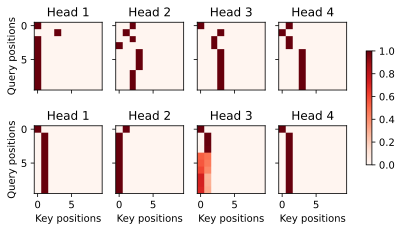

In [85]:
show_heatmaps(
    enc_attention_weights.cpu(), xlabel='Key positions',
    ylabel='Query positions', titles=['Head %d' % i for i in range(1, 5)],
    figsize=(7, 3.5))
# 行是每层的权重矩阵
# 列是每个头在各层的权重矩阵

In [86]:
import pandas as pd
dec_attention_weights_2d = [head[0].tolist()
                            for step in dec_attention_weight_seq
                            for attn in step for blk in attn for head in blk]
dec_attention_weights_filled = torch.tensor(
    pd.DataFrame(dec_attention_weights_2d).fillna(0.0).values)
dec_attention_weights = dec_attention_weights_filled.reshape((-1, 2, 
                                        num_layers, num_heads, num_steps))
dec_self_attention_weights, dec_inter_attention_weights = \
    dec_attention_weights.permute(1, 2, 3, 0, 4)
dec_self_attention_weights.shape, dec_inter_attention_weights.shape

(torch.Size([2, 4, 6, 10]), torch.Size([2, 4, 6, 10]))

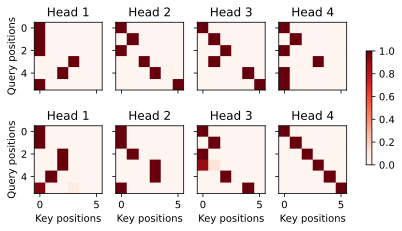

In [87]:
show_heatmaps(
    dec_self_attention_weights[:, :, :, :len(translation.split()) + 1],
    xlabel='Key positions', ylabel='Query positions',
    titles=['Head %d' % i for i in range(1, 5)], figsize=(7, 3.5))

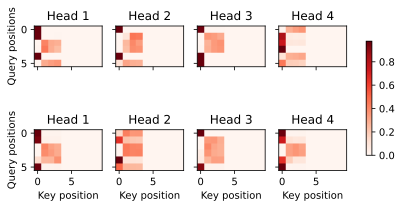

In [88]:
d2l.show_heatmaps(
    dec_inter_attention_weights, xlabel='Key position',
    ylabel='Query positions', titles=['Head %d' % i for i in range(1, 5)],
    figsize=(7, 3.5))